In [1]:
import os
import openai
import textwrap
openai.api_key = "sk-proj-MVMN6j2sTMzKacyFxBPjT3BlbkFJ6QdLHvKyxiQ570Z9ENaq"


Step 1 (Logic)

In [2]:
prompt1 = """ 
Gather knowledge from the [BEST CODE], [SECOND BEST CODE], and [THIRD BEST CODE] and create a new and better heuristics function for Solving 2D Bin Packing Problem (BPP), the
better BPP heuristics function should perform well and requires packing a set of items of various sizes into the smallest number of fixed-sized bins without exceeding the bin's width and height constraints.

Goal:
(1) The items do not overlap when packed
(2) All items packed within a single bin fit within the bin
(3) All items appear in some bin (no item remains unpacked) 
(4) No item appears in two different bins. 

Strictly follow the given template-

template- STARTS HERE

def heuristics_v1(demand: np.ndarray, capacities: Tuple[int, int]) -> List[List[Tuple[int, int, int]]]:
    ##WRITE YOUR CODE HERE##
    return bins

template- ENDS HERE
    

### Function Inputs

1. **demand (np.ndarray)**: This is a NumPy array of shape `(n, 2)`, where `n` is the number of items. Each row of the array represents the dimensions `(width, height)` of an item.
2. **capacities (Tuple[int, int])**: A tuple representing the dimensions of each bin, `(bin_width, bin_height)`.

### Function Outputs

- **List[List[Tuple[int, int, int]]]**: The function returns a list of bins, where each bin is a list of tuples. Each tuple in the bin list represents an item, in the form `(item_index, x_position, y_position)`:
- `item_index` is the index of the item in the original `demand` array.
- `x_position` and `y_position` are the coordinates of the item's bottom-left corner within the bin.


[BEST CODE]:
def heuristics_v1(demand: np.ndarray, capacities: Tuple[int, int]) -> List[List[Tuple[int, int, int]]]:
    bin_width, bin_height = capacities
    items = sorted([(i, w, h) for i, (w, h) in enumerate(demand)], key=lambda x: max(x[1], x[2]), reverse=True)
    bins = []
    
    def fit_item(bin_items, item, bin_width, bin_height):
        item_index, item_width, item_height = item

        for bx in range(bin_width - item_width + 1):
            for by in range(bin_height - item_height + 1):
                if all(not (x < bx + item_width and x + w > bx and y < by + item_height and y + h > by)
                       for _, x, y, w, h in bin_items):
                    return bx, by
        return None
    
    for item in items:
        item_index, item_width, item_height = item
        placed = False

        for bin_items in bins:
            position = fit_item(bin_items, item, bin_width, bin_height)
            if position is not None:
                bin_items.append((item_index, position[0], position[1], item_width, item_height))
                placed = True
                break

        if not placed:
            new_bin = []
            position = fit_item(new_bin, item, bin_width, bin_height)
            assert position is not None, "Item cannot fit in an empty bin, check item size relative to bin size."
            new_bin.append((item_index, position[0], position[1], item_width, item_height))
            bins.append(new_bin)

    result = []
    for bin_items in bins:
        result_bin = [(item_index, x, y) for item_index, x, y, w, h in bin_items]
        result.append(result_bin)
    
    return result



[SECOND BEST CODE]:
def heuristics_v1(demand: np.ndarray, capacities: Tuple[int, int]) -> List[List[Tuple[int, int, int]]]:
    import numpy as np

    bin_width, bin_height = capacities
    bins = []
    
    def fits_in_bin(item, bin_representation, bin_slots):
        item_width, item_height = item
        for y in range(bin_height - item_height + 1):
            for x in range(bin_width - item_width + 1):
                if bin_slots[y:y+item_height, x:x+item_width].sum() == 0:
                    return (x, y)
        return None

    for item_index, item in enumerate(demand):
        item_width, item_height = item
        placed = False
        
        for bin_representation in bins:
            bin_slots = bin_representation['slots']
            position = fits_in_bin(item, bin_representation, bin_slots)
            if position is not None:
                x, y = position
                bin_representation['slots'][y:y+item_height, x:x+item_width] = 1
                bin_representation['items'].append((item_index, x, y))
                placed = True
                break
        
        if not placed:
            bin_slots = np.zeros((bin_height, bin_width), dtype=int)
            bin_representation = {
                'slots': bin_slots,
                'items': []
            }
            position = fits_in_bin(item, bin_representation, bin_slots)
            if position is None:
                raise Exception("The item does not fit in a new bin, check bin size.")
            x, y = position
            bin_representation['slots'][y:y+item_height, x:x+item_width] = 1
            bin_representation['items'].append((item_index, x, y))
            bins.append(bin_representation)
    
    return [bin_representation['items'] for bin_representation in bins]



[THIRD BEST CODE]:
def heuristics_v1(demand: np.ndarray, capacities: Tuple[int, int]) -> List[List[Tuple[int, int, int]]]:
    bin_width, bin_height = capacities
    bins = []
    
    sorted_indices = np.argsort(-demand[:, 1])  # sort items by height in descending order
    
    current_bin = []
    current_x = 0
    current_y = 0
    max_height_in_row = 0
    
    for i in sorted_indices:
        item_width, item_height = demand[i]
        
        if current_x + item_width > bin_width:  # if item doesn't fit horizontally, move to a new row
            current_x = 0
            current_y += max_height_in_row
            max_height_in_row = 0
        
        if current_y + item_height > bin_height:  # if item doesn't fit vertically, create a new bin
            bins.append(current_bin)
            current_bin = []
            current_x = 0
            current_y = 0
        
        current_bin.append((i, current_x, current_y))
        current_x += item_width
        max_height_in_row = max(max_height_in_row, item_height)
    
    if current_bin:  # append the last bin if not empty
        bins.append(current_bin)
    
    return bins

"""


In [3]:
system_prompt1 = """ 
You are an expert in the domain of optimization heuristics. Your task is to design heuristics that can effectively solve 2D bin packing optimization problems having smallest number of bins.
Your response outputs Python code and nothing else.
"""

In [4]:
completion = openai.ChatCompletion.create(
  model="gpt-4o-2024-05-13", 
  messages = [{"role": "system", "content" : system_prompt1},
{"role": "user", "content" : prompt1}],
    temperature=1
)
content = completion["choices"][0]["message"]["content"]
print(content)

```python
import numpy as np
from typing import List, Tuple

def heuristics_v1(demand: np.ndarray, capacities: Tuple[int, int]) -> List[List[Tuple[int, int, int]]]:
    bin_width, bin_height = capacities
    items = sorted([(i, w, h) for i, (w, h) in enumerate(demand)], key=lambda x: max(x[1], x[2]), reverse=True)
    bins = []

    def fits_in_bin(item, bin_representation):
        item_index, item_width, item_height = item
        bin_slots = bin_representation['slots']
        for y in range(bin_height - item_height + 1):
            for x in range(bin_width - item_width + 1):
                if bin_slots[y:y+item_height, x:x+item_width].sum() == 0:
                    return (x, y)
        return None

    for item in items:
        item_index, item_width, item_height = item
        placed = False

        for bin_representation in bins:
            position = fits_in_bin(item, bin_representation)
            if position is not None:
                x, y = position
                

In [6]:
import os

def save_python_code(code: str, directory: str, filename: str):
    """
    Save the given Python code to a file in the specified directory.

    Parameters:
    code (str): The Python code to save.
    directory (str): The directory to save the file in.
    filename (str): The name of the file.
    """
    # Ensure the target directory exists
    os.makedirs(directory, exist_ok=True)

    # Remove the leading '```python' and trailing '```' if present
    if code.lstrip().startswith('```python'):
        code = code.lstrip()[9:]  # Remove '```python'
    if code.rstrip().endswith('```'):
        code = code.rstrip()[:-3]  # Remove trailing '```'

    # Define the file path
    file_path = os.path.join(directory, filename)

    # Write the code content to the file
    with open(file_path, 'w') as file:
        file.write(code)

    return file_path

Step 2 (Generating Codes)

In [7]:
for i in range(1, 21):
  completion = openai.ChatCompletion.create(
    model="gpt-4o-2024-05-13", 
    messages = [{"role": "system", "content" : system_prompt1},
  {"role": "user", "content" : prompt1}],
      temperature=1
  )
  content = completion["choices"][0]["message"]["content"]
  print(content)
  directory = '2_generated_codes'
  filename = f'{i}_2_generated_code.py'

  file_path = save_python_code(content, directory, filename)
  print(f"Code saved to {file_path}")

```python
import numpy as np
from typing import List, Tuple

def heuristics_v1(demand: np.ndarray, capacities: Tuple[int, int]) -> List[List[Tuple[int, int, int]]]:
    bin_width, bin_height = capacities
    items = sorted([(i, w, h) for i, (w, h) in enumerate(demand)], key=lambda x: (max(x[1], x[2]), x[1] * x[2]), reverse=True)
    bins = []

    def fits_in_bin(x, y, item_width, item_height, bin_slots):
        if x + item_width > bin_width or y + item_height > bin_height:
            return False
        if np.any(bin_slots[y:y+item_height, x:x+item_width]):
            return False
        return True

    for item in items:
        item_index, item_width, item_height = item
        placed = False
        
        for bin_representation in bins:
            bin_slots = bin_representation['slots']
            for y in range(bin_height - item_height + 1):
                for x in range(bin_width - item_width + 1):
                    if fits_in_bin(x, y, item_width, item_height, bin_

Step 3 (Running/Testing Codes)


import numpy as np
from typing import List, Tuple

def heuristics_v1(demand: np.ndarray, capacities: Tuple[int, int]) -> List[List[Tuple[int, int, int]]]:
    bin_width, bin_height = capacities
    items = sorted([(i, w, h) for i, (w, h) in enumerate(demand)], key=lambda x: (max(x[1], x[2]), x[1] * x[2]), reverse=True)
    bins = []

    def fits_in_bin(x, y, item_width, item_height, bin_slots):
        if x + item_width > bin_width or y + item_height > bin_height:
            return False
        if np.any(bin_slots[y:y+item_height, x:x+item_width]):
            return False
        return True

    for item in items:
        item_index, item_width, item_height = item
        placed = False
        
        for bin_representation in bins:
            bin_slots = bin_representation['slots']
            for y in range(bin_height - item_height + 1):
                for x in range(bin_width - item_width + 1):
                    if fits_in_bin(x, y, item_width, item_height, bin_slots):
 

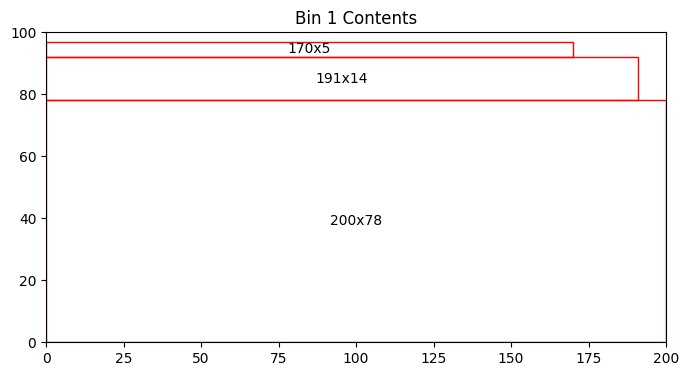

Bin 1 has 876.00 units of area left


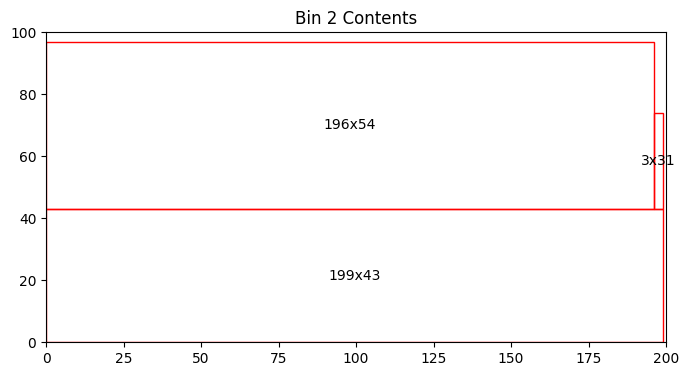

Bin 2 has 766.00 units of area left


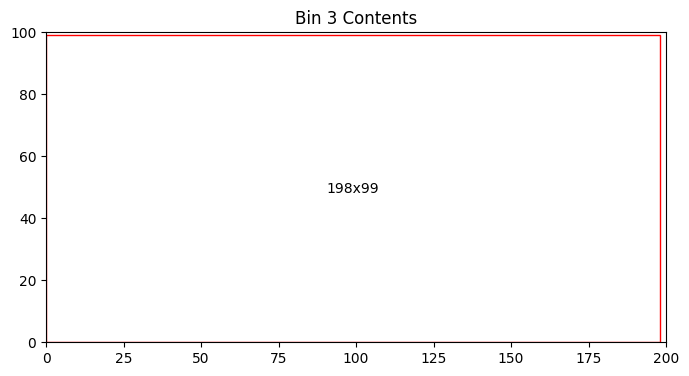

Bin 3 has 398.00 units of area left


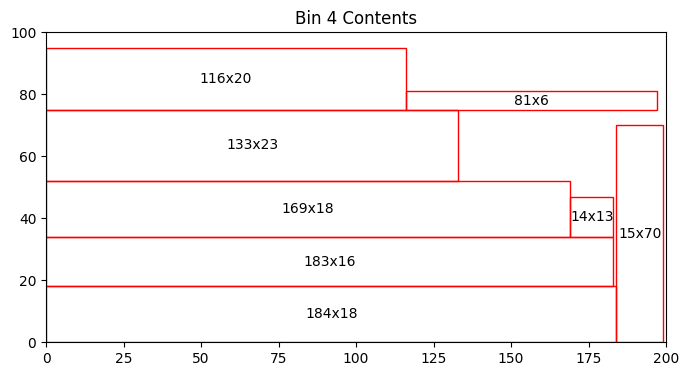

Bin 4 has 3621.00 units of area left


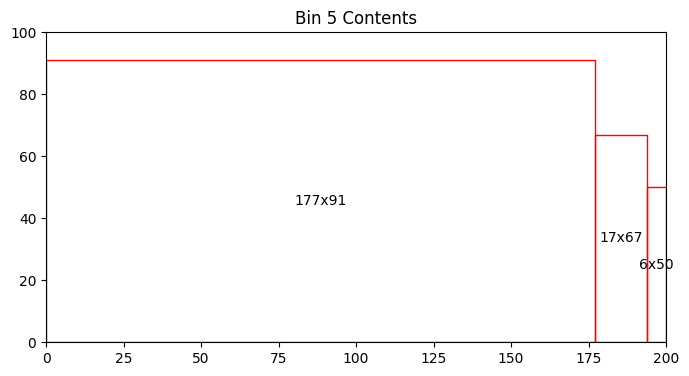

Bin 5 has 2454.00 units of area left


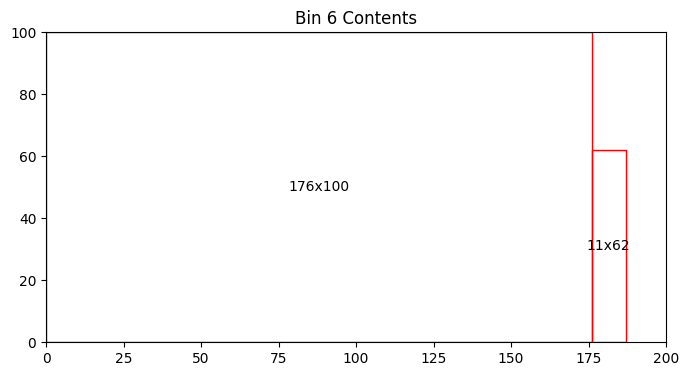

Bin 6 has 1718.00 units of area left


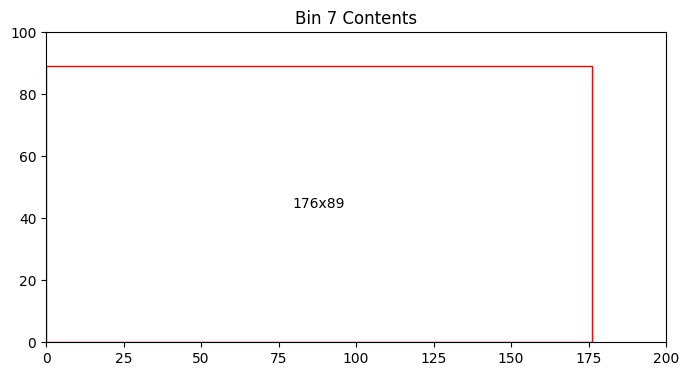

Bin 7 has 4336.00 units of area left


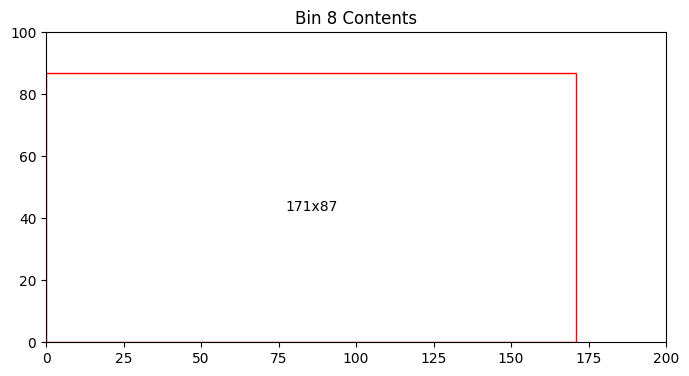

Bin 8 has 5123.00 units of area left


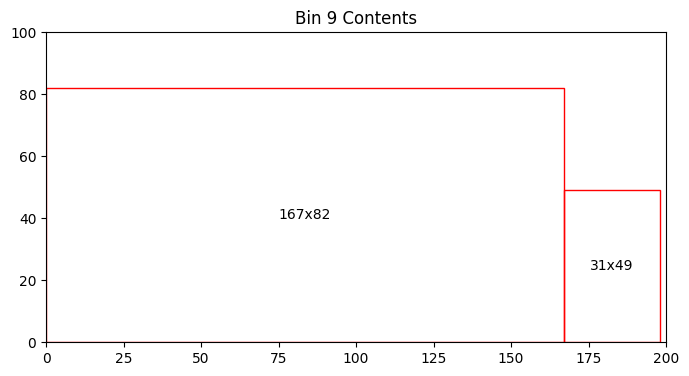

Bin 9 has 4787.00 units of area left


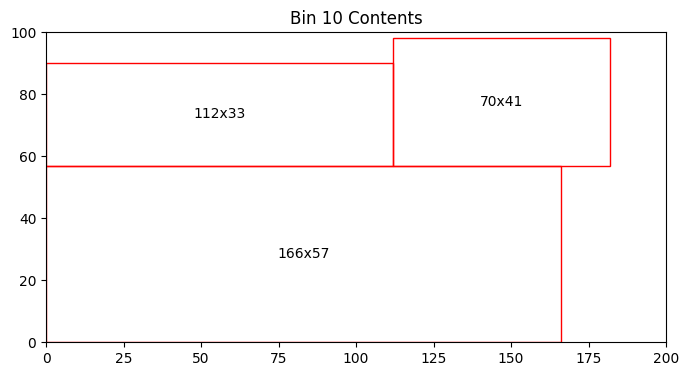

Bin 10 has 3972.00 units of area left


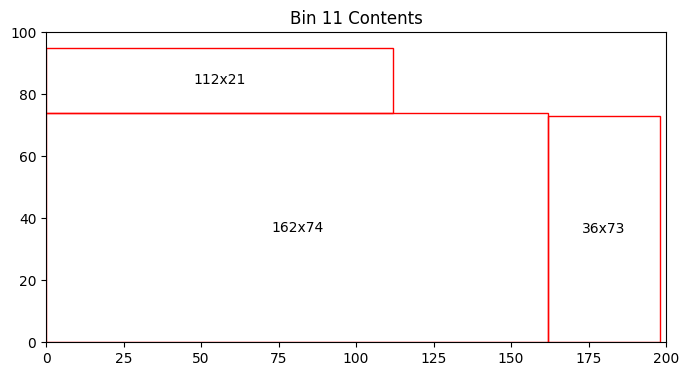

Bin 11 has 3032.00 units of area left


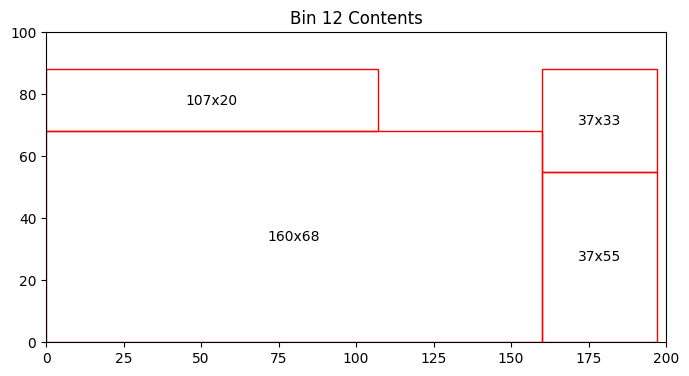

Bin 12 has 3724.00 units of area left


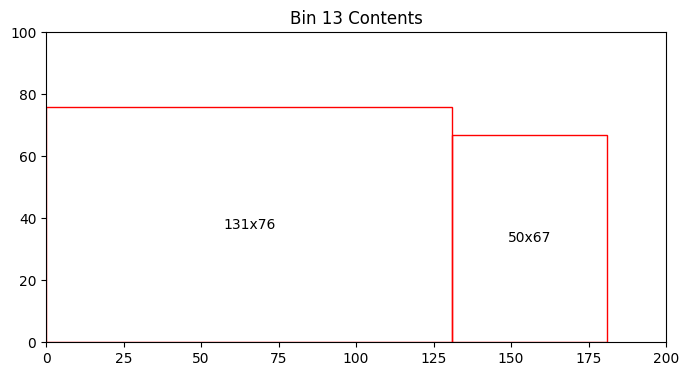

Bin 13 has 6694.00 units of area left


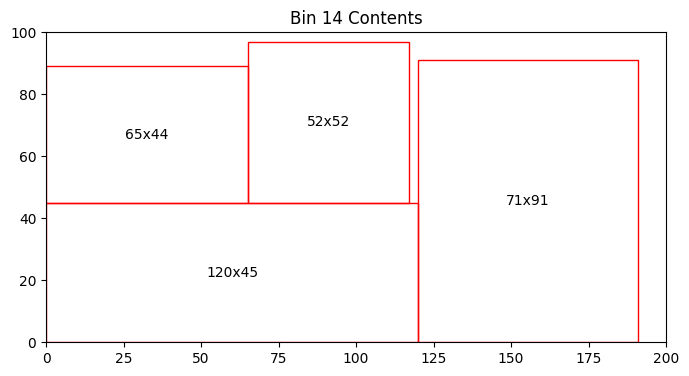

Bin 14 has 2575.00 units of area left


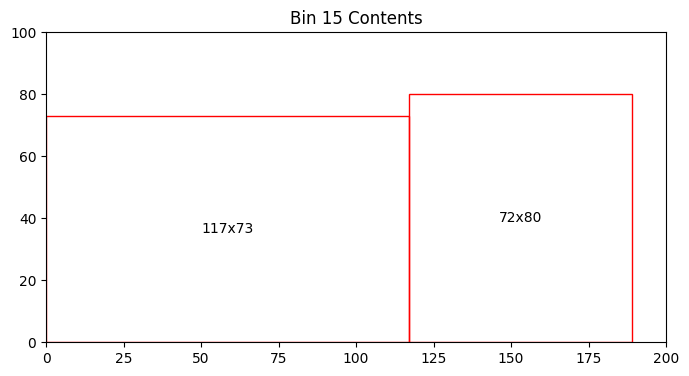

Bin 15 has 5699.00 units of area left


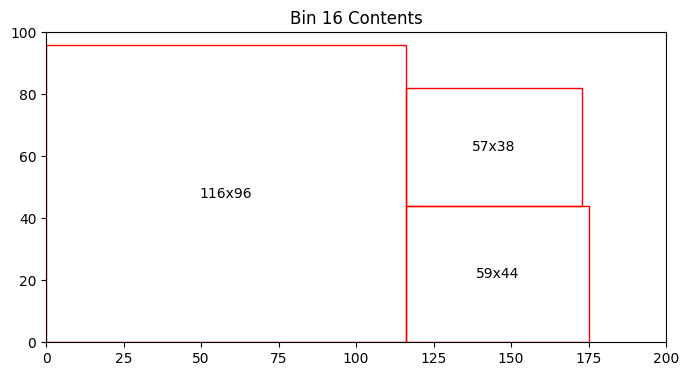

Bin 16 has 4102.00 units of area left


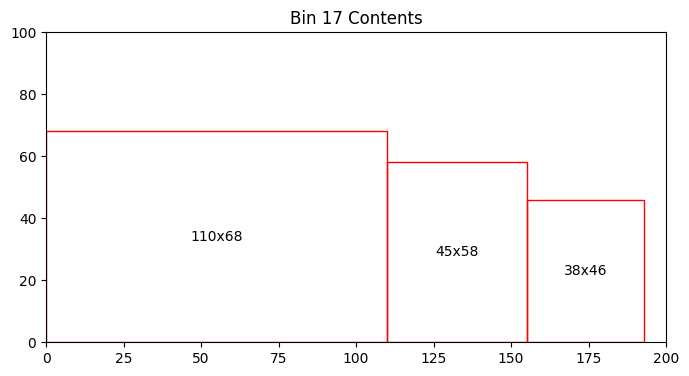

Bin 17 has 8162.00 units of area left


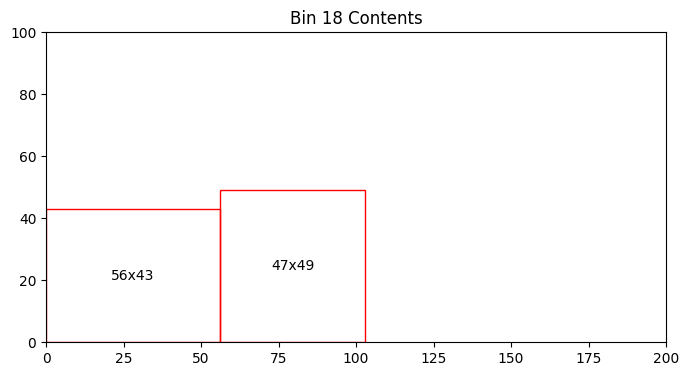

Bin 18 has 15289.00 units of area left
Total number of bins = 18
Total area left in bins = 77328.00


In [10]:
with open('2_generated_codes/1_2_generated_code.py', 'r') as file1:
    py1_content = file1.read()

with open('base.py', 'r') as file2:
    py2_content = file2.read()


combined_content = py1_content + "\n" + py2_content

print(combined_content)

exec(combined_content)

Step 4 (Check Correctness)

[[144  43]
 [ 24  96]
 [182  30]
 [ 29  26]
 [112  44]
 [ 15   8]
 [102  27]
 [ 24  78]
 [160  86]
 [177   2]
 [ 86  30]
 [191  69]
 [135  49]
 [154  50]
 [ 47  28]
 [119  40]
 [127 100]
 [ 42  24]
 [ 89   4]
 [ 57  88]
 [ 31   5]
 [ 61  16]
 [149  40]
 [ 17  68]
 [115  42]
 [100  47]
 [ 27  63]
 [125  94]
 [186  87]
 [ 51  62]
 [191  58]
 [ 93  77]
 [121  11]
 [184  81]
 [193  81]
 [174  98]
 [193  79]
 [ 55  26]
 [188   2]
 [ 31  69]
 [192  14]
 [145  78]
 [ 81  18]
 [199  87]
 [ 44  16]
 [188  56]
 [ 49  79]
 [123  95]
 [ 89  70]
 [114  99]]


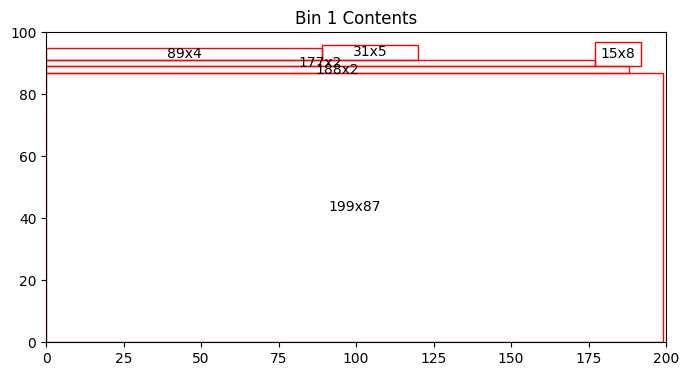

Bin 1 has 1326.00 units of area left


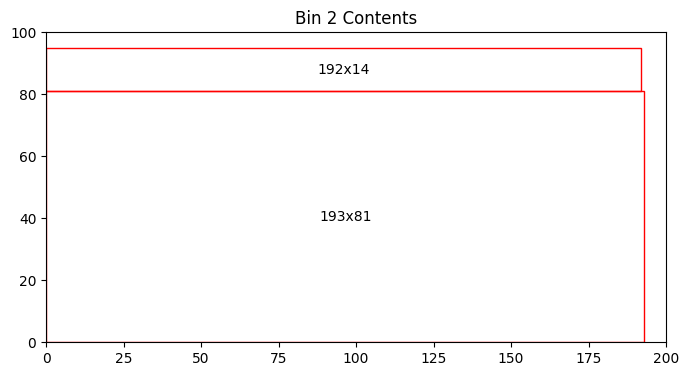

Bin 2 has 1679.00 units of area left


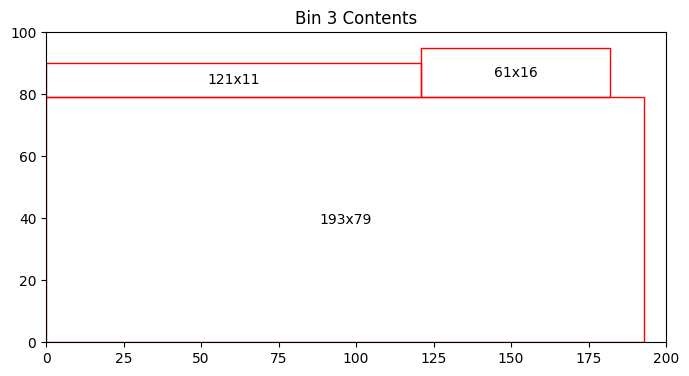

Bin 3 has 2446.00 units of area left


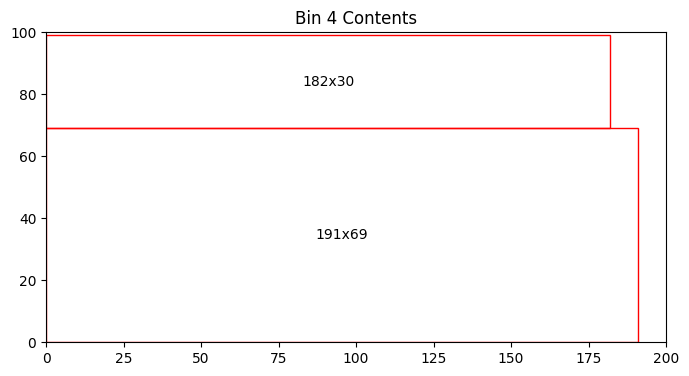

Bin 4 has 1361.00 units of area left


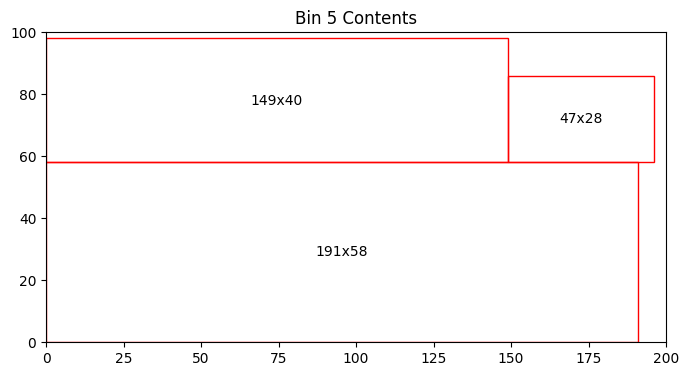

Bin 5 has 1646.00 units of area left


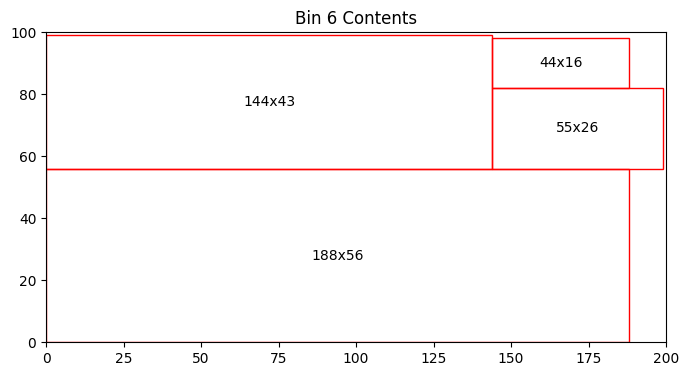

Bin 6 has 1146.00 units of area left


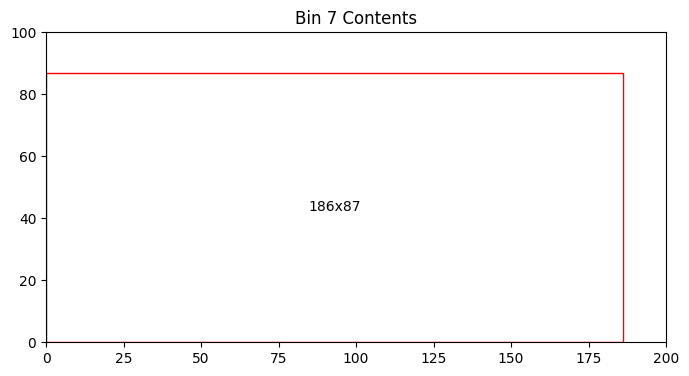

Bin 7 has 3818.00 units of area left


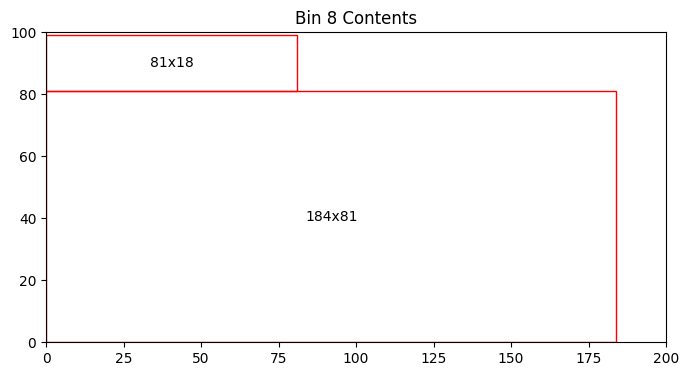

Bin 8 has 3638.00 units of area left


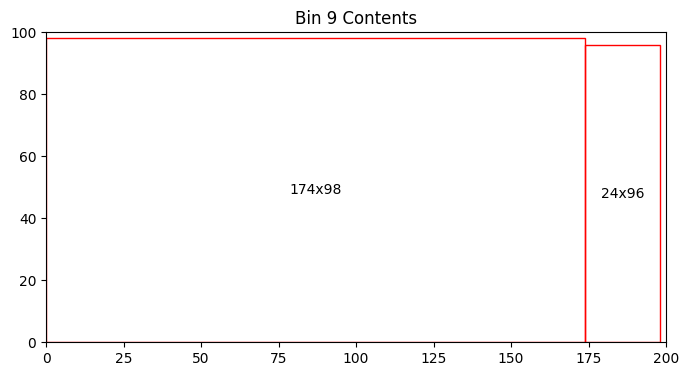

Bin 9 has 644.00 units of area left


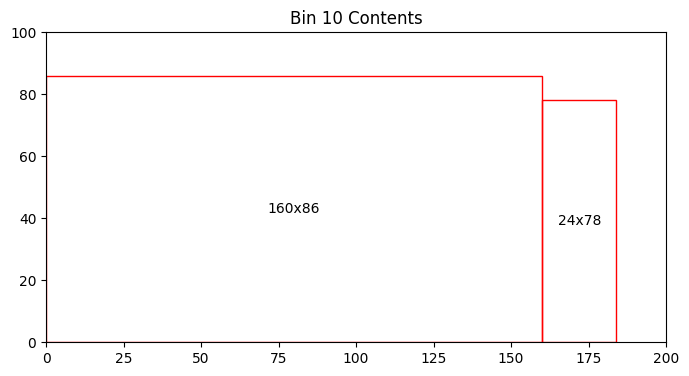

Bin 10 has 4368.00 units of area left


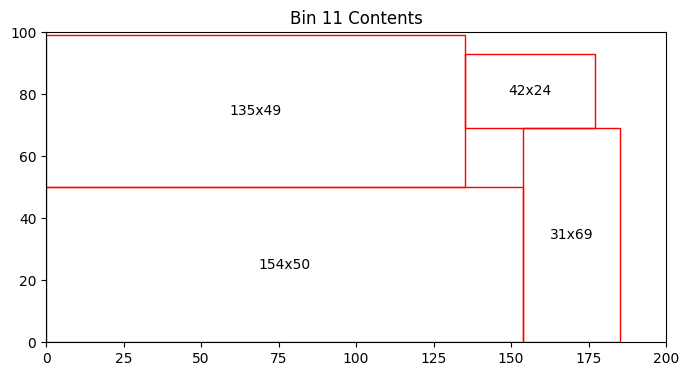

Bin 11 has 2538.00 units of area left


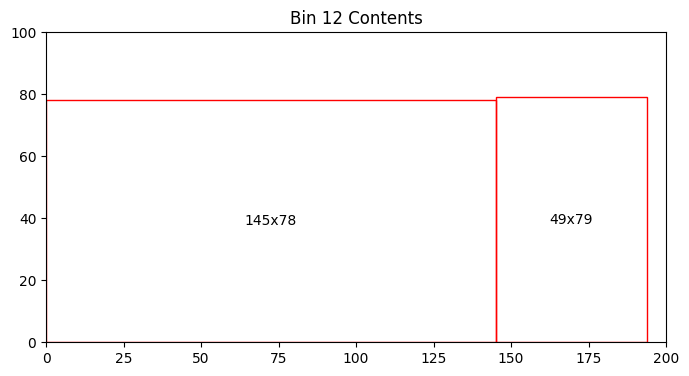

Bin 12 has 4819.00 units of area left


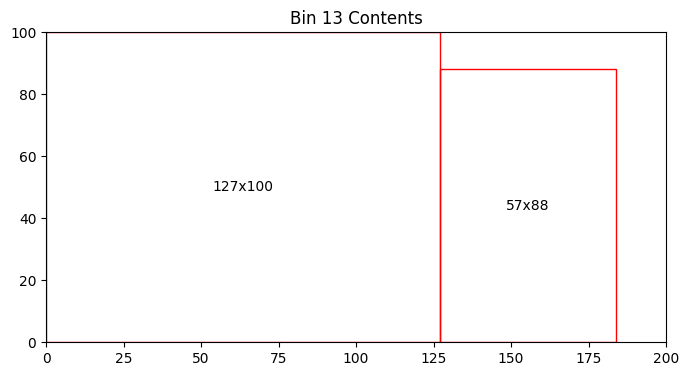

Bin 13 has 2284.00 units of area left


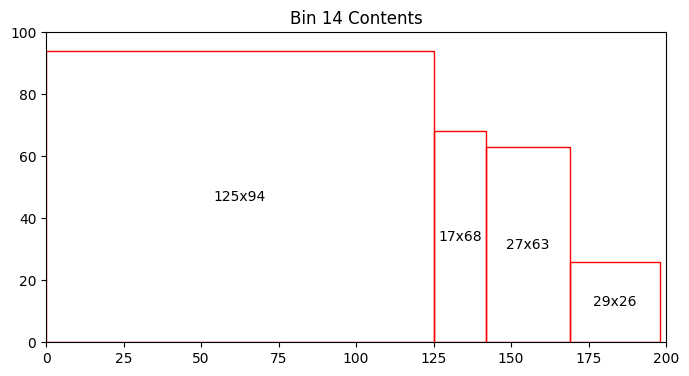

Bin 14 has 4639.00 units of area left


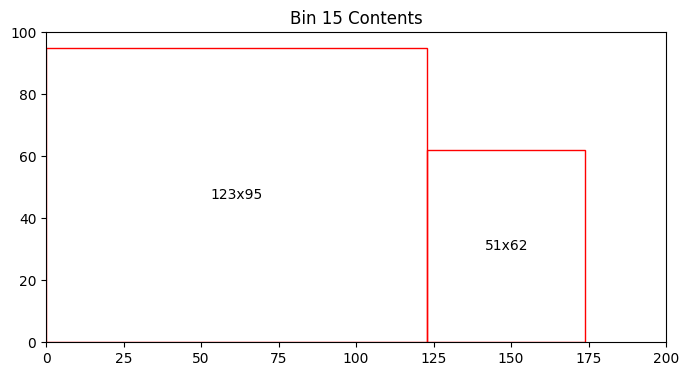

Bin 15 has 5153.00 units of area left


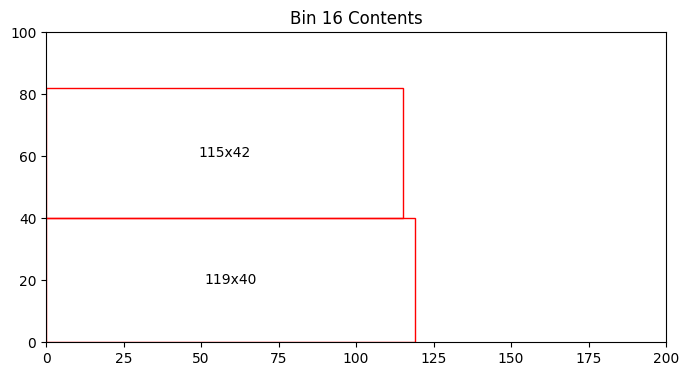

Bin 16 has 10410.00 units of area left


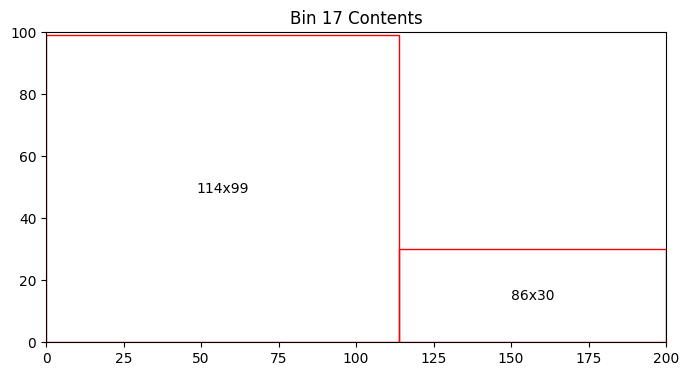

Bin 17 has 6134.00 units of area left


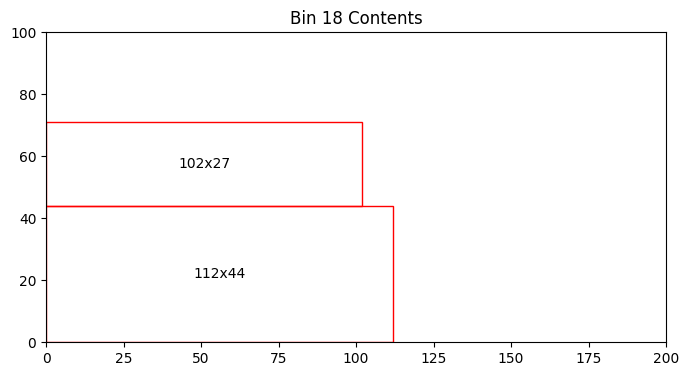

Bin 18 has 12318.00 units of area left


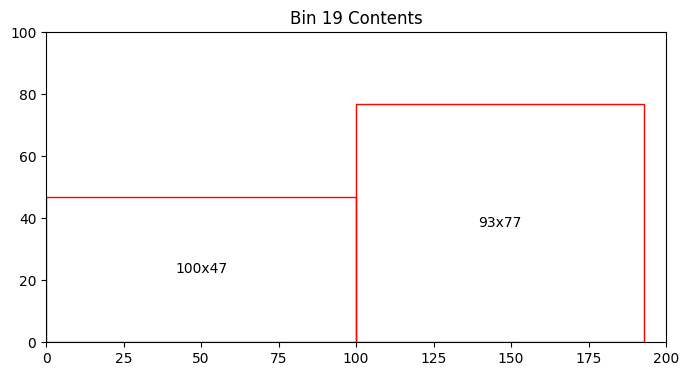

Bin 19 has 8139.00 units of area left


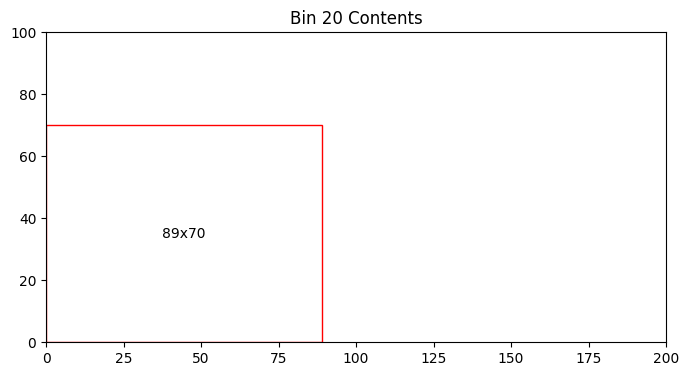

Bin 20 has 13770.00 units of area left
Total number of bins = 20
Total area left in bins = 92276.00
[[150  42]
 [ 53  10]
 [ 38  87]
 [128  32]
 [105  81]
 [ 71  25]
 [ 90  64]
 [165  35]
 [  8  30]
 [151  47]
 [ 62  79]
 [155  83]
 [198  99]
 [165  80]
 [ 90  57]
 [183  91]
 [  3  24]
 [147  90]
 [107  79]
 [ 12  64]
 [146  82]
 [143  80]
 [110  48]
 [192   8]
 [  8  38]
 [ 85  63]
 [100  20]
 [189  80]
 [148   5]
 [ 85  81]
 [ 37   3]
 [ 92  25]
 [195  27]
 [ 49  74]
 [164  66]
 [162  18]
 [121  57]
 [164  66]
 [151  84]
 [ 18  89]
 [ 93  94]
 [121  85]
 [ 35  15]
 [120  67]
 [199  83]
 [177  40]
 [ 60   1]
 [109  86]
 [ 24  29]
 [ 64  84]]


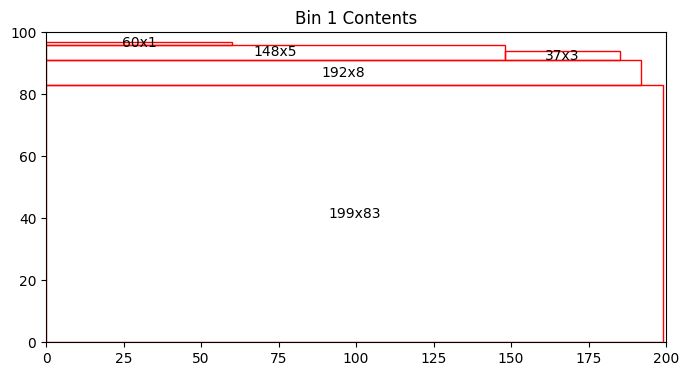

Bin 1 has 1036.00 units of area left


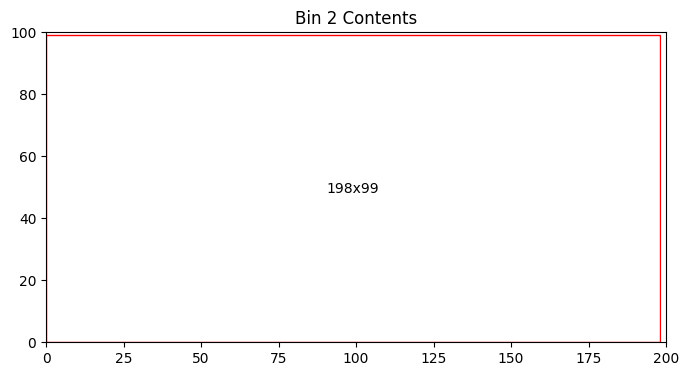

Bin 2 has 398.00 units of area left


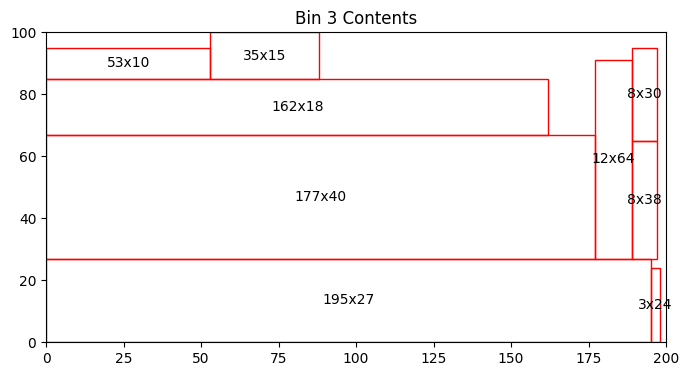

Bin 3 has 2300.00 units of area left


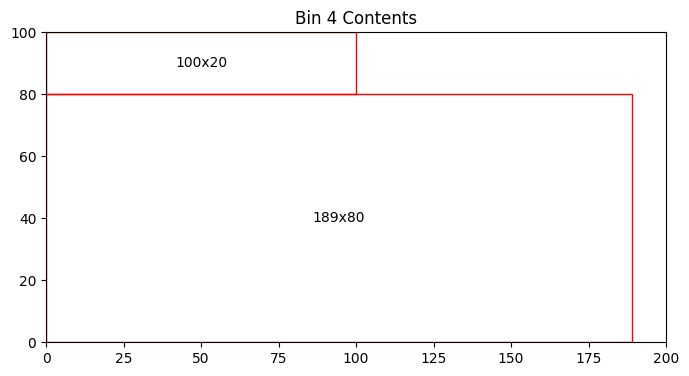

Bin 4 has 2880.00 units of area left


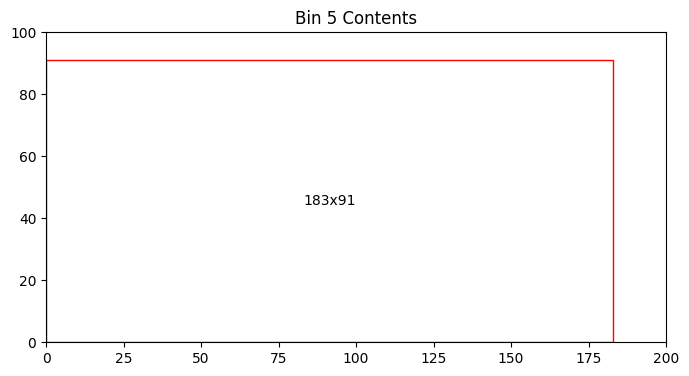

Bin 5 has 3347.00 units of area left


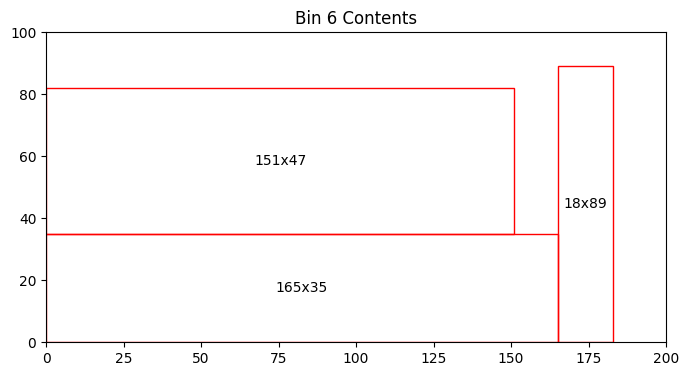

Bin 6 has 5526.00 units of area left


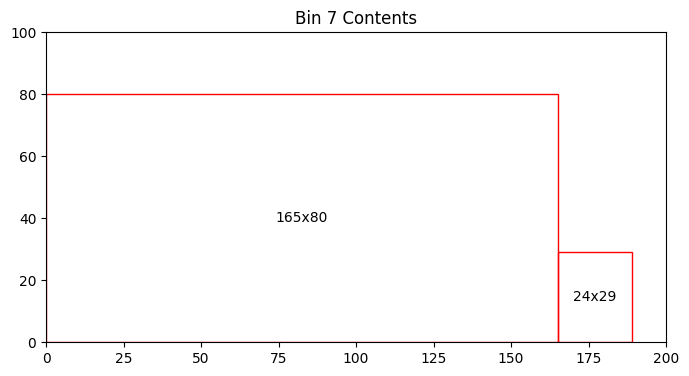

Bin 7 has 6104.00 units of area left


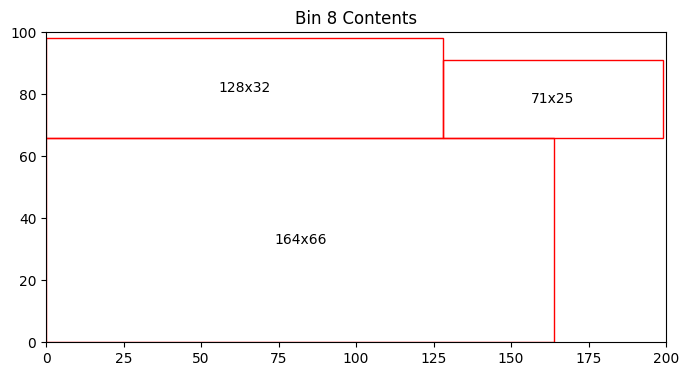

Bin 8 has 3305.00 units of area left


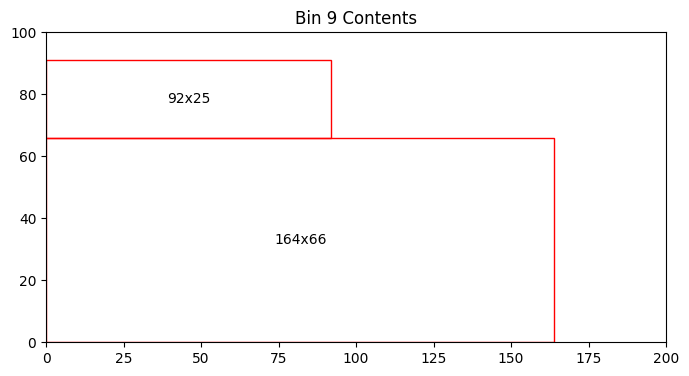

Bin 9 has 6876.00 units of area left


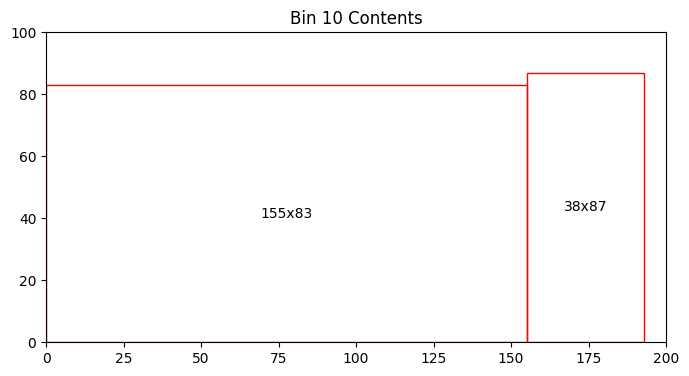

Bin 10 has 3829.00 units of area left


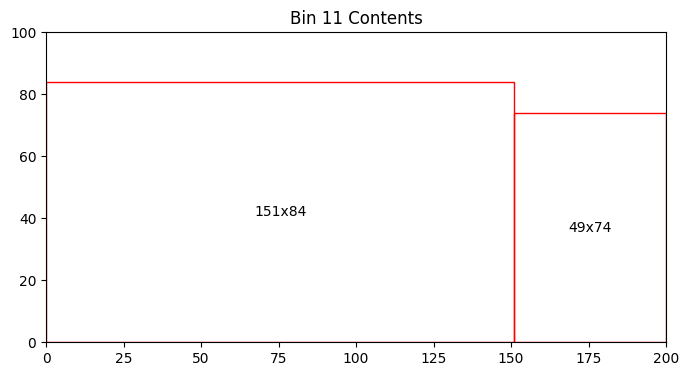

Bin 11 has 3690.00 units of area left


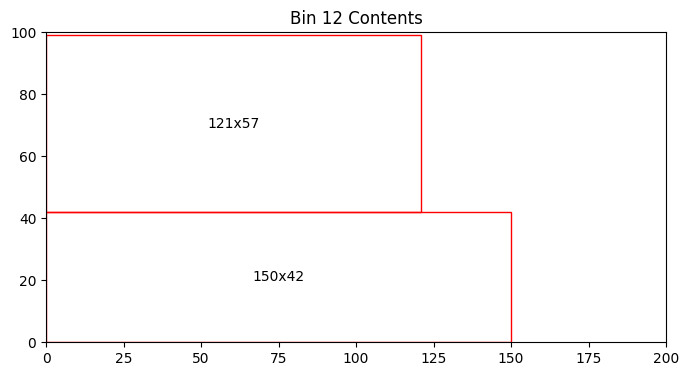

Bin 12 has 6803.00 units of area left


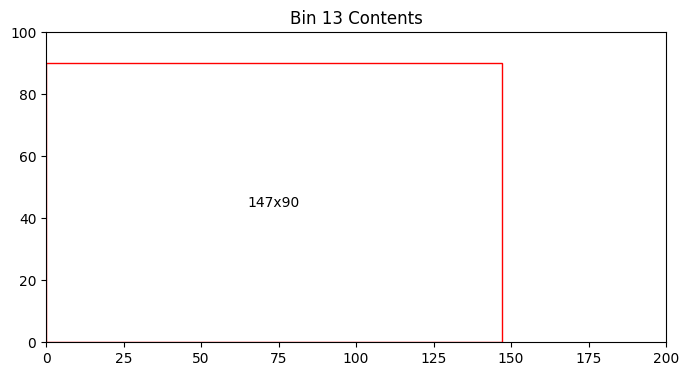

Bin 13 has 6770.00 units of area left


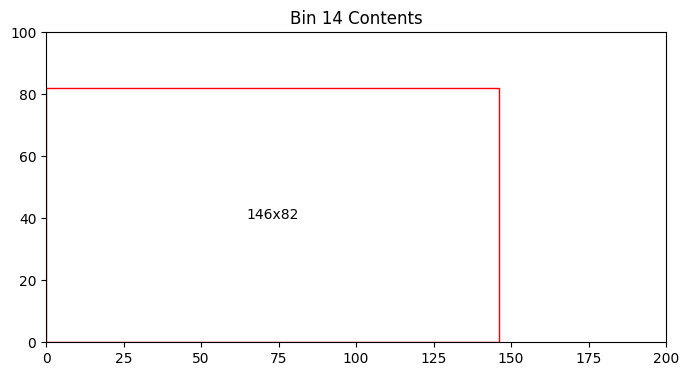

Bin 14 has 8028.00 units of area left


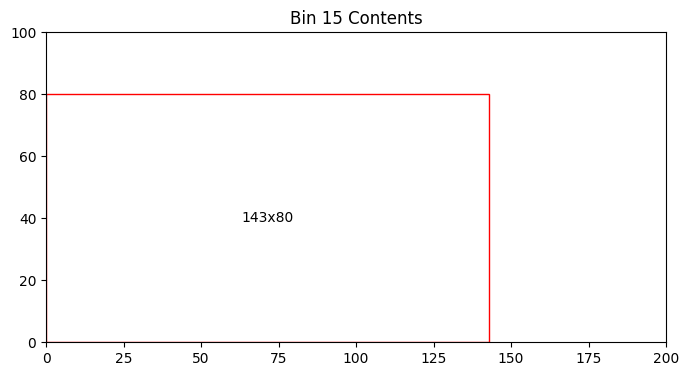

Bin 15 has 8560.00 units of area left


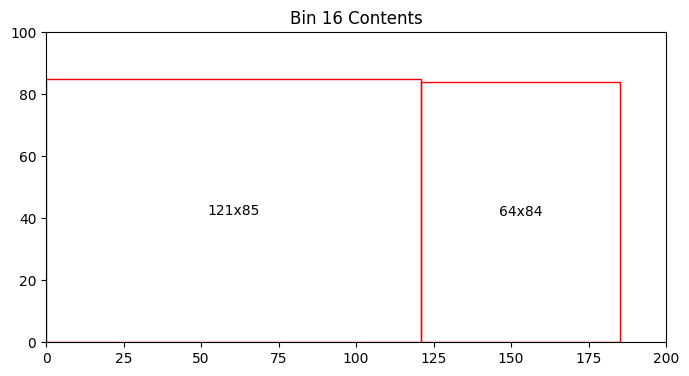

Bin 16 has 4339.00 units of area left


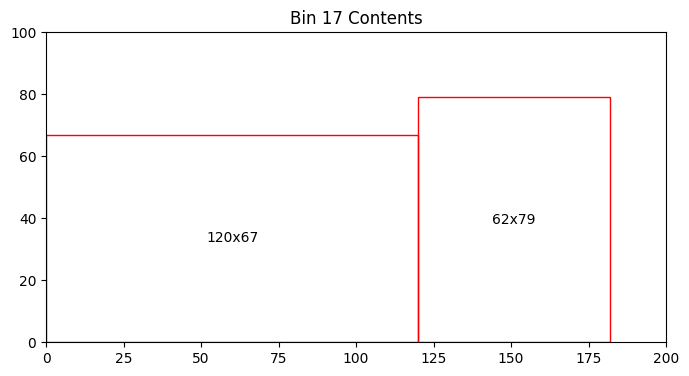

Bin 17 has 7062.00 units of area left


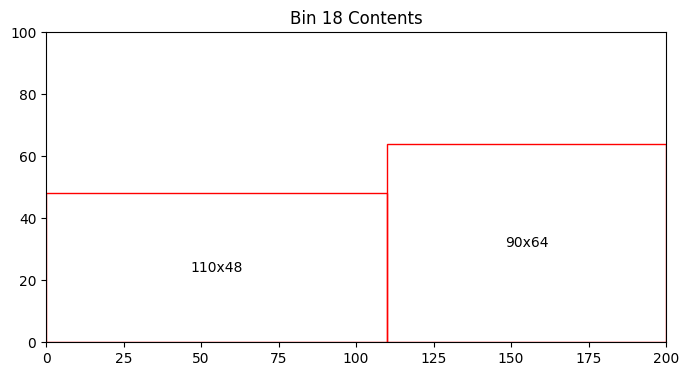

Bin 18 has 8960.00 units of area left


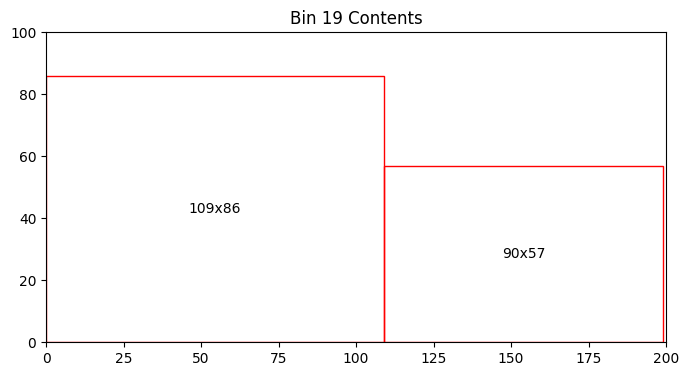

Bin 19 has 5496.00 units of area left


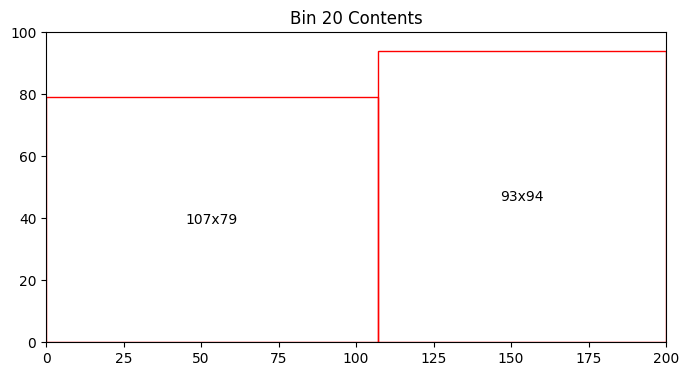

Bin 20 has 2805.00 units of area left


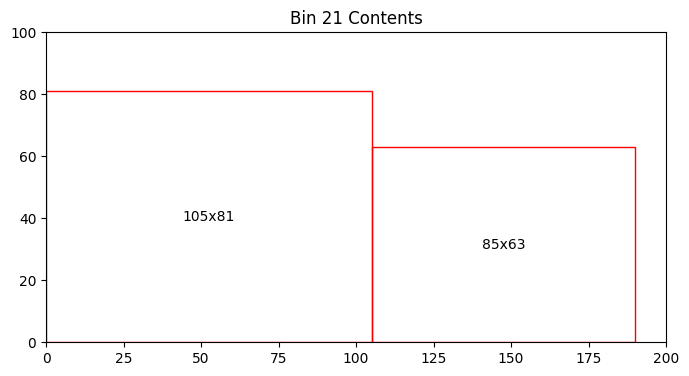

Bin 21 has 6140.00 units of area left


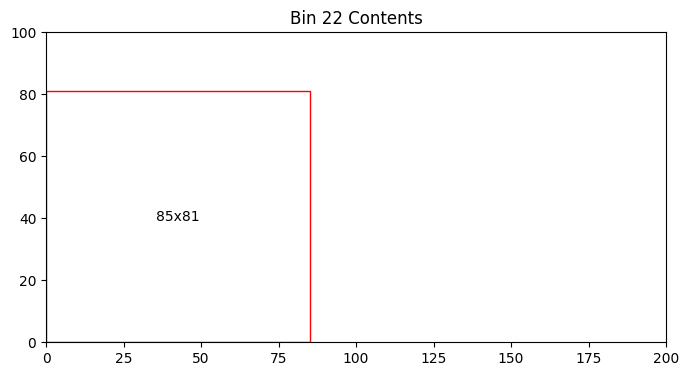

Bin 22 has 13115.00 units of area left
Total number of bins = 22
Total area left in bins = 117369.00
[[ 28   4]
 [ 48  65]
 [ 22  32]
 [132  79]
 [ 82  15]
 [123  77]
 [ 50  39]
 [148  23]
 [104  37]
 [ 55  95]
 [107  16]
 [165  46]
 [147   4]
 [140  72]
 [110  12]
 [164  24]
 [ 36  61]
 [151  43]
 [  9  13]
 [ 26  88]
 [ 79  12]
 [122   2]
 [ 43  29]
 [200  93]
 [184   8]
 [154  43]
 [172  21]
 [ 91  47]
 [ 74  12]
 [ 24  34]
 [ 42 100]
 [ 89  62]
 [163  66]
 [146  16]
 [136  98]
 [ 94   2]
 [ 46  44]
 [ 40  63]
 [125  75]
 [ 27  20]
 [147   5]
 [ 11  98]
 [130  17]
 [ 85  21]
 [113  63]
 [159  42]
 [163 100]
 [137  46]
 [ 37  74]
 [192  19]]


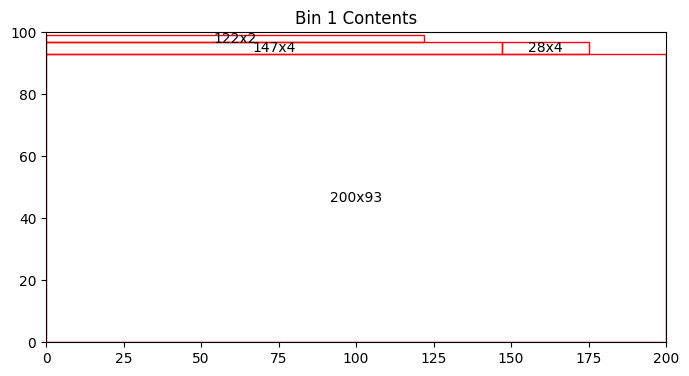

Bin 1 has 456.00 units of area left


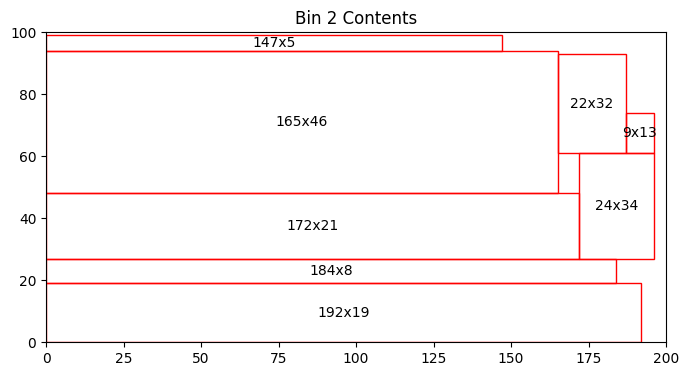

Bin 2 has 1306.00 units of area left


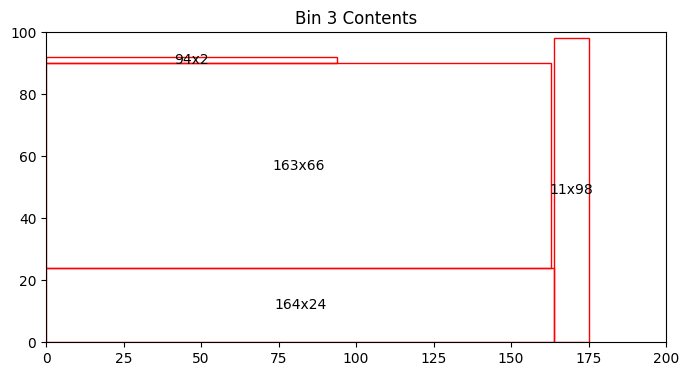

Bin 3 has 4040.00 units of area left


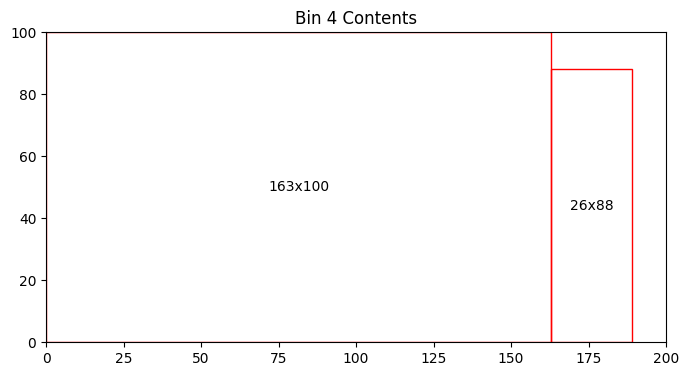

Bin 4 has 1412.00 units of area left


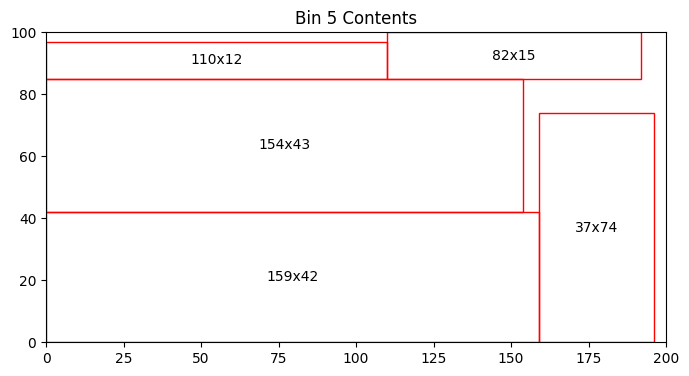

Bin 5 has 1412.00 units of area left


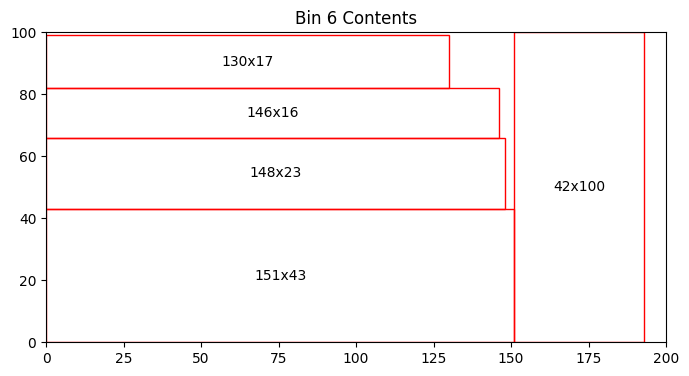

Bin 6 has 1357.00 units of area left


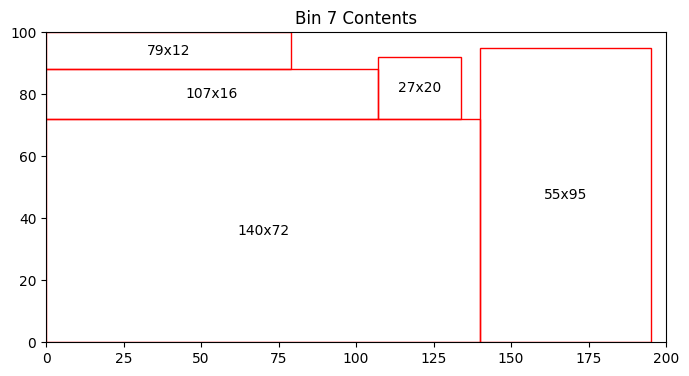

Bin 7 has 1495.00 units of area left


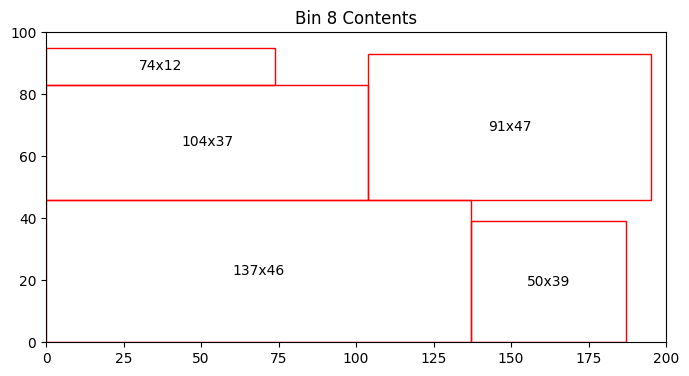

Bin 8 has 2735.00 units of area left


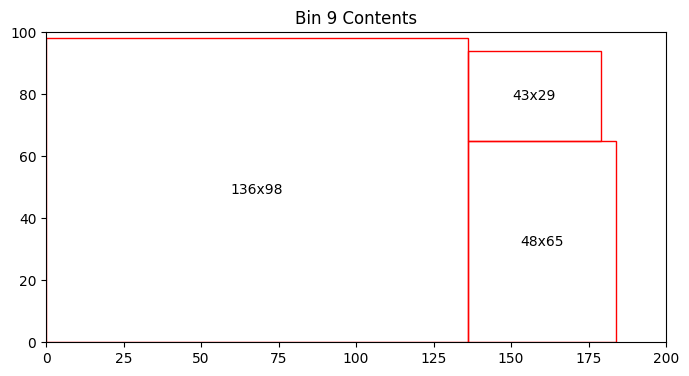

Bin 9 has 2305.00 units of area left


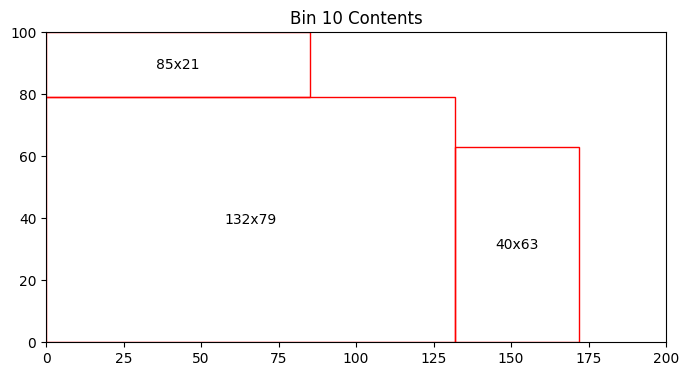

Bin 10 has 5267.00 units of area left


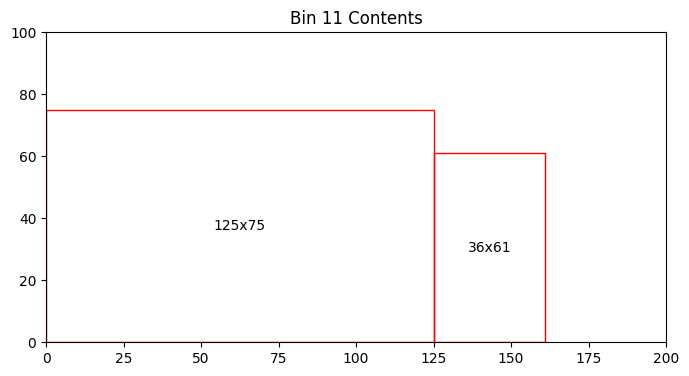

Bin 11 has 8429.00 units of area left


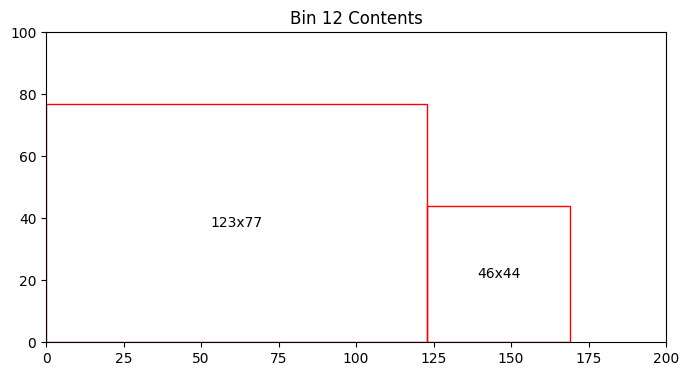

Bin 12 has 8505.00 units of area left


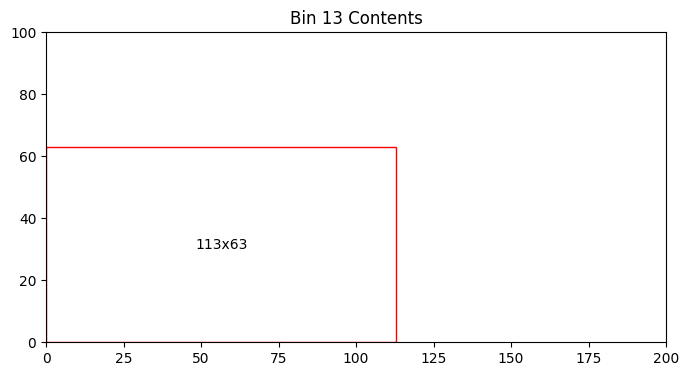

Bin 13 has 12881.00 units of area left


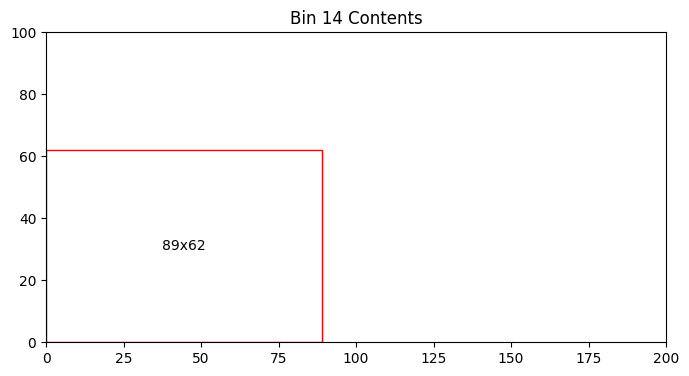

Bin 14 has 14482.00 units of area left
Total number of bins = 14
Total area left in bins = 66082.00
[[182   9]
 [175  97]
 [ 76  88]
 [168  19]
 [172  92]
 [119  28]
 [122  67]
 [ 70  31]
 [127  73]
 [149  46]
 [116  24]
 [ 62  13]
 [160  94]
 [ 12  93]
 [ 60  42]
 [ 59  17]
 [ 59  20]
 [198  10]
 [129  16]
 [ 85  90]
 [129   1]
 [171  36]
 [138  12]
 [ 54  79]
 [ 57   6]
 [ 53  12]
 [ 46  75]
 [ 47  43]
 [  7   7]
 [164  34]
 [ 88  94]
 [ 42  89]
 [175  94]
 [110  32]
 [ 56  91]
 [187  20]
 [179   8]
 [ 37  87]
 [141  68]
 [114   5]
 [106  99]
 [ 23  13]
 [161   5]
 [ 66  76]
 [129  74]
 [ 74  19]
 [ 40  22]
 [172  21]
 [ 89   6]
 [ 38  12]]


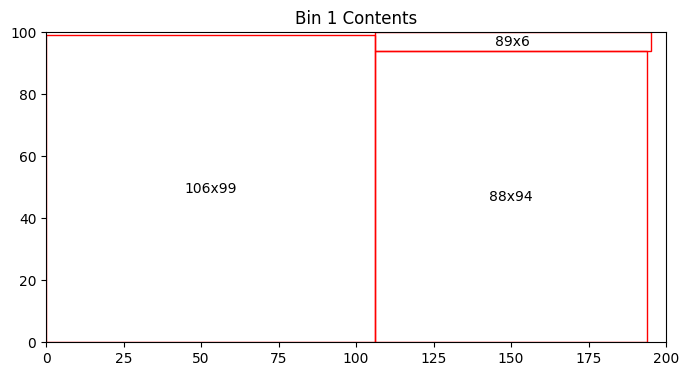

Bin 1 has 700.00 units of area left


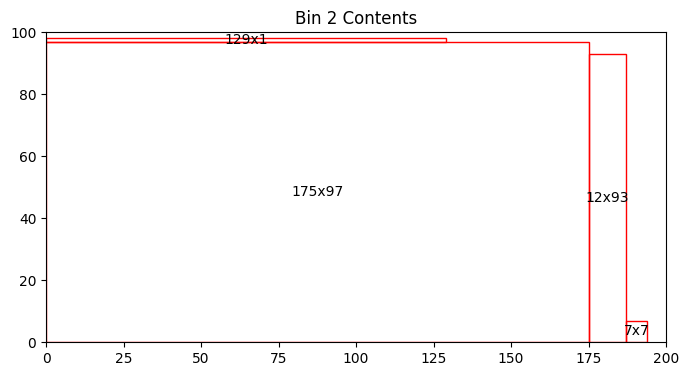

Bin 2 has 1731.00 units of area left


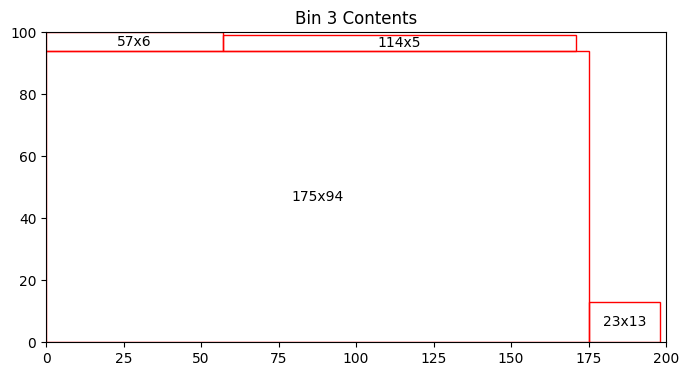

Bin 3 has 2339.00 units of area left


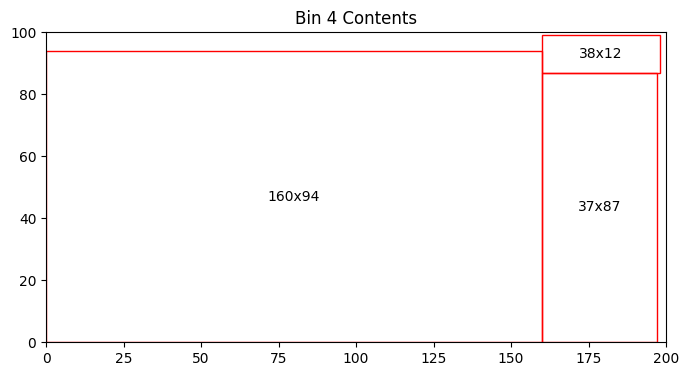

Bin 4 has 1285.00 units of area left


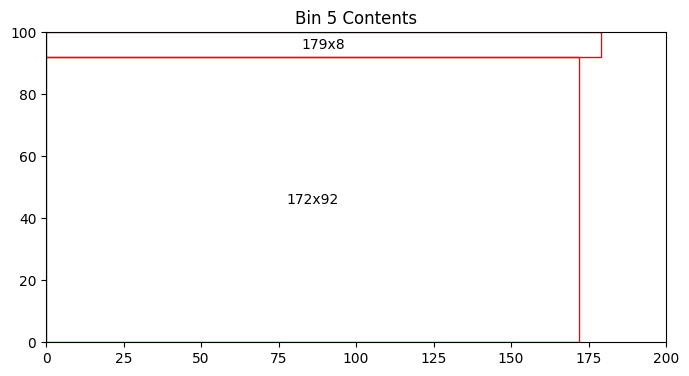

Bin 5 has 2744.00 units of area left


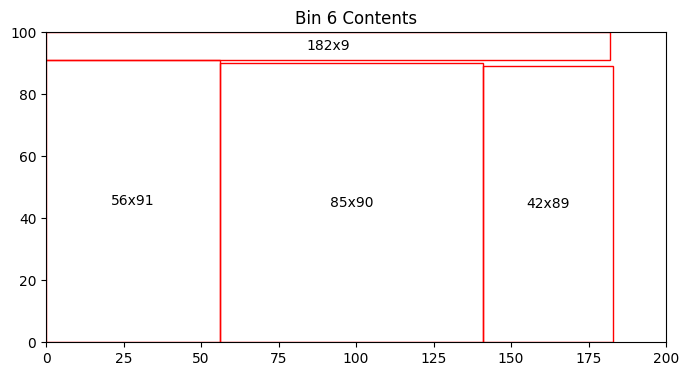

Bin 6 has 1878.00 units of area left


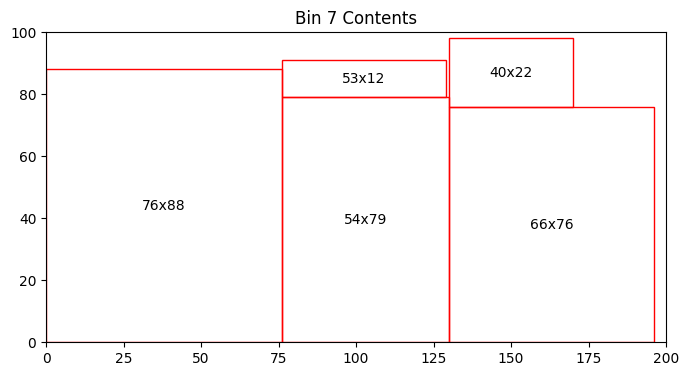

Bin 7 has 2514.00 units of area left


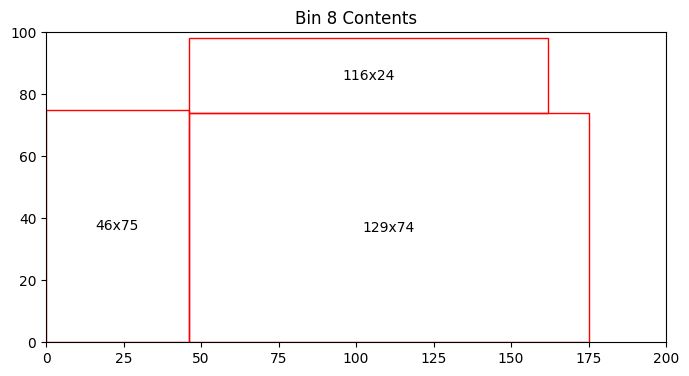

Bin 8 has 4220.00 units of area left


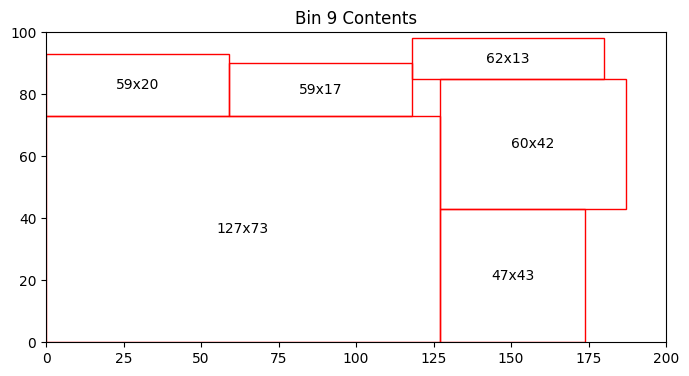

Bin 9 has 3199.00 units of area left


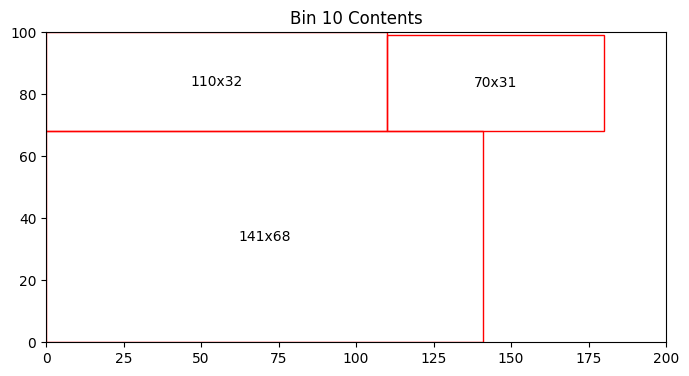

Bin 10 has 4722.00 units of area left


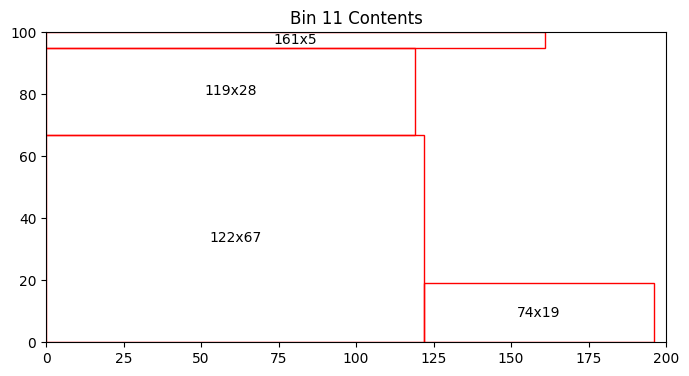

Bin 11 has 6283.00 units of area left


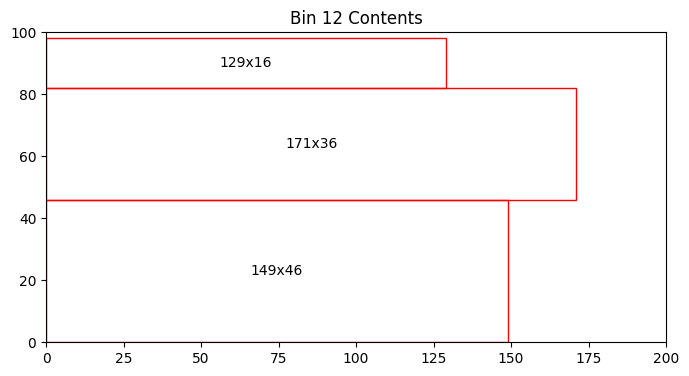

Bin 12 has 4926.00 units of area left


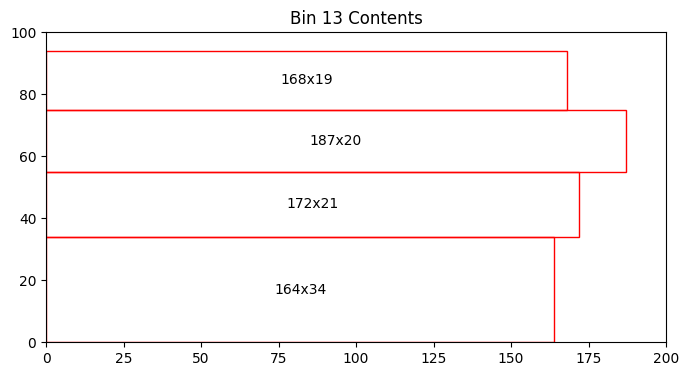

Bin 13 has 3880.00 units of area left


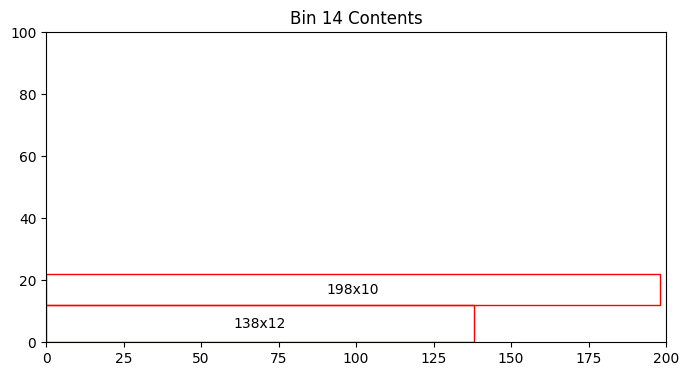

Bin 14 has 16364.00 units of area left
Total number of bins = 14
Total area left in bins = 56785.00
[[149  50]
 [ 64  15]
 [175  32]
 [198  31]
 [112  15]
 [ 34  58]
 [154  40]
 [194  46]
 [177  23]
 [ 86  48]
 [ 94  99]
 [165  57]
 [157  81]
 [130  82]
 [ 43   1]
 [ 48  26]
 [ 84   8]
 [ 81  28]
 [115  19]
 [ 99  78]
 [ 35  96]
 [199  20]
 [198  16]
 [ 48  16]
 [ 19   9]
 [ 93  10]
 [ 46  24]
 [187  84]
 [135  12]
 [176   1]
 [167  54]
 [146  80]
 [ 80  71]
 [ 45  89]
 [135  88]
 [ 51  47]
 [ 99  78]
 [  7  53]
 [178  69]
 [ 91  28]
 [175  57]
 [ 26  44]
 [154  48]
 [ 60  95]
 [142  14]
 [161  12]
 [192  27]
 [199   9]
 [ 72  71]
 [ 68  56]]


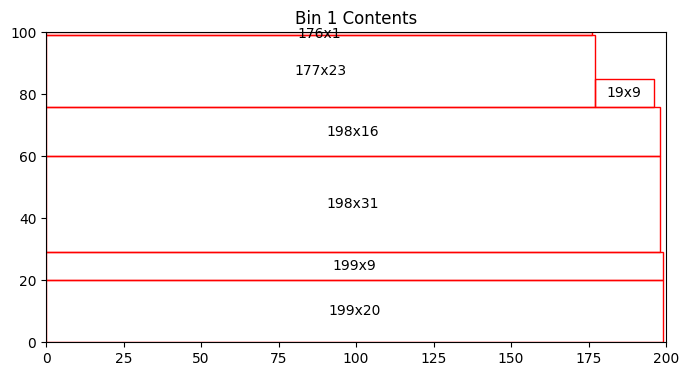

Bin 1 has 505.00 units of area left


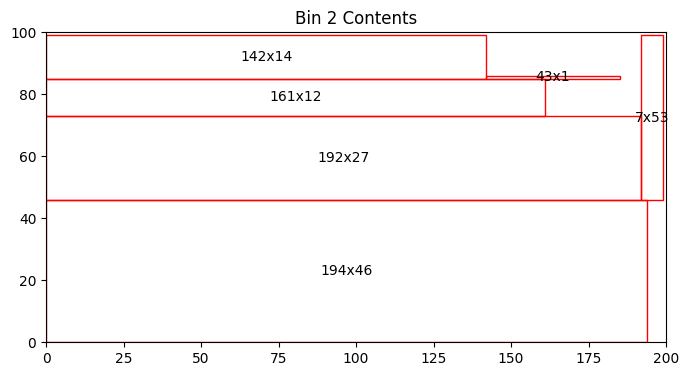

Bin 2 has 1558.00 units of area left


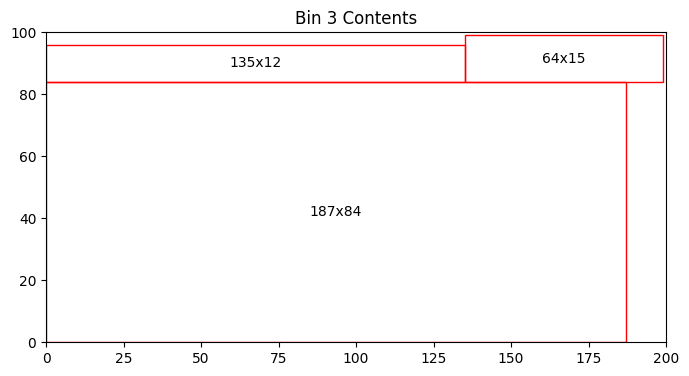

Bin 3 has 1712.00 units of area left


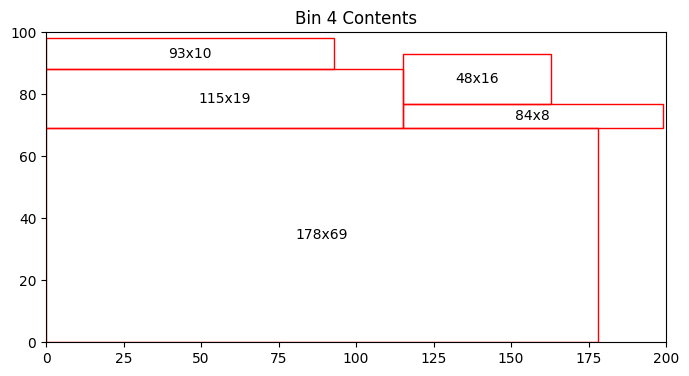

Bin 4 has 3163.00 units of area left


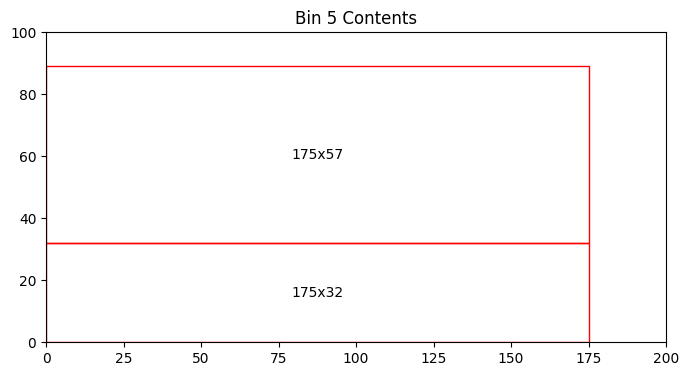

Bin 5 has 4425.00 units of area left


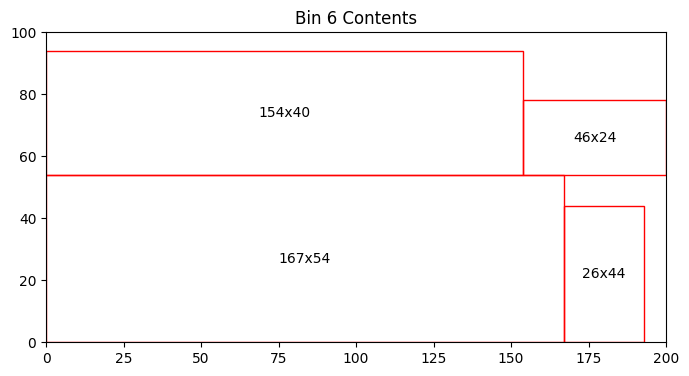

Bin 6 has 2574.00 units of area left


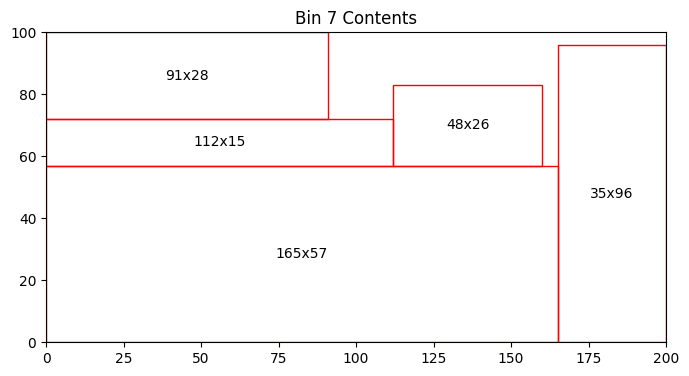

Bin 7 has 1759.00 units of area left


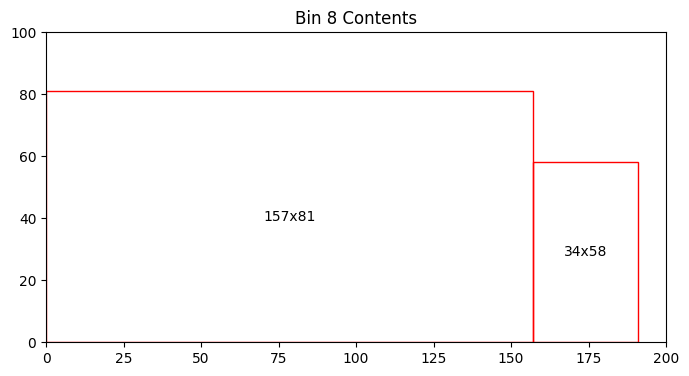

Bin 8 has 5311.00 units of area left


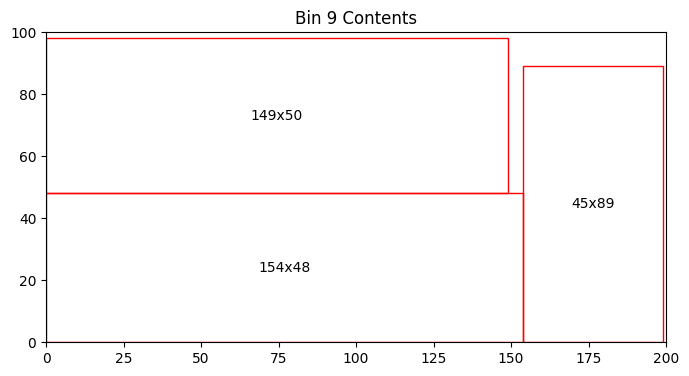

Bin 9 has 1153.00 units of area left


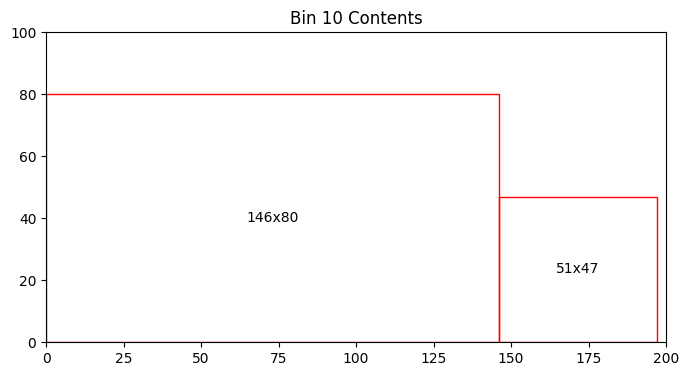

Bin 10 has 5923.00 units of area left


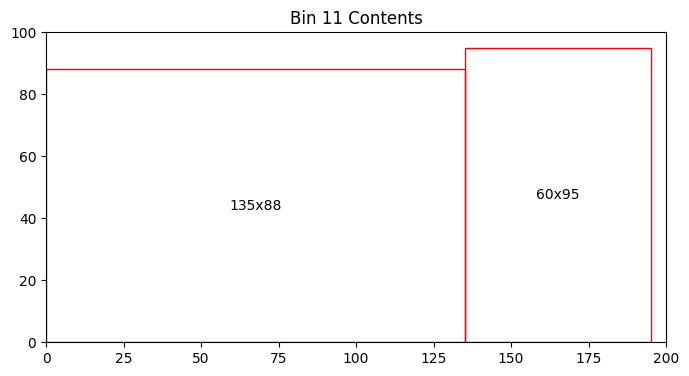

Bin 11 has 2420.00 units of area left


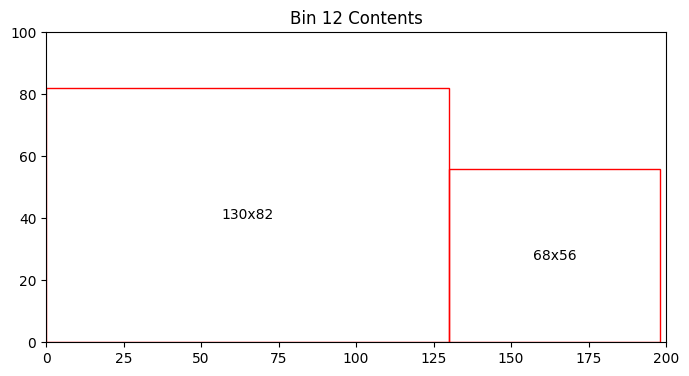

Bin 12 has 5532.00 units of area left


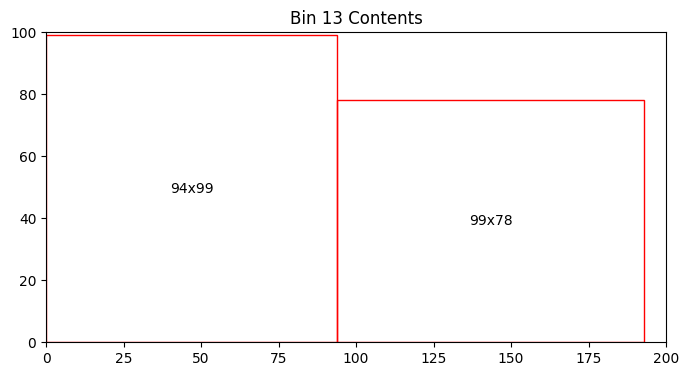

Bin 13 has 2972.00 units of area left


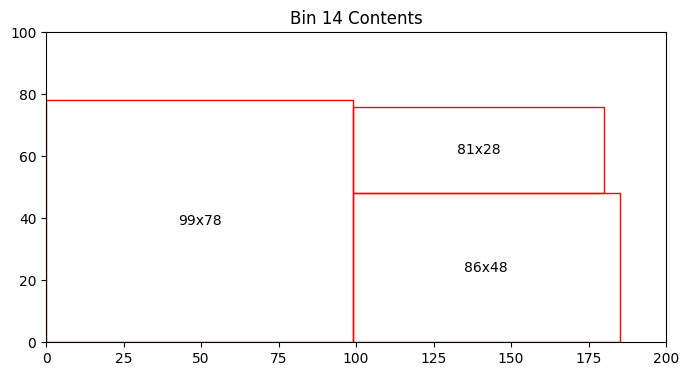

Bin 14 has 5882.00 units of area left


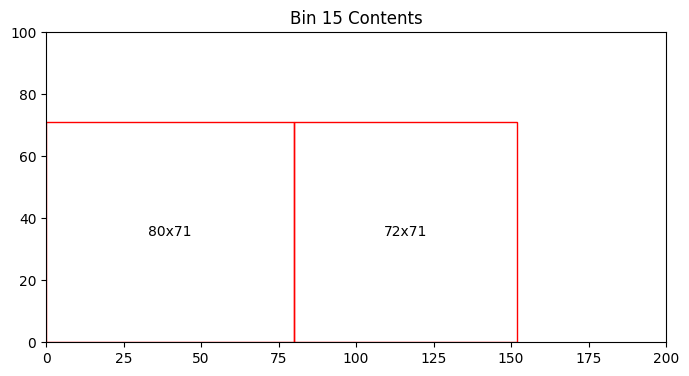

Bin 15 has 9208.00 units of area left
Total number of bins = 15
Total area left in bins = 54097.00
[[ 44  20]
 [ 42  98]
 [113  21]
 [193  18]
 [155   5]
 [141  14]
 [  4  85]
 [ 20  88]
 [ 82  93]
 [165  74]
 [171  32]
 [146  75]
 [177  57]
 [115  26]
 [178  40]
 [ 57  22]
 [ 71  97]
 [160  26]
 [ 30  63]
 [111  19]
 [131  21]
 [146  28]
 [ 75  10]
 [ 80  45]
 [  2  29]
 [ 37  88]
 [ 85  42]
 [ 32  66]
 [183  83]
 [165  79]
 [ 16  98]
 [135  77]
 [125 100]
 [ 98  73]
 [118  70]
 [ 27  91]
 [162  70]
 [195  71]
 [ 65  51]
 [ 50  93]
 [115  58]
 [ 66  62]
 [ 37  70]
 [123  45]
 [168   7]
 [ 47  75]
 [ 70  89]
 [148  42]
 [ 76  10]
 [178  67]]


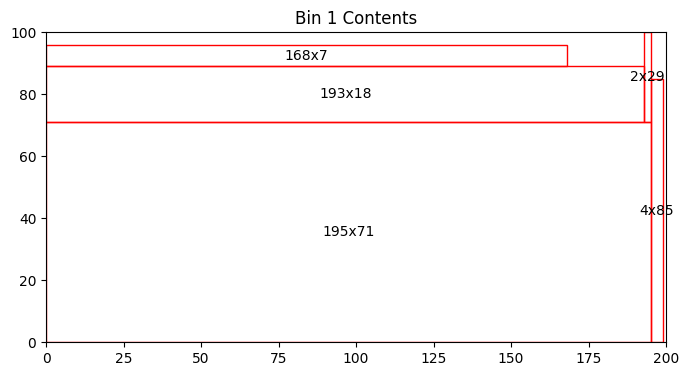

Bin 1 has 1107.00 units of area left


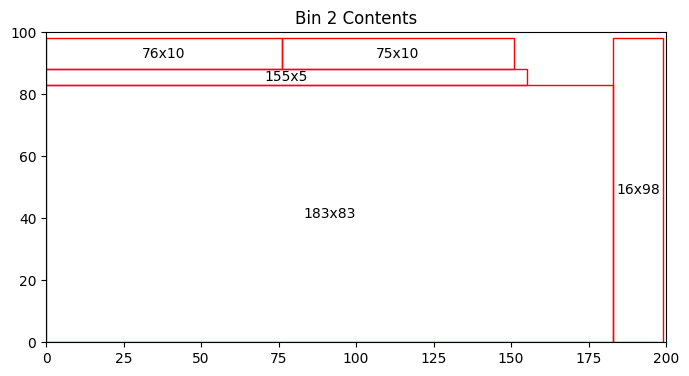

Bin 2 has 958.00 units of area left


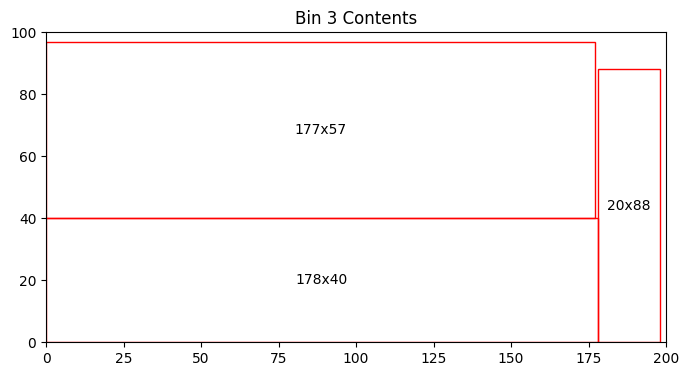

Bin 3 has 1031.00 units of area left


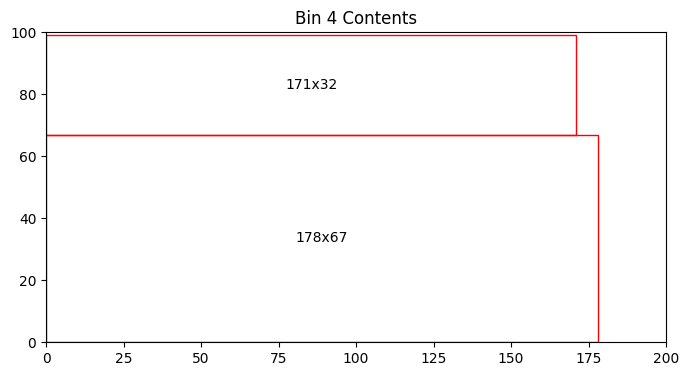

Bin 4 has 2602.00 units of area left


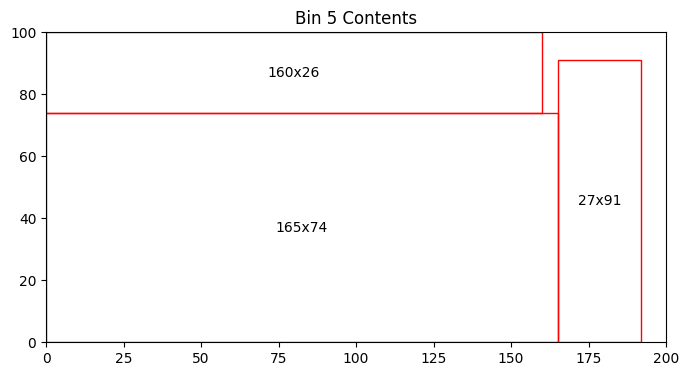

Bin 5 has 1173.00 units of area left


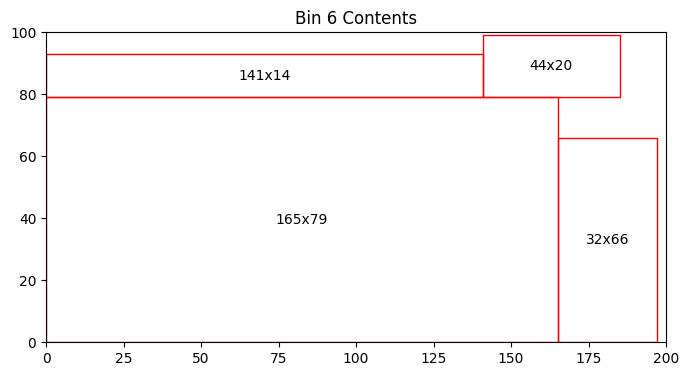

Bin 6 has 1999.00 units of area left


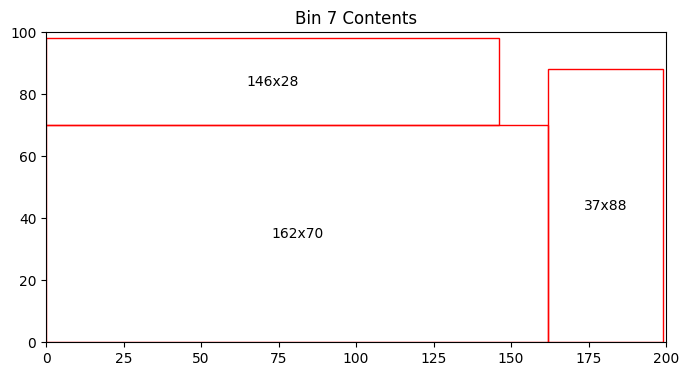

Bin 7 has 1316.00 units of area left


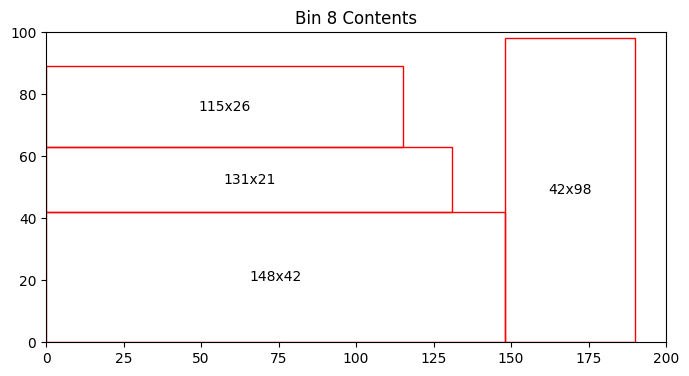

Bin 8 has 3927.00 units of area left


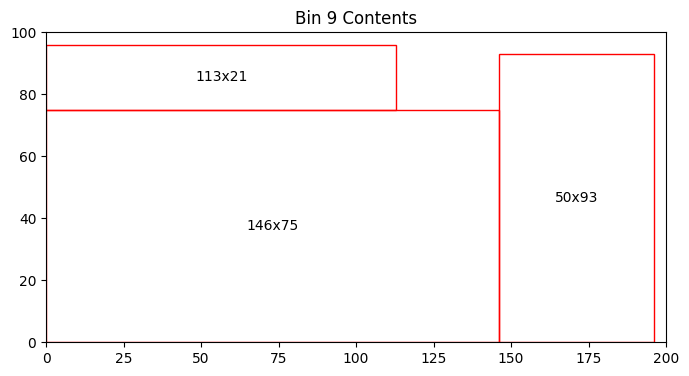

Bin 9 has 2027.00 units of area left


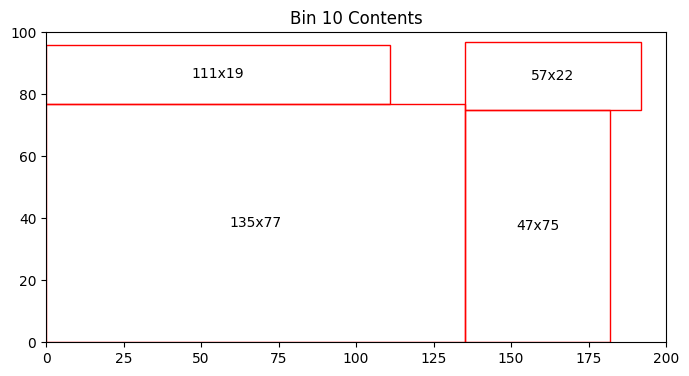

Bin 10 has 2717.00 units of area left


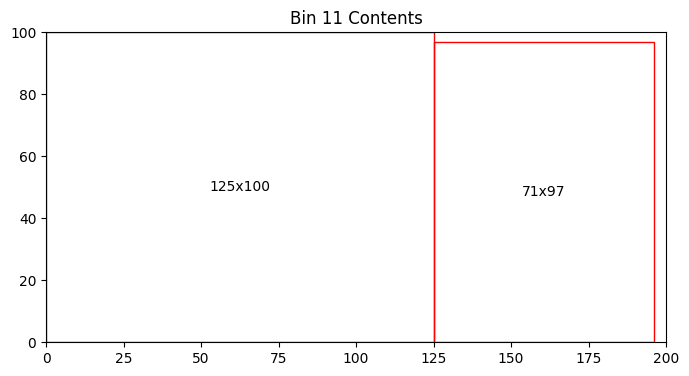

Bin 11 has 613.00 units of area left


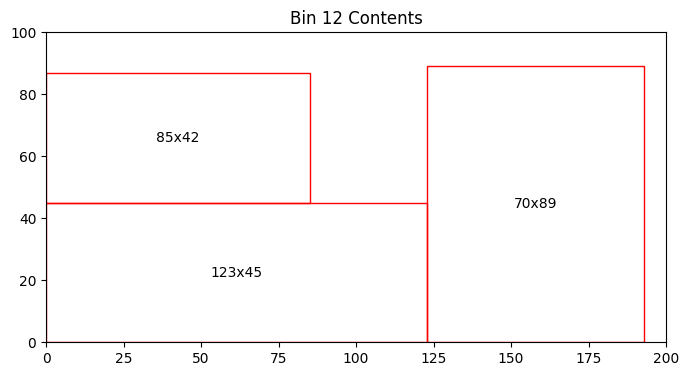

Bin 12 has 4665.00 units of area left


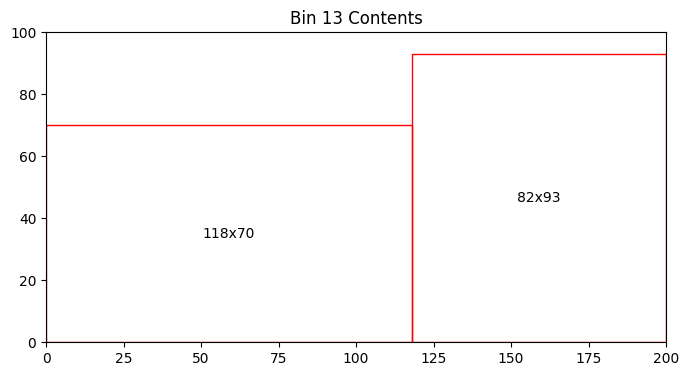

Bin 13 has 4114.00 units of area left


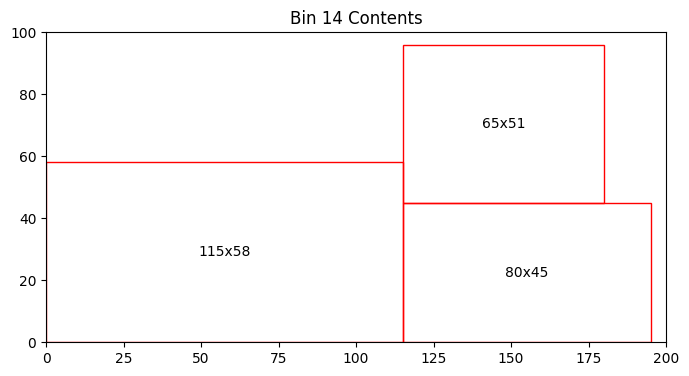

Bin 14 has 6415.00 units of area left


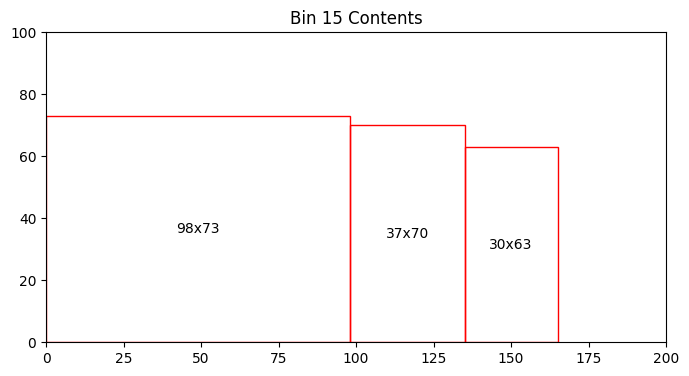

Bin 15 has 8366.00 units of area left


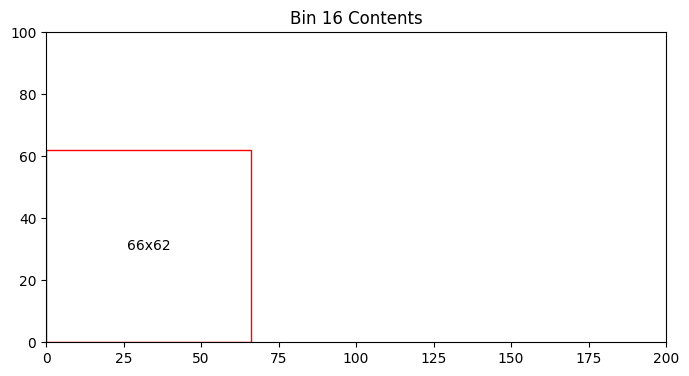

Bin 16 has 15908.00 units of area left
Total number of bins = 16
Total area left in bins = 58938.00
[[123  85]
 [  2  21]
 [ 11  95]
 [  5  64]
 [189  22]
 [144  42]
 [ 18  66]
 [199  91]
 [ 11  60]
 [ 96  60]
 [ 98  30]
 [175  62]
 [ 38  26]
 [120  66]
 [130 100]
 [ 85  57]
 [167  79]
 [160  68]
 [ 50  62]
 [  1  88]
 [170  10]
 [  9  20]
 [110  92]
 [142  95]
 [158  90]
 [ 32  72]
 [ 75  52]
 [  4  95]
 [159   2]
 [165   5]
 [188  14]
 [ 92   8]
 [ 40  67]
 [157  27]
 [107  84]
 [ 94  35]
 [ 99  65]
 [ 38  55]
 [ 55   9]
 [180  50]
 [153  73]
 [ 93  15]
 [138  46]
 [129  35]
 [  2  40]
 [ 74  70]
 [113  52]
 [  6   5]
 [ 50  27]
 [181  53]]


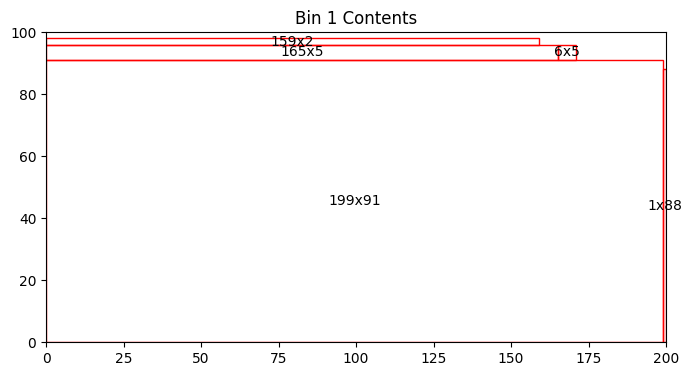

Bin 1 has 630.00 units of area left


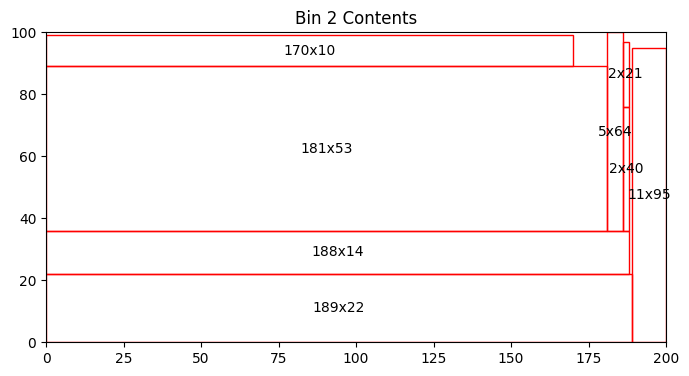

Bin 2 has 430.00 units of area left


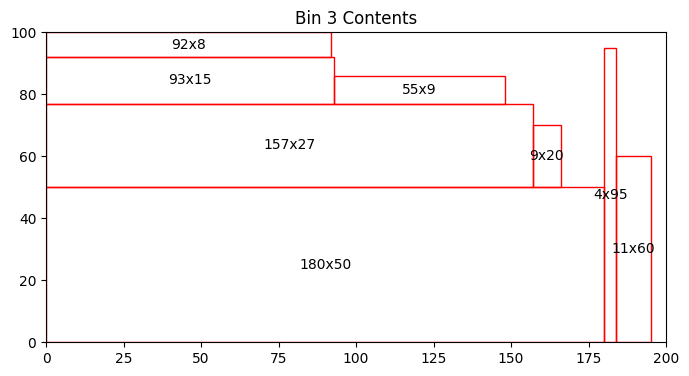

Bin 3 has 2915.00 units of area left


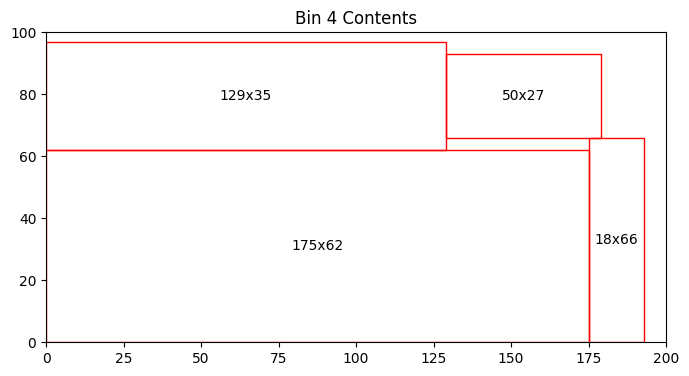

Bin 4 has 2097.00 units of area left


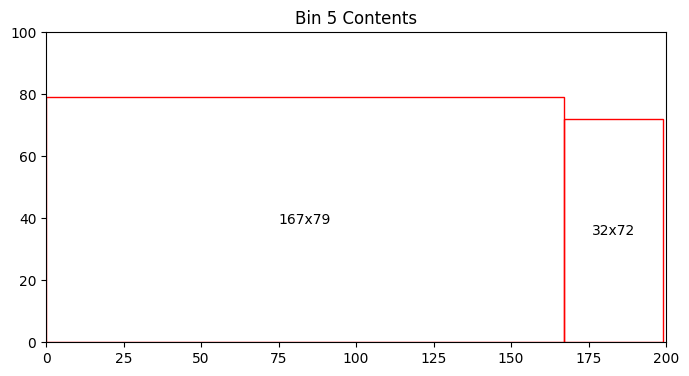

Bin 5 has 4503.00 units of area left


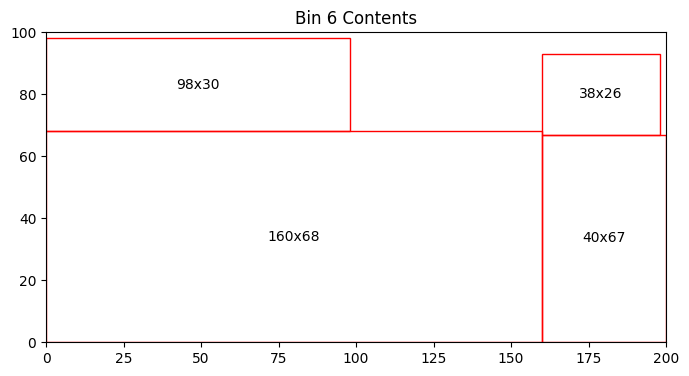

Bin 6 has 2512.00 units of area left


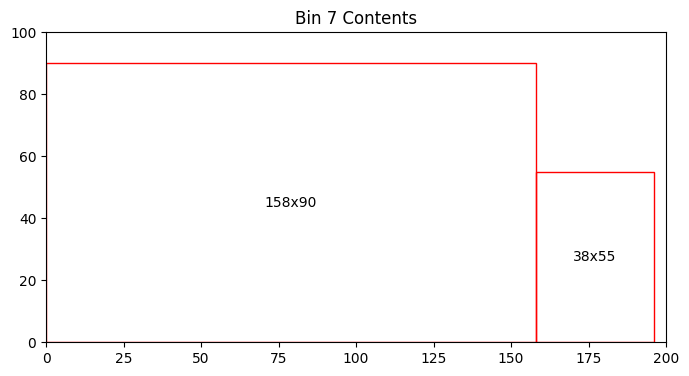

Bin 7 has 3690.00 units of area left


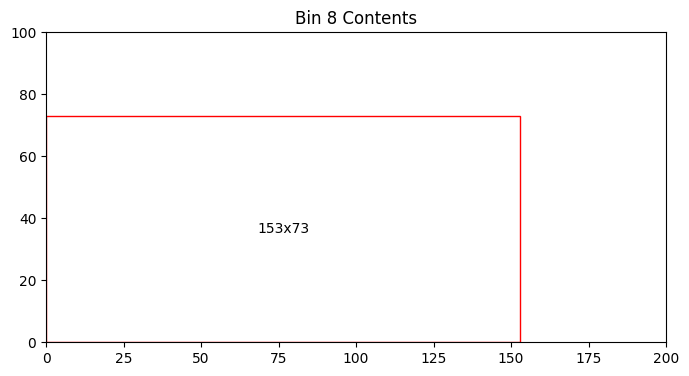

Bin 8 has 8831.00 units of area left


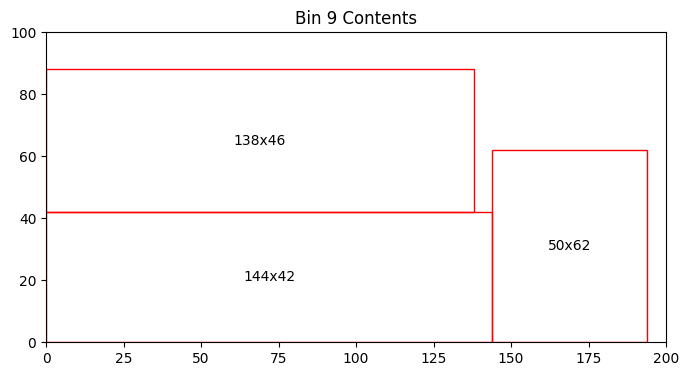

Bin 9 has 4504.00 units of area left


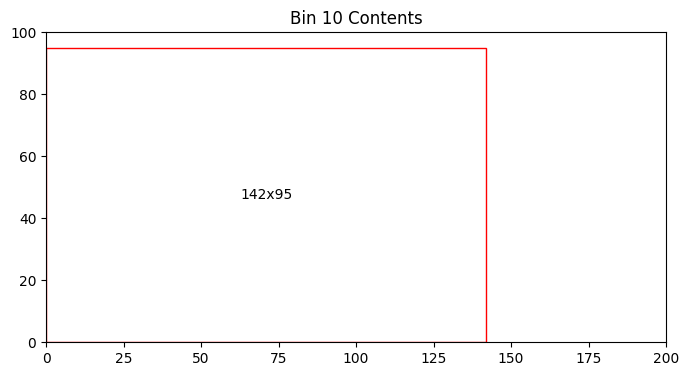

Bin 10 has 6510.00 units of area left


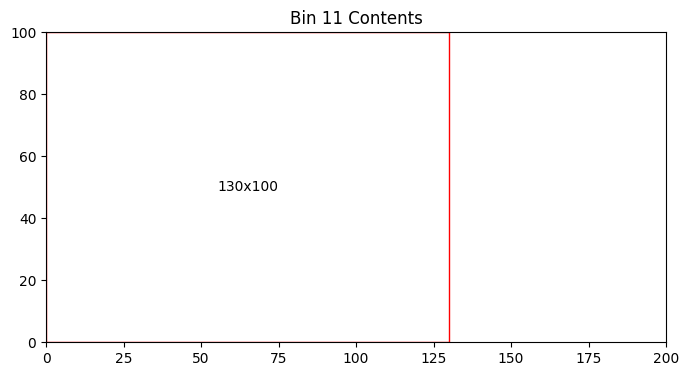

Bin 11 has 7000.00 units of area left


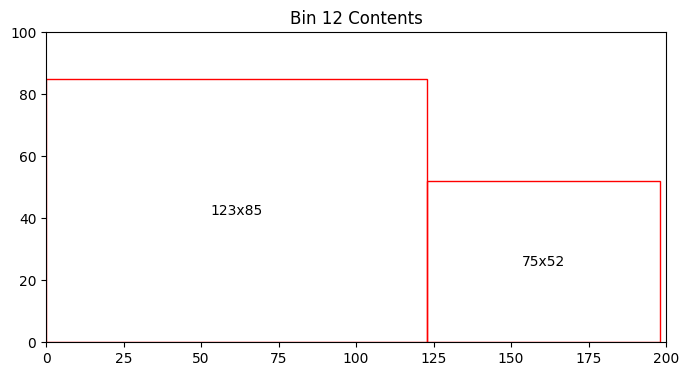

Bin 12 has 5645.00 units of area left


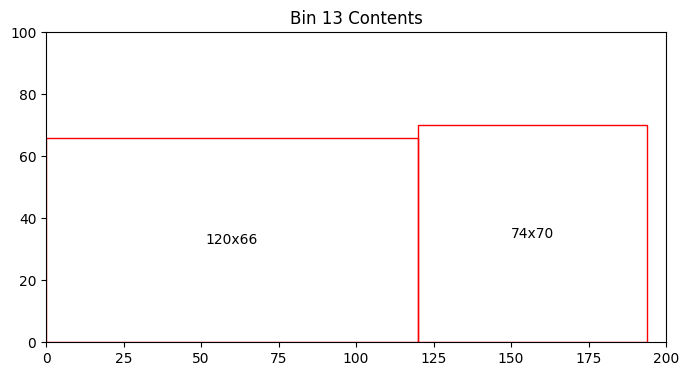

Bin 13 has 6900.00 units of area left


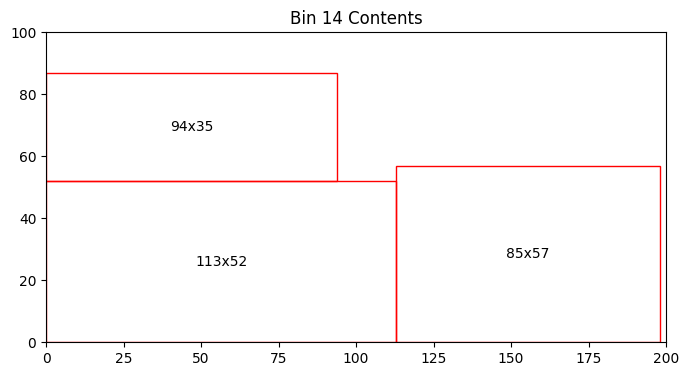

Bin 14 has 5989.00 units of area left


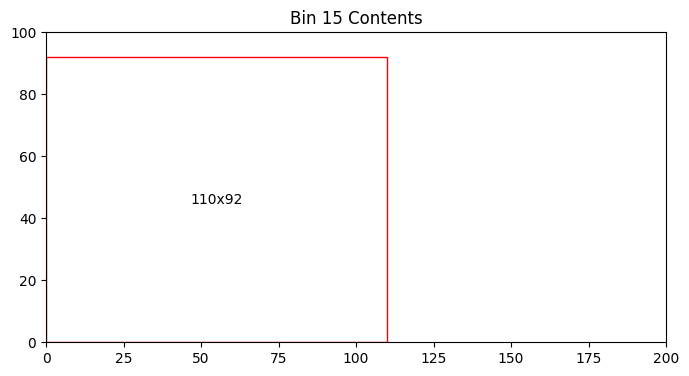

Bin 15 has 9880.00 units of area left


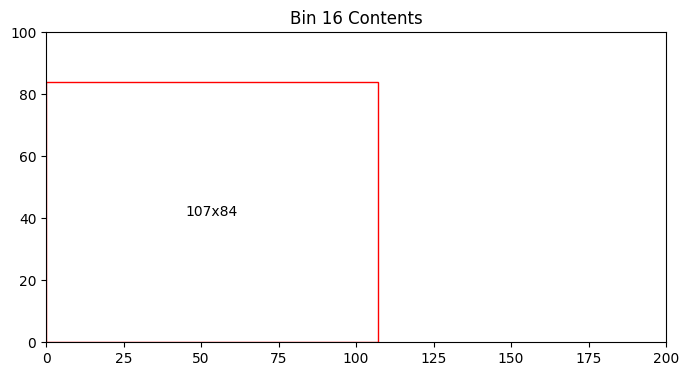

Bin 16 has 11012.00 units of area left


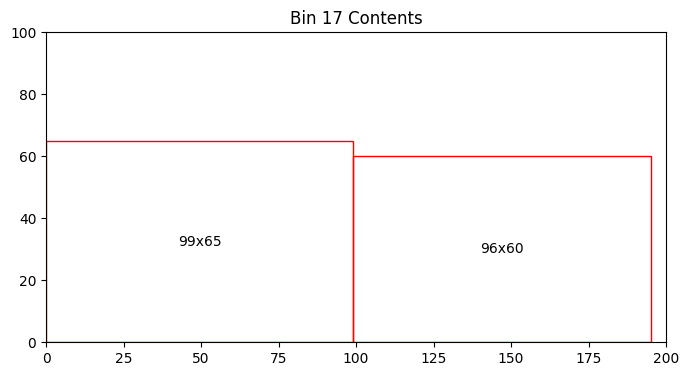

Bin 17 has 7805.00 units of area left
Total number of bins = 17
Total area left in bins = 90853.00
[[ 99  24]
 [104  74]
 [ 15  34]
 [ 96  79]
 [113  30]
 [100   7]
 [ 12  38]
 [194  20]
 [132  41]
 [ 48  20]
 [ 99  44]
 [ 18  35]
 [131  65]
 [ 84  67]
 [ 70  63]
 [ 92  28]
 [ 65  18]
 [ 90  50]
 [184  21]
 [171  10]
 [119  23]
 [192  51]
 [ 35  35]
 [156  26]
 [ 37  94]
 [ 49   6]
 [135   4]
 [109   5]
 [  7  70]
 [ 52  26]
 [156  55]
 [ 40  58]
 [193  46]
 [ 74  17]
 [ 16  55]
 [ 33  99]
 [ 17  85]
 [  7   2]
 [ 32  33]
 [ 63   2]
 [158  87]
 [120  66]
 [118  16]
 [159  84]
 [179  82]
 [ 45  78]
 [184   4]
 [105  60]
 [171   5]
 [ 46 100]]


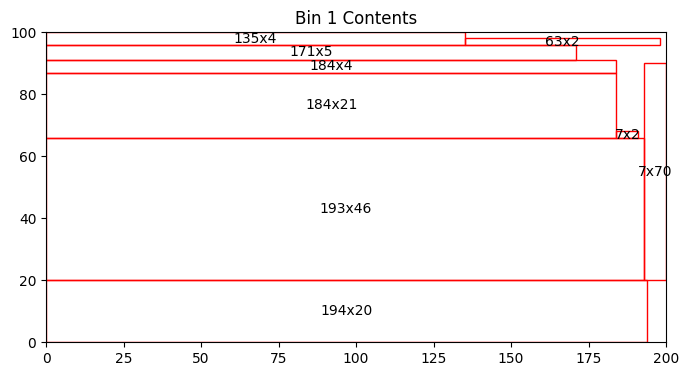

Bin 1 has 617.00 units of area left


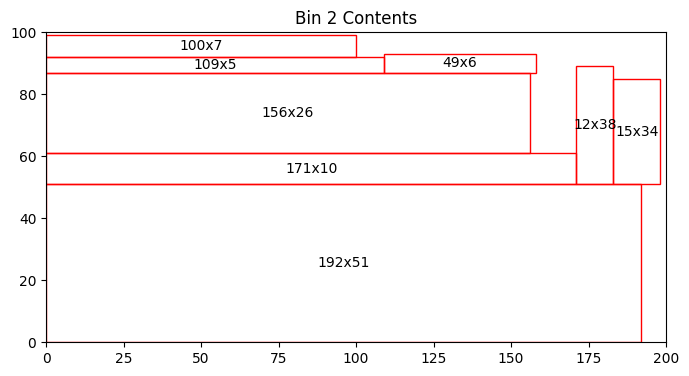

Bin 2 has 1937.00 units of area left


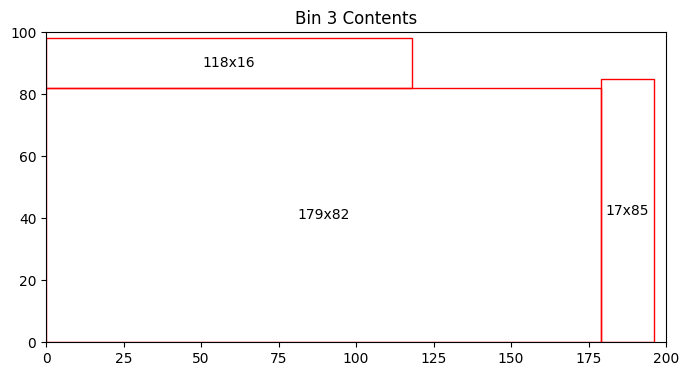

Bin 3 has 1989.00 units of area left


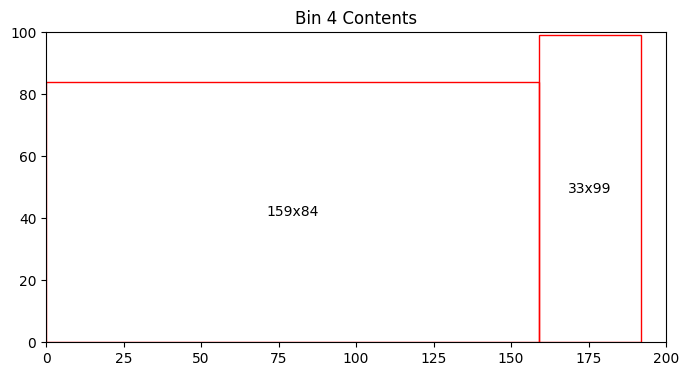

Bin 4 has 3377.00 units of area left


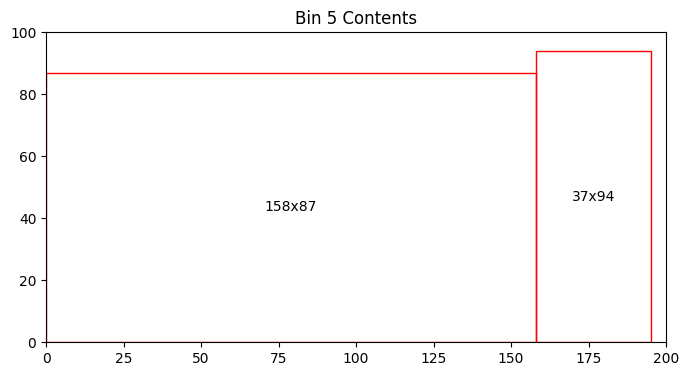

Bin 5 has 2776.00 units of area left


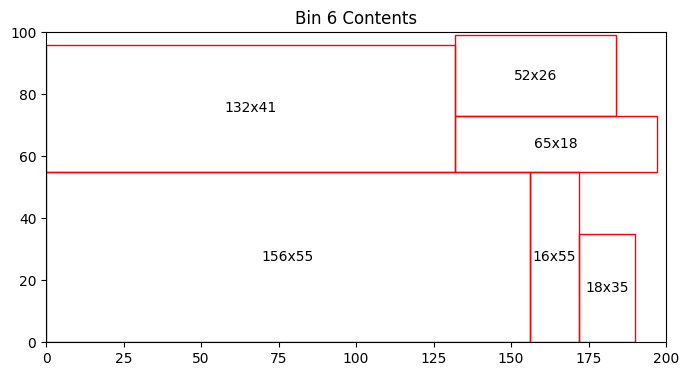

Bin 6 has 1976.00 units of area left


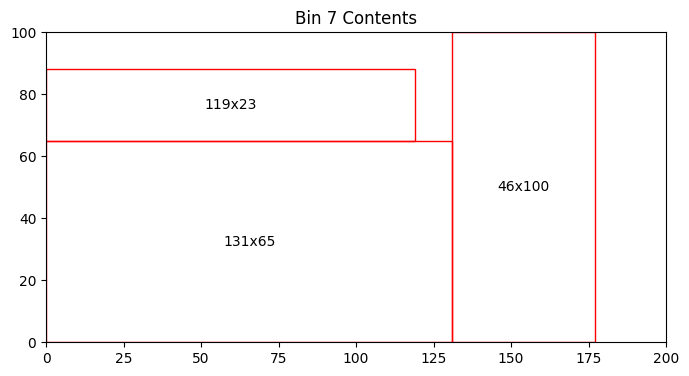

Bin 7 has 4148.00 units of area left


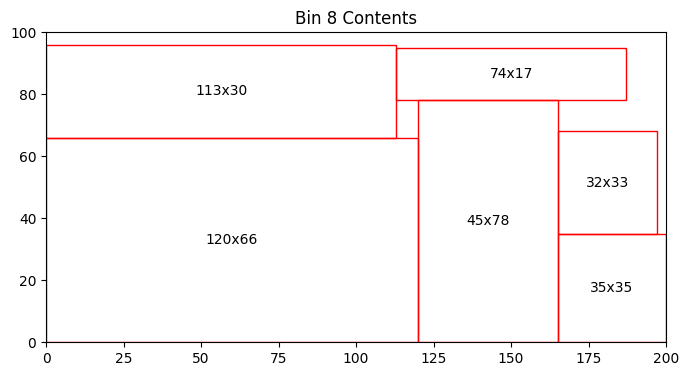

Bin 8 has 1641.00 units of area left


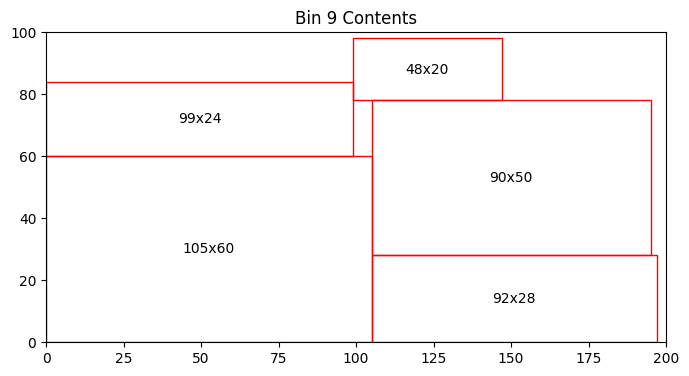

Bin 9 has 3288.00 units of area left


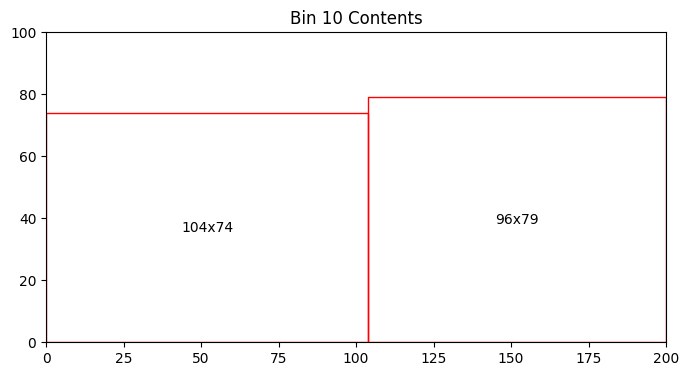

Bin 10 has 4720.00 units of area left


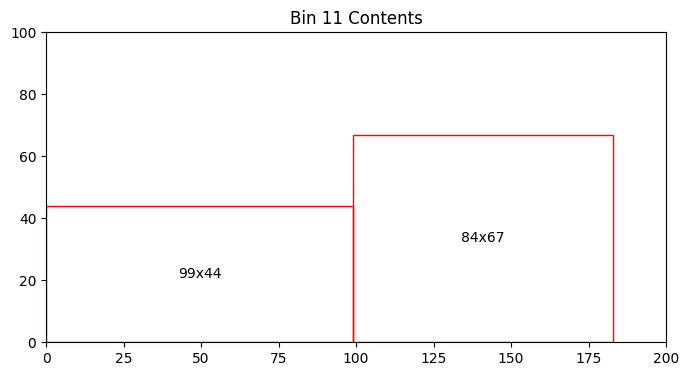

Bin 11 has 10016.00 units of area left


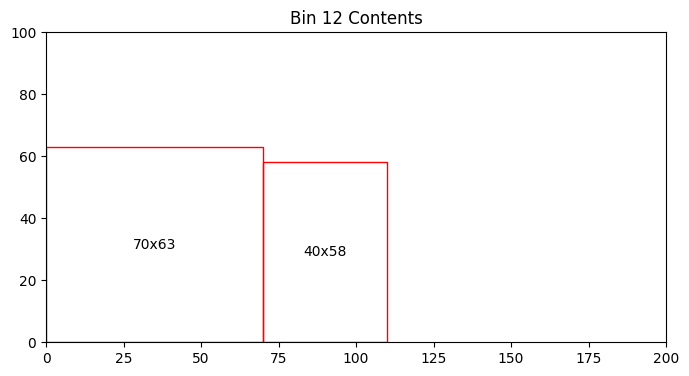

Bin 12 has 13270.00 units of area left
Total number of bins = 12
Total area left in bins = 49755.00
[[ 18  95]
 [ 70  52]
 [101  21]
 [125  31]
 [143  23]
 [134  18]
 [  8  76]
 [157  79]
 [ 11  65]
 [131  93]
 [188  97]
 [ 12  51]
 [128   9]
 [165  96]
 [ 74  31]
 [158  80]
 [133  38]
 [ 73  10]
 [187  97]
 [ 34  33]
 [ 55  17]
 [ 28  21]
 [ 81  27]
 [ 80  65]
 [ 40  13]
 [ 73  89]
 [159  89]
 [181   4]
 [194  58]
 [ 85  17]
 [154  52]
 [ 11  39]
 [190  45]
 [116  67]
 [ 27  99]
 [147  91]
 [148  76]
 [137  74]
 [ 59  95]
 [ 27   9]
 [ 36  19]
 [111  67]
 [ 59  90]
 [ 66  82]
 [ 28  93]
 [178  29]
 [152  14]
 [102  97]
 [ 60  62]
 [ 21  97]]


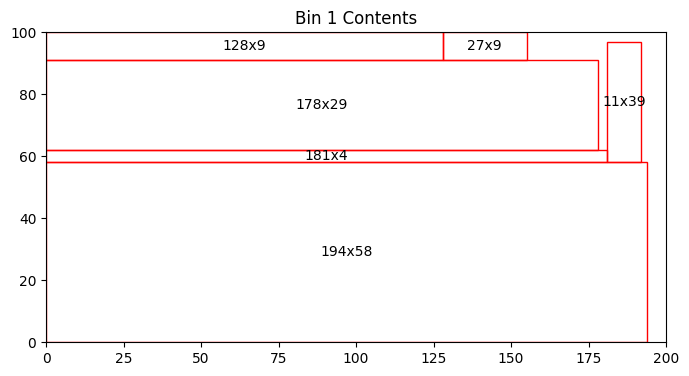

Bin 1 has 1038.00 units of area left


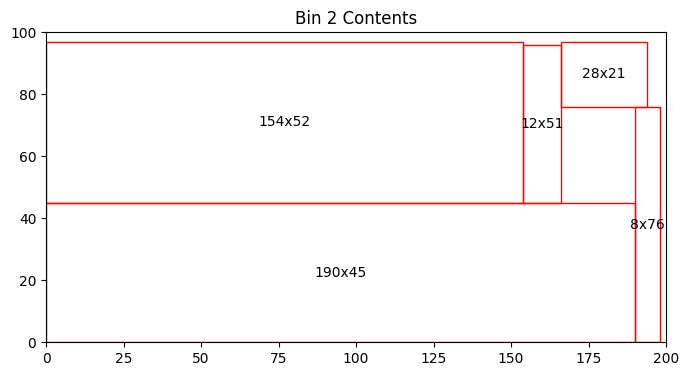

Bin 2 has 1634.00 units of area left


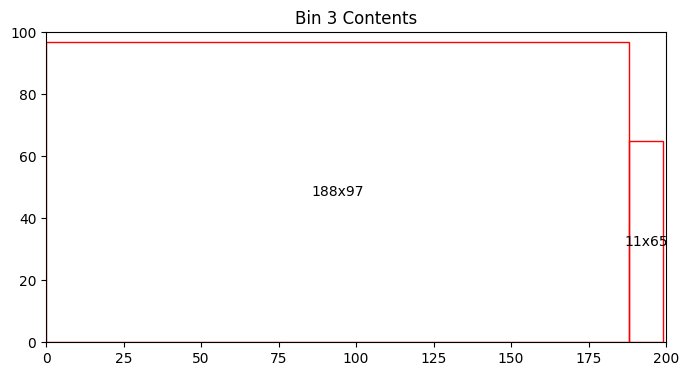

Bin 3 has 1049.00 units of area left


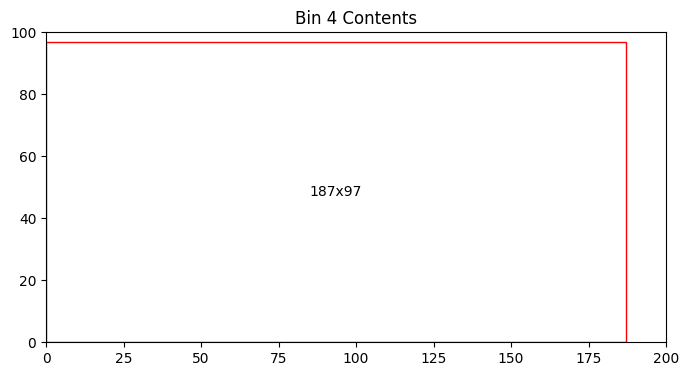

Bin 4 has 1861.00 units of area left


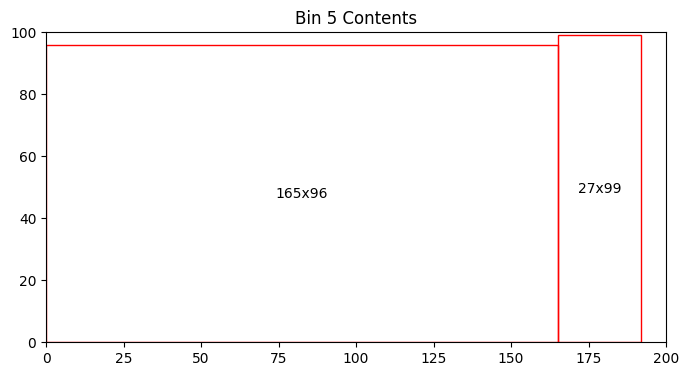

Bin 5 has 1487.00 units of area left


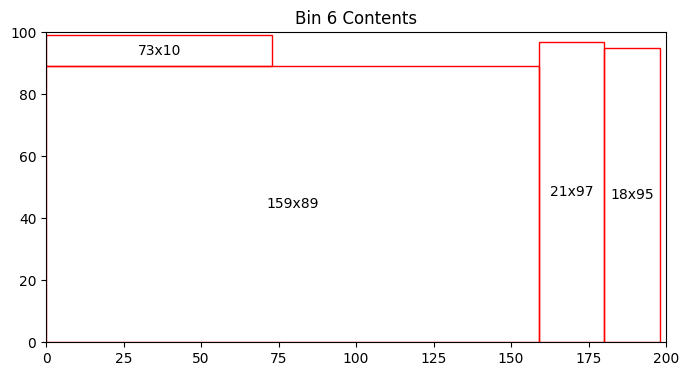

Bin 6 has 1372.00 units of area left


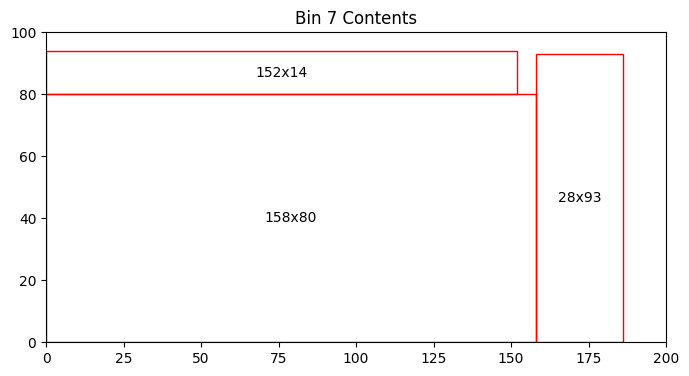

Bin 7 has 2628.00 units of area left


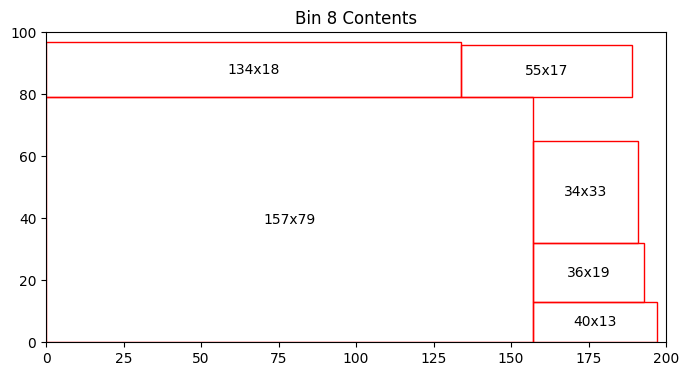

Bin 8 has 1924.00 units of area left


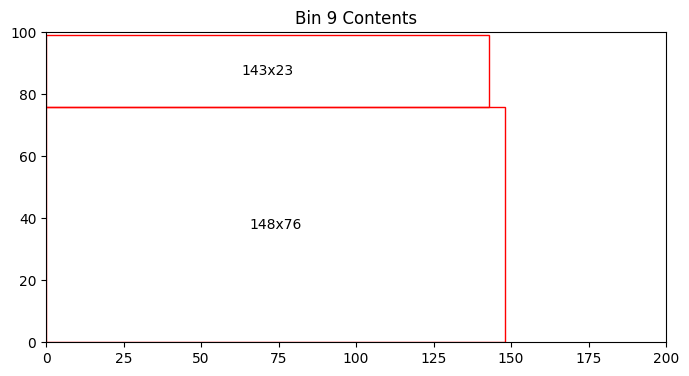

Bin 9 has 5463.00 units of area left


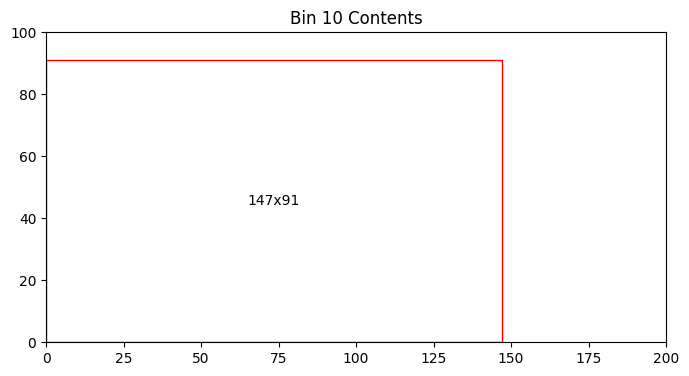

Bin 10 has 6623.00 units of area left


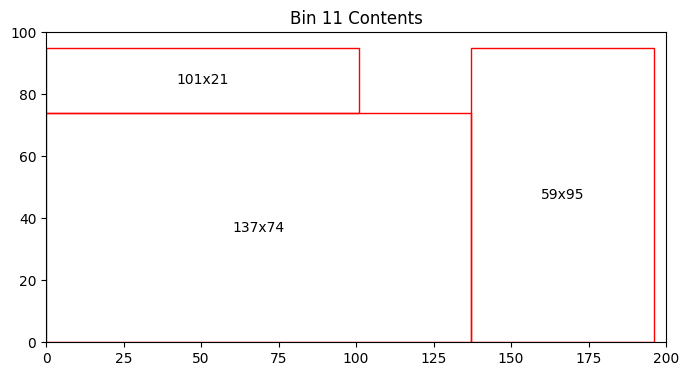

Bin 11 has 2136.00 units of area left


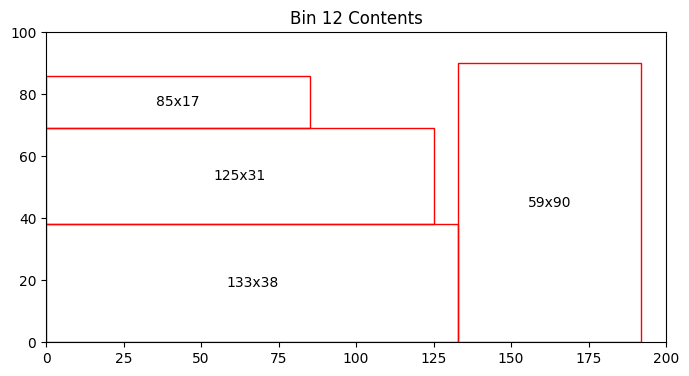

Bin 12 has 4316.00 units of area left


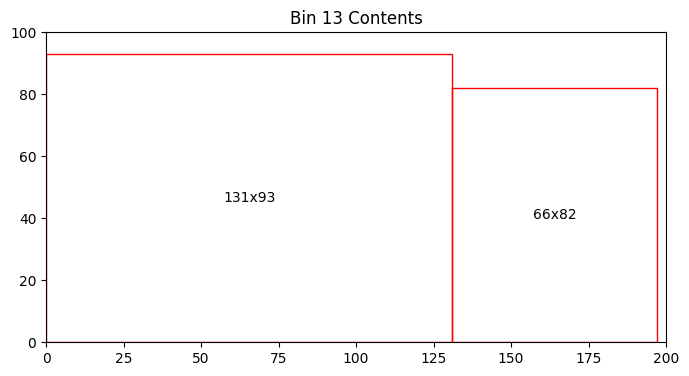

Bin 13 has 2405.00 units of area left


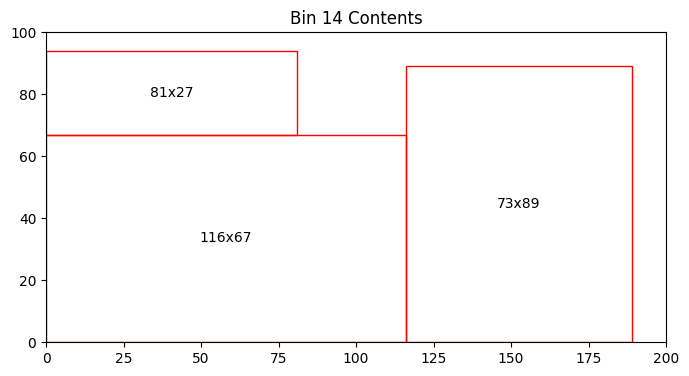

Bin 14 has 3544.00 units of area left


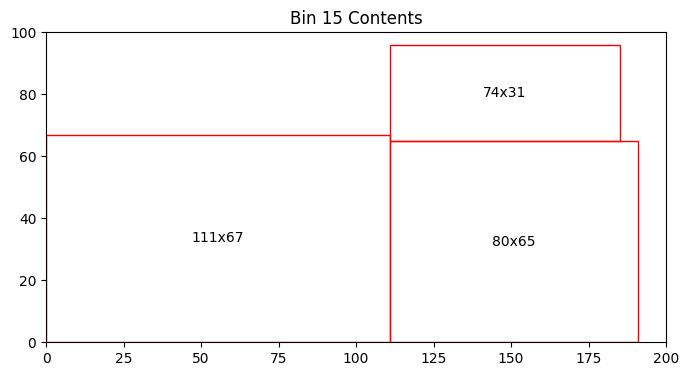

Bin 15 has 5069.00 units of area left


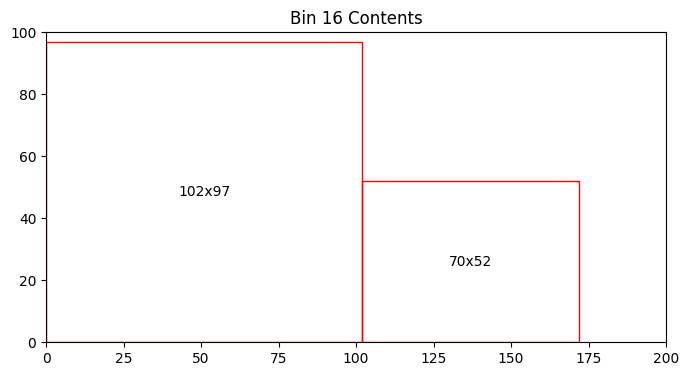

Bin 16 has 6466.00 units of area left


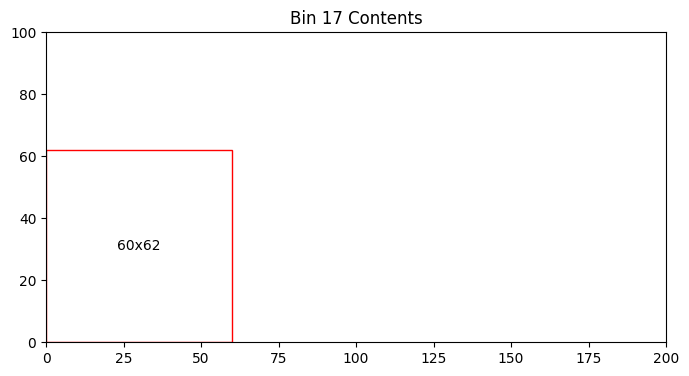

Bin 17 has 16280.00 units of area left
Total number of bins = 17
Total area left in bins = 65295.00
[[126  10]
 [181  71]
 [181  23]
 [ 88  37]
 [158  64]
 [180  53]
 [ 84   5]
 [156  45]
 [131  28]
 [129   1]
 [ 60  70]
 [125  19]
 [175  97]
 [ 76   5]
 [ 61  70]
 [112  13]
 [198  35]
 [ 70  59]
 [188  42]
 [ 63  32]
 [150  94]
 [  8  94]
 [ 24  68]
 [ 21  86]
 [ 54  99]
 [156   6]
 [ 13  61]
 [ 58  23]
 [ 83   1]
 [197  67]
 [130  52]
 [109  66]
 [110  46]
 [154  99]
 [196   8]
 [ 58  78]
 [ 88  86]
 [144  37]
 [ 59  47]
 [ 74  27]
 [143  51]
 [125  64]
 [113  51]
 [199  46]
 [146  52]
 [ 99  49]
 [ 75  87]
 [ 48  25]
 [186 100]
 [ 77  25]]


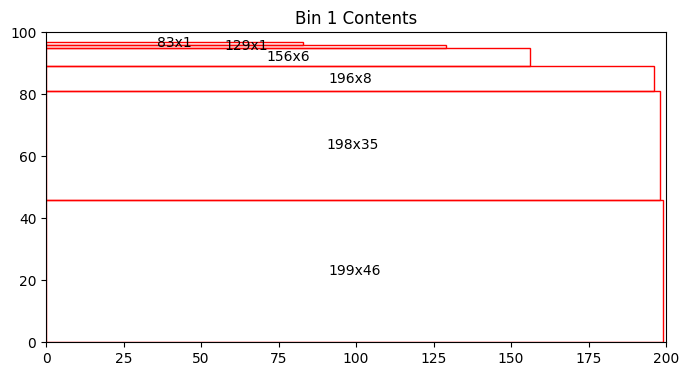

Bin 1 has 1200.00 units of area left


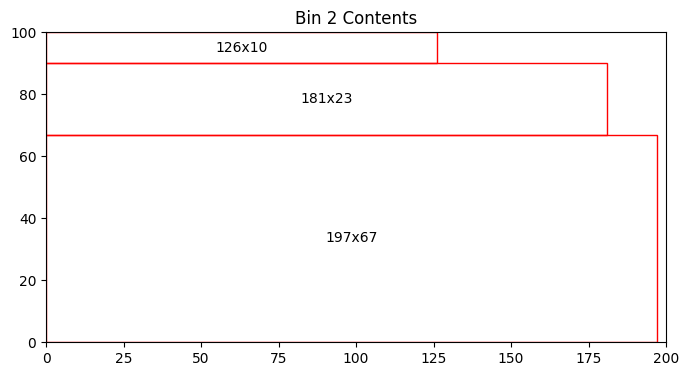

Bin 2 has 1378.00 units of area left


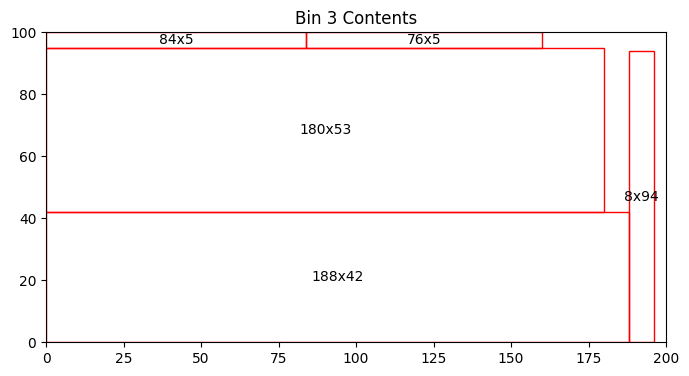

Bin 3 has 1012.00 units of area left


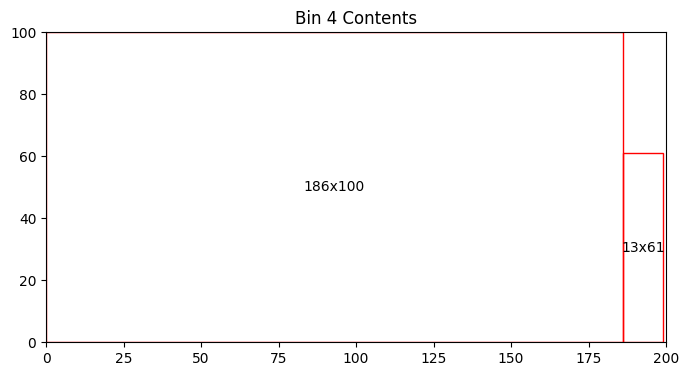

Bin 4 has 607.00 units of area left


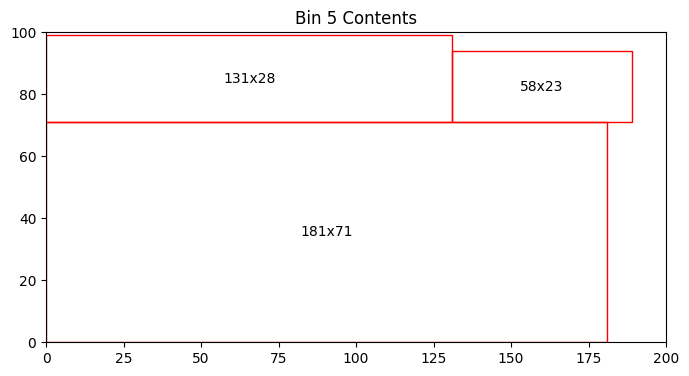

Bin 5 has 2147.00 units of area left


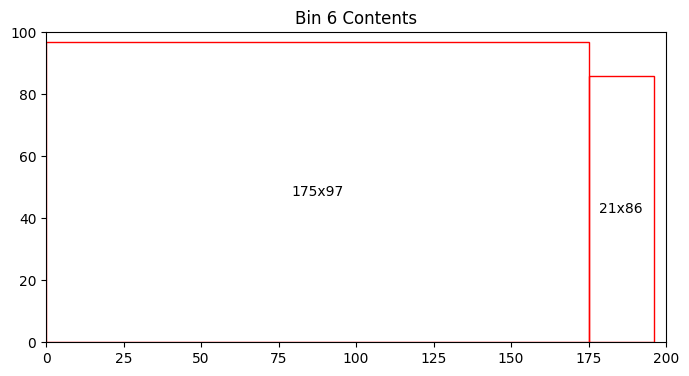

Bin 6 has 1219.00 units of area left


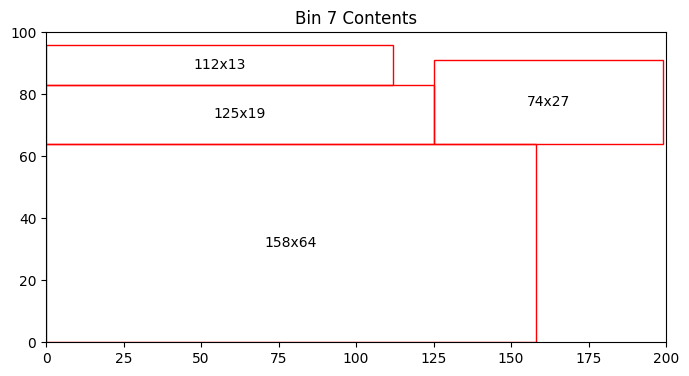

Bin 7 has 4059.00 units of area left


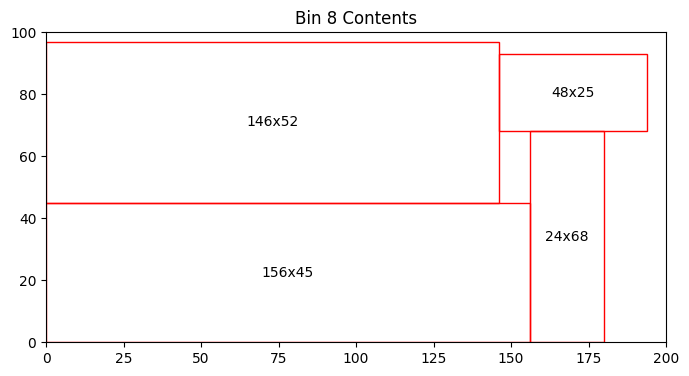

Bin 8 has 2556.00 units of area left


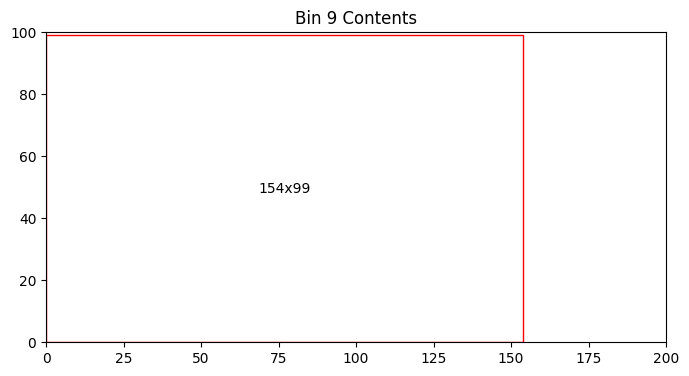

Bin 9 has 4754.00 units of area left


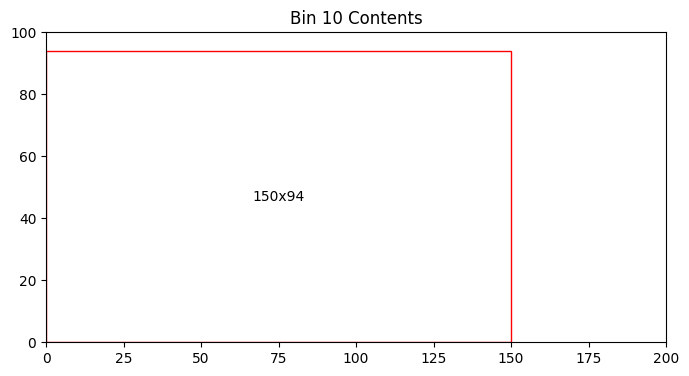

Bin 10 has 5900.00 units of area left


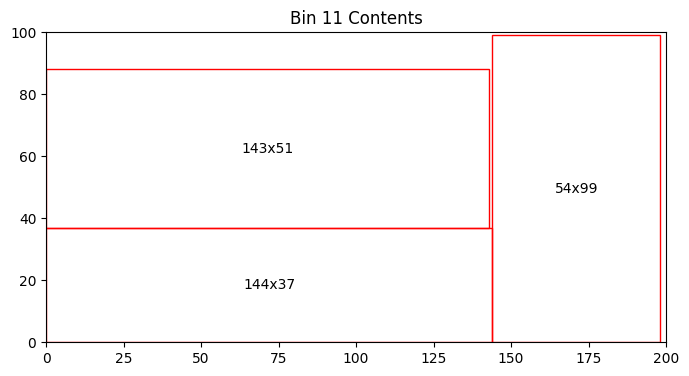

Bin 11 has 2033.00 units of area left


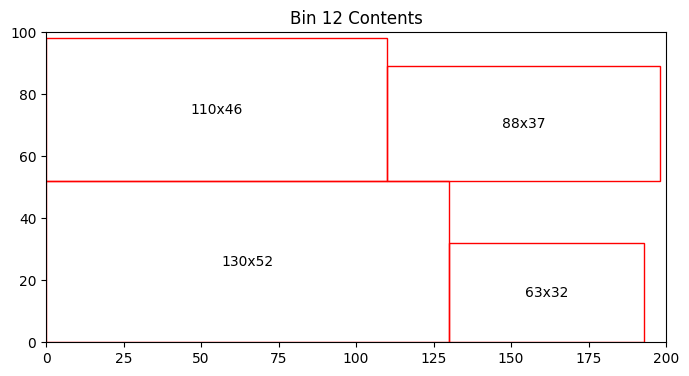

Bin 12 has 2908.00 units of area left


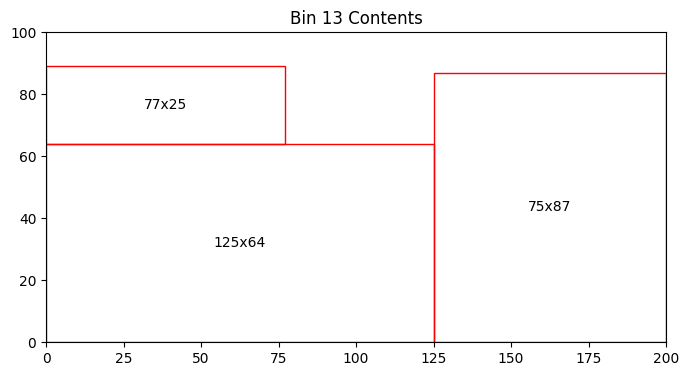

Bin 13 has 3550.00 units of area left


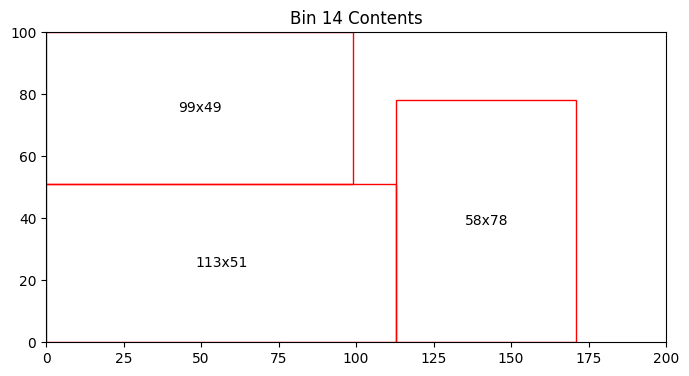

Bin 14 has 4862.00 units of area left


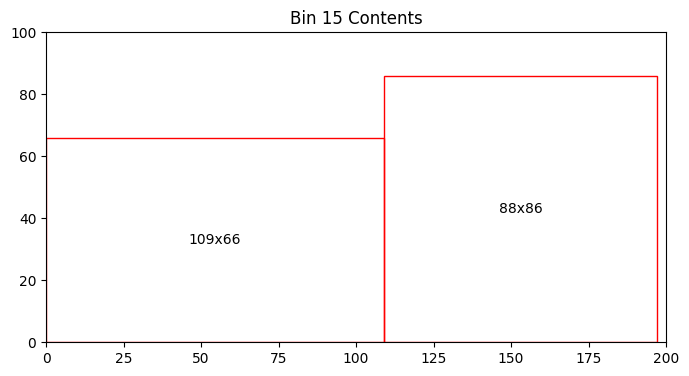

Bin 15 has 5238.00 units of area left


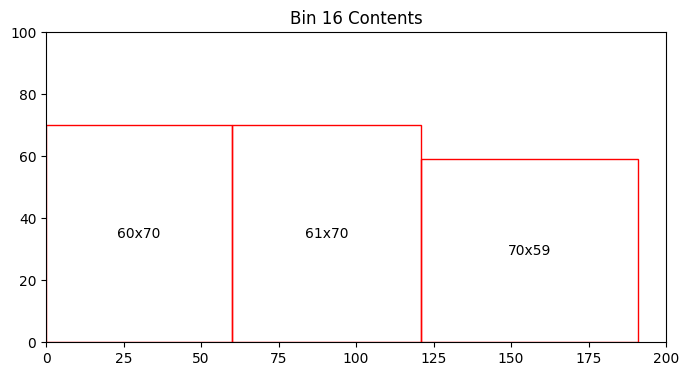

Bin 16 has 7400.00 units of area left


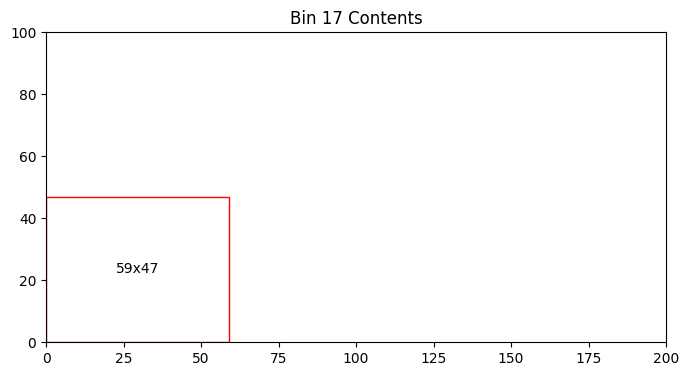

Bin 17 has 17227.00 units of area left
Total number of bins = 17
Total area left in bins = 68050.00
[[108  92]
 [ 20  26]
 [183  84]
 [ 70  29]
 [120  42]
 [ 69  10]
 [132  41]
 [156  94]
 [100  24]
 [117  19]
 [102  20]
 [123  77]
 [ 62  24]
 [181  14]
 [ 83  40]
 [136   7]
 [ 92  84]
 [107  45]
 [  6  71]
 [ 42  39]
 [ 92  59]
 [ 82  12]
 [ 50  62]
 [ 97  81]
 [134   1]
 [ 39  42]
 [ 94   5]
 [138  57]
 [ 80  23]
 [ 34   5]
 [ 27  51]
 [ 90  30]
 [106  64]
 [  8  79]
 [140  80]
 [ 67  53]
 [ 59  93]
 [ 28  50]
 [199  37]
 [ 21   9]
 [ 20  64]
 [154  13]
 [119  25]
 [187  58]
 [197   9]
 [188  93]
 [157  56]
 [ 82  95]
 [183  93]
 [ 96  14]]


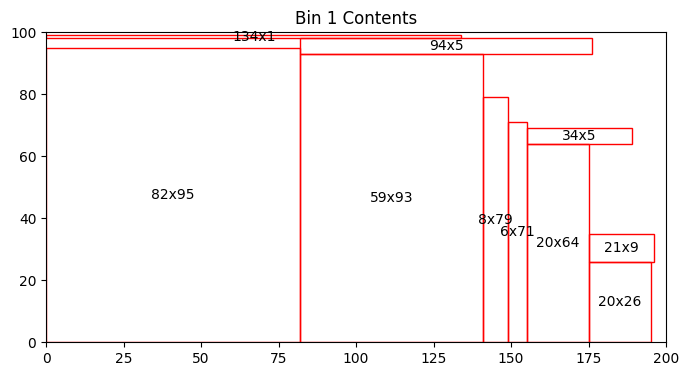

Bin 1 has 2902.00 units of area left


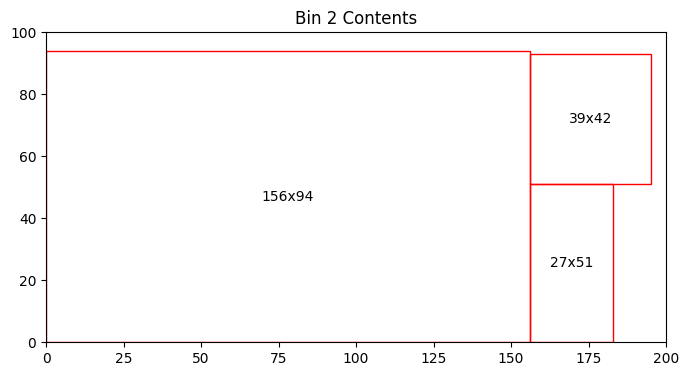

Bin 2 has 2321.00 units of area left


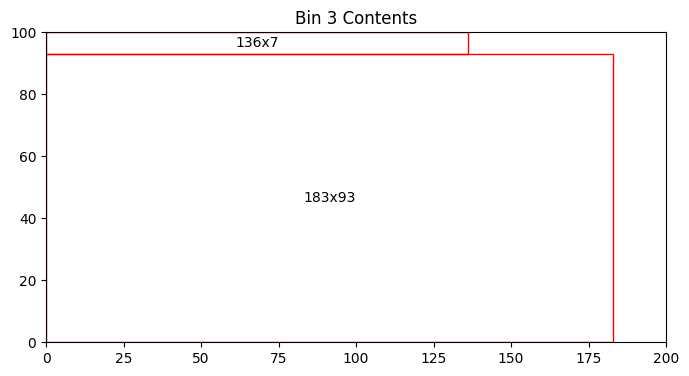

Bin 3 has 2029.00 units of area left


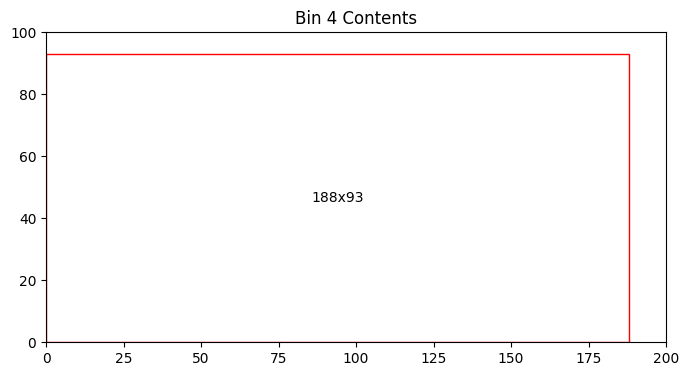

Bin 4 has 2516.00 units of area left


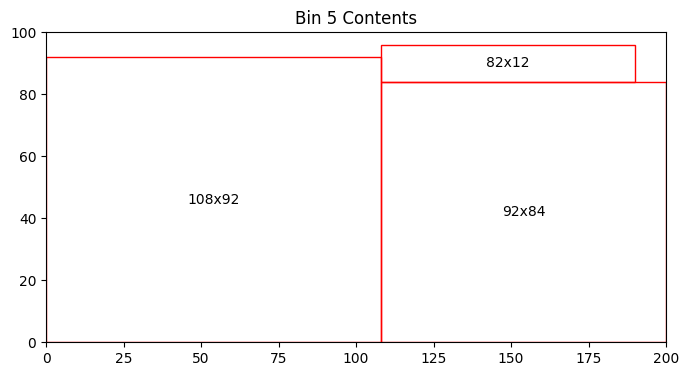

Bin 5 has 1352.00 units of area left


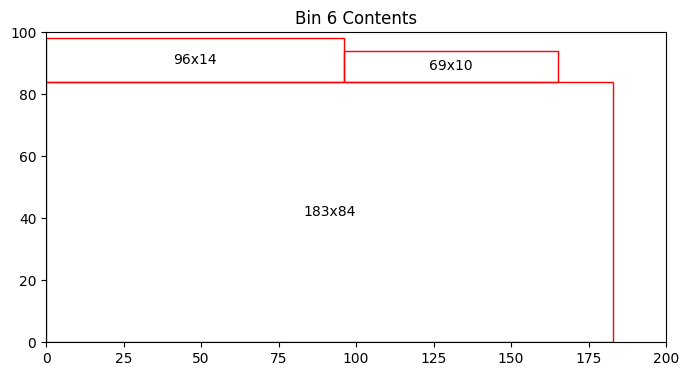

Bin 6 has 2594.00 units of area left


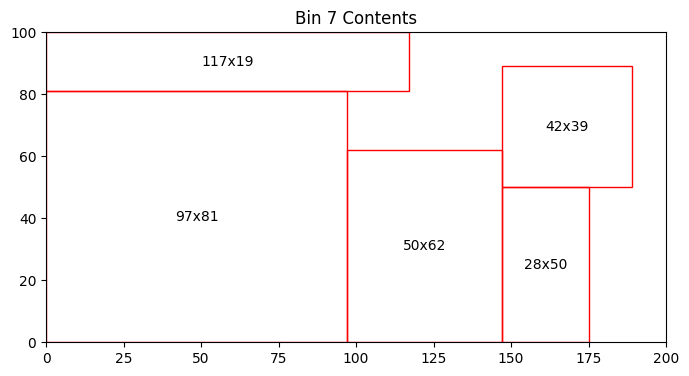

Bin 7 has 3782.00 units of area left


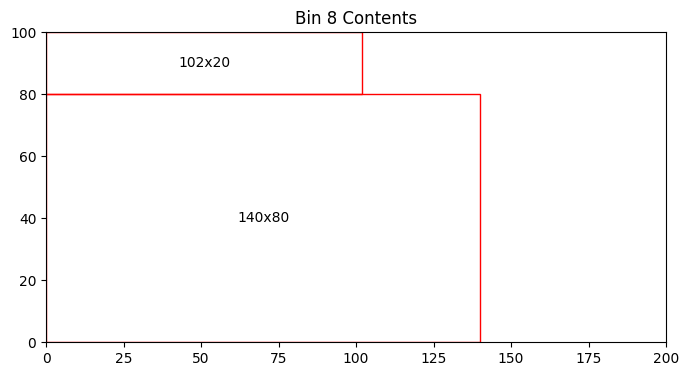

Bin 8 has 6760.00 units of area left


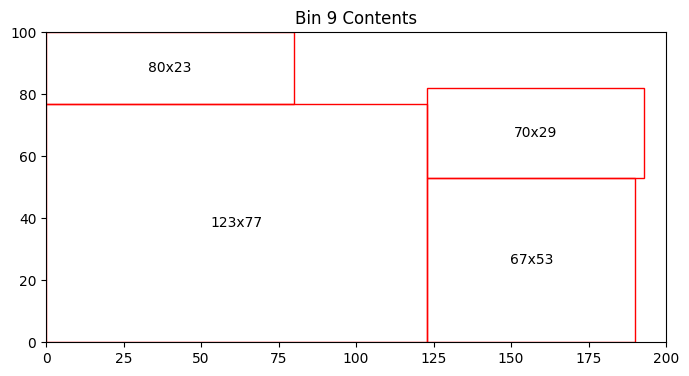

Bin 9 has 3108.00 units of area left


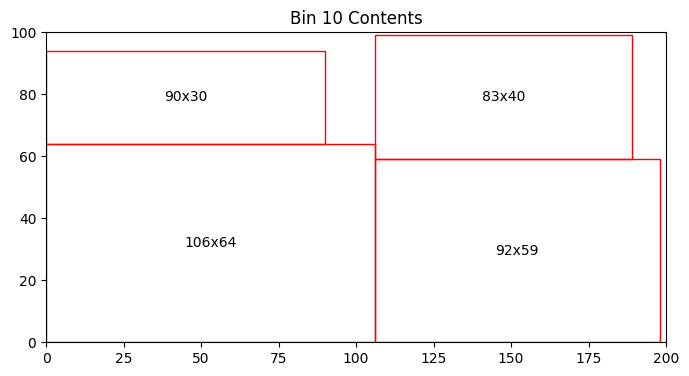

Bin 10 has 1768.00 units of area left


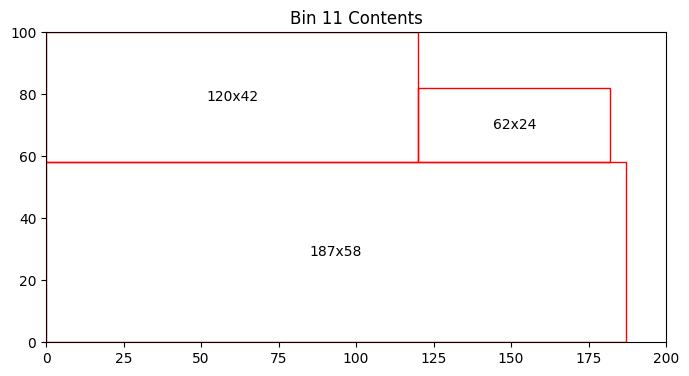

Bin 11 has 2626.00 units of area left


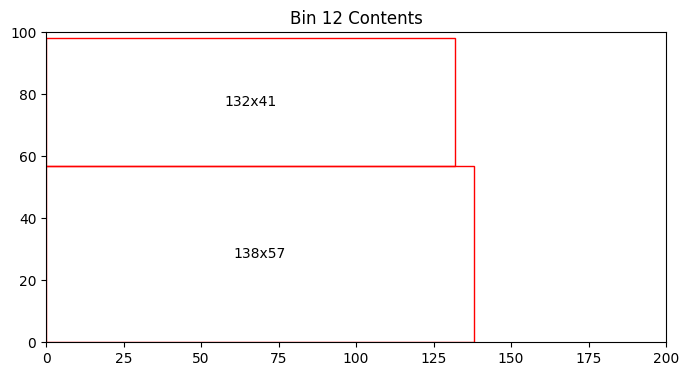

Bin 12 has 6722.00 units of area left


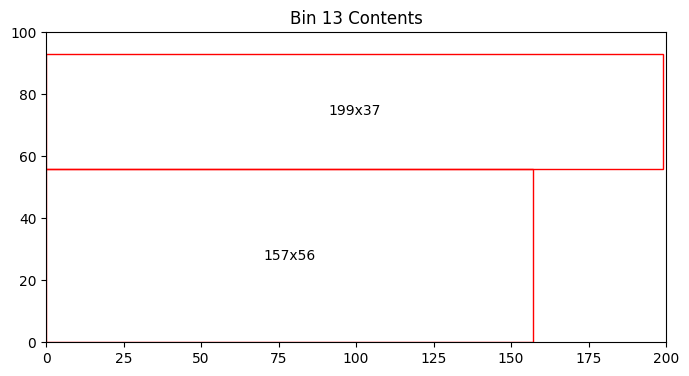

Bin 13 has 3845.00 units of area left


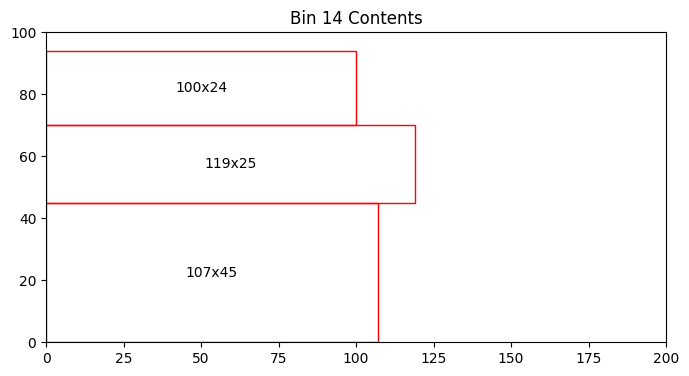

Bin 14 has 9810.00 units of area left


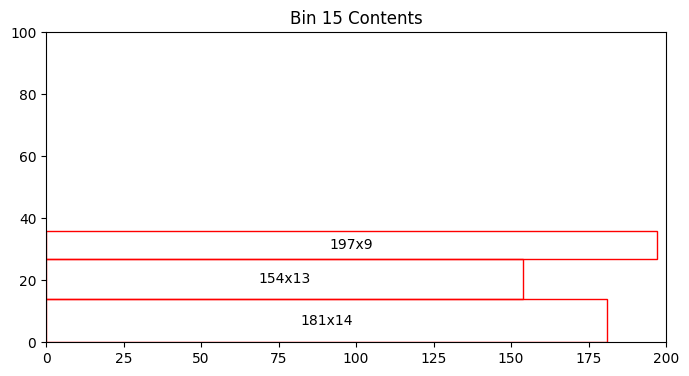

Bin 15 has 13691.00 units of area left
Total number of bins = 15
Total area left in bins = 65826.00
[[176  16]
 [188  50]
 [157   5]
 [157  54]
 [195  53]
 [187  62]
 [ 64  67]
 [ 18  27]
 [162  36]
 [ 77  12]
 [ 25  54]
 [ 87  32]
 [154  20]
 [ 32  93]
 [ 75  95]
 [ 90  40]
 [ 90  34]
 [157  98]
 [ 35  62]
 [158  90]
 [107  99]
 [133  16]
 [192  11]
 [ 19  52]
 [  8  32]
 [153  11]
 [ 22  76]
 [155  54]
 [127  68]
 [171  97]
 [139  92]
 [ 20  43]
 [170  99]
 [184  82]
 [127  90]
 [121  39]
 [170  41]
 [ 81   2]
 [142  55]
 [ 92  45]
 [ 59  39]
 [ 30  34]
 [ 98  14]
 [194  32]
 [ 11  17]
 [119  90]
 [100  11]
 [ 84  74]
 [130  39]
 [ 32  68]]


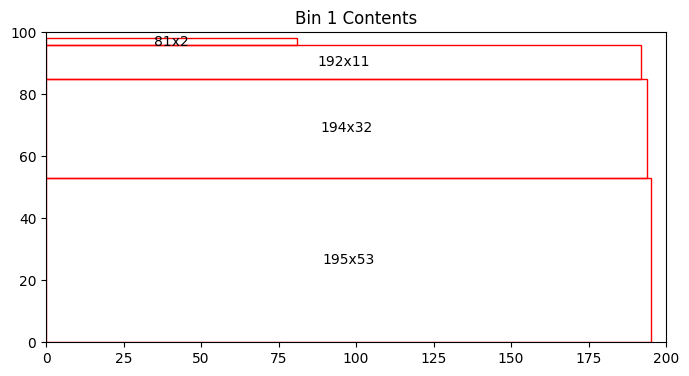

Bin 1 has 1183.00 units of area left


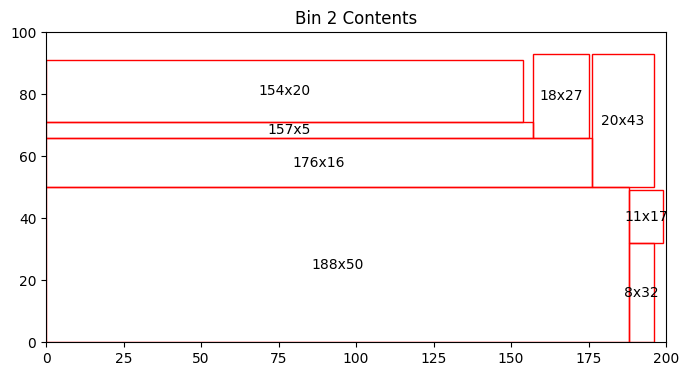

Bin 2 has 2130.00 units of area left


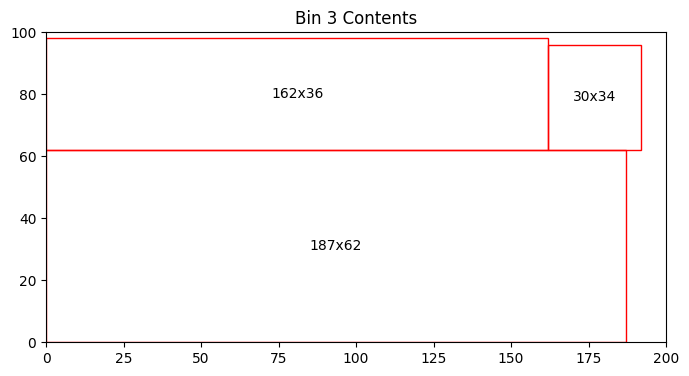

Bin 3 has 1554.00 units of area left


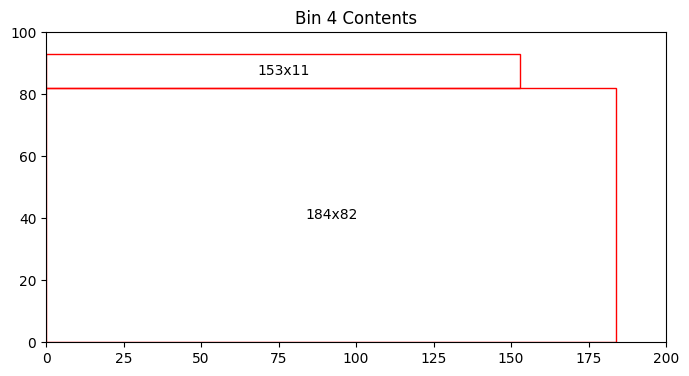

Bin 4 has 3229.00 units of area left


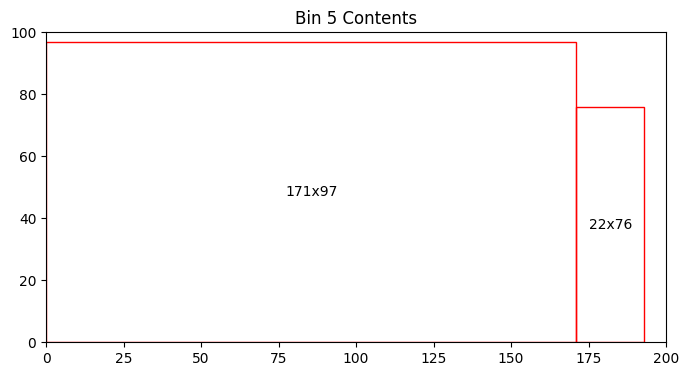

Bin 5 has 1741.00 units of area left


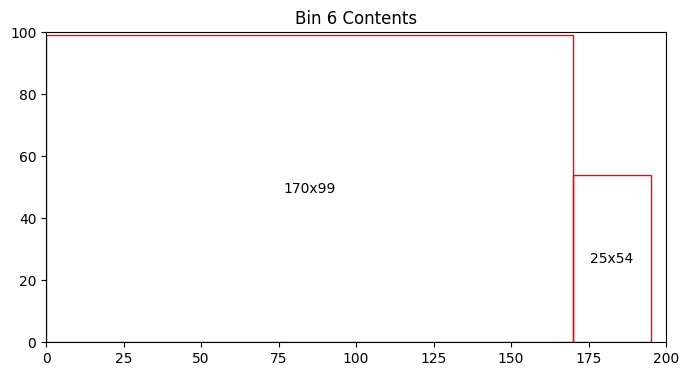

Bin 6 has 1820.00 units of area left


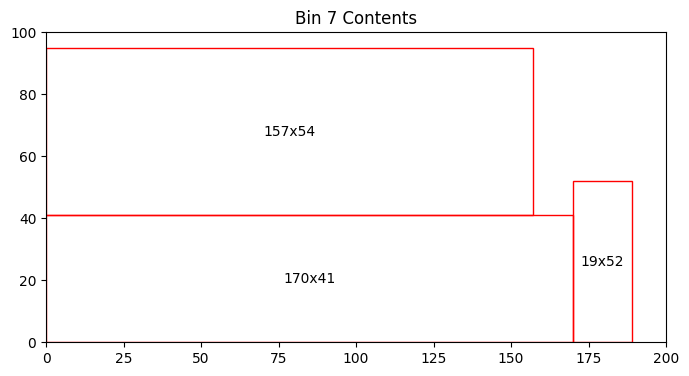

Bin 7 has 3564.00 units of area left


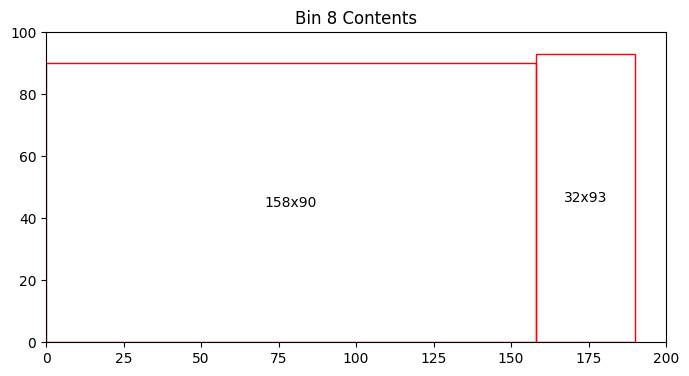

Bin 8 has 2804.00 units of area left


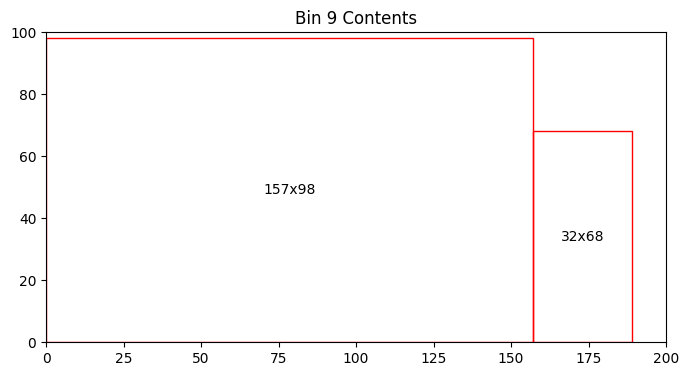

Bin 9 has 2438.00 units of area left


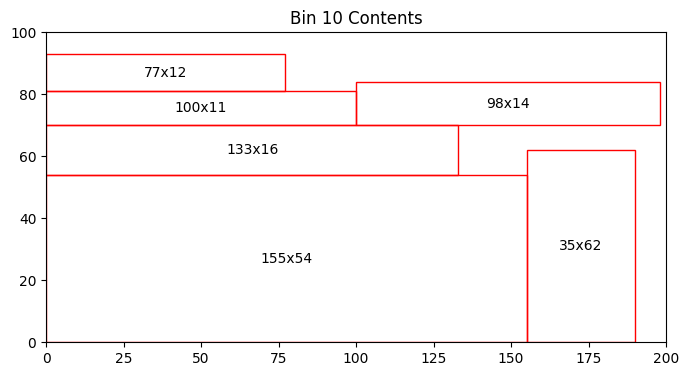

Bin 10 has 3936.00 units of area left


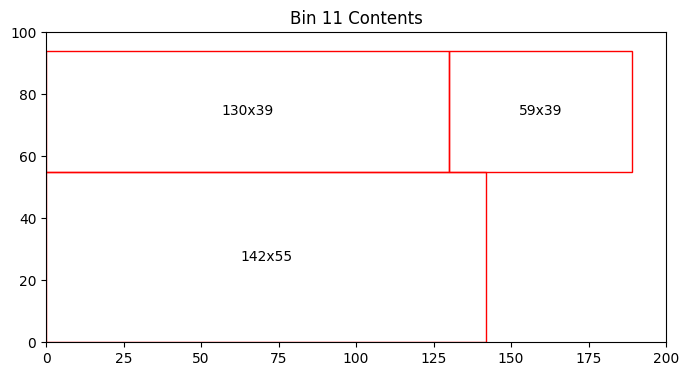

Bin 11 has 4819.00 units of area left


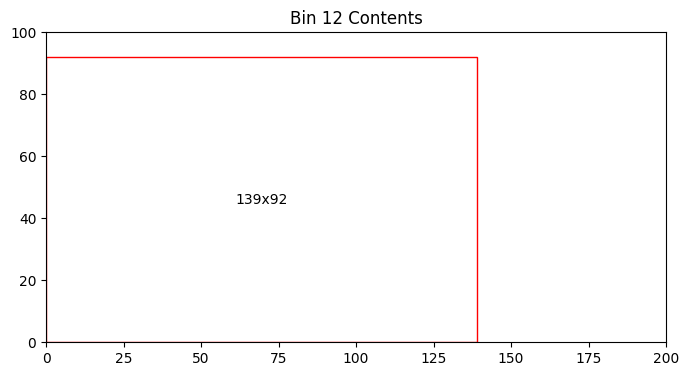

Bin 12 has 7212.00 units of area left


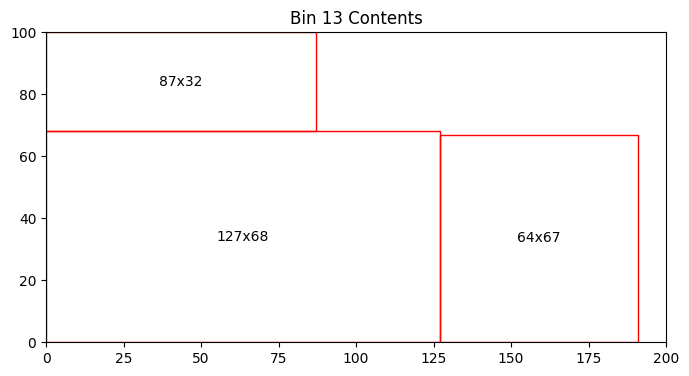

Bin 13 has 4292.00 units of area left


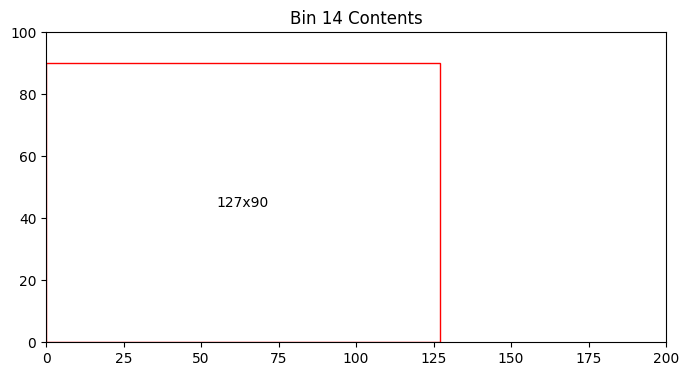

Bin 14 has 8570.00 units of area left


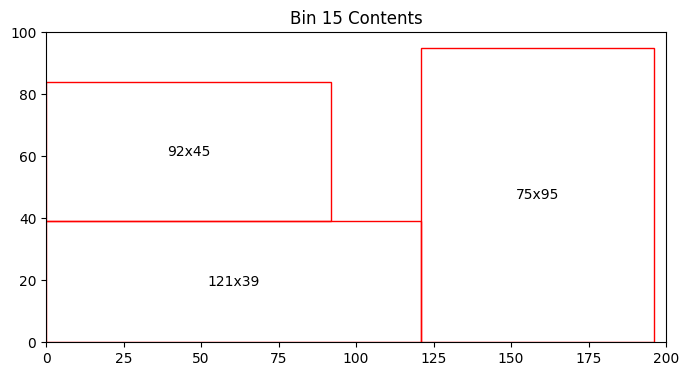

Bin 15 has 4016.00 units of area left


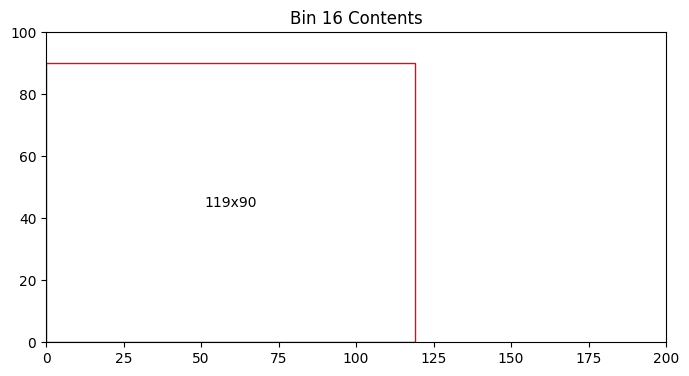

Bin 16 has 9290.00 units of area left


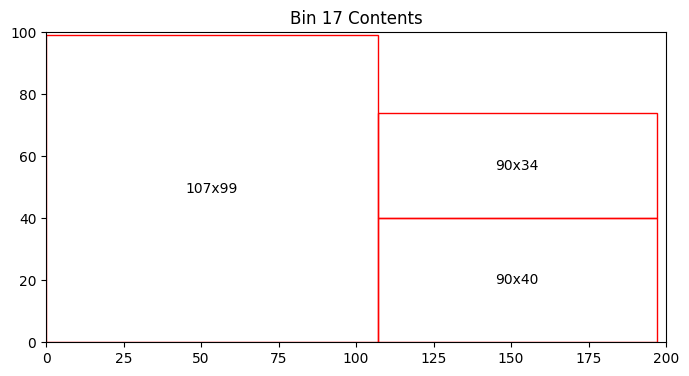

Bin 17 has 2747.00 units of area left


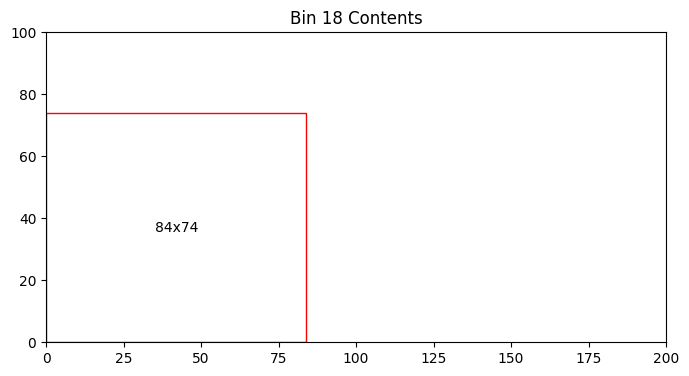

Bin 18 has 13784.00 units of area left
Total number of bins = 18
Total area left in bins = 79129.00
[[133  56]
 [125  64]
 [ 12  31]
 [ 91  79]
 [ 98  53]
 [ 30  55]
 [ 56  47]
 [152  13]
 [ 70  63]
 [165  90]
 [135  67]
 [ 21  23]
 [ 83  86]
 [139  43]
 [194  18]
 [ 90  27]
 [200  30]
 [125  13]
 [173  27]
 [136   8]
 [ 57  43]
 [166  86]
 [117  54]
 [137   7]
 [150 100]
 [104  80]
 [106  23]
 [ 16  43]
 [ 42  48]
 [167  41]
 [140  83]
 [ 75  93]
 [118  82]
 [170  17]
 [120  91]
 [ 82  41]
 [158   5]
 [101  14]
 [150  60]
 [187   1]
 [  3  37]
 [146  80]
 [ 32  95]
 [100  84]
 [ 58  72]
 [ 85  49]
 [179  59]
 [ 56  54]
 [ 76  83]
 [137  69]]


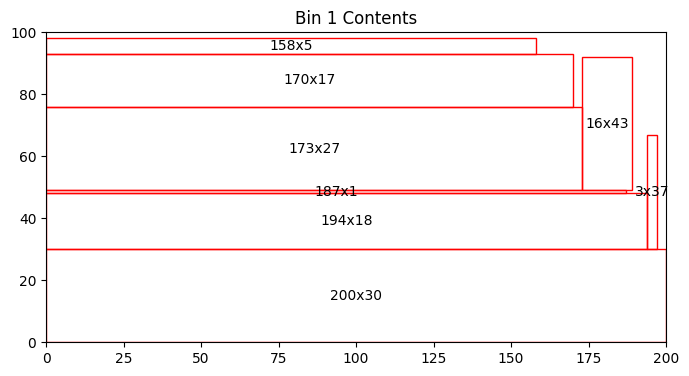

Bin 1 has 1171.00 units of area left


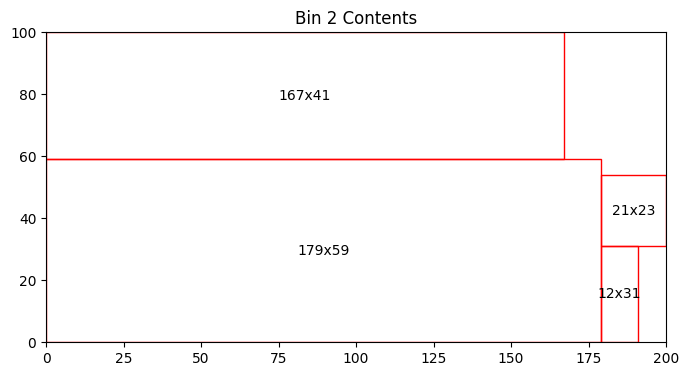

Bin 2 has 1737.00 units of area left


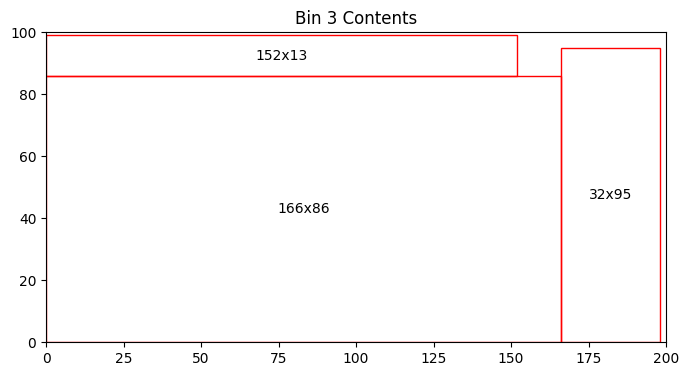

Bin 3 has 708.00 units of area left


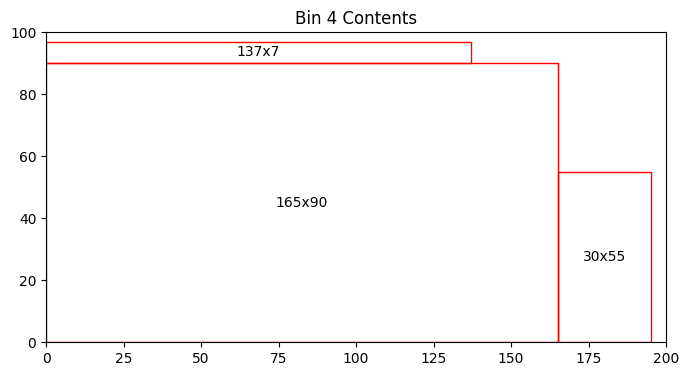

Bin 4 has 2541.00 units of area left


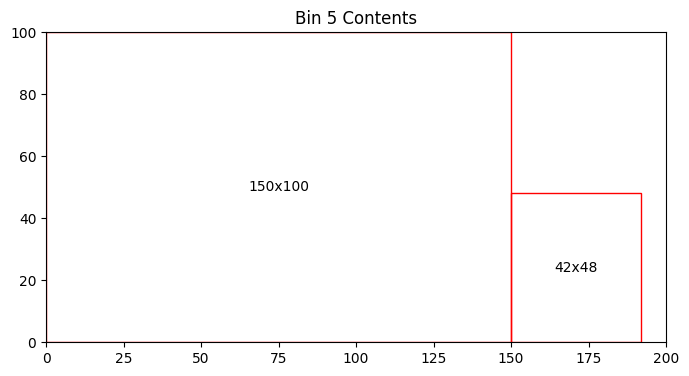

Bin 5 has 2984.00 units of area left


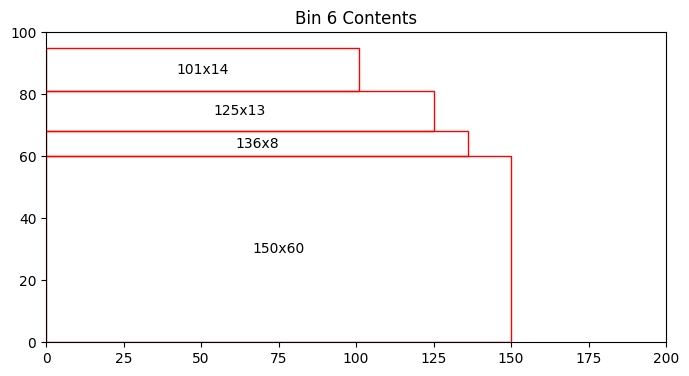

Bin 6 has 6873.00 units of area left


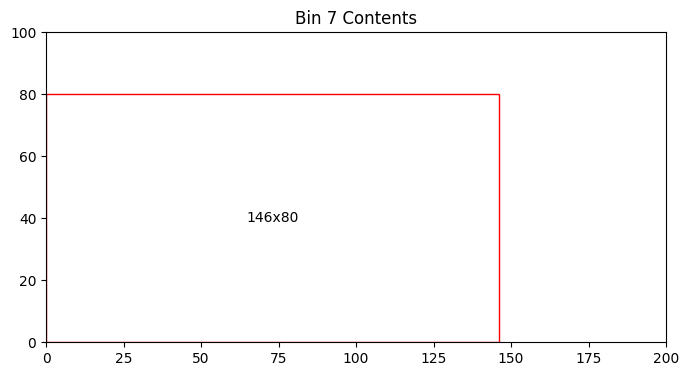

Bin 7 has 8320.00 units of area left


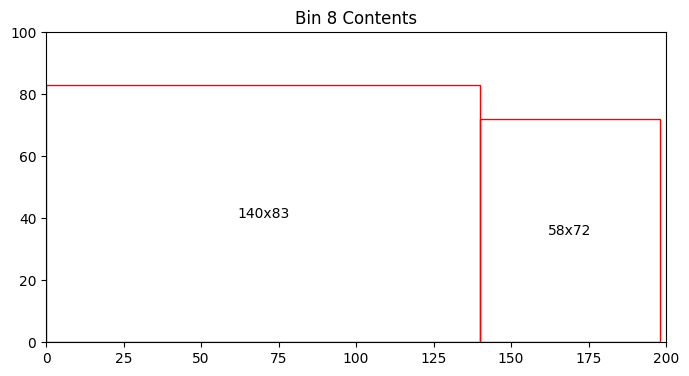

Bin 8 has 4204.00 units of area left


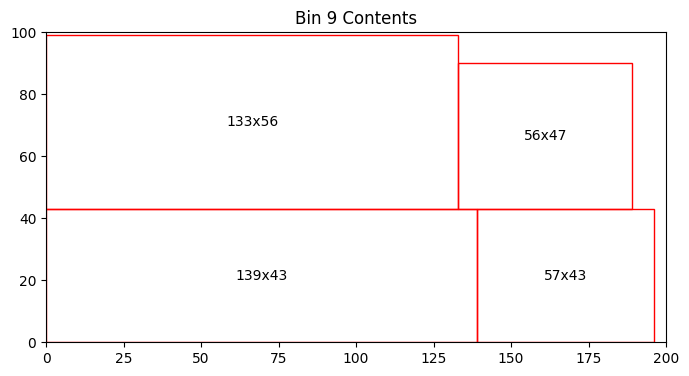

Bin 9 has 1492.00 units of area left


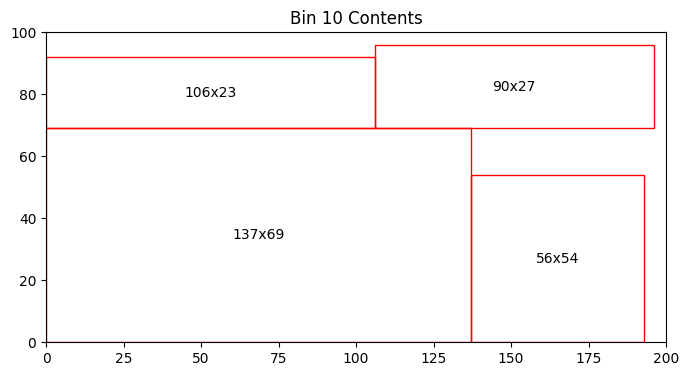

Bin 10 has 2655.00 units of area left


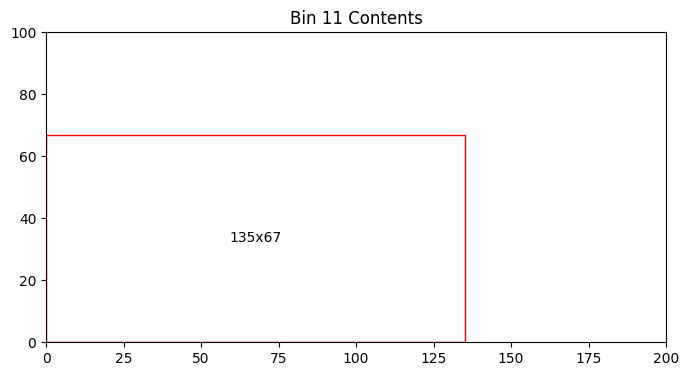

Bin 11 has 10955.00 units of area left


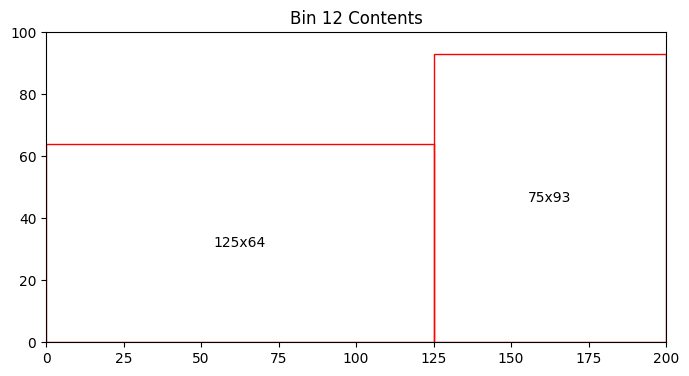

Bin 12 has 5025.00 units of area left


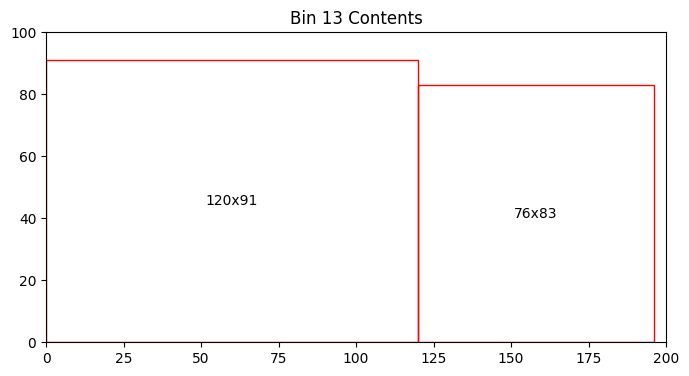

Bin 13 has 2772.00 units of area left


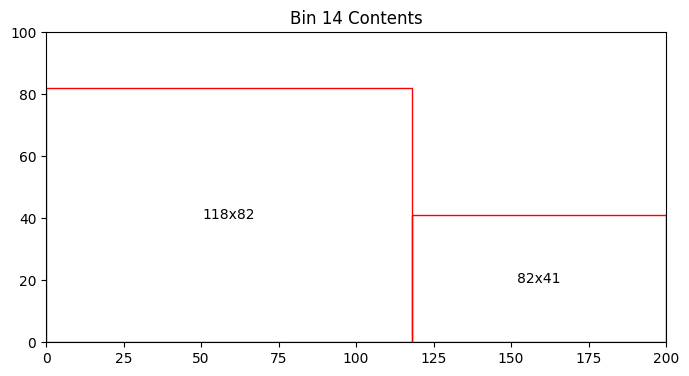

Bin 14 has 6962.00 units of area left


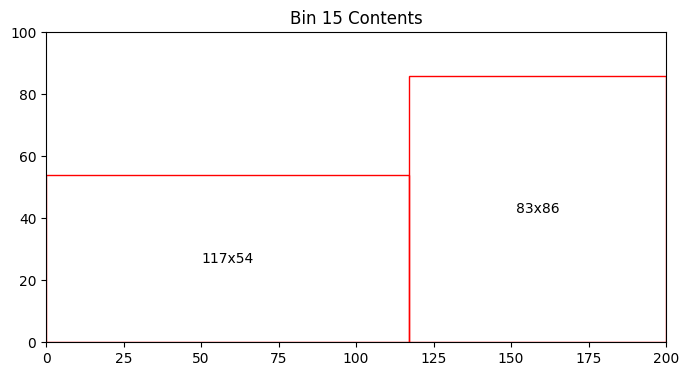

Bin 15 has 6544.00 units of area left


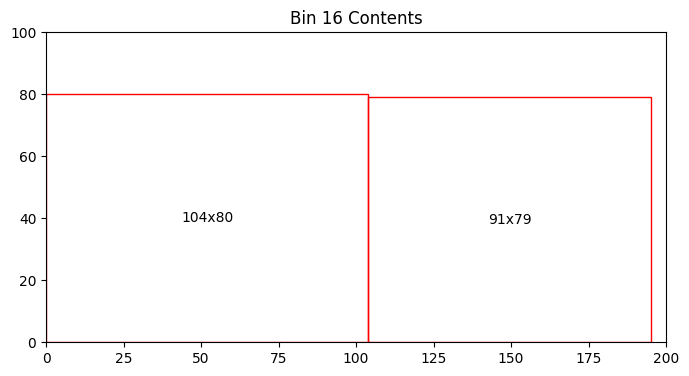

Bin 16 has 4491.00 units of area left


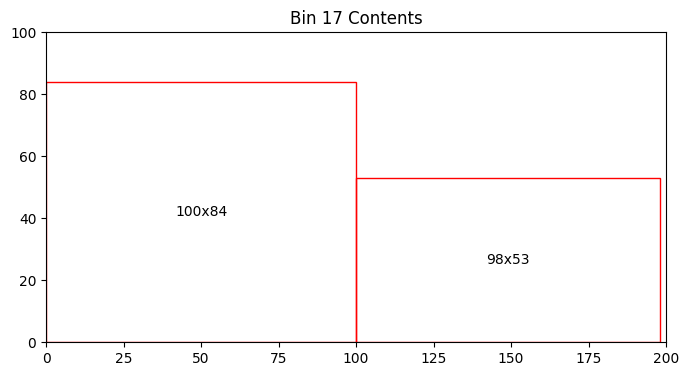

Bin 17 has 6406.00 units of area left


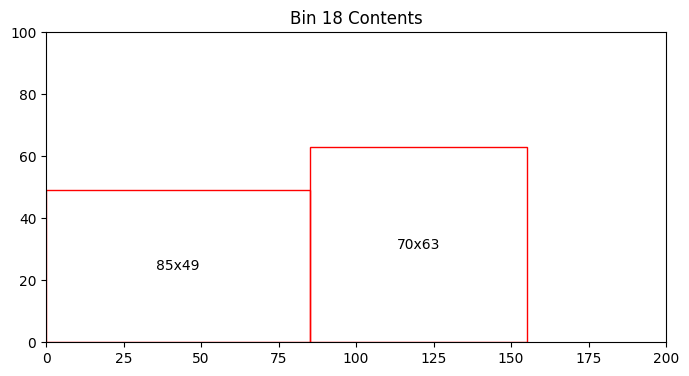

Bin 18 has 11425.00 units of area left
Total number of bins = 18
Total area left in bins = 87265.00
[[171  81]
 [150  64]
 [  2  98]
 [107  23]
 [ 32  60]
 [ 95   4]
 [148  51]
 [ 89  83]
 [174  54]
 [156  74]
 [ 86  84]
 [ 75  61]
 [ 21  66]
 [ 56  53]
 [ 25  26]
 [164  45]
 [ 64  57]
 [ 99  20]
 [ 40  38]
 [ 68  36]
 [150  50]
 [ 27  86]
 [ 53  56]
 [185  27]
 [100  32]
 [ 11  57]
 [191  94]
 [ 44   4]
 [195  29]
 [ 78   2]
 [ 36   5]
 [ 17  81]
 [  2  76]
 [168  18]
 [184  71]
 [200  69]
 [ 72  33]
 [  2  96]
 [136  51]
 [127   8]
 [ 94  64]
 [ 60  43]
 [  9  85]
 [ 66  30]
 [139   1]
 [ 31  11]
 [ 95  50]
 [ 85   2]
 [184 100]
 [200   1]]


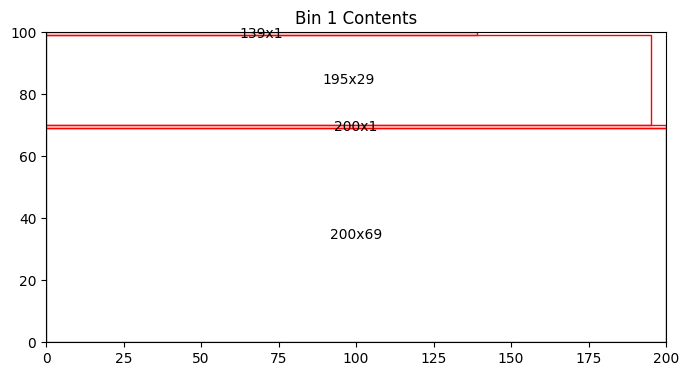

Bin 1 has 206.00 units of area left


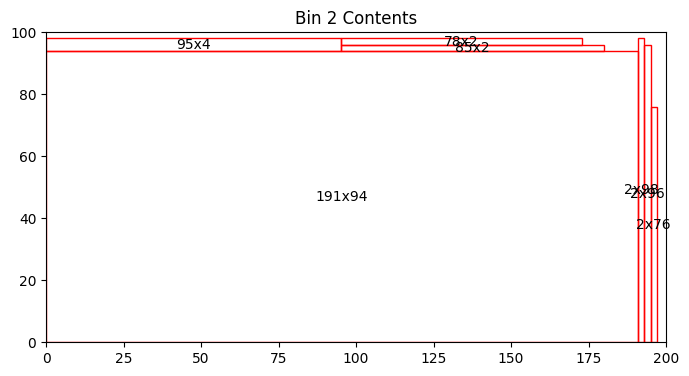

Bin 2 has 800.00 units of area left


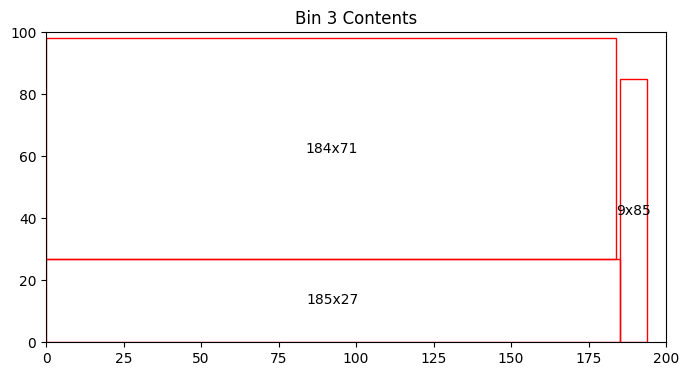

Bin 3 has 1176.00 units of area left


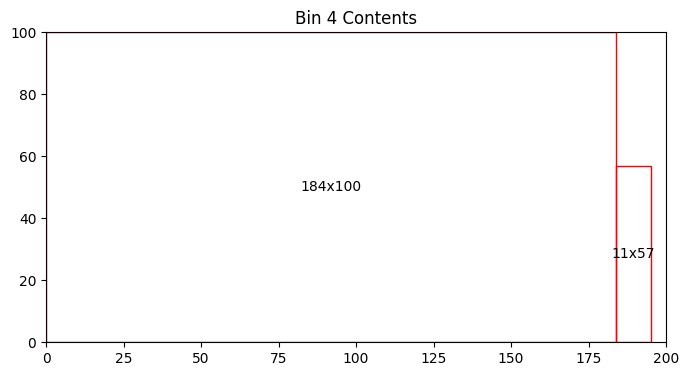

Bin 4 has 973.00 units of area left


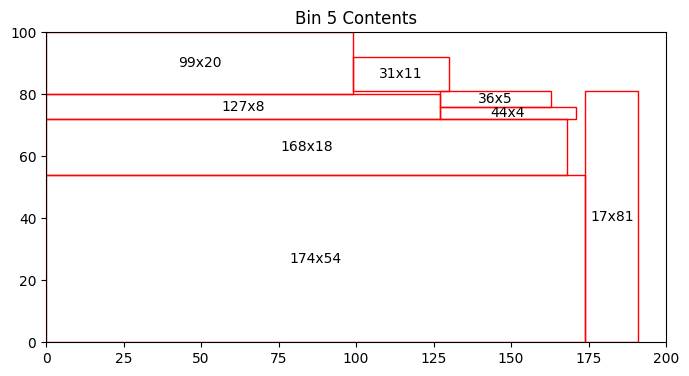

Bin 5 has 2510.00 units of area left


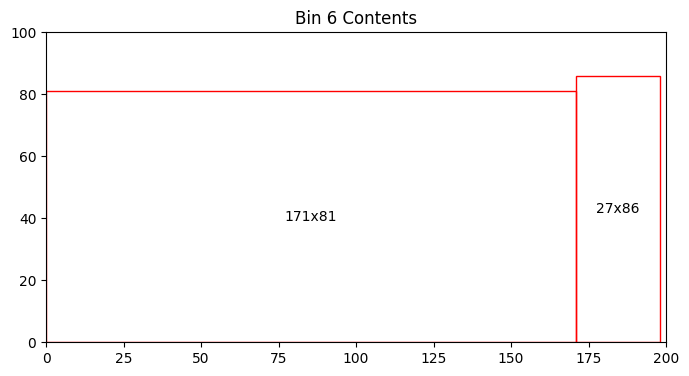

Bin 6 has 3827.00 units of area left


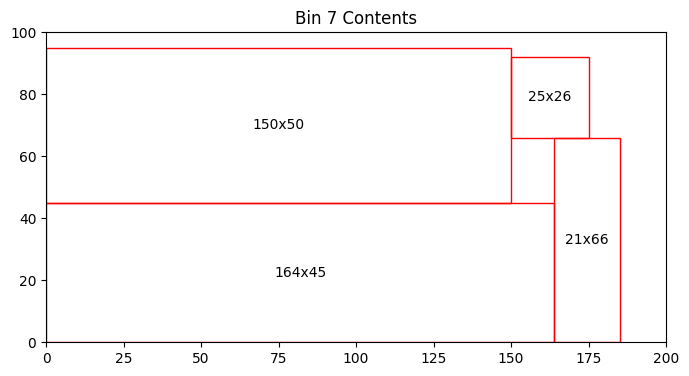

Bin 7 has 3084.00 units of area left


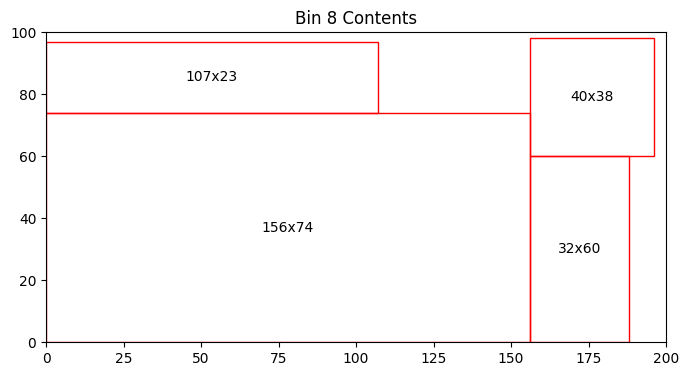

Bin 8 has 2555.00 units of area left


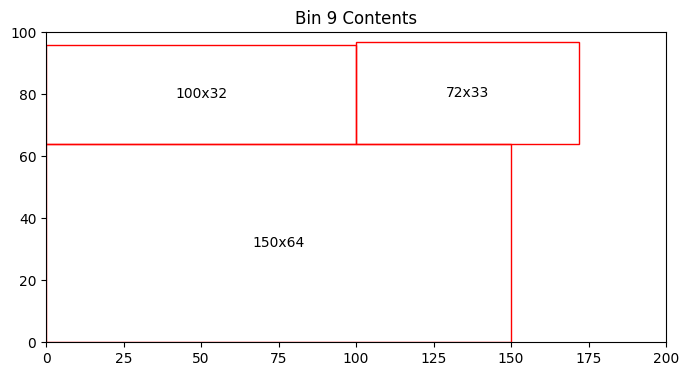

Bin 9 has 4824.00 units of area left


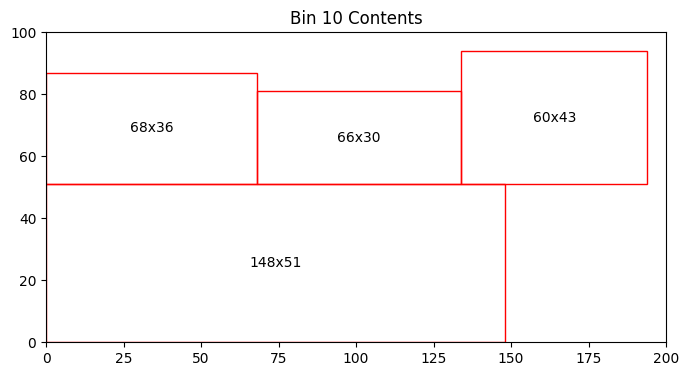

Bin 10 has 5444.00 units of area left


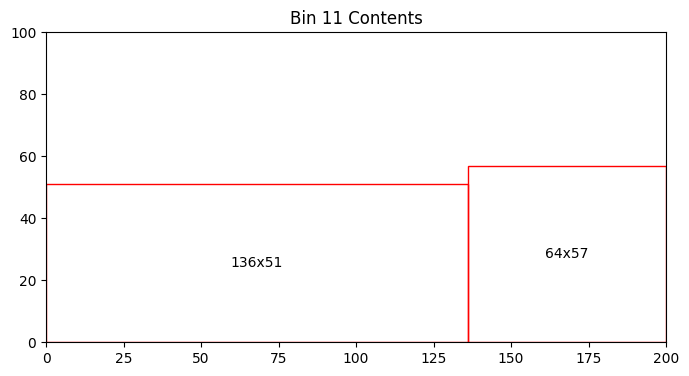

Bin 11 has 9416.00 units of area left


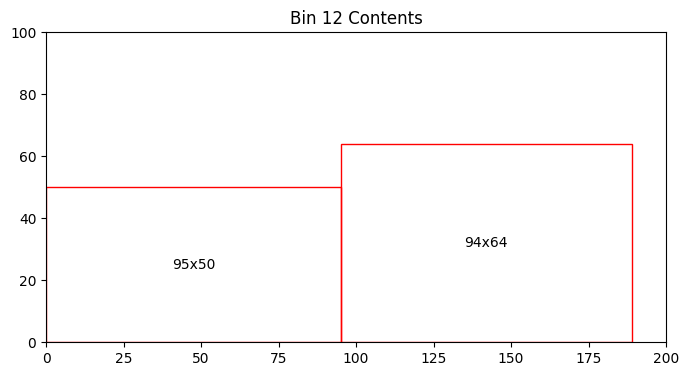

Bin 12 has 9234.00 units of area left


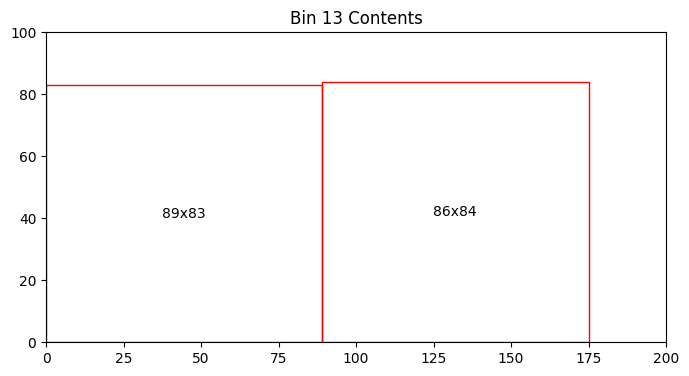

Bin 13 has 5389.00 units of area left


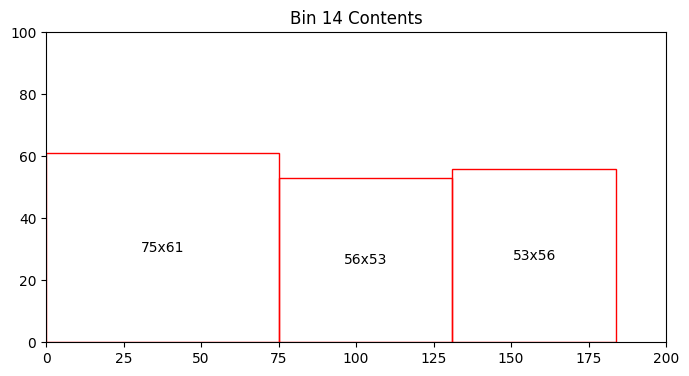

Bin 14 has 9489.00 units of area left
Total number of bins = 14
Total area left in bins = 58927.00
[[169  89]
 [  4  78]
 [116  54]
 [168  70]
 [165  58]
 [103  82]
 [195  56]
 [ 16  67]
 [117  27]
 [ 16  84]
 [ 82  23]
 [163  53]
 [  7  46]
 [ 62  72]
 [115  30]
 [131  18]
 [178  11]
 [ 98  32]
 [176  55]
 [ 21  14]
 [114  52]
 [167  31]
 [116  77]
 [ 39  54]
 [ 52  57]
 [ 36  89]
 [195   3]
 [106  44]
 [ 62  35]
 [ 39  83]
 [ 86  93]
 [131  99]
 [138  17]
 [ 67  36]
 [157  93]
 [ 34  50]
 [101  80]
 [142  75]
 [122  10]
 [ 50  76]
 [ 13  41]
 [133  57]
 [137  38]
 [156  32]
 [176  73]
 [ 53  84]
 [197  54]
 [ 92  50]
 [172  66]
 [ 39  74]]


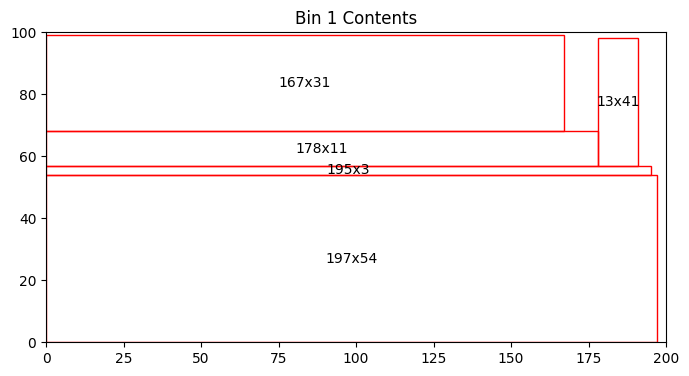

Bin 1 has 1109.00 units of area left


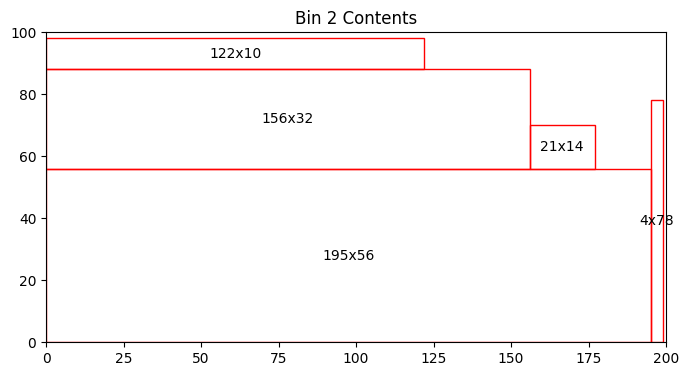

Bin 2 has 2262.00 units of area left


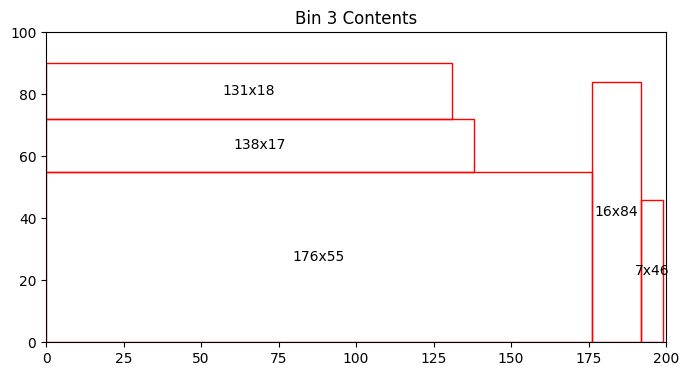

Bin 3 has 3950.00 units of area left


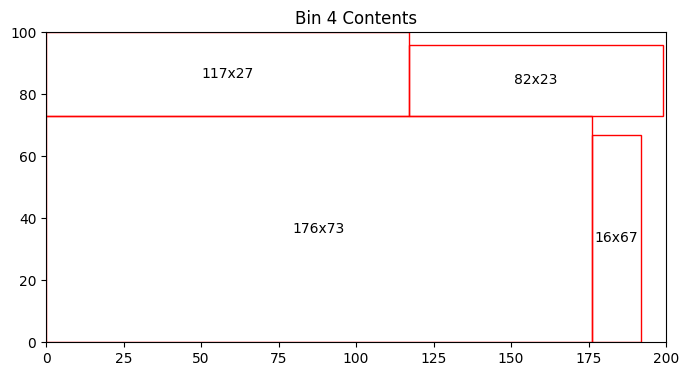

Bin 4 has 1035.00 units of area left


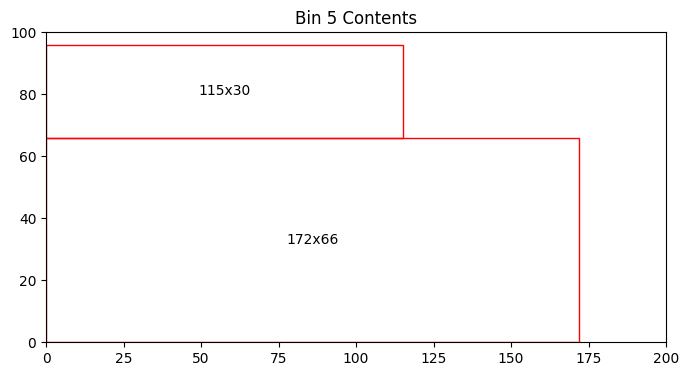

Bin 5 has 5198.00 units of area left


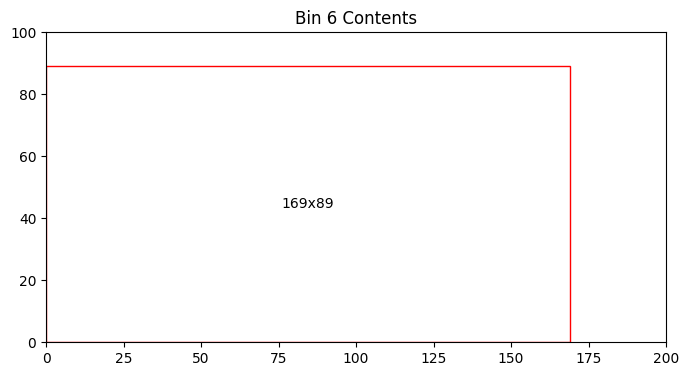

Bin 6 has 4959.00 units of area left


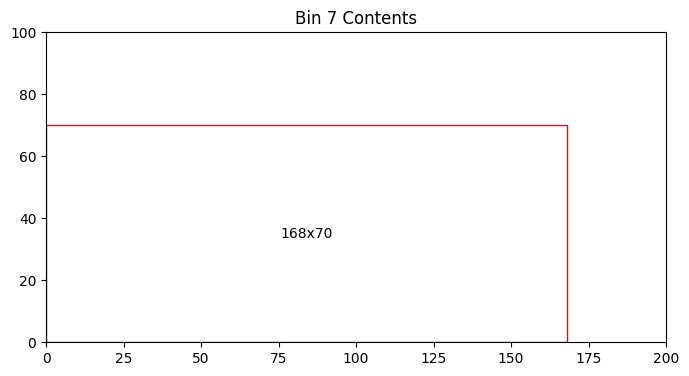

Bin 7 has 8240.00 units of area left


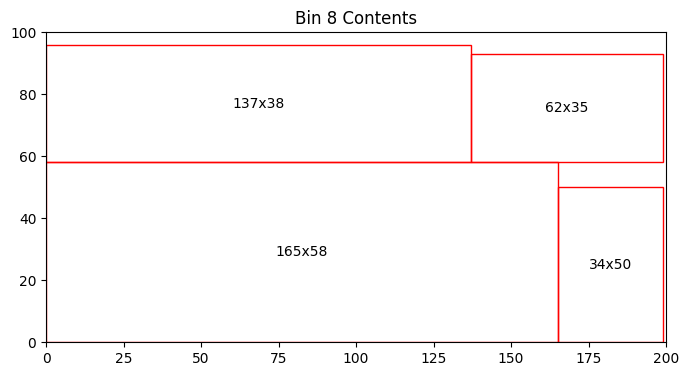

Bin 8 has 1354.00 units of area left


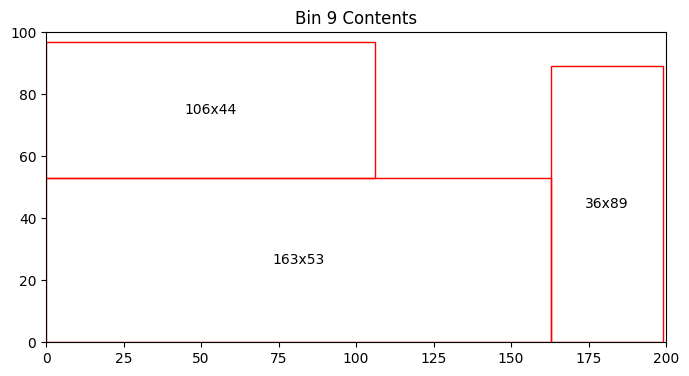

Bin 9 has 3493.00 units of area left


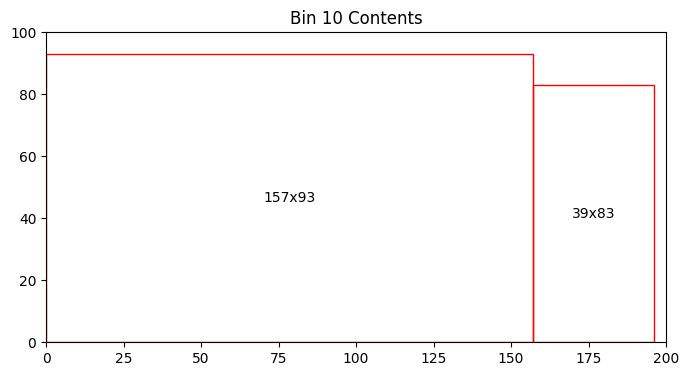

Bin 10 has 2162.00 units of area left


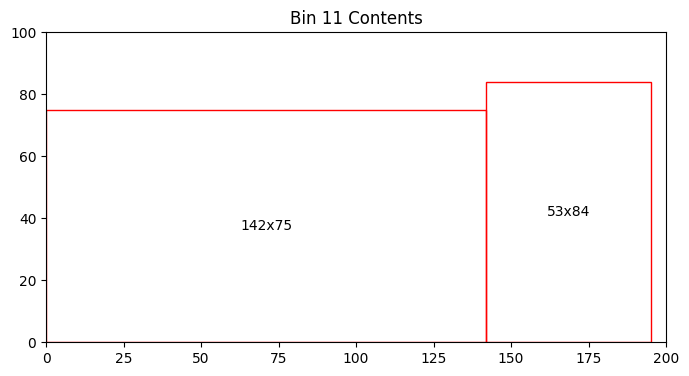

Bin 11 has 4898.00 units of area left


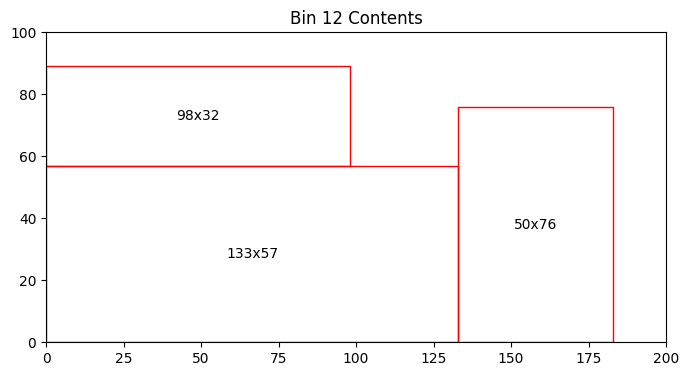

Bin 12 has 5483.00 units of area left


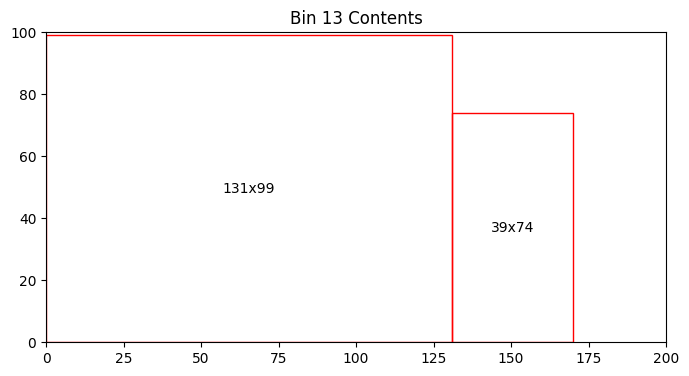

Bin 13 has 4145.00 units of area left


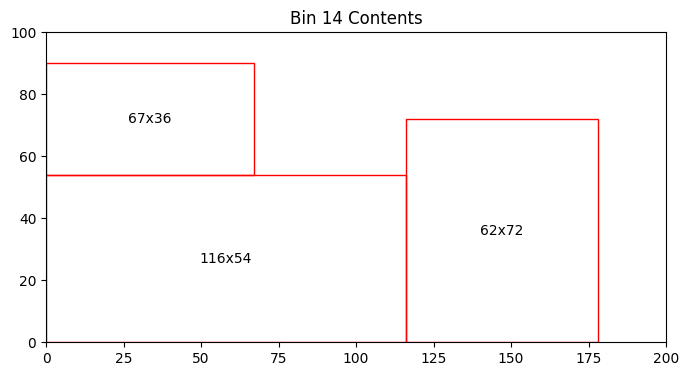

Bin 14 has 6860.00 units of area left


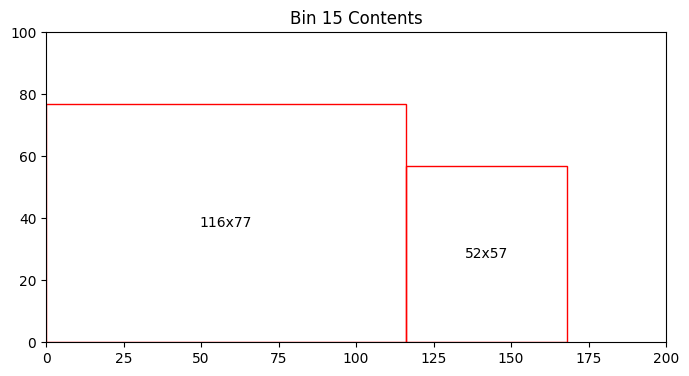

Bin 15 has 8104.00 units of area left


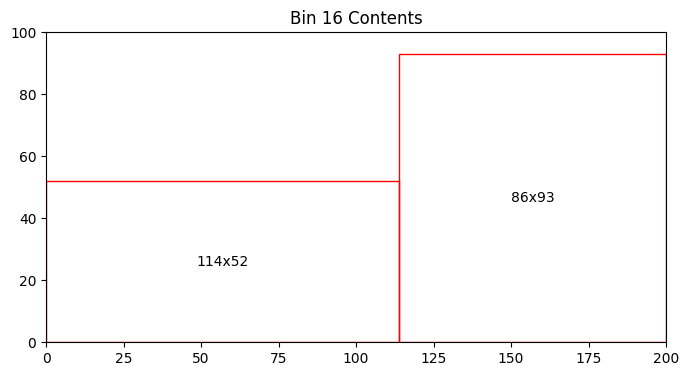

Bin 16 has 6074.00 units of area left


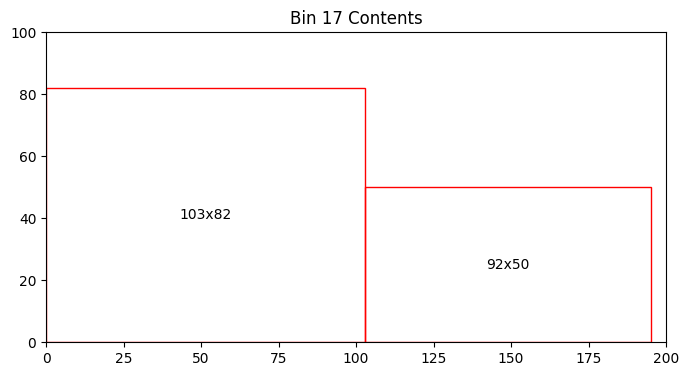

Bin 17 has 6954.00 units of area left


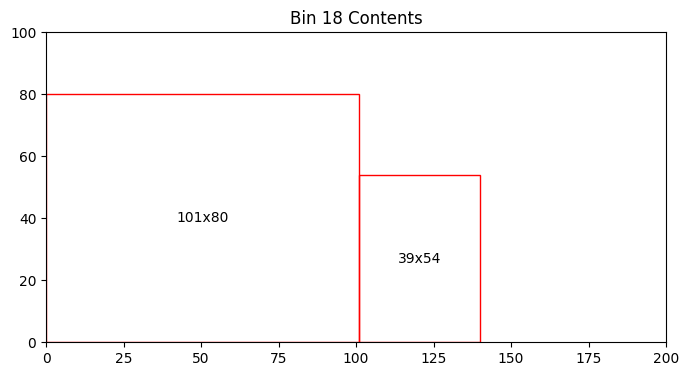

Bin 18 has 9814.00 units of area left
Total number of bins = 18
Total area left in bins = 86094.00
[[ 11  23]
 [138   4]
 [169  72]
 [109  43]
 [ 48  67]
 [101  92]
 [175  21]
 [ 52  41]
 [108  65]
 [143  94]
 [ 76  39]
 [174  30]
 [104   7]
 [ 46  81]
 [ 69  67]
 [ 36  89]
 [129  65]
 [ 44  51]
 [ 35  72]
 [  9  87]
 [124  61]
 [146  65]
 [186  26]
 [ 78  59]
 [ 46  79]
 [ 60  99]
 [ 83  10]
 [135  16]
 [ 28  34]
 [168  47]
 [148  90]
 [115  88]
 [ 63  10]
 [ 83  48]
 [132   9]
 [  5  50]
 [ 48  71]
 [177  45]
 [  3  34]
 [167  86]
 [151  67]
 [200  93]
 [174  19]
 [163  71]
 [185  35]
 [ 75  61]
 [152   3]
 [ 41   3]
 [ 58  28]
 [130  93]]


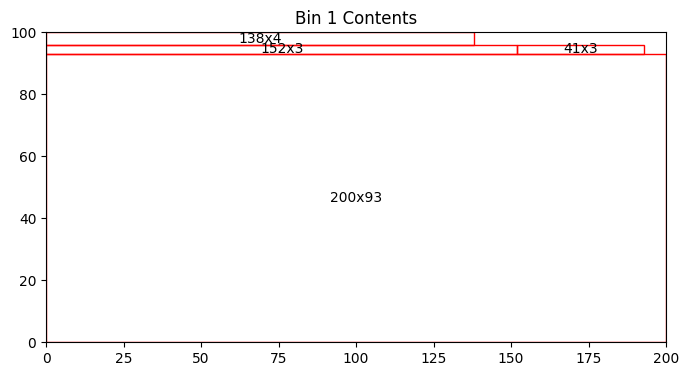

Bin 1 has 269.00 units of area left


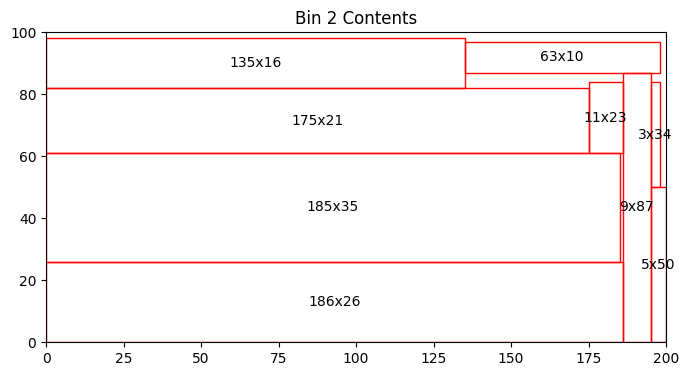

Bin 2 has 836.00 units of area left


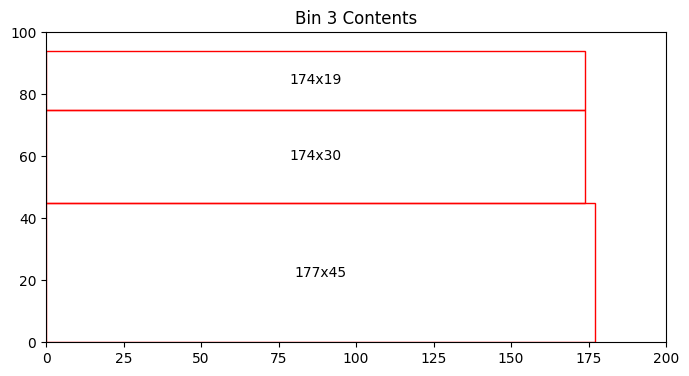

Bin 3 has 3509.00 units of area left


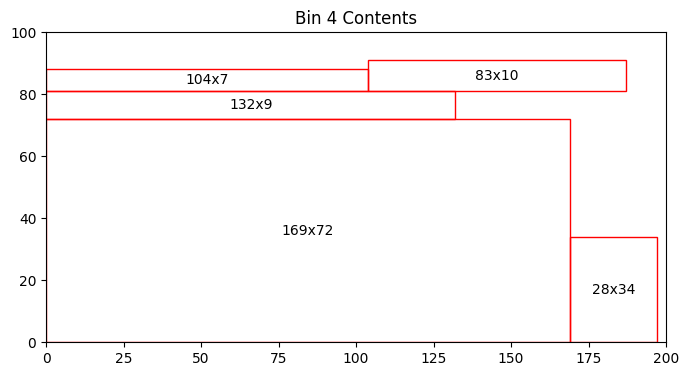

Bin 4 has 4134.00 units of area left


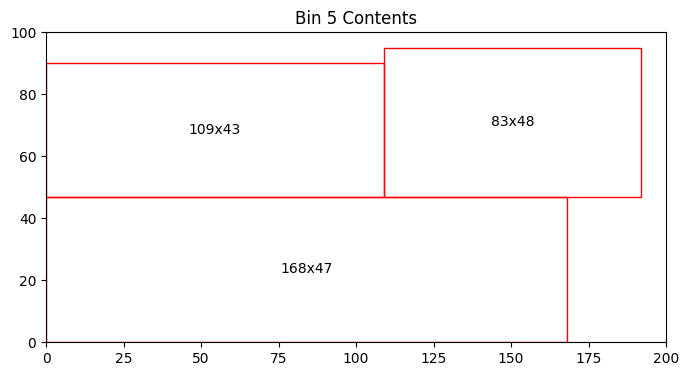

Bin 5 has 3433.00 units of area left


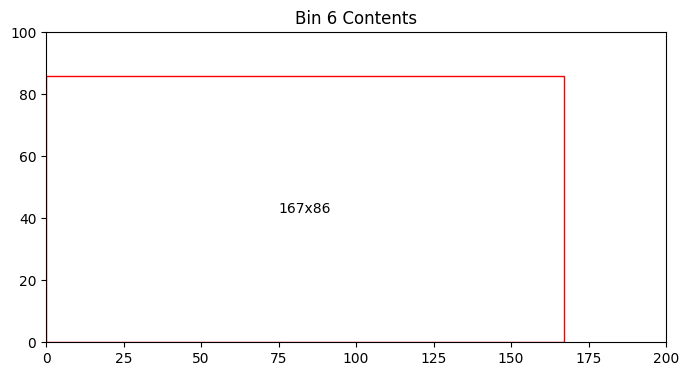

Bin 6 has 5638.00 units of area left


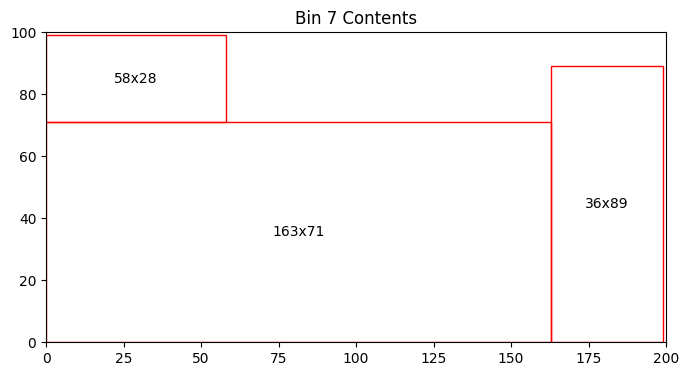

Bin 7 has 3599.00 units of area left


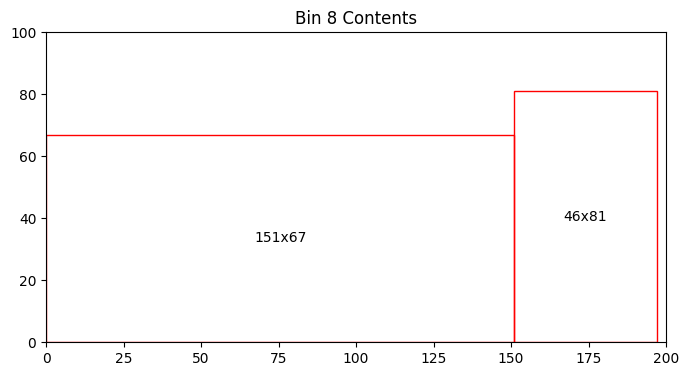

Bin 8 has 6157.00 units of area left


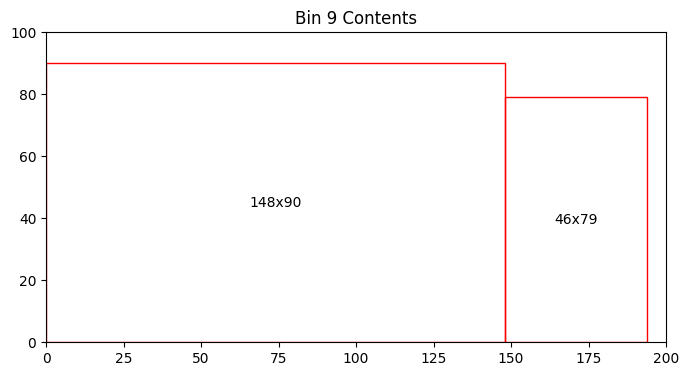

Bin 9 has 3046.00 units of area left


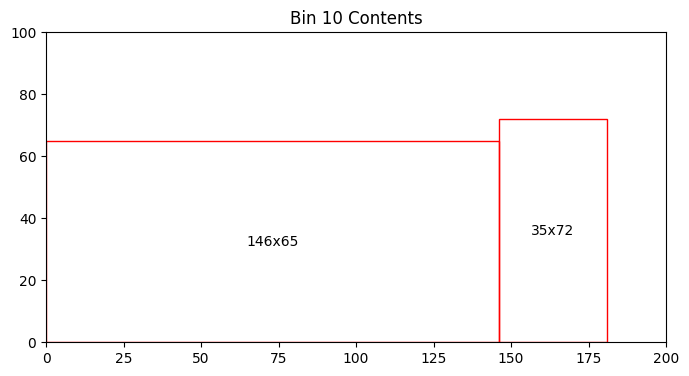

Bin 10 has 7990.00 units of area left


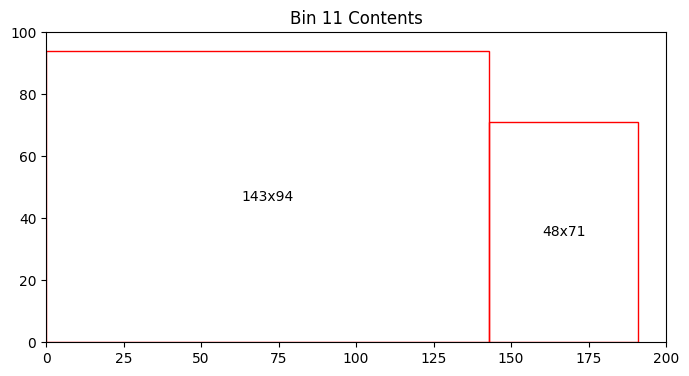

Bin 11 has 3150.00 units of area left


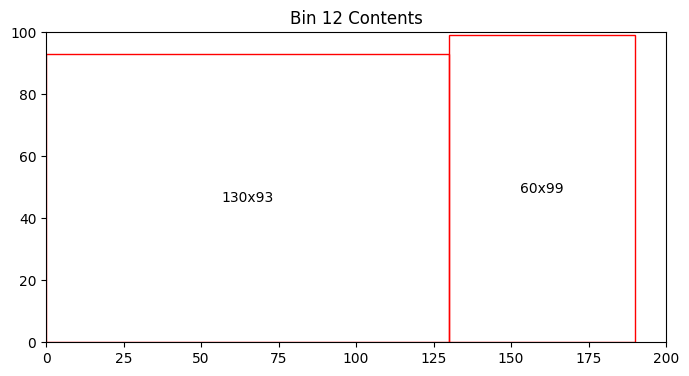

Bin 12 has 1970.00 units of area left


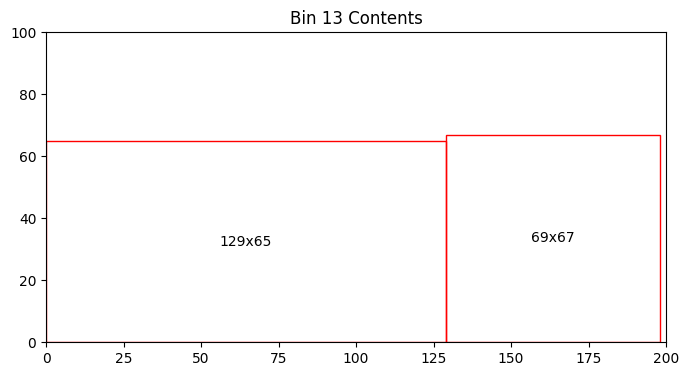

Bin 13 has 6992.00 units of area left


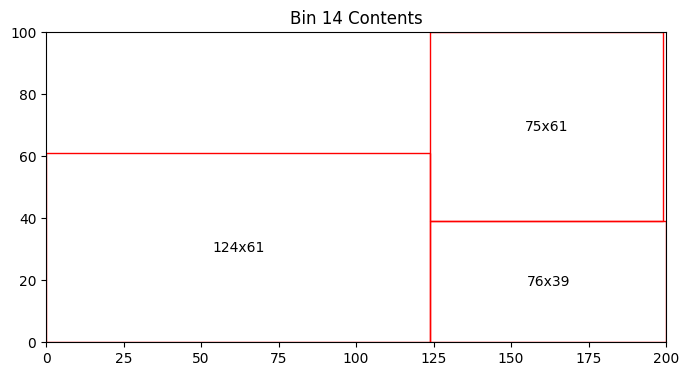

Bin 14 has 4897.00 units of area left


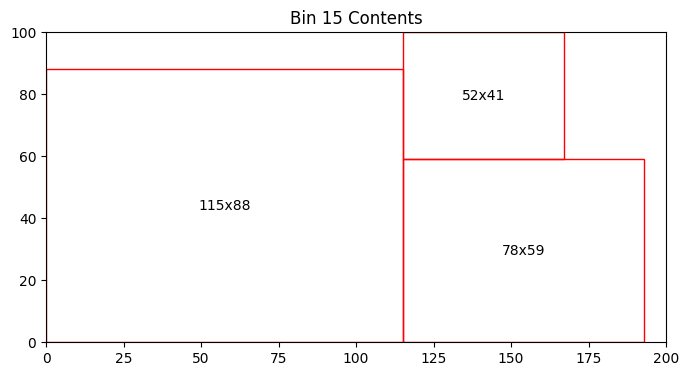

Bin 15 has 3146.00 units of area left


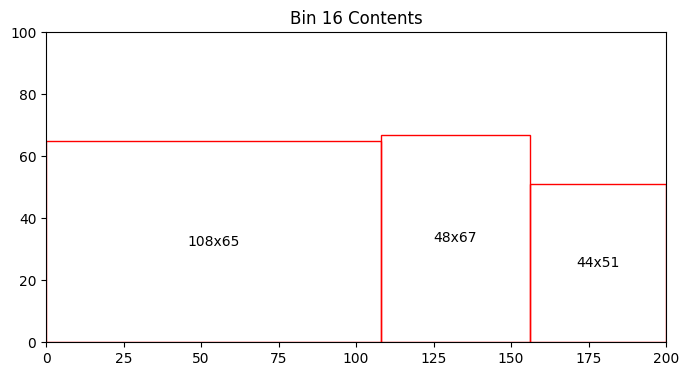

Bin 16 has 7520.00 units of area left


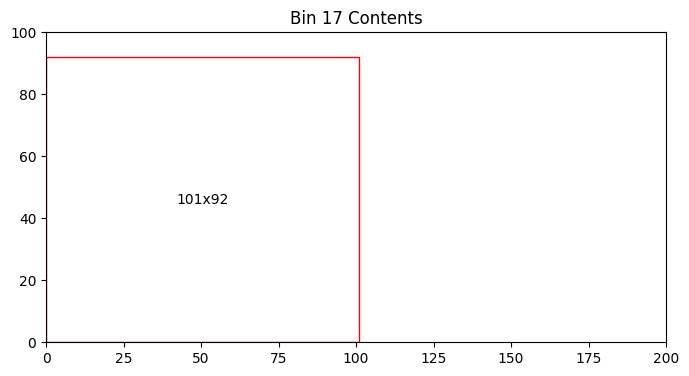

Bin 17 has 10708.00 units of area left
Total number of bins = 17
Total area left in bins = 76994.00
[[115  28]
 [109  25]
 [145   4]
 [107   4]
 [123  87]
 [122  63]
 [122  60]
 [ 71   5]
 [140  87]
 [103  66]
 [ 87  88]
 [ 70  62]
 [ 46  68]
 [ 31  12]
 [100  53]
 [ 28  55]
 [182  11]
 [ 56  23]
 [ 12  40]
 [191  90]
 [145  22]
 [ 22  47]
 [178   6]
 [107  13]
 [125  80]
 [ 11  75]
 [199  45]
 [ 52  78]
 [191  28]
 [ 37  75]
 [  8  52]
 [ 53  41]
 [133  24]
 [158  39]
 [145   3]
 [ 50  88]
 [ 40  43]
 [145  27]
 [ 10  64]
 [159  65]
 [  6  31]
 [156  66]
 [172  75]
 [ 74  26]
 [ 17  70]
 [ 80  99]
 [152  86]
 [ 18  23]
 [ 31  99]
 [ 83  50]]


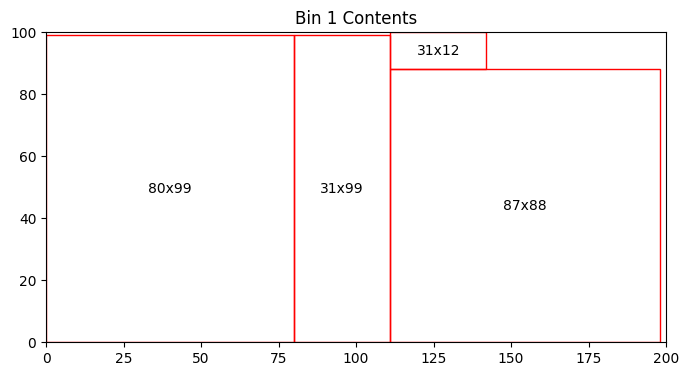

Bin 1 has 983.00 units of area left


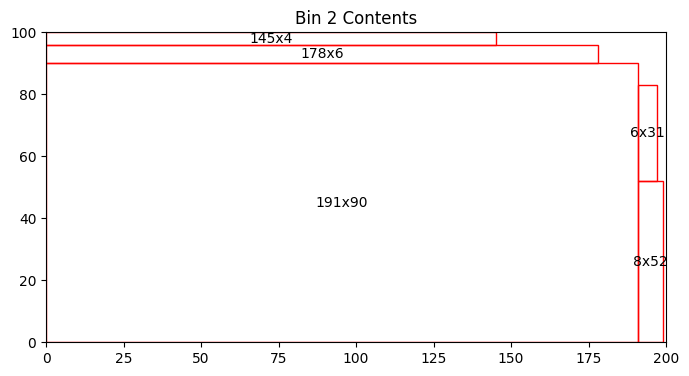

Bin 2 has 560.00 units of area left


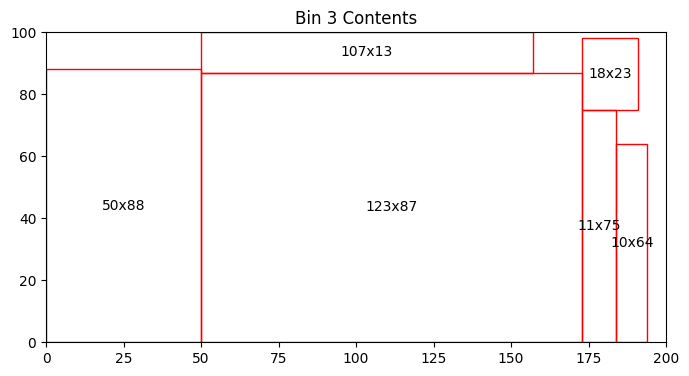

Bin 3 has 1629.00 units of area left


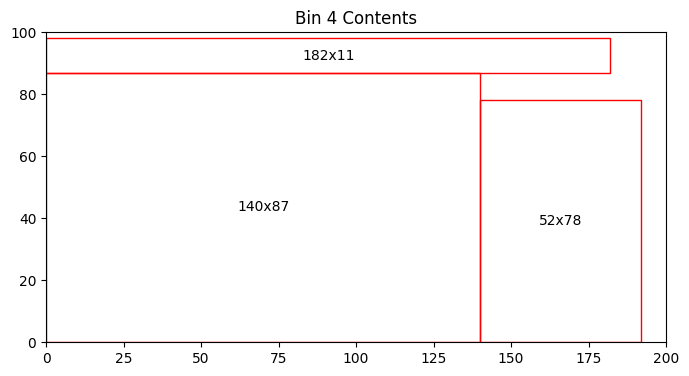

Bin 4 has 1762.00 units of area left


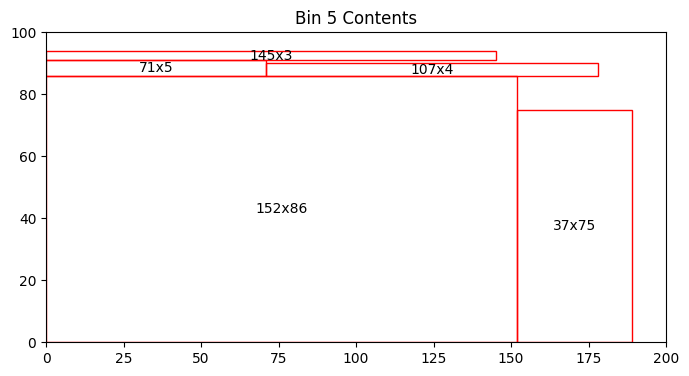

Bin 5 has 2935.00 units of area left


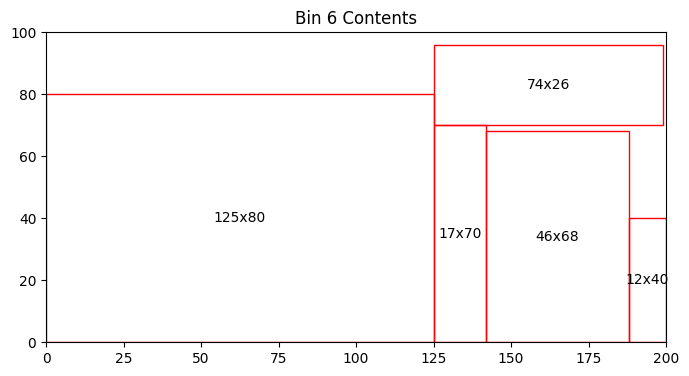

Bin 6 has 3278.00 units of area left


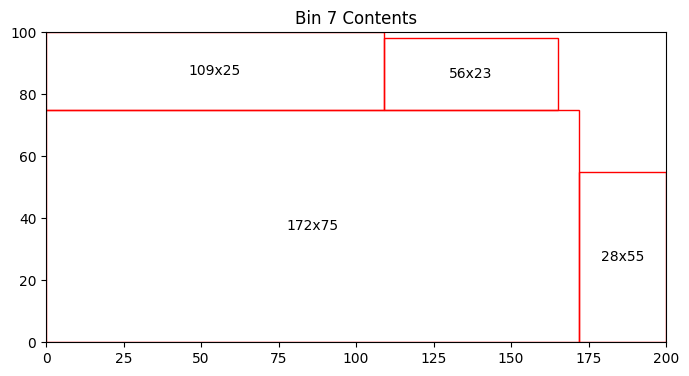

Bin 7 has 1547.00 units of area left


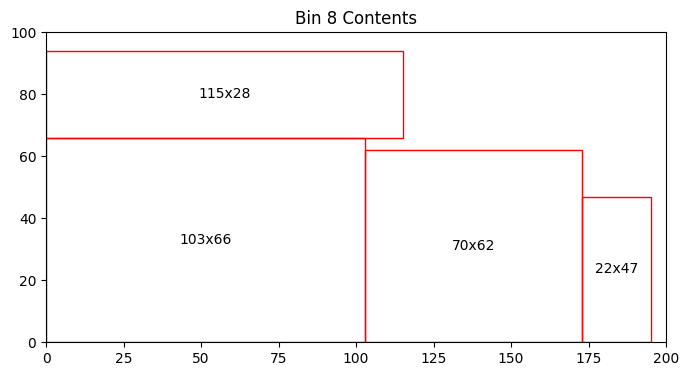

Bin 8 has 4608.00 units of area left


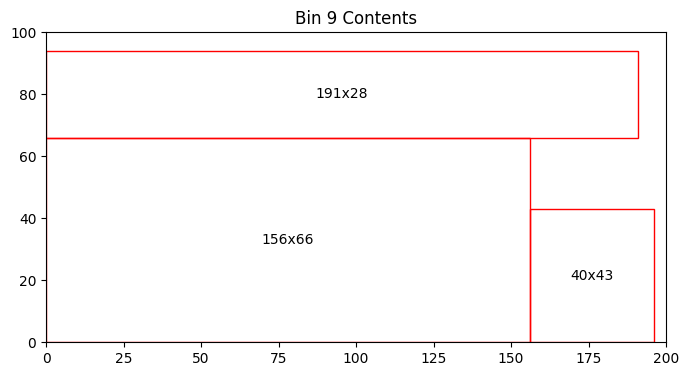

Bin 9 has 2636.00 units of area left


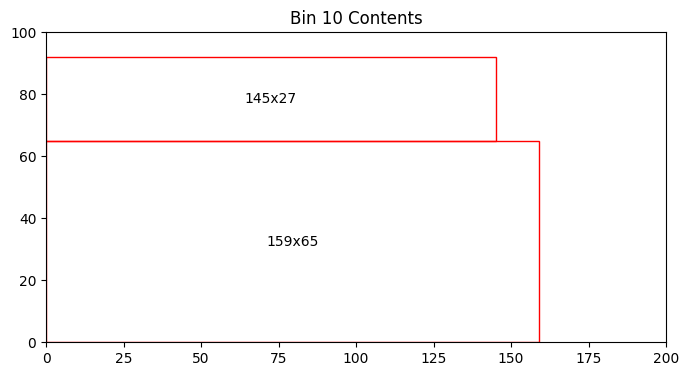

Bin 10 has 5750.00 units of area left


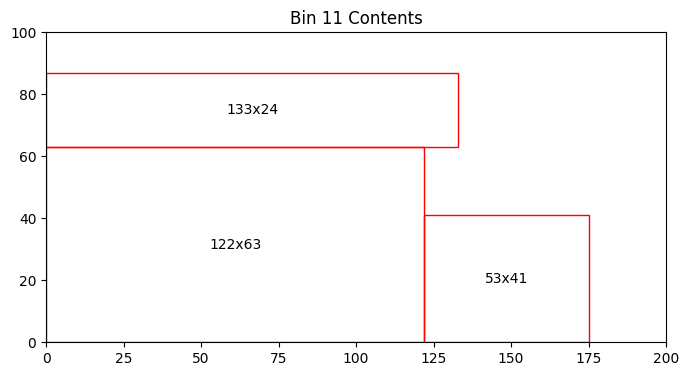

Bin 11 has 6949.00 units of area left


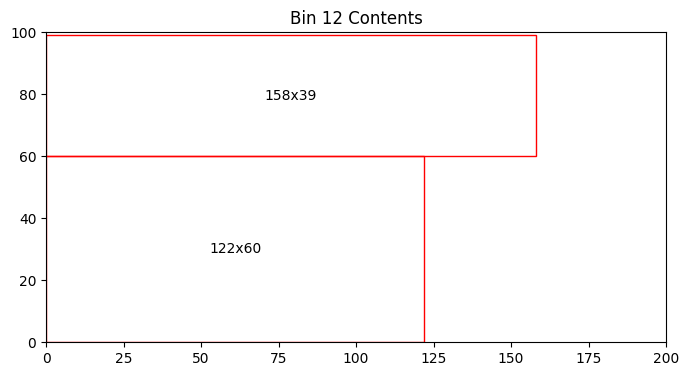

Bin 12 has 6518.00 units of area left


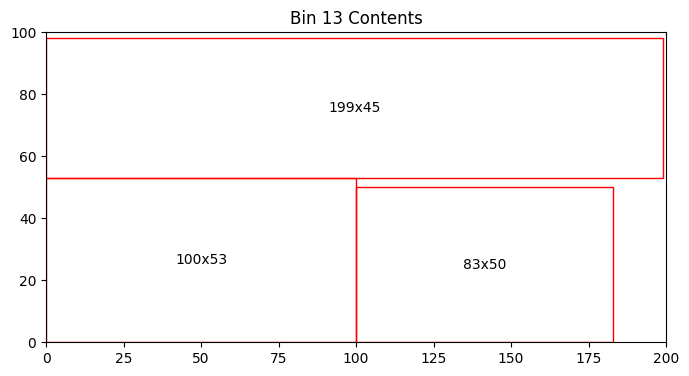

Bin 13 has 1595.00 units of area left


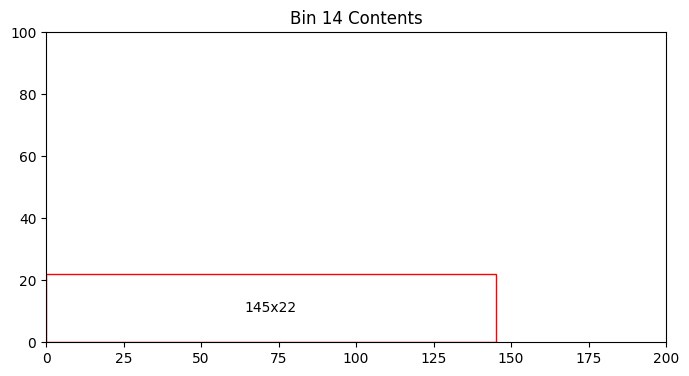

Bin 14 has 16810.00 units of area left
Total number of bins = 14
Total area left in bins = 57560.00
[[118  81]
 [128  87]
 [107  65]
 [127   7]
 [ 98  66]
 [ 44  65]
 [ 36  58]
 [105   6]
 [ 62  57]
 [ 19  75]
 [ 90  24]
 [ 98  37]
 [ 23   3]
 [189  85]
 [ 26  74]
 [183  43]
 [ 78  24]
 [179  80]
 [103  78]
 [106  86]
 [ 48  32]
 [161  98]
 [ 66  92]
 [ 21  67]
 [ 42  38]
 [134  48]
 [ 31  23]
 [151  81]
 [ 69  36]
 [ 49  42]
 [194  20]
 [117  89]
 [108  83]
 [ 81  88]
 [159  50]
 [  4  52]
 [121  10]
 [ 51  87]
 [ 90   6]
 [114  78]
 [ 69  66]
 [198  29]
 [183  62]
 [112  35]
 [179 100]
 [172  98]
 [122  74]
 [108  53]
 [169  18]
 [ 23  75]]


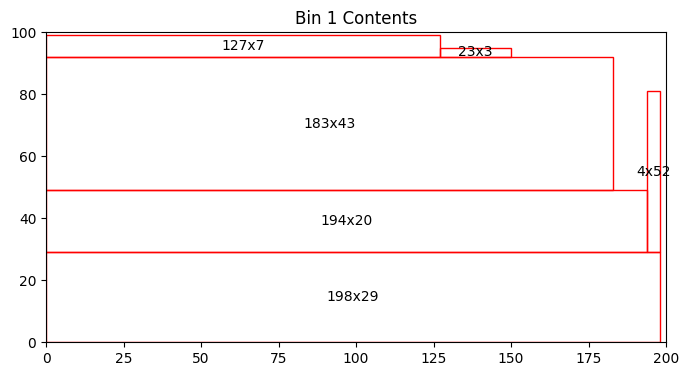

Bin 1 has 1343.00 units of area left


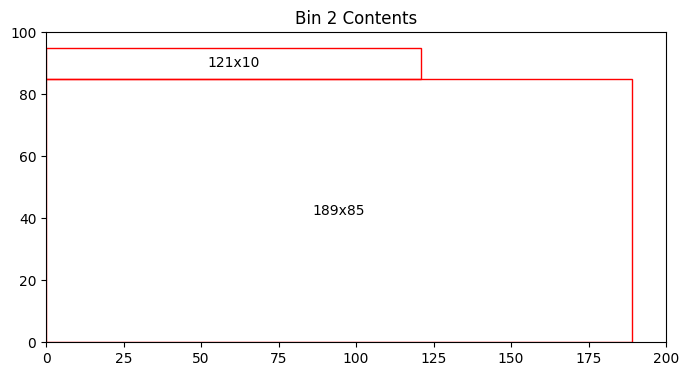

Bin 2 has 2725.00 units of area left


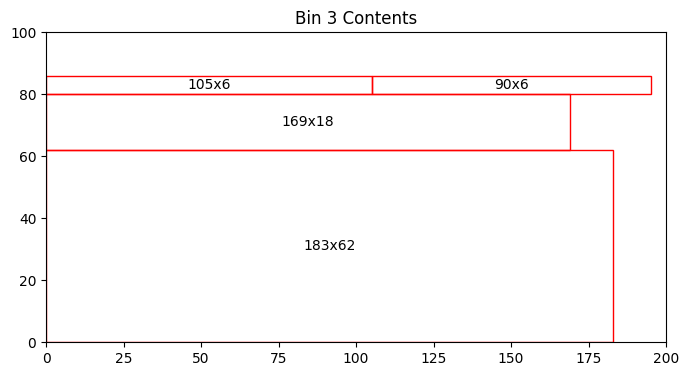

Bin 3 has 4442.00 units of area left


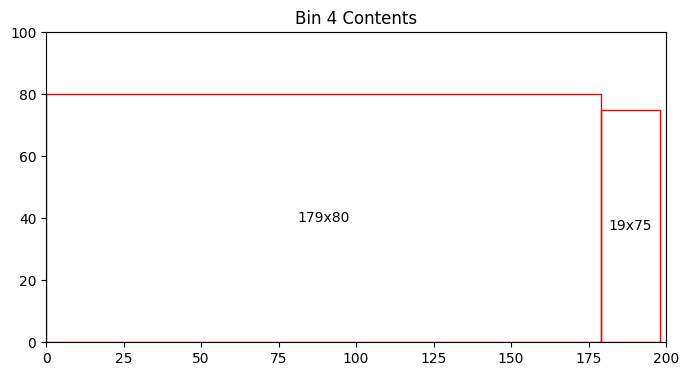

Bin 4 has 4255.00 units of area left


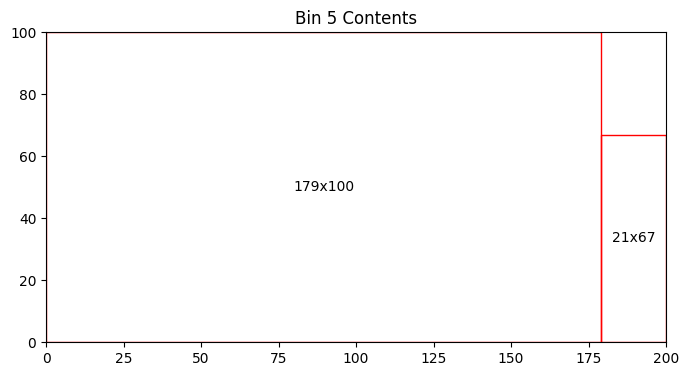

Bin 5 has 693.00 units of area left


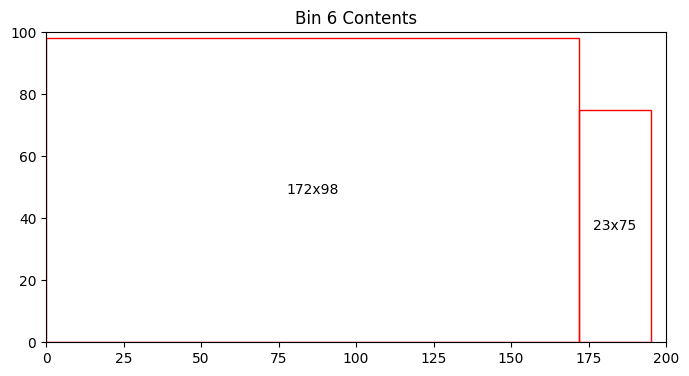

Bin 6 has 1419.00 units of area left


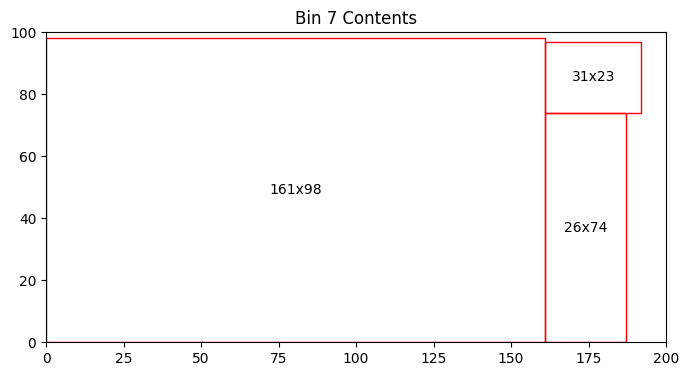

Bin 7 has 1585.00 units of area left


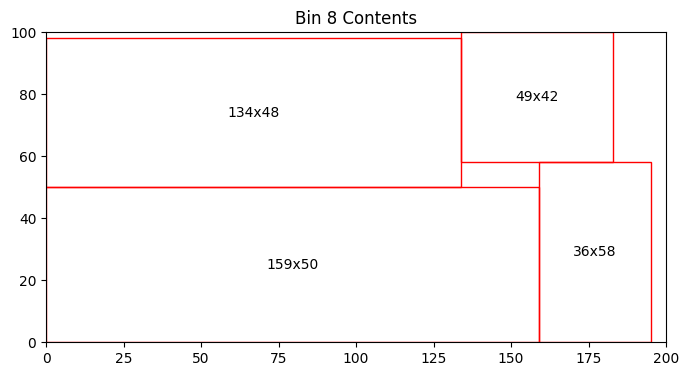

Bin 8 has 1472.00 units of area left


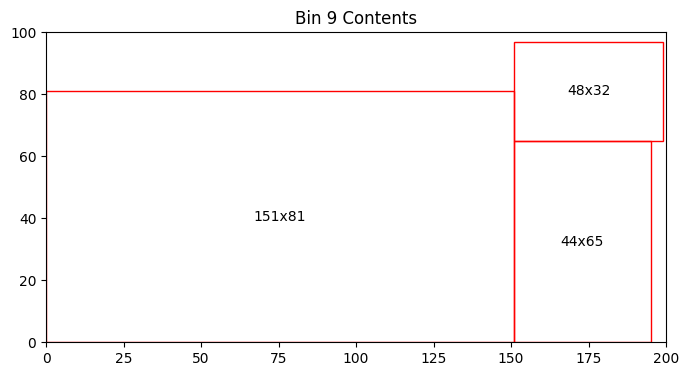

Bin 9 has 3373.00 units of area left


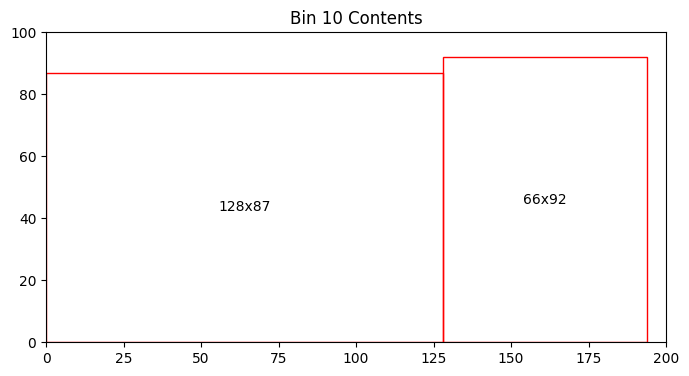

Bin 10 has 2792.00 units of area left


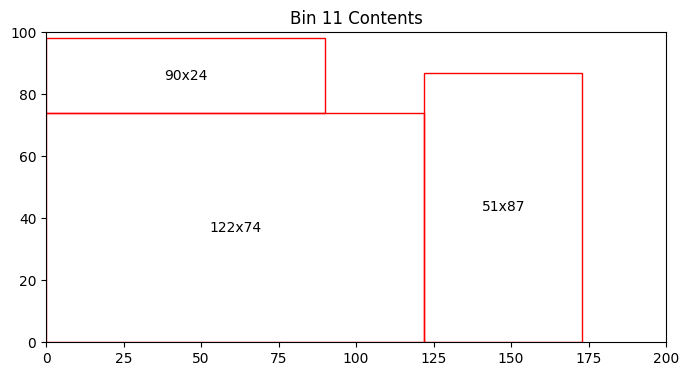

Bin 11 has 4375.00 units of area left


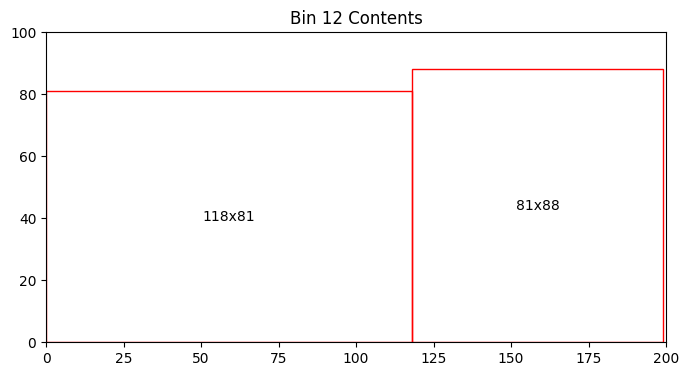

Bin 12 has 3314.00 units of area left


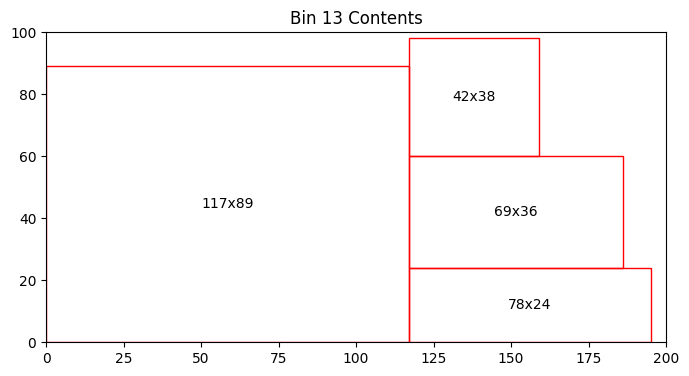

Bin 13 has 3635.00 units of area left


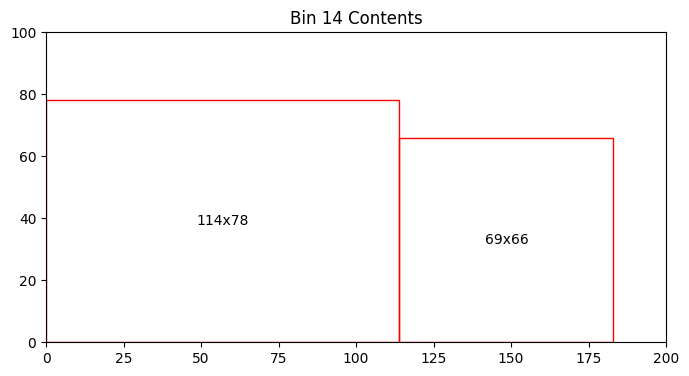

Bin 14 has 6554.00 units of area left


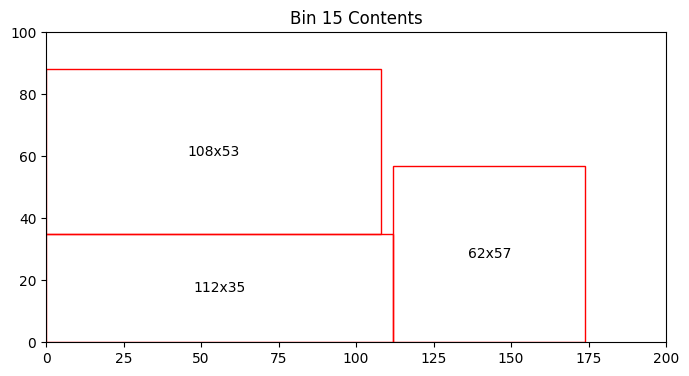

Bin 15 has 6822.00 units of area left


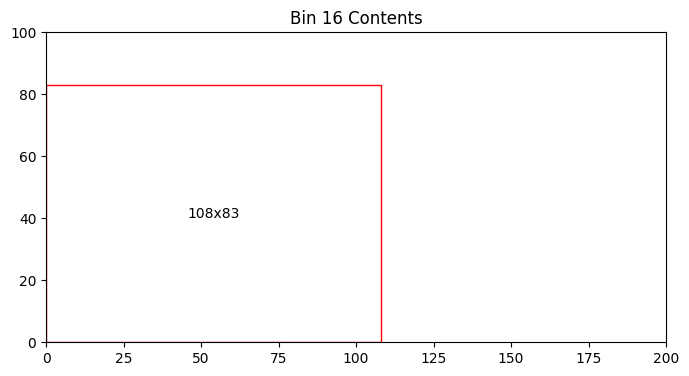

Bin 16 has 11036.00 units of area left


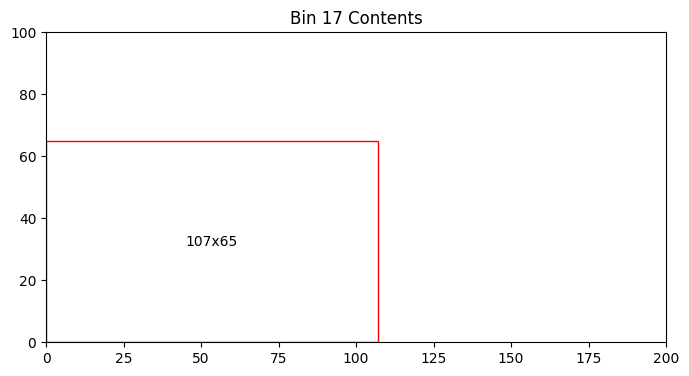

Bin 17 has 13045.00 units of area left


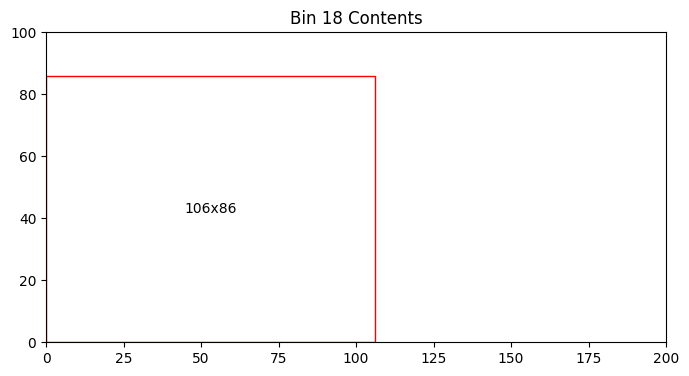

Bin 18 has 10884.00 units of area left


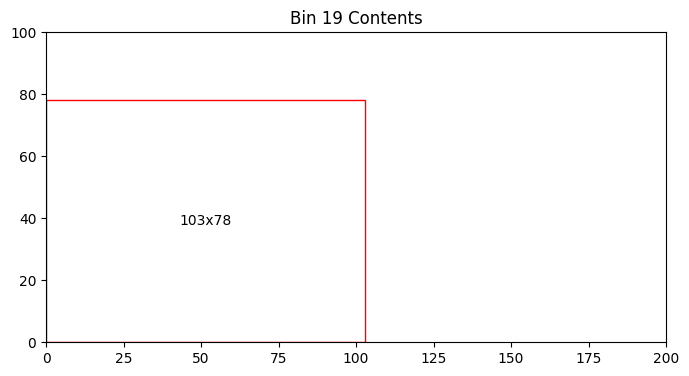

Bin 19 has 11966.00 units of area left


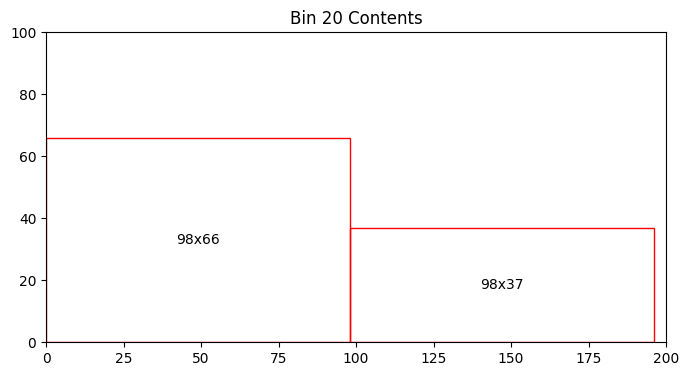

Bin 20 has 9906.00 units of area left
Total number of bins = 20
Total area left in bins = 105636.00
[[ 74   5]
 [110  83]
 [114  83]
 [149  71]
 [161  93]
 [ 38  21]
 [146   2]
 [140  62]
 [ 27 100]
 [149   4]
 [  6   1]
 [157  91]
 [143  43]
 [ 13  22]
 [140 100]
 [ 88  64]
 [179  37]
 [153  91]
 [196   3]
 [131  63]
 [ 56  30]
 [  9  28]
 [ 66  31]
 [ 88  85]
 [ 54  59]
 [ 20  61]
 [107  95]
 [ 75  32]
 [136  99]
 [149  95]
 [116  92]
 [ 26  32]
 [ 60  30]
 [149   2]
 [ 74   3]
 [ 95  50]
 [127   4]
 [ 15  33]
 [123  19]
 [100  55]
 [126  98]
 [179  17]
 [165  54]
 [136  91]
 [154  98]
 [186  17]
 [ 43  75]
 [ 61  50]
 [197   4]
 [ 95  58]]


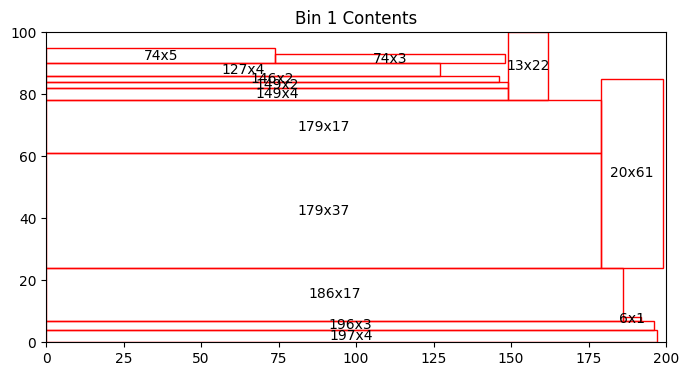

Bin 1 has 1998.00 units of area left


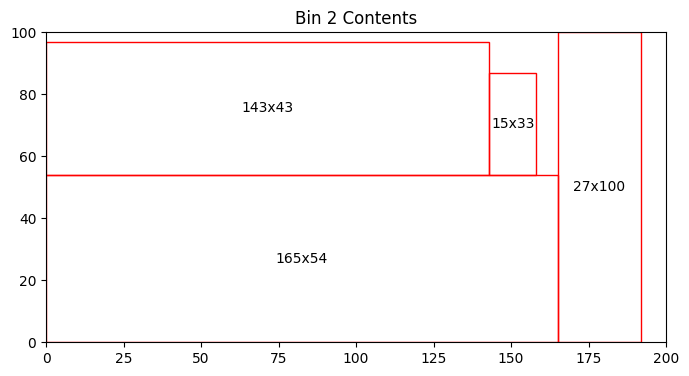

Bin 2 has 1746.00 units of area left


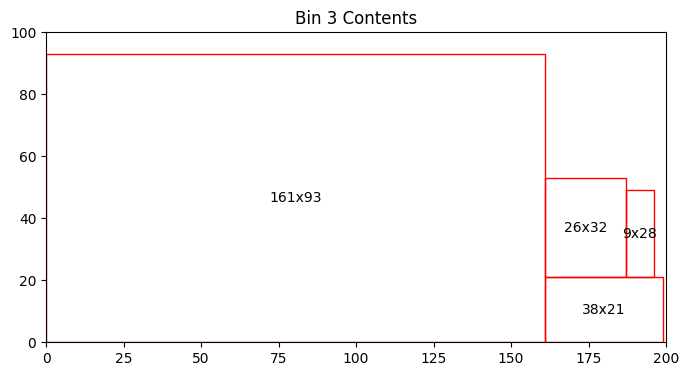

Bin 3 has 3145.00 units of area left


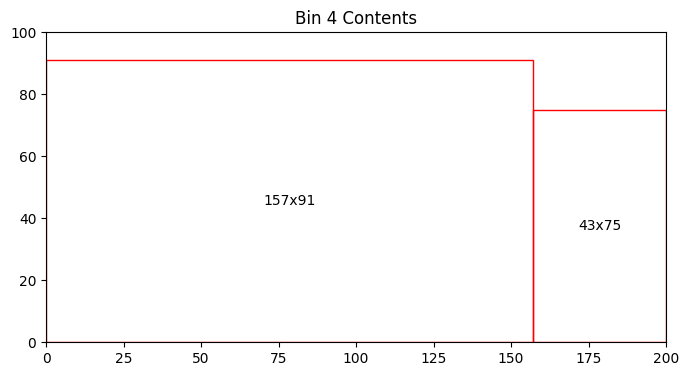

Bin 4 has 2488.00 units of area left


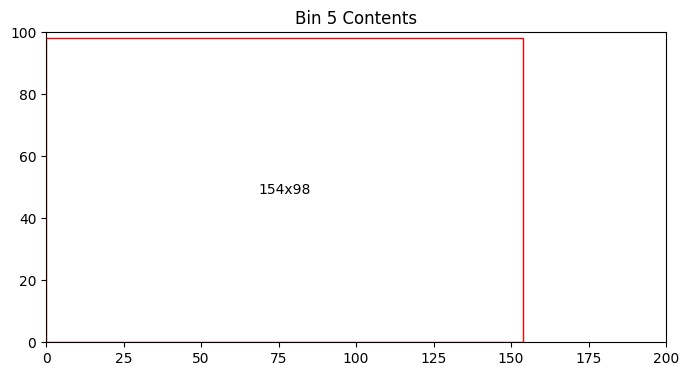

Bin 5 has 4908.00 units of area left


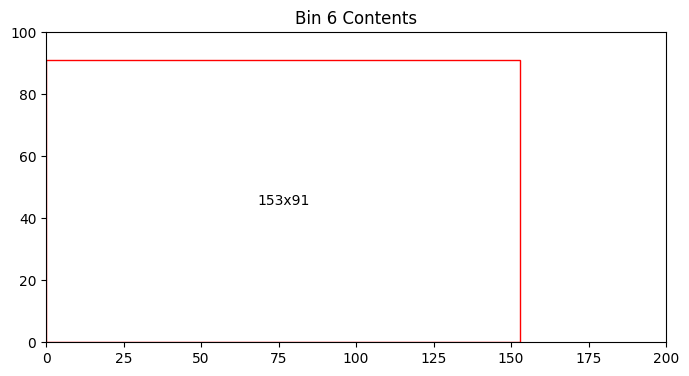

Bin 6 has 6077.00 units of area left


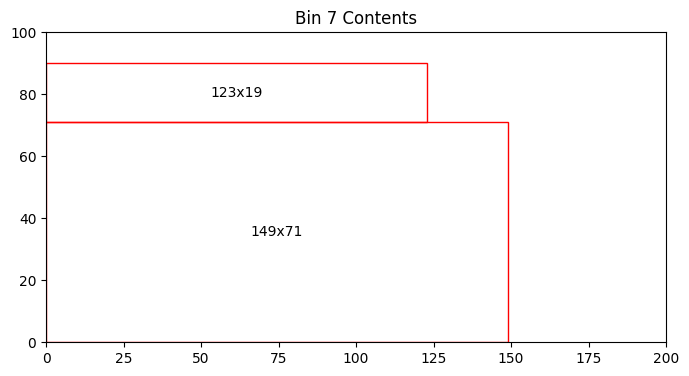

Bin 7 has 7084.00 units of area left


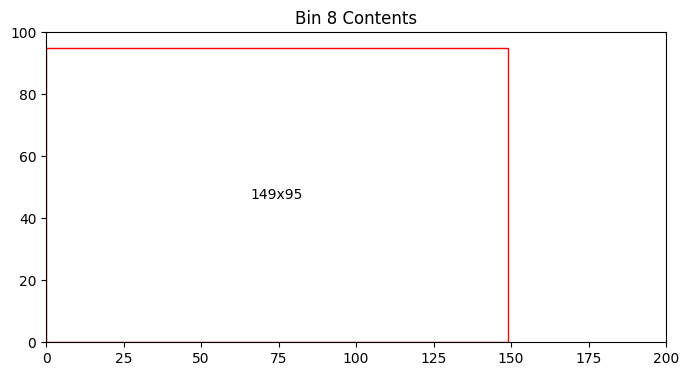

Bin 8 has 5845.00 units of area left


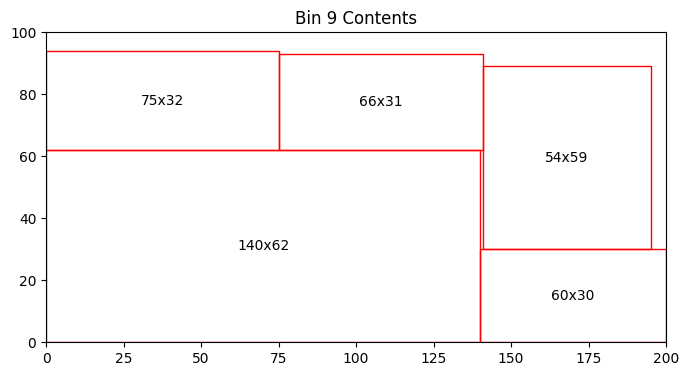

Bin 9 has 1888.00 units of area left


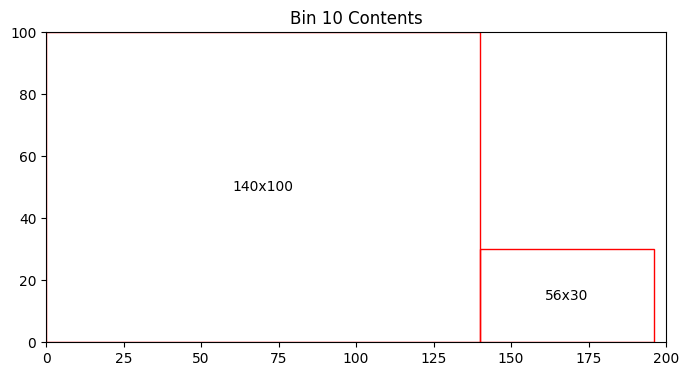

Bin 10 has 4320.00 units of area left


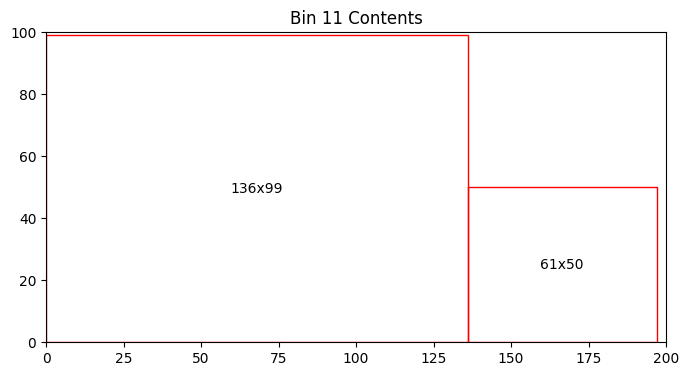

Bin 11 has 3486.00 units of area left


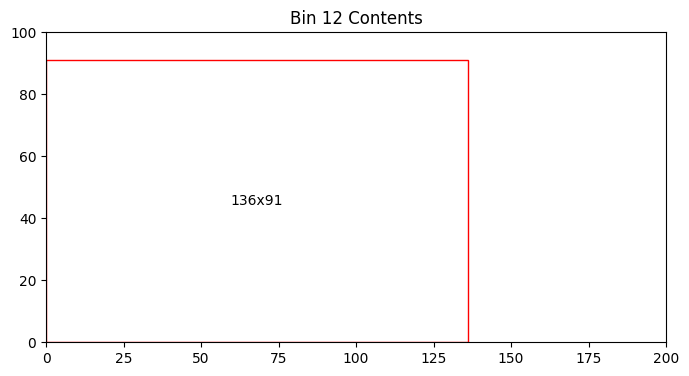

Bin 12 has 7624.00 units of area left


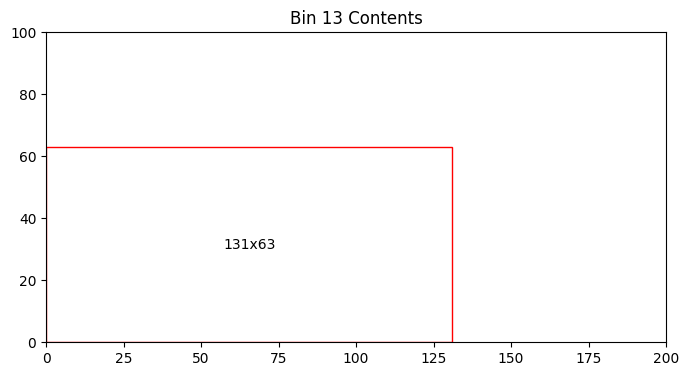

Bin 13 has 11747.00 units of area left


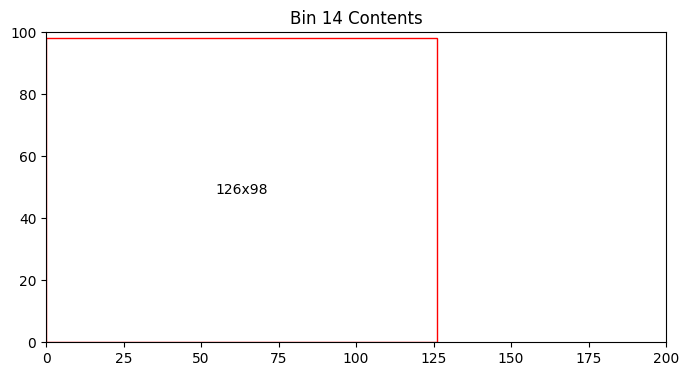

Bin 14 has 7652.00 units of area left


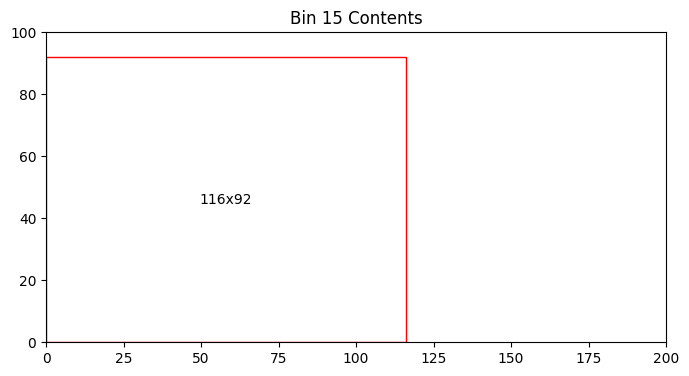

Bin 15 has 9328.00 units of area left


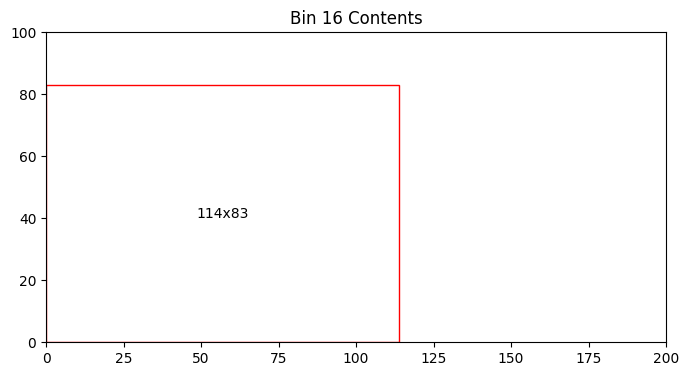

Bin 16 has 10538.00 units of area left


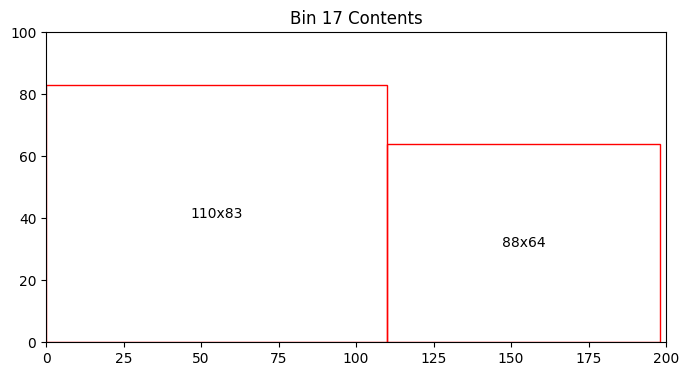

Bin 17 has 5238.00 units of area left


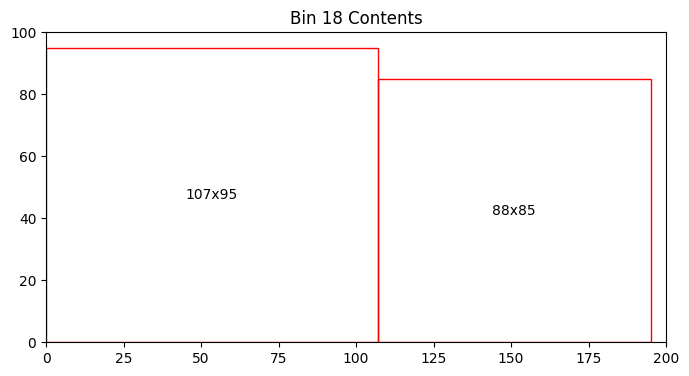

Bin 18 has 2355.00 units of area left


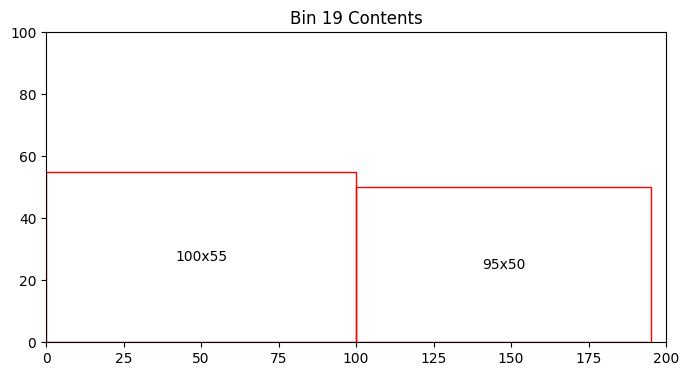

Bin 19 has 9750.00 units of area left


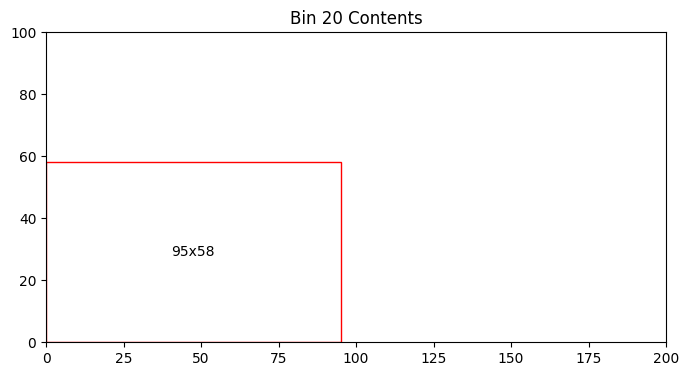

Bin 20 has 14490.00 units of area left
Total number of bins = 20
Total area left in bins = 121707.00
[[ 42  37]
 [ 60  56]
 [ 15  26]
 [139  77]
 [ 67  74]
 [187  44]
 [ 22  34]
 [ 90  29]
 [ 10  93]
 [ 92  29]
 [ 94  59]
 [ 63  32]
 [ 46  35]
 [117  18]
 [153   2]
 [  2  22]
 [139  56]
 [ 25  86]
 [165  51]
 [108  51]
 [ 36  55]
 [112  10]
 [ 12  88]
 [ 84  35]
 [ 74  16]
 [110  65]
 [107  28]
 [ 88   7]
 [ 60  16]
 [198  56]
 [168  28]
 [ 25  99]
 [175  43]
 [130  63]
 [ 30  47]
 [ 79  78]
 [193  93]
 [ 50  84]
 [128  98]
 [166  74]
 [ 93  98]
 [ 73  57]
 [117  95]
 [ 99  30]
 [101  28]
 [113  45]
 [161  32]
 [ 71  49]
 [135  37]
 [158  35]]


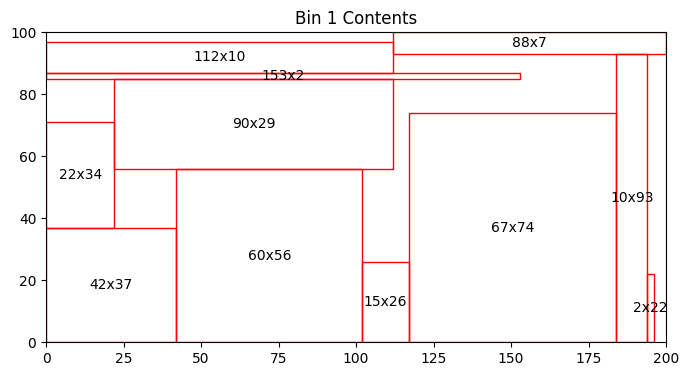

Bin 1 has 3364.00 units of area left


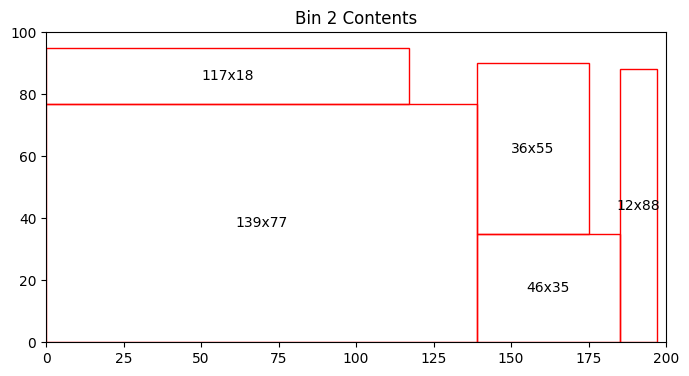

Bin 2 has 2545.00 units of area left


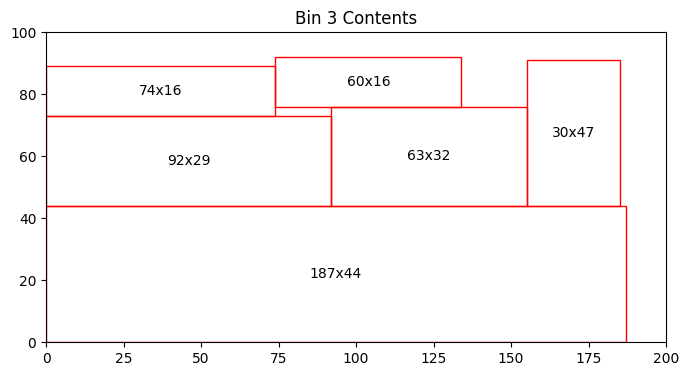

Bin 3 has 3534.00 units of area left


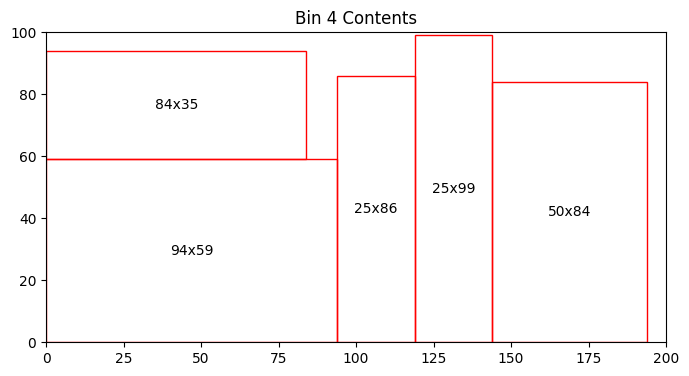

Bin 4 has 2689.00 units of area left


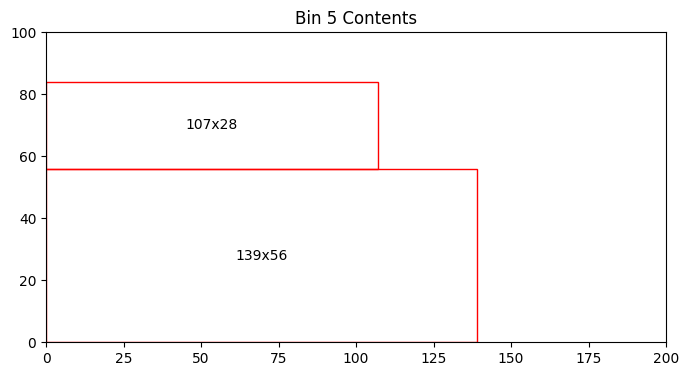

Bin 5 has 9220.00 units of area left


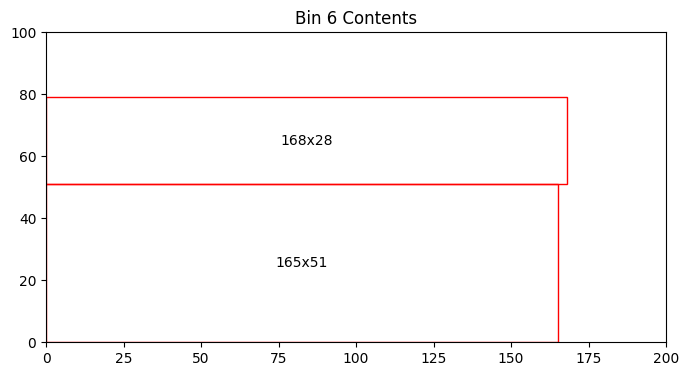

Bin 6 has 6881.00 units of area left


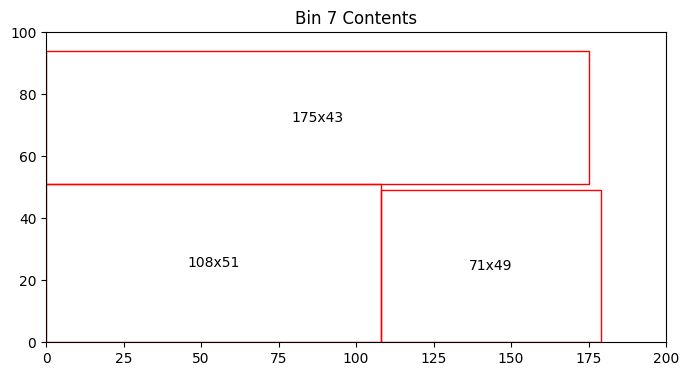

Bin 7 has 3488.00 units of area left


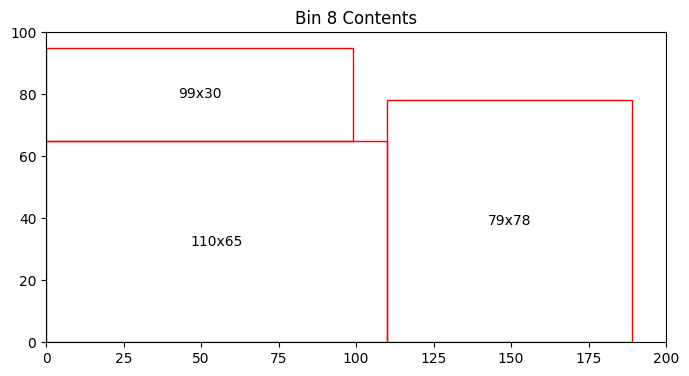

Bin 8 has 3718.00 units of area left


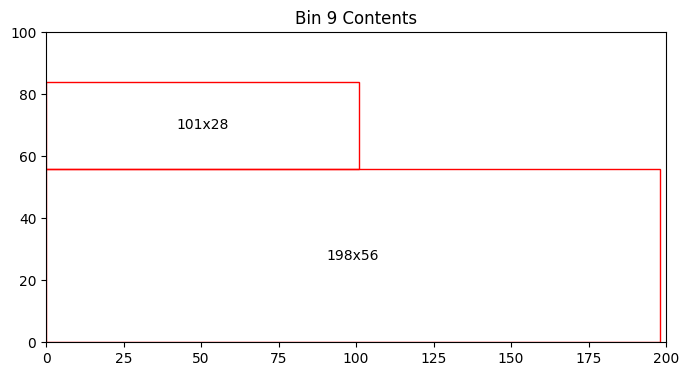

Bin 9 has 6084.00 units of area left


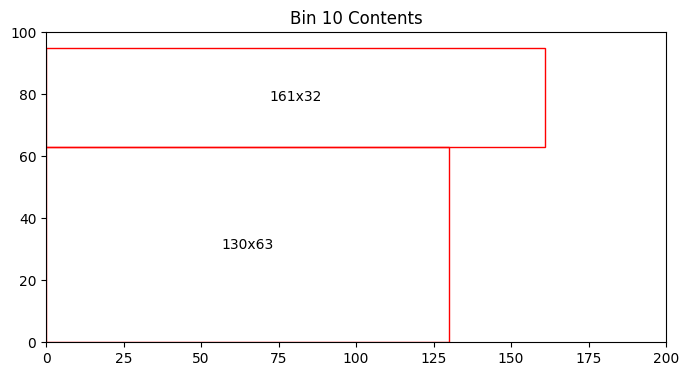

Bin 10 has 6658.00 units of area left


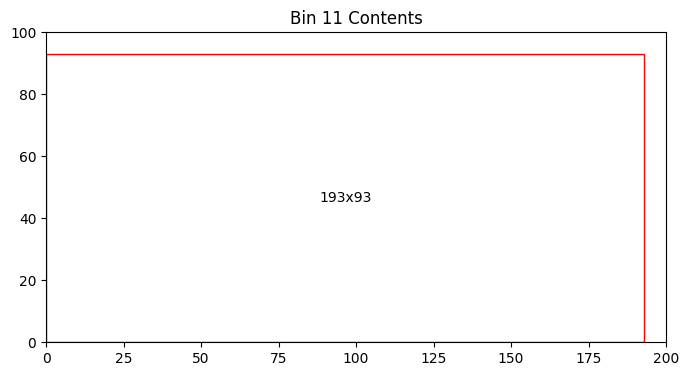

Bin 11 has 2051.00 units of area left


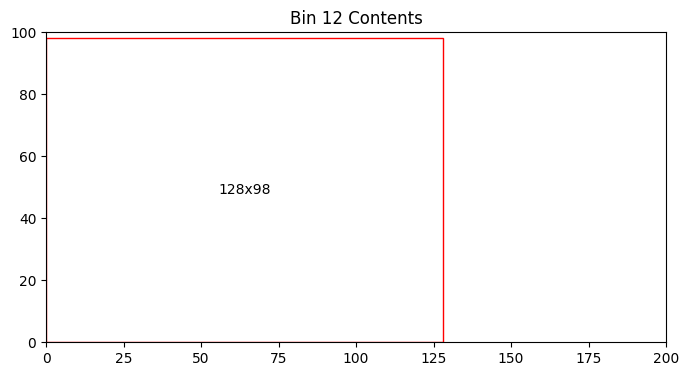

Bin 12 has 7456.00 units of area left


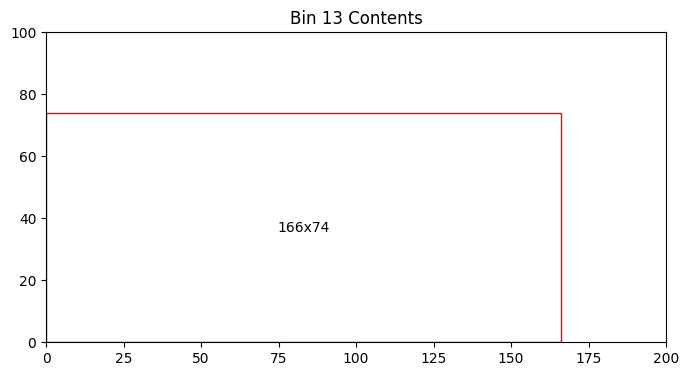

Bin 13 has 7716.00 units of area left


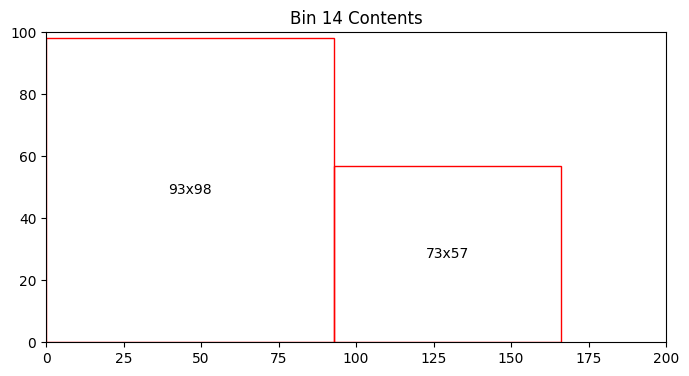

Bin 14 has 6725.00 units of area left


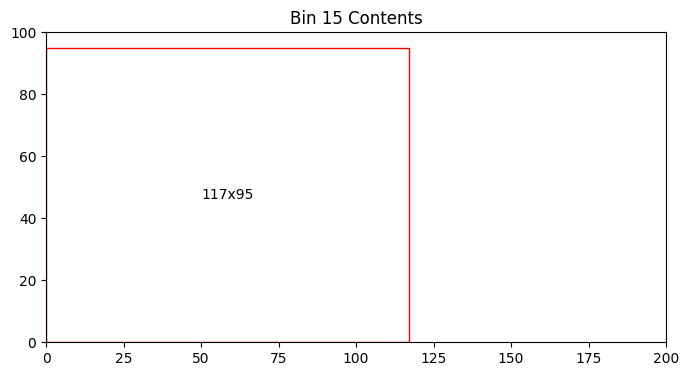

Bin 15 has 8885.00 units of area left


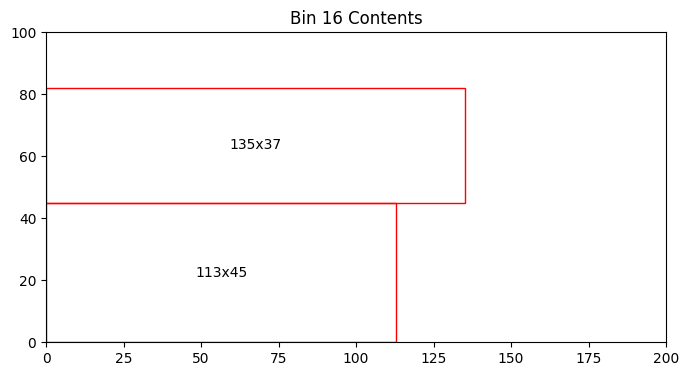

Bin 16 has 9920.00 units of area left


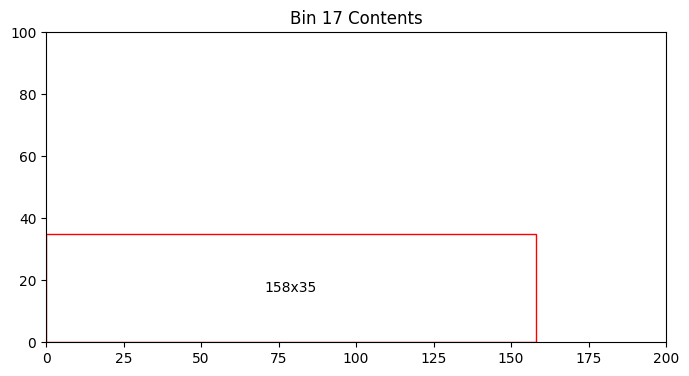

Bin 17 has 14470.00 units of area left
Total number of bins = 17
Total area left in bins = 105404.00


In [11]:
import os

def check_bins(bins, bin_width, bin_height):
    import itertools
    from collections import defaultdict
    
    # Function to check overlapping of two items
    def are_overlapping(item1, item2):
        x1, y1 = item1[1], item1[2]
        x2, y2 = item2[1], item2[2]
        # Assuming the items have a height and width, which we don't have here.
        # For simplicity, assuming each item is 1x1 unit (you can replace with actual dimensions)
        width1, height1 = 1, 1
        width2, height2 = 1, 1
        
        return not (x1 + width1 <= x2 or x2 + width2 <= x1 or y1 + height1 <= y2 or y2 + height2 <= y1)
    
    # Check that no items overlap within each bin
    for bin in bins:
        for item1, item2 in itertools.combinations(bin, 2):
            if are_overlapping(item1, item2):
                return False, "Items overlap within a bin."
    
    # Check that all items fit within the bin boundaries
    for bin in bins:
        for item in bin:
            x, y = item[1], item[2]
            width, height = 1, 1  # Assuming each item is 1x1 unit; replace with actual dimensions
            if not (0 <= x < bin_width and 0 <= y < bin_height and x + width <= bin_width and y + height <= bin_height):
                return False, "An item doesn't fit within the bin boundaries."
    
    # Check that all items are packed in some bin
    item_count = defaultdict(int)
    for bin in bins:
        for item in bin:
            item_count[item[0]] += 1
    
    all_item_indices = set(itertools.chain(*[[item[0] for item in bin] for bin in bins]))
    num_items = max(all_item_indices)
    
    if all_item_indices != set(range(num_items + 1)):
        return False, "Not all items are packed in a bin."
    
    # Check that no item appears in more than one bin
    for count in item_count.values():
        if count > 1:
            return False, "An item appears in more than one bin."

    return True, "All checks passed."


def read_file_content(file_path):
    with open(file_path, 'r') as file:
        return file.read()

def save_file_content(file_path, content):
    with open(file_path, 'w') as file:
        file.write(content)

for i in range(1, 21):
    # Define file paths
    generated_code_path = f'2_generated_codes/{i}_2_generated_code.py'
    base_code_path = 'base.py'
    checked_code_path = f'2_checked_codes/{i}_2_checked_code.py'
    
    # Read the content of the generated code and base code
    generated_code_content = read_file_content(generated_code_path)
    base_code_content = read_file_content(base_code_path)
    
    # Combine the content
    combined_content = generated_code_content + "\n" + base_code_content
    
    try:
        # Execute the combined content
        exec(combined_content)
        
        # Check the bins
        result, message = check_bins(bins, 200, 100)
        
        # If the result is True, save the checked code
        if result:
            save_file_content(checked_code_path, combined_content)
    except Exception as e:
        print(f"Error occurred while processing code {i}: {e}")




Step 5 (Evaluation)

In [35]:
import numpy as np
import random
import os

class Rectangle:
    def __init__(self, width, height):
        self.width = width
        self.height = height
    def __repr__(self):
        return f"Rectangle({self.width}, {self.height})"

def generate_rectangles(num_rectangles):
    rectangles = []
    for _ in range(num_rectangles):
        width = random.randint(1, 200)  # Adjust range as needed
        height = random.randint(1, 100)  # Adjust range as needed
        rectangles.append(Rectangle(width, height))
    return rectangles

def rectangles_to_array(rectangles):
    # Create an array where each row is [width, height] of a rectangle
    data = np.array([[rect.width, rect.height] for rect in rectangles])
    return data

def save_array_to_txt(data, filename):
    with open(filename, 'w') as f:
        for row in data:
            f.write(f"{row[0]},{row[1]}\n")

# Generate and convert rectangles
rectangles_list = []
num_files = 3
num_rectangles = 50

for i in range(num_files):
    rectangles = generate_rectangles(num_rectangles)
    rectangles_array = rectangles_to_array(rectangles)
    rectangles_list.append(rectangles_array)
    save_array_to_txt(rectangles_array, f"rectangles_{i + 1}.txt")

# Save the list of arrays to a central text file
with open("rectangles_all.txt", "w") as f:
    for idx, rect_array in enumerate(rectangles_list):
        f.write(f"Rectangles Set {idx + 1}:\n")
        np.savetxt(f, rect_array, delimiter=",", fmt="%d")
        f.write("\n")


In [12]:
import os
import numpy as np
import json

# Function to load rectangles from a text file
def load_rectangles(file_path):
    with open(file_path, 'r') as file:
        content = file.read()
        
    # Split the content into individual sets by detecting "Rectangles Set"
    sets = content.split("Rectangles Set")
    
    # Skip the first empty split part
    sets = sets[1:]

    rectangles_list = []
    for set_content in sets:
        lines = set_content.strip().split('\n')[1:]  # Skip the "X:" line and empty lines
        rectangles = [tuple(map(int, line.split(','))) for line in lines if line]
        rectangles_array = np.array(rectangles)
        rectangles_list.append(rectangles_array)
    
    return rectangles_list

# Load the rectangles
rectangles_file_path = 'rectangles_all.txt'
rectangles_list = load_rectangles(rectangles_file_path)
rectangles_list

[array([[159,  47],
        [161,  93],
        [135,  77],
        [199,  24],
        [190,  86],
        [147,  61],
        [157,  63],
        [130,  90],
        [108,  98],
        [132,  27],
        [185,  56],
        [138,  23],
        [173,  96],
        [142,  88],
        [ 76,  46],
        [105,  71],
        [158,  43],
        [138,  28],
        [134,  36],
        [ 62,  68],
        [132,  92],
        [196,  25],
        [110,  98],
        [ 13,  63],
        [ 61,  59],
        [181,  49],
        [ 20,  53],
        [156,  14],
        [177,  22],
        [ 98,   3],
        [ 21,  96],
        [ 76,  32],
        [ 10,  79],
        [ 91,  34],
        [ 86,  57],
        [ 71,  12],
        [ 14,  72],
        [  5,  63],
        [179,  29],
        [172,  52],
        [122,  74],
        [ 42,  79],
        [149,  12],
        [ 49,  23],
        [ 14,  11],
        [177,  56],
        [ 52,  84],
        [190,  43],
        [ 96,  63],
        [186,  72]])

[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


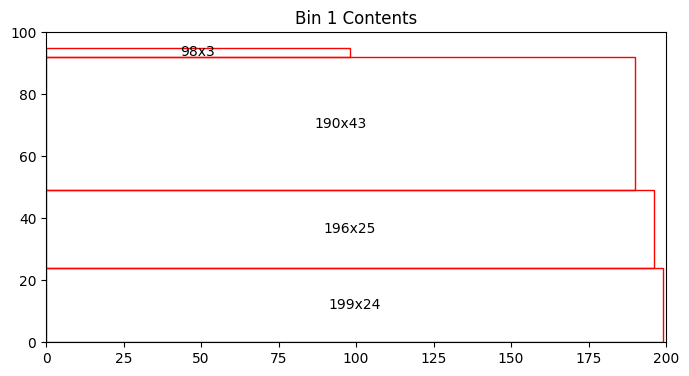

Bin 1 has 1860.00 units of area left


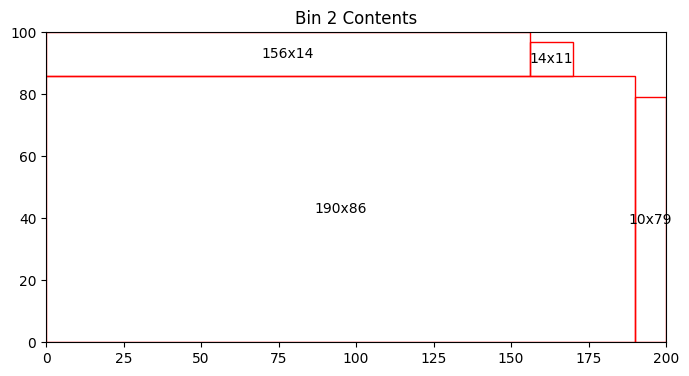

Bin 2 has 532.00 units of area left


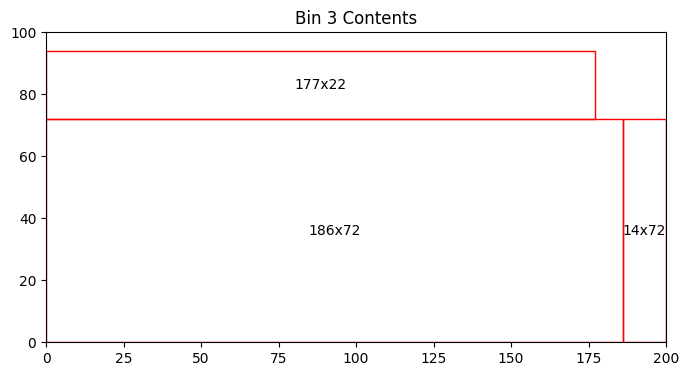

Bin 3 has 1706.00 units of area left


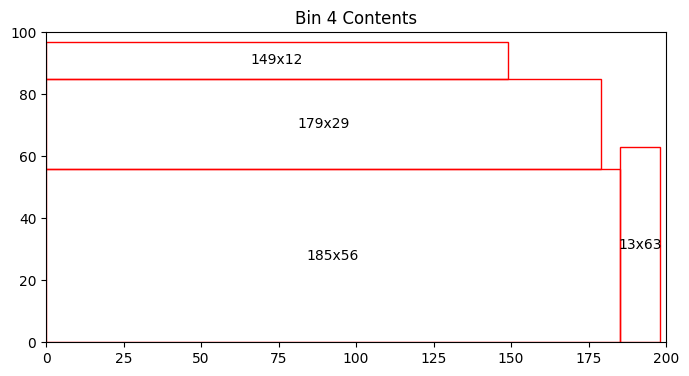

Bin 4 has 1842.00 units of area left


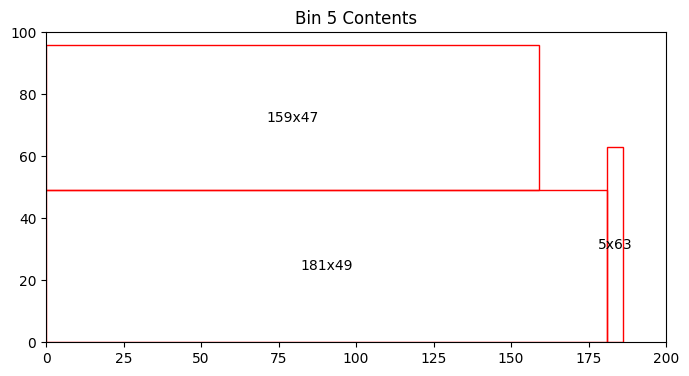

Bin 5 has 3343.00 units of area left


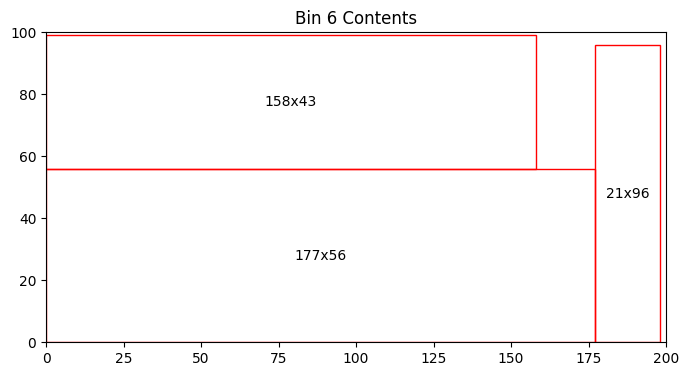

Bin 6 has 1278.00 units of area left


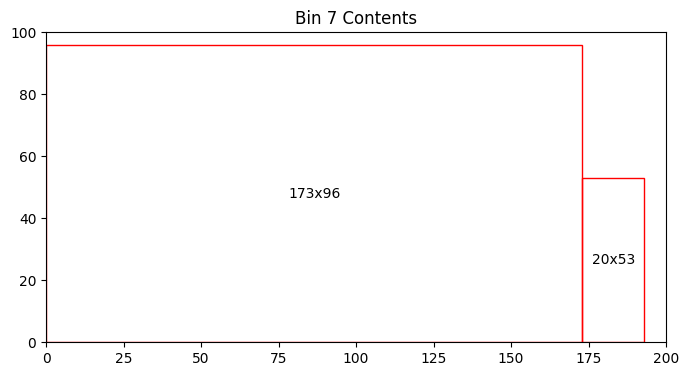

Bin 7 has 2332.00 units of area left


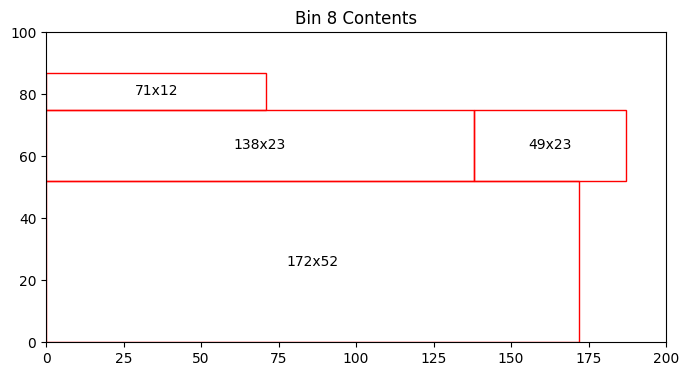

Bin 8 has 5903.00 units of area left


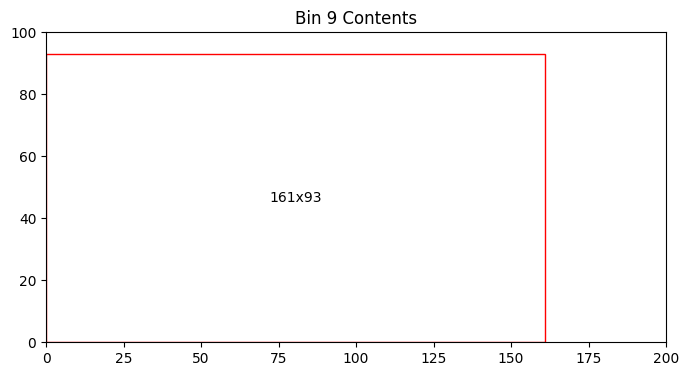

Bin 9 has 5027.00 units of area left


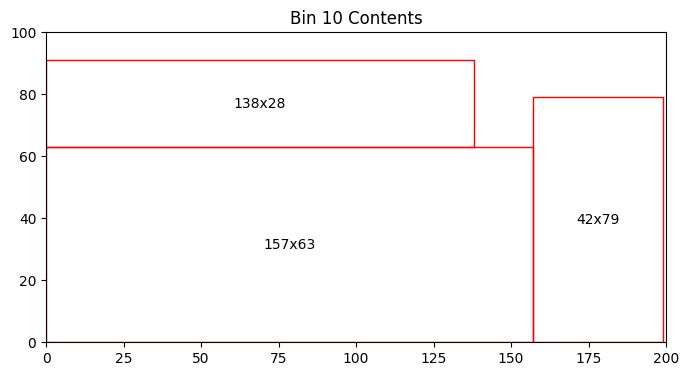

Bin 10 has 2927.00 units of area left


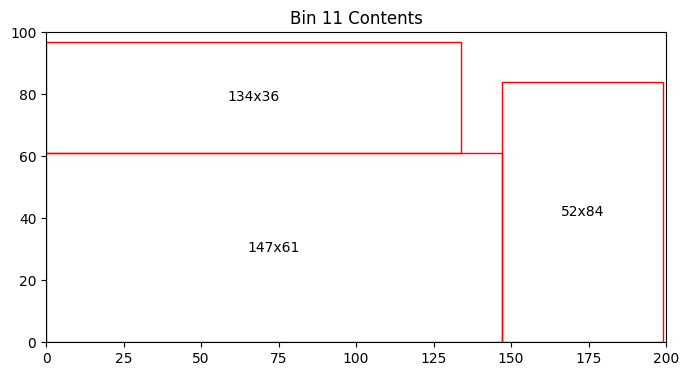

Bin 11 has 1841.00 units of area left


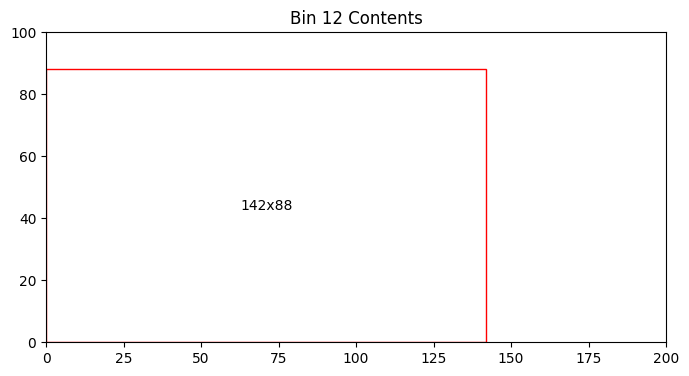

Bin 12 has 7504.00 units of area left


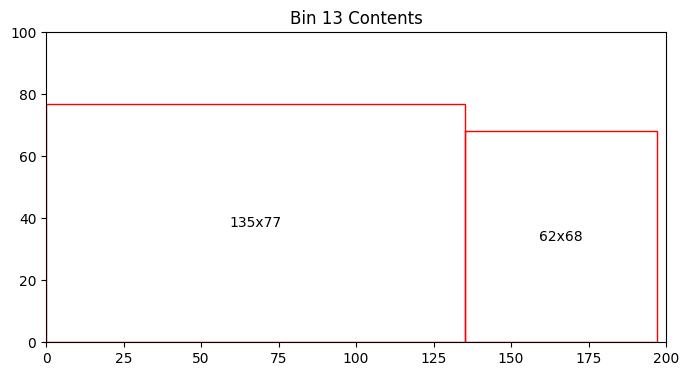

Bin 13 has 5389.00 units of area left


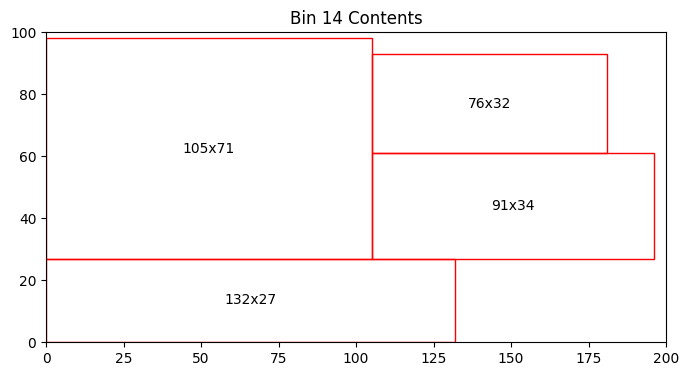

Bin 14 has 3455.00 units of area left


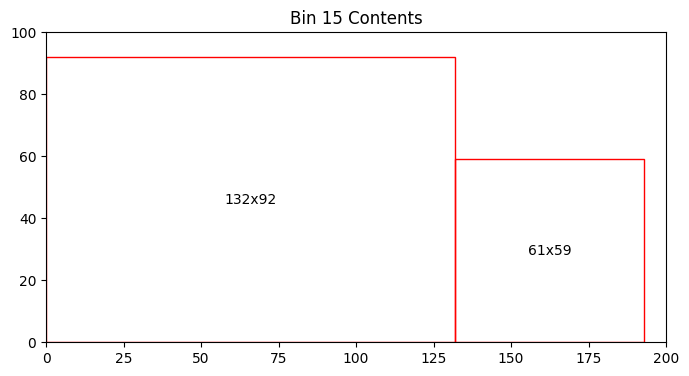

Bin 15 has 4257.00 units of area left


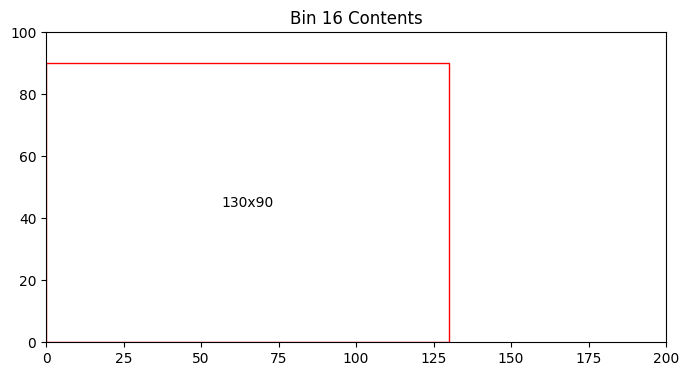

Bin 16 has 8300.00 units of area left


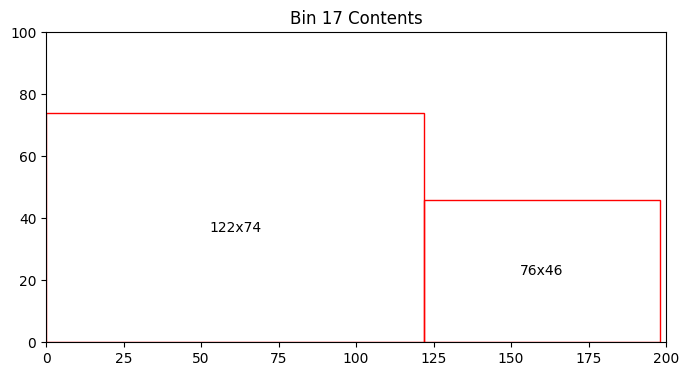

Bin 17 has 7476.00 units of area left


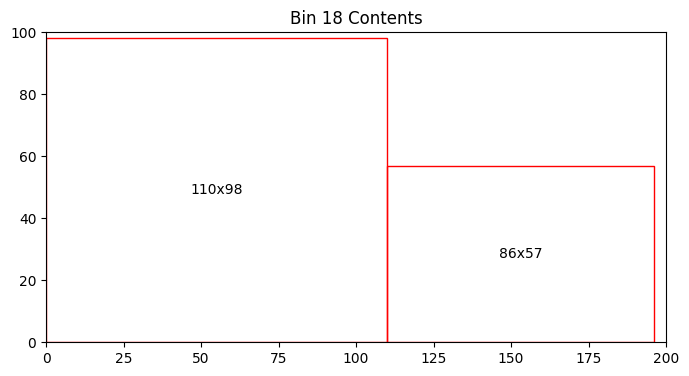

Bin 18 has 4318.00 units of area left


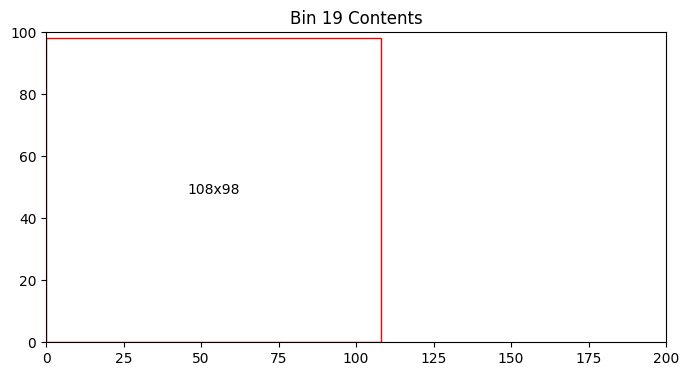

Bin 19 has 9416.00 units of area left


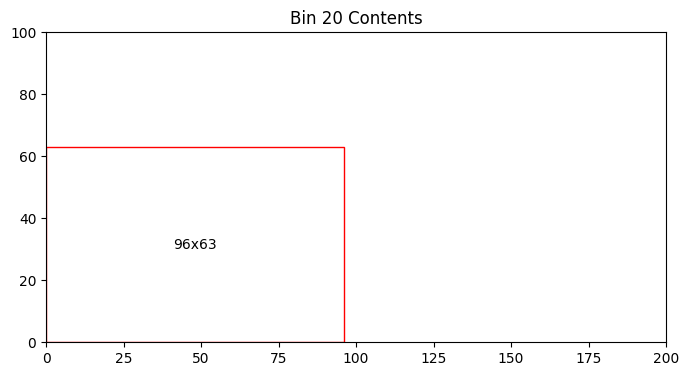

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


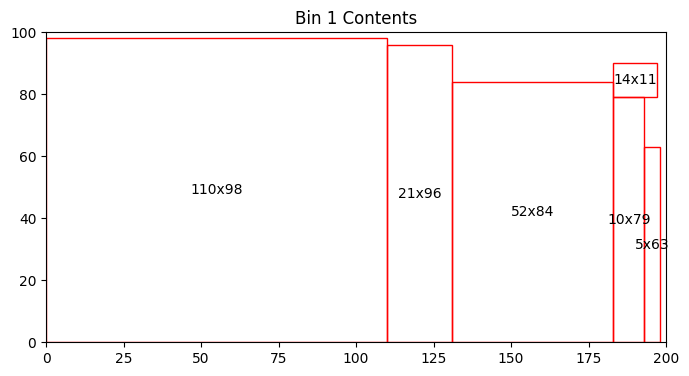

Bin 1 has 1577.00 units of area left


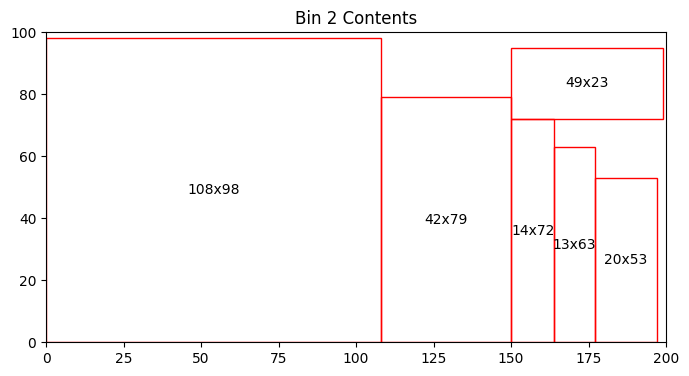

Bin 2 has 2084.00 units of area left


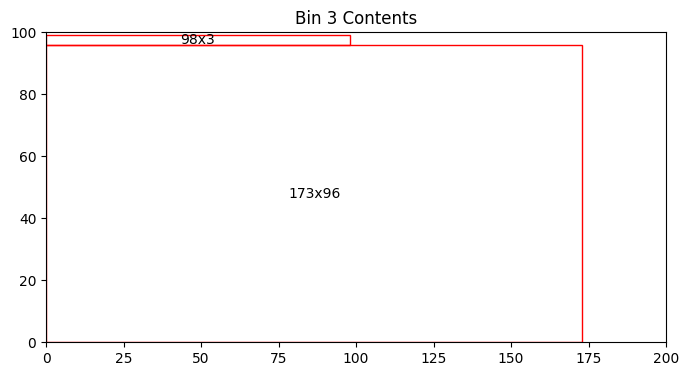

Bin 3 has 3098.00 units of area left


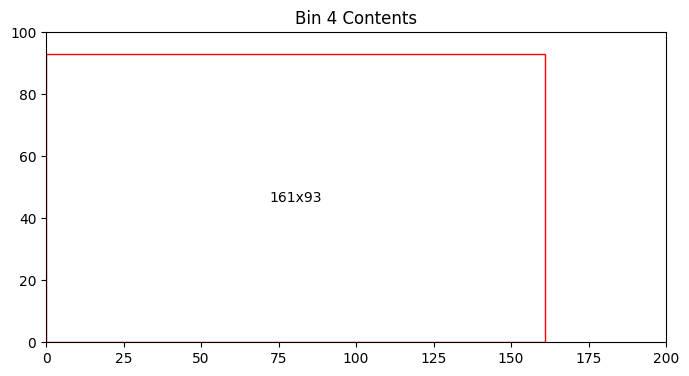

Bin 4 has 5027.00 units of area left


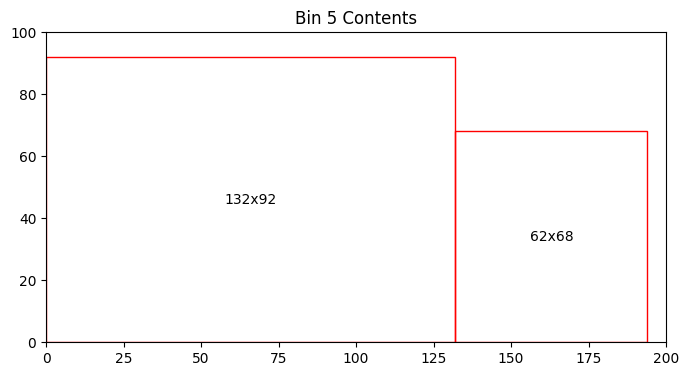

Bin 5 has 3640.00 units of area left


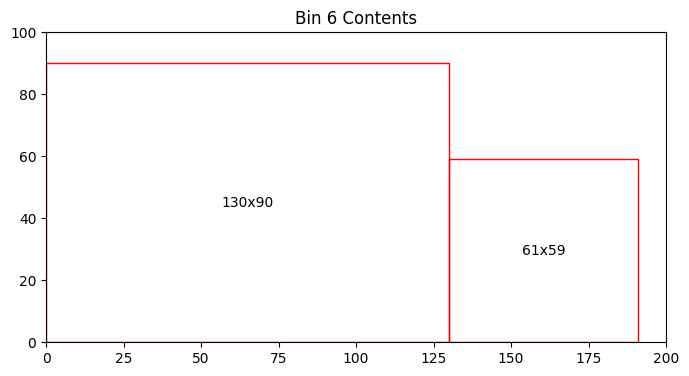

Bin 6 has 4701.00 units of area left


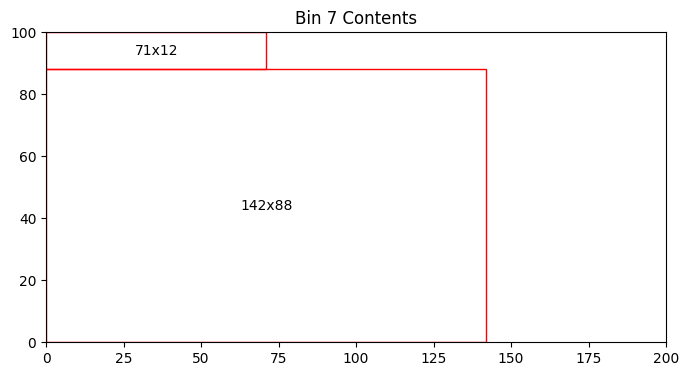

Bin 7 has 6652.00 units of area left


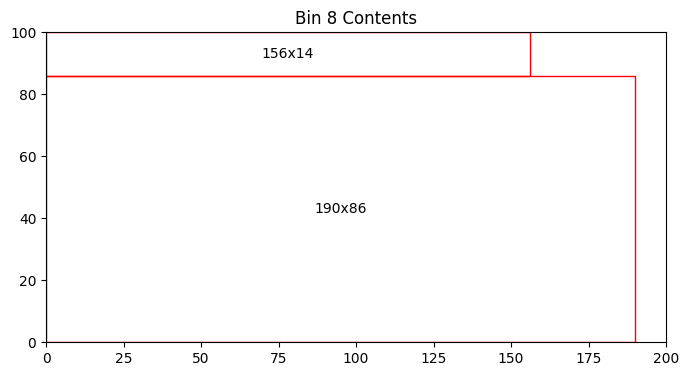

Bin 8 has 1476.00 units of area left


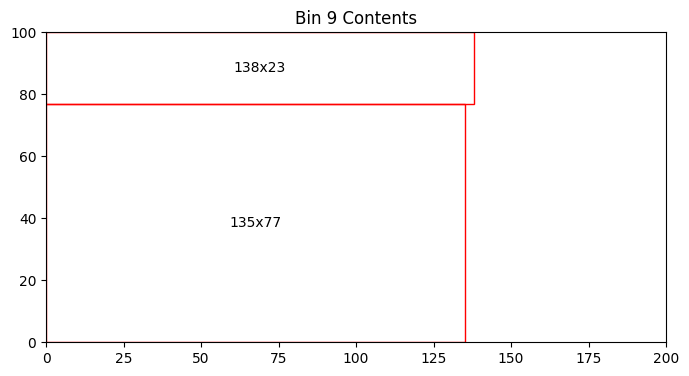

Bin 9 has 6431.00 units of area left


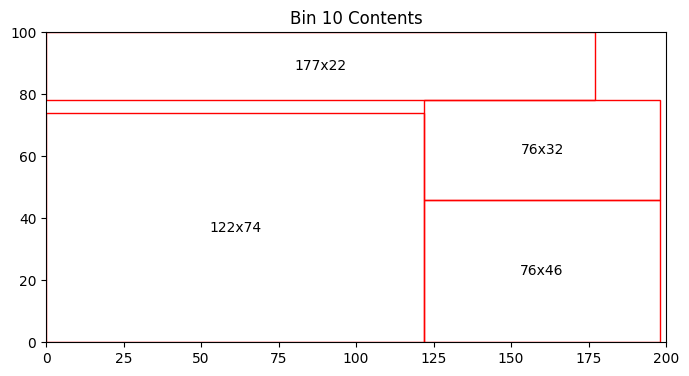

Bin 10 has 1150.00 units of area left


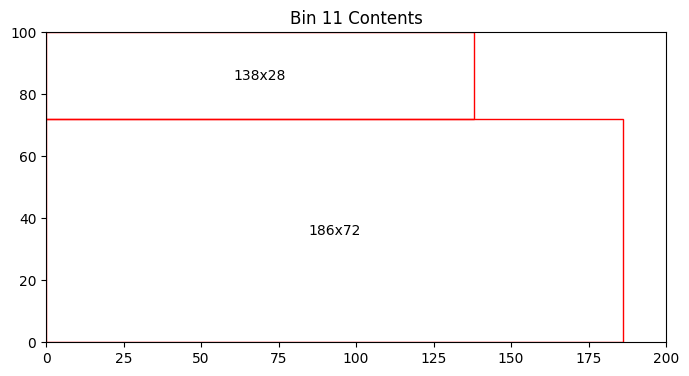

Bin 11 has 2744.00 units of area left


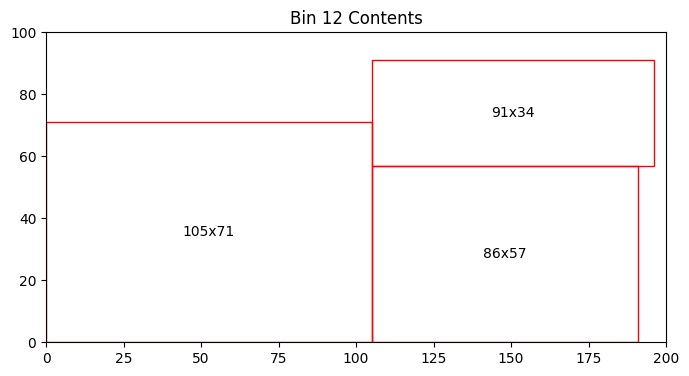

Bin 12 has 4549.00 units of area left


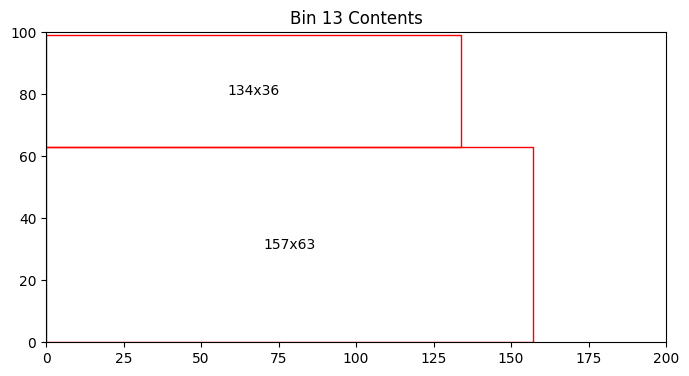

Bin 13 has 5285.00 units of area left


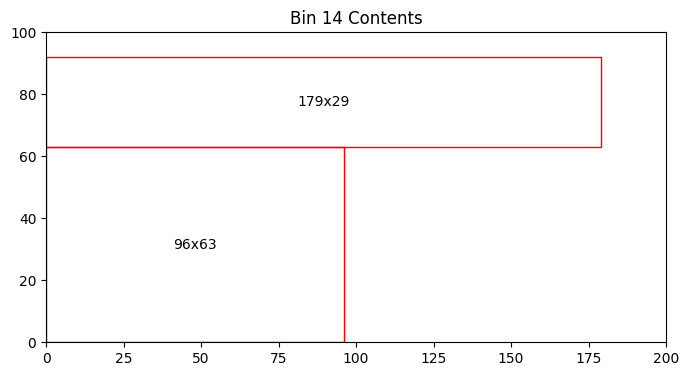

Bin 14 has 8761.00 units of area left


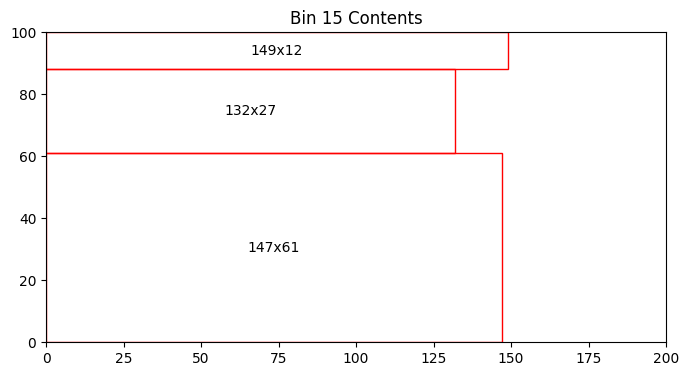

Bin 15 has 5681.00 units of area left


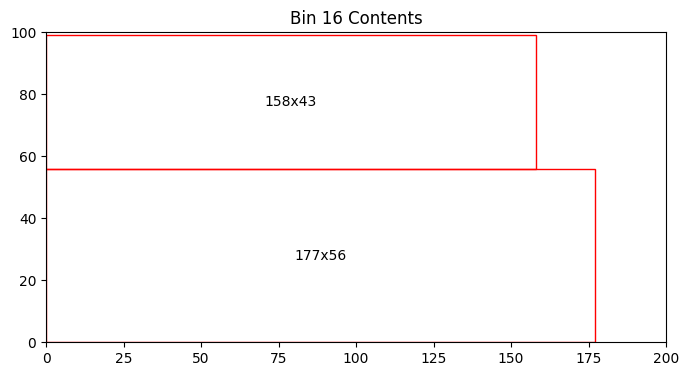

Bin 16 has 3294.00 units of area left


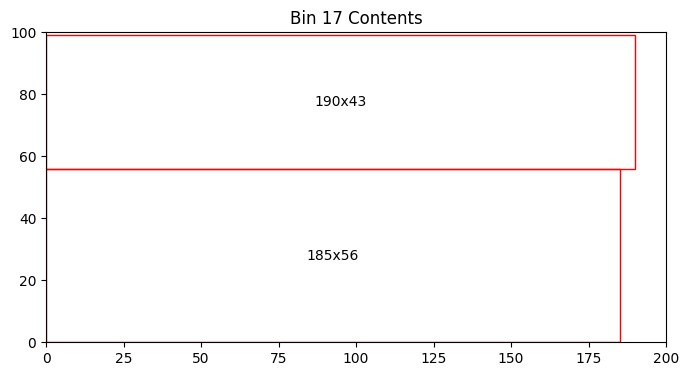

Bin 17 has 1470.00 units of area left


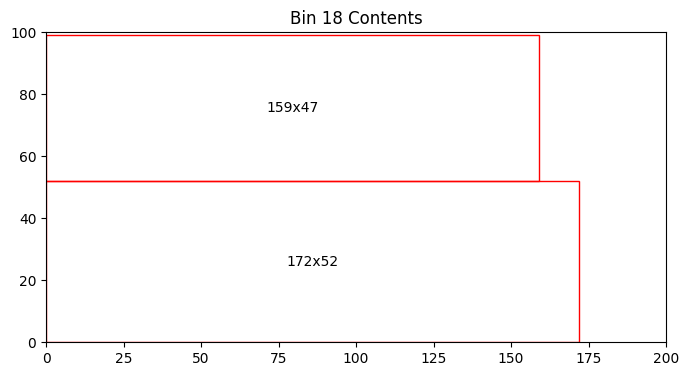

Bin 18 has 3583.00 units of area left


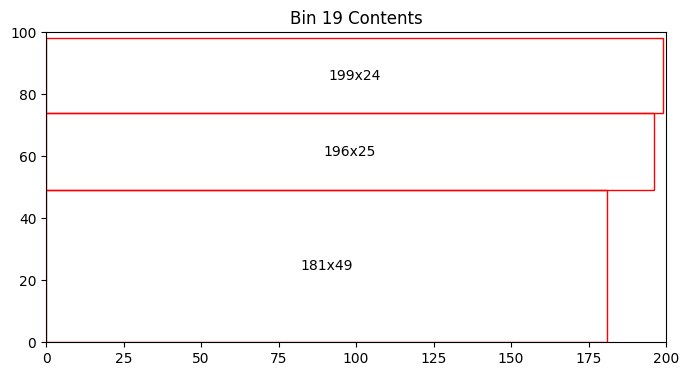

Bin 19 has 1455.00 units of area left
Total number of bins = 19
Total area left in bins = 72658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


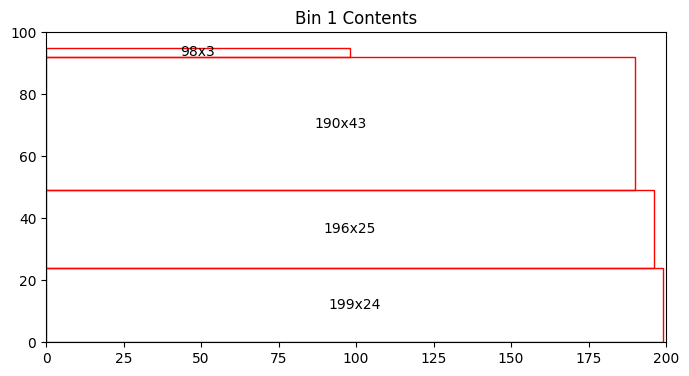

Bin 1 has 1860.00 units of area left


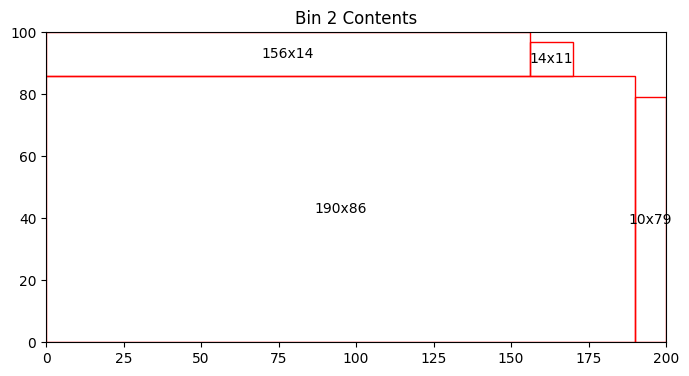

Bin 2 has 532.00 units of area left


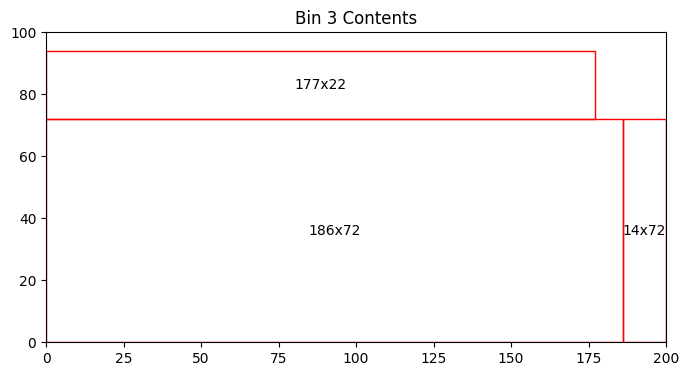

Bin 3 has 1706.00 units of area left


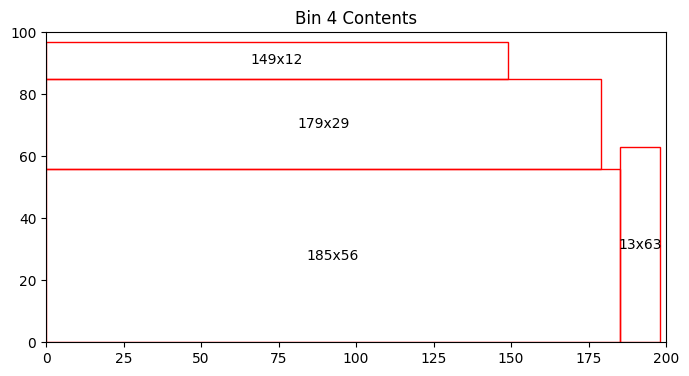

Bin 4 has 1842.00 units of area left


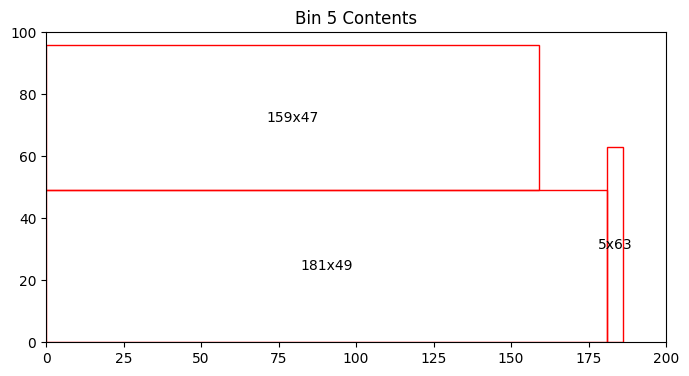

Bin 5 has 3343.00 units of area left


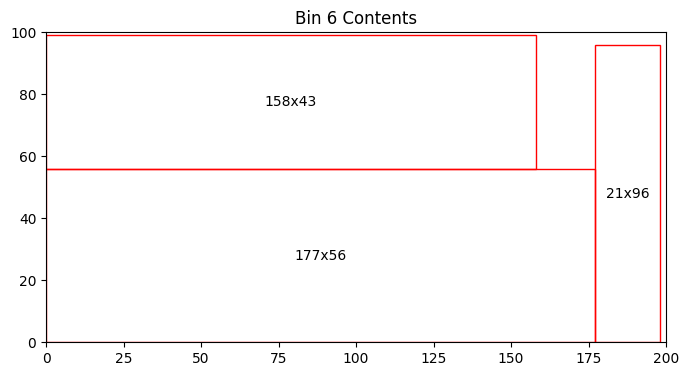

Bin 6 has 1278.00 units of area left


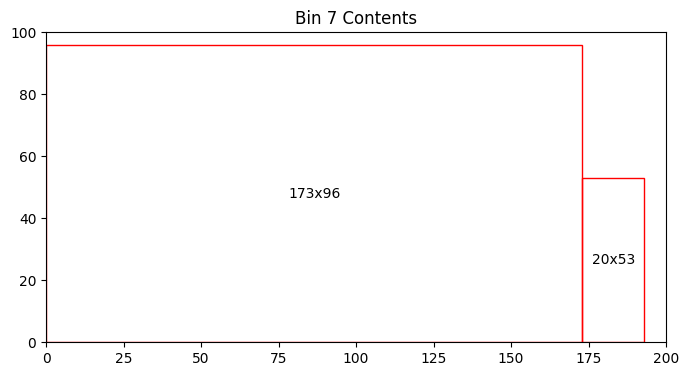

Bin 7 has 2332.00 units of area left


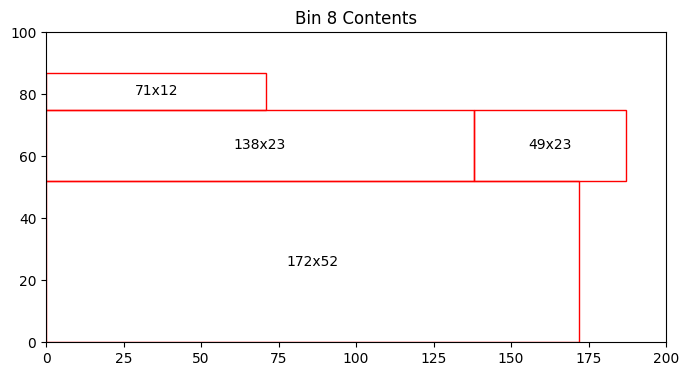

Bin 8 has 5903.00 units of area left


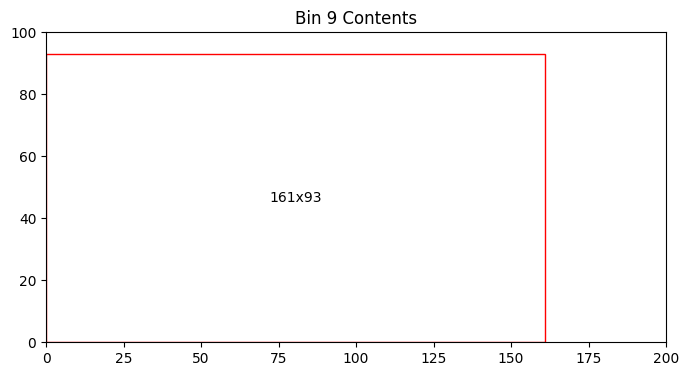

Bin 9 has 5027.00 units of area left


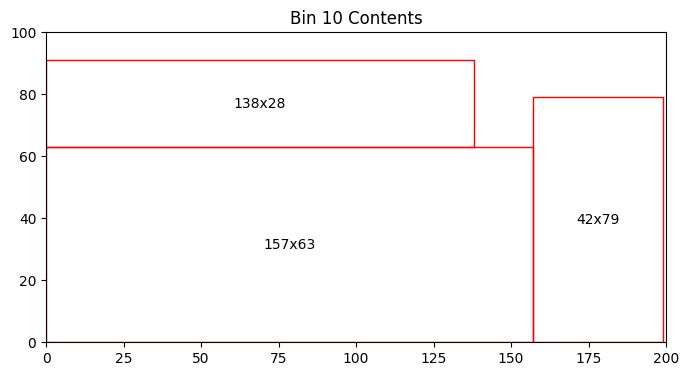

Bin 10 has 2927.00 units of area left


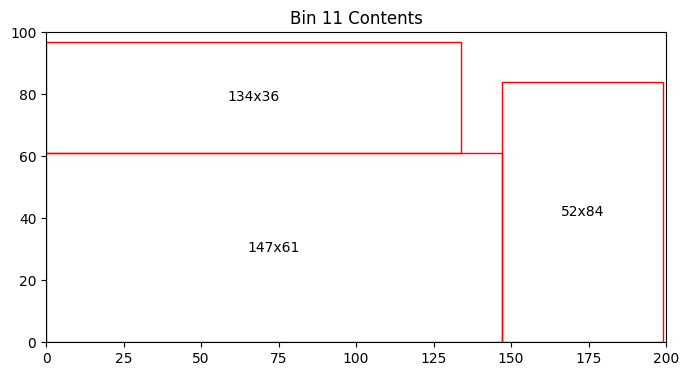

Bin 11 has 1841.00 units of area left


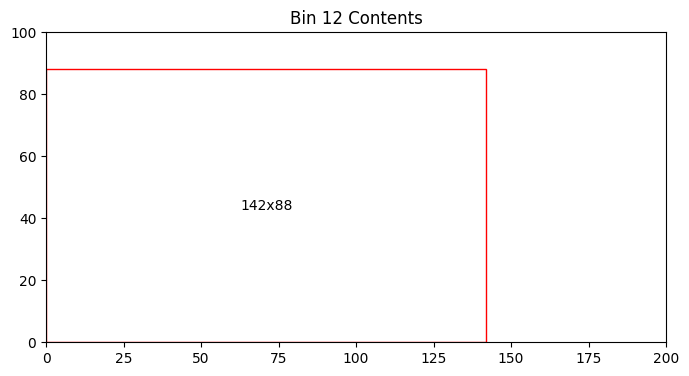

Bin 12 has 7504.00 units of area left


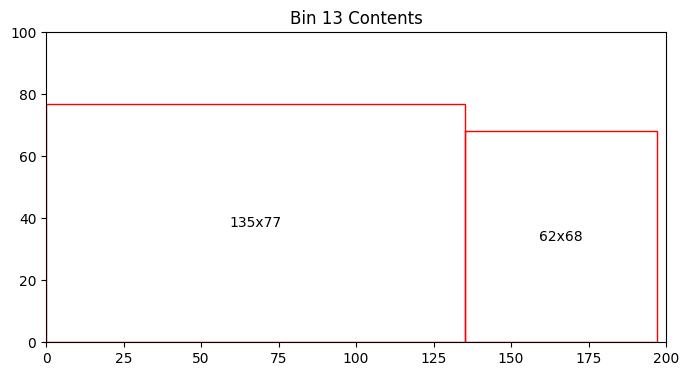

Bin 13 has 5389.00 units of area left


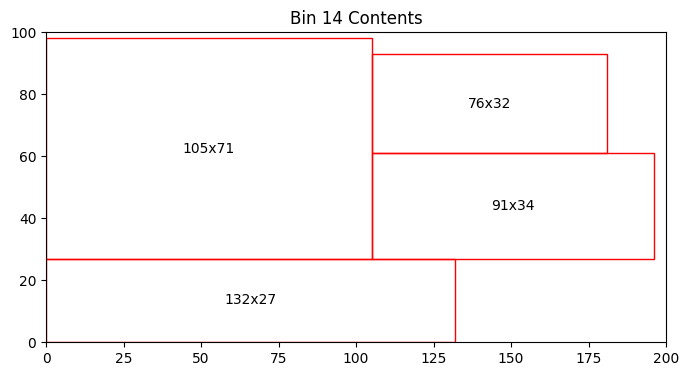

Bin 14 has 3455.00 units of area left


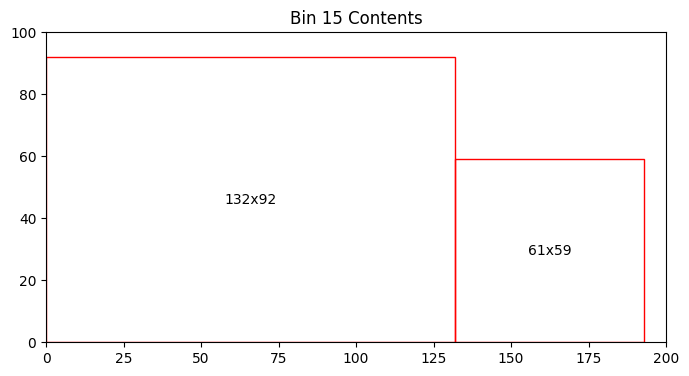

Bin 15 has 4257.00 units of area left


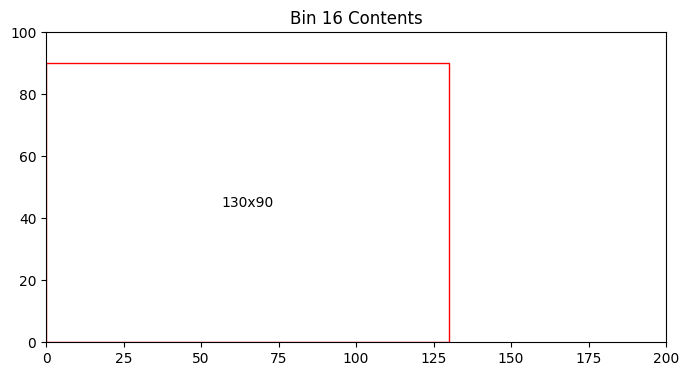

Bin 16 has 8300.00 units of area left


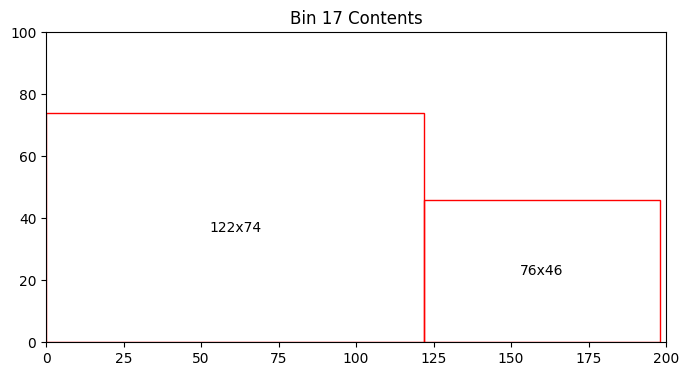

Bin 17 has 7476.00 units of area left


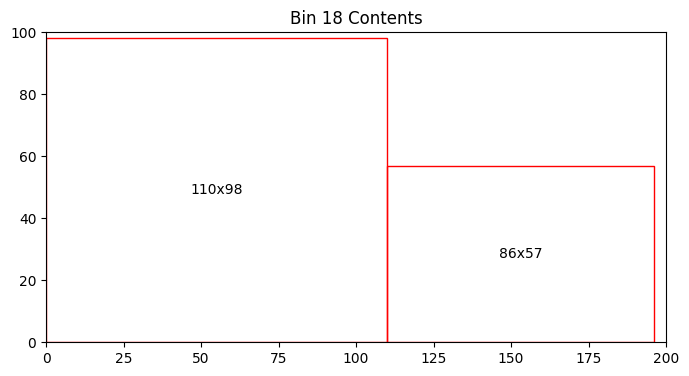

Bin 18 has 4318.00 units of area left


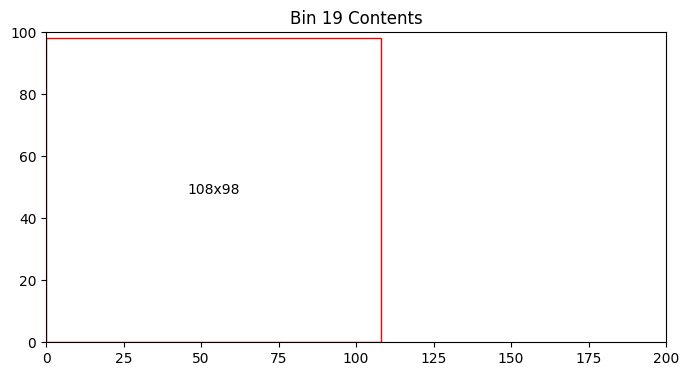

Bin 19 has 9416.00 units of area left


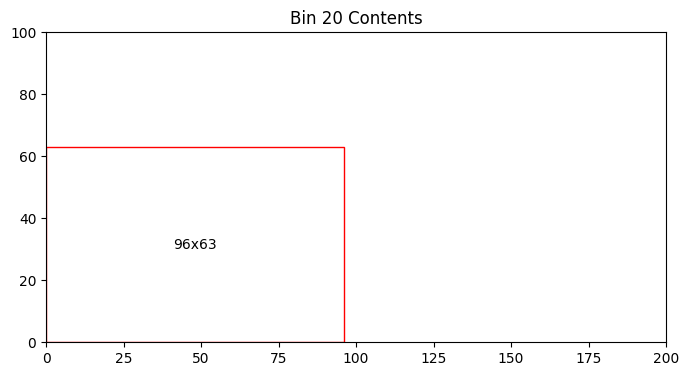

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


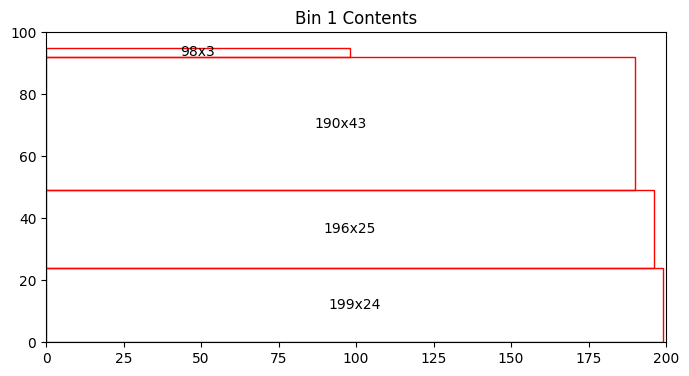

Bin 1 has 1860.00 units of area left


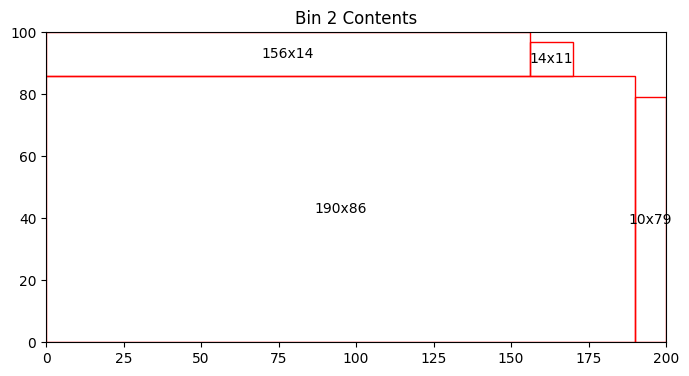

Bin 2 has 532.00 units of area left


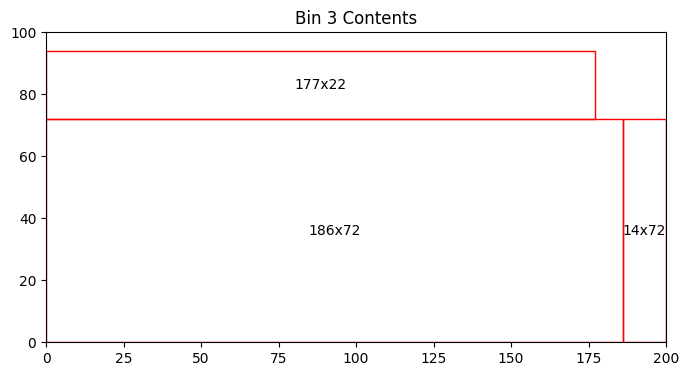

Bin 3 has 1706.00 units of area left


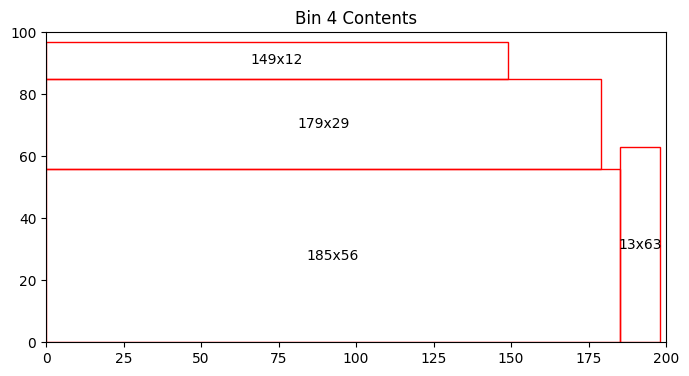

Bin 4 has 1842.00 units of area left


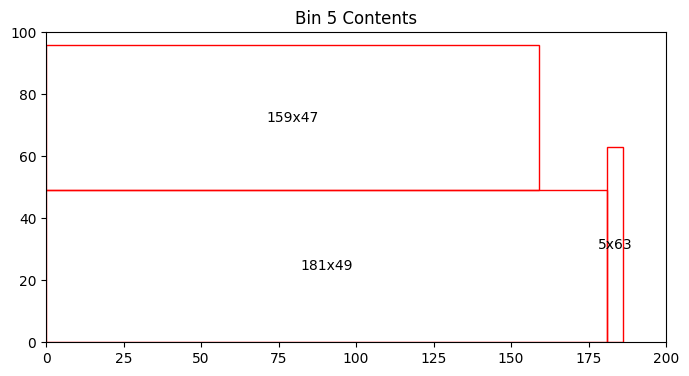

Bin 5 has 3343.00 units of area left


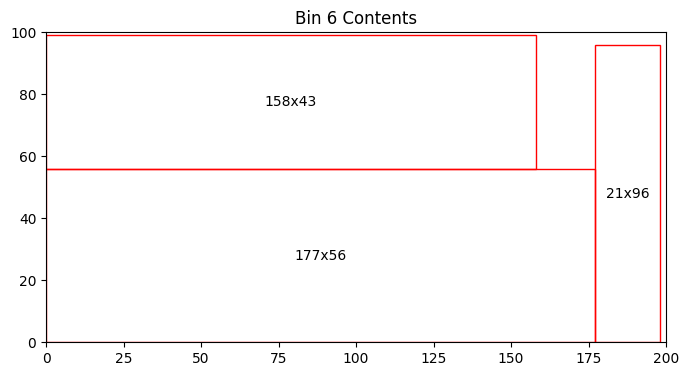

Bin 6 has 1278.00 units of area left


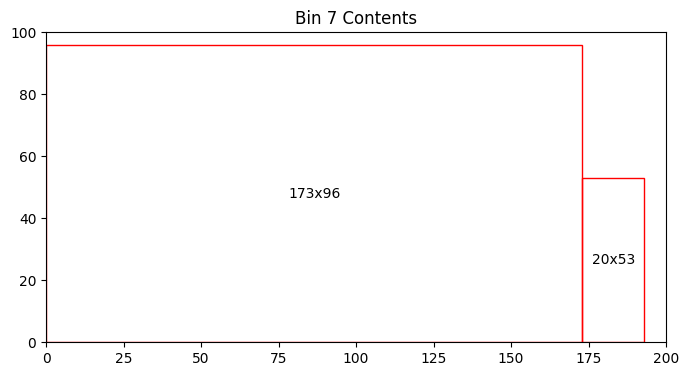

Bin 7 has 2332.00 units of area left


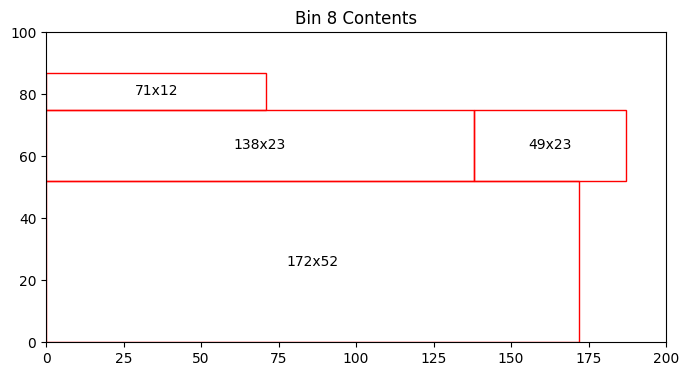

Bin 8 has 5903.00 units of area left


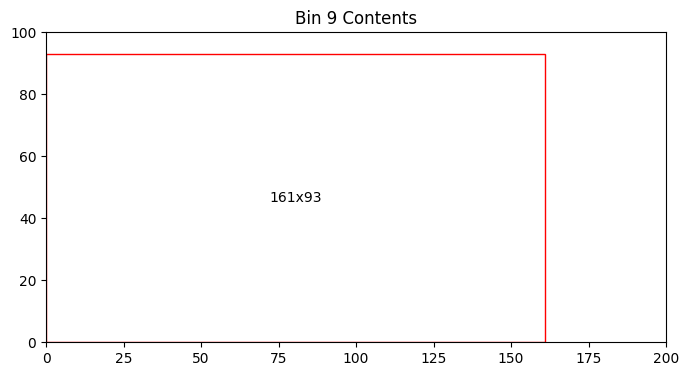

Bin 9 has 5027.00 units of area left


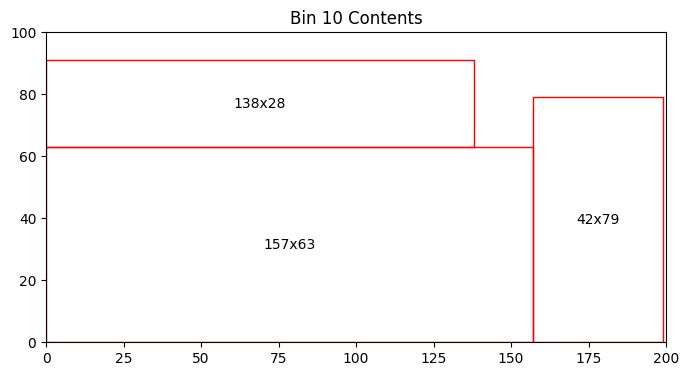

Bin 10 has 2927.00 units of area left


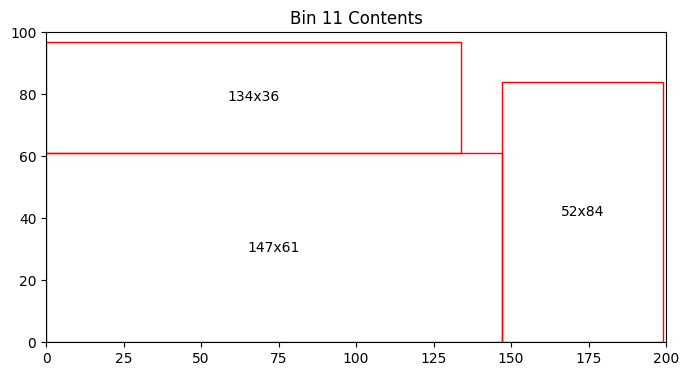

Bin 11 has 1841.00 units of area left


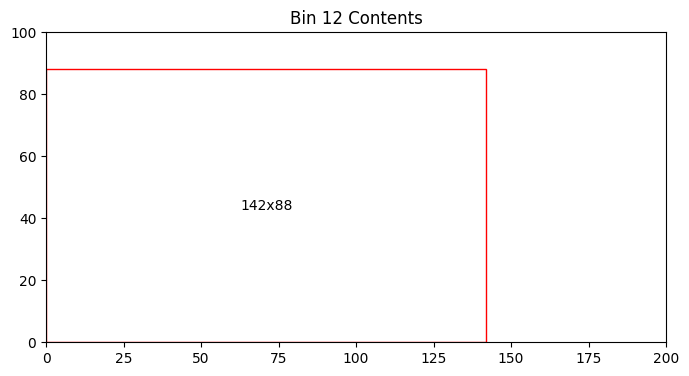

Bin 12 has 7504.00 units of area left


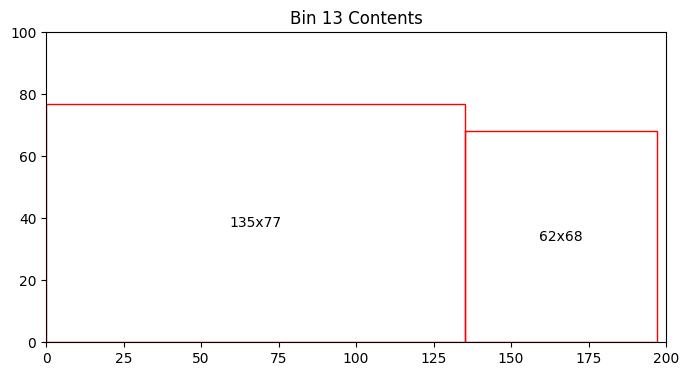

Bin 13 has 5389.00 units of area left


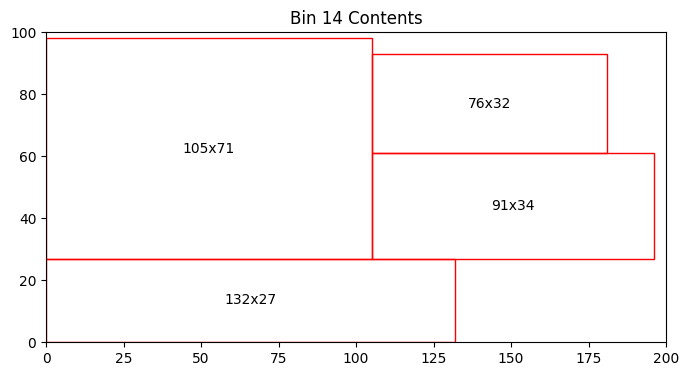

Bin 14 has 3455.00 units of area left


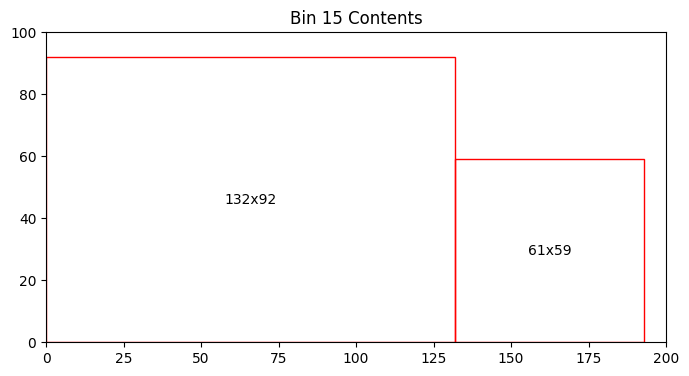

Bin 15 has 4257.00 units of area left


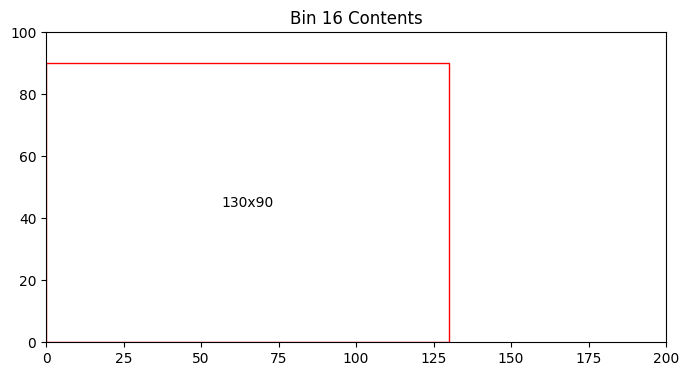

Bin 16 has 8300.00 units of area left


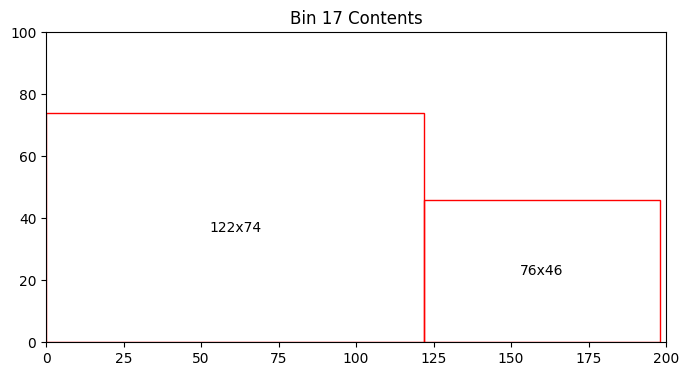

Bin 17 has 7476.00 units of area left


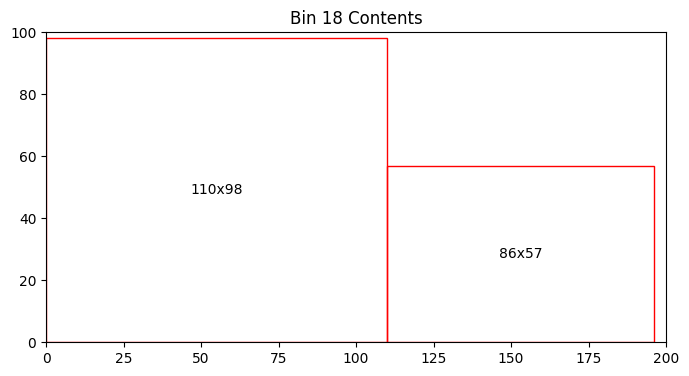

Bin 18 has 4318.00 units of area left


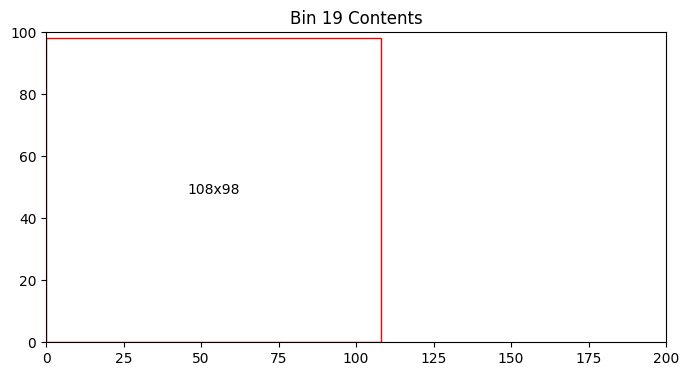

Bin 19 has 9416.00 units of area left


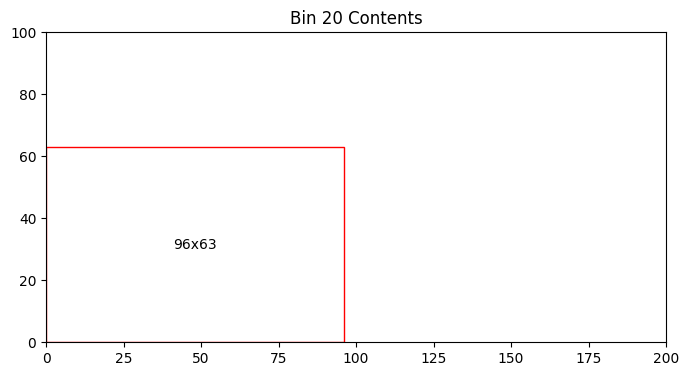

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


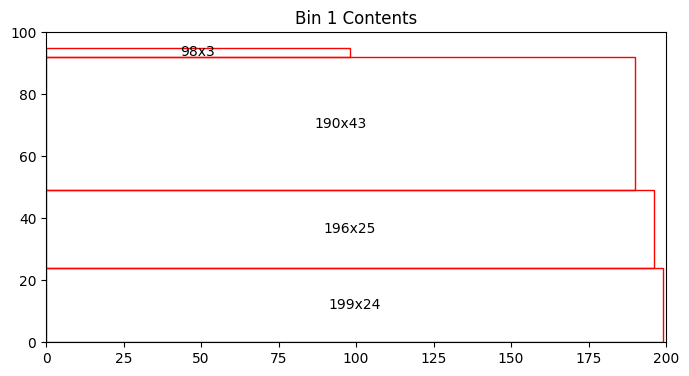

Bin 1 has 1860.00 units of area left


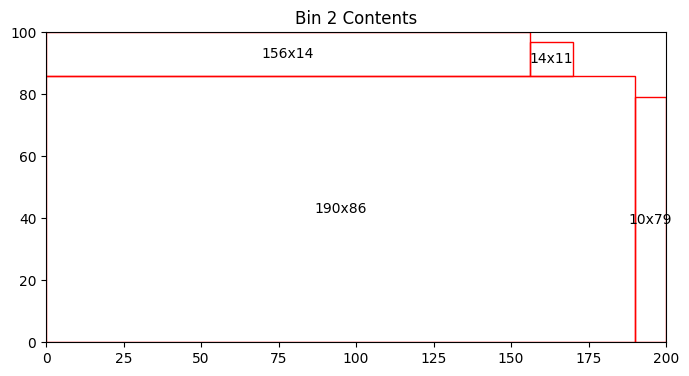

Bin 2 has 532.00 units of area left


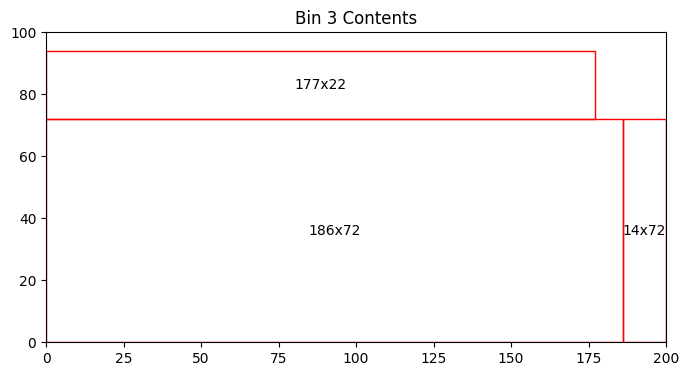

Bin 3 has 1706.00 units of area left


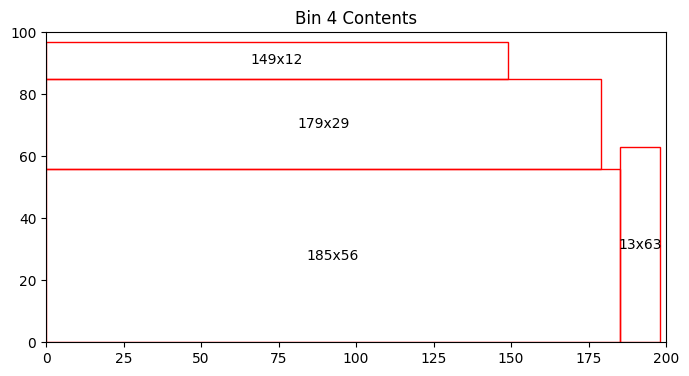

Bin 4 has 1842.00 units of area left


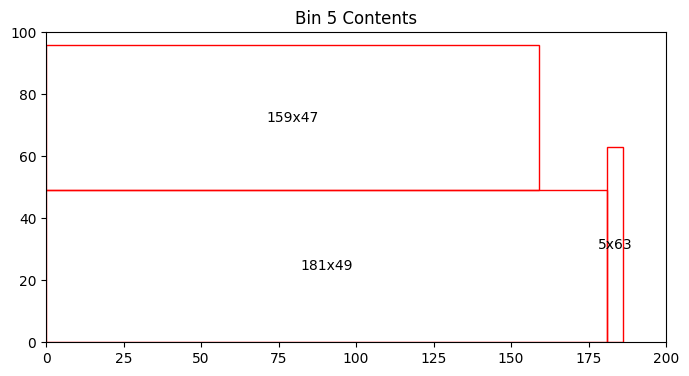

Bin 5 has 3343.00 units of area left


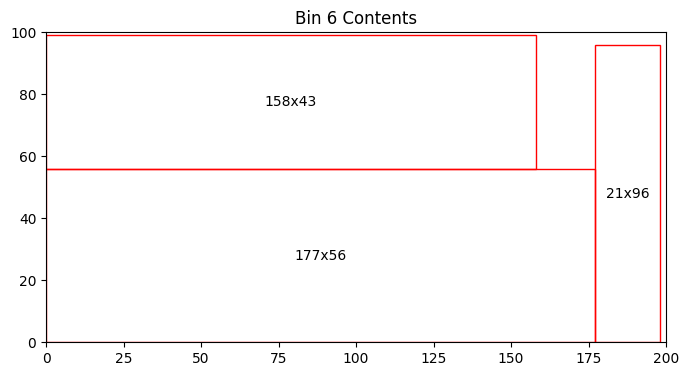

Bin 6 has 1278.00 units of area left


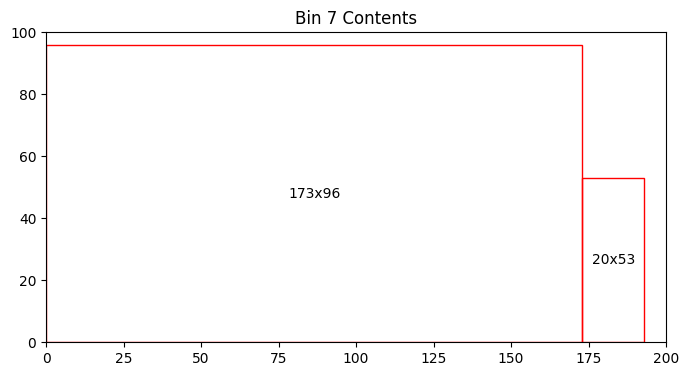

Bin 7 has 2332.00 units of area left


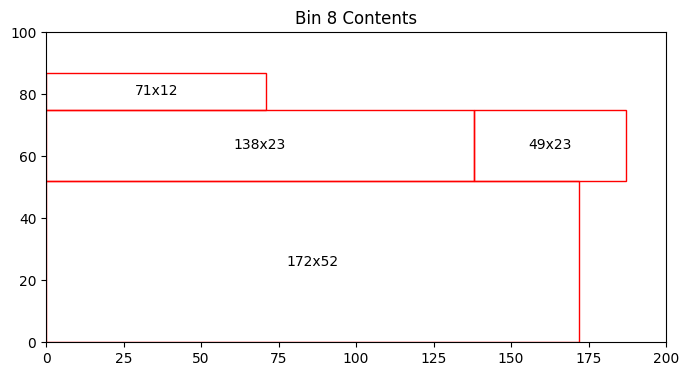

Bin 8 has 5903.00 units of area left


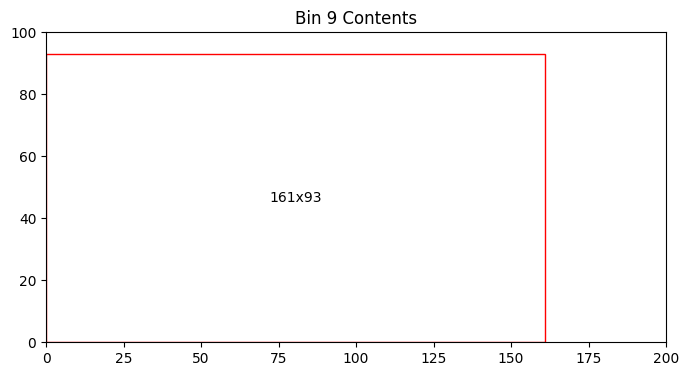

Bin 9 has 5027.00 units of area left


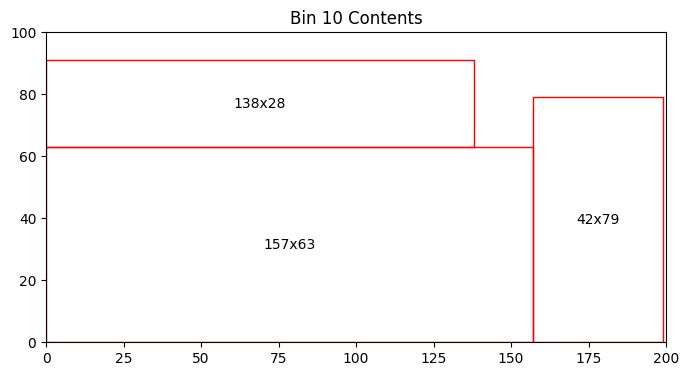

Bin 10 has 2927.00 units of area left


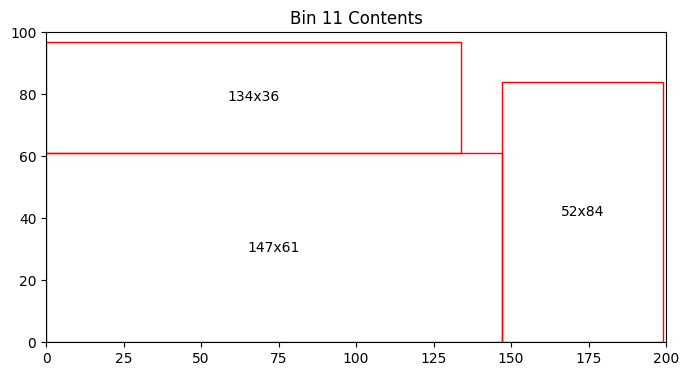

Bin 11 has 1841.00 units of area left


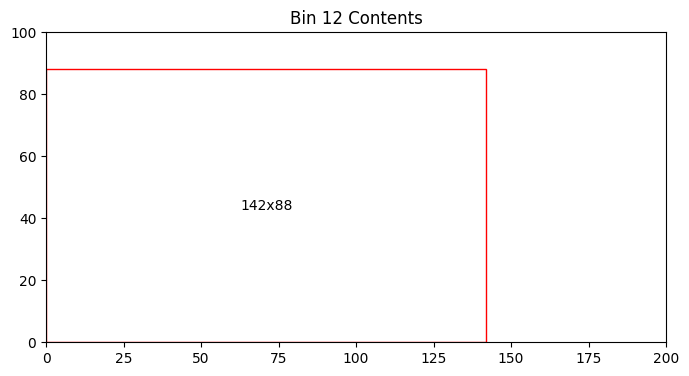

Bin 12 has 7504.00 units of area left


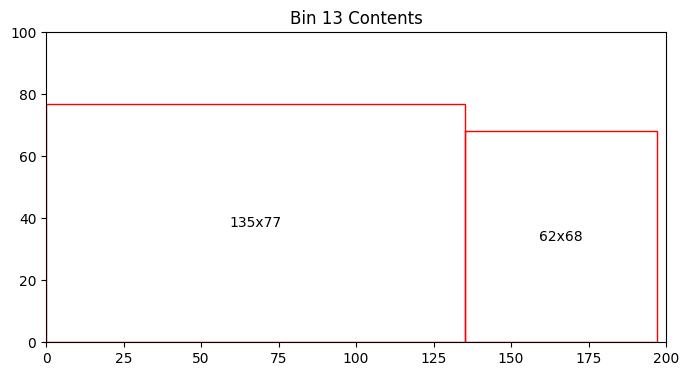

Bin 13 has 5389.00 units of area left


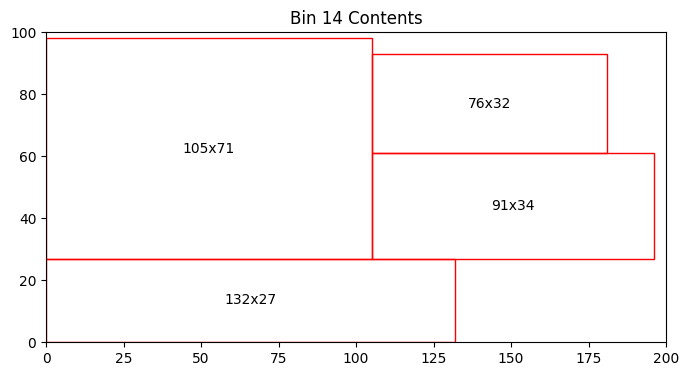

Bin 14 has 3455.00 units of area left


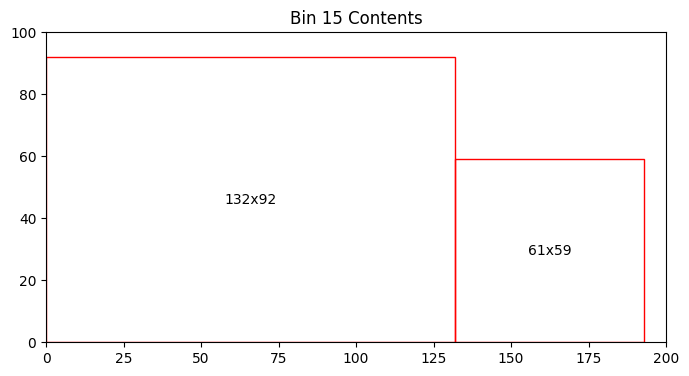

Bin 15 has 4257.00 units of area left


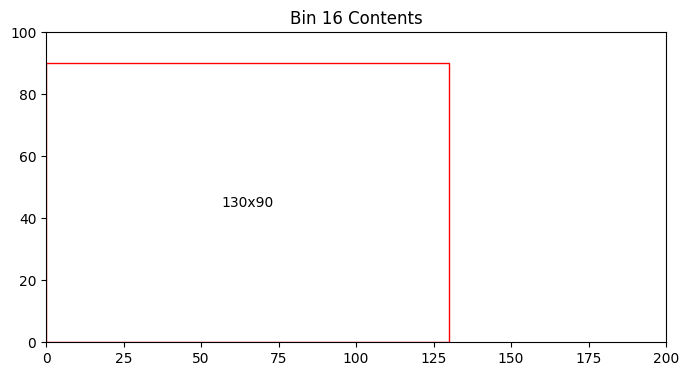

Bin 16 has 8300.00 units of area left


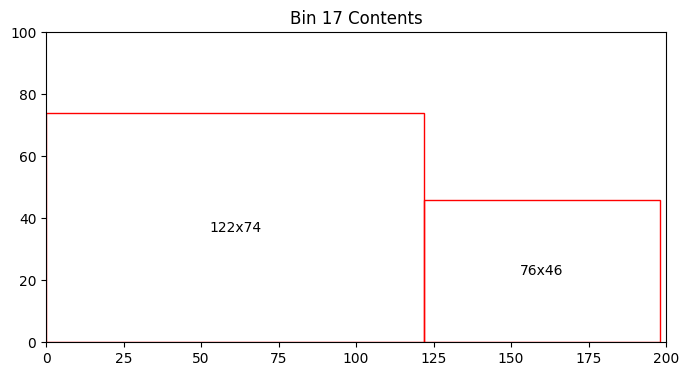

Bin 17 has 7476.00 units of area left


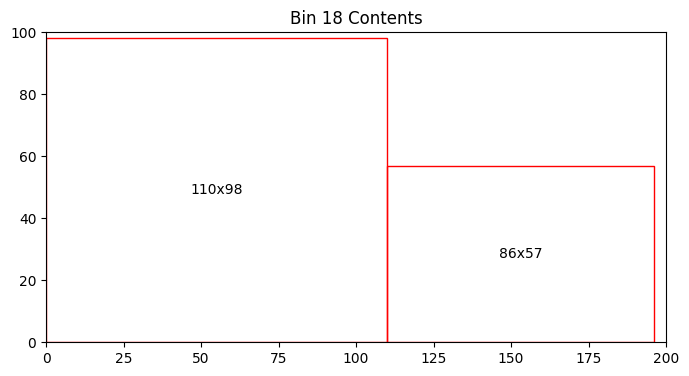

Bin 18 has 4318.00 units of area left


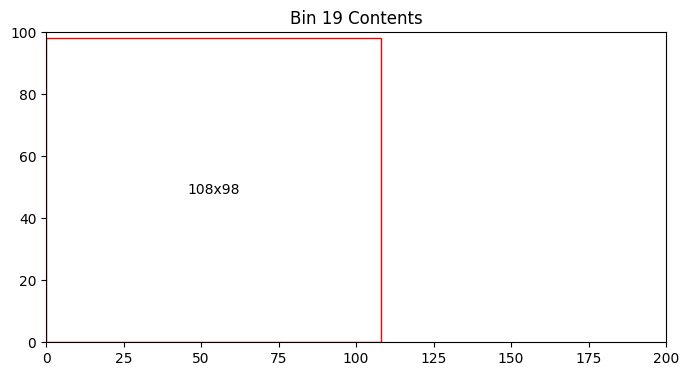

Bin 19 has 9416.00 units of area left


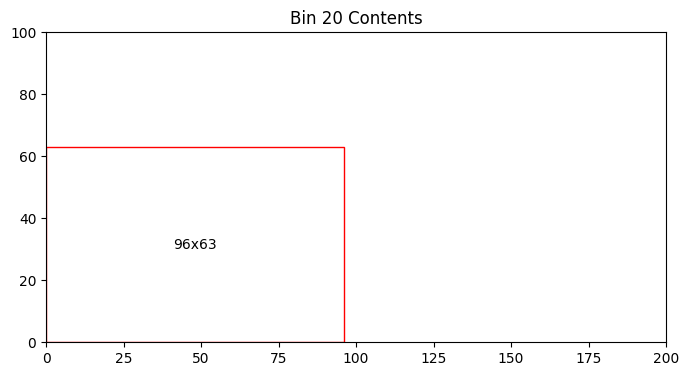

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


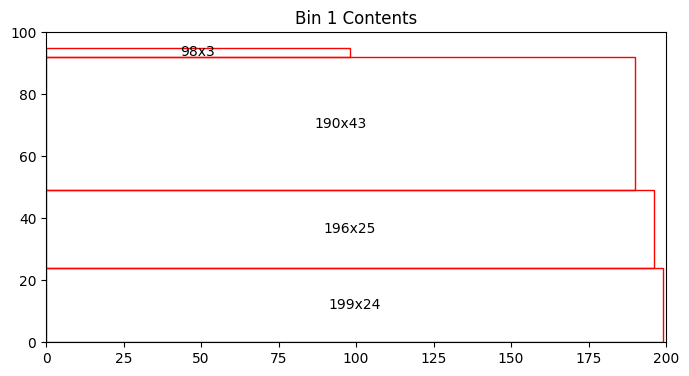

Bin 1 has 1860.00 units of area left


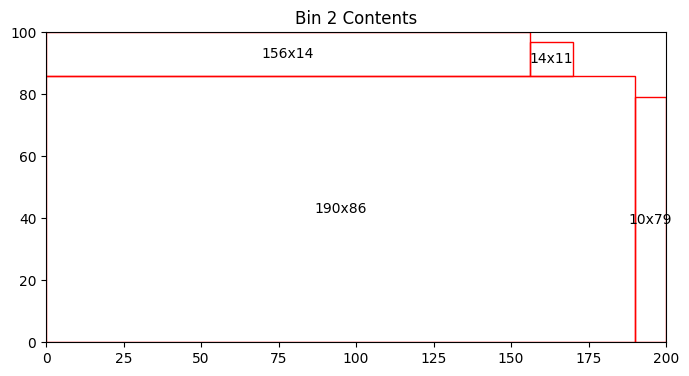

Bin 2 has 532.00 units of area left


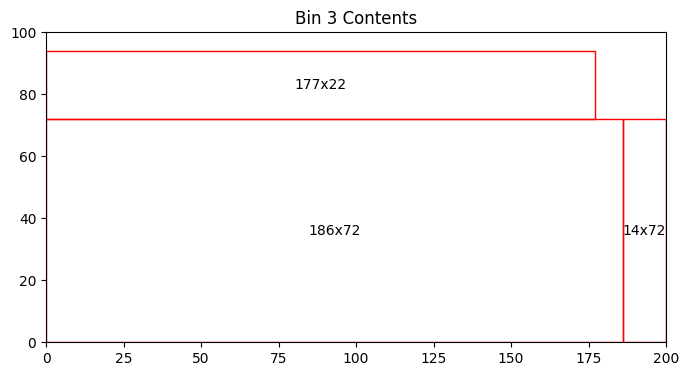

Bin 3 has 1706.00 units of area left


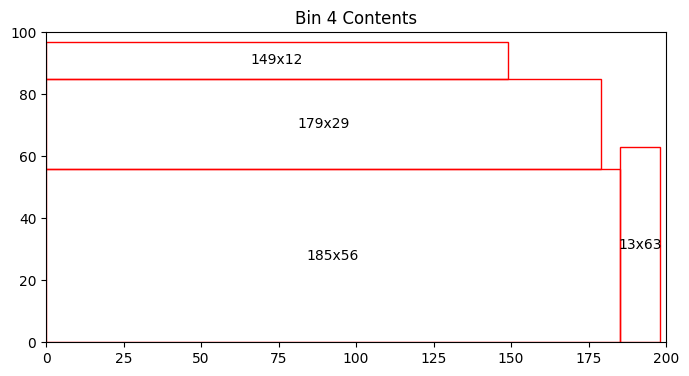

Bin 4 has 1842.00 units of area left


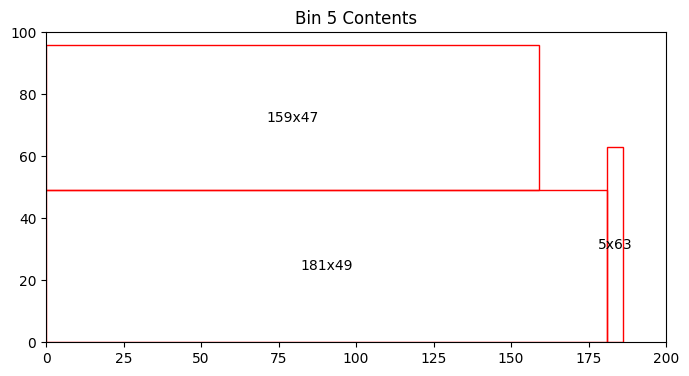

Bin 5 has 3343.00 units of area left


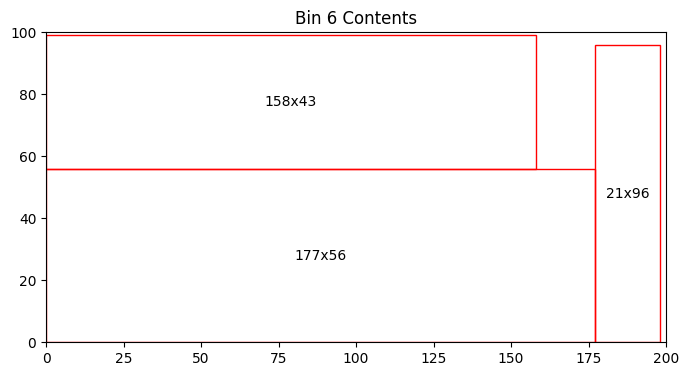

Bin 6 has 1278.00 units of area left


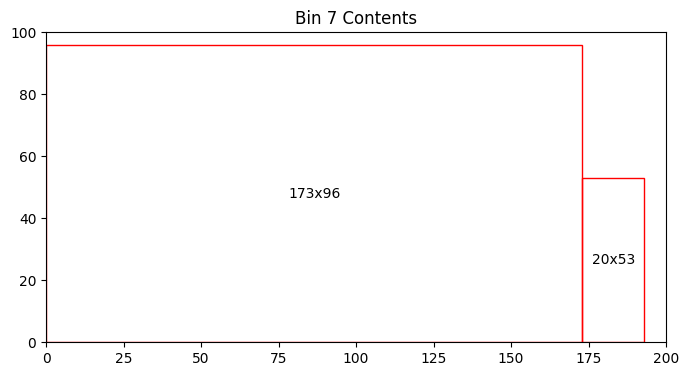

Bin 7 has 2332.00 units of area left


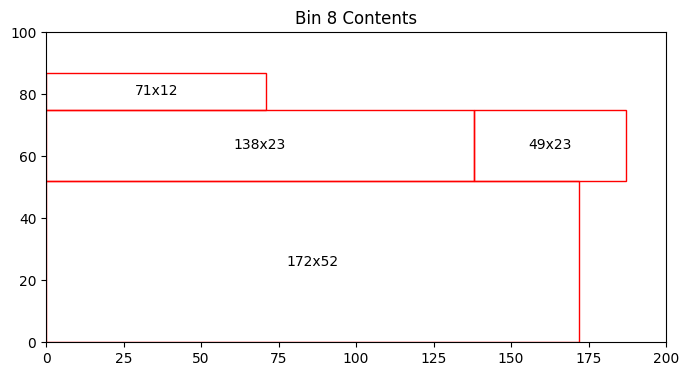

Bin 8 has 5903.00 units of area left


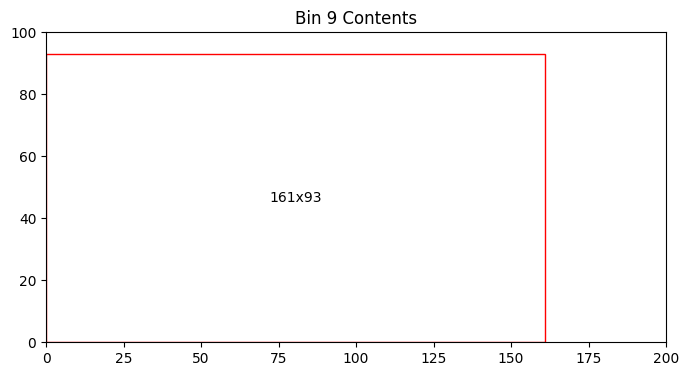

Bin 9 has 5027.00 units of area left


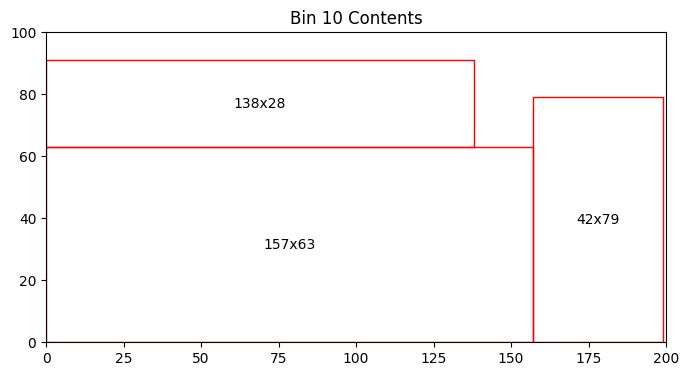

Bin 10 has 2927.00 units of area left


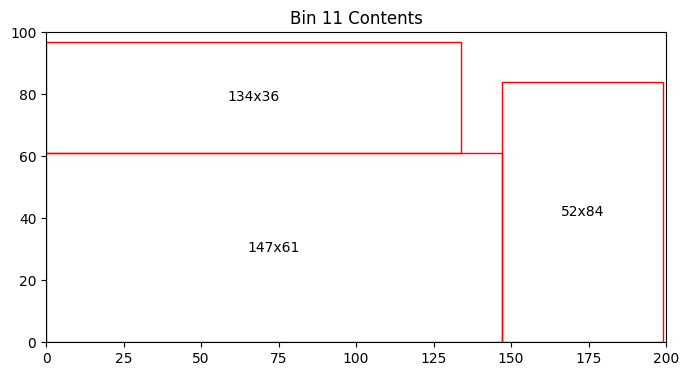

Bin 11 has 1841.00 units of area left


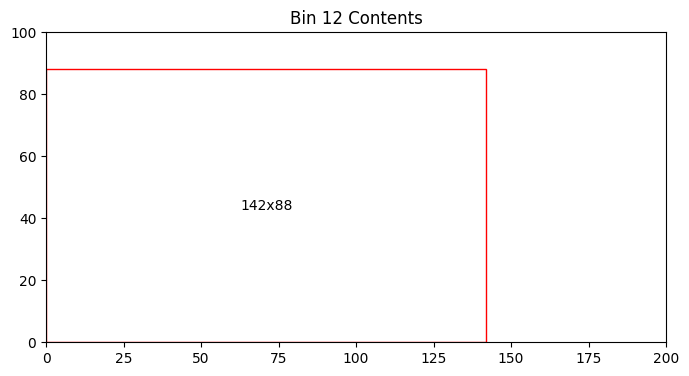

Bin 12 has 7504.00 units of area left


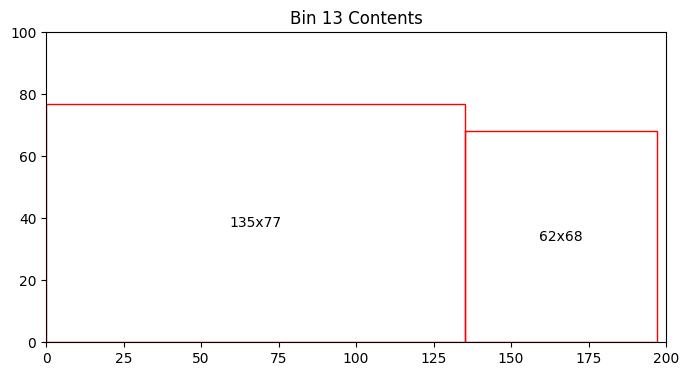

Bin 13 has 5389.00 units of area left


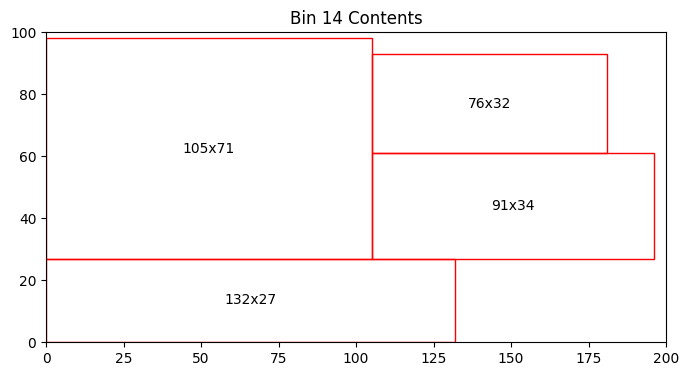

Bin 14 has 3455.00 units of area left


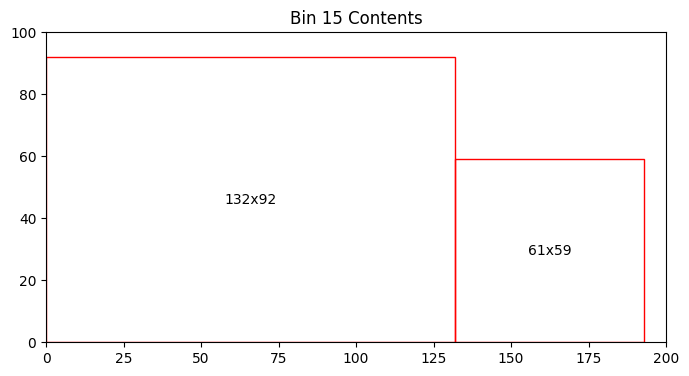

Bin 15 has 4257.00 units of area left


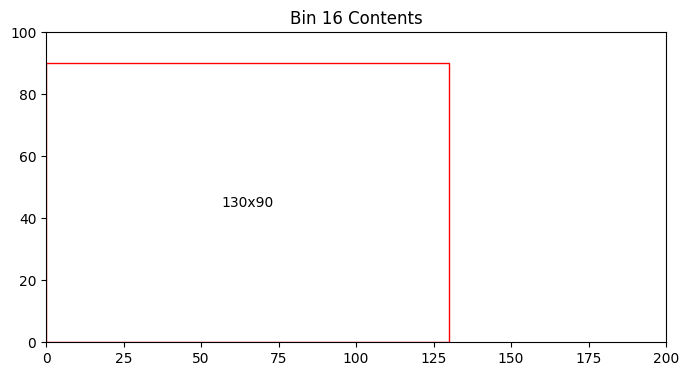

Bin 16 has 8300.00 units of area left


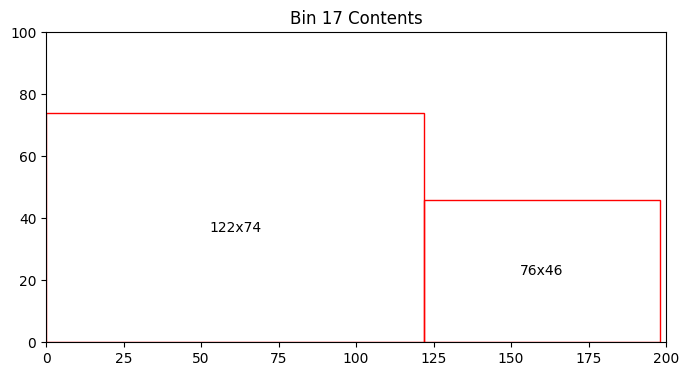

Bin 17 has 7476.00 units of area left


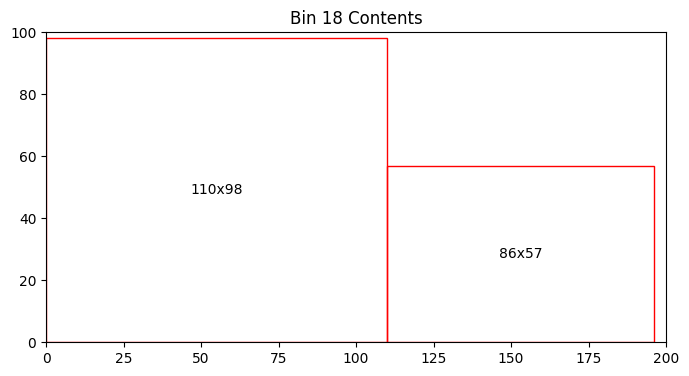

Bin 18 has 4318.00 units of area left


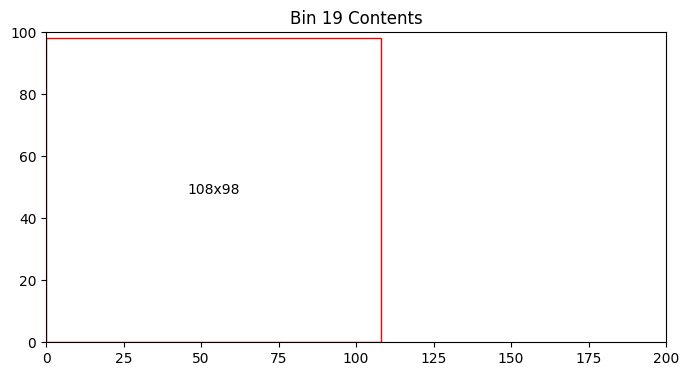

Bin 19 has 9416.00 units of area left


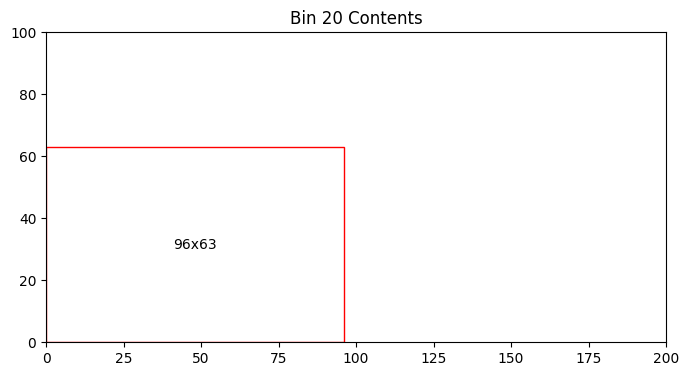

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


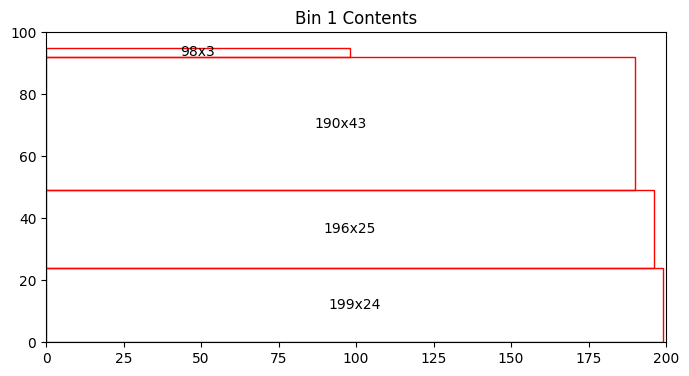

Bin 1 has 1860.00 units of area left


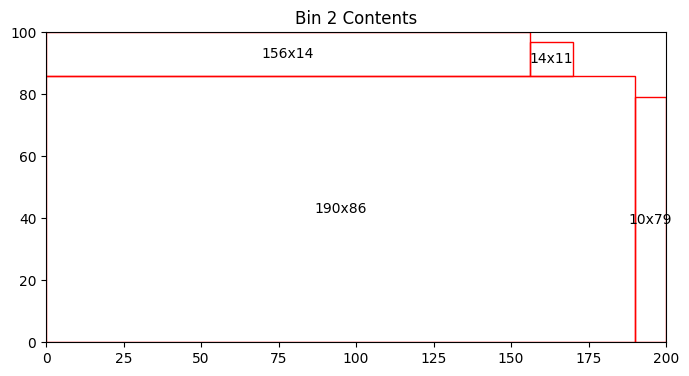

Bin 2 has 532.00 units of area left


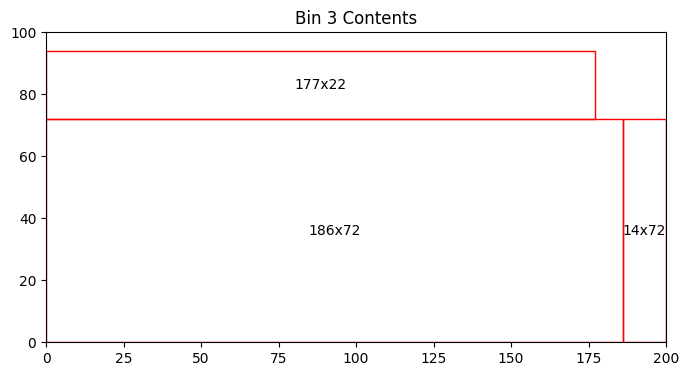

Bin 3 has 1706.00 units of area left


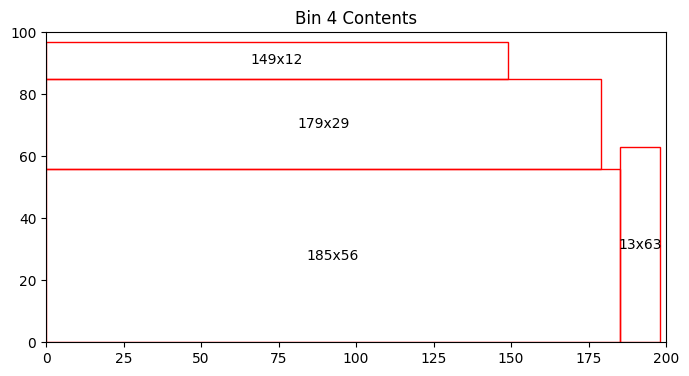

Bin 4 has 1842.00 units of area left


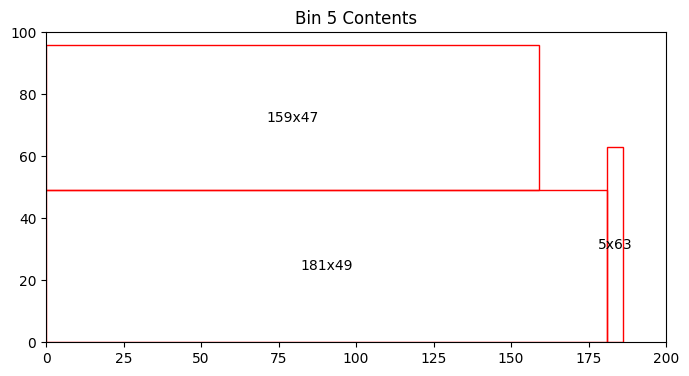

Bin 5 has 3343.00 units of area left


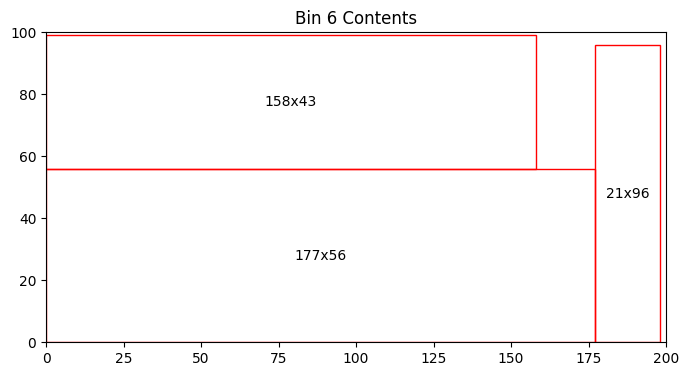

Bin 6 has 1278.00 units of area left


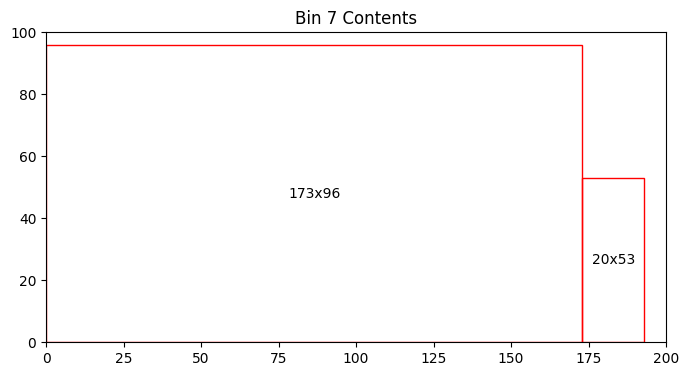

Bin 7 has 2332.00 units of area left


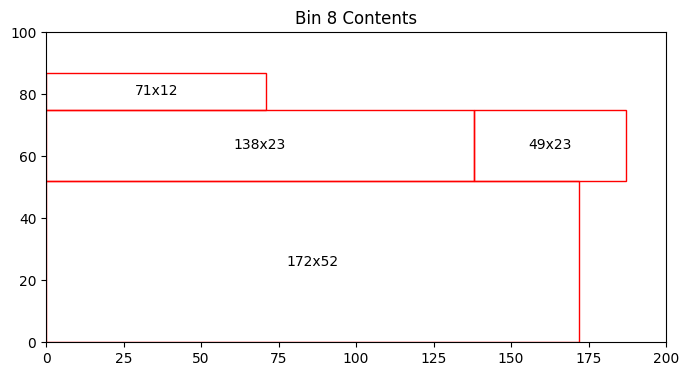

Bin 8 has 5903.00 units of area left


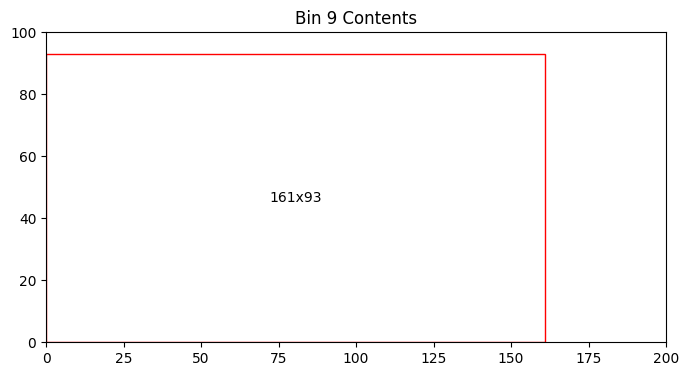

Bin 9 has 5027.00 units of area left


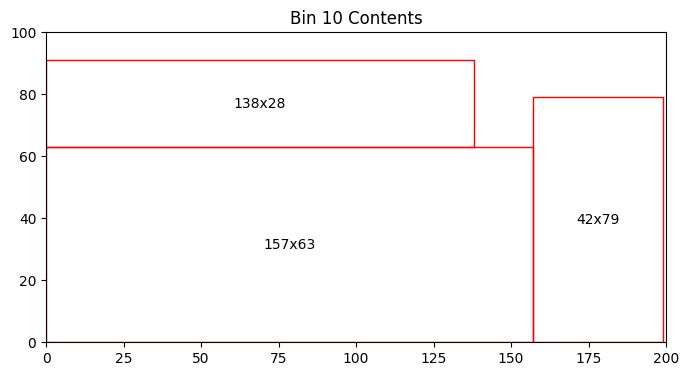

Bin 10 has 2927.00 units of area left


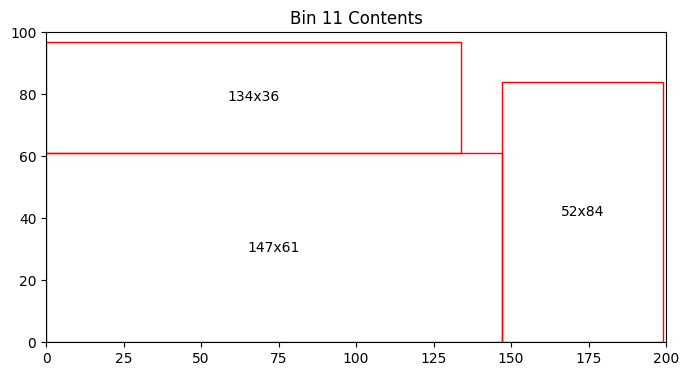

Bin 11 has 1841.00 units of area left


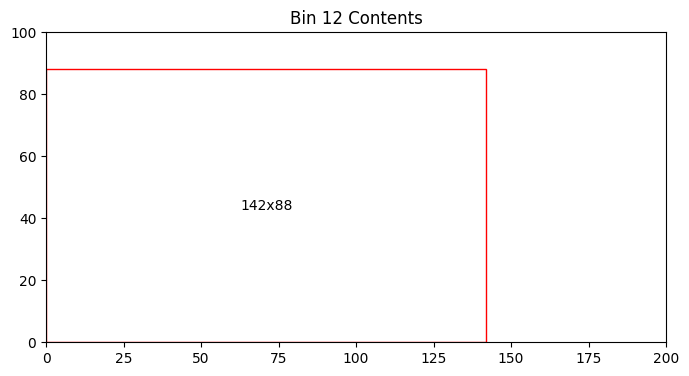

Bin 12 has 7504.00 units of area left


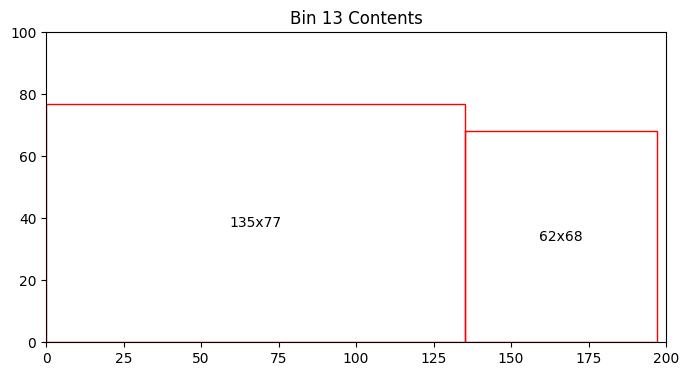

Bin 13 has 5389.00 units of area left


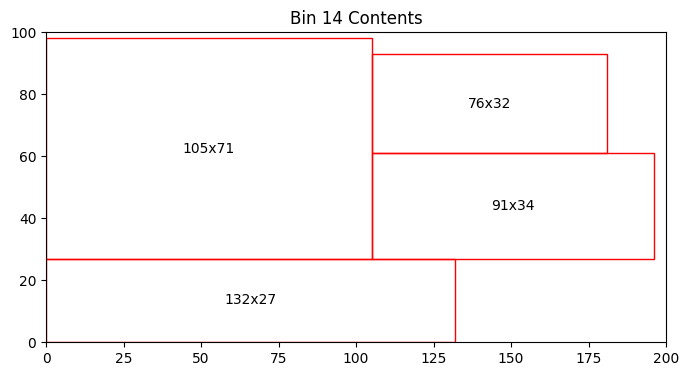

Bin 14 has 3455.00 units of area left


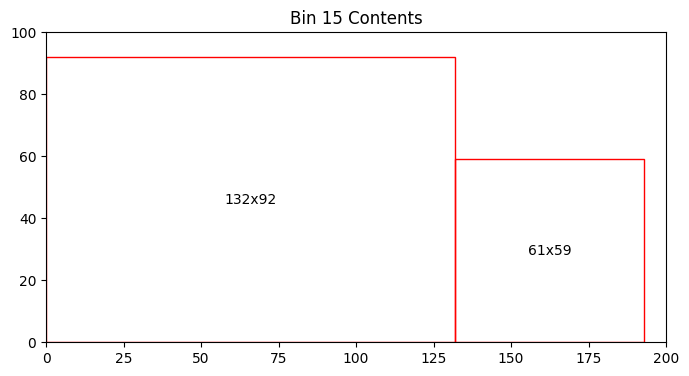

Bin 15 has 4257.00 units of area left


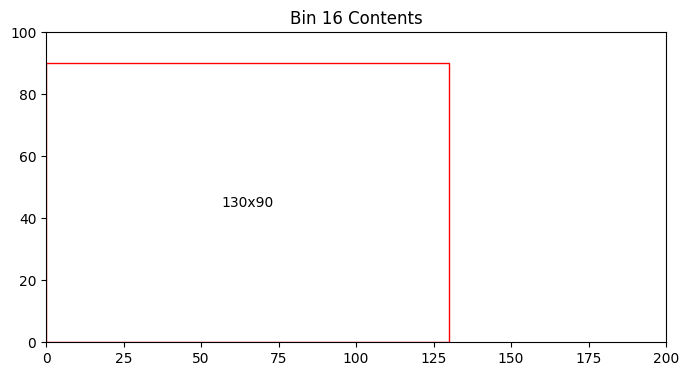

Bin 16 has 8300.00 units of area left


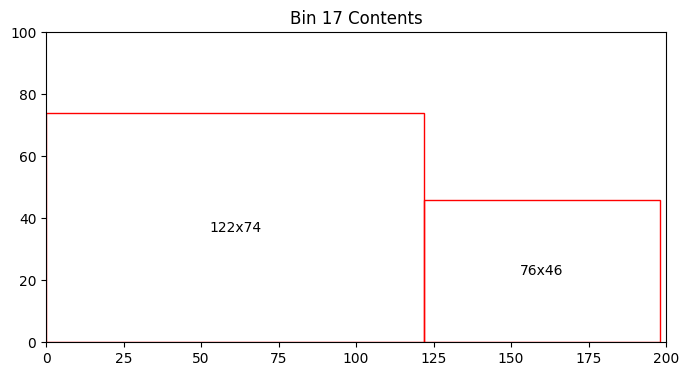

Bin 17 has 7476.00 units of area left


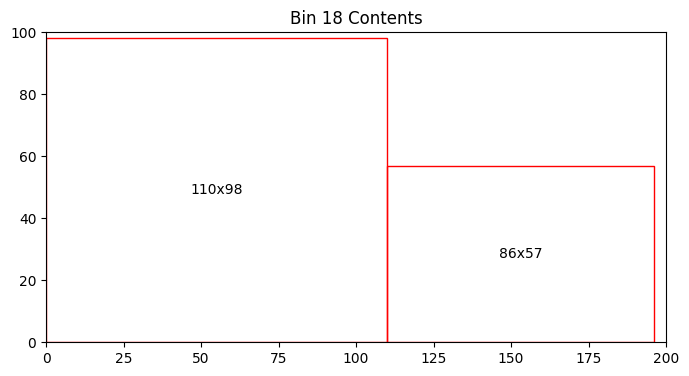

Bin 18 has 4318.00 units of area left


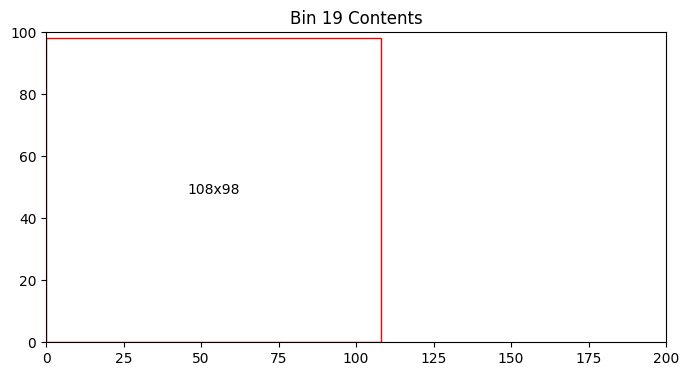

Bin 19 has 9416.00 units of area left


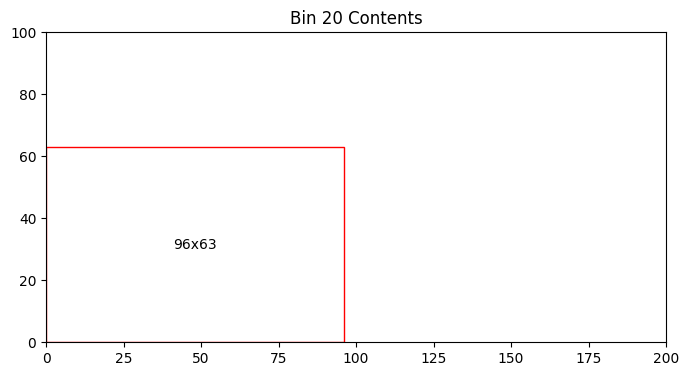

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


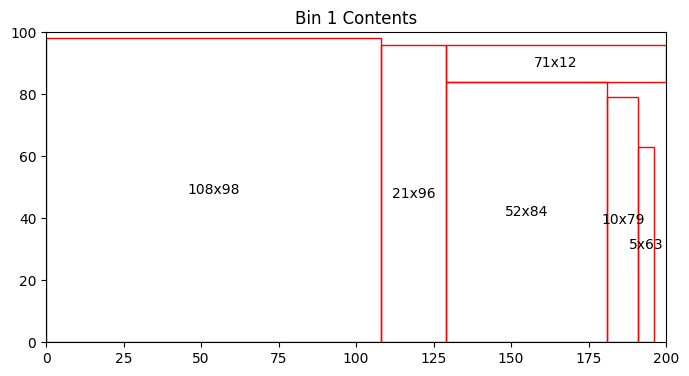

Bin 1 has 1075.00 units of area left


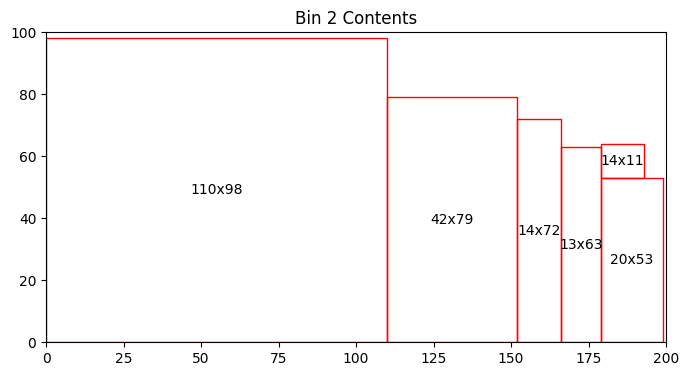

Bin 2 has 2861.00 units of area left


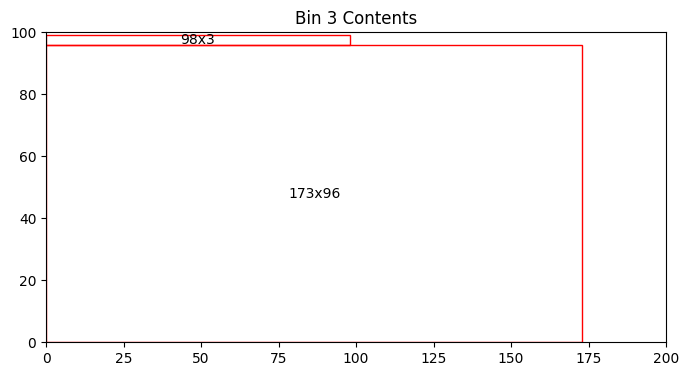

Bin 3 has 3098.00 units of area left


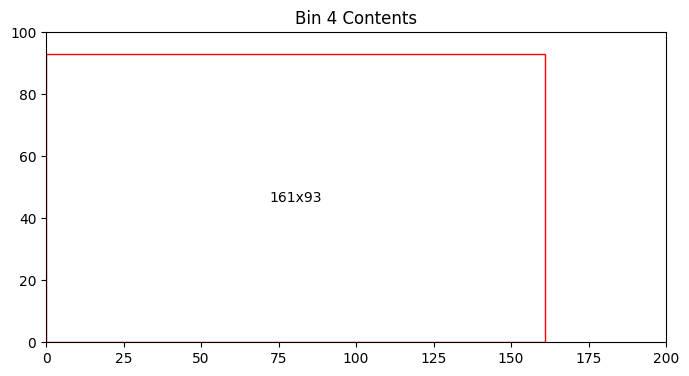

Bin 4 has 5027.00 units of area left


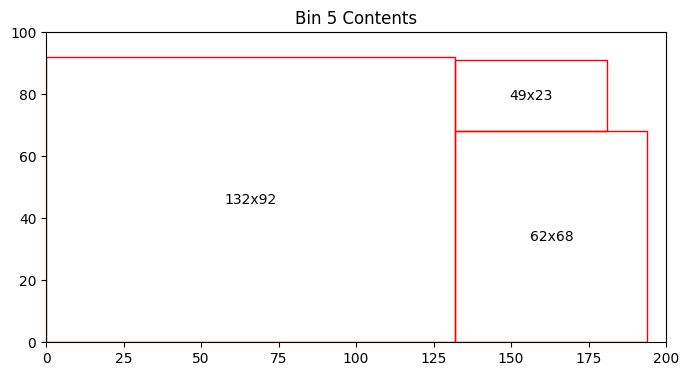

Bin 5 has 2513.00 units of area left


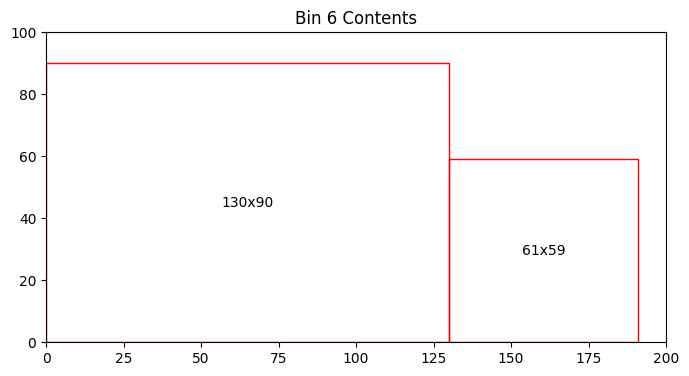

Bin 6 has 4701.00 units of area left


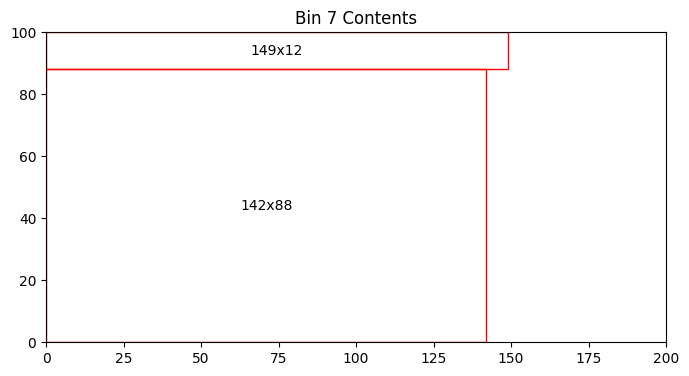

Bin 7 has 5716.00 units of area left


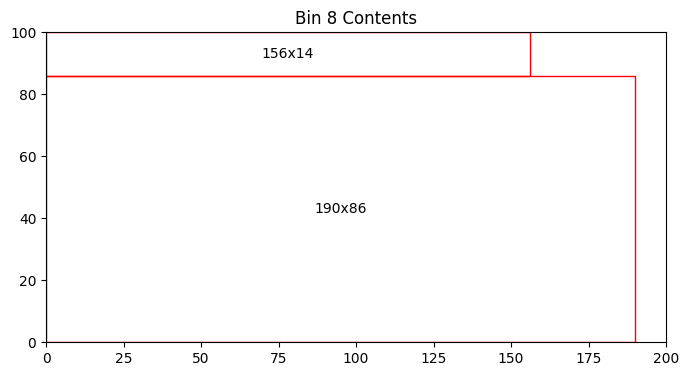

Bin 8 has 1476.00 units of area left


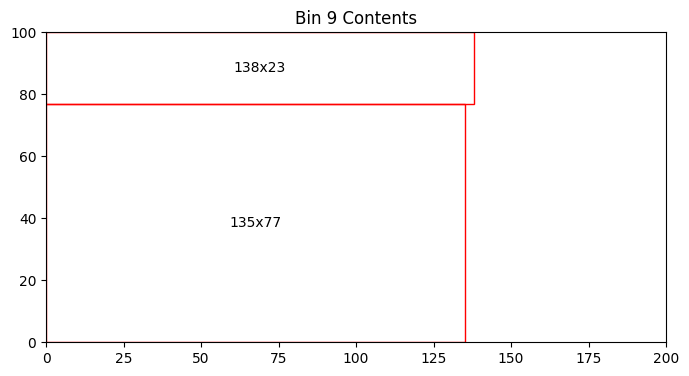

Bin 9 has 6431.00 units of area left


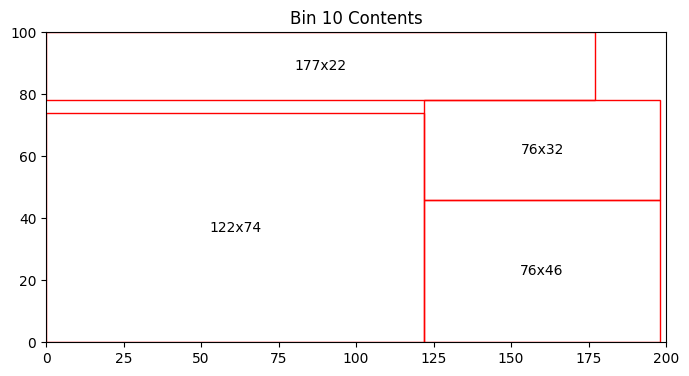

Bin 10 has 1150.00 units of area left


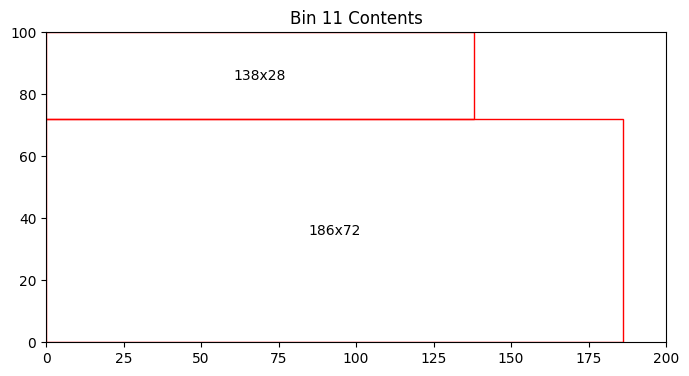

Bin 11 has 2744.00 units of area left


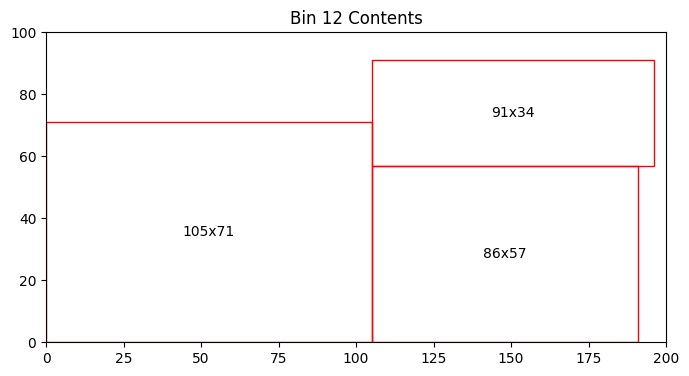

Bin 12 has 4549.00 units of area left


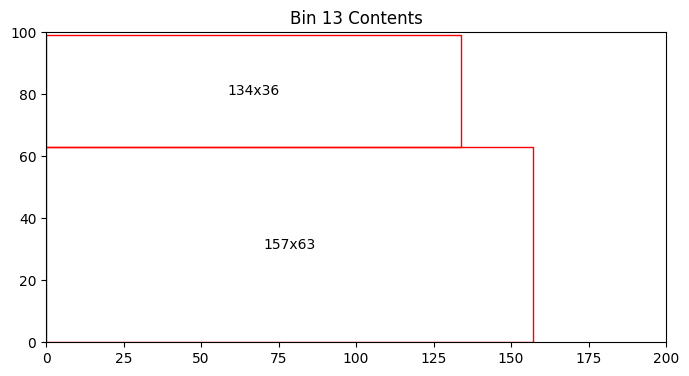

Bin 13 has 5285.00 units of area left


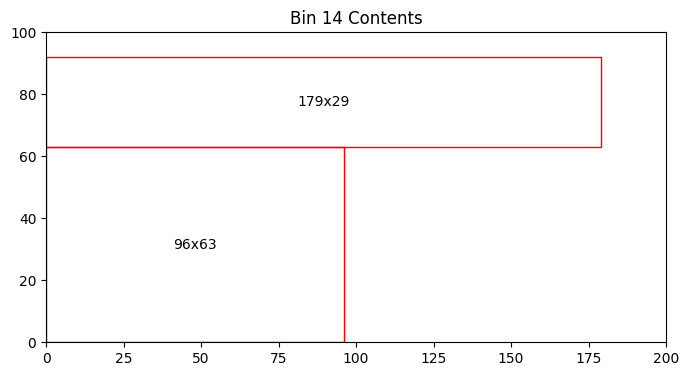

Bin 14 has 8761.00 units of area left


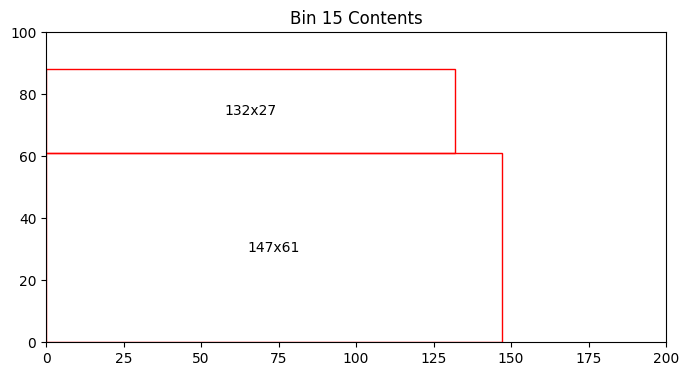

Bin 15 has 7469.00 units of area left


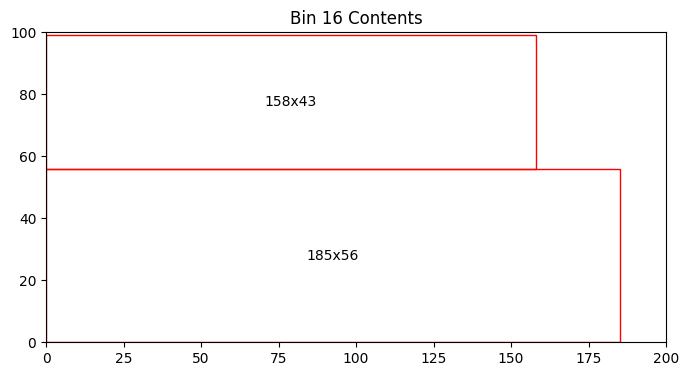

Bin 16 has 2846.00 units of area left


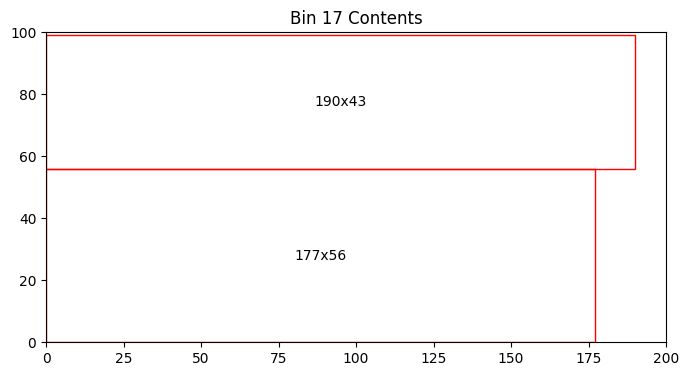

Bin 17 has 1918.00 units of area left


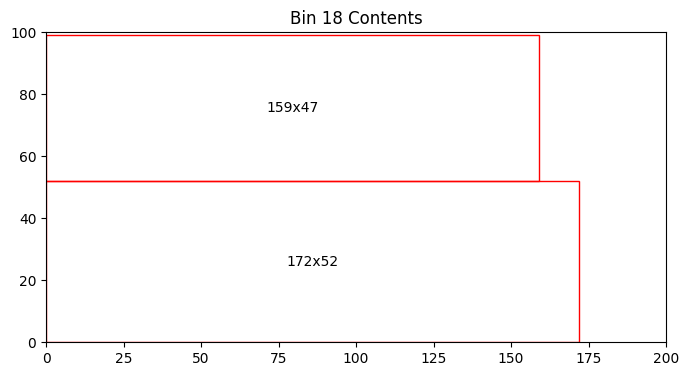

Bin 18 has 3583.00 units of area left


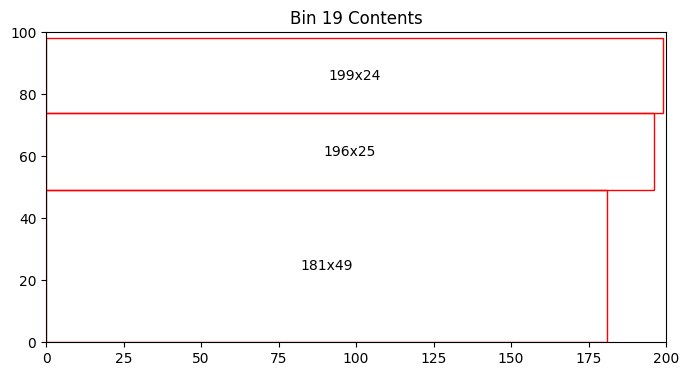

Bin 19 has 1455.00 units of area left
Total number of bins = 19
Total area left in bins = 72658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


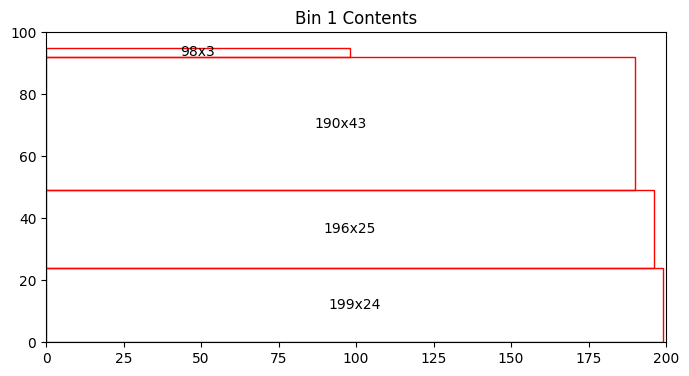

Bin 1 has 1860.00 units of area left


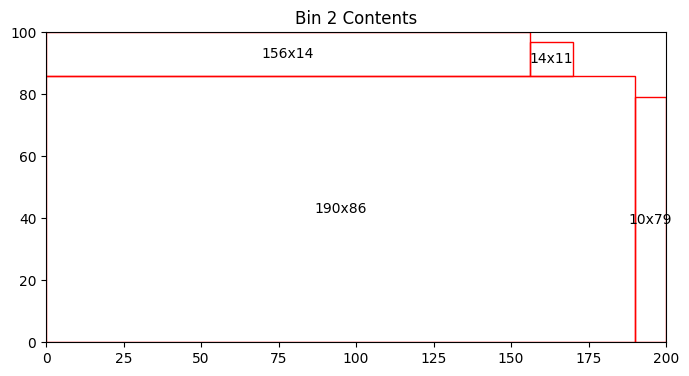

Bin 2 has 532.00 units of area left


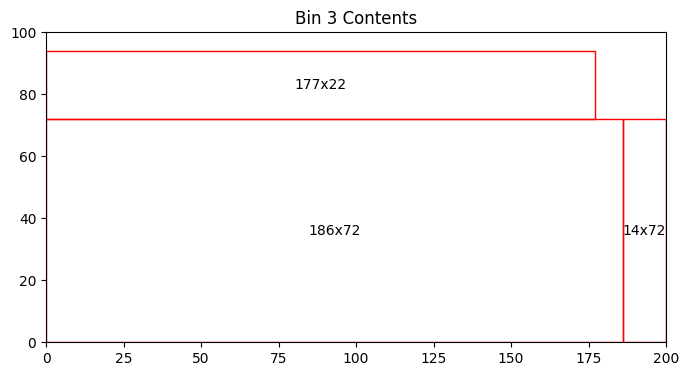

Bin 3 has 1706.00 units of area left


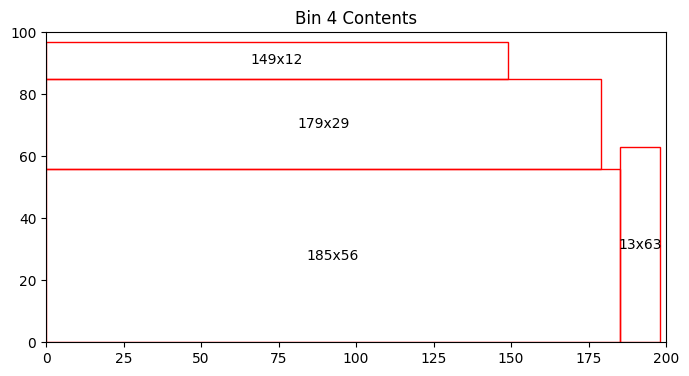

Bin 4 has 1842.00 units of area left


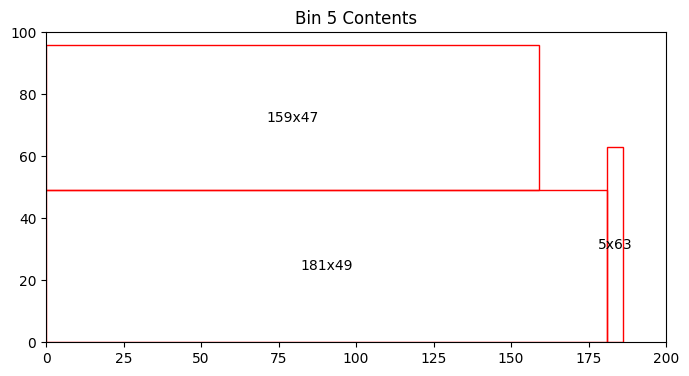

Bin 5 has 3343.00 units of area left


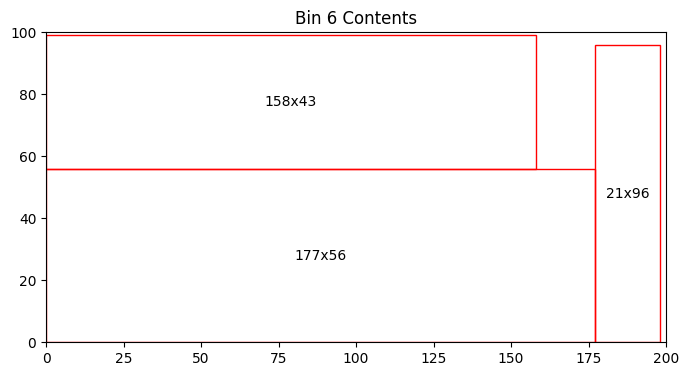

Bin 6 has 1278.00 units of area left


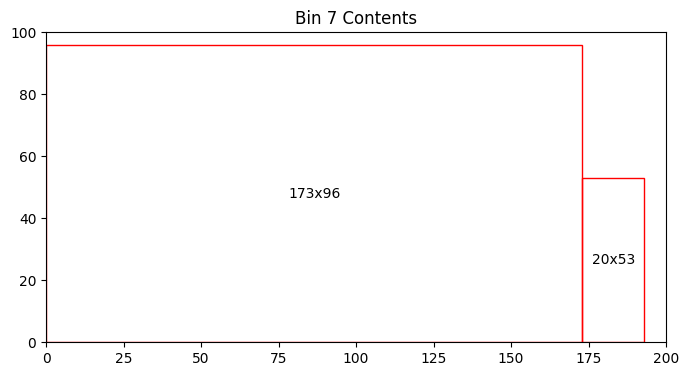

Bin 7 has 2332.00 units of area left


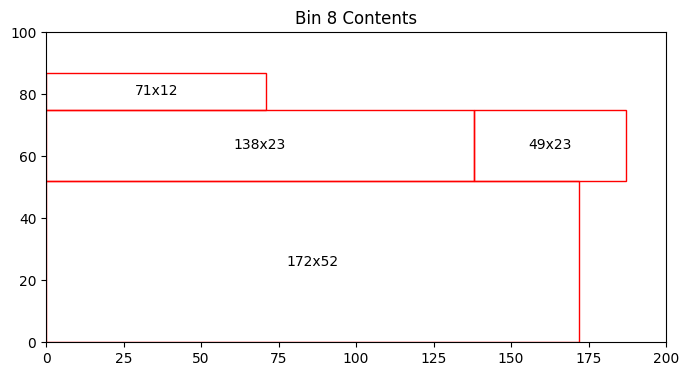

Bin 8 has 5903.00 units of area left


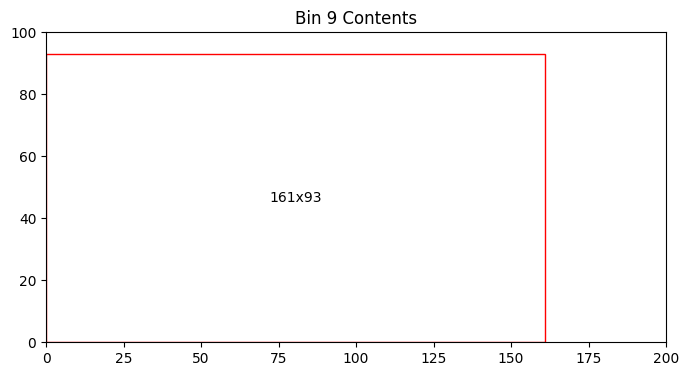

Bin 9 has 5027.00 units of area left


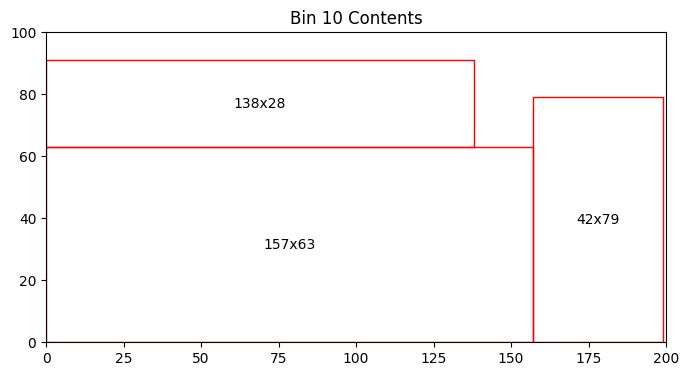

Bin 10 has 2927.00 units of area left


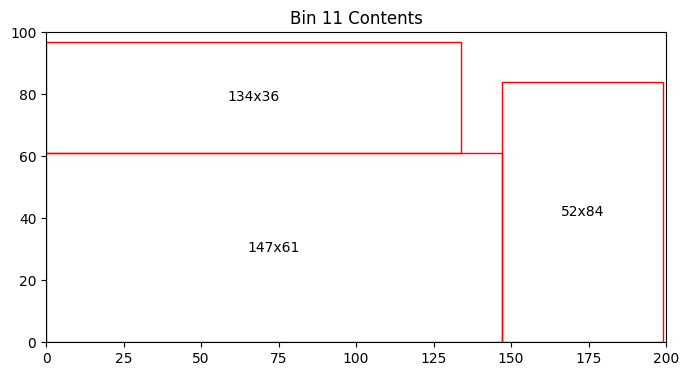

Bin 11 has 1841.00 units of area left


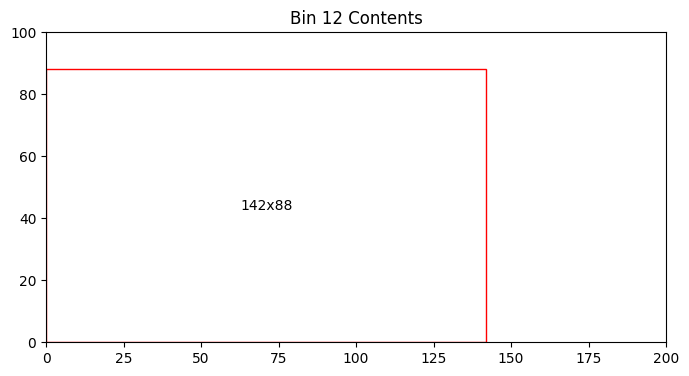

Bin 12 has 7504.00 units of area left


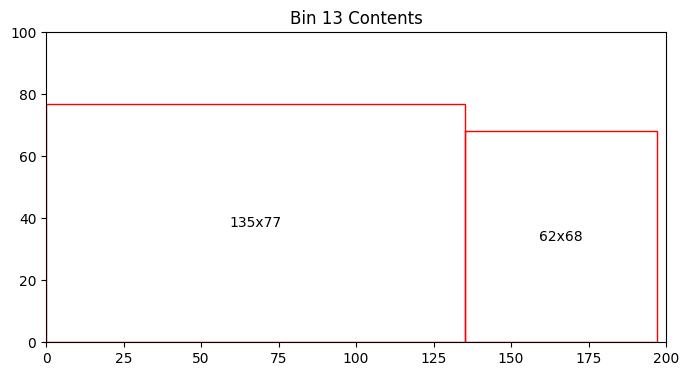

Bin 13 has 5389.00 units of area left


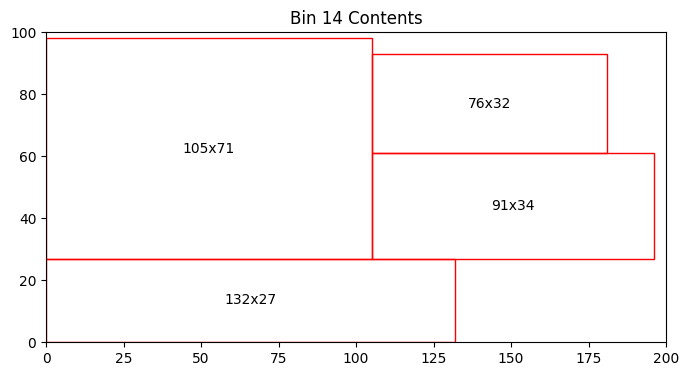

Bin 14 has 3455.00 units of area left


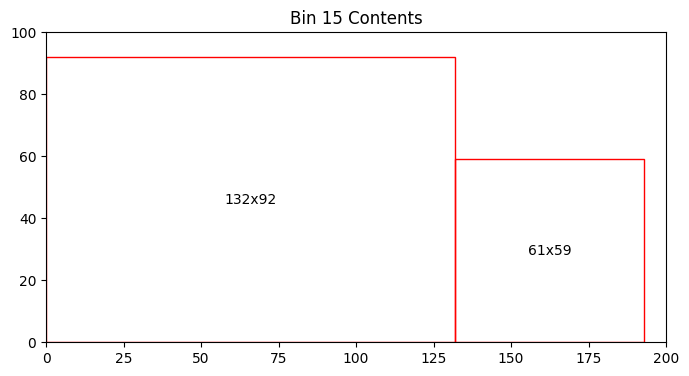

Bin 15 has 4257.00 units of area left


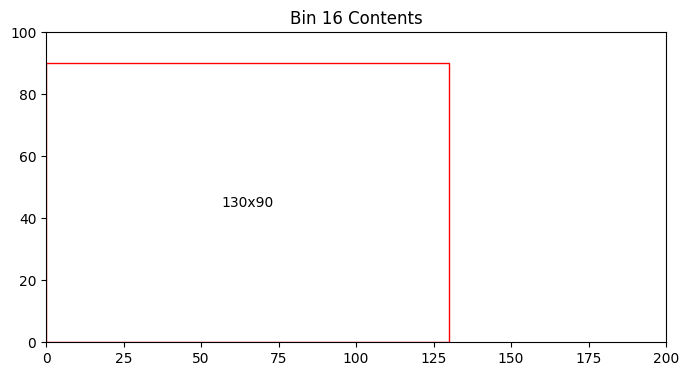

Bin 16 has 8300.00 units of area left


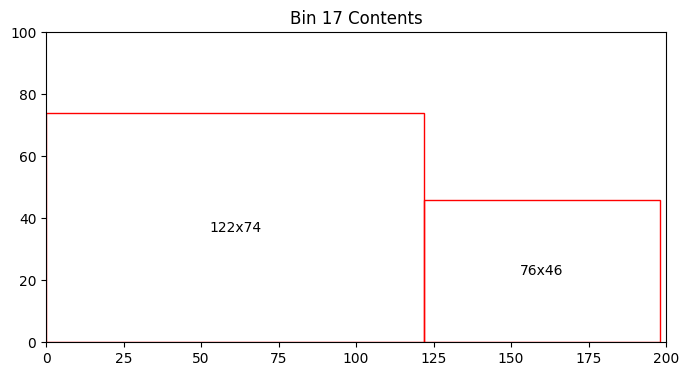

Bin 17 has 7476.00 units of area left


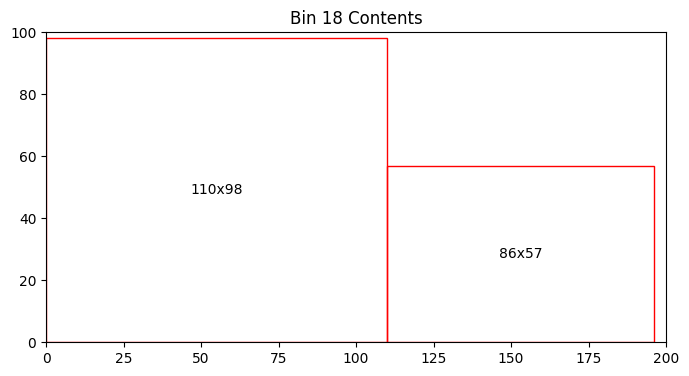

Bin 18 has 4318.00 units of area left


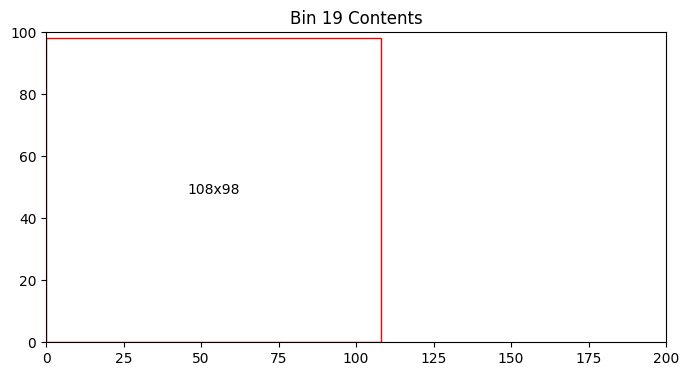

Bin 19 has 9416.00 units of area left


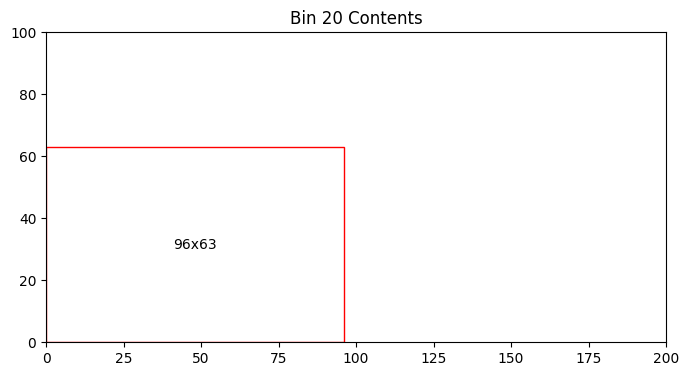

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


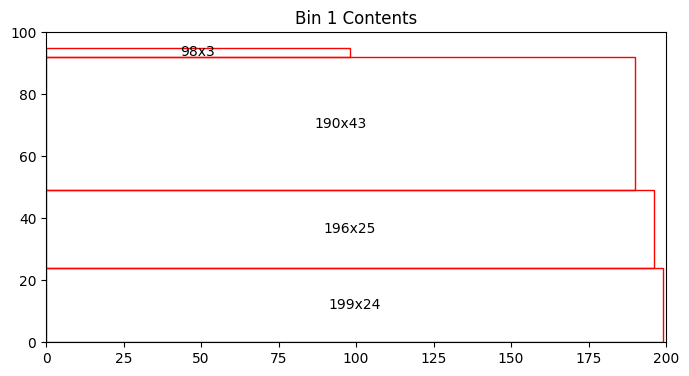

Bin 1 has 1860.00 units of area left


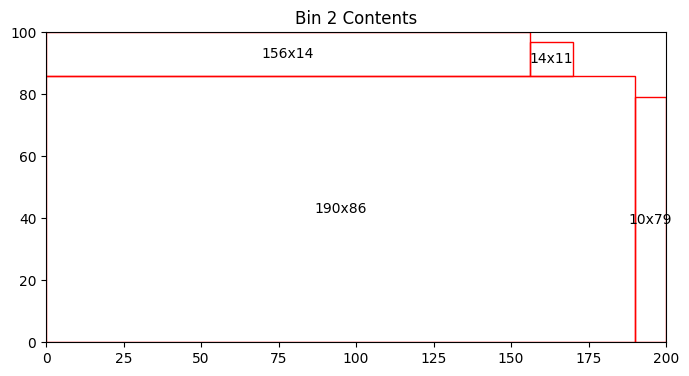

Bin 2 has 532.00 units of area left


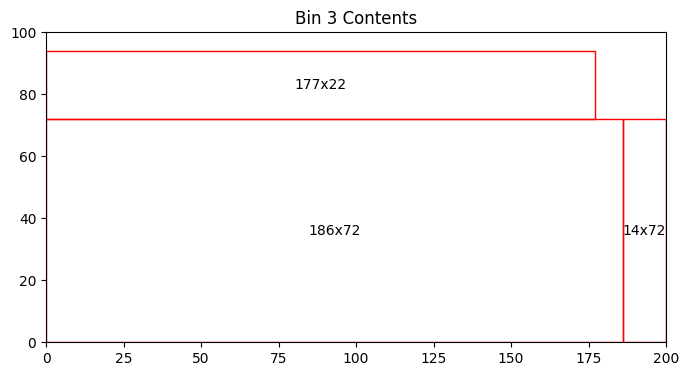

Bin 3 has 1706.00 units of area left


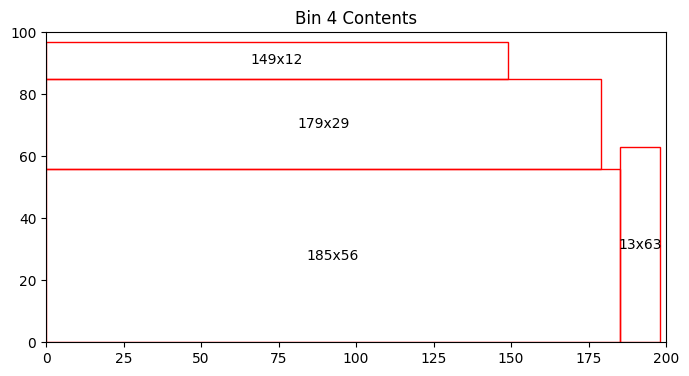

Bin 4 has 1842.00 units of area left


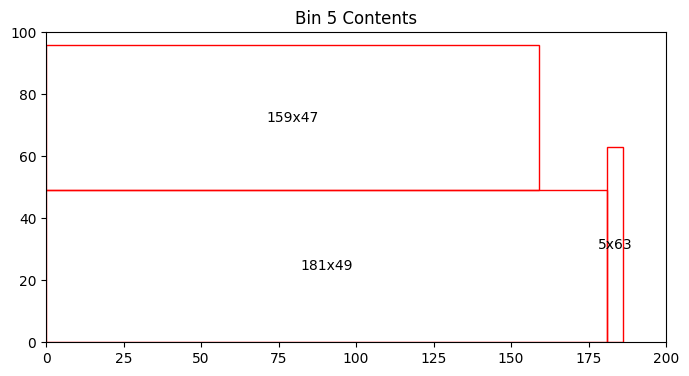

Bin 5 has 3343.00 units of area left


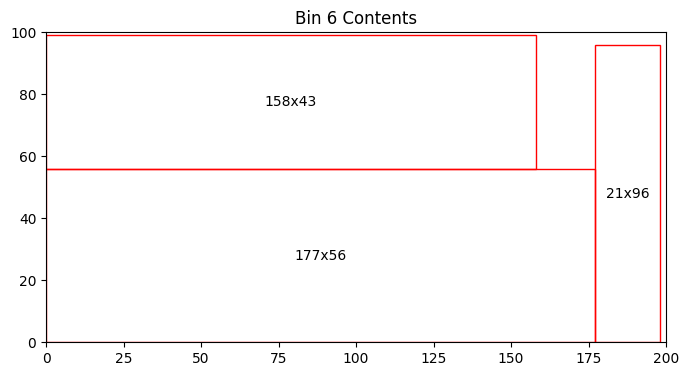

Bin 6 has 1278.00 units of area left


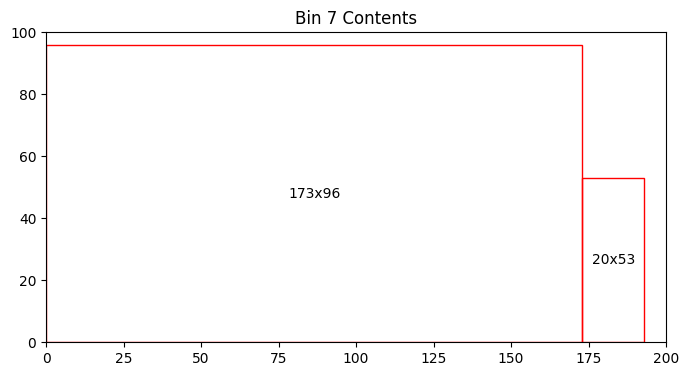

Bin 7 has 2332.00 units of area left


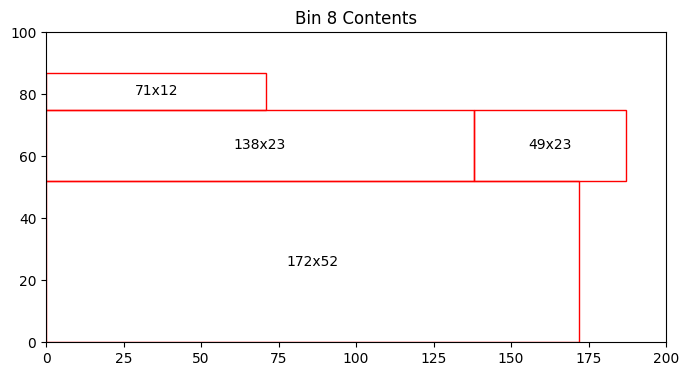

Bin 8 has 5903.00 units of area left


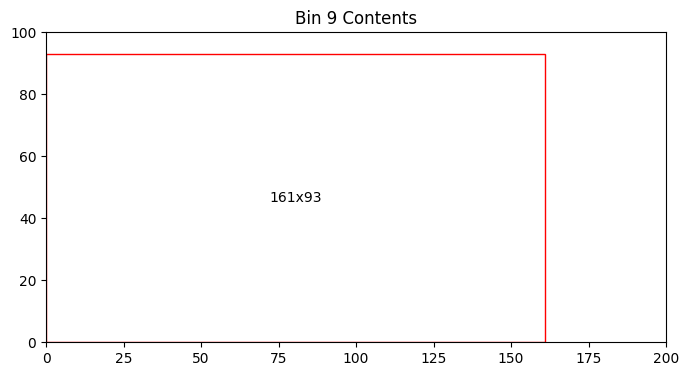

Bin 9 has 5027.00 units of area left


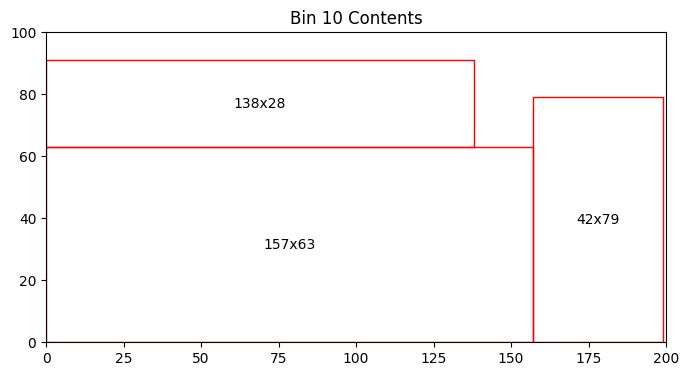

Bin 10 has 2927.00 units of area left


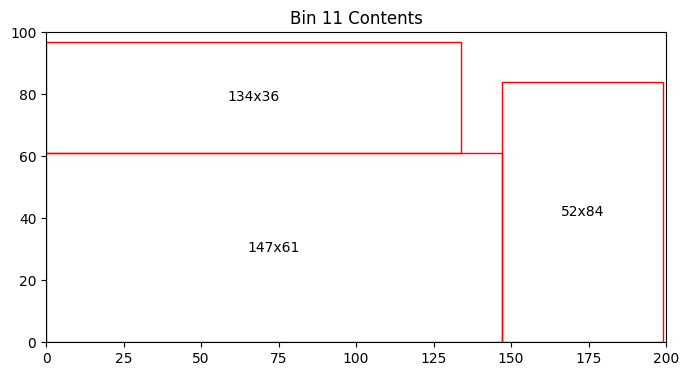

Bin 11 has 1841.00 units of area left


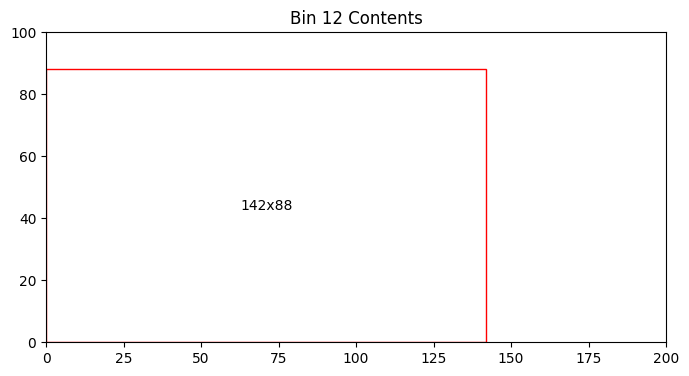

Bin 12 has 7504.00 units of area left


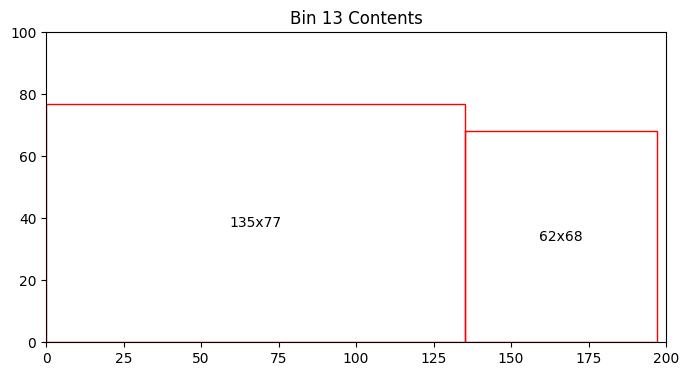

Bin 13 has 5389.00 units of area left


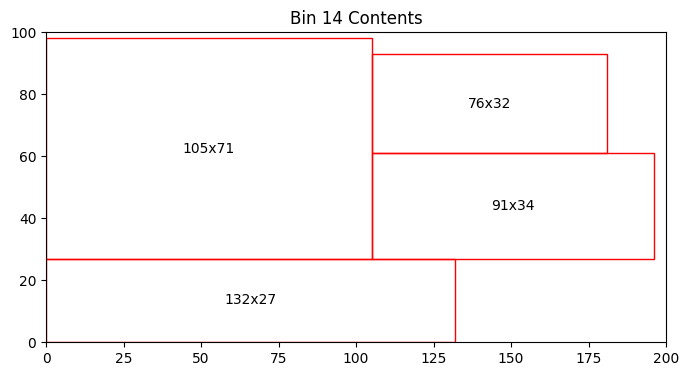

Bin 14 has 3455.00 units of area left


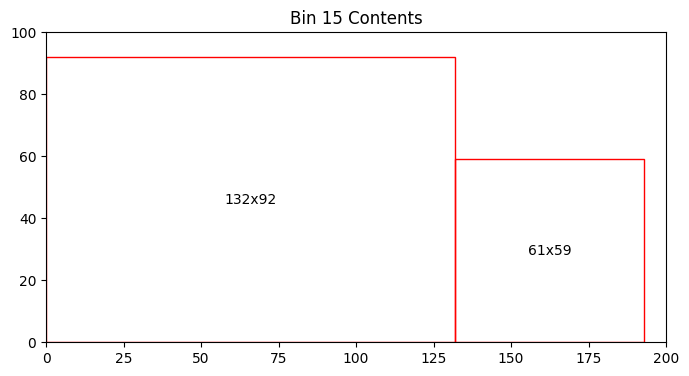

Bin 15 has 4257.00 units of area left


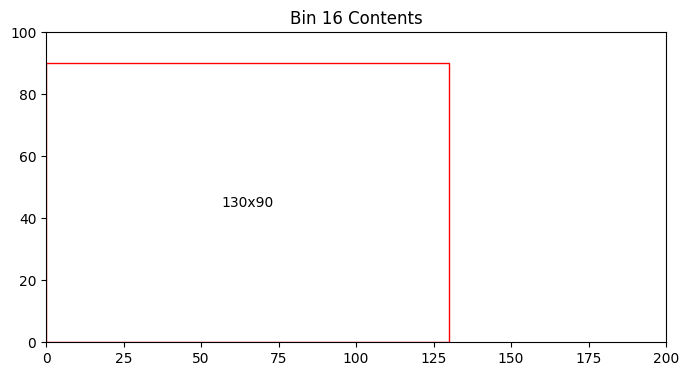

Bin 16 has 8300.00 units of area left


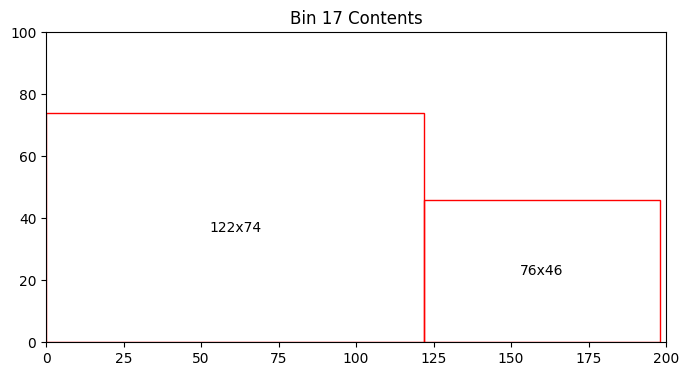

Bin 17 has 7476.00 units of area left


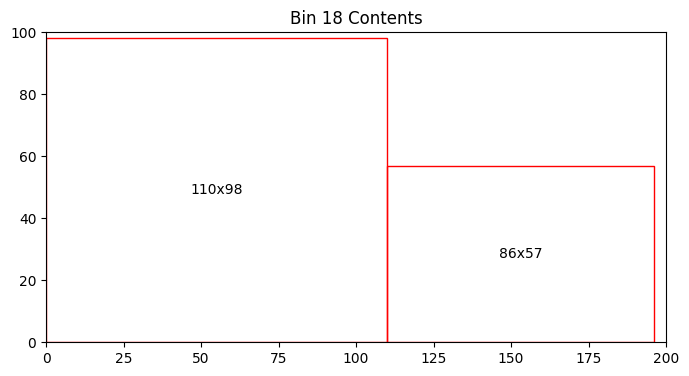

Bin 18 has 4318.00 units of area left


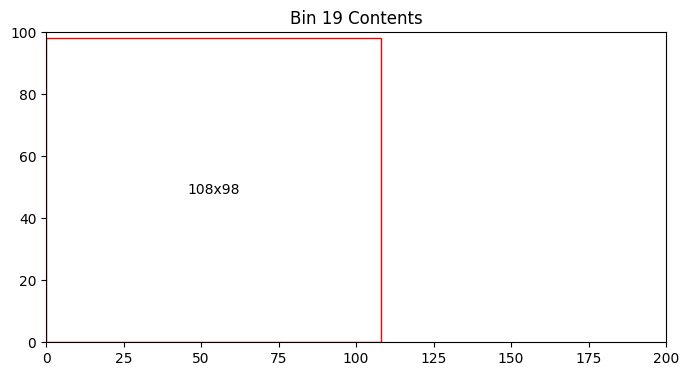

Bin 19 has 9416.00 units of area left


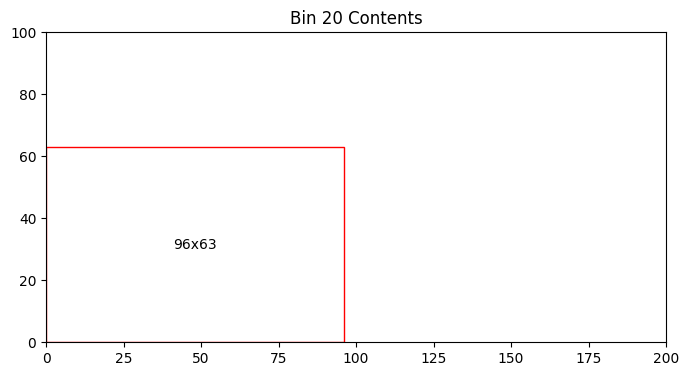

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


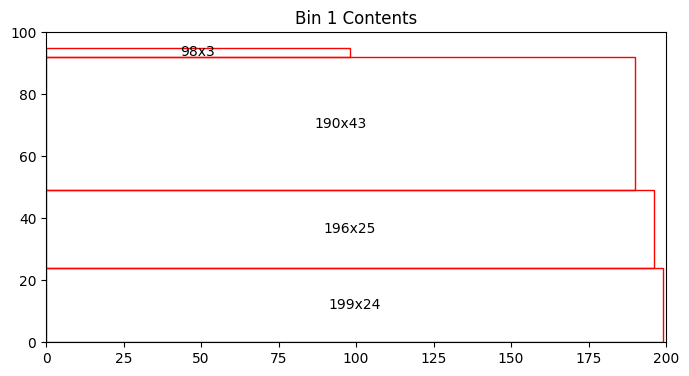

Bin 1 has 1860.00 units of area left


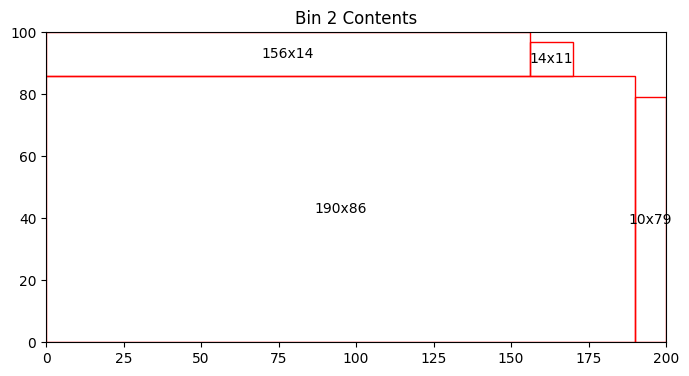

Bin 2 has 532.00 units of area left


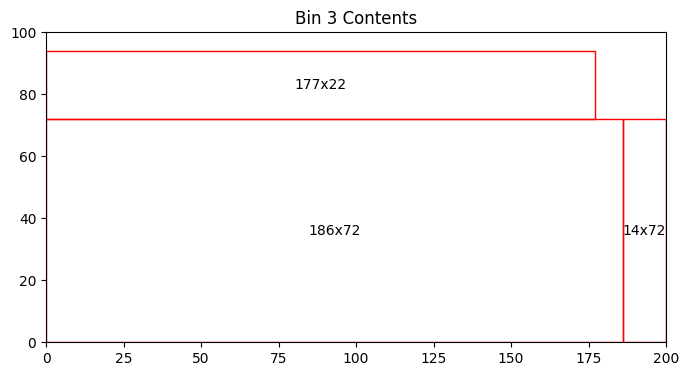

Bin 3 has 1706.00 units of area left


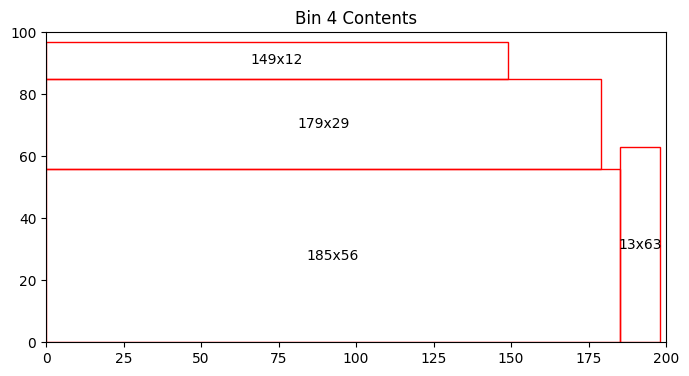

Bin 4 has 1842.00 units of area left


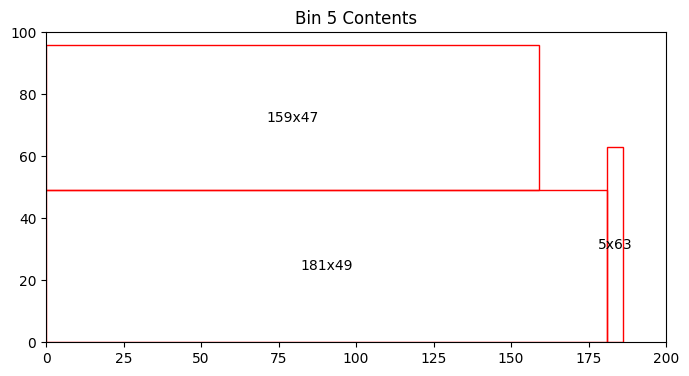

Bin 5 has 3343.00 units of area left


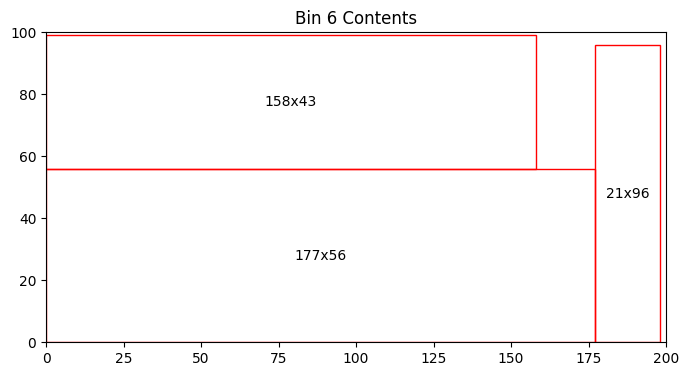

Bin 6 has 1278.00 units of area left


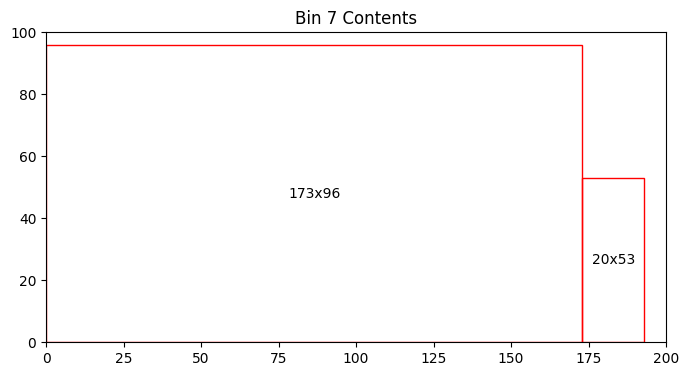

Bin 7 has 2332.00 units of area left


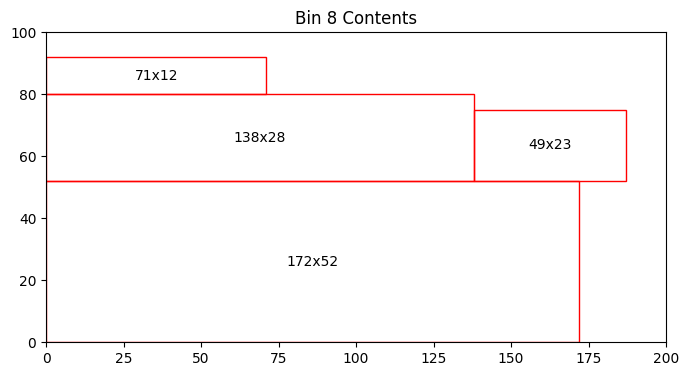

Bin 8 has 5213.00 units of area left


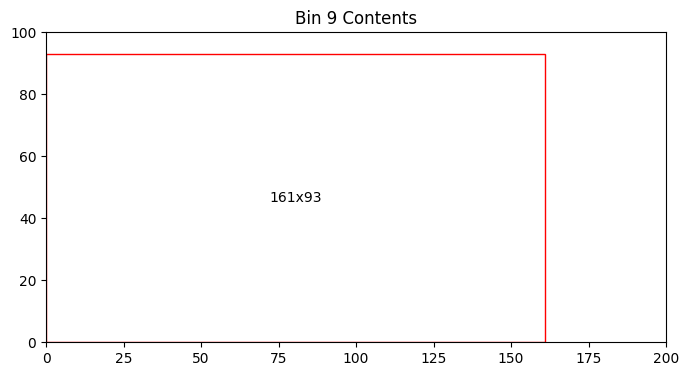

Bin 9 has 5027.00 units of area left


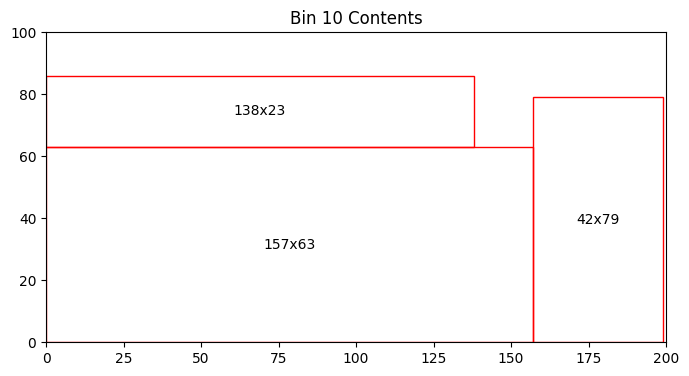

Bin 10 has 3617.00 units of area left


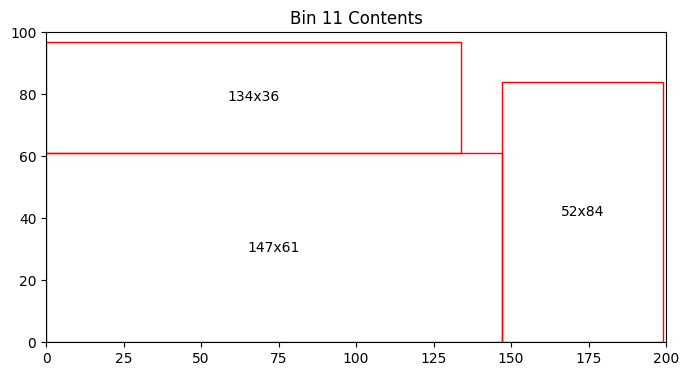

Bin 11 has 1841.00 units of area left


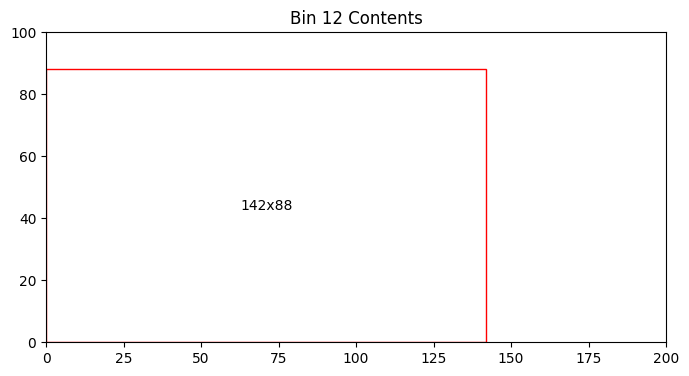

Bin 12 has 7504.00 units of area left


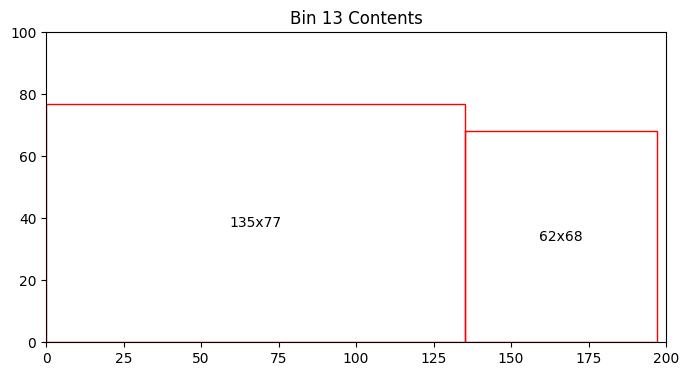

Bin 13 has 5389.00 units of area left


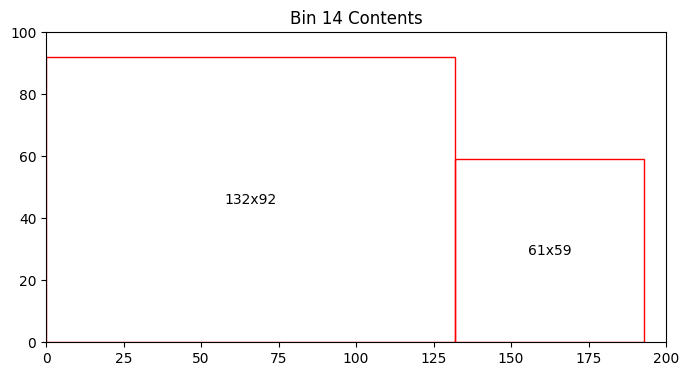

Bin 14 has 4257.00 units of area left


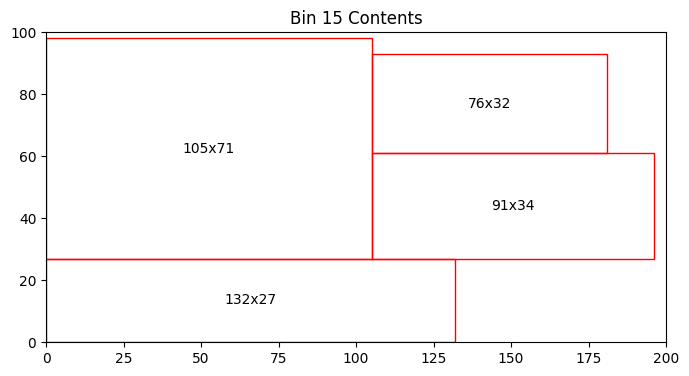

Bin 15 has 3455.00 units of area left


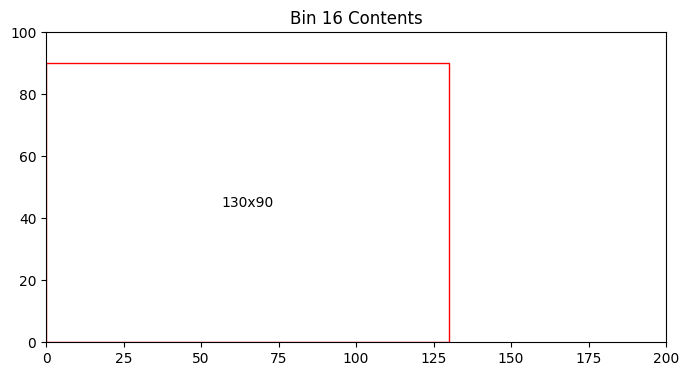

Bin 16 has 8300.00 units of area left


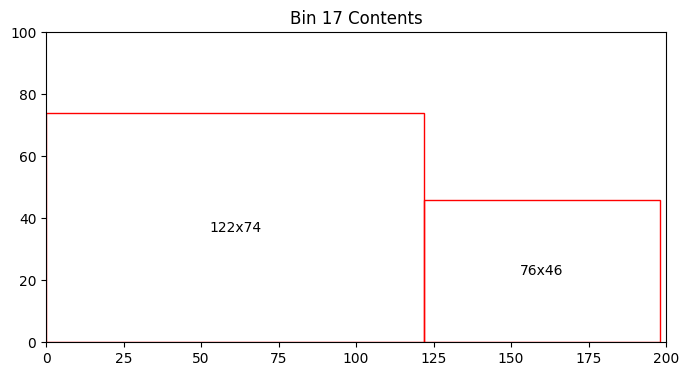

Bin 17 has 7476.00 units of area left


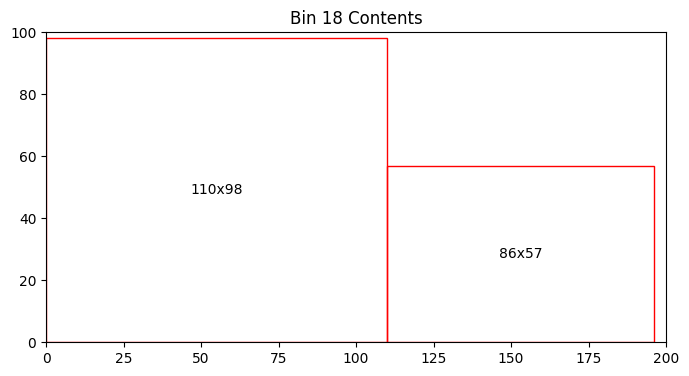

Bin 18 has 4318.00 units of area left


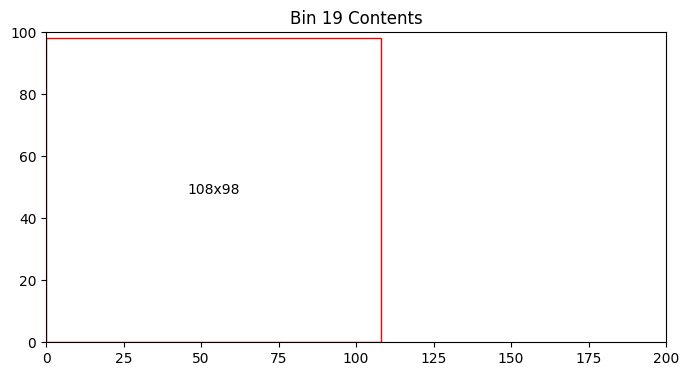

Bin 19 has 9416.00 units of area left


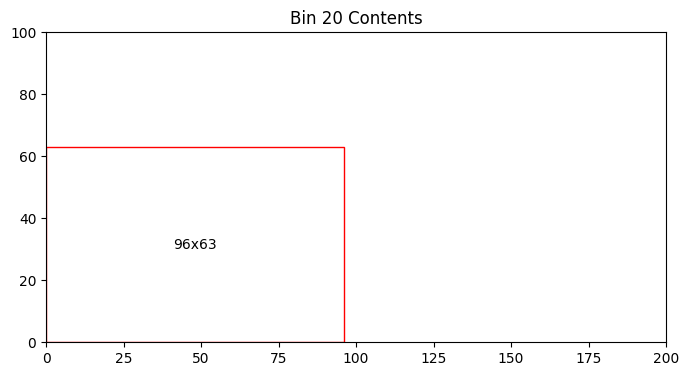

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


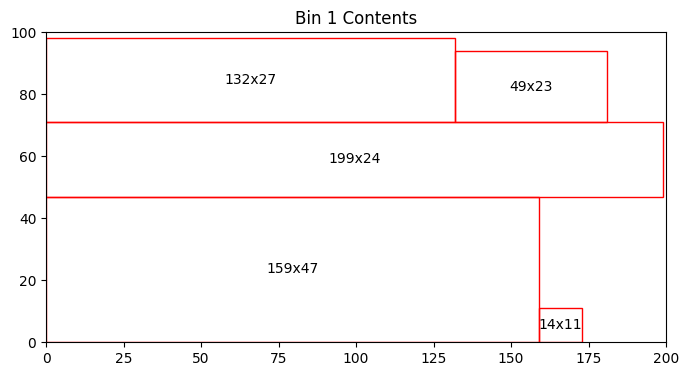

Bin 1 has 2906.00 units of area left


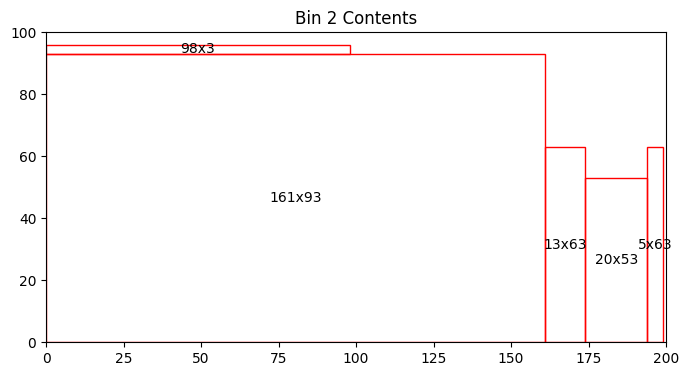

Bin 2 has 2539.00 units of area left


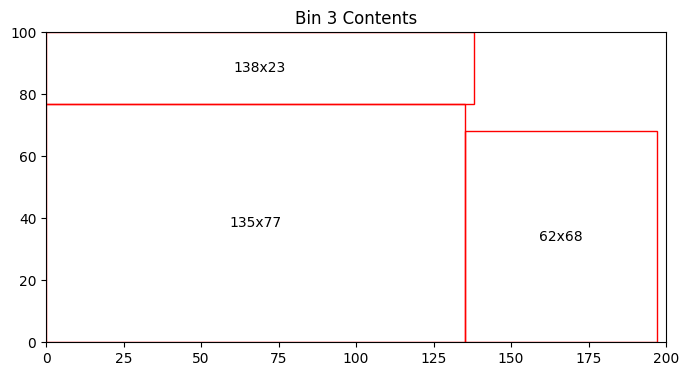

Bin 3 has 2215.00 units of area left


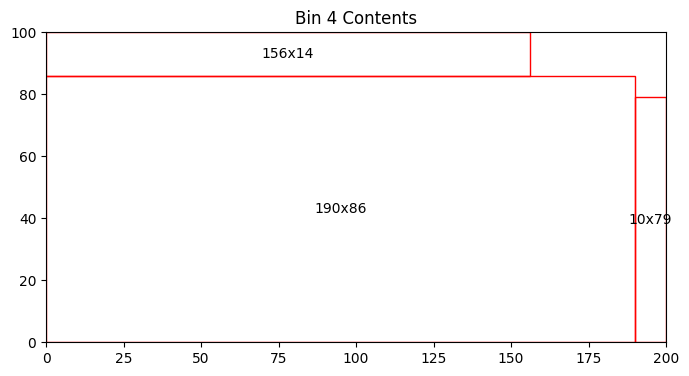

Bin 4 has 686.00 units of area left


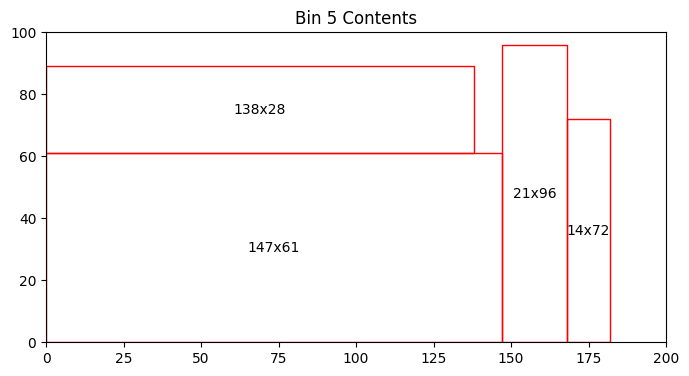

Bin 5 has 4145.00 units of area left


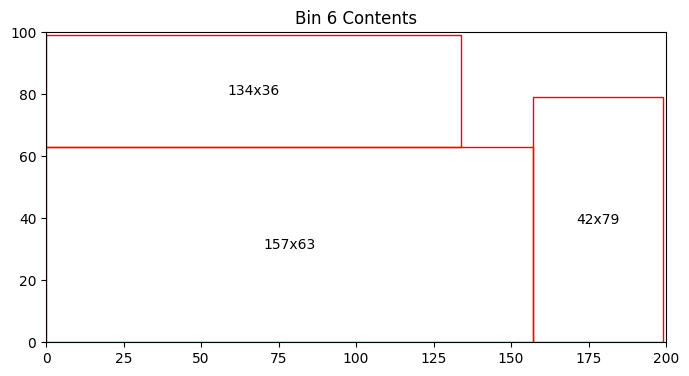

Bin 6 has 1967.00 units of area left


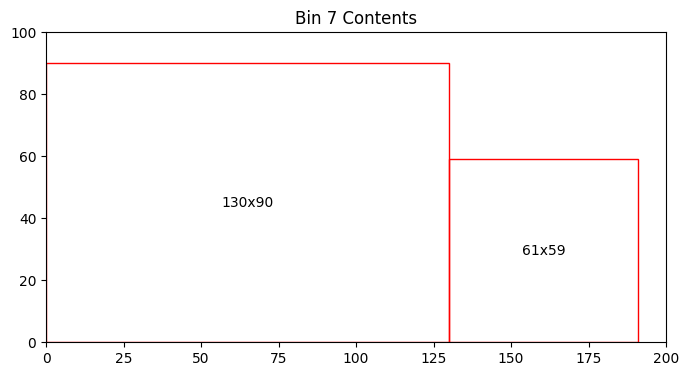

Bin 7 has 4701.00 units of area left


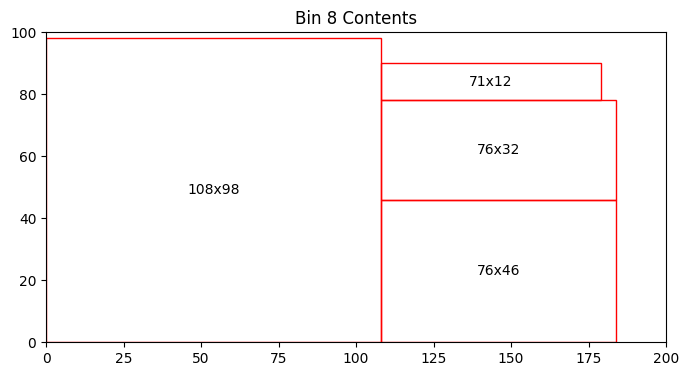

Bin 8 has 2636.00 units of area left


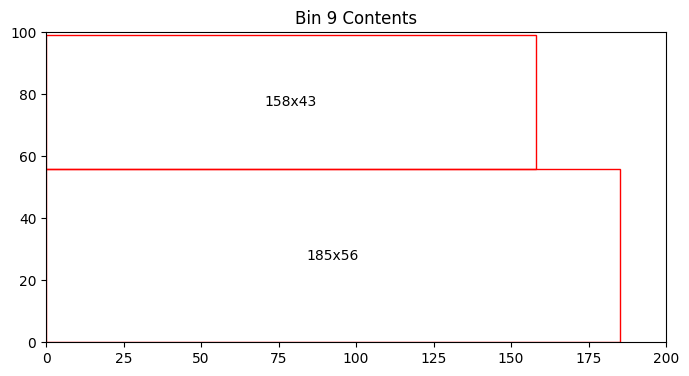

Bin 9 has 2846.00 units of area left


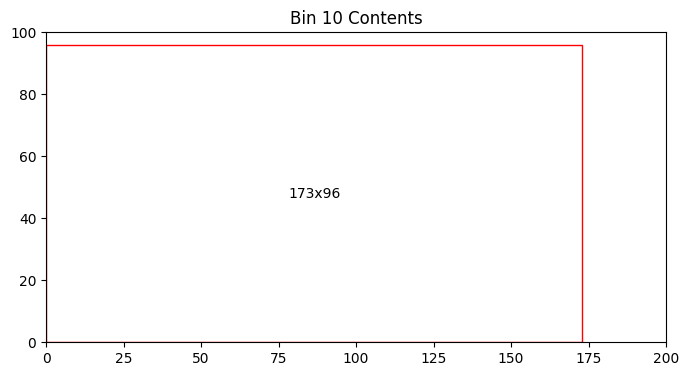

Bin 10 has 3392.00 units of area left


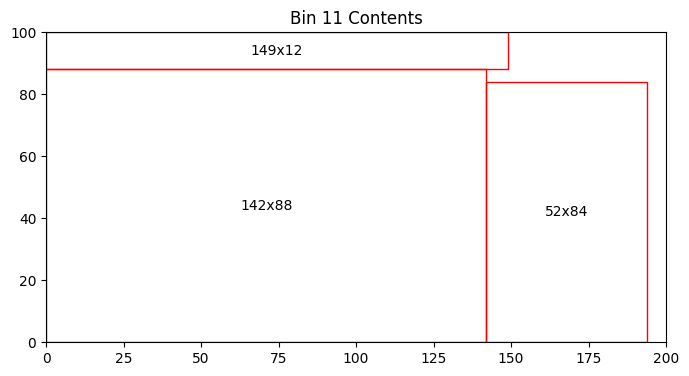

Bin 11 has 1348.00 units of area left


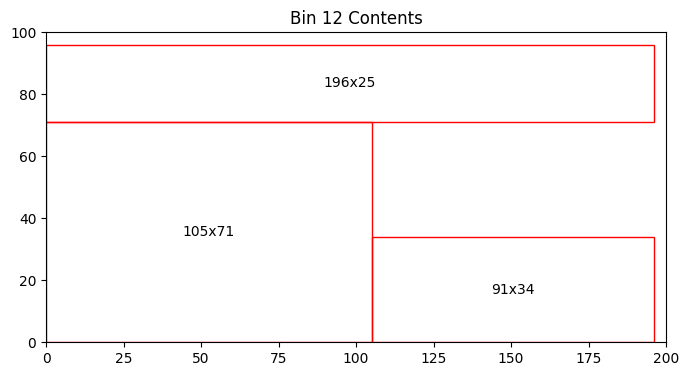

Bin 12 has 4551.00 units of area left


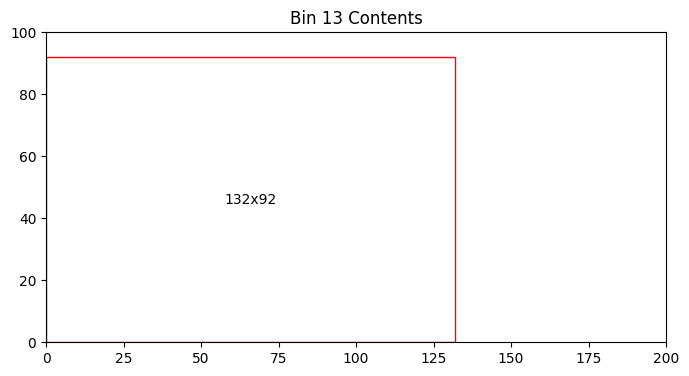

Bin 13 has 7856.00 units of area left


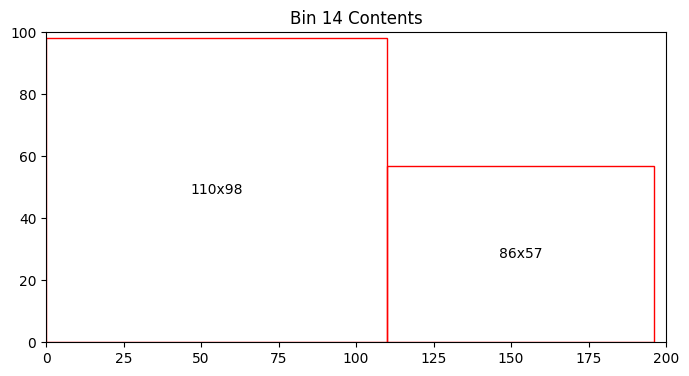

Bin 14 has 4318.00 units of area left


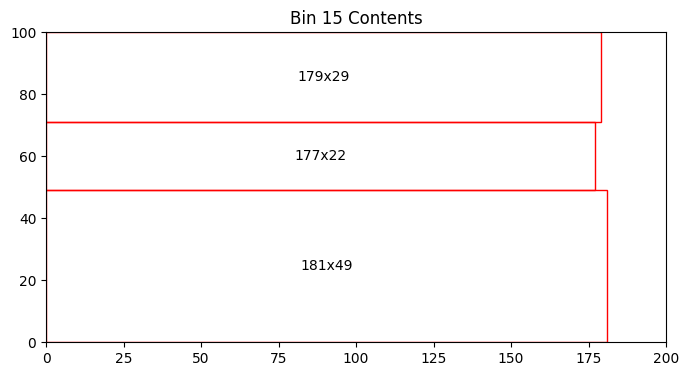

Bin 15 has 2046.00 units of area left


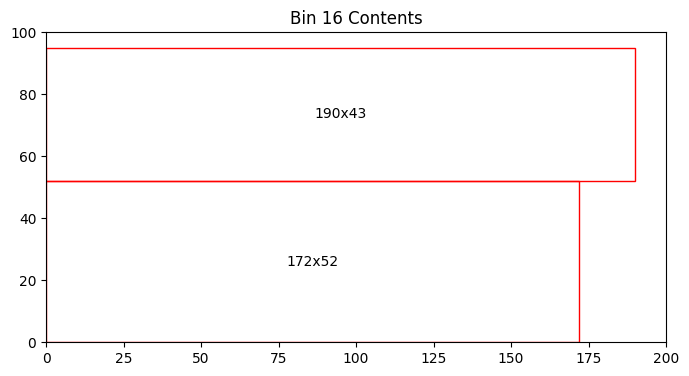

Bin 16 has 2886.00 units of area left


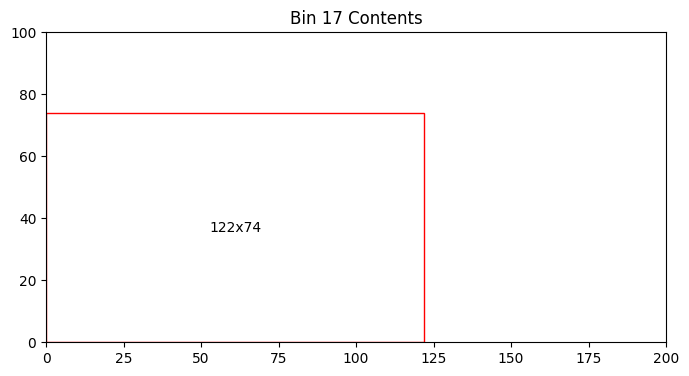

Bin 17 has 10972.00 units of area left


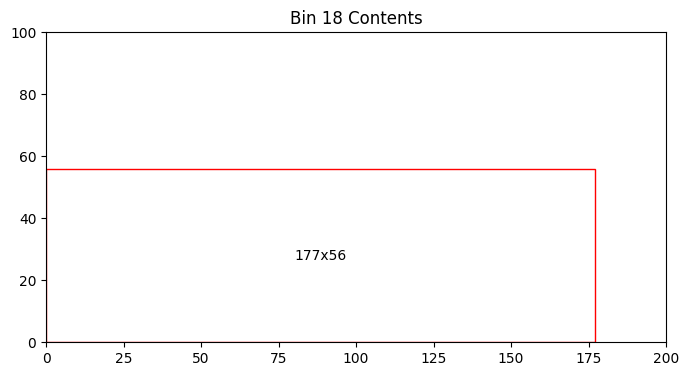

Bin 18 has 10088.00 units of area left


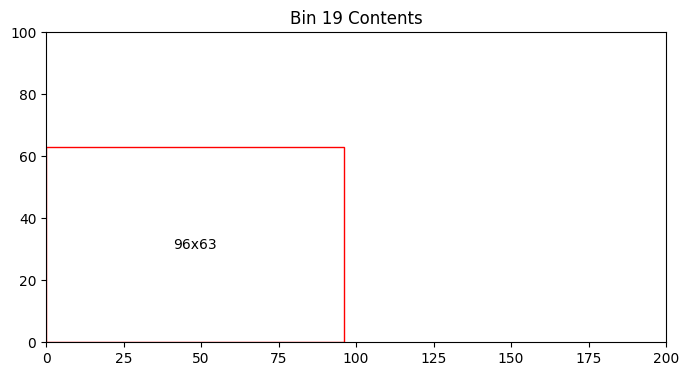

Bin 19 has 13952.00 units of area left


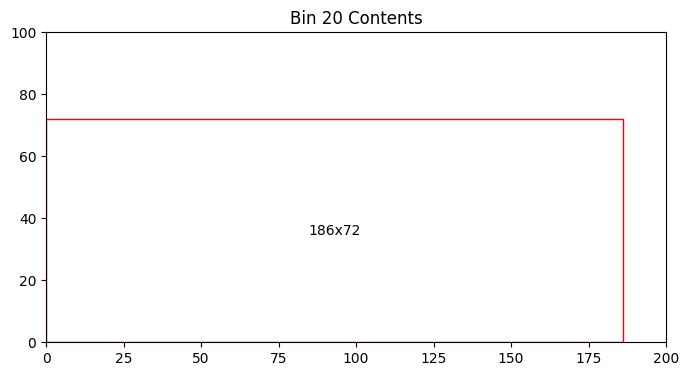

Bin 20 has 6608.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


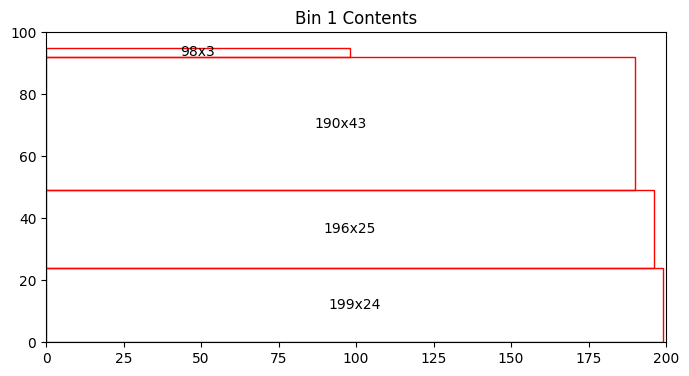

Bin 1 has 1860.00 units of area left


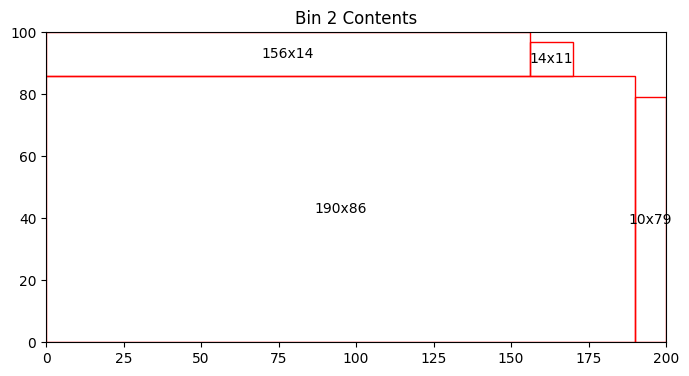

Bin 2 has 532.00 units of area left


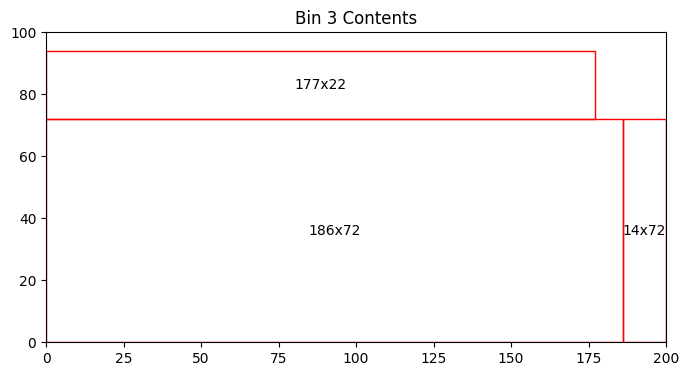

Bin 3 has 1706.00 units of area left


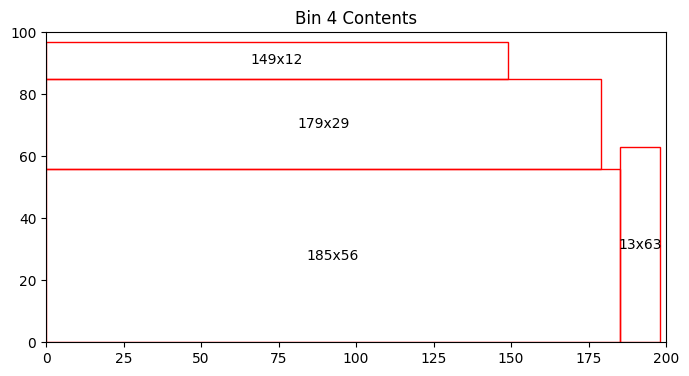

Bin 4 has 1842.00 units of area left


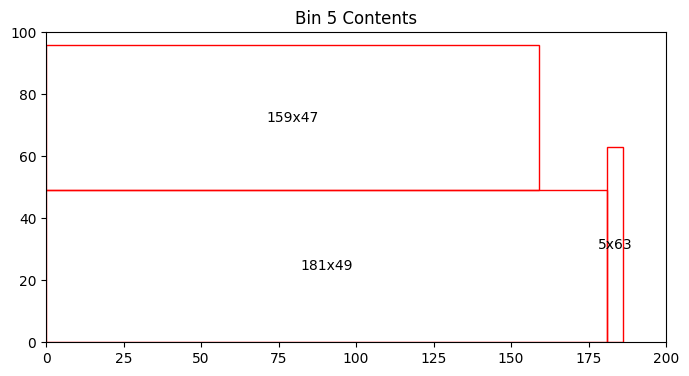

Bin 5 has 3343.00 units of area left


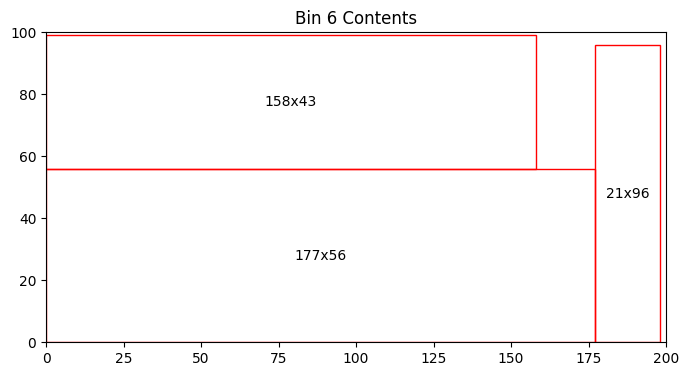

Bin 6 has 1278.00 units of area left


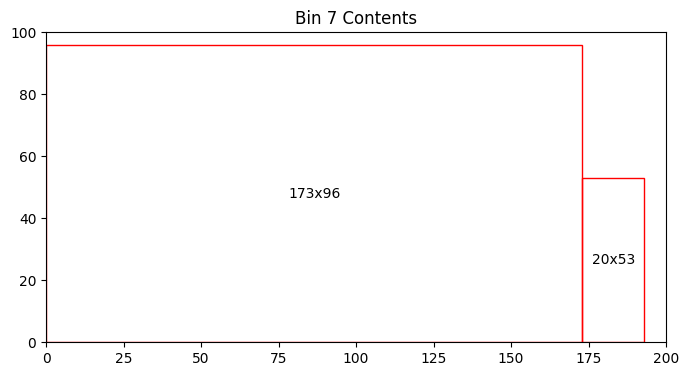

Bin 7 has 2332.00 units of area left


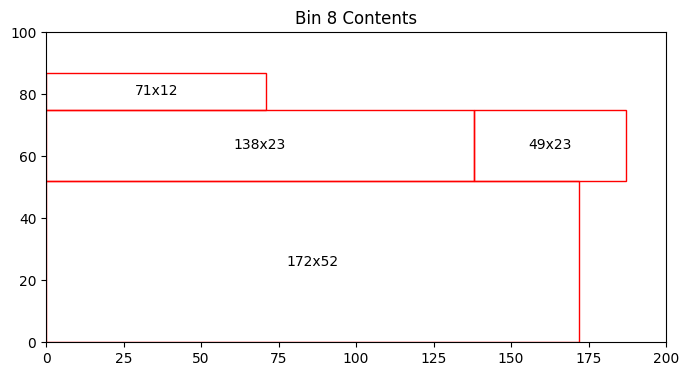

Bin 8 has 5903.00 units of area left


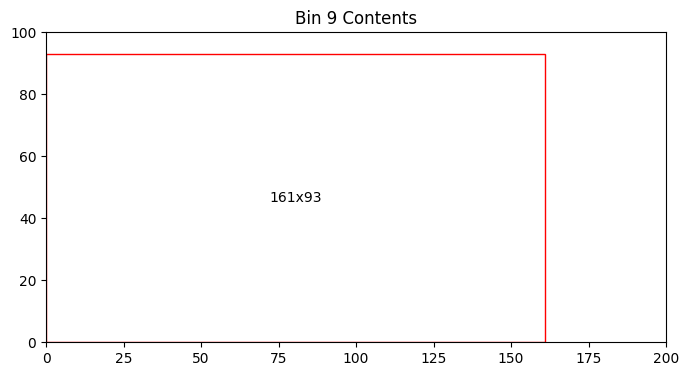

Bin 9 has 5027.00 units of area left


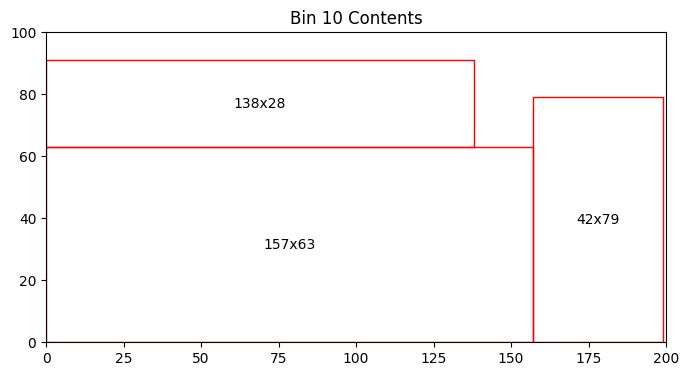

Bin 10 has 2927.00 units of area left


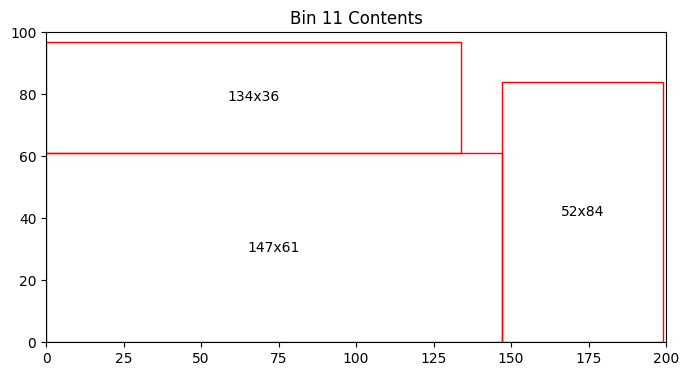

Bin 11 has 1841.00 units of area left


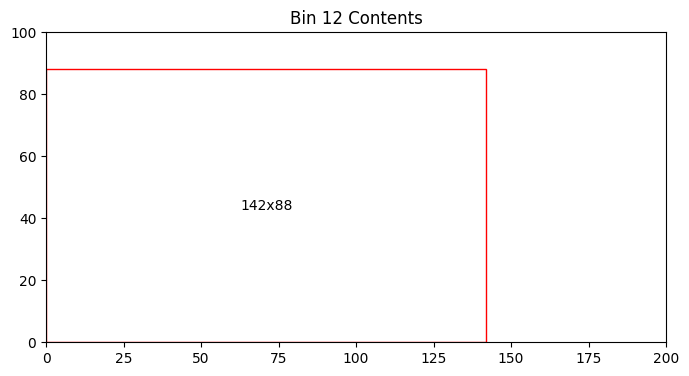

Bin 12 has 7504.00 units of area left


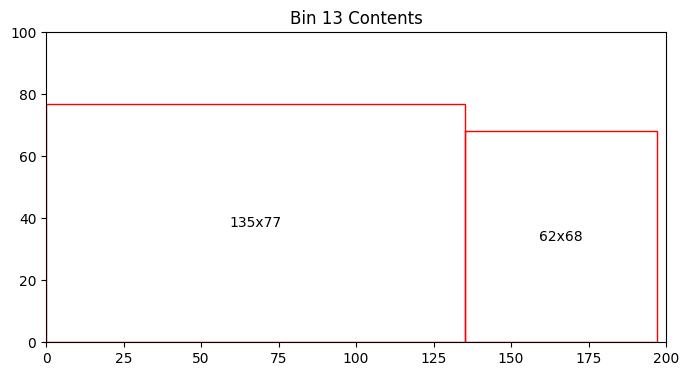

Bin 13 has 5389.00 units of area left


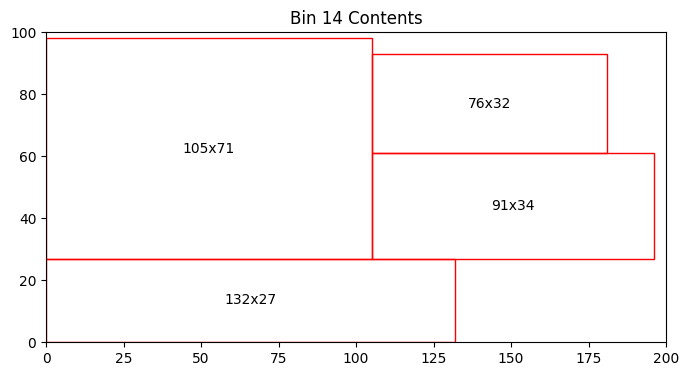

Bin 14 has 3455.00 units of area left


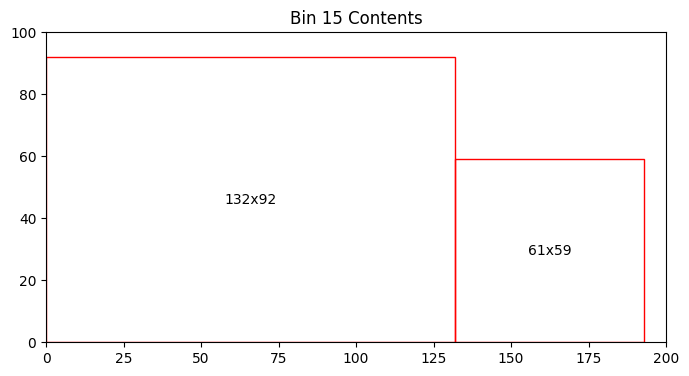

Bin 15 has 4257.00 units of area left


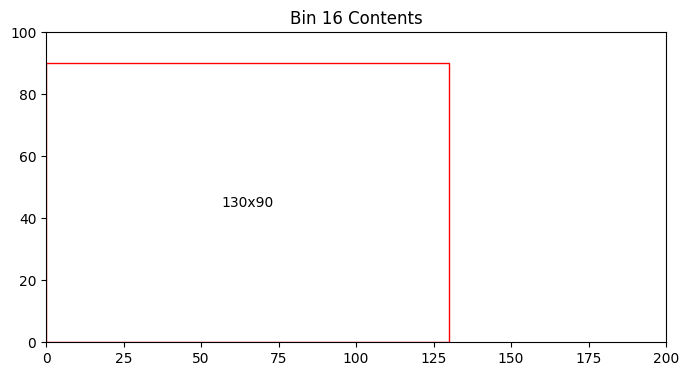

Bin 16 has 8300.00 units of area left


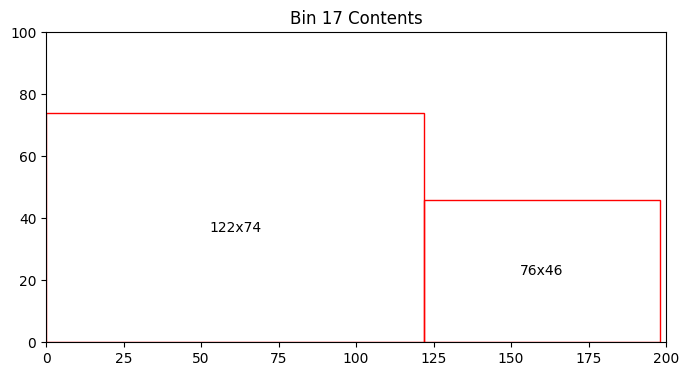

Bin 17 has 7476.00 units of area left


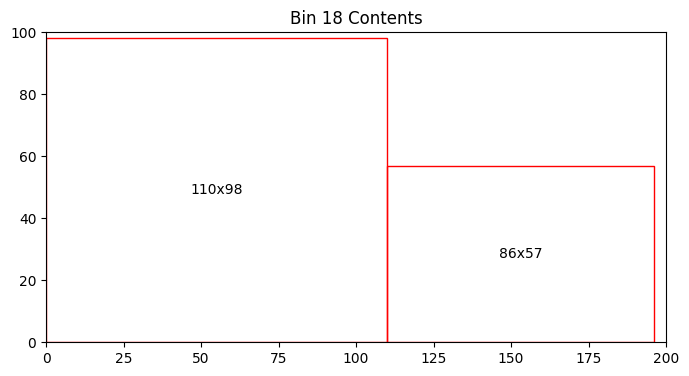

Bin 18 has 4318.00 units of area left


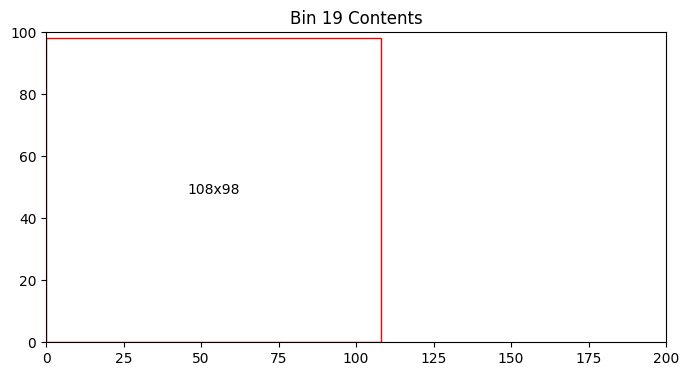

Bin 19 has 9416.00 units of area left


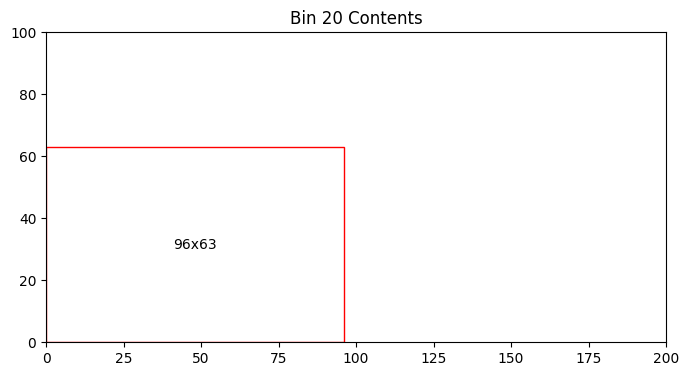

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


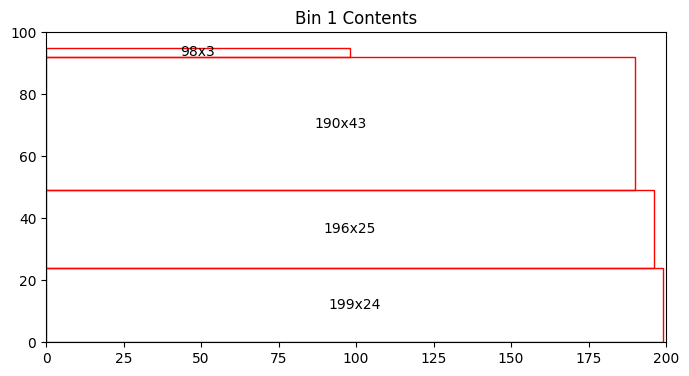

Bin 1 has 1860.00 units of area left


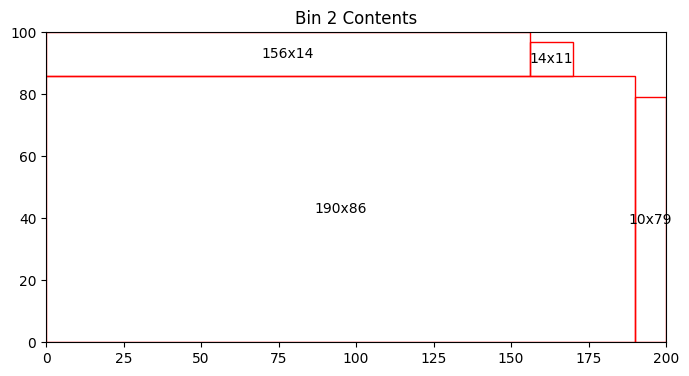

Bin 2 has 532.00 units of area left


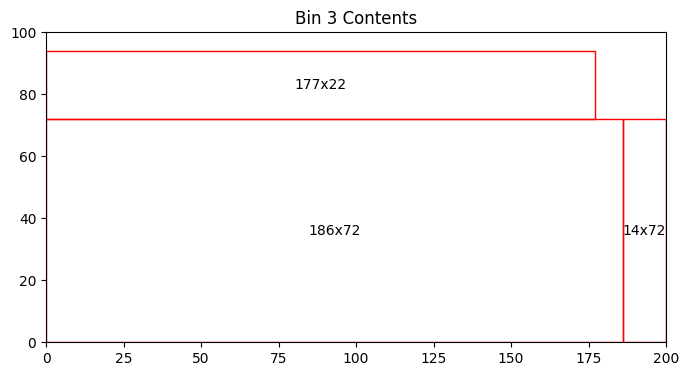

Bin 3 has 1706.00 units of area left


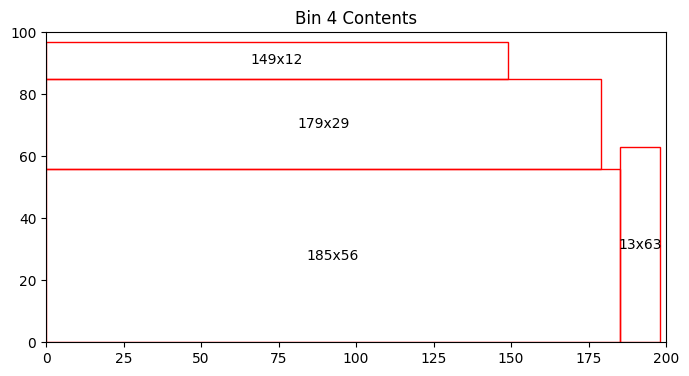

Bin 4 has 1842.00 units of area left


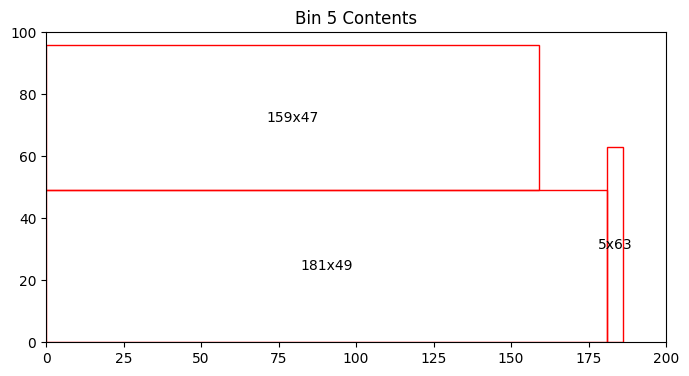

Bin 5 has 3343.00 units of area left


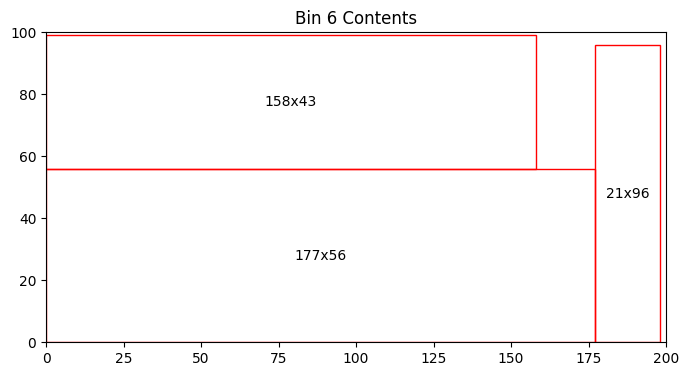

Bin 6 has 1278.00 units of area left


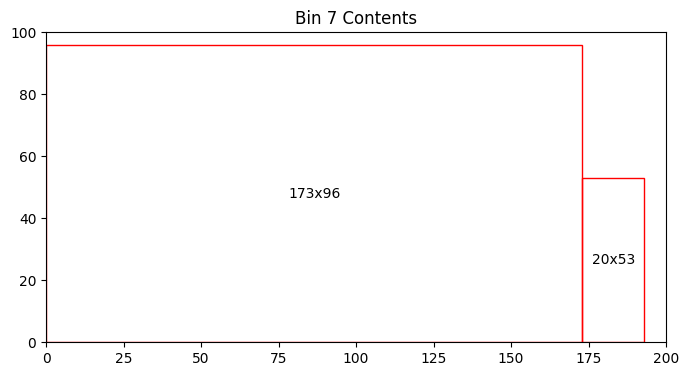

Bin 7 has 2332.00 units of area left


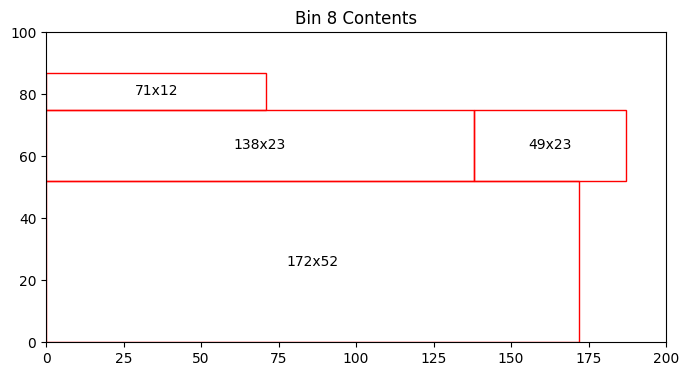

Bin 8 has 5903.00 units of area left


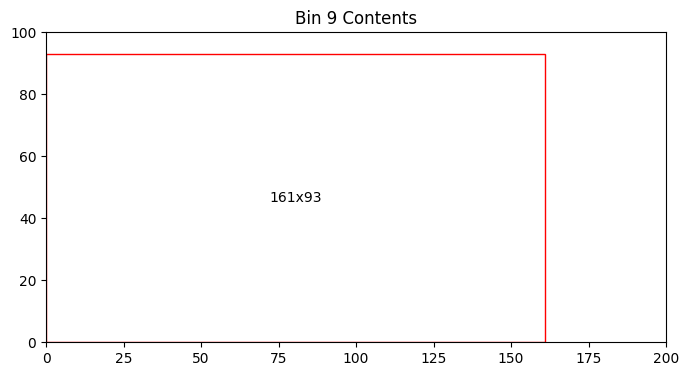

Bin 9 has 5027.00 units of area left


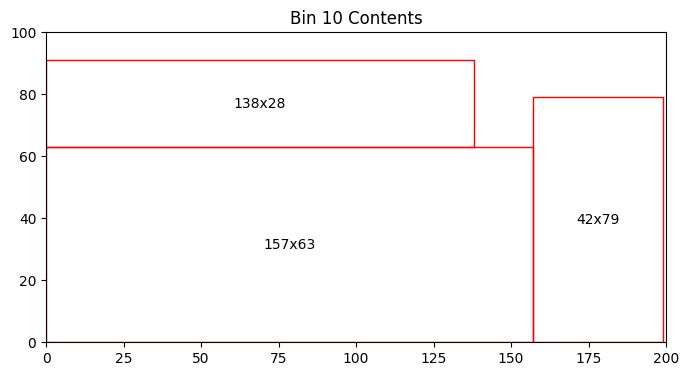

Bin 10 has 2927.00 units of area left


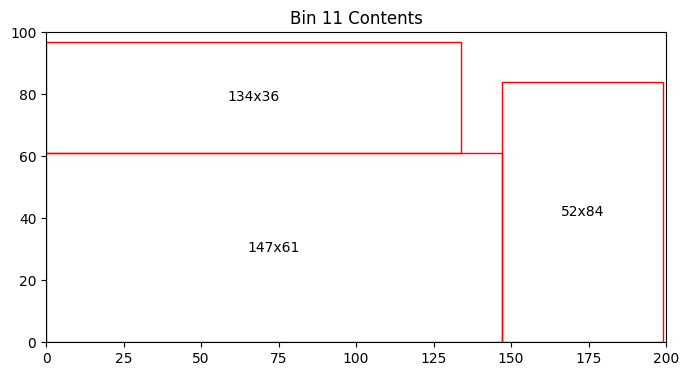

Bin 11 has 1841.00 units of area left


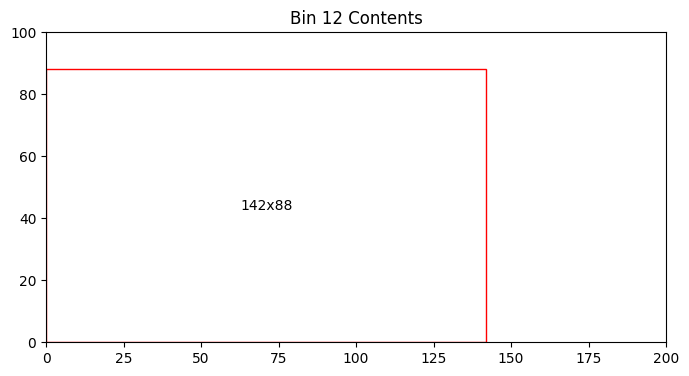

Bin 12 has 7504.00 units of area left


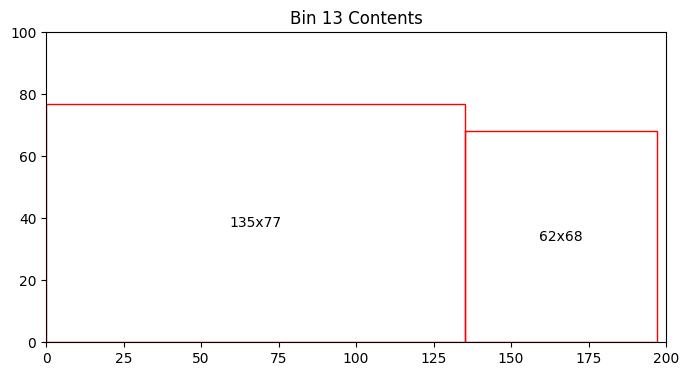

Bin 13 has 5389.00 units of area left


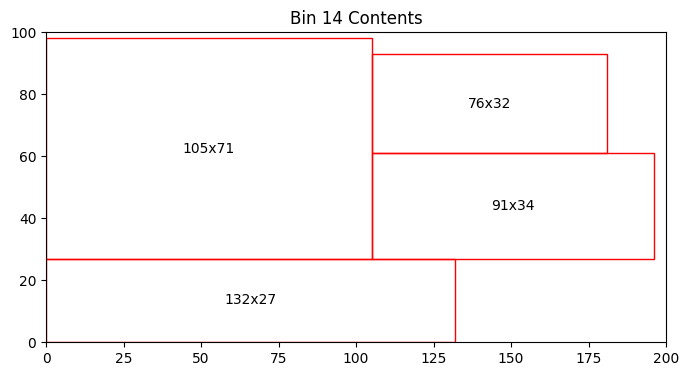

Bin 14 has 3455.00 units of area left


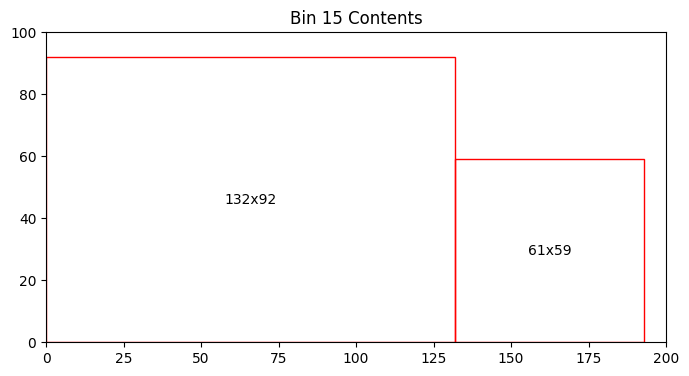

Bin 15 has 4257.00 units of area left


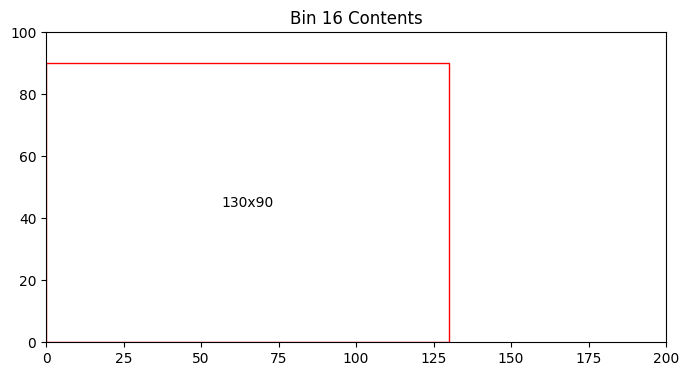

Bin 16 has 8300.00 units of area left


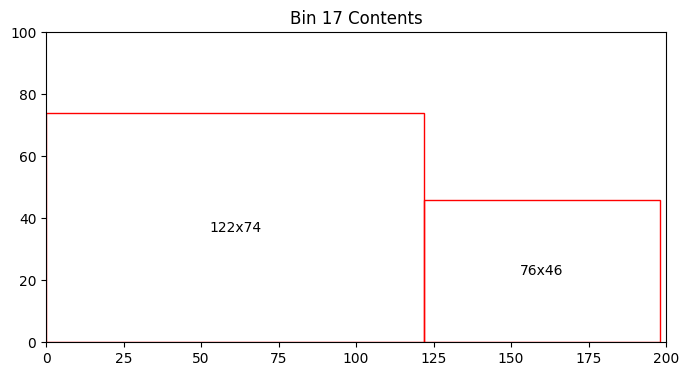

Bin 17 has 7476.00 units of area left


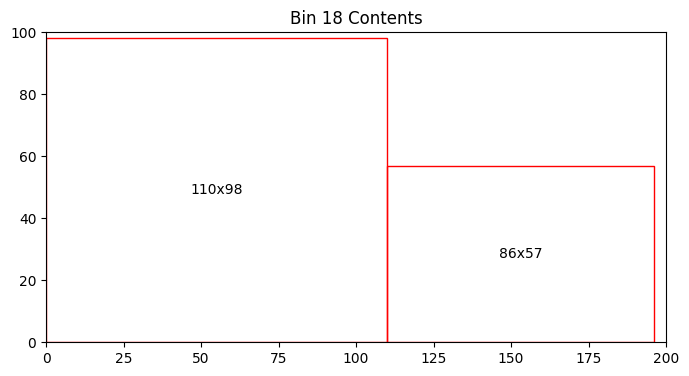

Bin 18 has 4318.00 units of area left


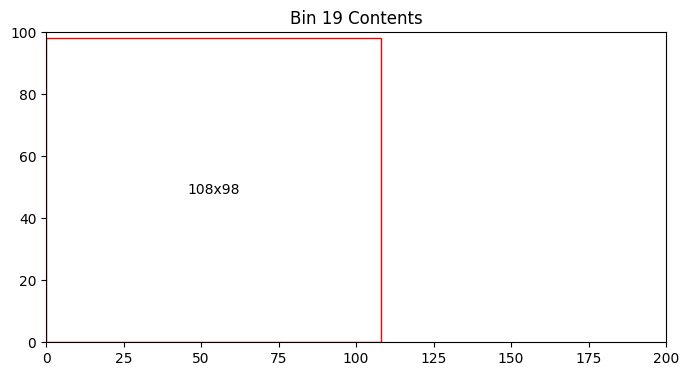

Bin 19 has 9416.00 units of area left


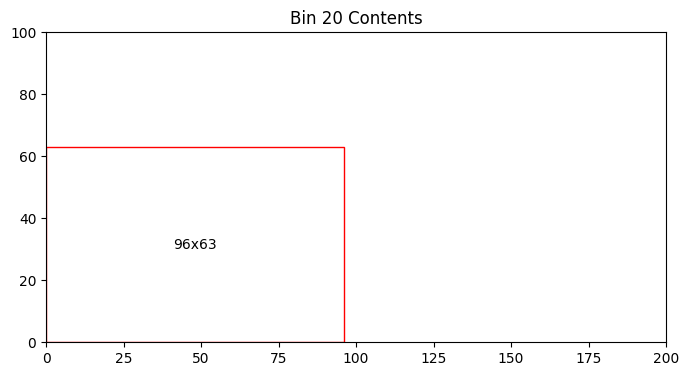

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


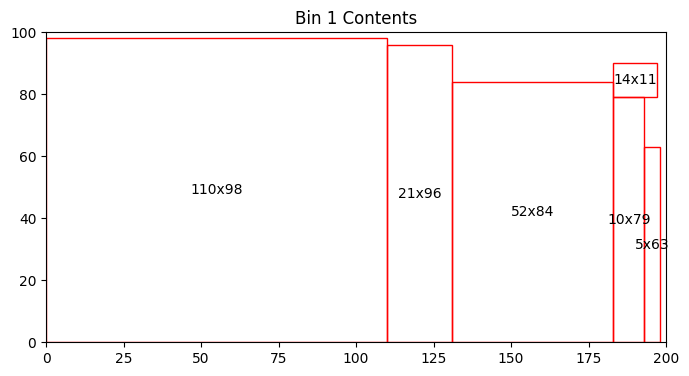

Bin 1 has 1577.00 units of area left


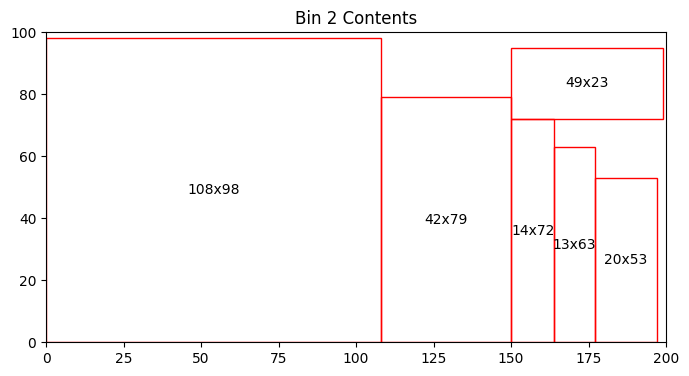

Bin 2 has 2084.00 units of area left


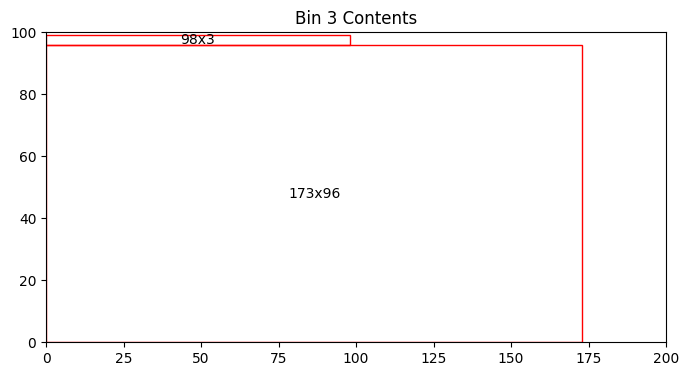

Bin 3 has 3098.00 units of area left


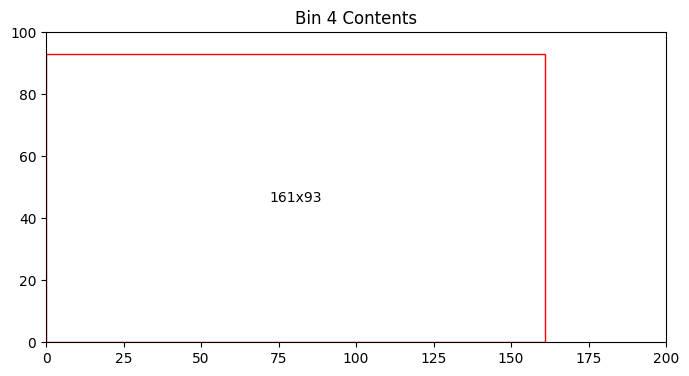

Bin 4 has 5027.00 units of area left


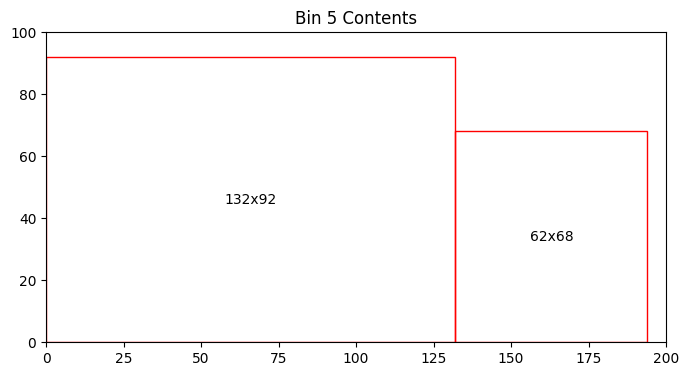

Bin 5 has 3640.00 units of area left


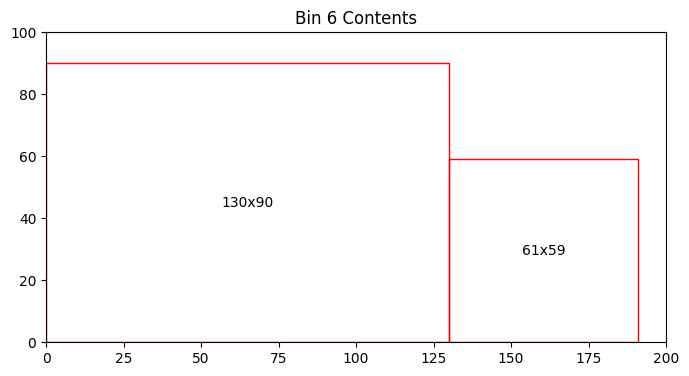

Bin 6 has 4701.00 units of area left


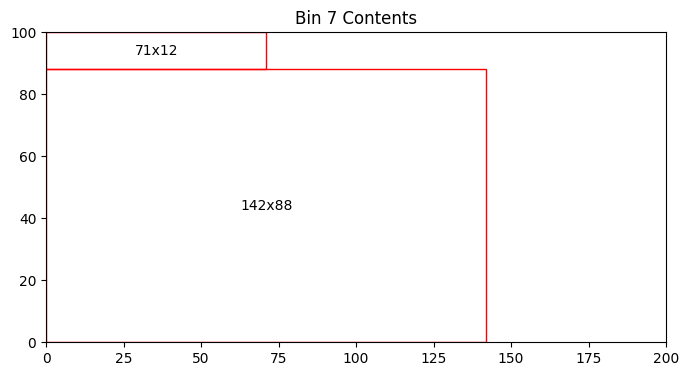

Bin 7 has 6652.00 units of area left


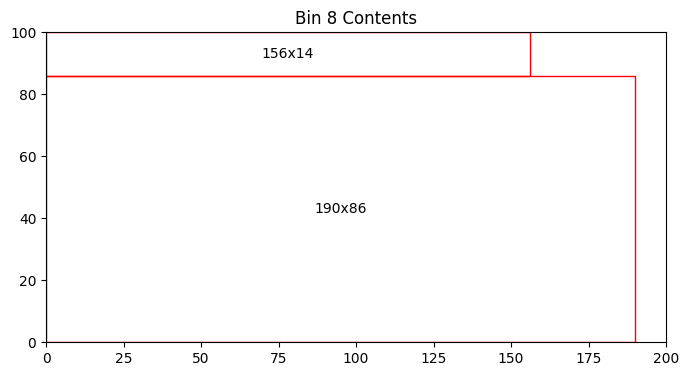

Bin 8 has 1476.00 units of area left


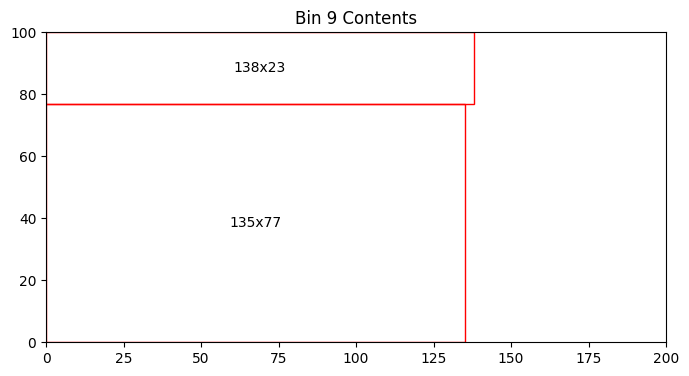

Bin 9 has 6431.00 units of area left


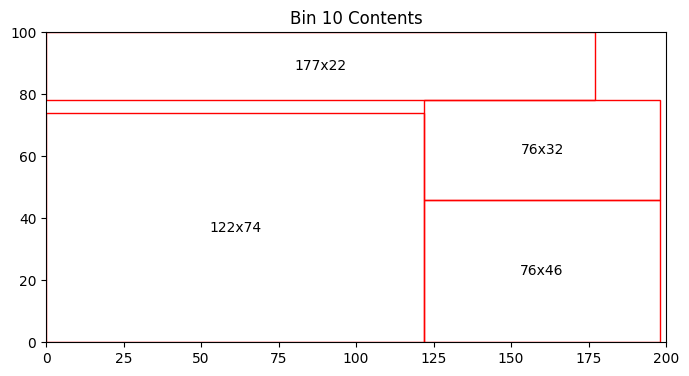

Bin 10 has 1150.00 units of area left


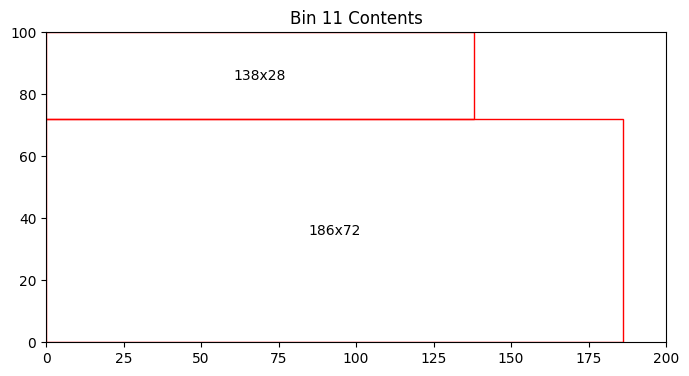

Bin 11 has 2744.00 units of area left


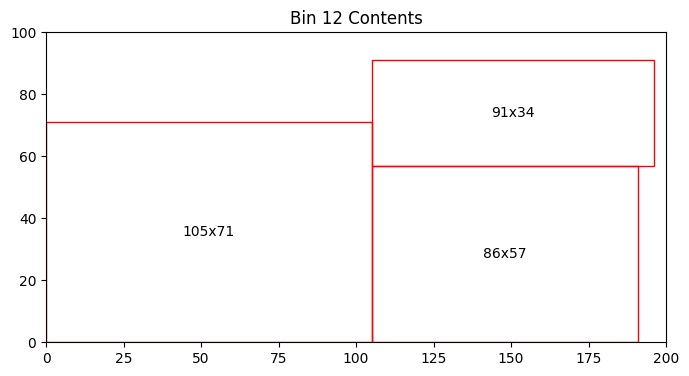

Bin 12 has 4549.00 units of area left


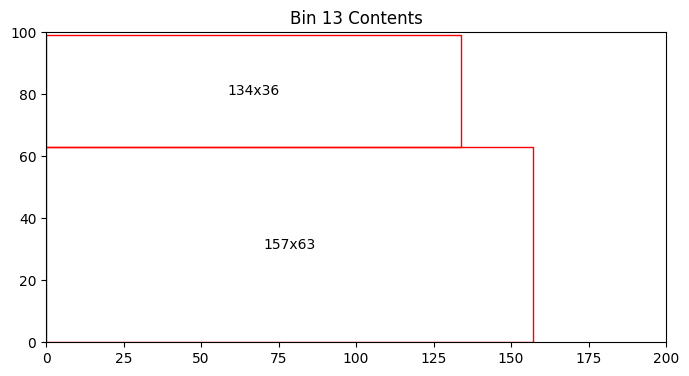

Bin 13 has 5285.00 units of area left


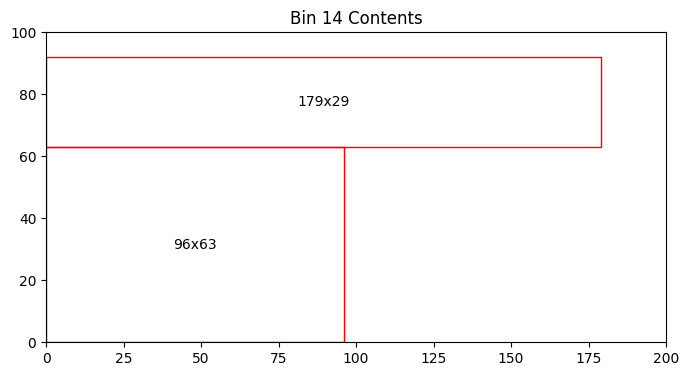

Bin 14 has 8761.00 units of area left


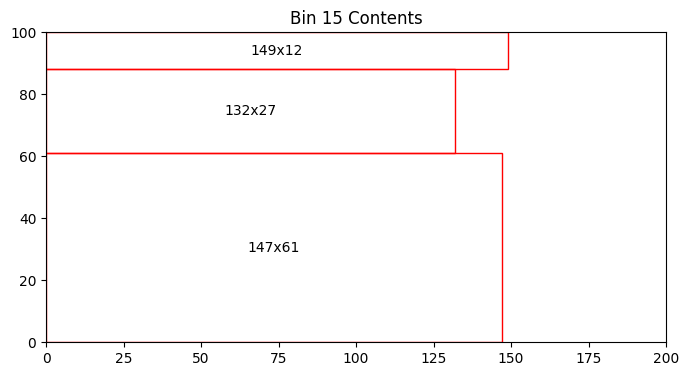

Bin 15 has 5681.00 units of area left


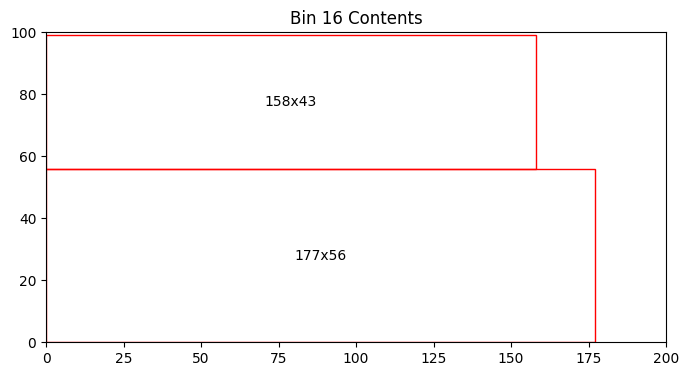

Bin 16 has 3294.00 units of area left


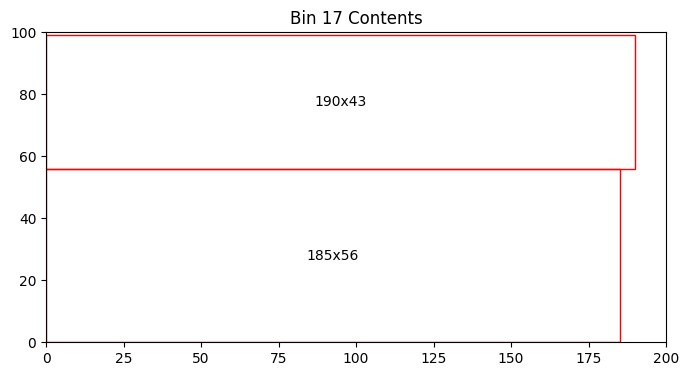

Bin 17 has 1470.00 units of area left


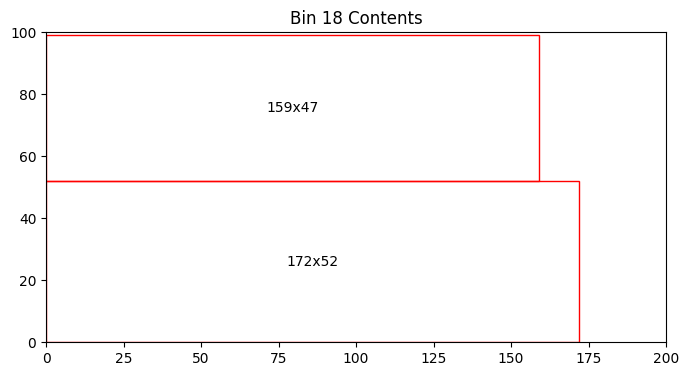

Bin 18 has 3583.00 units of area left


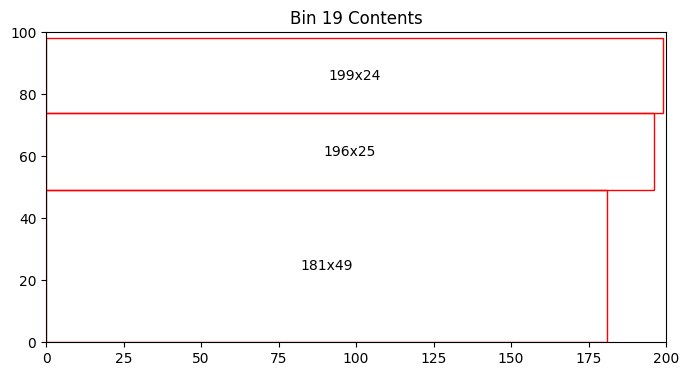

Bin 19 has 1455.00 units of area left
Total number of bins = 19
Total area left in bins = 72658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


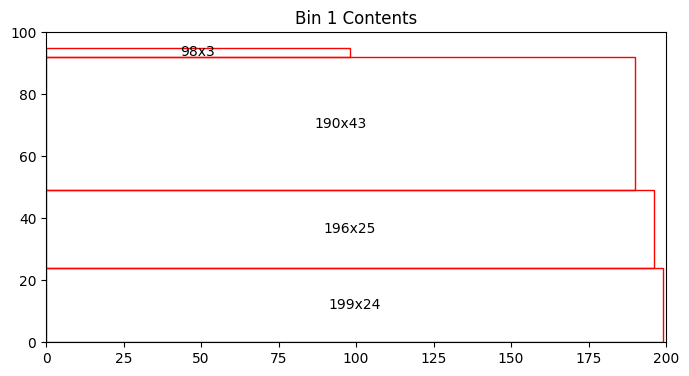

Bin 1 has 1860.00 units of area left


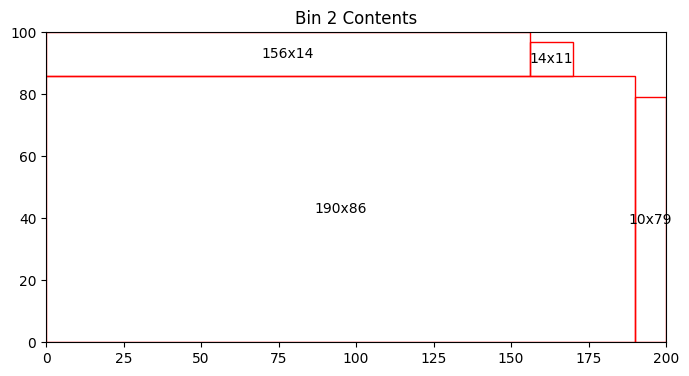

Bin 2 has 532.00 units of area left


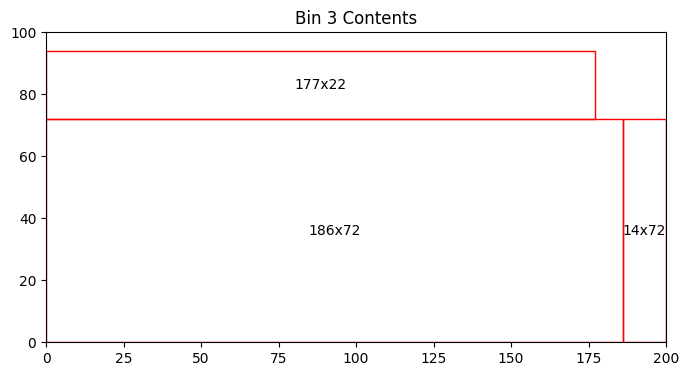

Bin 3 has 1706.00 units of area left


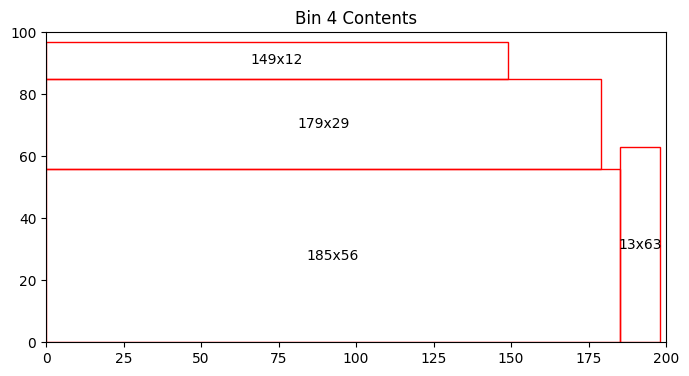

Bin 4 has 1842.00 units of area left


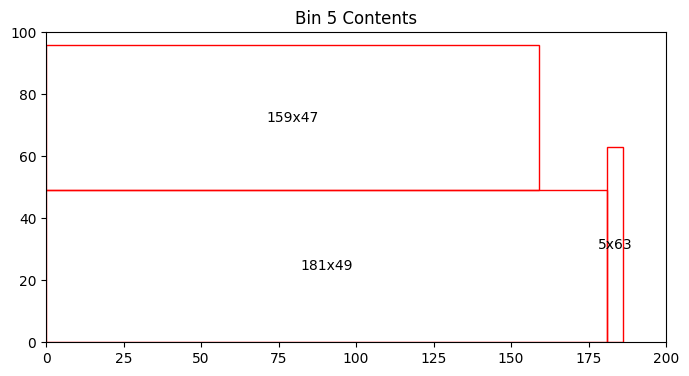

Bin 5 has 3343.00 units of area left


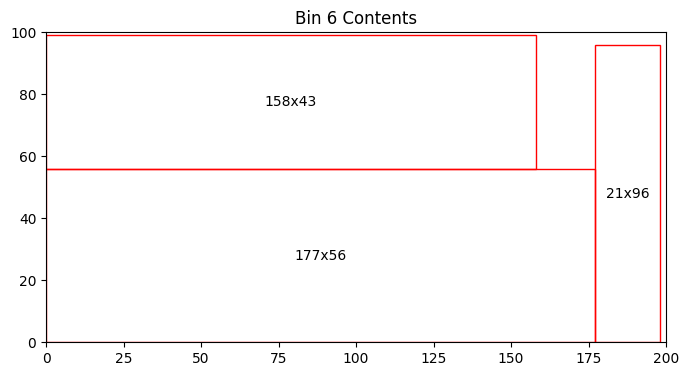

Bin 6 has 1278.00 units of area left


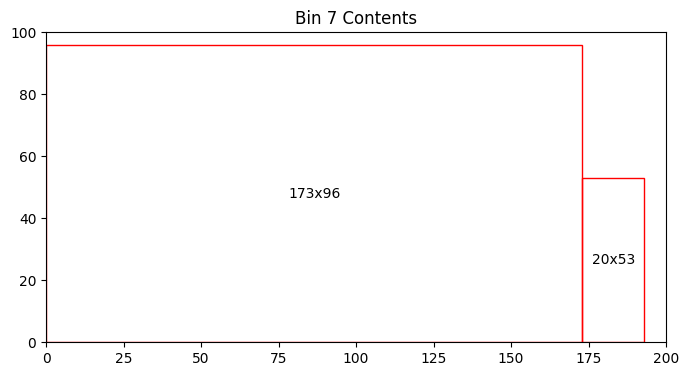

Bin 7 has 2332.00 units of area left


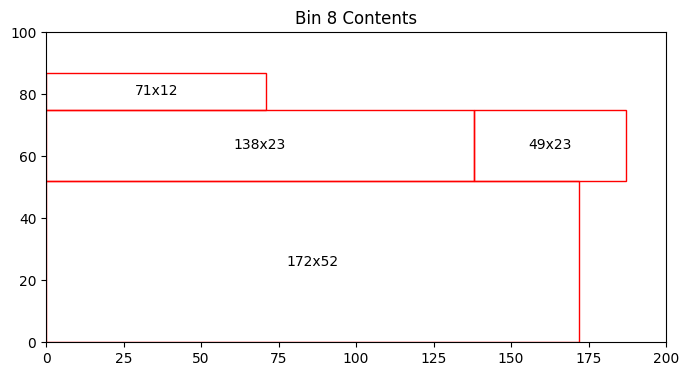

Bin 8 has 5903.00 units of area left


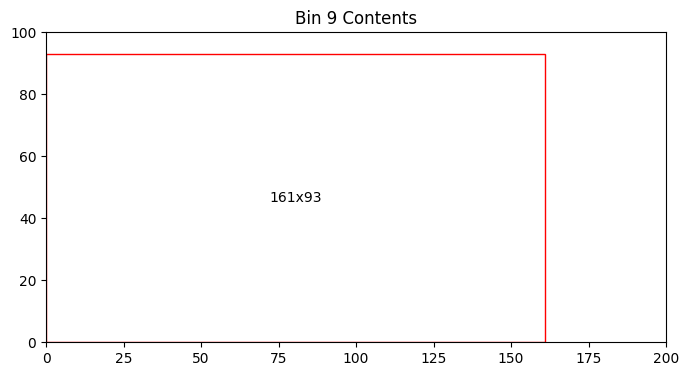

Bin 9 has 5027.00 units of area left


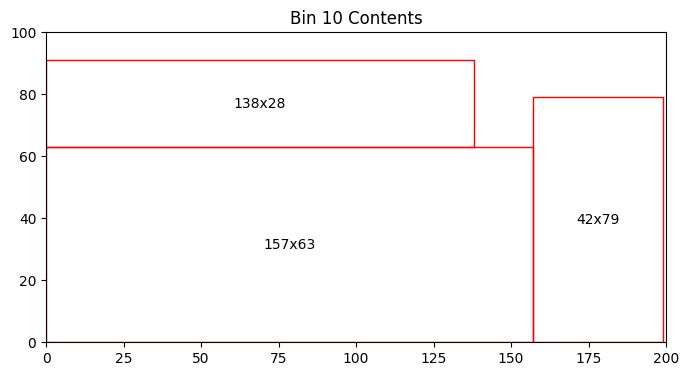

Bin 10 has 2927.00 units of area left


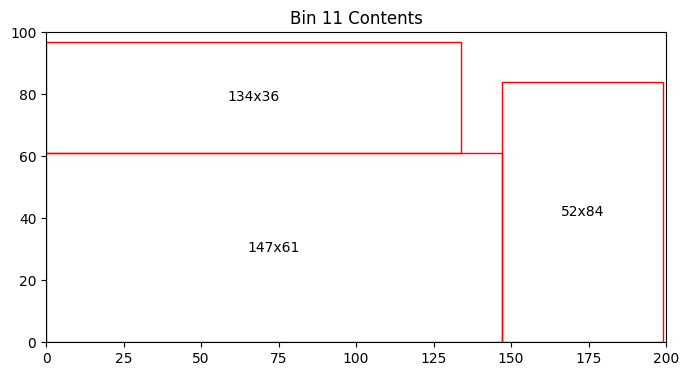

Bin 11 has 1841.00 units of area left


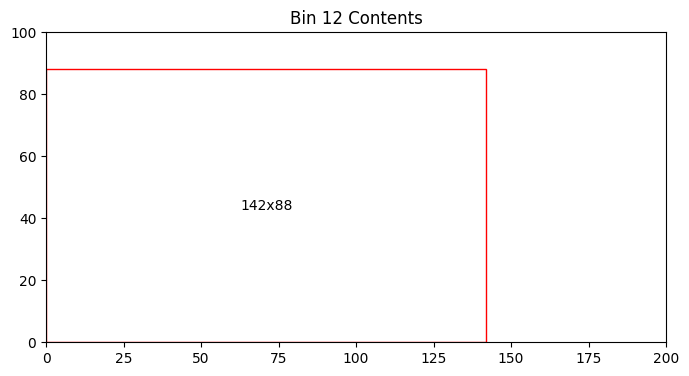

Bin 12 has 7504.00 units of area left


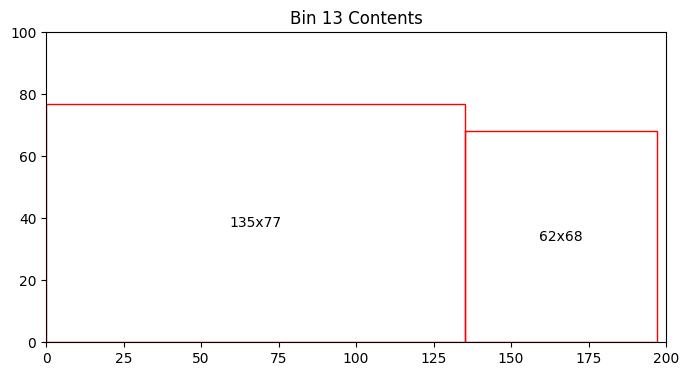

Bin 13 has 5389.00 units of area left


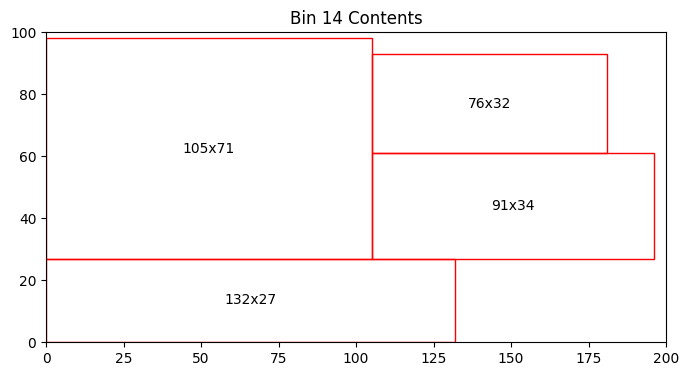

Bin 14 has 3455.00 units of area left


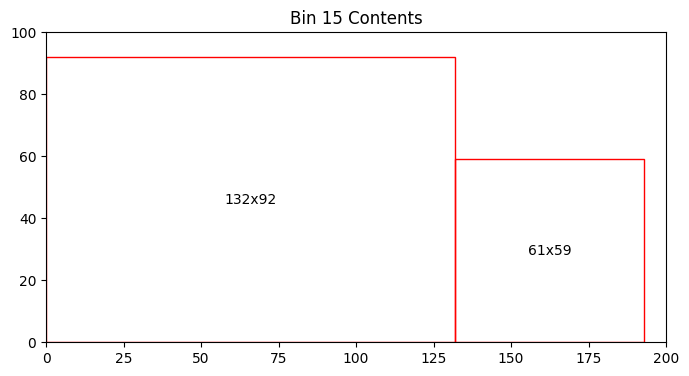

Bin 15 has 4257.00 units of area left


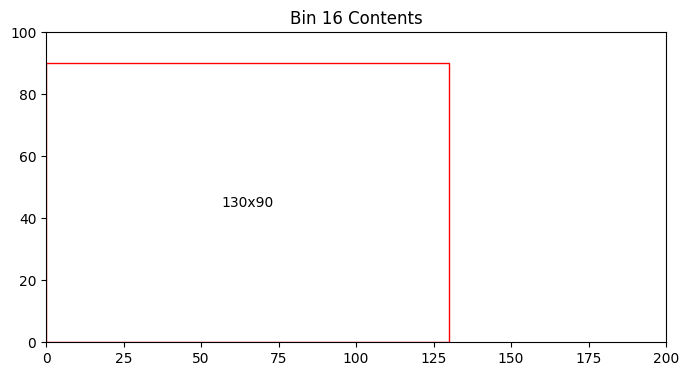

Bin 16 has 8300.00 units of area left


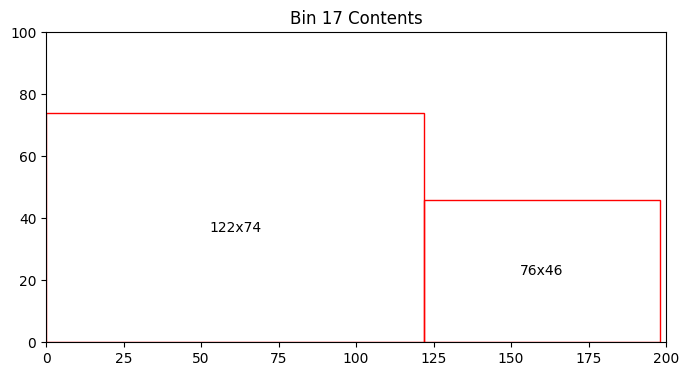

Bin 17 has 7476.00 units of area left


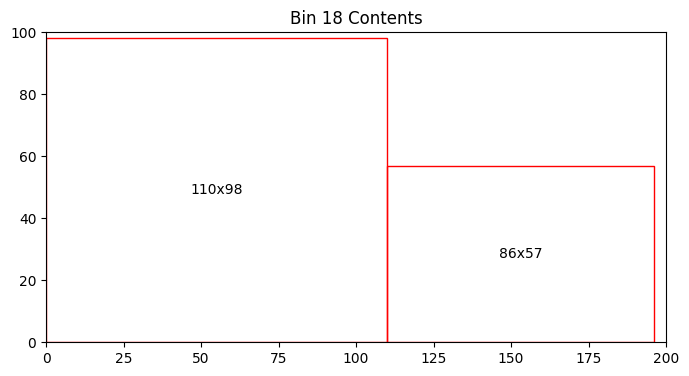

Bin 18 has 4318.00 units of area left


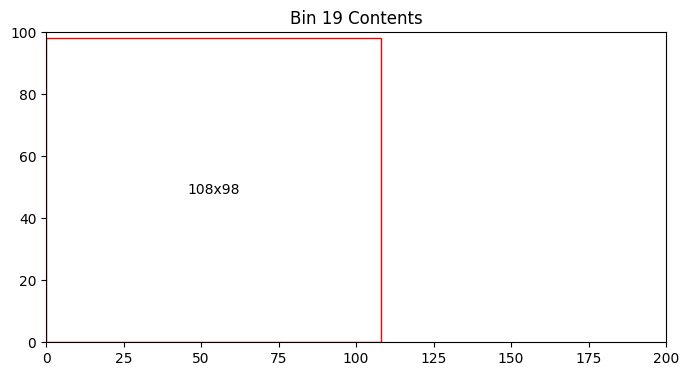

Bin 19 has 9416.00 units of area left


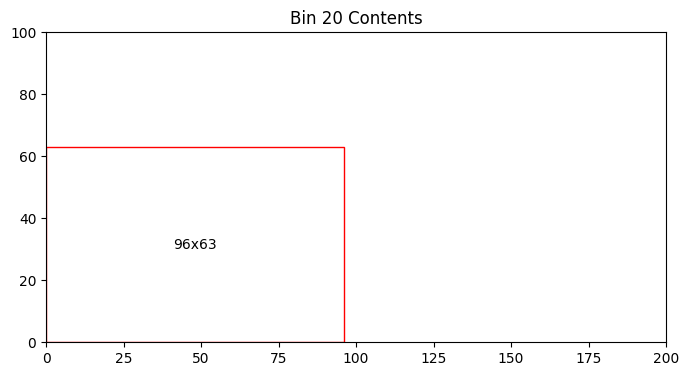

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


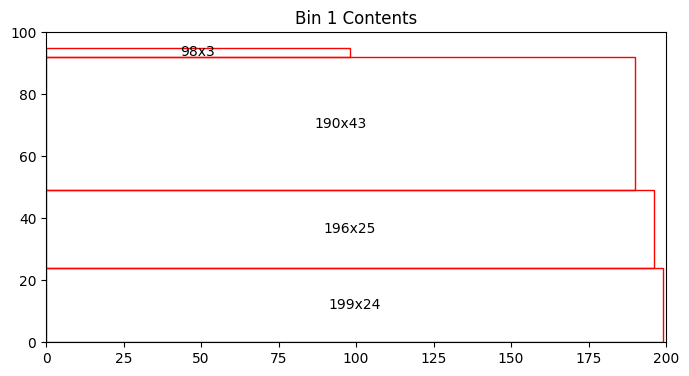

Bin 1 has 1860.00 units of area left


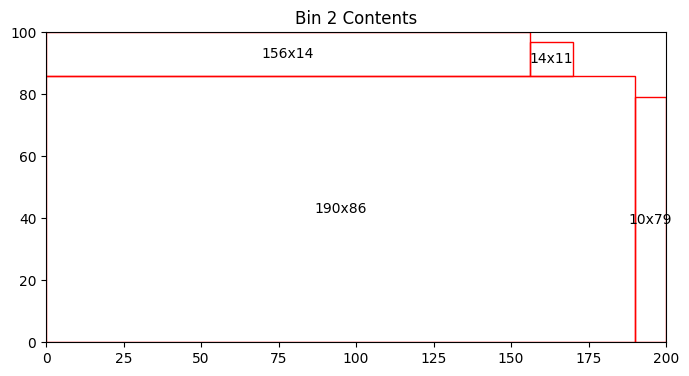

Bin 2 has 532.00 units of area left


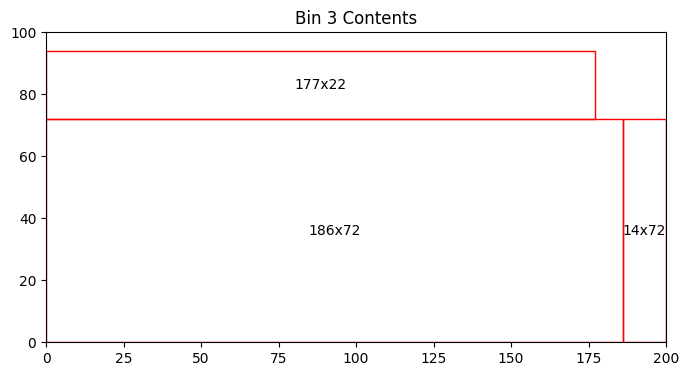

Bin 3 has 1706.00 units of area left


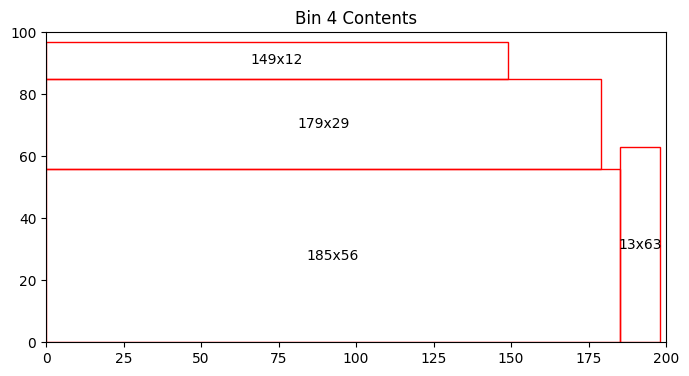

Bin 4 has 1842.00 units of area left


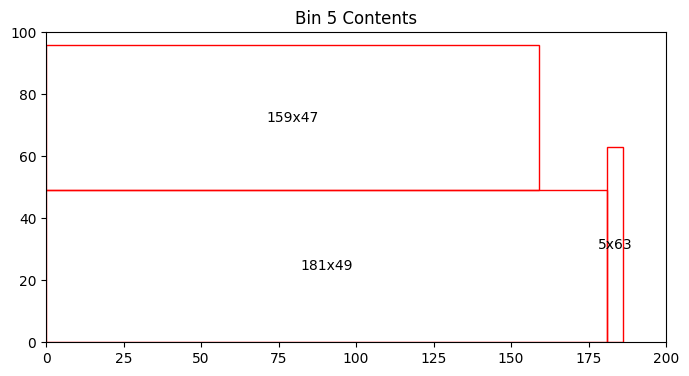

Bin 5 has 3343.00 units of area left


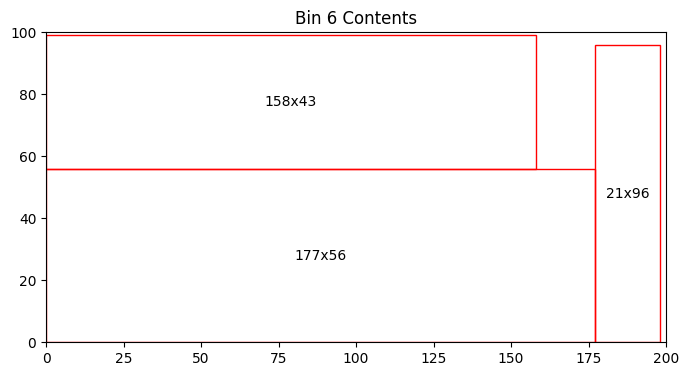

Bin 6 has 1278.00 units of area left


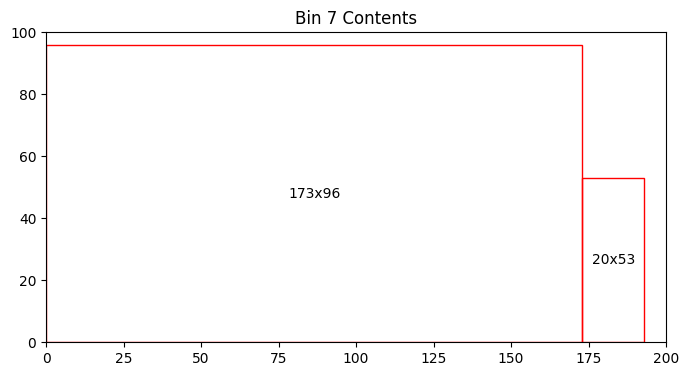

Bin 7 has 2332.00 units of area left


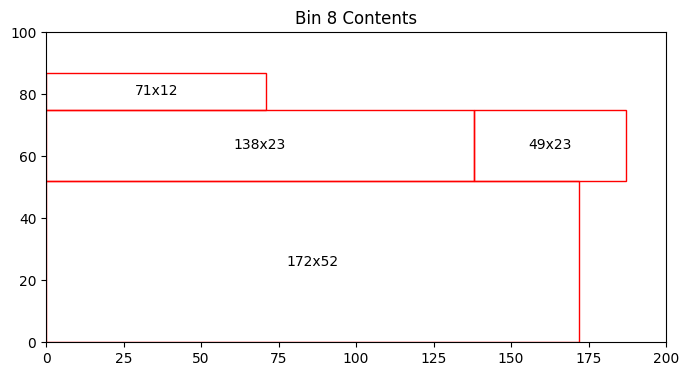

Bin 8 has 5903.00 units of area left


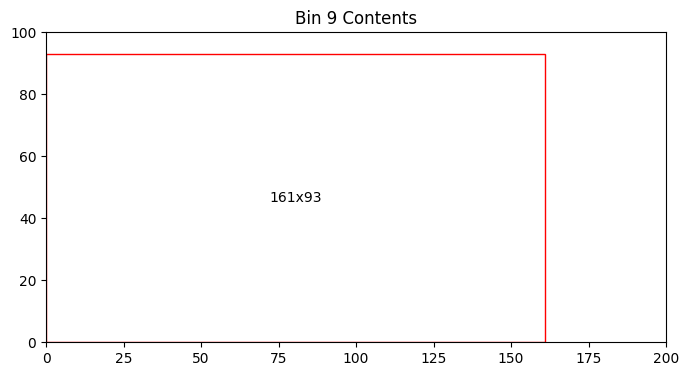

Bin 9 has 5027.00 units of area left


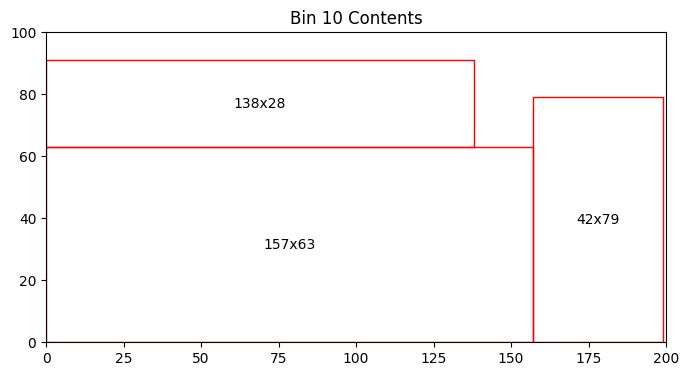

Bin 10 has 2927.00 units of area left


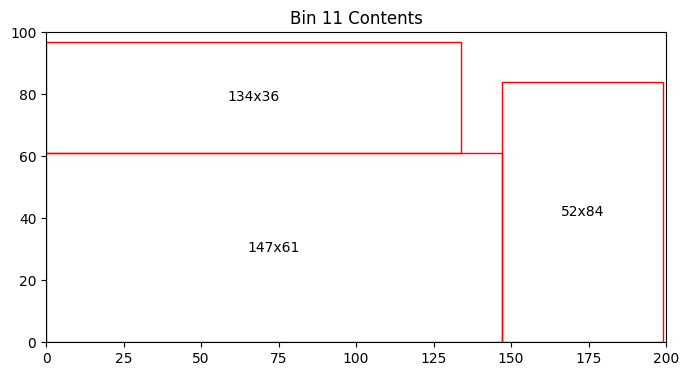

Bin 11 has 1841.00 units of area left


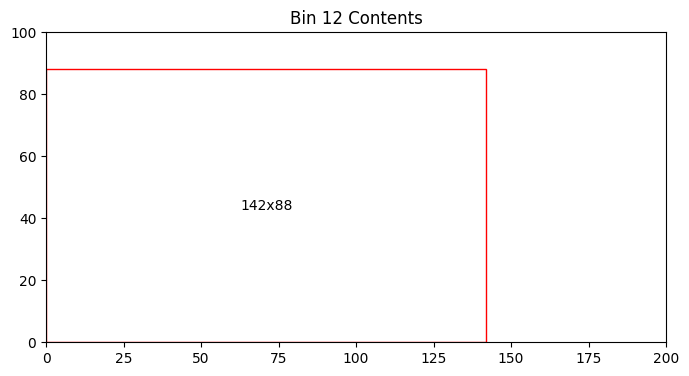

Bin 12 has 7504.00 units of area left


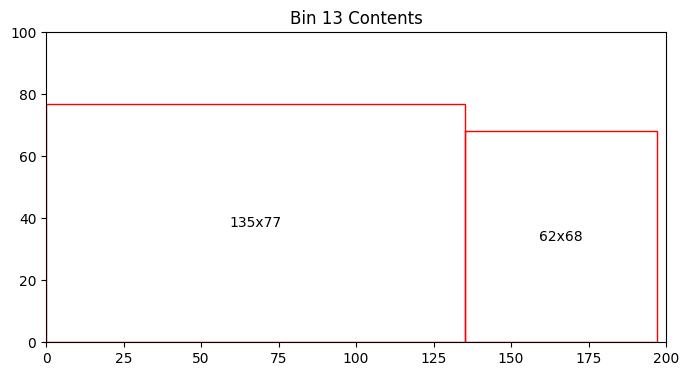

Bin 13 has 5389.00 units of area left


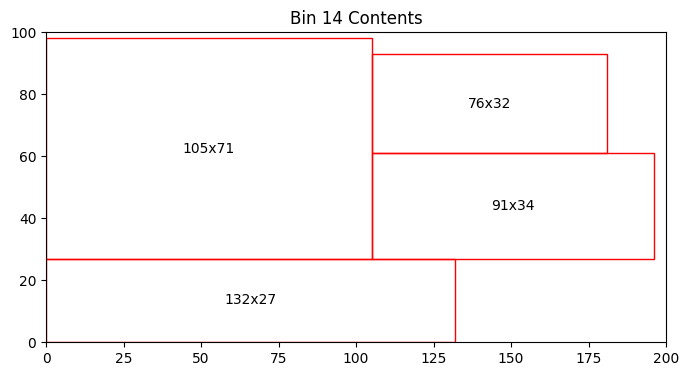

Bin 14 has 3455.00 units of area left


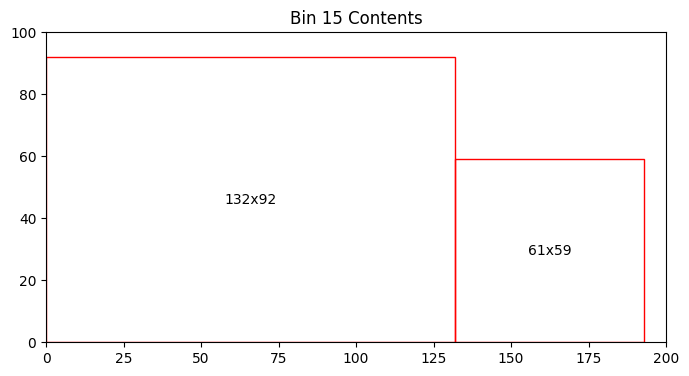

Bin 15 has 4257.00 units of area left


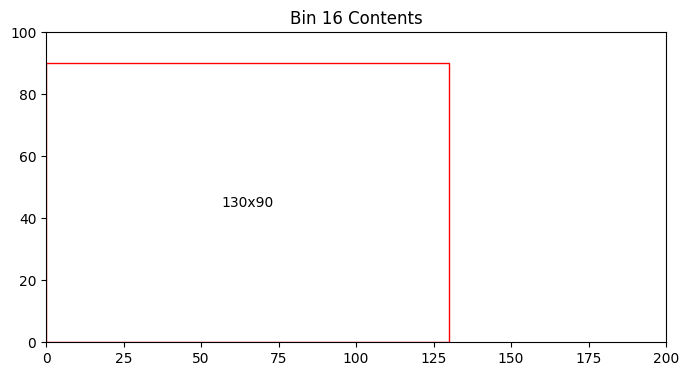

Bin 16 has 8300.00 units of area left


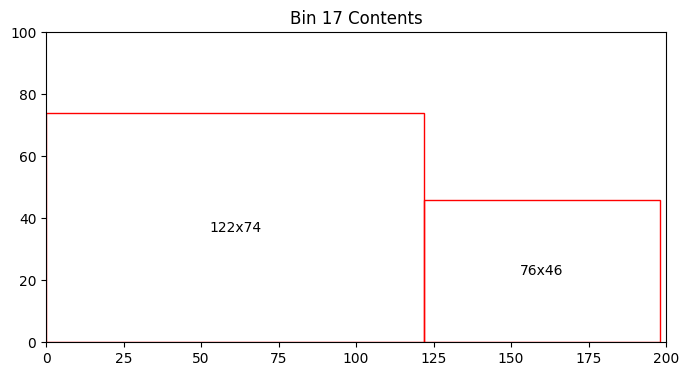

Bin 17 has 7476.00 units of area left


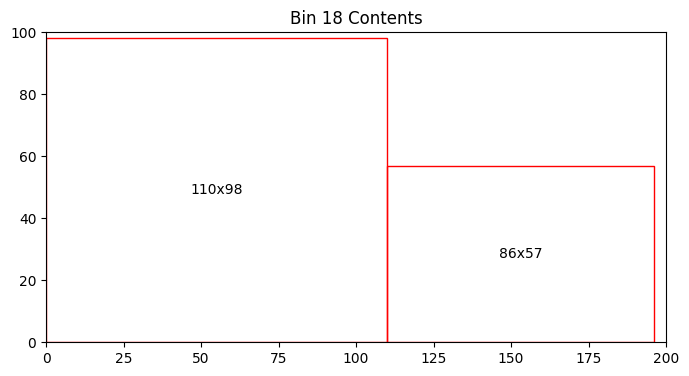

Bin 18 has 4318.00 units of area left


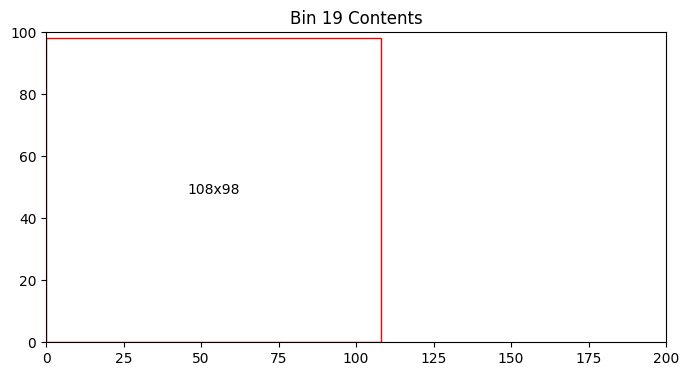

Bin 19 has 9416.00 units of area left


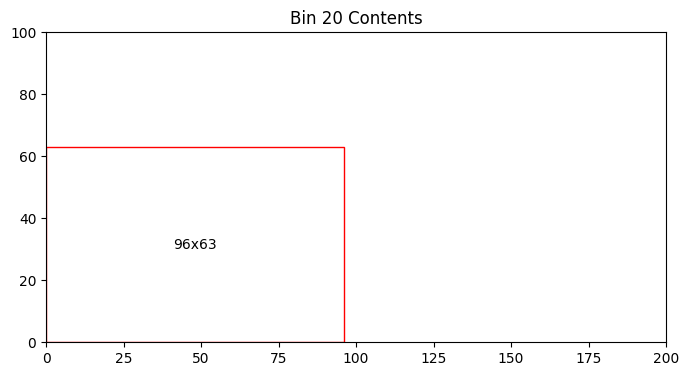

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


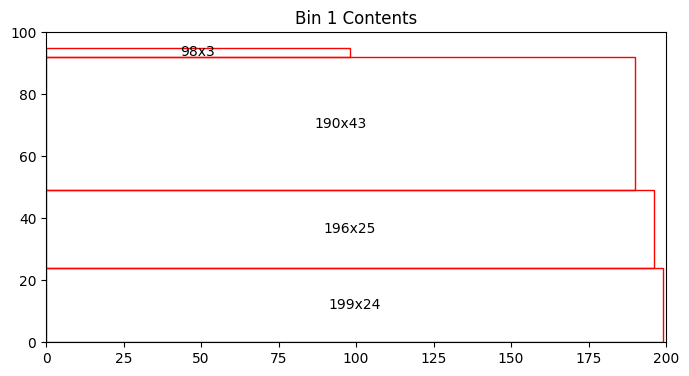

Bin 1 has 1860.00 units of area left


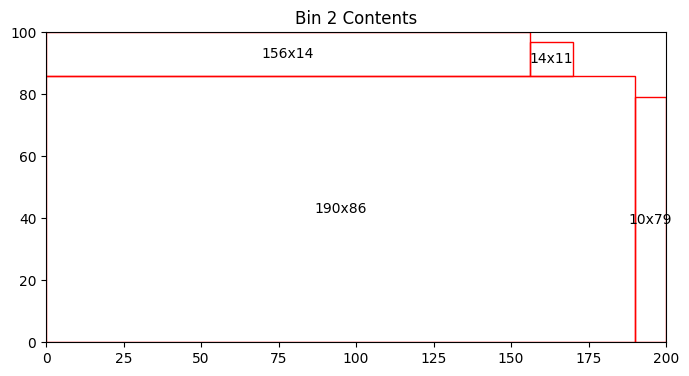

Bin 2 has 532.00 units of area left


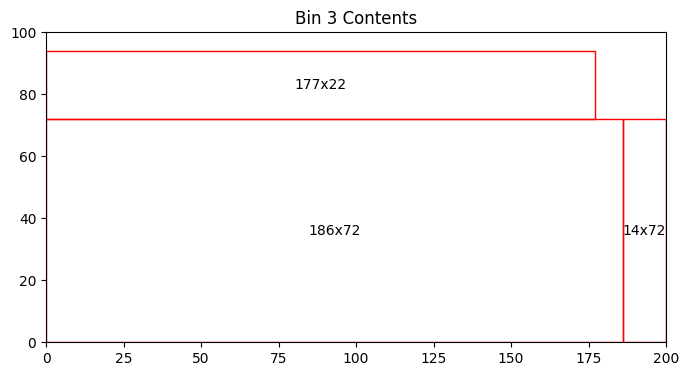

Bin 3 has 1706.00 units of area left


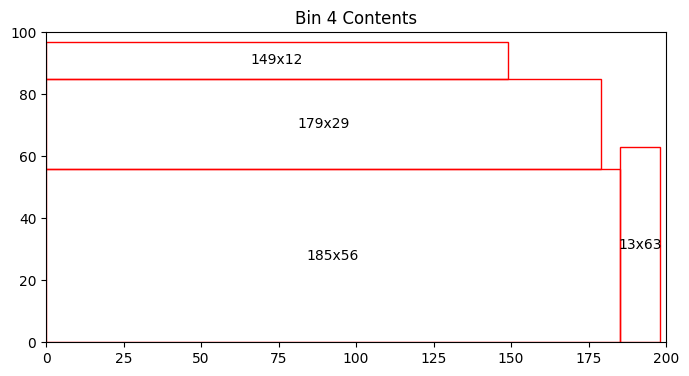

Bin 4 has 1842.00 units of area left


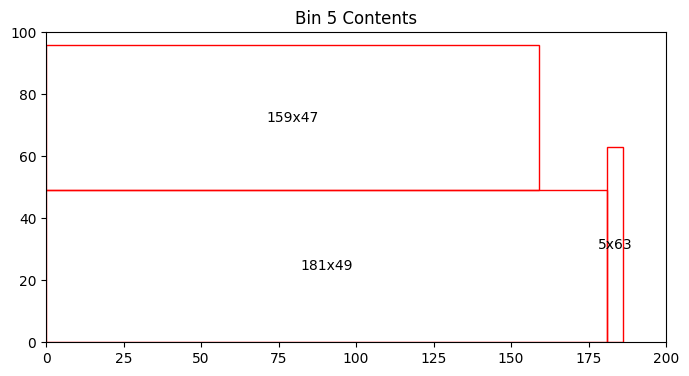

Bin 5 has 3343.00 units of area left


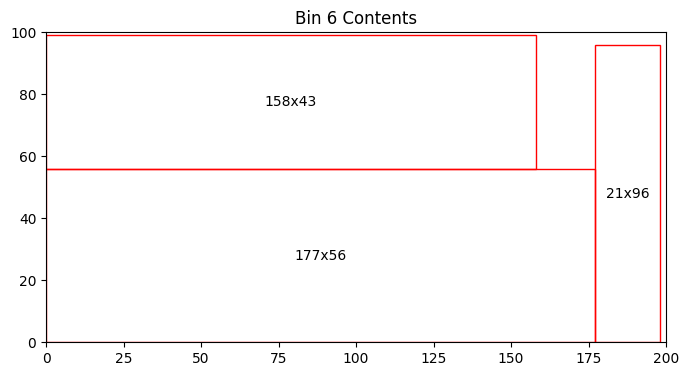

Bin 6 has 1278.00 units of area left


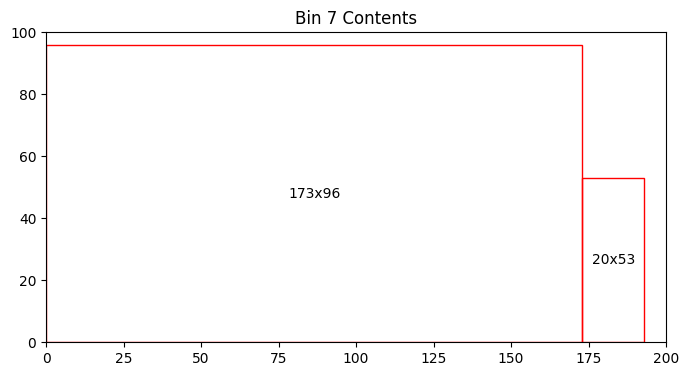

Bin 7 has 2332.00 units of area left


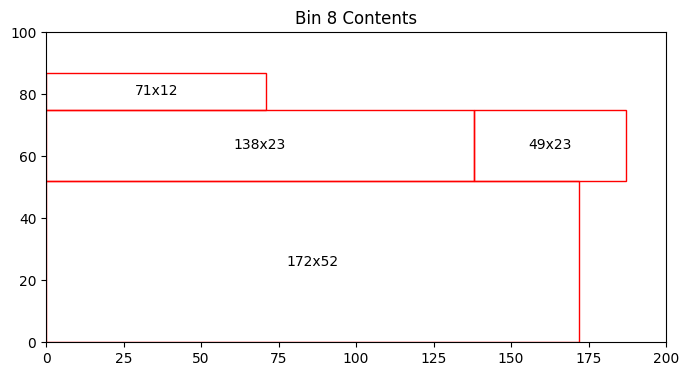

Bin 8 has 5903.00 units of area left


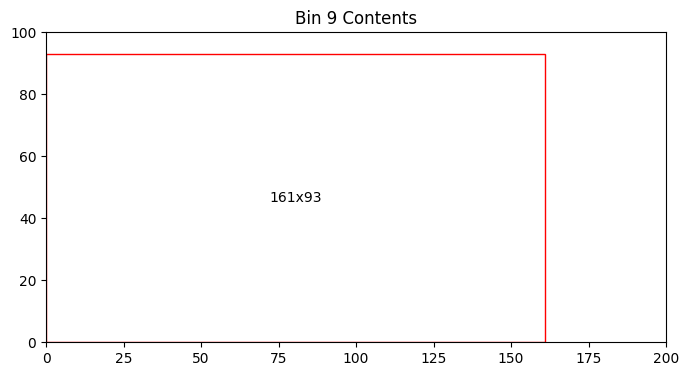

Bin 9 has 5027.00 units of area left


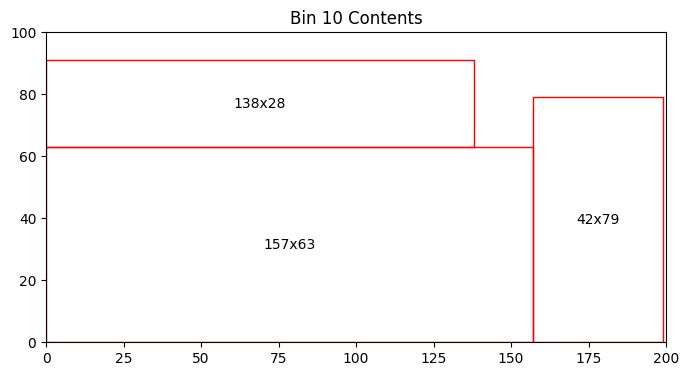

Bin 10 has 2927.00 units of area left


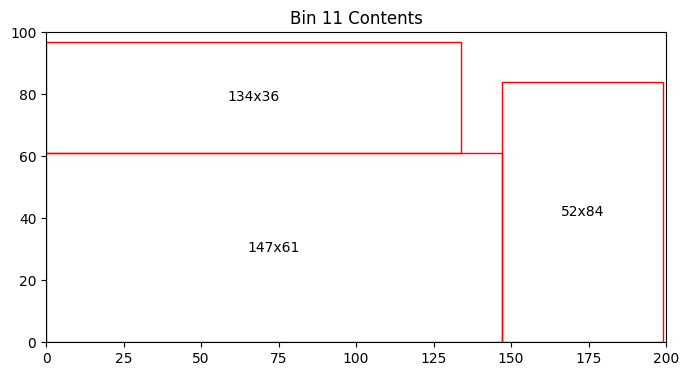

Bin 11 has 1841.00 units of area left


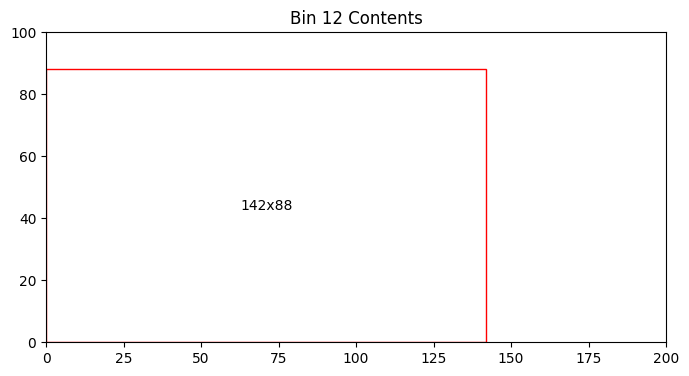

Bin 12 has 7504.00 units of area left


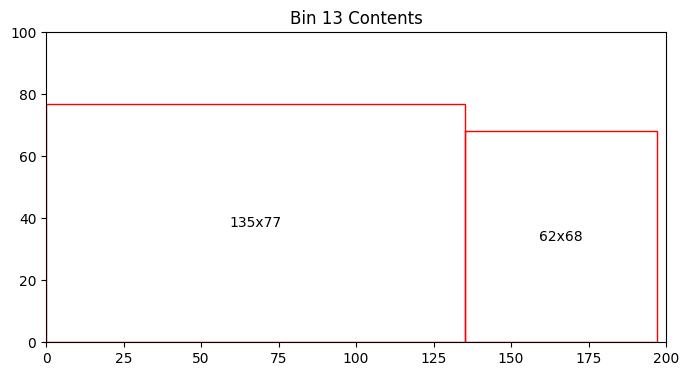

Bin 13 has 5389.00 units of area left


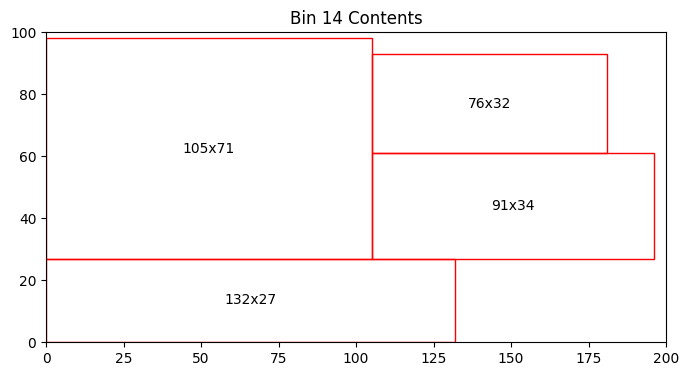

Bin 14 has 3455.00 units of area left


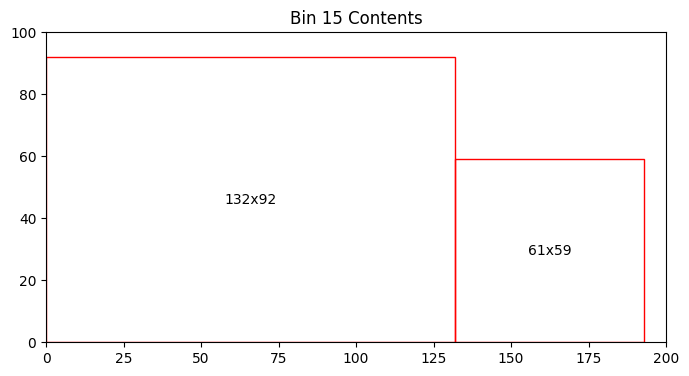

Bin 15 has 4257.00 units of area left


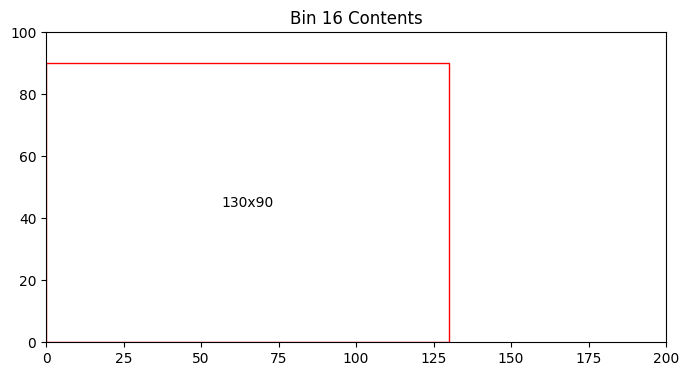

Bin 16 has 8300.00 units of area left


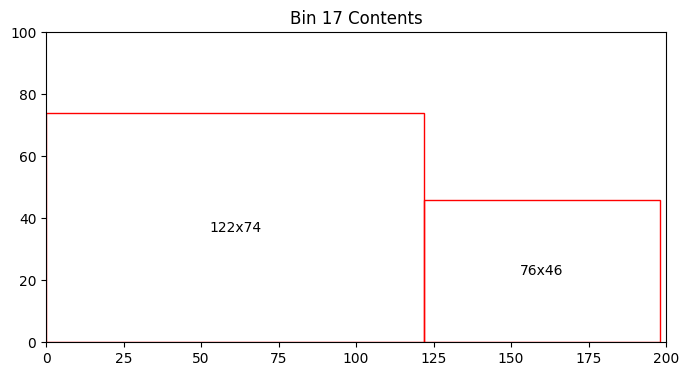

Bin 17 has 7476.00 units of area left


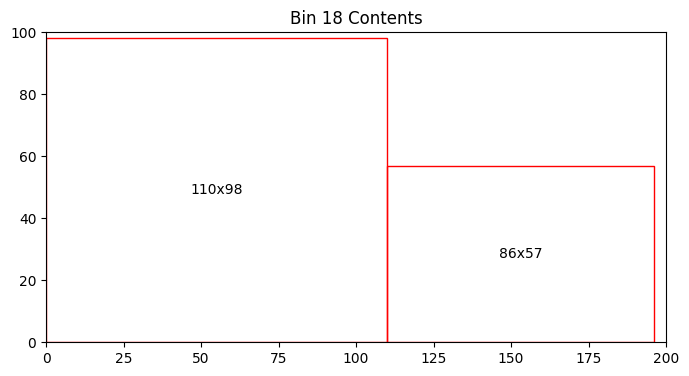

Bin 18 has 4318.00 units of area left


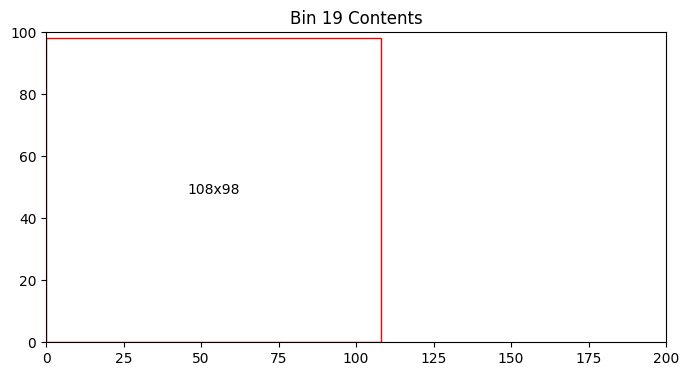

Bin 19 has 9416.00 units of area left


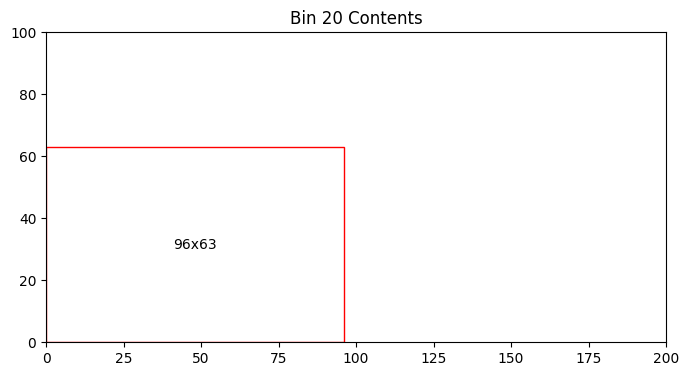

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


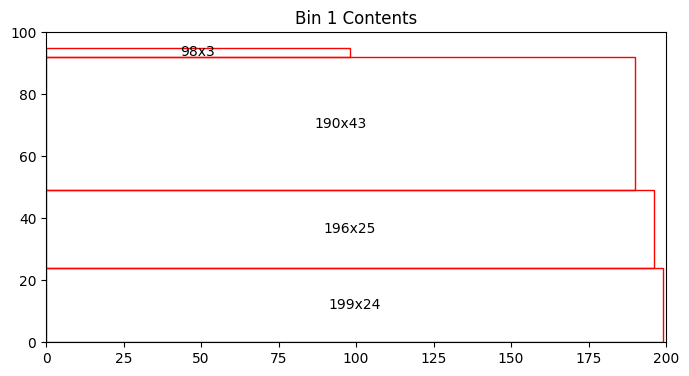

Bin 1 has 1860.00 units of area left


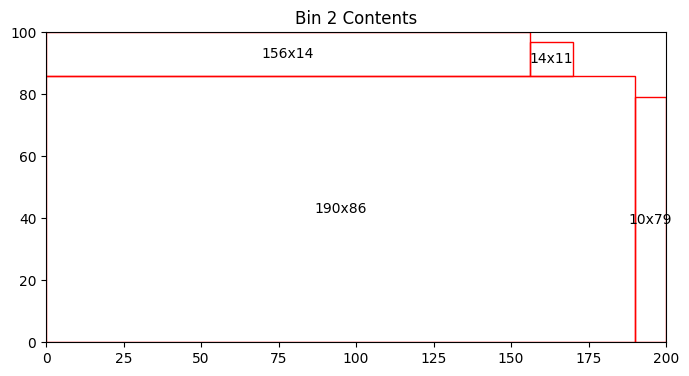

Bin 2 has 532.00 units of area left


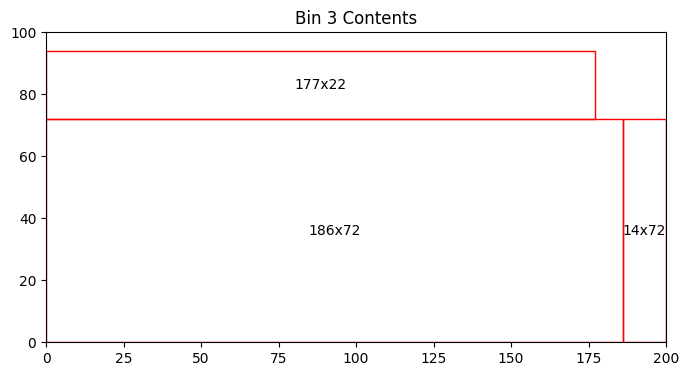

Bin 3 has 1706.00 units of area left


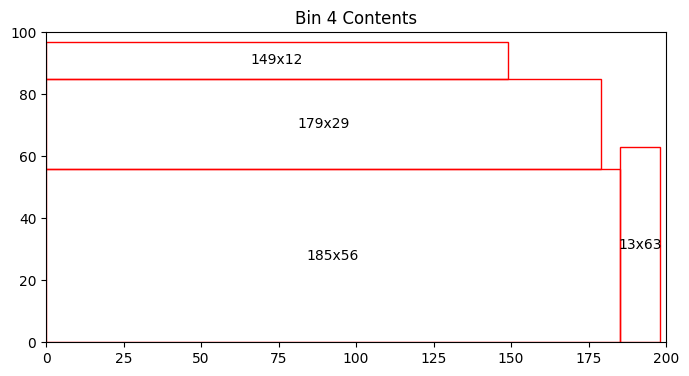

Bin 4 has 1842.00 units of area left


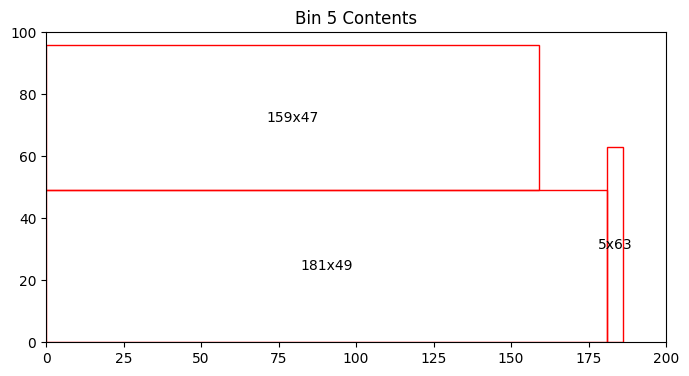

Bin 5 has 3343.00 units of area left


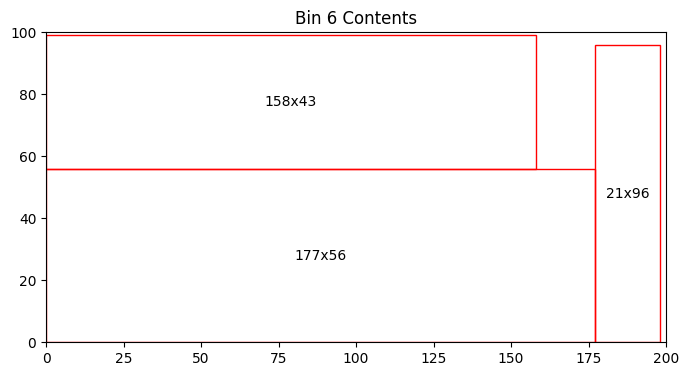

Bin 6 has 1278.00 units of area left


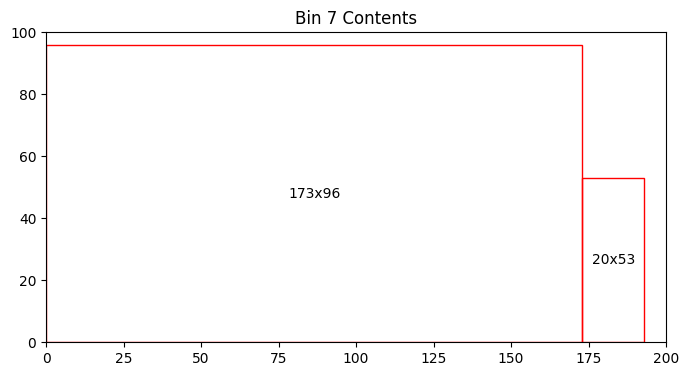

Bin 7 has 2332.00 units of area left


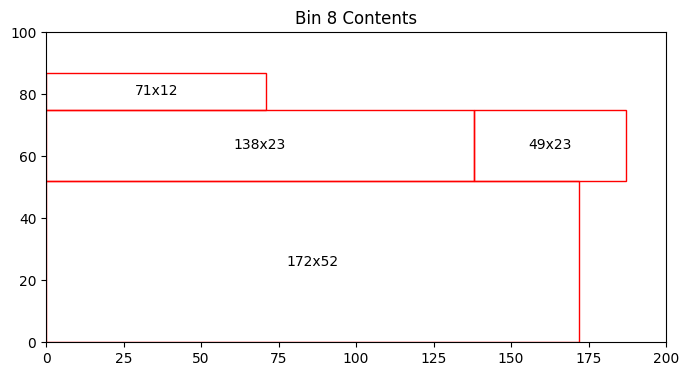

Bin 8 has 5903.00 units of area left


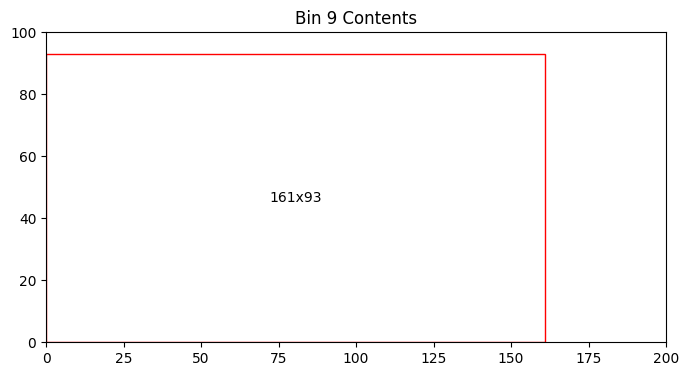

Bin 9 has 5027.00 units of area left


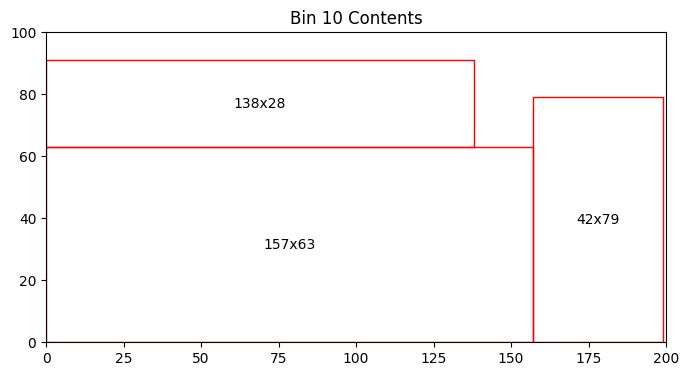

Bin 10 has 2927.00 units of area left


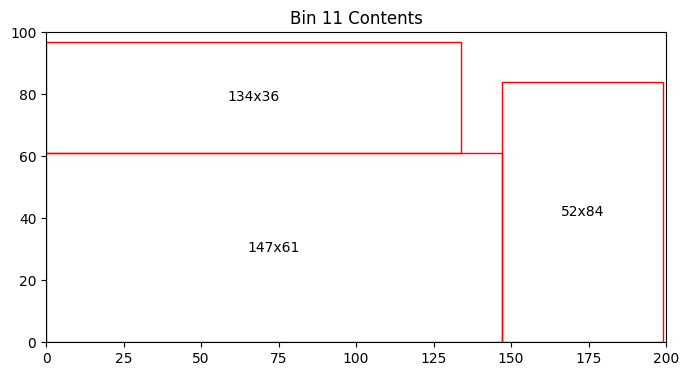

Bin 11 has 1841.00 units of area left


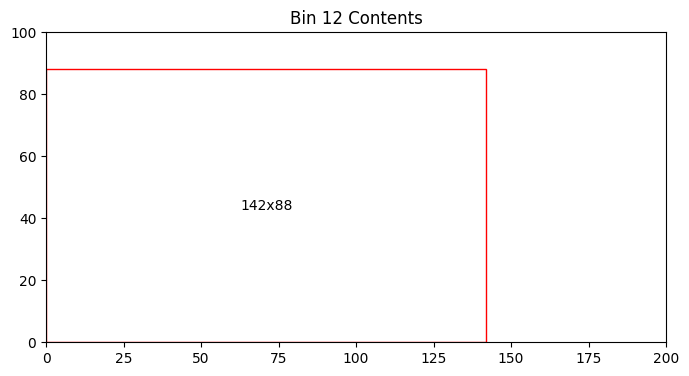

Bin 12 has 7504.00 units of area left


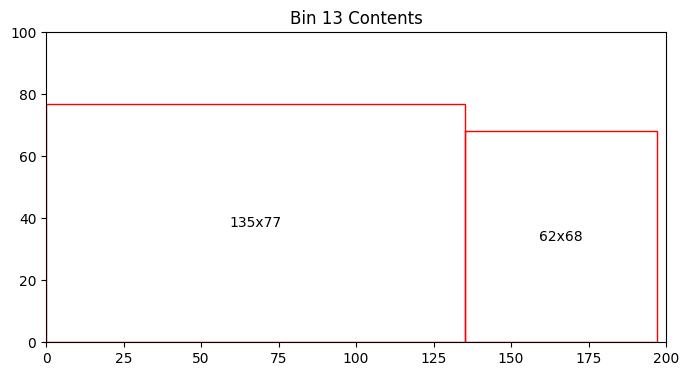

Bin 13 has 5389.00 units of area left


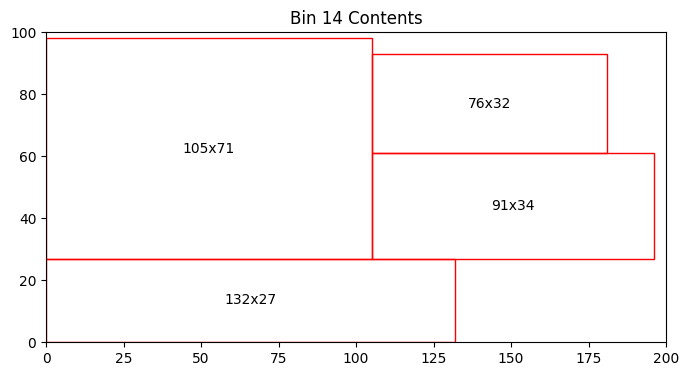

Bin 14 has 3455.00 units of area left


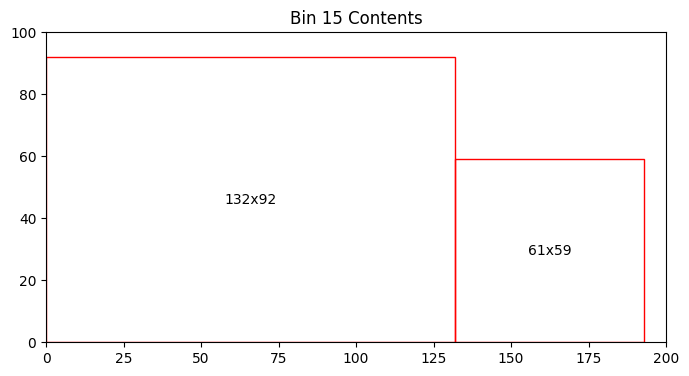

Bin 15 has 4257.00 units of area left


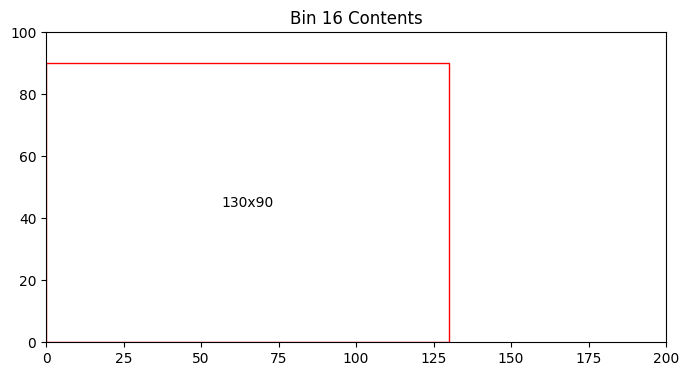

Bin 16 has 8300.00 units of area left


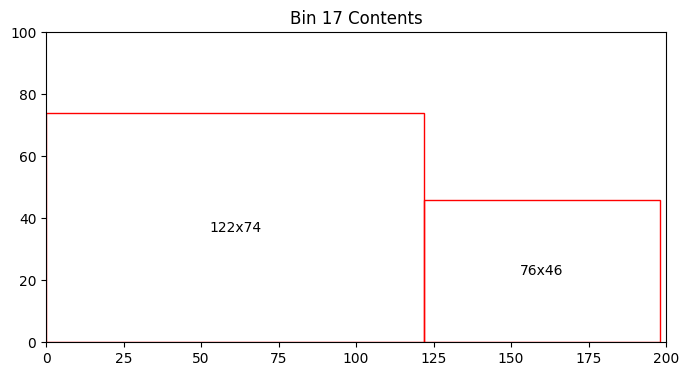

Bin 17 has 7476.00 units of area left


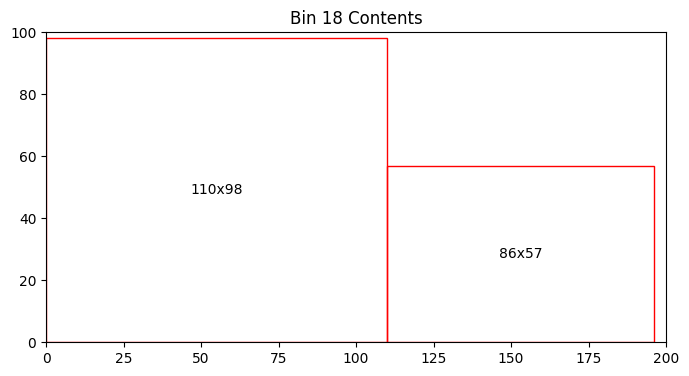

Bin 18 has 4318.00 units of area left


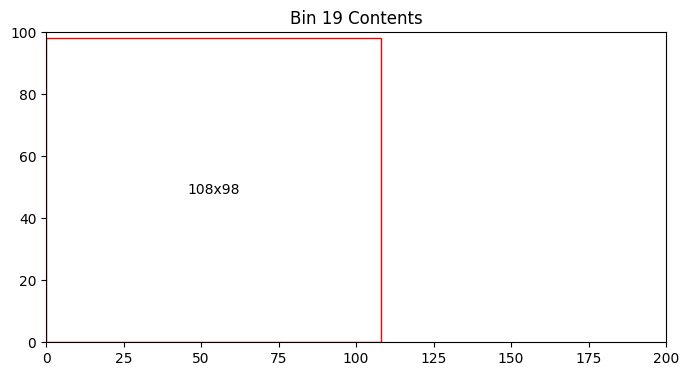

Bin 19 has 9416.00 units of area left


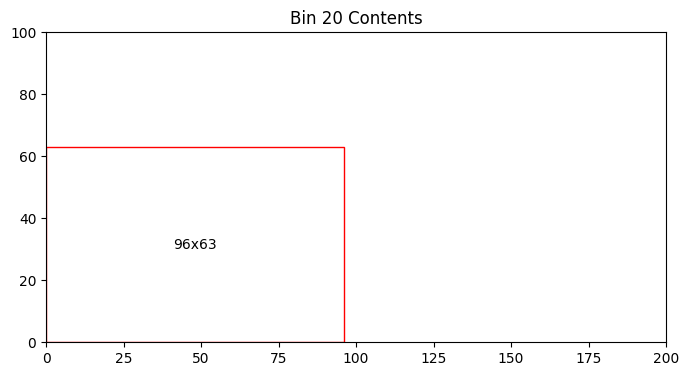

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[159  47]
 [161  93]
 [135  77]
 [199  24]
 [190  86]
 [147  61]
 [157  63]
 [130  90]
 [108  98]
 [132  27]
 [185  56]
 [138  23]
 [173  96]
 [142  88]
 [ 76  46]
 [105  71]
 [158  43]
 [138  28]
 [134  36]
 [ 62  68]
 [132  92]
 [196  25]
 [110  98]
 [ 13  63]
 [ 61  59]
 [181  49]
 [ 20  53]
 [156  14]
 [177  22]
 [ 98   3]
 [ 21  96]
 [ 76  32]
 [ 10  79]
 [ 91  34]
 [ 86  57]
 [ 71  12]
 [ 14  72]
 [  5  63]
 [179  29]
 [172  52]
 [122  74]
 [ 42  79]
 [149  12]
 [ 49  23]
 [ 14  11]
 [177  56]
 [ 52  84]
 [190  43]
 [ 96  63]
 [186  72]]


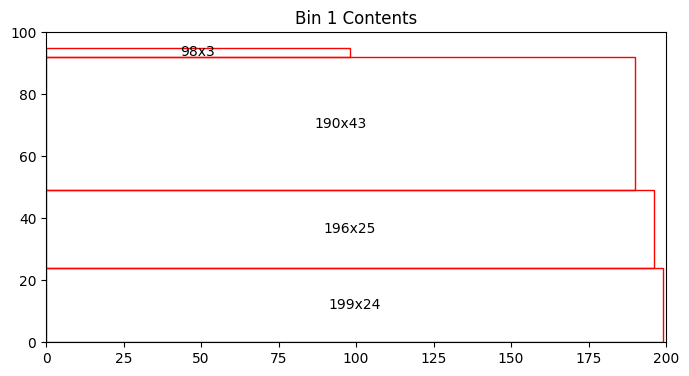

Bin 1 has 1860.00 units of area left


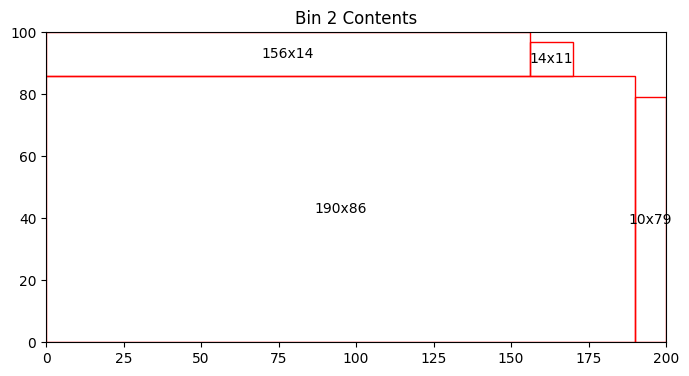

Bin 2 has 532.00 units of area left


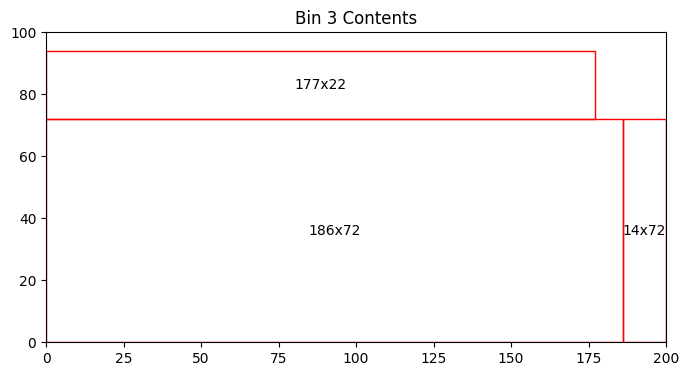

Bin 3 has 1706.00 units of area left


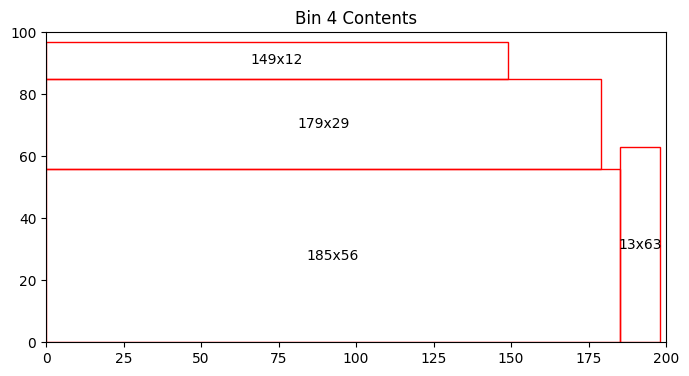

Bin 4 has 1842.00 units of area left


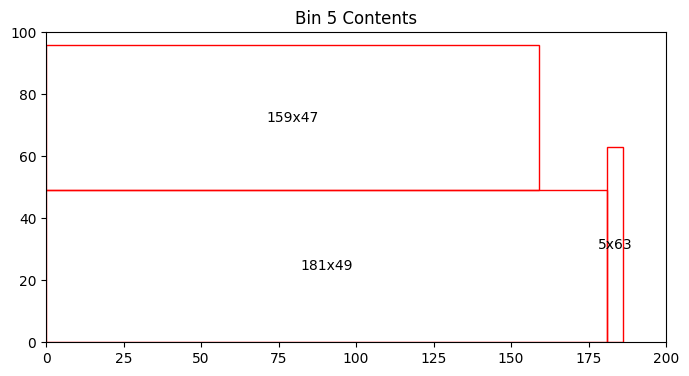

Bin 5 has 3343.00 units of area left


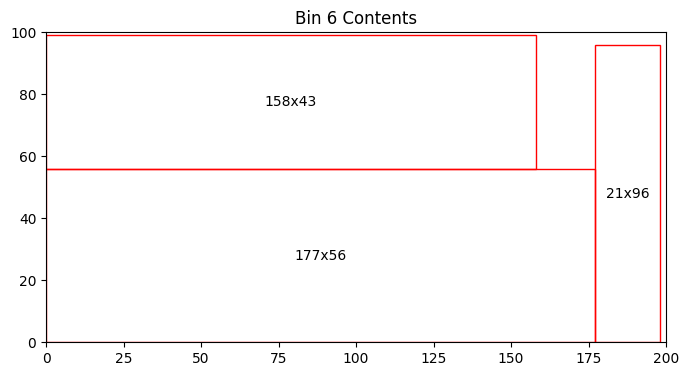

Bin 6 has 1278.00 units of area left


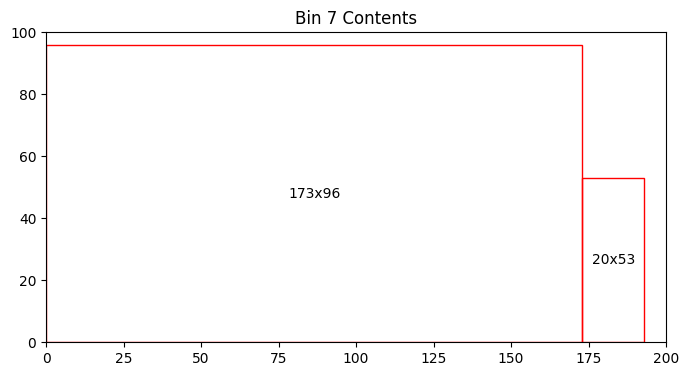

Bin 7 has 2332.00 units of area left


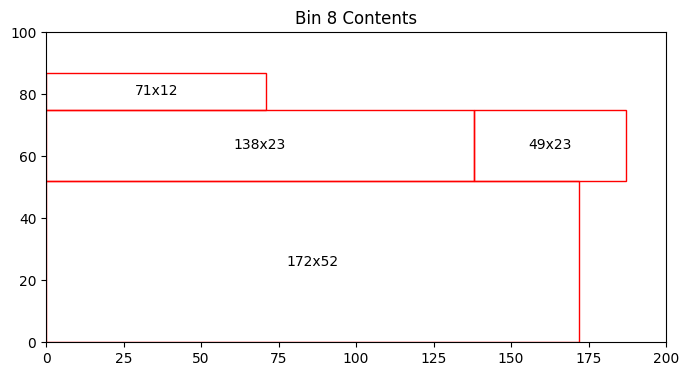

Bin 8 has 5903.00 units of area left


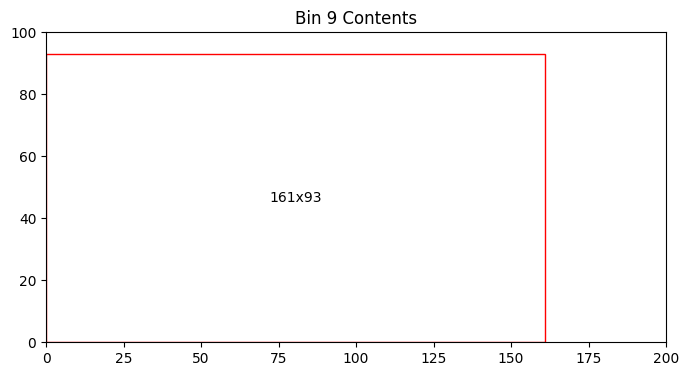

Bin 9 has 5027.00 units of area left


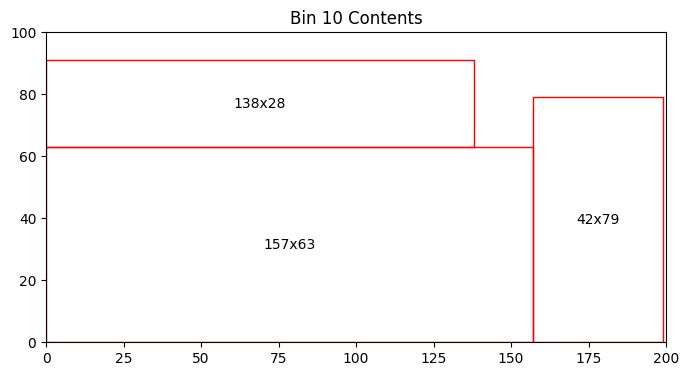

Bin 10 has 2927.00 units of area left


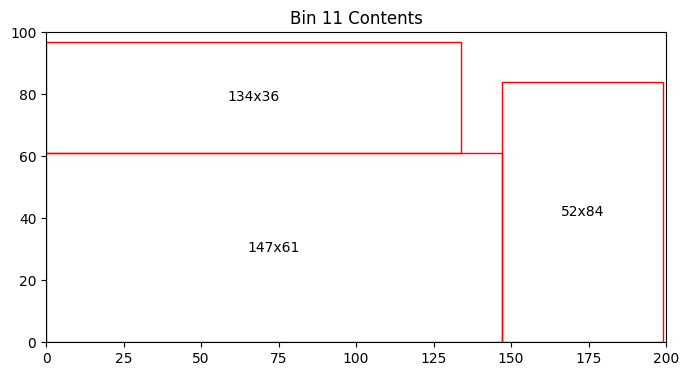

Bin 11 has 1841.00 units of area left


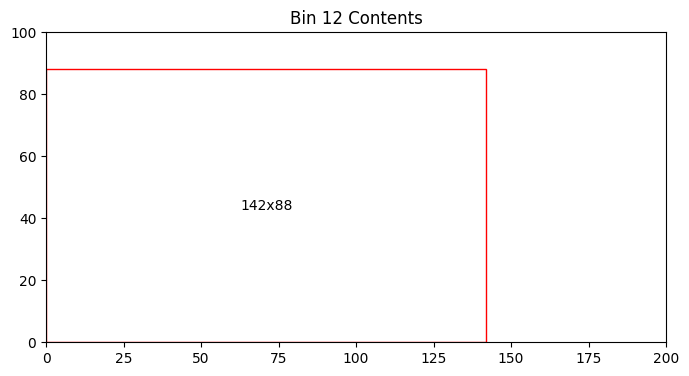

Bin 12 has 7504.00 units of area left


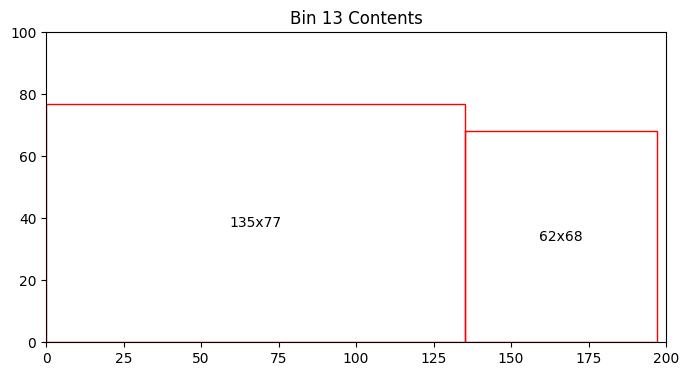

Bin 13 has 5389.00 units of area left


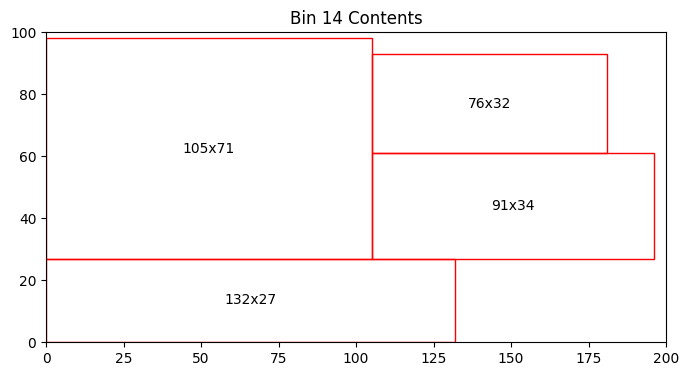

Bin 14 has 3455.00 units of area left


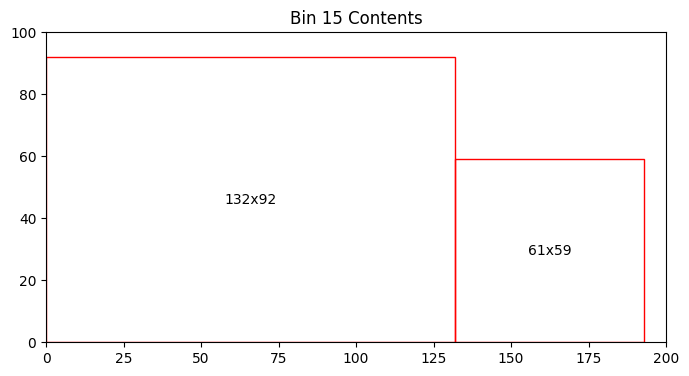

Bin 15 has 4257.00 units of area left


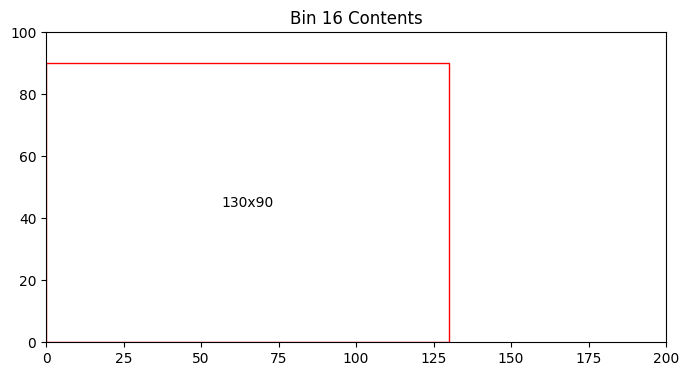

Bin 16 has 8300.00 units of area left


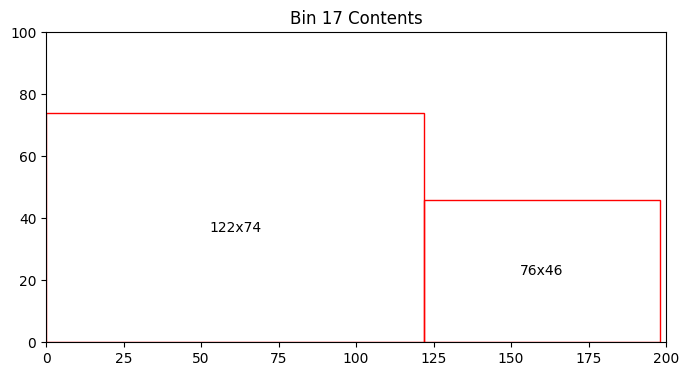

Bin 17 has 7476.00 units of area left


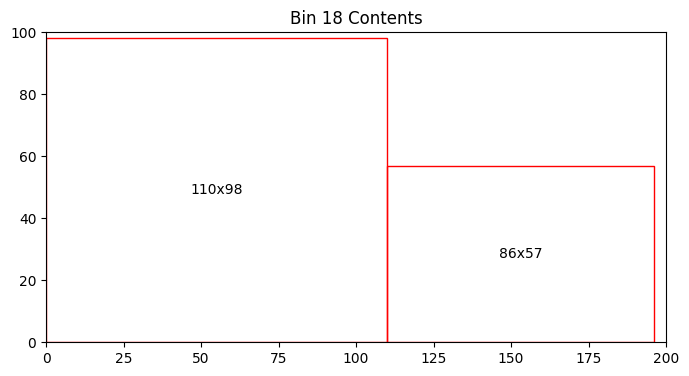

Bin 18 has 4318.00 units of area left


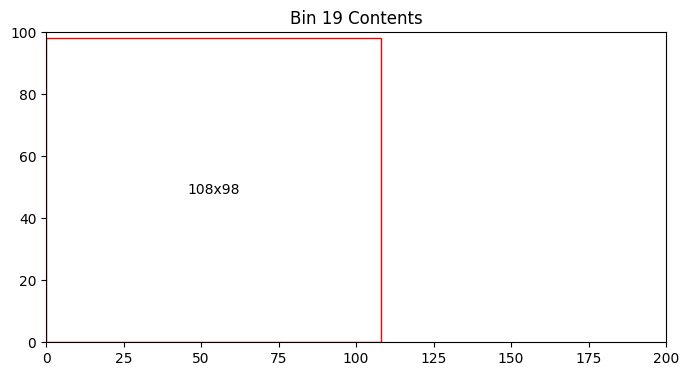

Bin 19 has 9416.00 units of area left


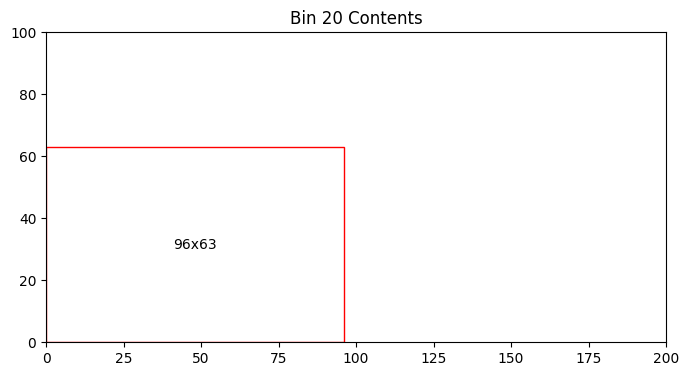

Bin 20 has 13952.00 units of area left
Total number of bins = 20
Total area left in bins = 92658.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


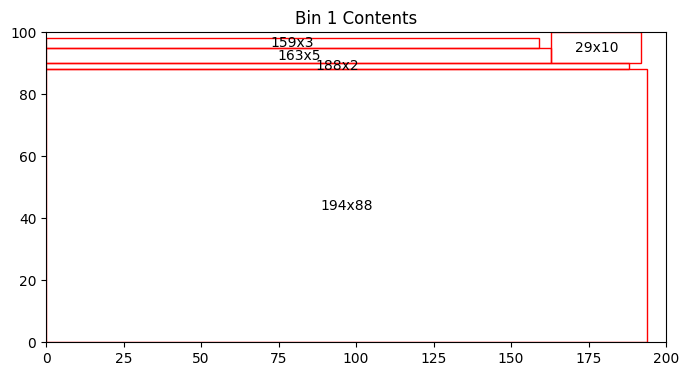

Bin 1 has 970.00 units of area left


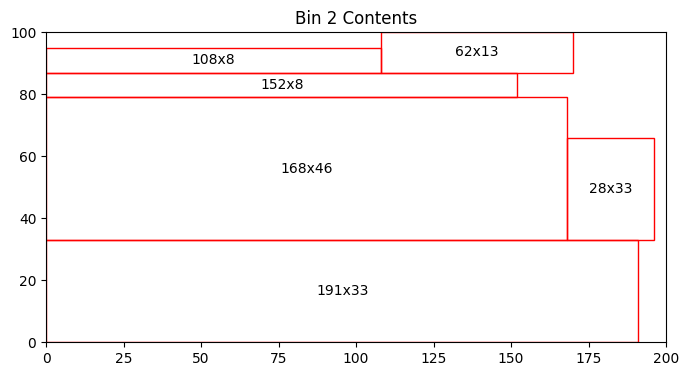

Bin 2 has 2159.00 units of area left


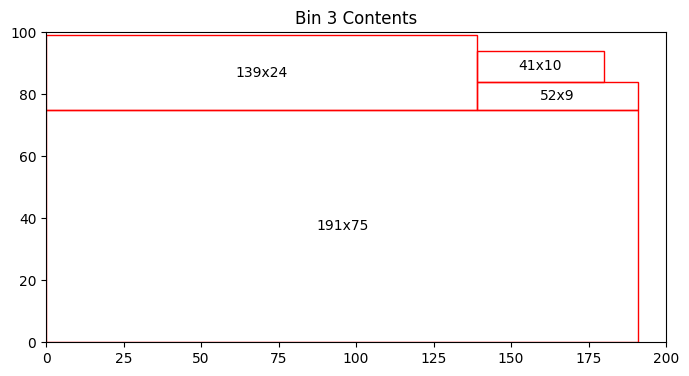

Bin 3 has 1461.00 units of area left


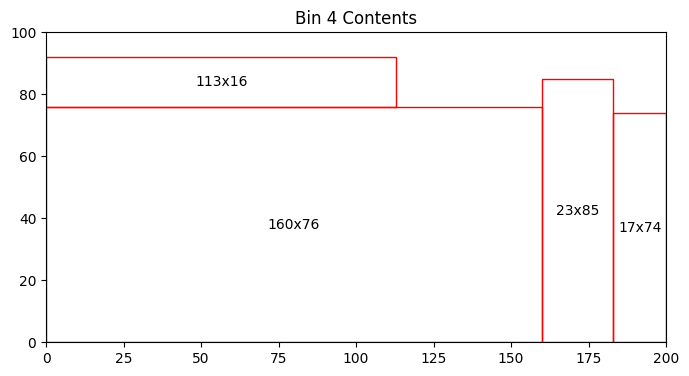

Bin 4 has 2819.00 units of area left


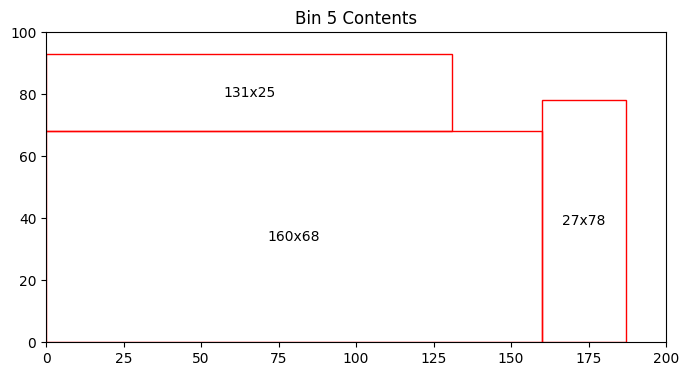

Bin 5 has 3739.00 units of area left


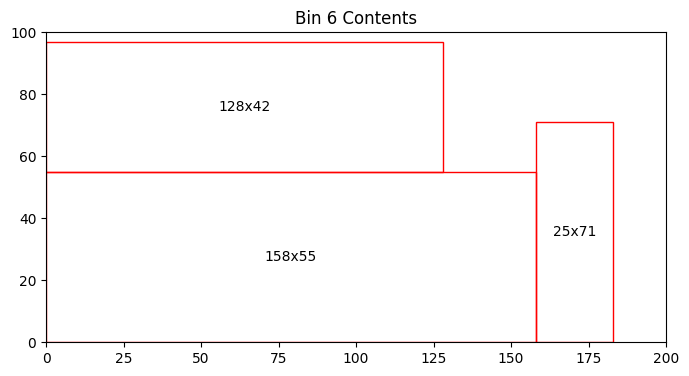

Bin 6 has 4159.00 units of area left


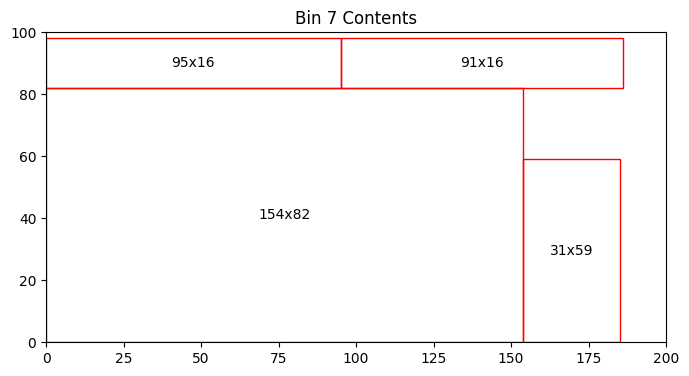

Bin 7 has 2567.00 units of area left


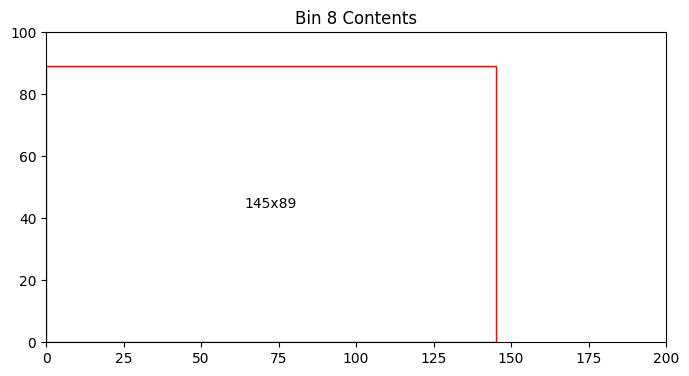

Bin 8 has 7095.00 units of area left


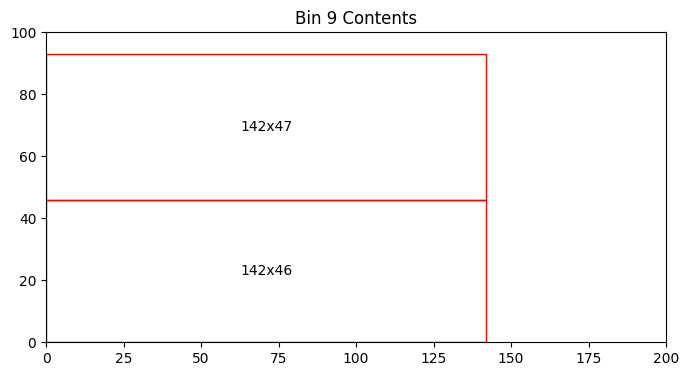

Bin 9 has 6794.00 units of area left


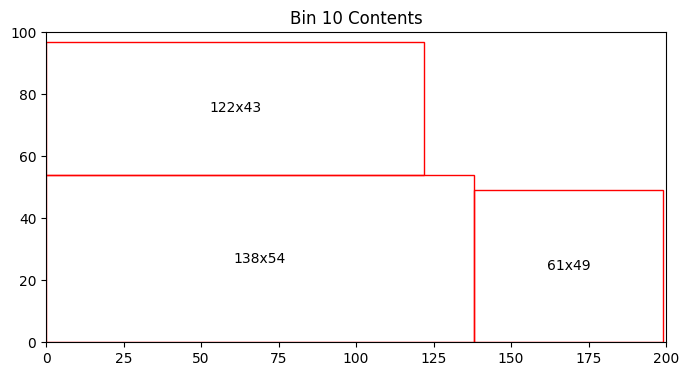

Bin 10 has 4313.00 units of area left


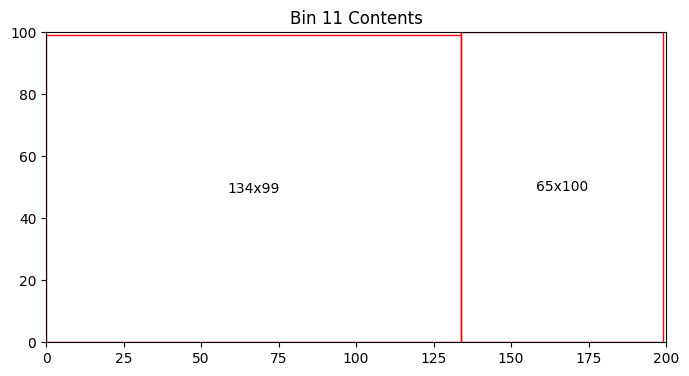

Bin 11 has 234.00 units of area left


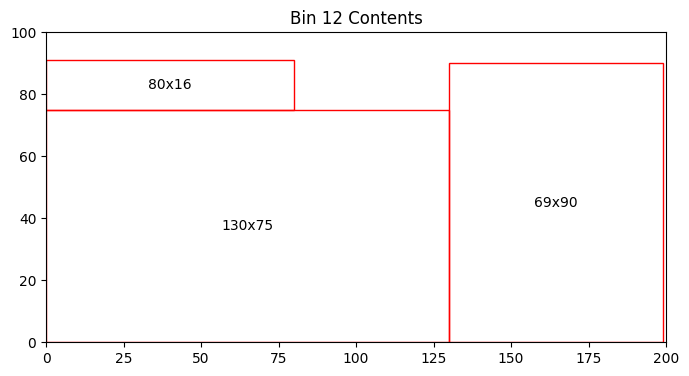

Bin 12 has 2760.00 units of area left


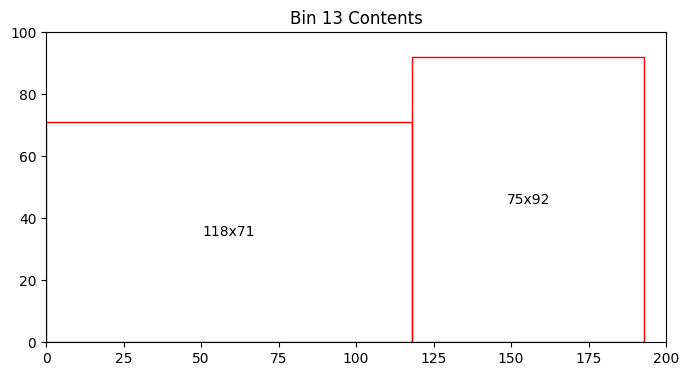

Bin 13 has 4722.00 units of area left


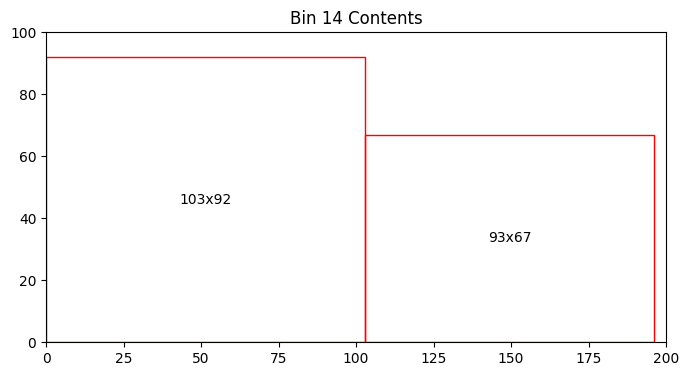

Bin 14 has 4293.00 units of area left


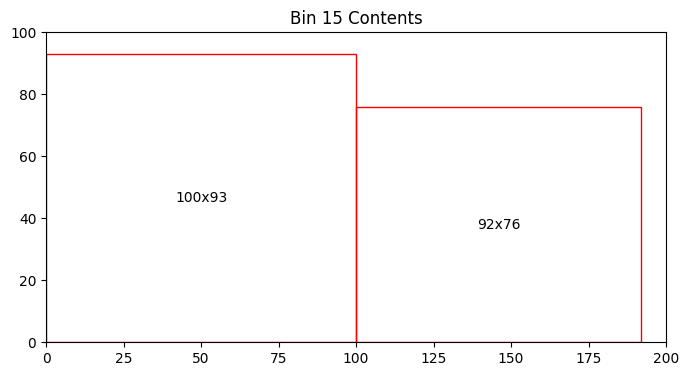

Bin 15 has 3708.00 units of area left


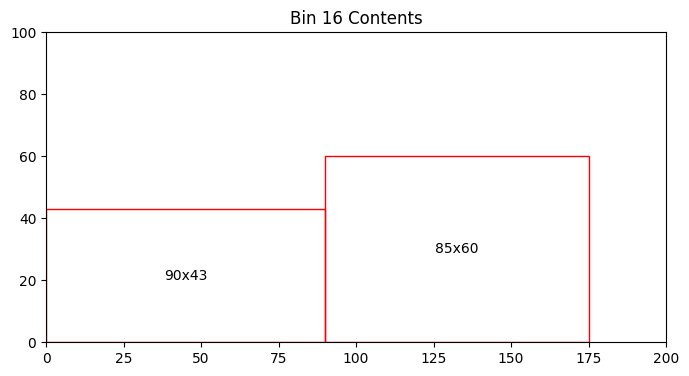

Bin 16 has 11030.00 units of area left


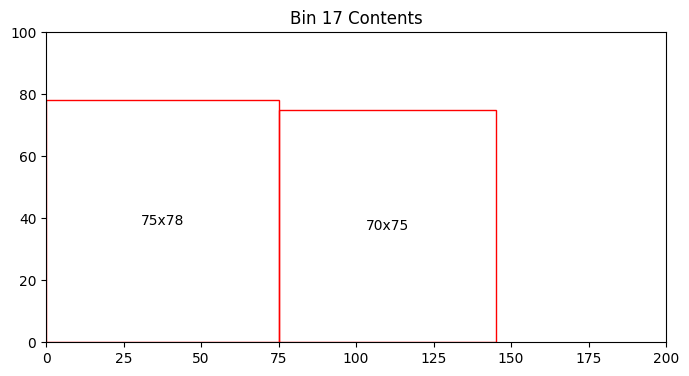

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


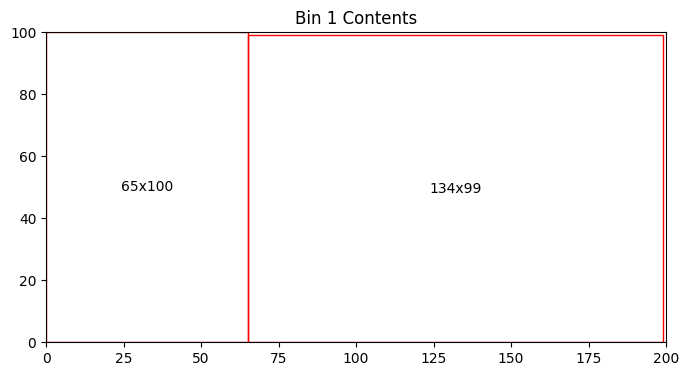

Bin 1 has 234.00 units of area left


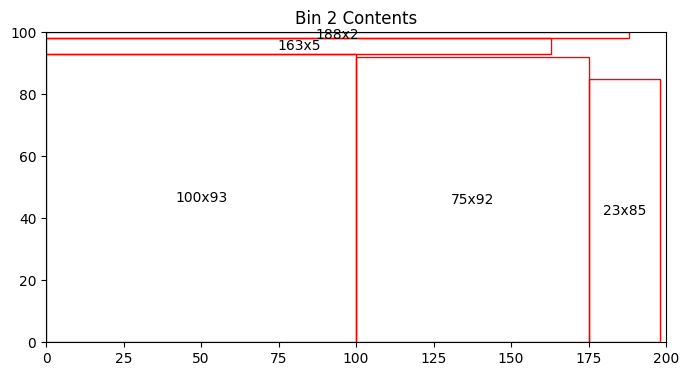

Bin 2 has 654.00 units of area left


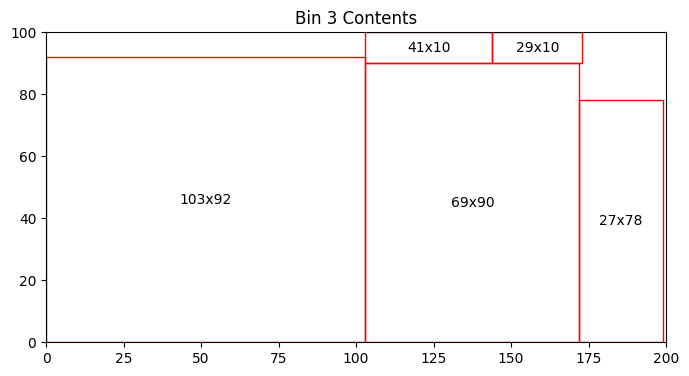

Bin 3 has 1508.00 units of area left


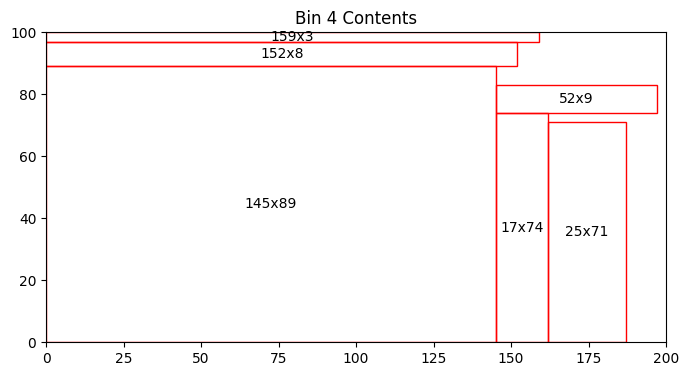

Bin 4 has 1901.00 units of area left


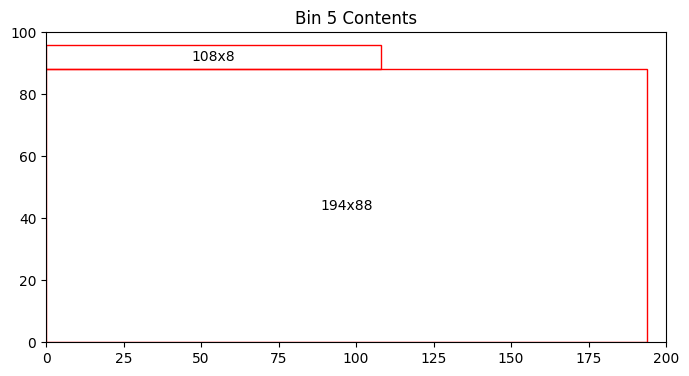

Bin 5 has 2064.00 units of area left


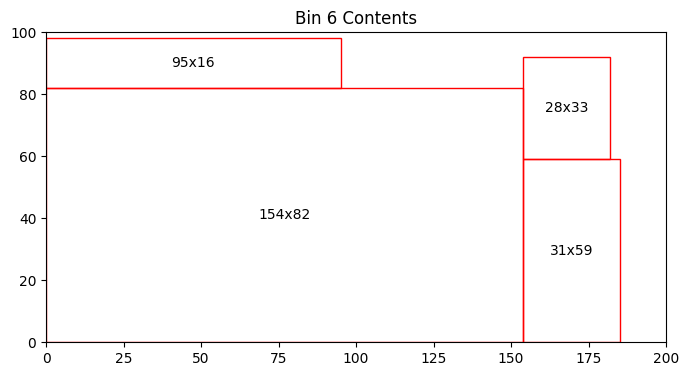

Bin 6 has 3099.00 units of area left


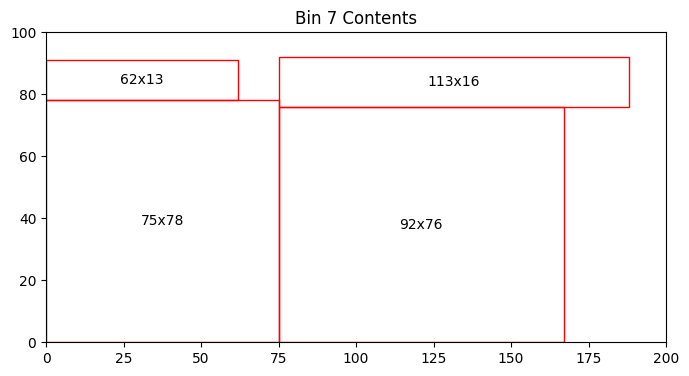

Bin 7 has 4544.00 units of area left


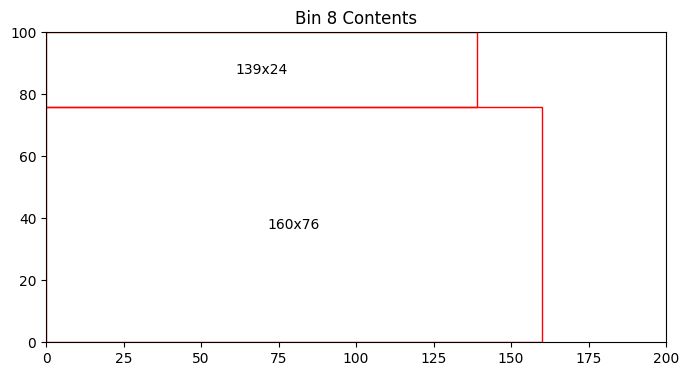

Bin 8 has 4504.00 units of area left


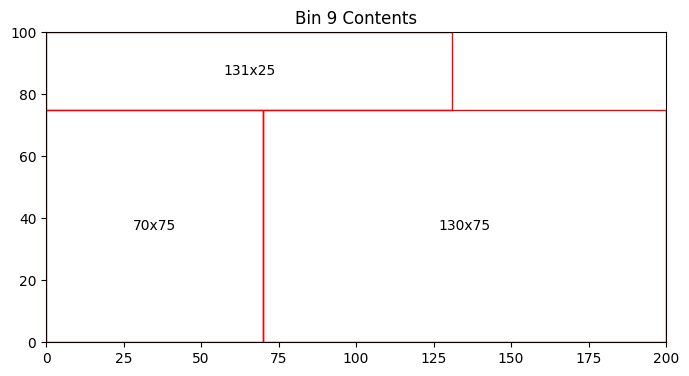

Bin 9 has 1725.00 units of area left


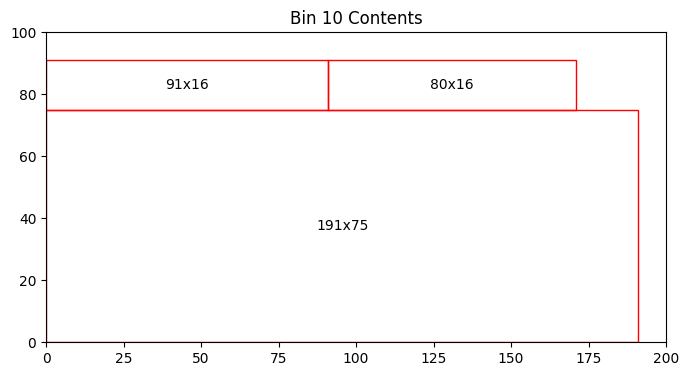

Bin 10 has 2939.00 units of area left


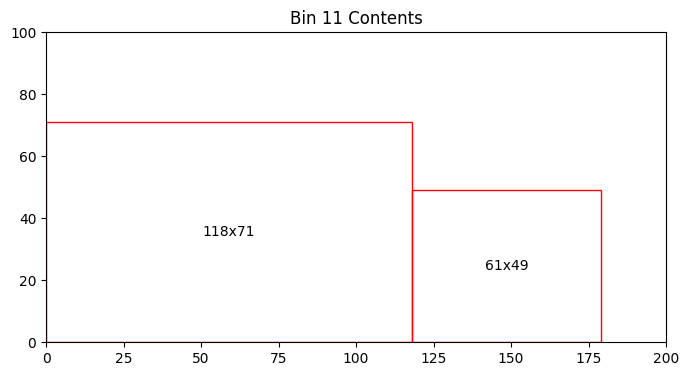

Bin 11 has 8633.00 units of area left


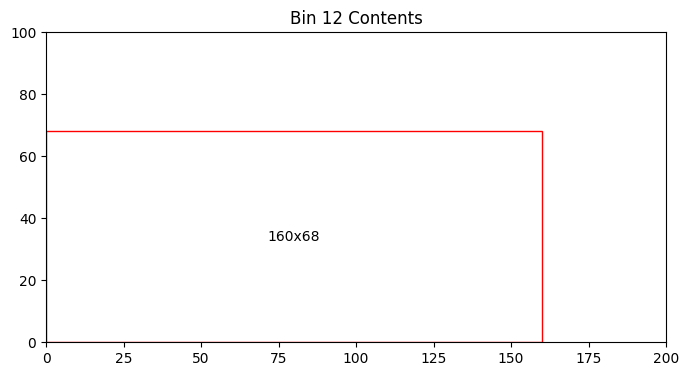

Bin 12 has 9120.00 units of area left


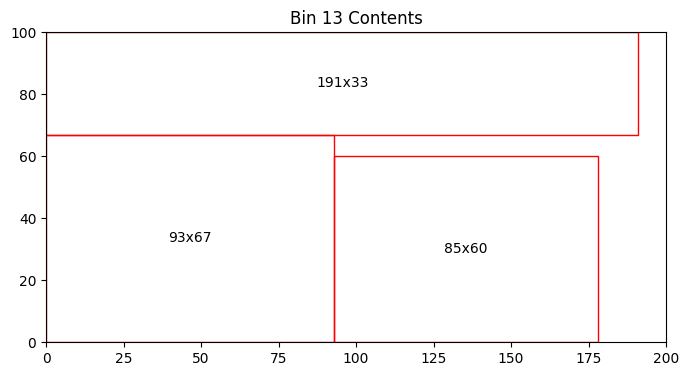

Bin 13 has 2366.00 units of area left


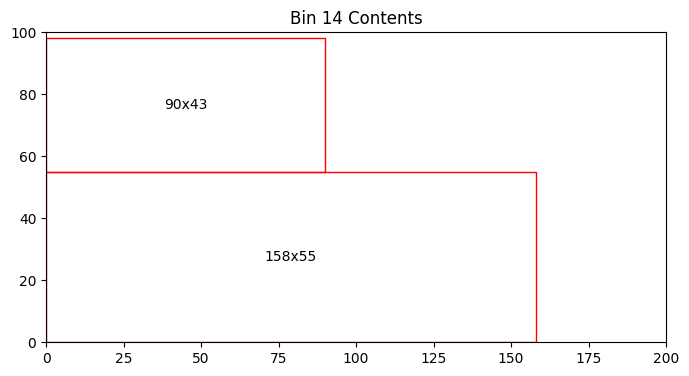

Bin 14 has 7440.00 units of area left


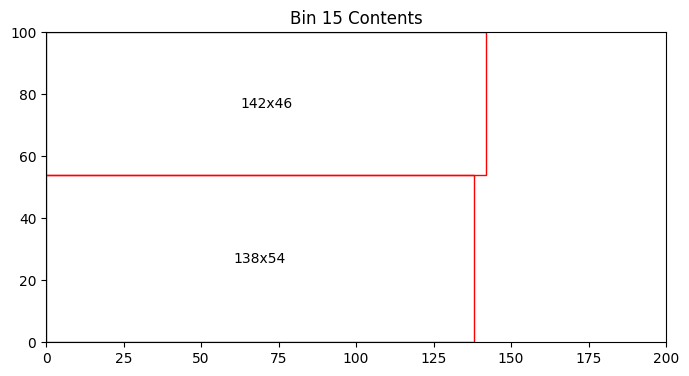

Bin 15 has 6016.00 units of area left


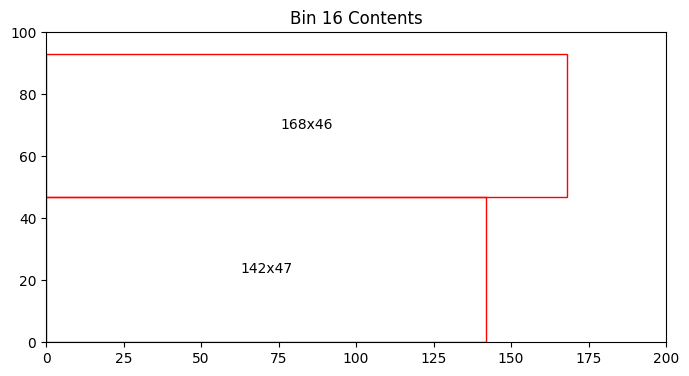

Bin 16 has 5598.00 units of area left


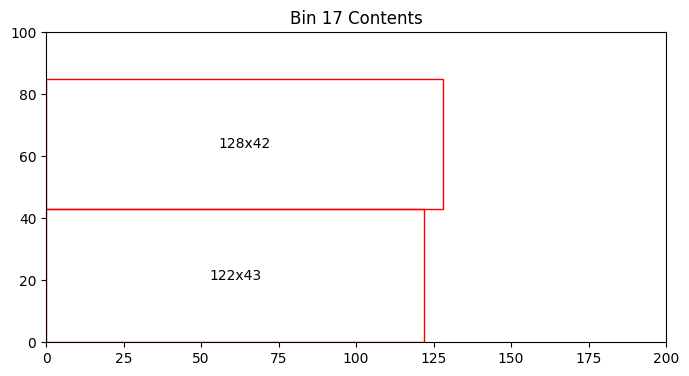

Bin 17 has 9378.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


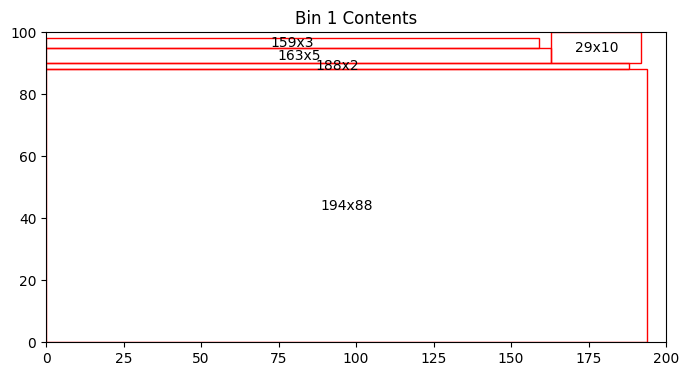

Bin 1 has 970.00 units of area left


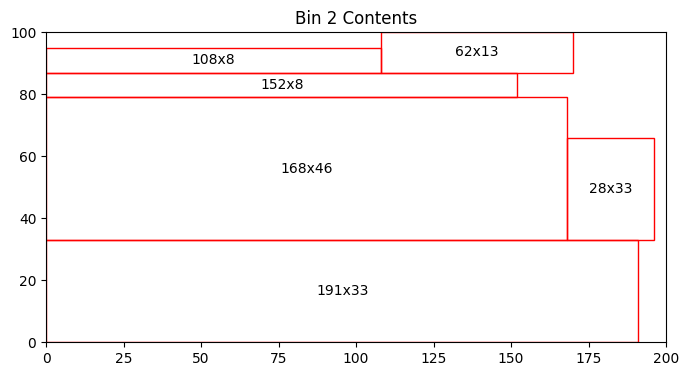

Bin 2 has 2159.00 units of area left


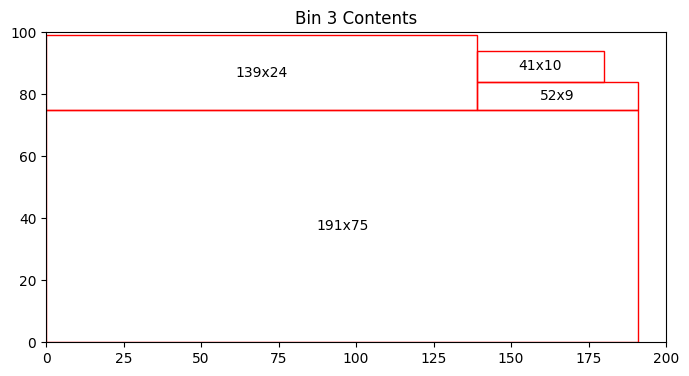

Bin 3 has 1461.00 units of area left


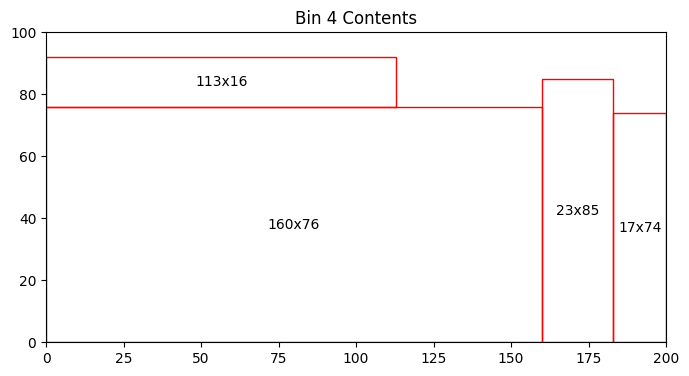

Bin 4 has 2819.00 units of area left


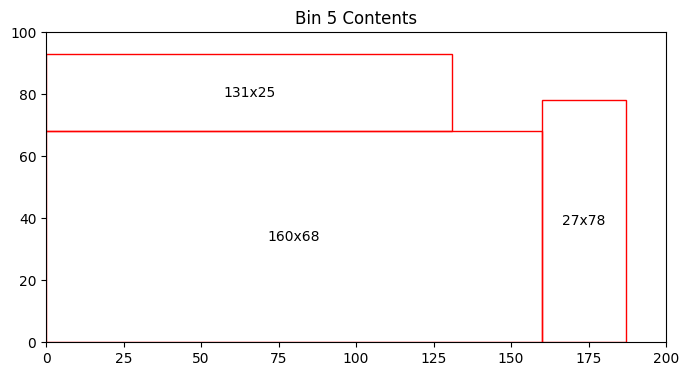

Bin 5 has 3739.00 units of area left


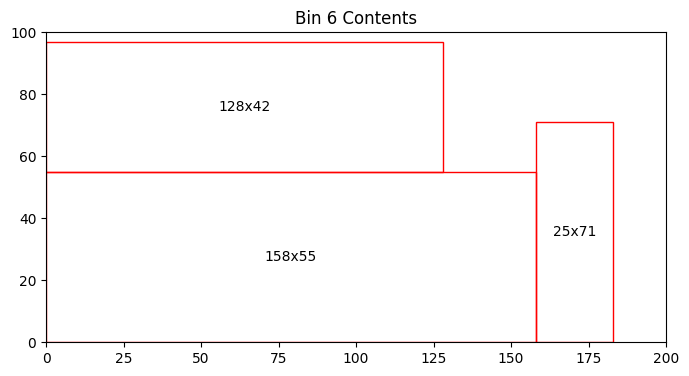

Bin 6 has 4159.00 units of area left


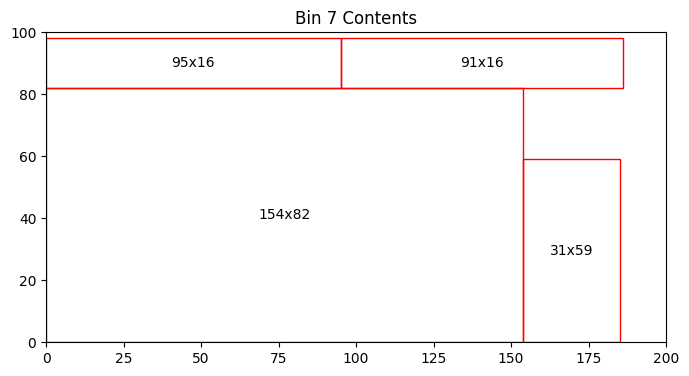

Bin 7 has 2567.00 units of area left


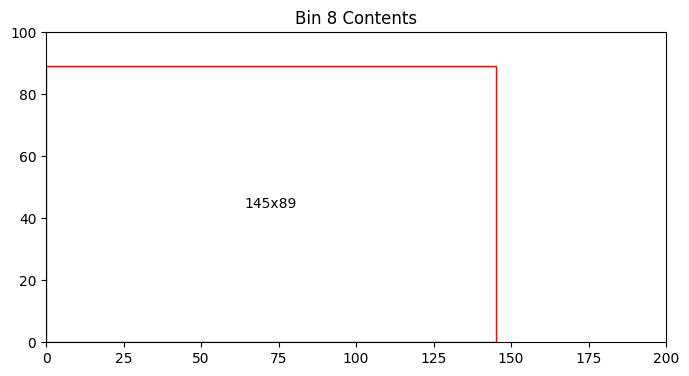

Bin 8 has 7095.00 units of area left


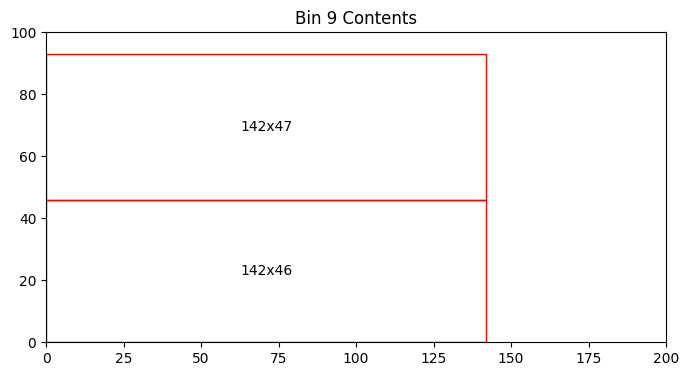

Bin 9 has 6794.00 units of area left


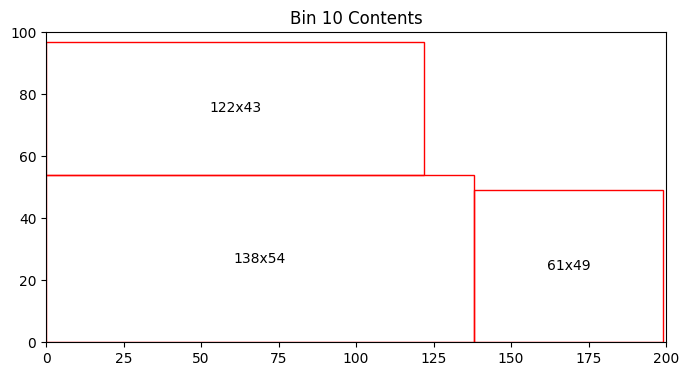

Bin 10 has 4313.00 units of area left


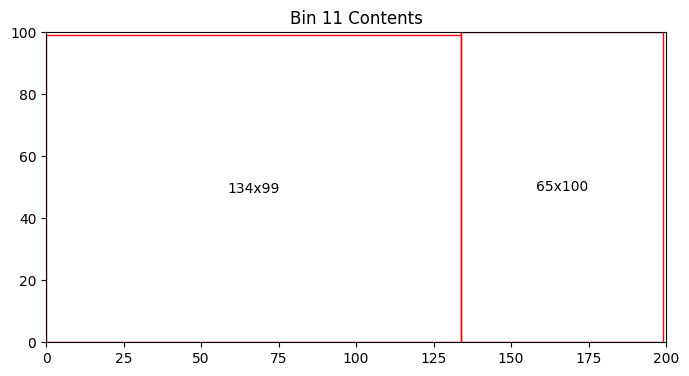

Bin 11 has 234.00 units of area left


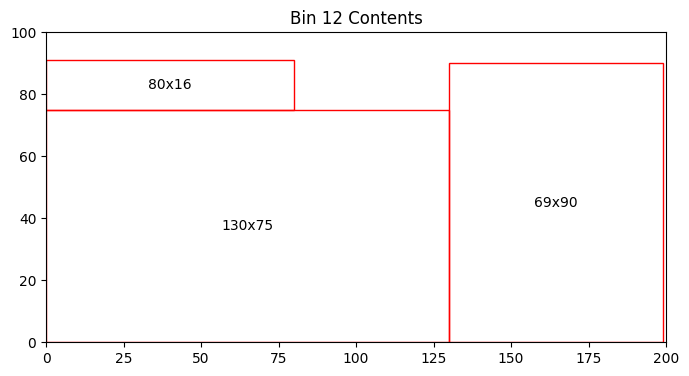

Bin 12 has 2760.00 units of area left


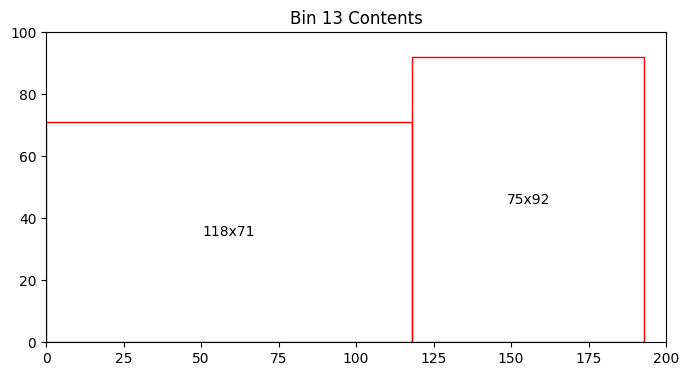

Bin 13 has 4722.00 units of area left


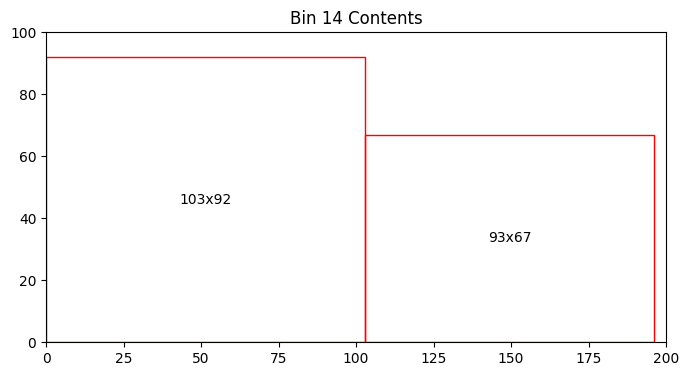

Bin 14 has 4293.00 units of area left


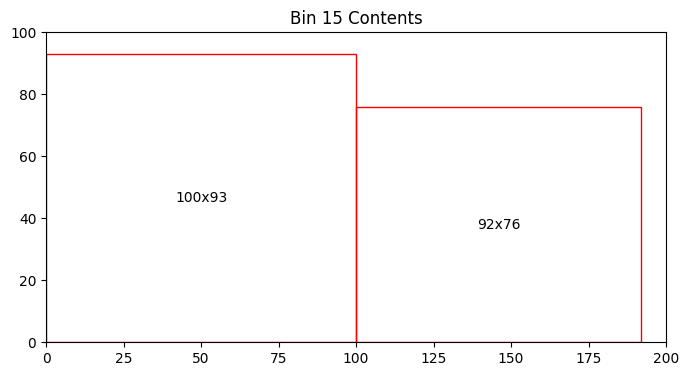

Bin 15 has 3708.00 units of area left


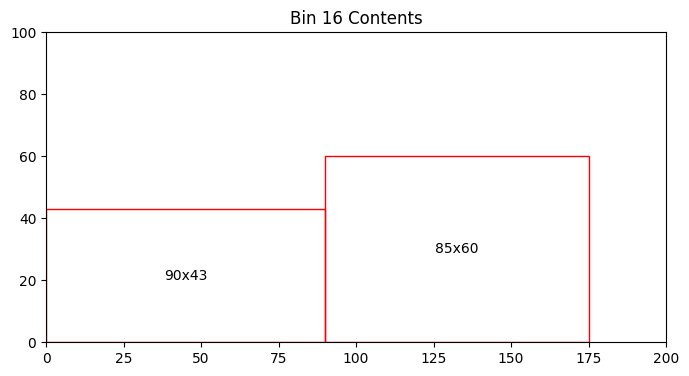

Bin 16 has 11030.00 units of area left


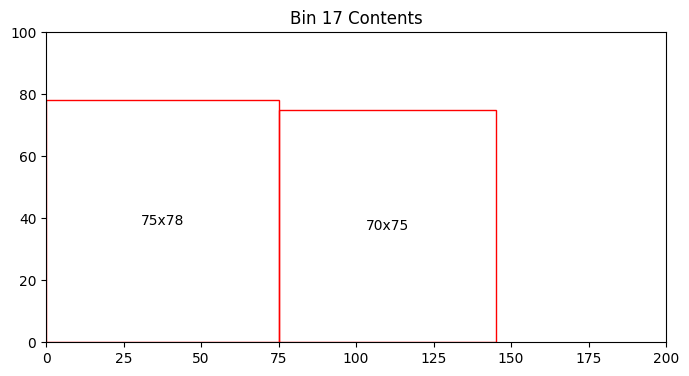

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


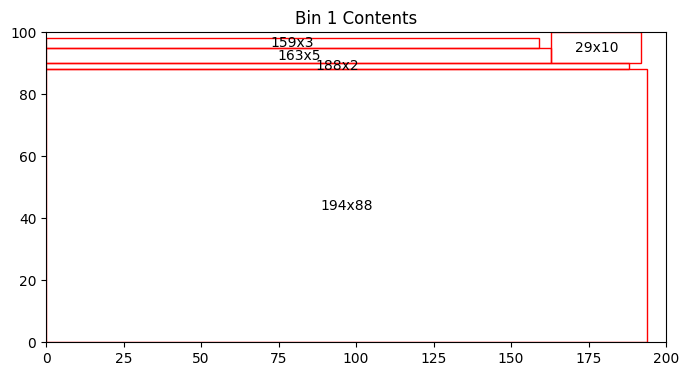

Bin 1 has 970.00 units of area left


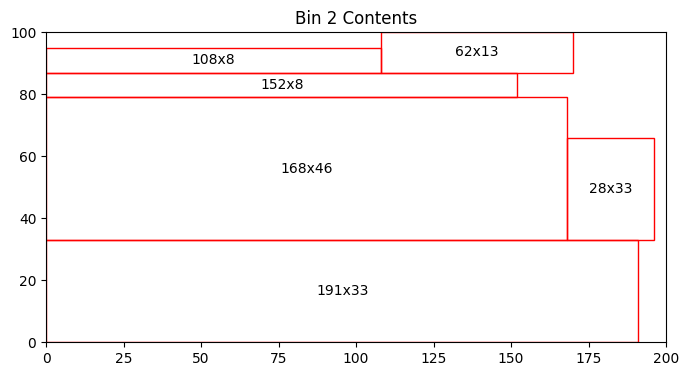

Bin 2 has 2159.00 units of area left


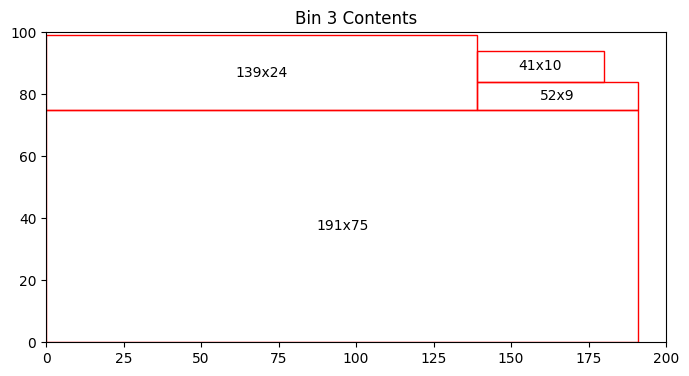

Bin 3 has 1461.00 units of area left


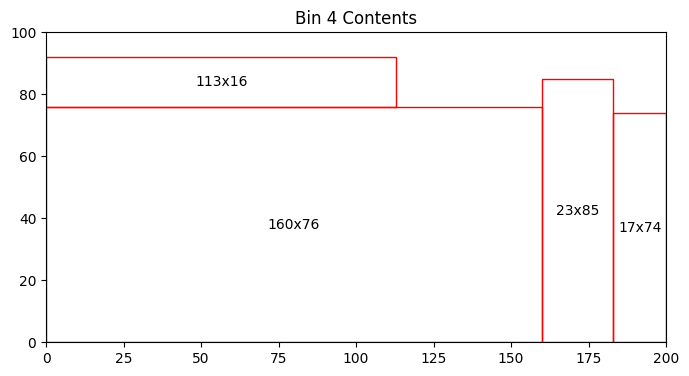

Bin 4 has 2819.00 units of area left


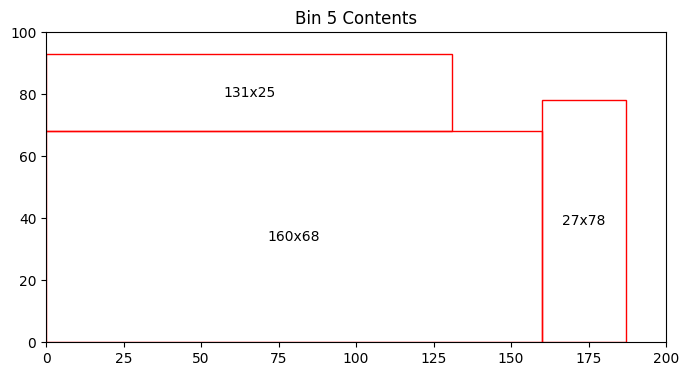

Bin 5 has 3739.00 units of area left


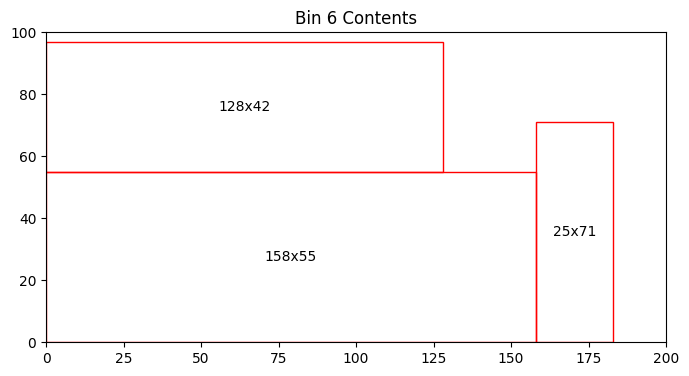

Bin 6 has 4159.00 units of area left


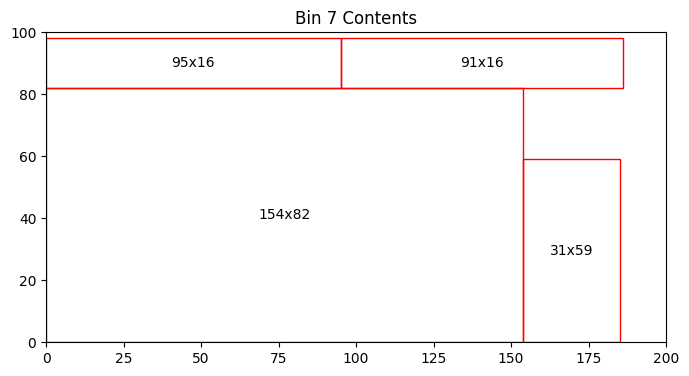

Bin 7 has 2567.00 units of area left


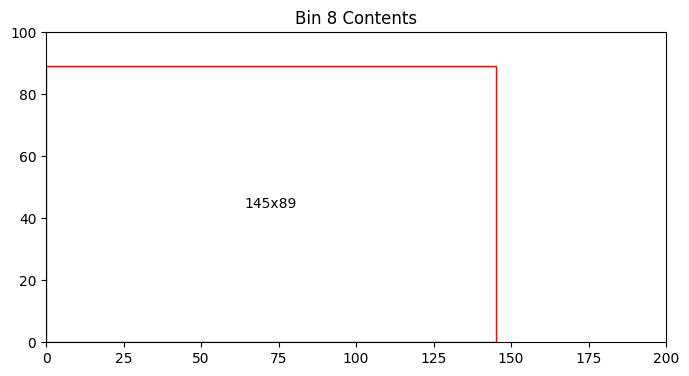

Bin 8 has 7095.00 units of area left


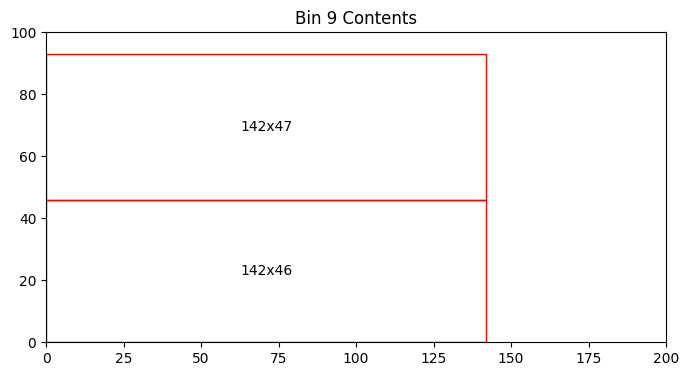

Bin 9 has 6794.00 units of area left


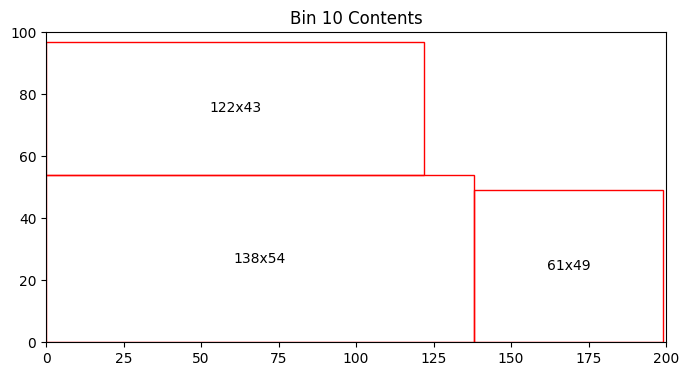

Bin 10 has 4313.00 units of area left


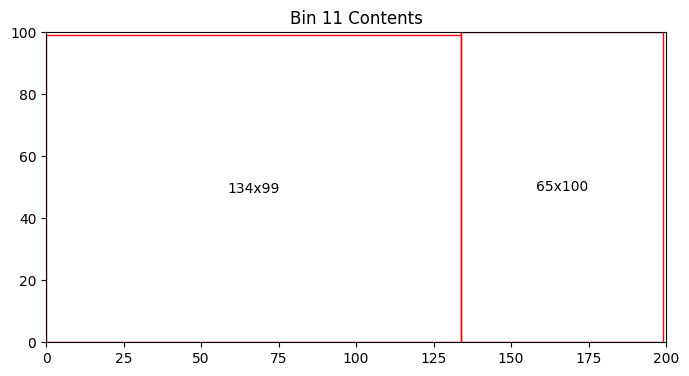

Bin 11 has 234.00 units of area left


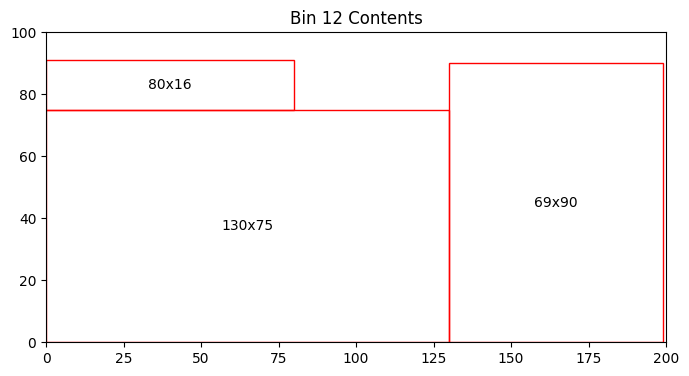

Bin 12 has 2760.00 units of area left


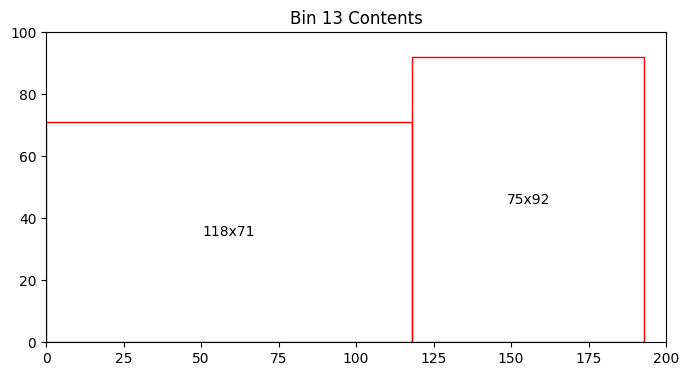

Bin 13 has 4722.00 units of area left


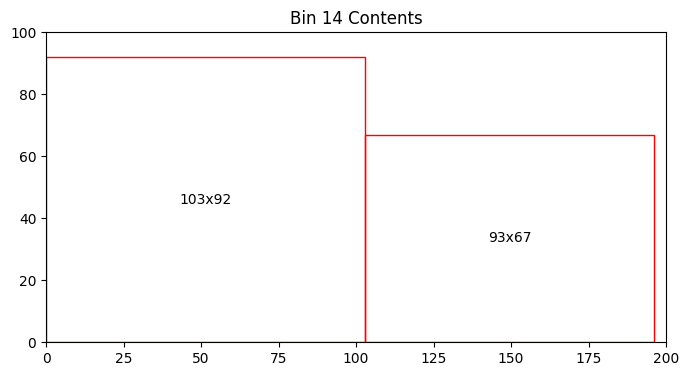

Bin 14 has 4293.00 units of area left


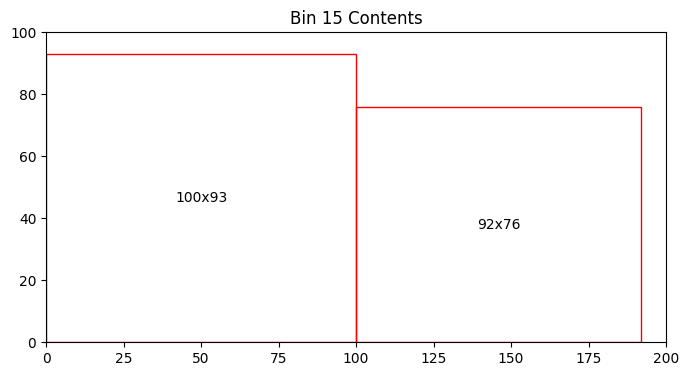

Bin 15 has 3708.00 units of area left


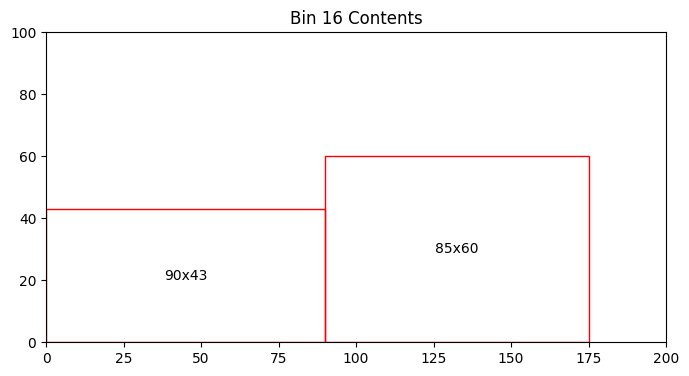

Bin 16 has 11030.00 units of area left


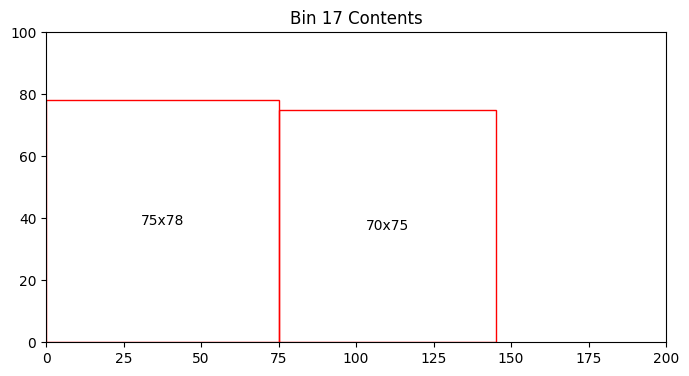

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


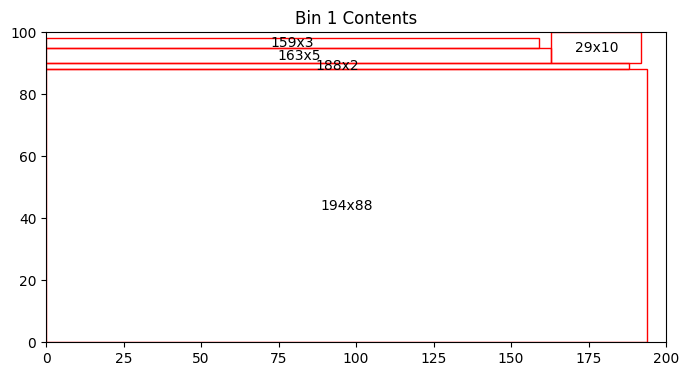

Bin 1 has 970.00 units of area left


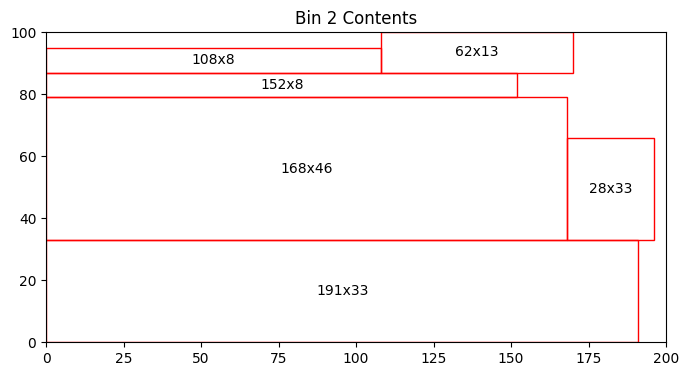

Bin 2 has 2159.00 units of area left


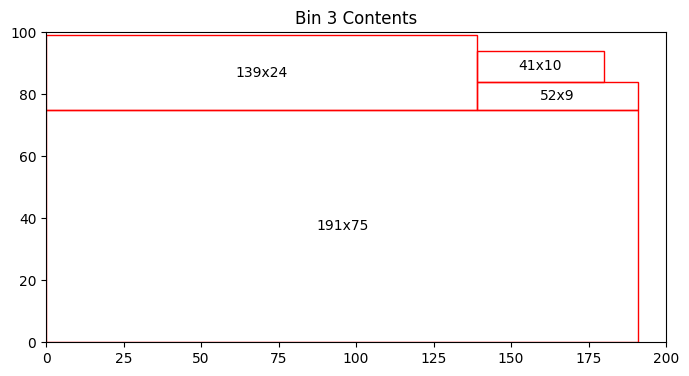

Bin 3 has 1461.00 units of area left


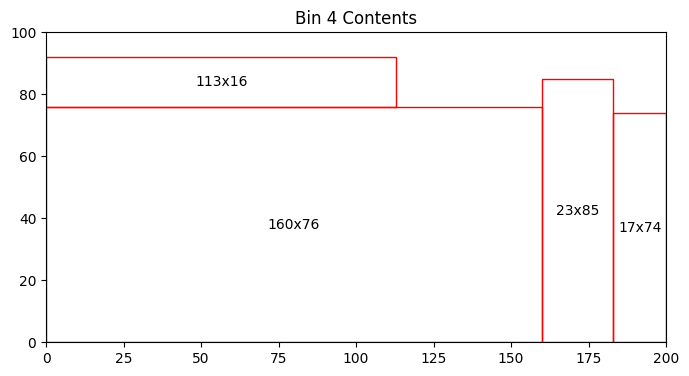

Bin 4 has 2819.00 units of area left


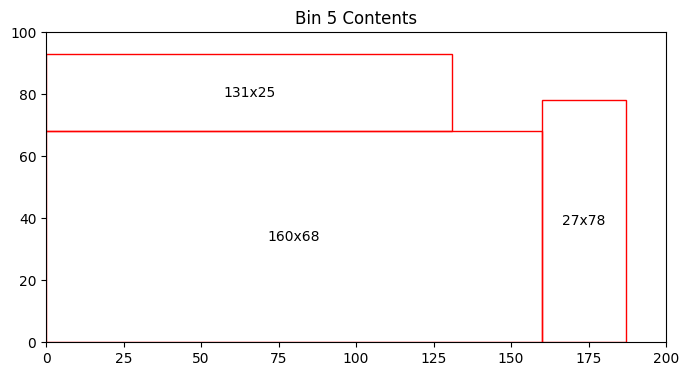

Bin 5 has 3739.00 units of area left


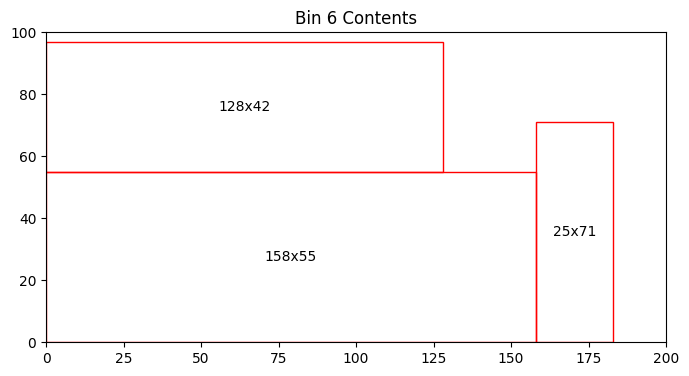

Bin 6 has 4159.00 units of area left


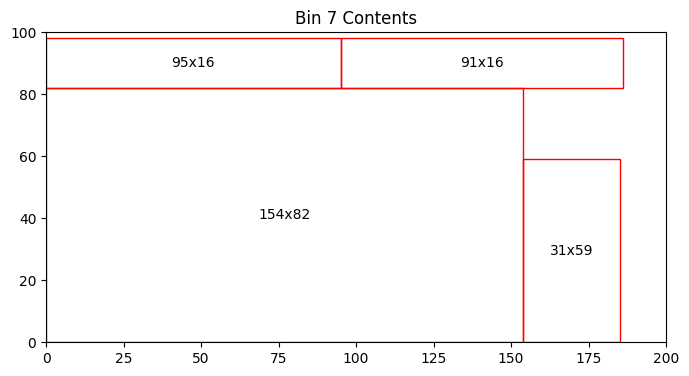

Bin 7 has 2567.00 units of area left


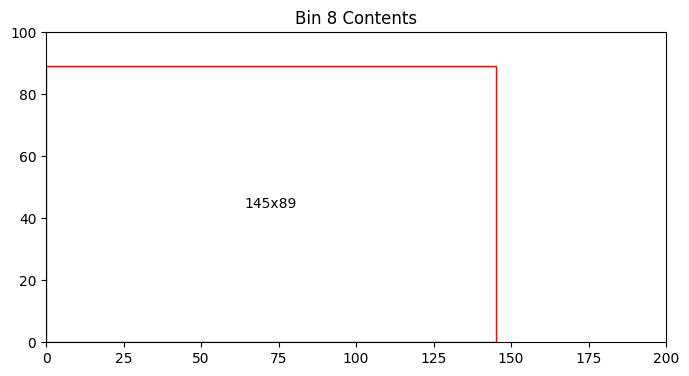

Bin 8 has 7095.00 units of area left


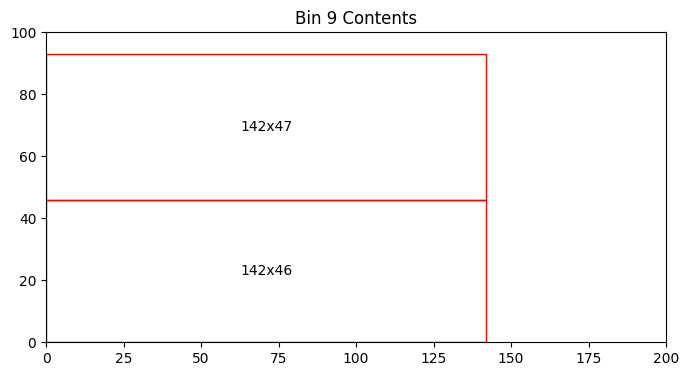

Bin 9 has 6794.00 units of area left


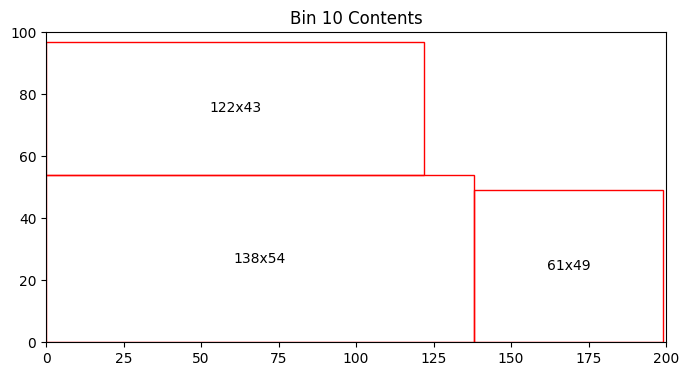

Bin 10 has 4313.00 units of area left


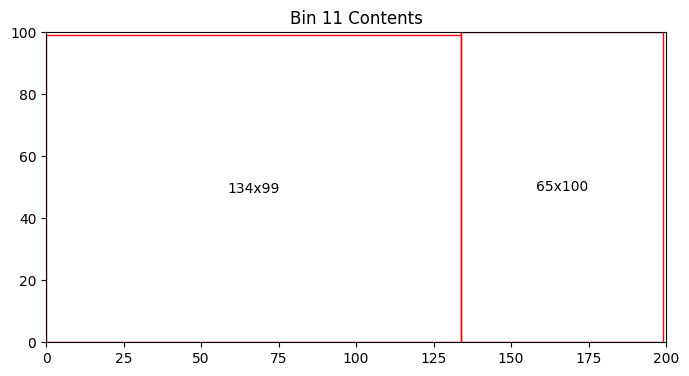

Bin 11 has 234.00 units of area left


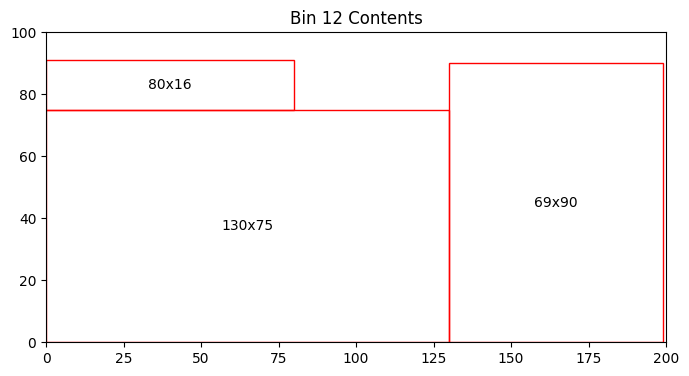

Bin 12 has 2760.00 units of area left


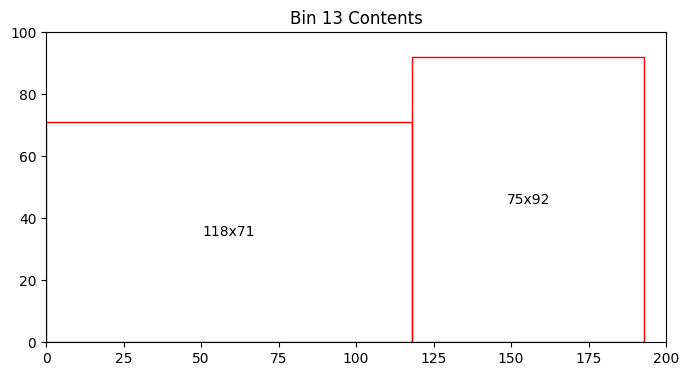

Bin 13 has 4722.00 units of area left


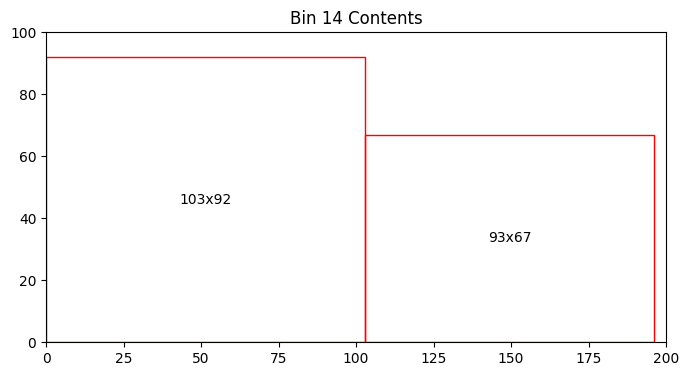

Bin 14 has 4293.00 units of area left


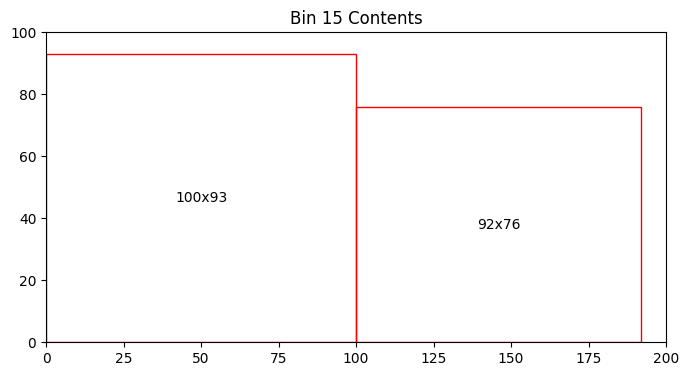

Bin 15 has 3708.00 units of area left


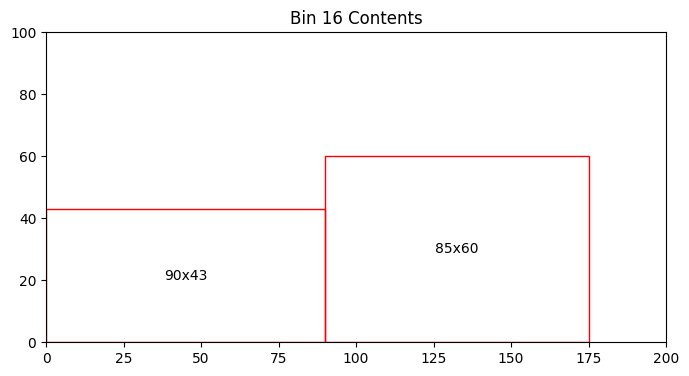

Bin 16 has 11030.00 units of area left


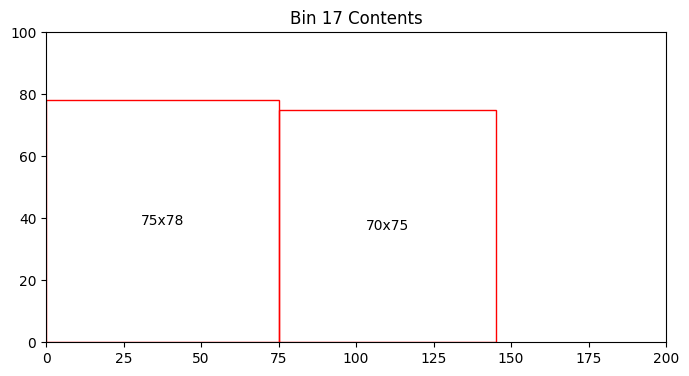

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


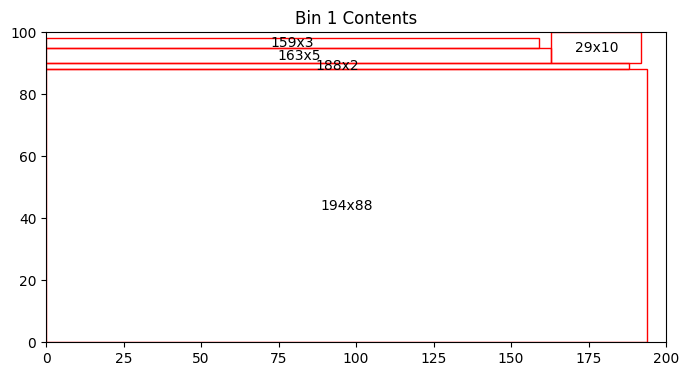

Bin 1 has 970.00 units of area left


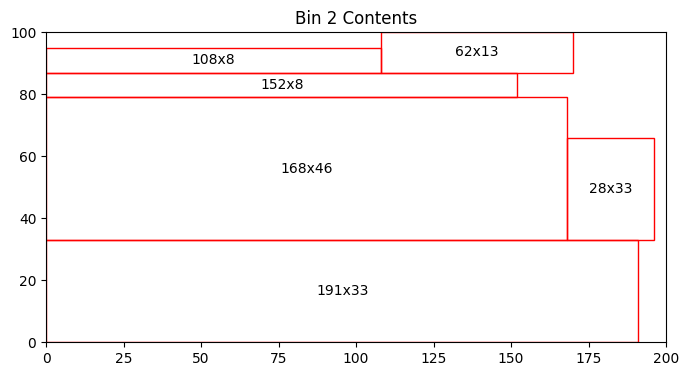

Bin 2 has 2159.00 units of area left


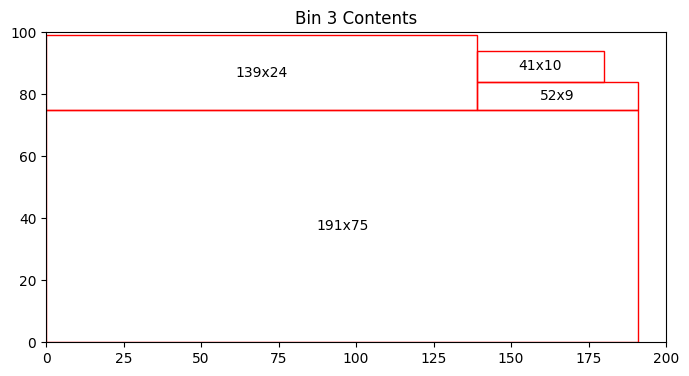

Bin 3 has 1461.00 units of area left


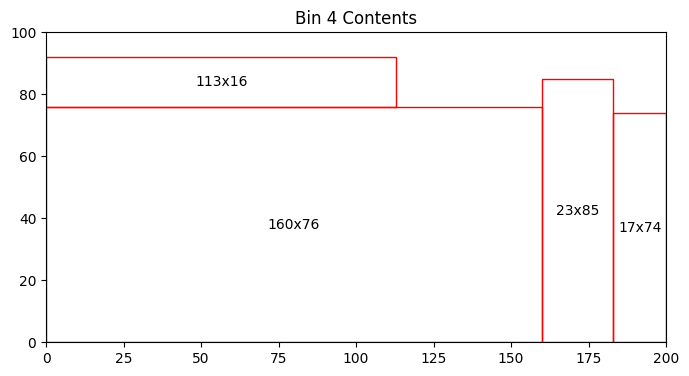

Bin 4 has 2819.00 units of area left


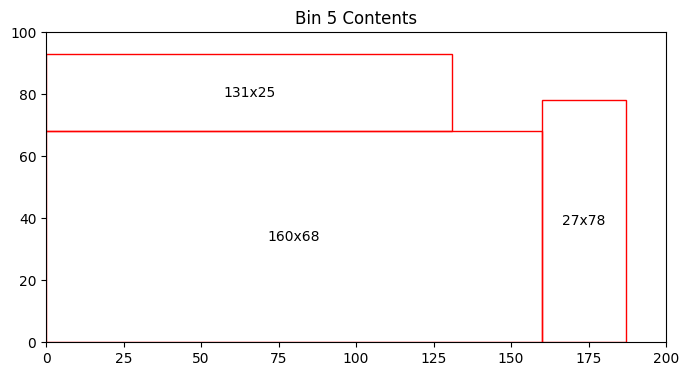

Bin 5 has 3739.00 units of area left


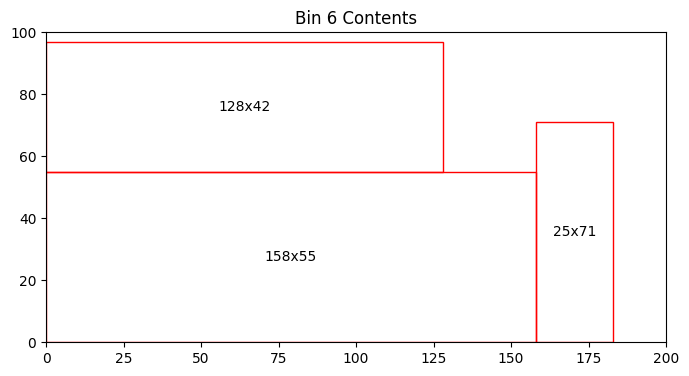

Bin 6 has 4159.00 units of area left


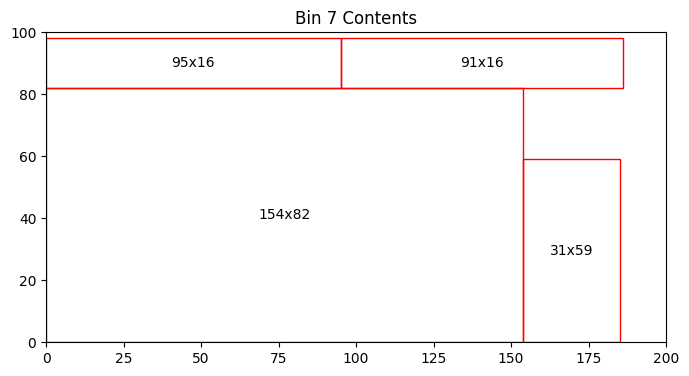

Bin 7 has 2567.00 units of area left


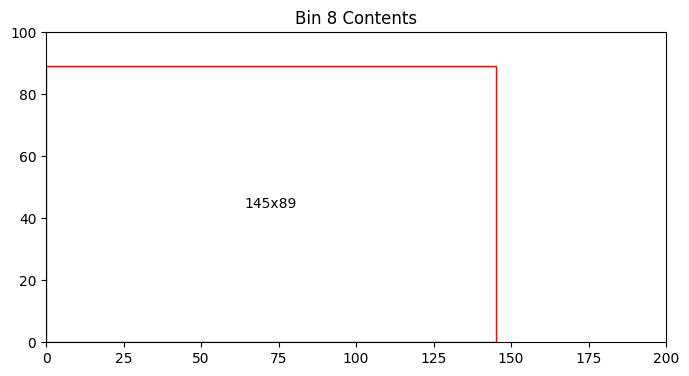

Bin 8 has 7095.00 units of area left


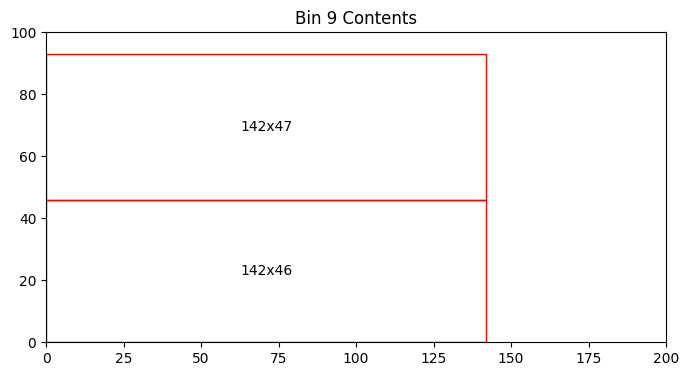

Bin 9 has 6794.00 units of area left


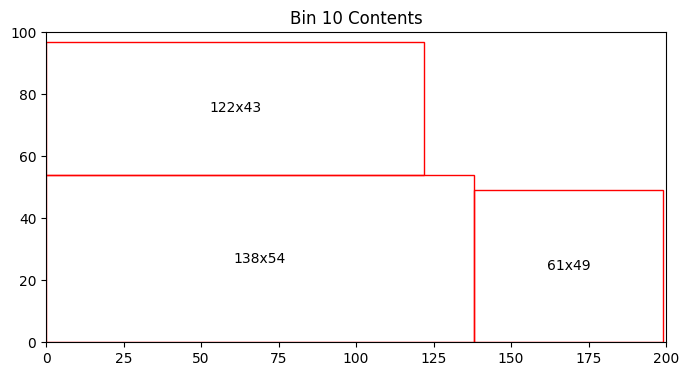

Bin 10 has 4313.00 units of area left


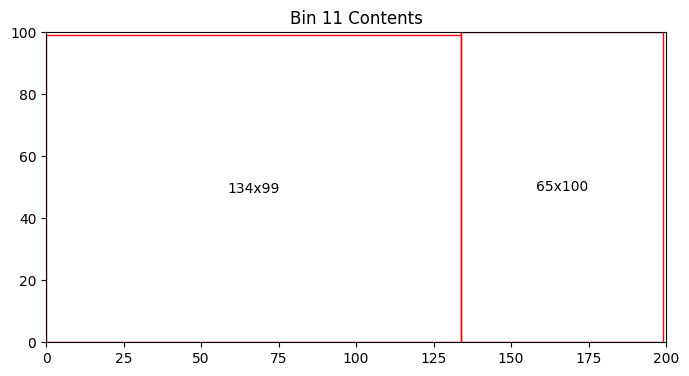

Bin 11 has 234.00 units of area left


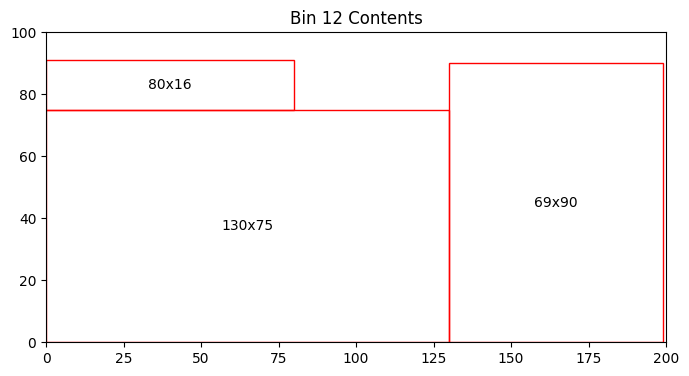

Bin 12 has 2760.00 units of area left


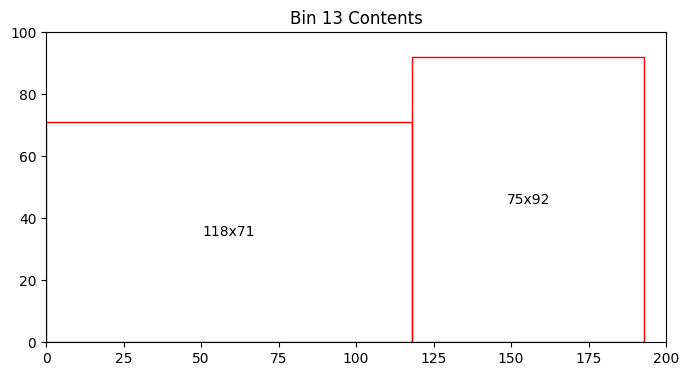

Bin 13 has 4722.00 units of area left


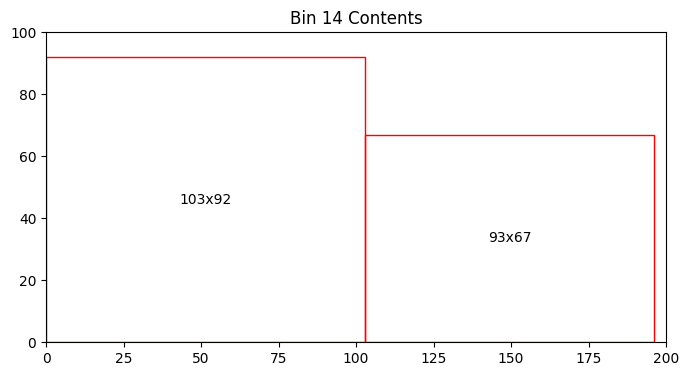

Bin 14 has 4293.00 units of area left


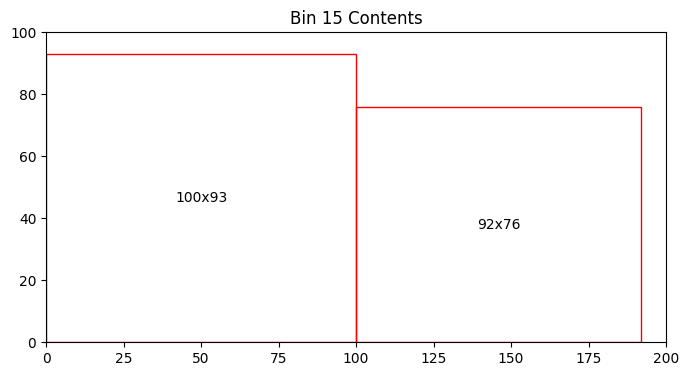

Bin 15 has 3708.00 units of area left


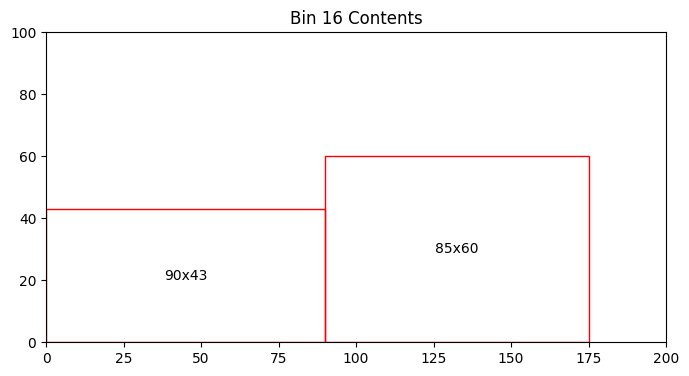

Bin 16 has 11030.00 units of area left


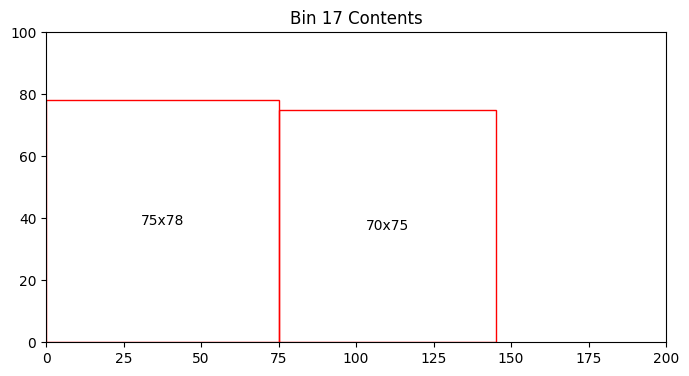

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


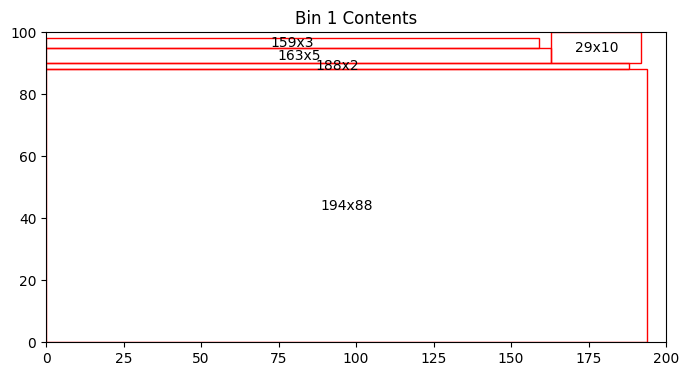

Bin 1 has 970.00 units of area left


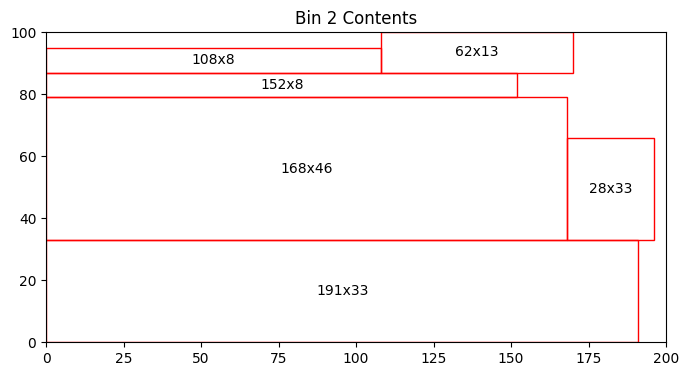

Bin 2 has 2159.00 units of area left


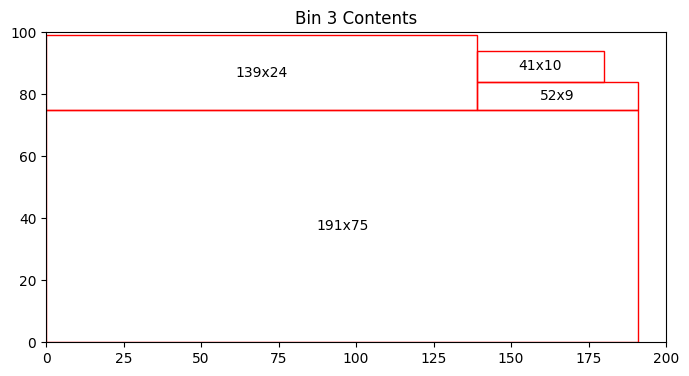

Bin 3 has 1461.00 units of area left


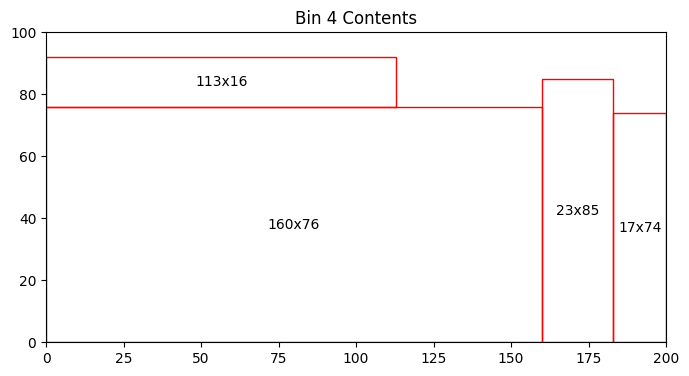

Bin 4 has 2819.00 units of area left


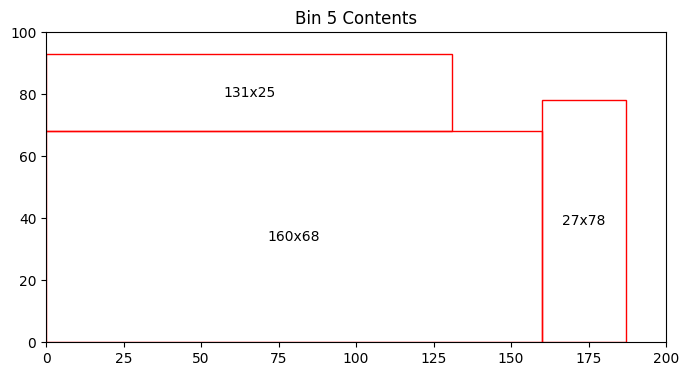

Bin 5 has 3739.00 units of area left


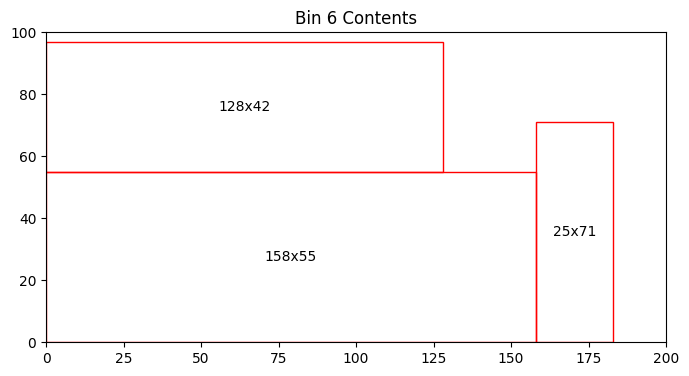

Bin 6 has 4159.00 units of area left


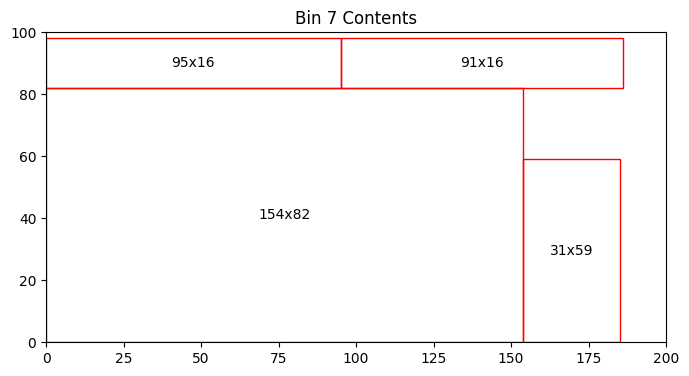

Bin 7 has 2567.00 units of area left


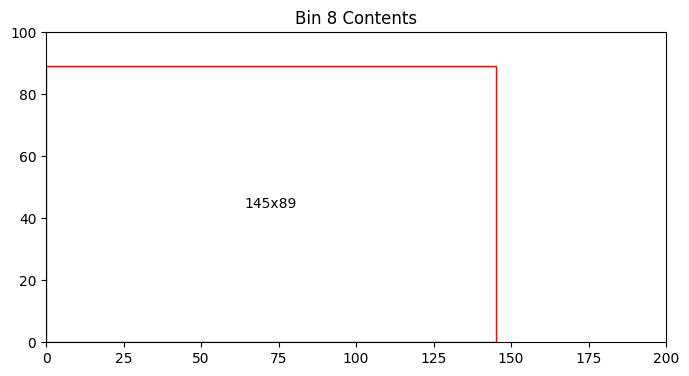

Bin 8 has 7095.00 units of area left


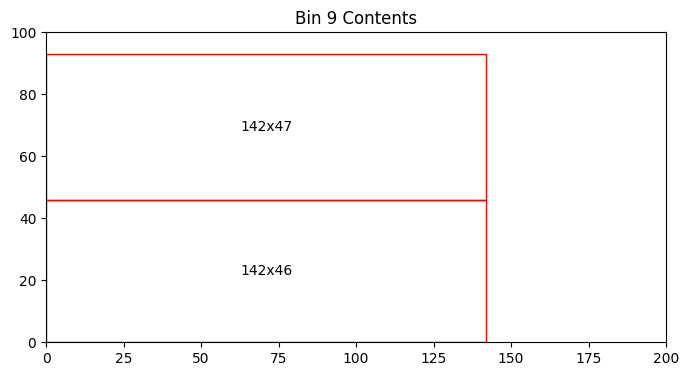

Bin 9 has 6794.00 units of area left


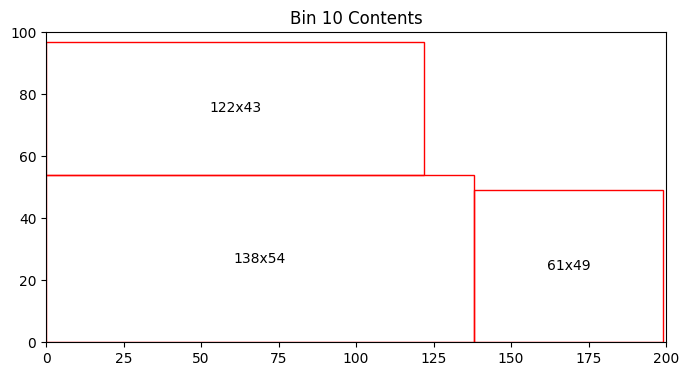

Bin 10 has 4313.00 units of area left


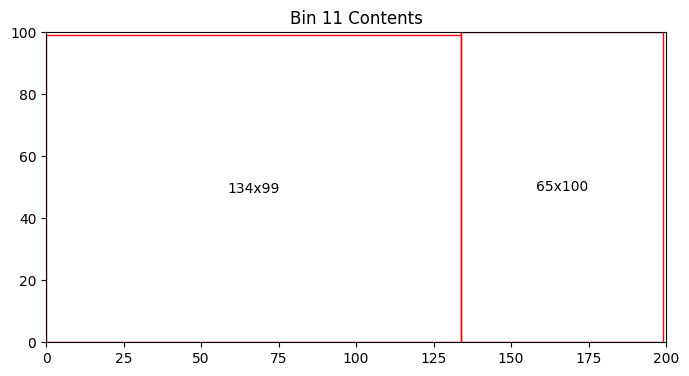

Bin 11 has 234.00 units of area left


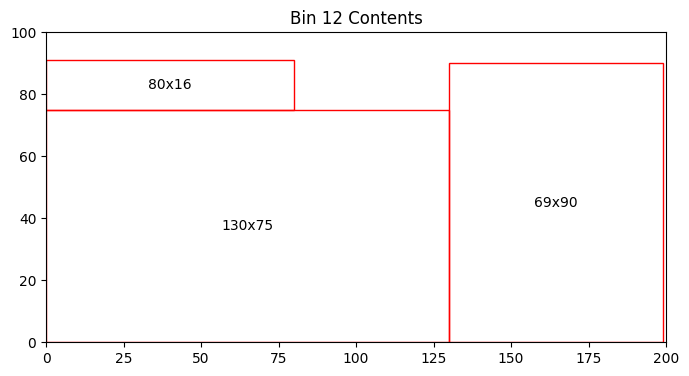

Bin 12 has 2760.00 units of area left


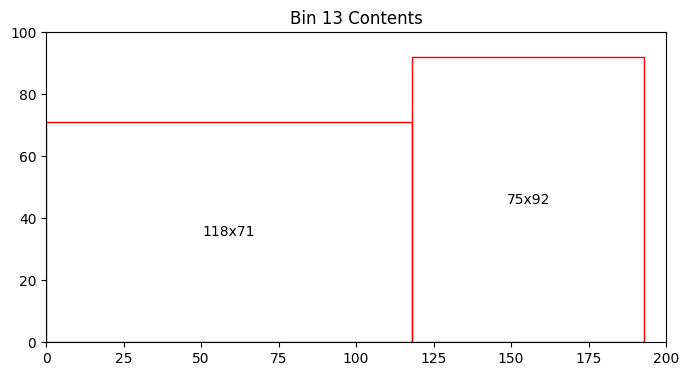

Bin 13 has 4722.00 units of area left


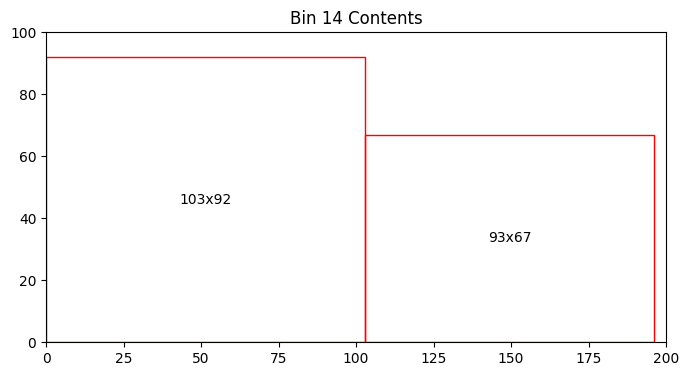

Bin 14 has 4293.00 units of area left


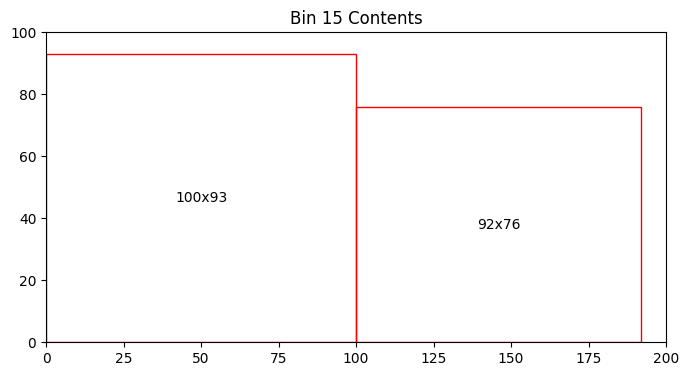

Bin 15 has 3708.00 units of area left


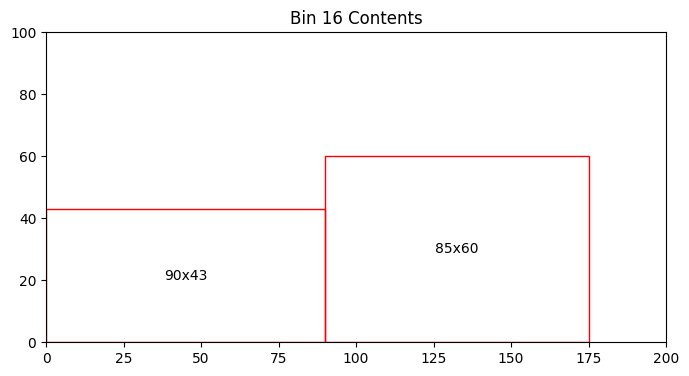

Bin 16 has 11030.00 units of area left


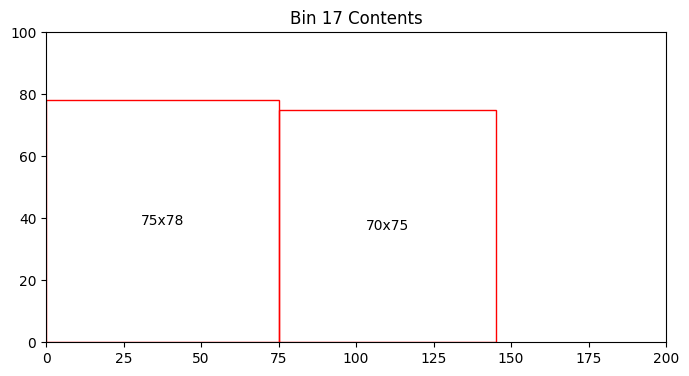

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


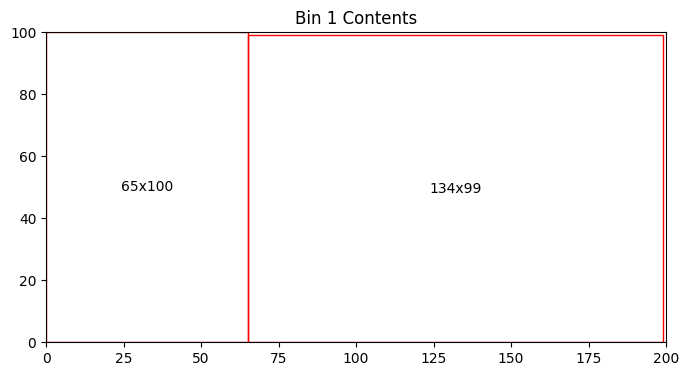

Bin 1 has 234.00 units of area left


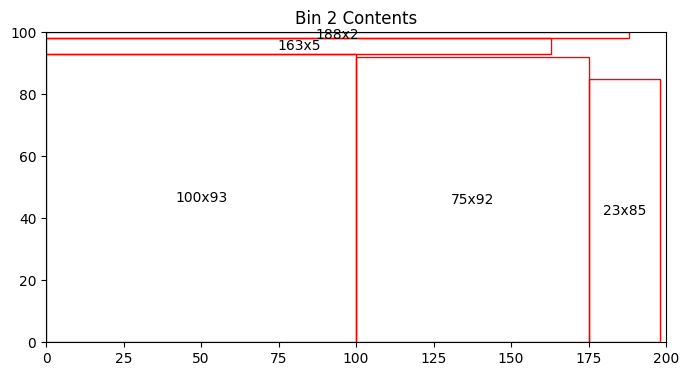

Bin 2 has 654.00 units of area left


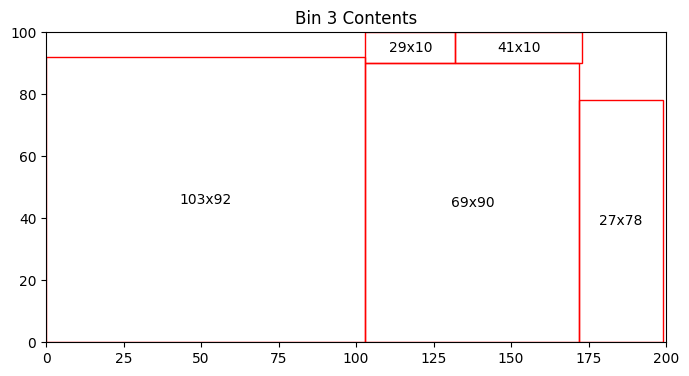

Bin 3 has 1508.00 units of area left


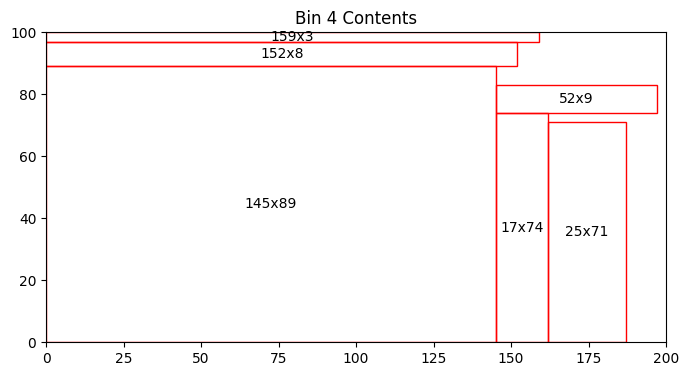

Bin 4 has 1901.00 units of area left


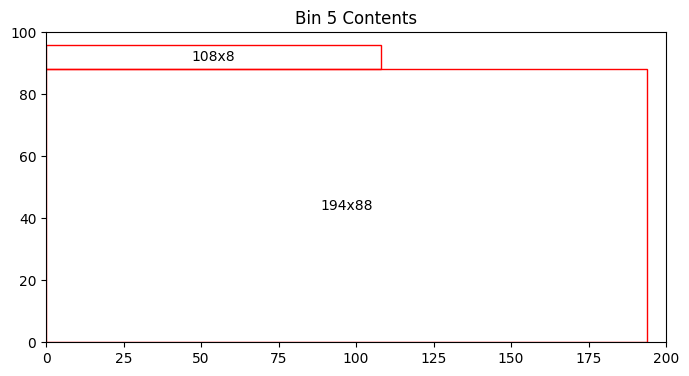

Bin 5 has 2064.00 units of area left


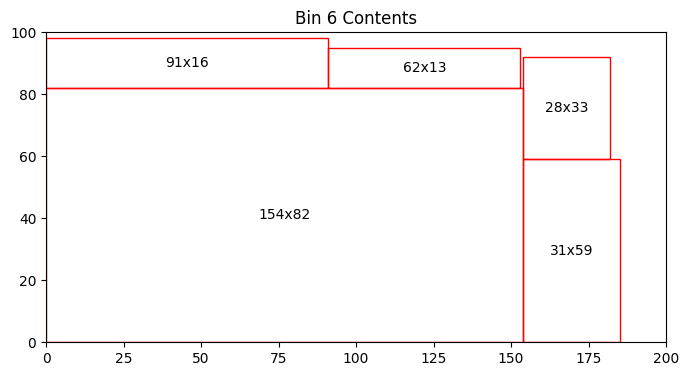

Bin 6 has 2357.00 units of area left


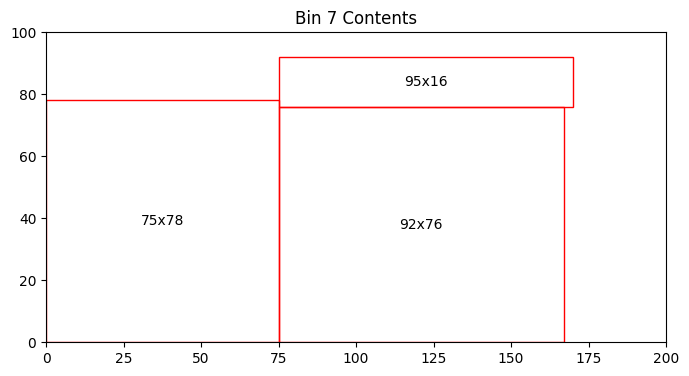

Bin 7 has 5638.00 units of area left


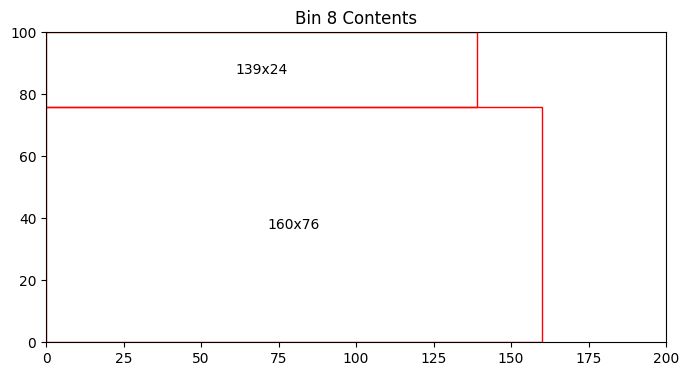

Bin 8 has 4504.00 units of area left


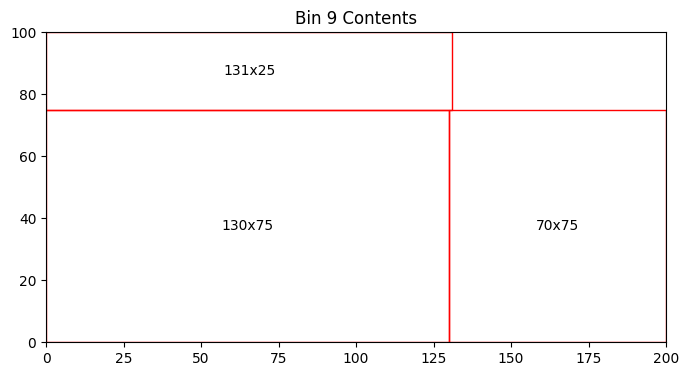

Bin 9 has 1725.00 units of area left


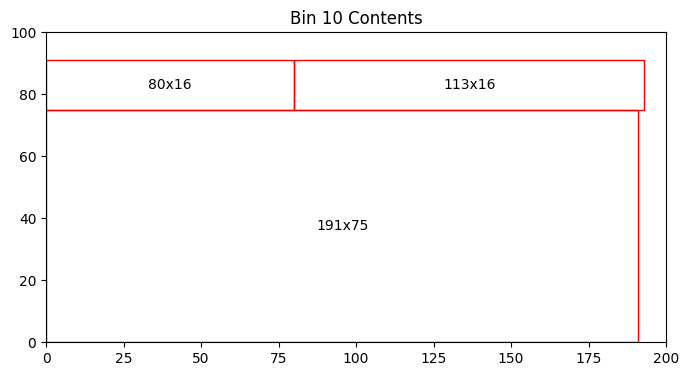

Bin 10 has 2587.00 units of area left


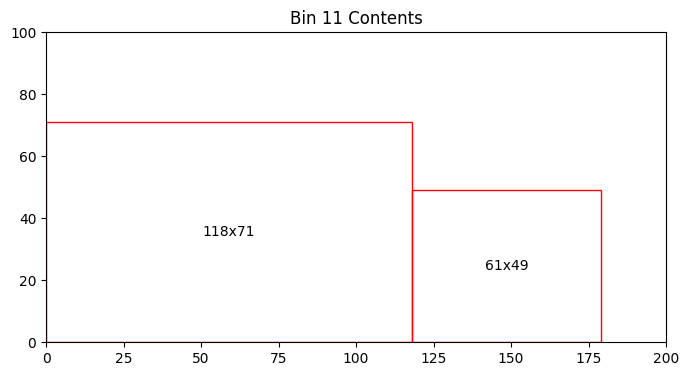

Bin 11 has 8633.00 units of area left


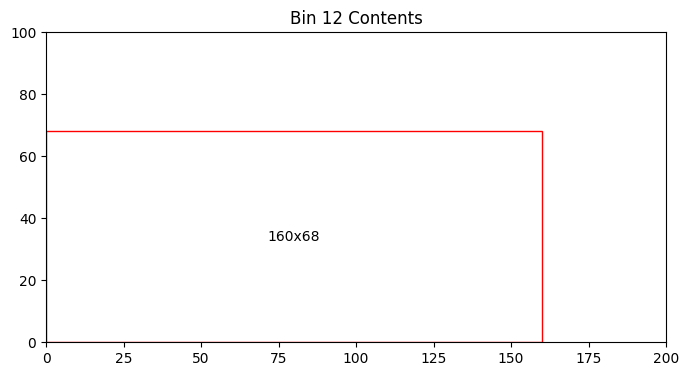

Bin 12 has 9120.00 units of area left


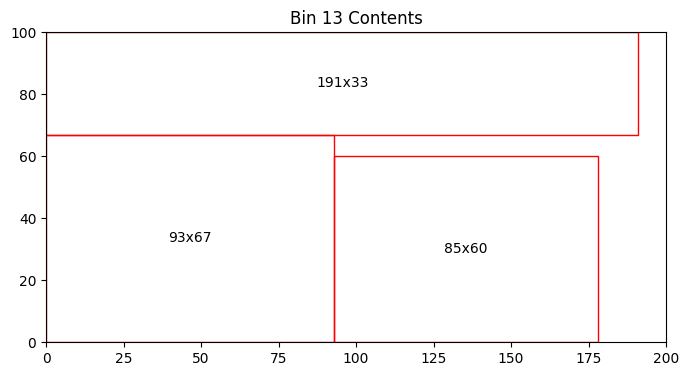

Bin 13 has 2366.00 units of area left


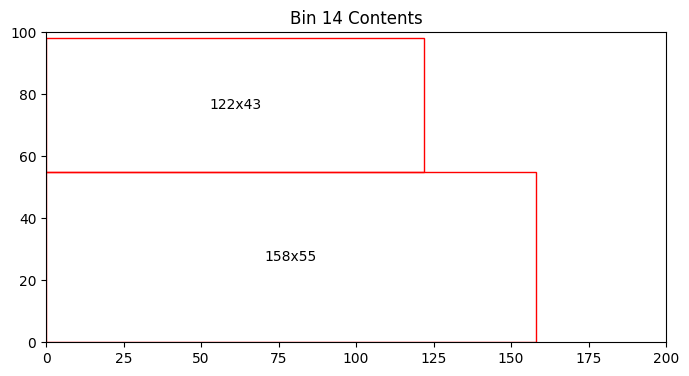

Bin 14 has 6064.00 units of area left


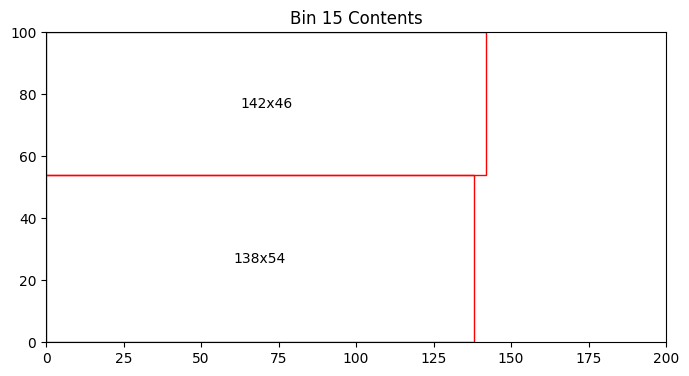

Bin 15 has 6016.00 units of area left


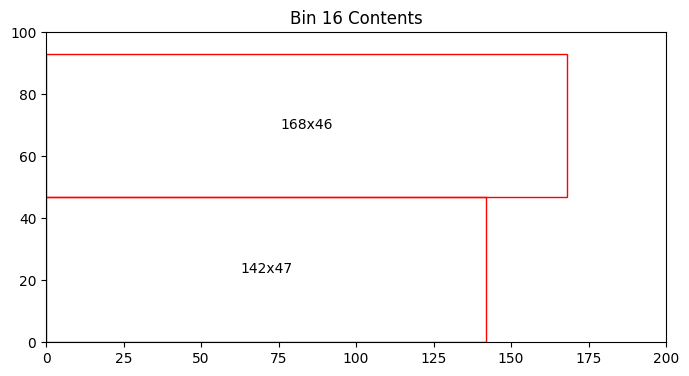

Bin 16 has 5598.00 units of area left


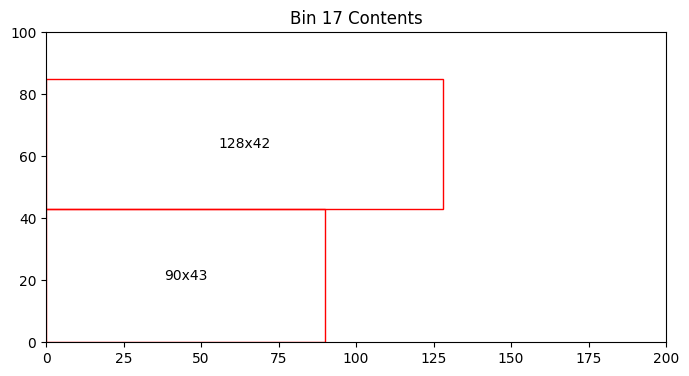

Bin 17 has 10754.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


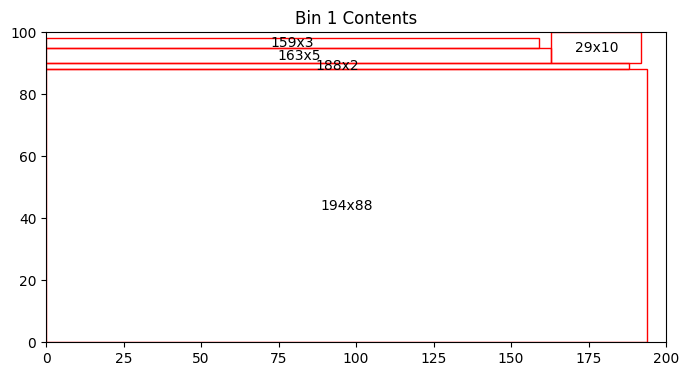

Bin 1 has 970.00 units of area left


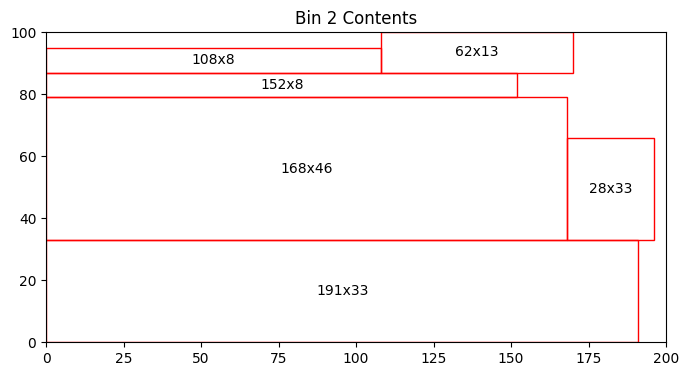

Bin 2 has 2159.00 units of area left


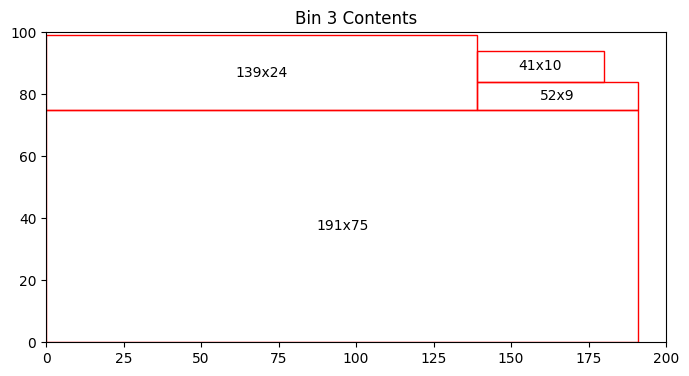

Bin 3 has 1461.00 units of area left


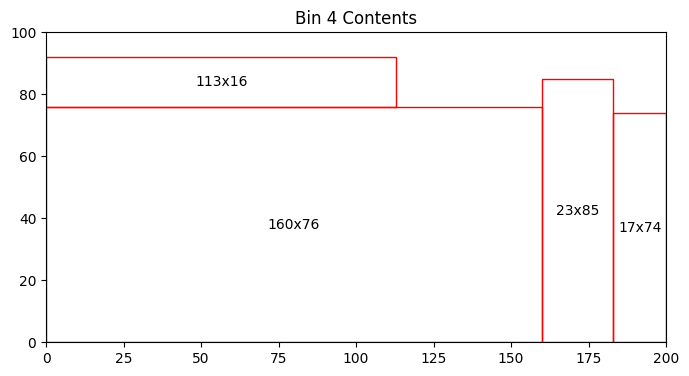

Bin 4 has 2819.00 units of area left


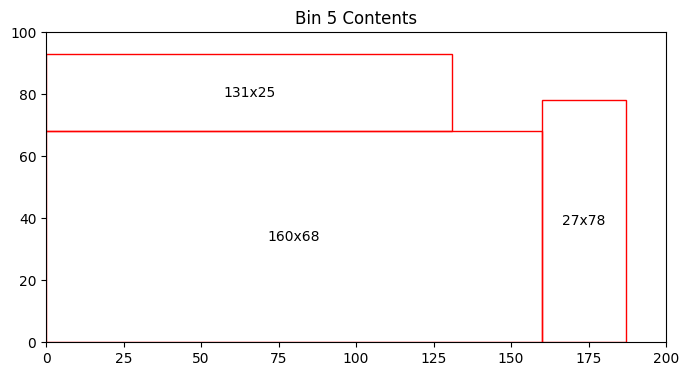

Bin 5 has 3739.00 units of area left


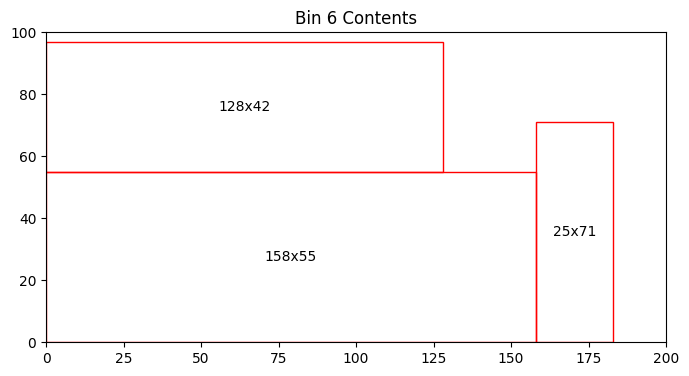

Bin 6 has 4159.00 units of area left


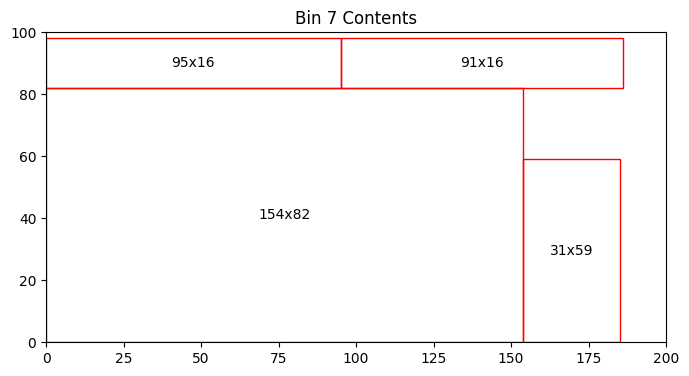

Bin 7 has 2567.00 units of area left


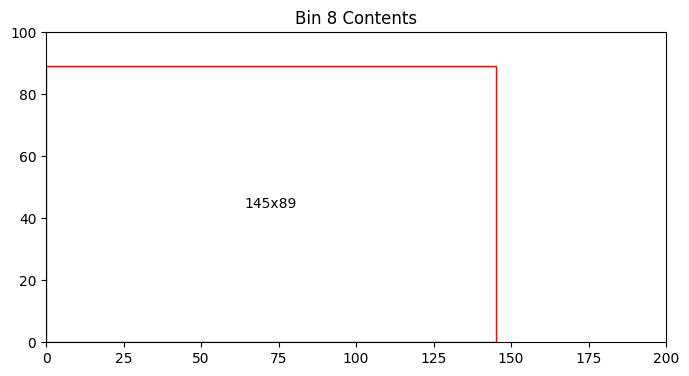

Bin 8 has 7095.00 units of area left


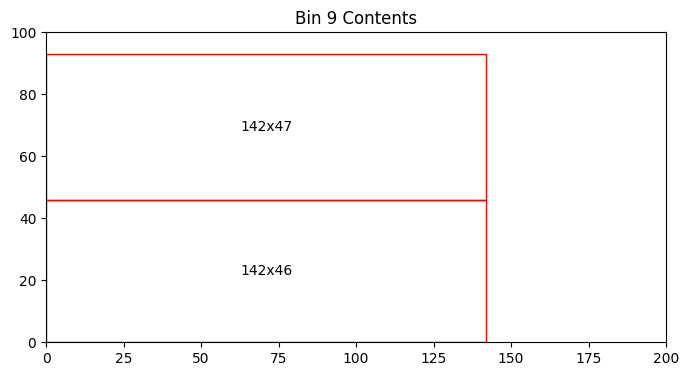

Bin 9 has 6794.00 units of area left


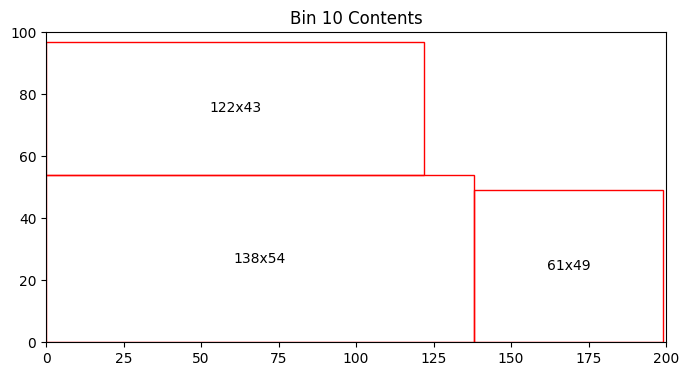

Bin 10 has 4313.00 units of area left


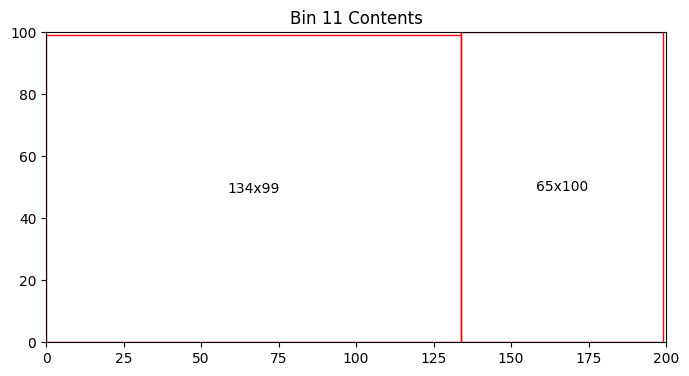

Bin 11 has 234.00 units of area left


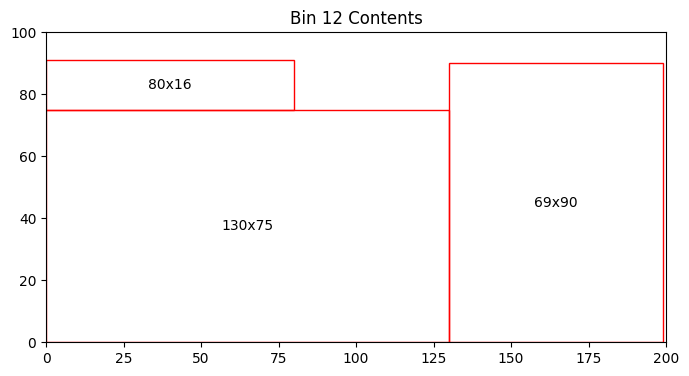

Bin 12 has 2760.00 units of area left


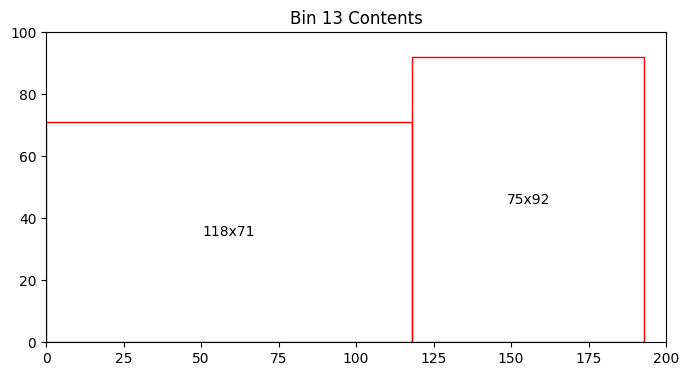

Bin 13 has 4722.00 units of area left


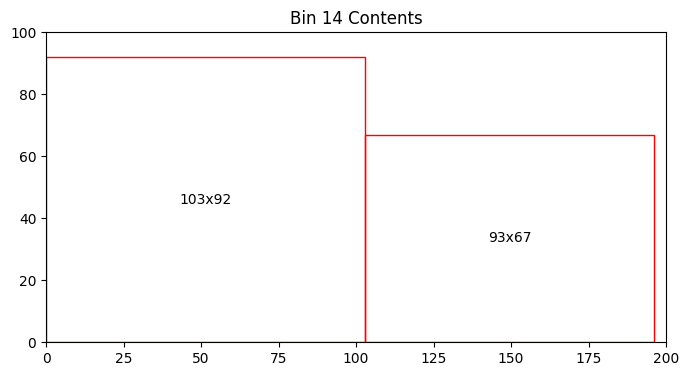

Bin 14 has 4293.00 units of area left


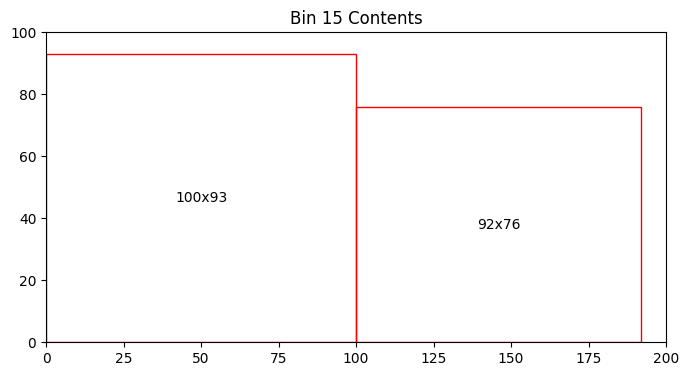

Bin 15 has 3708.00 units of area left


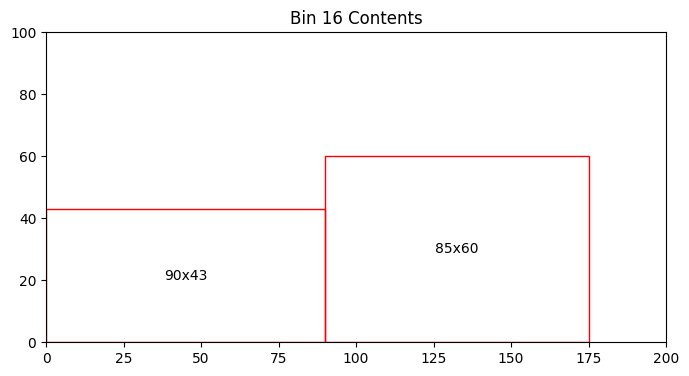

Bin 16 has 11030.00 units of area left


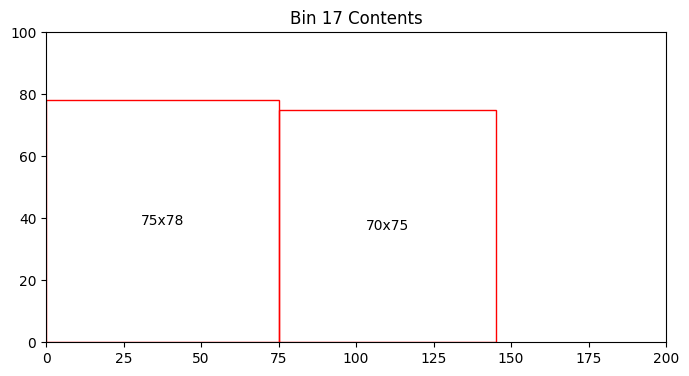

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


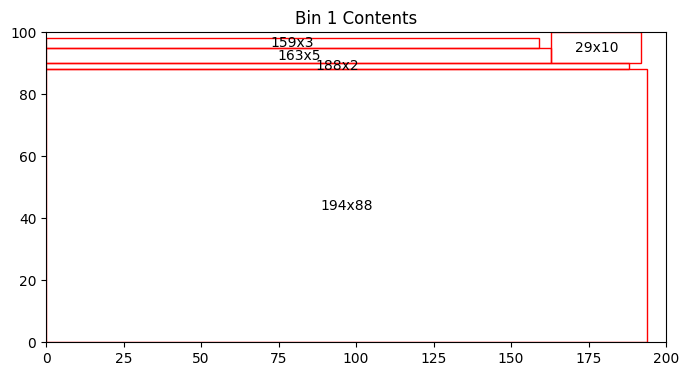

Bin 1 has 970.00 units of area left


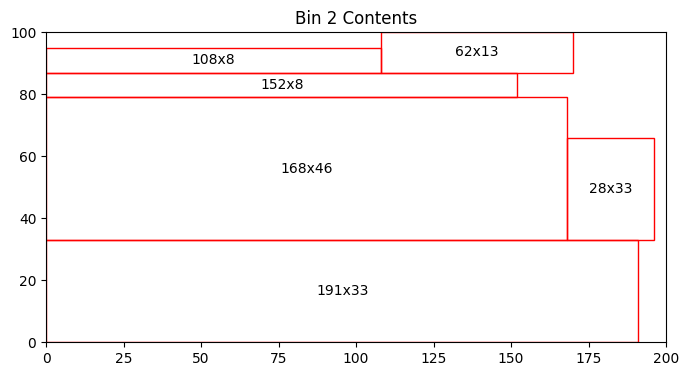

Bin 2 has 2159.00 units of area left


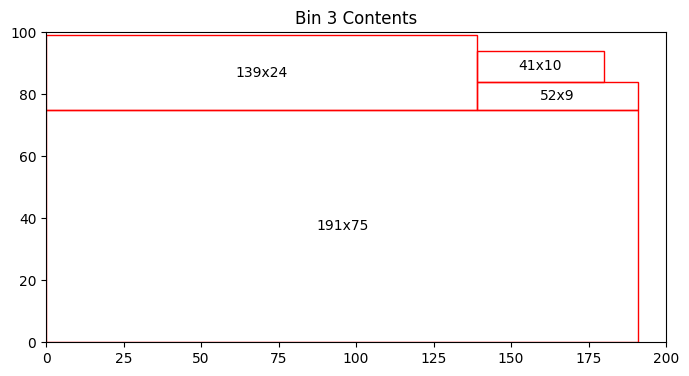

Bin 3 has 1461.00 units of area left


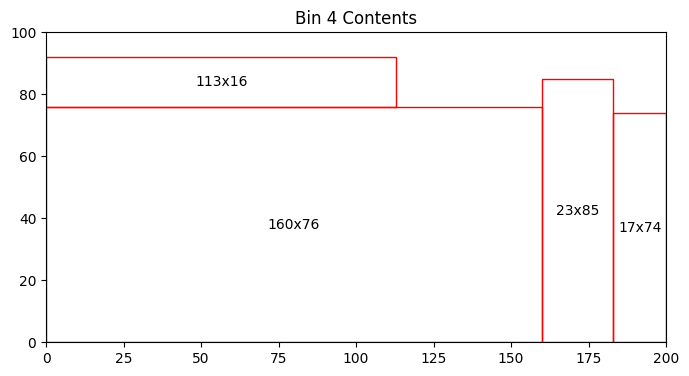

Bin 4 has 2819.00 units of area left


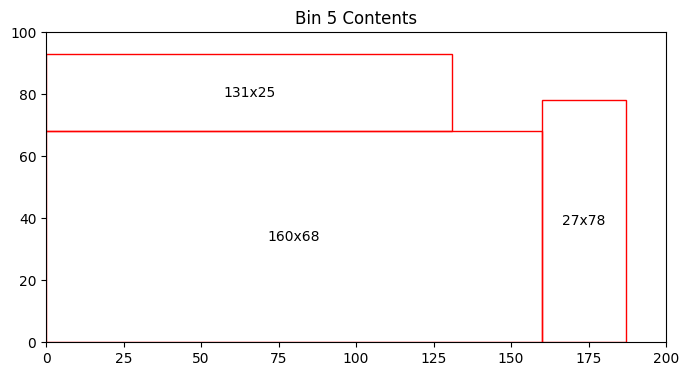

Bin 5 has 3739.00 units of area left


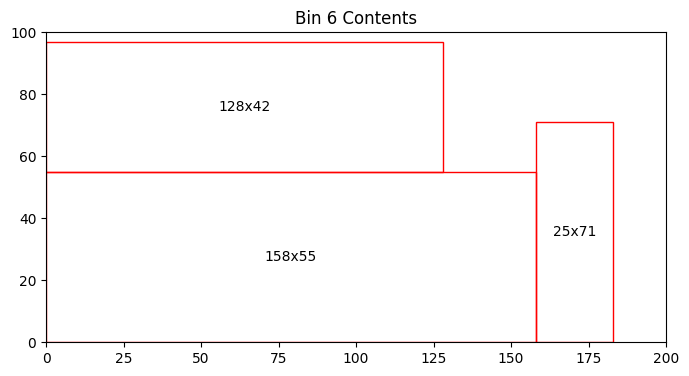

Bin 6 has 4159.00 units of area left


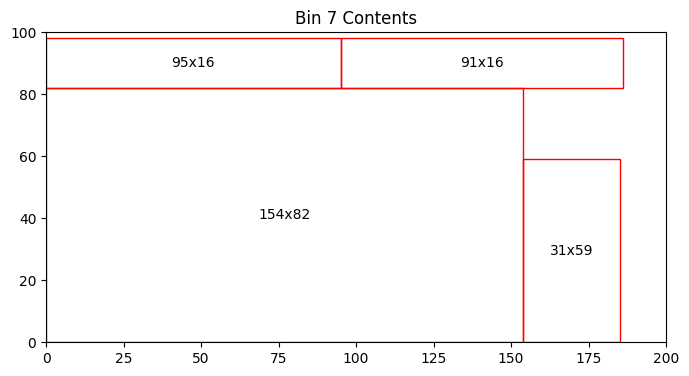

Bin 7 has 2567.00 units of area left


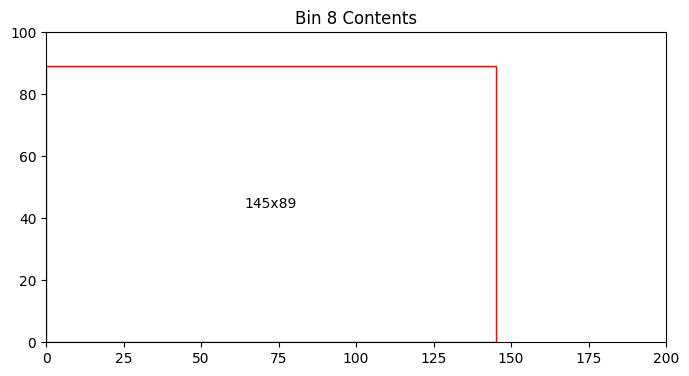

Bin 8 has 7095.00 units of area left


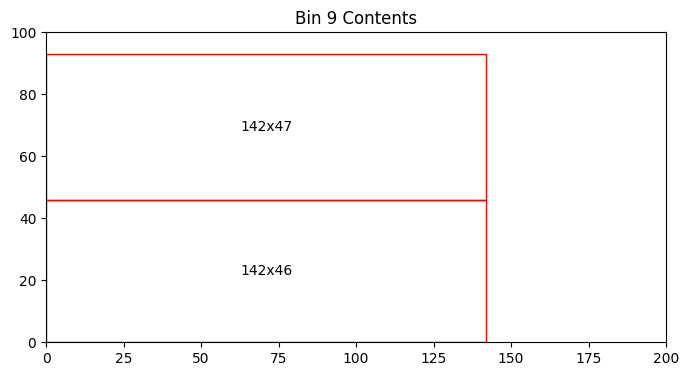

Bin 9 has 6794.00 units of area left


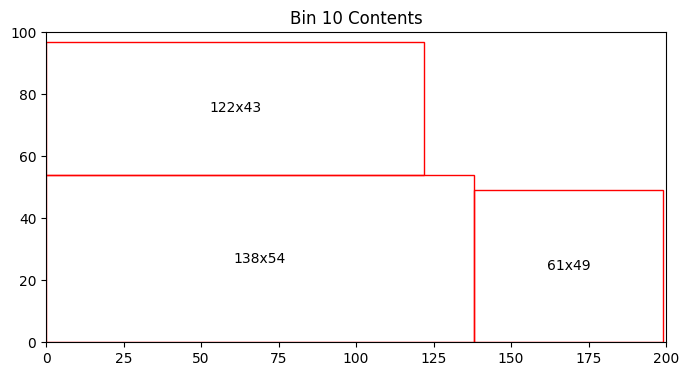

Bin 10 has 4313.00 units of area left


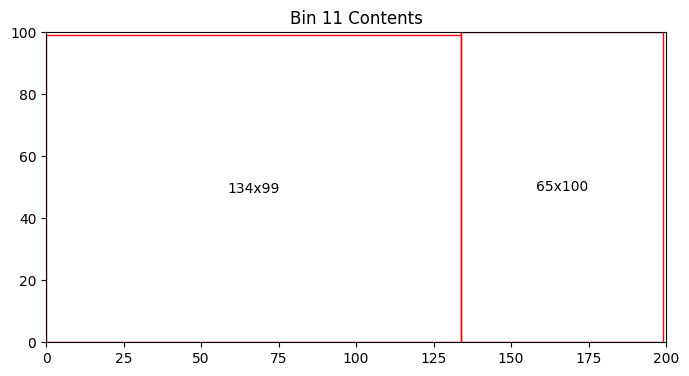

Bin 11 has 234.00 units of area left


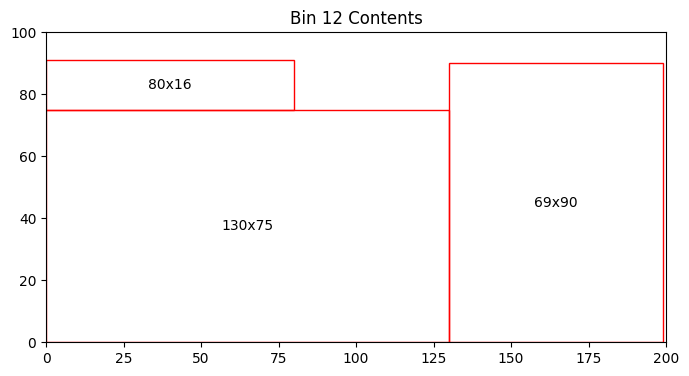

Bin 12 has 2760.00 units of area left


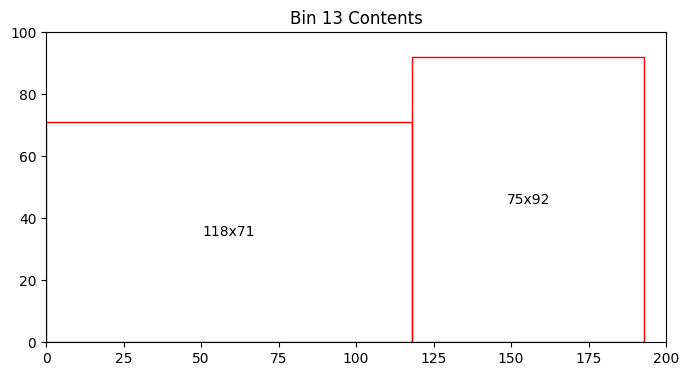

Bin 13 has 4722.00 units of area left


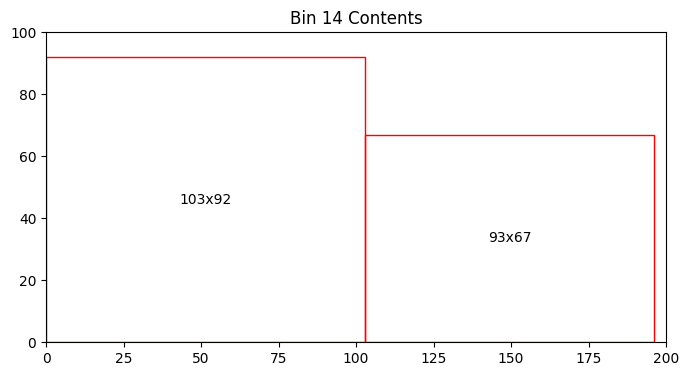

Bin 14 has 4293.00 units of area left


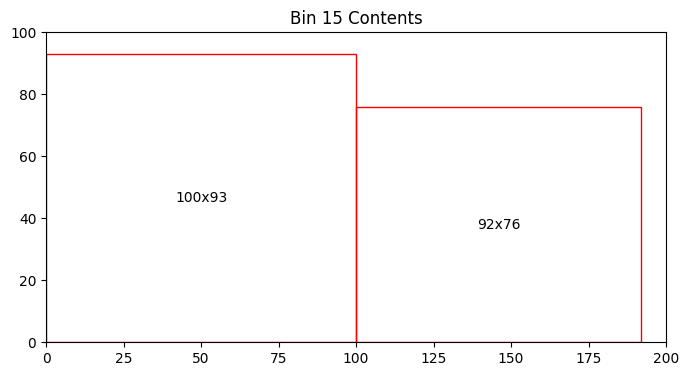

Bin 15 has 3708.00 units of area left


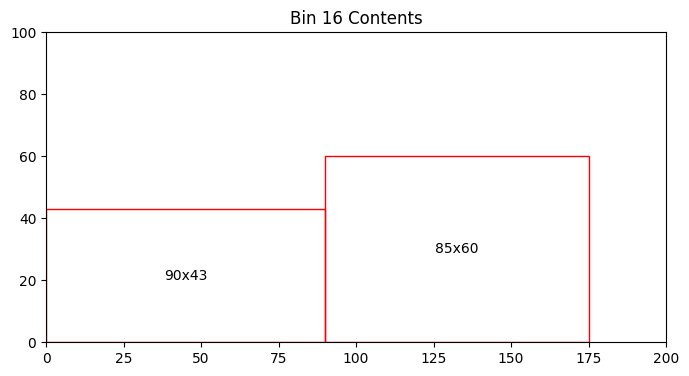

Bin 16 has 11030.00 units of area left


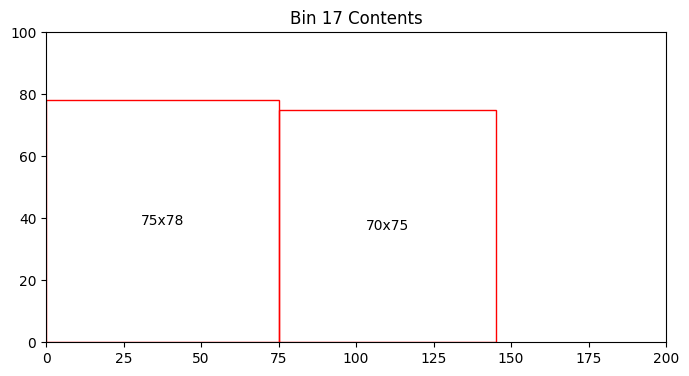

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


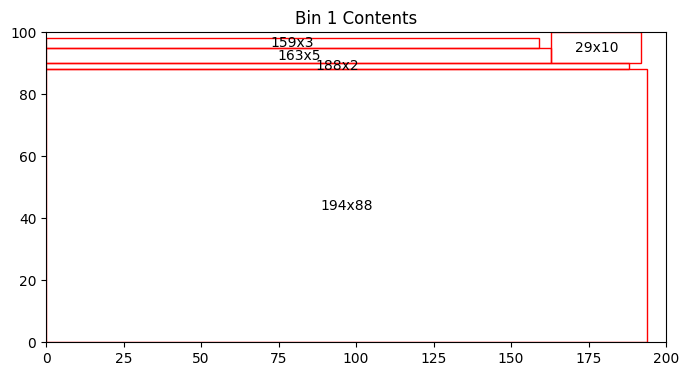

Bin 1 has 970.00 units of area left


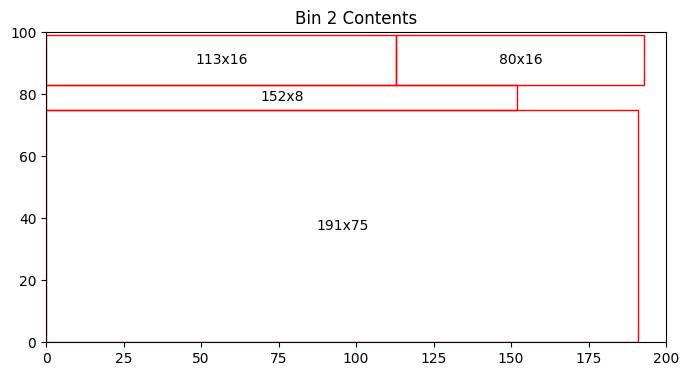

Bin 2 has 1371.00 units of area left


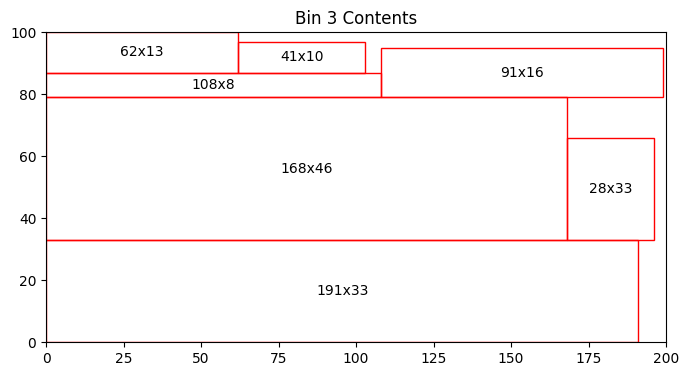

Bin 3 has 1509.00 units of area left


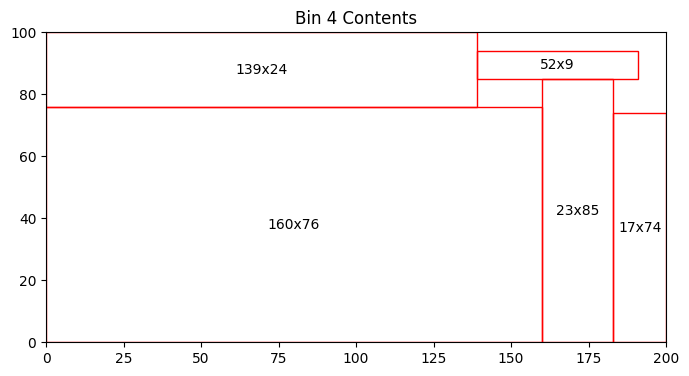

Bin 4 has 823.00 units of area left


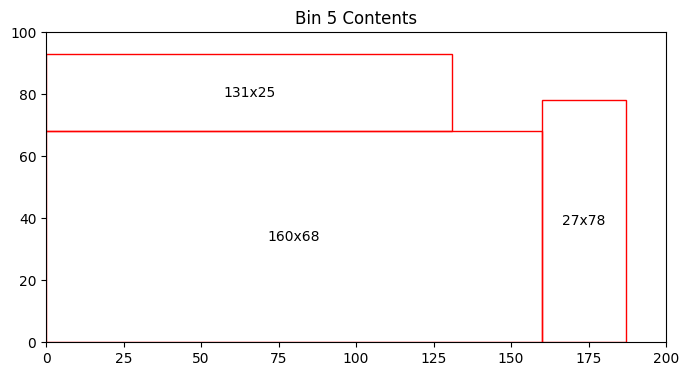

Bin 5 has 3739.00 units of area left


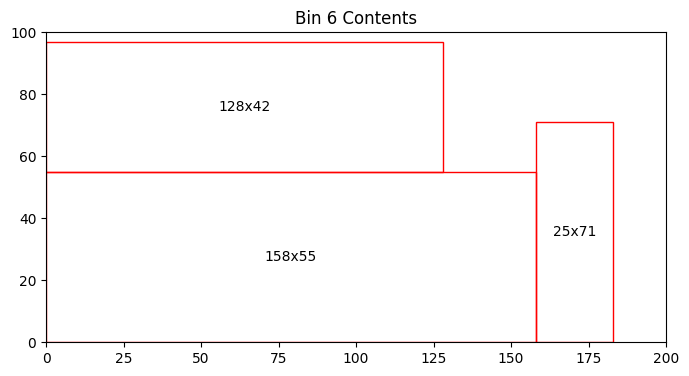

Bin 6 has 4159.00 units of area left


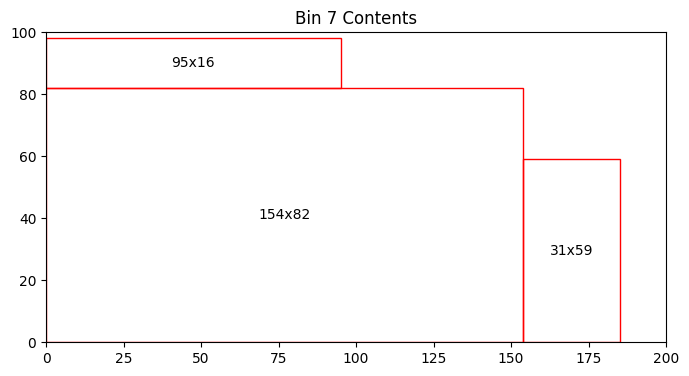

Bin 7 has 4023.00 units of area left


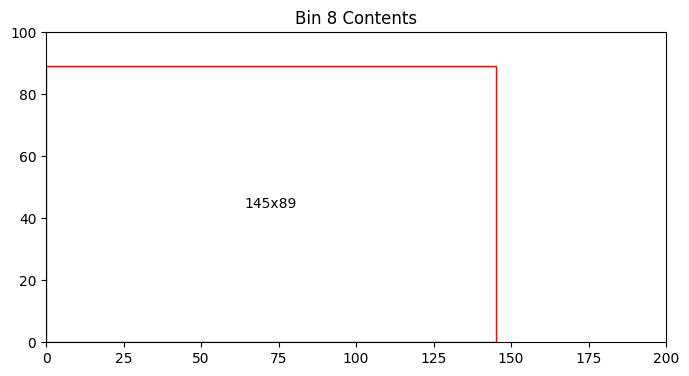

Bin 8 has 7095.00 units of area left


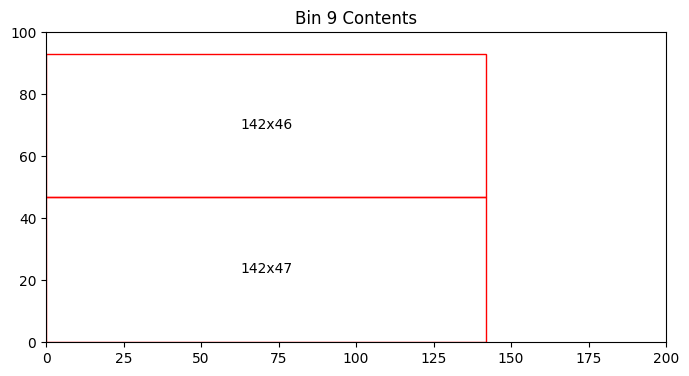

Bin 9 has 6794.00 units of area left


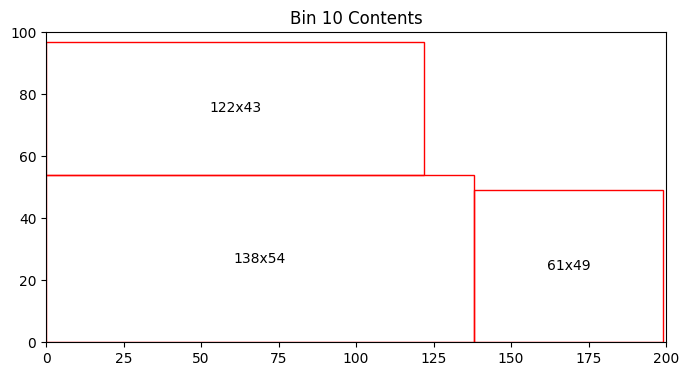

Bin 10 has 4313.00 units of area left


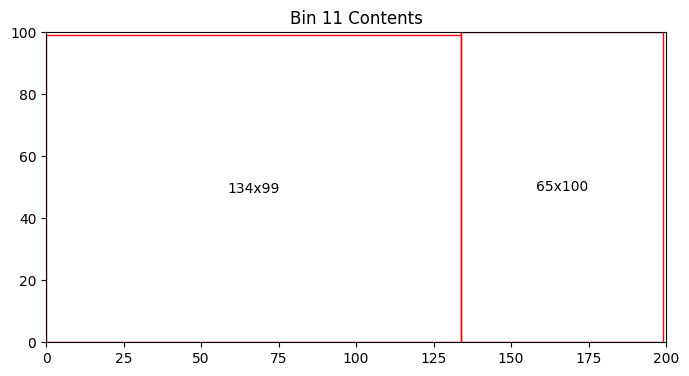

Bin 11 has 234.00 units of area left


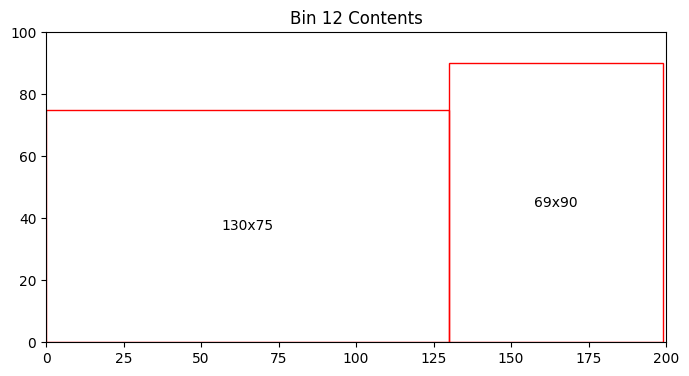

Bin 12 has 4040.00 units of area left


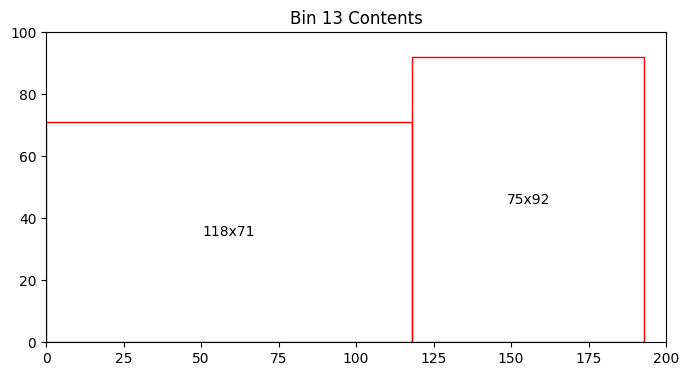

Bin 13 has 4722.00 units of area left


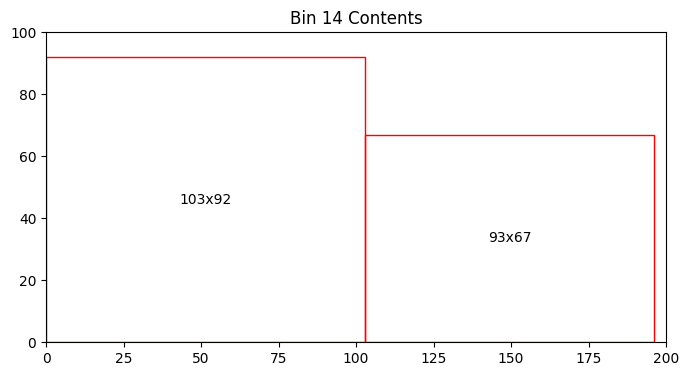

Bin 14 has 4293.00 units of area left


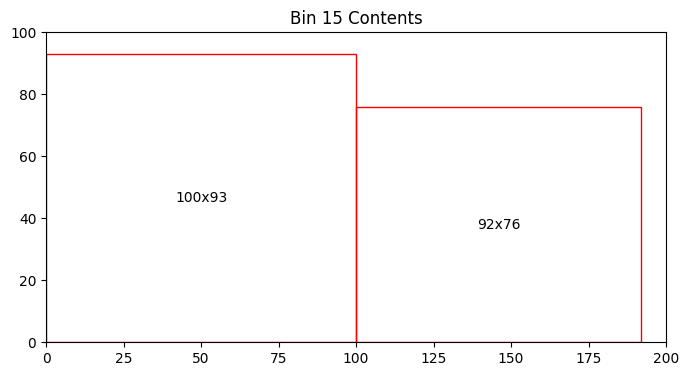

Bin 15 has 3708.00 units of area left


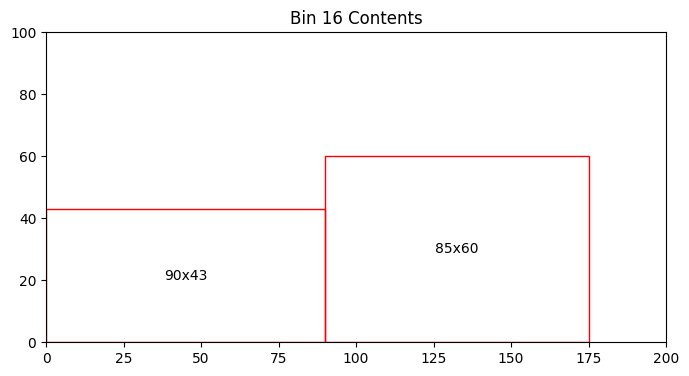

Bin 16 has 11030.00 units of area left


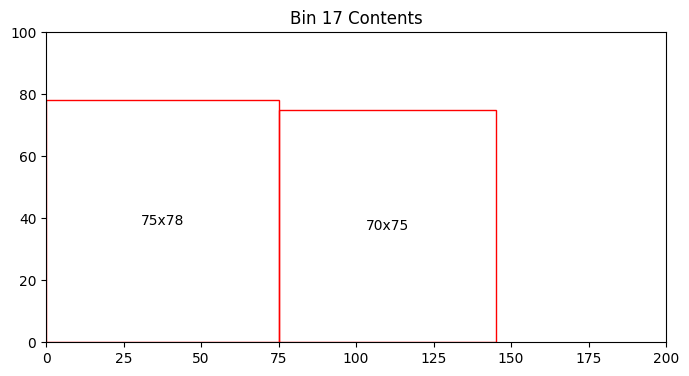

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


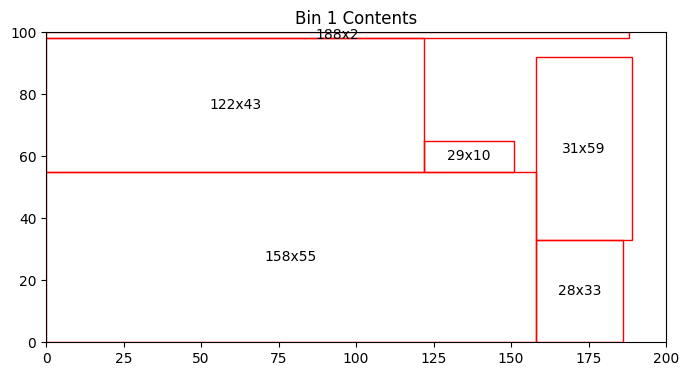

Bin 1 has 2645.00 units of area left


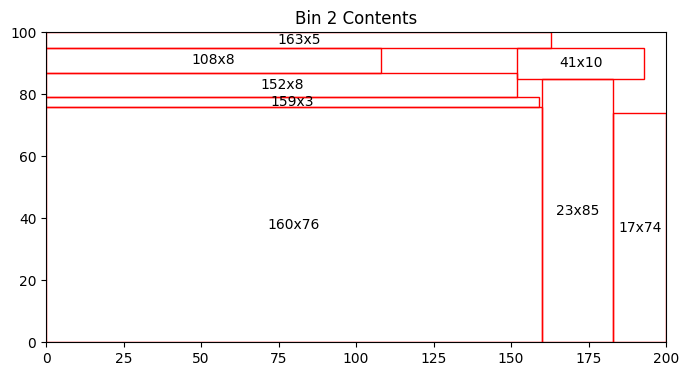

Bin 2 has 845.00 units of area left


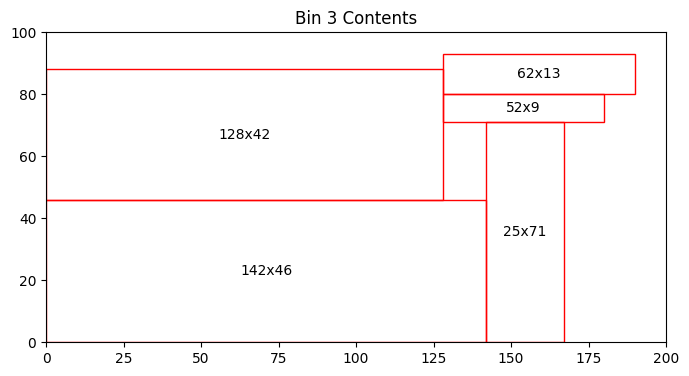

Bin 3 has 5043.00 units of area left


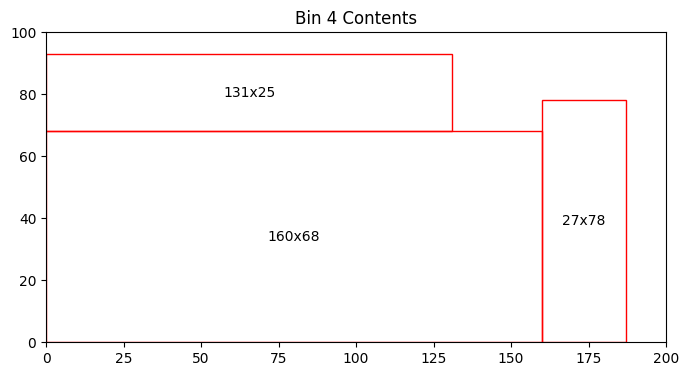

Bin 4 has 3739.00 units of area left


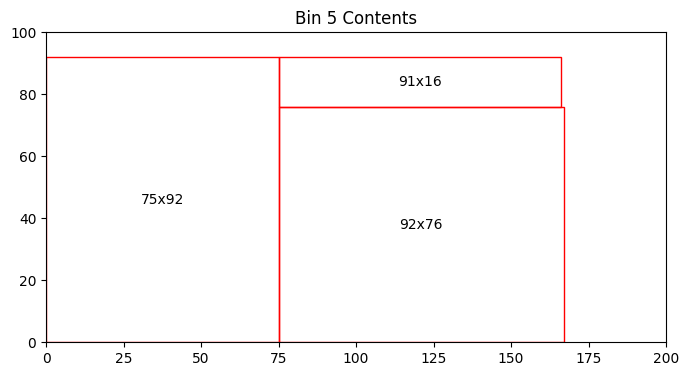

Bin 5 has 4652.00 units of area left


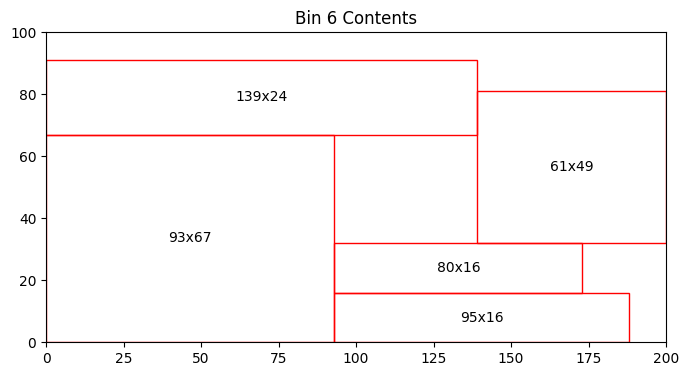

Bin 6 has 4644.00 units of area left


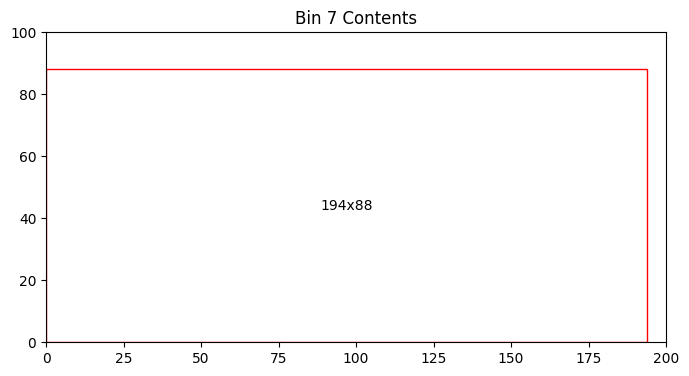

Bin 7 has 2928.00 units of area left


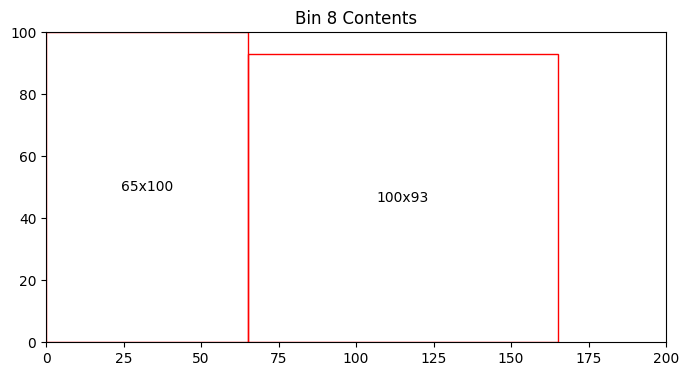

Bin 8 has 4200.00 units of area left


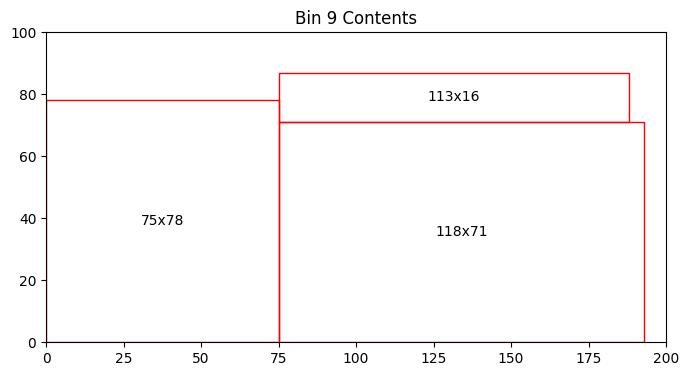

Bin 9 has 3964.00 units of area left


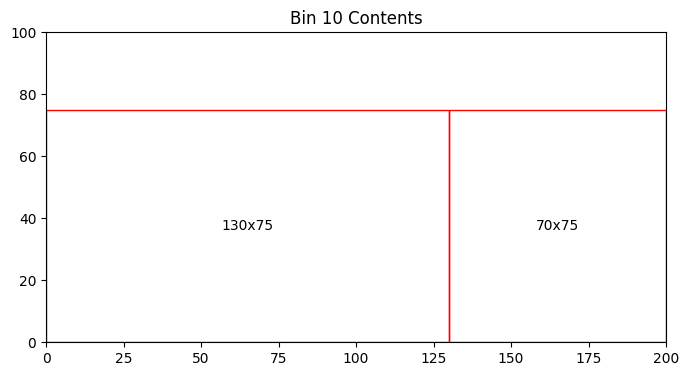

Bin 10 has 5000.00 units of area left


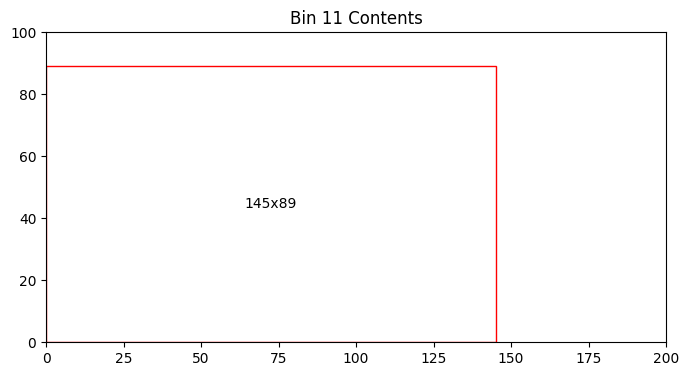

Bin 11 has 7095.00 units of area left


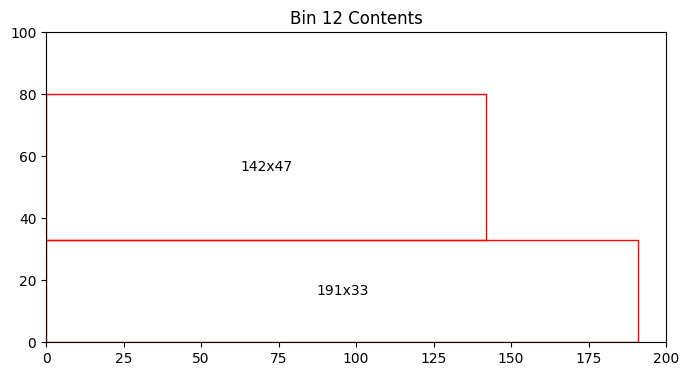

Bin 12 has 7023.00 units of area left


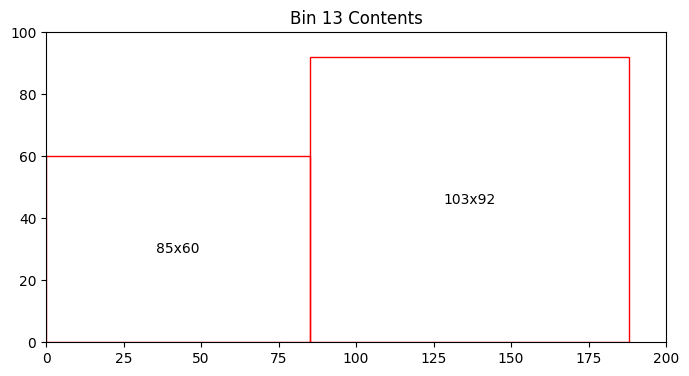

Bin 13 has 5424.00 units of area left


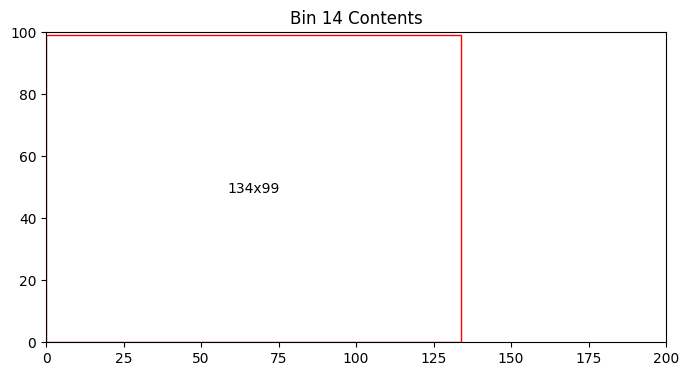

Bin 14 has 6734.00 units of area left


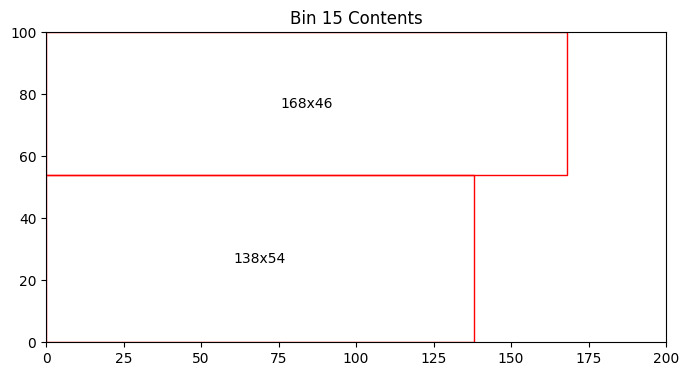

Bin 15 has 4820.00 units of area left


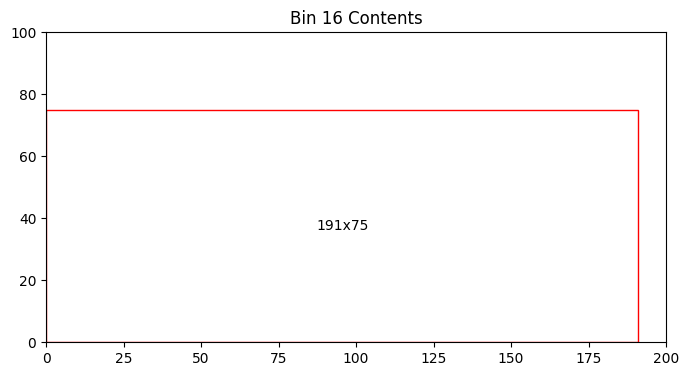

Bin 16 has 5675.00 units of area left


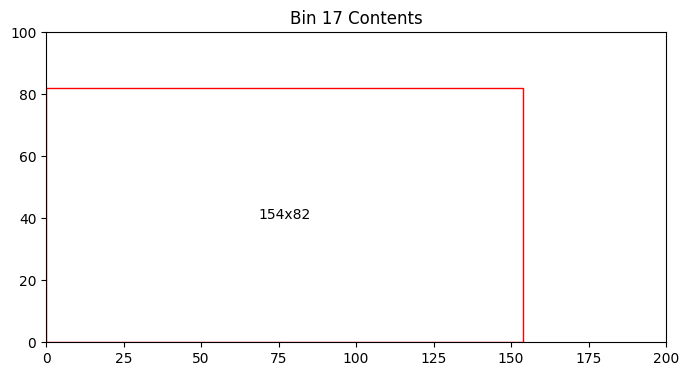

Bin 17 has 7372.00 units of area left


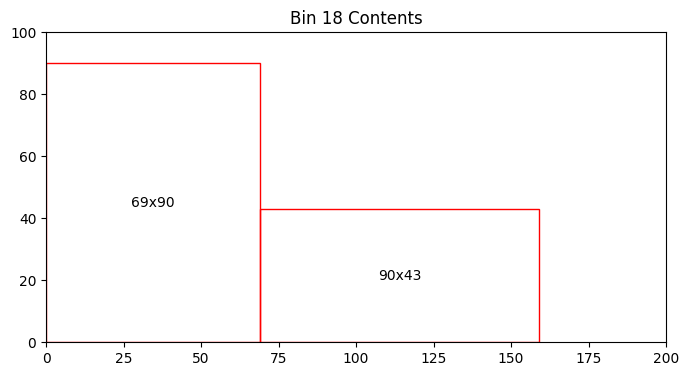

Bin 18 has 9920.00 units of area left
Total number of bins = 18
Total area left in bins = 91723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


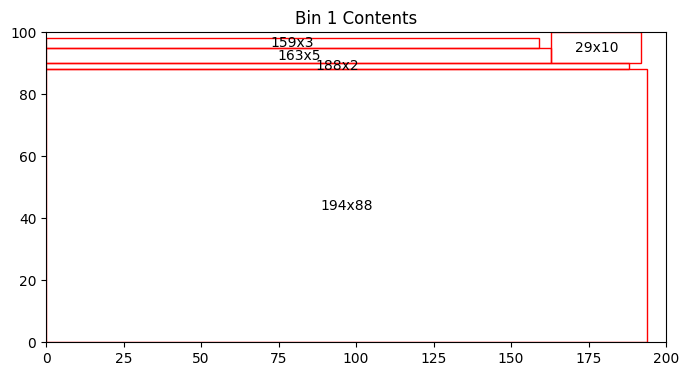

Bin 1 has 970.00 units of area left


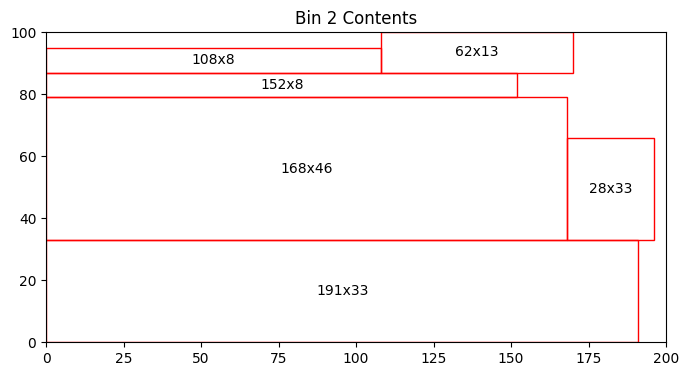

Bin 2 has 2159.00 units of area left


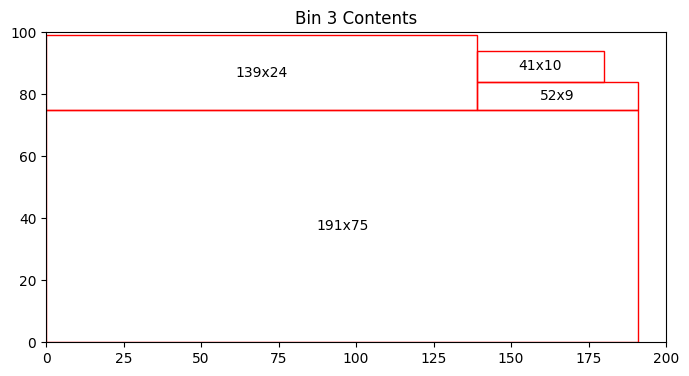

Bin 3 has 1461.00 units of area left


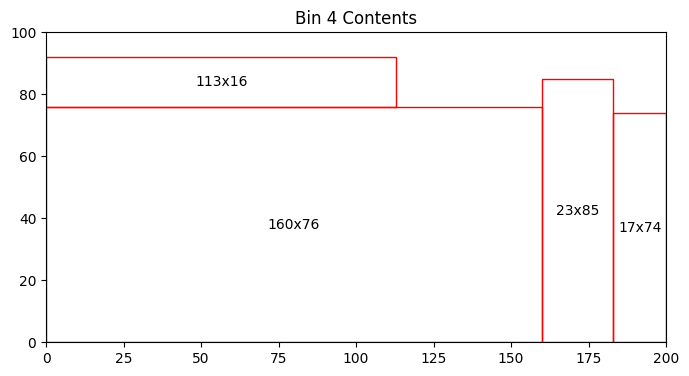

Bin 4 has 2819.00 units of area left


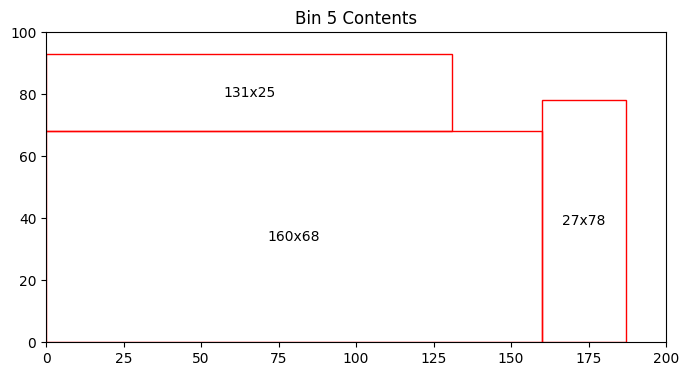

Bin 5 has 3739.00 units of area left


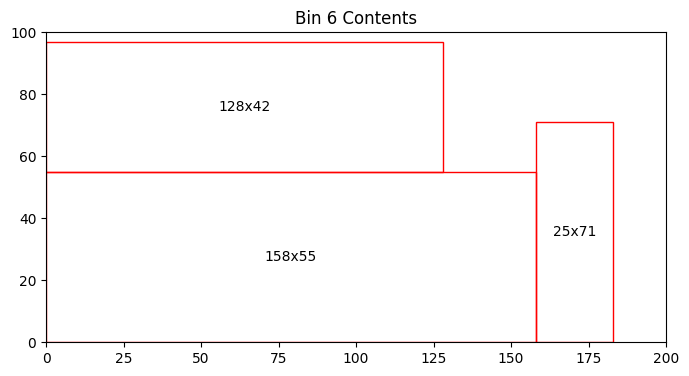

Bin 6 has 4159.00 units of area left


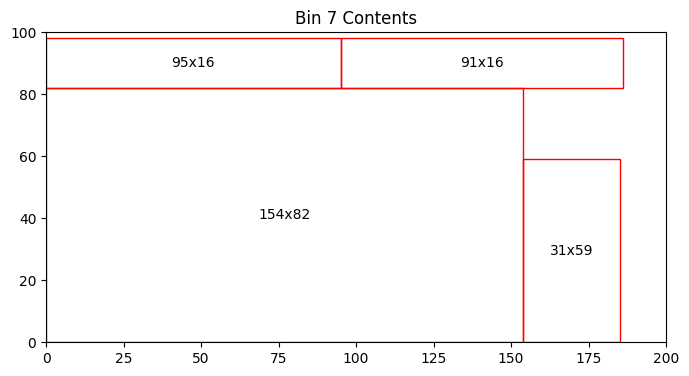

Bin 7 has 2567.00 units of area left


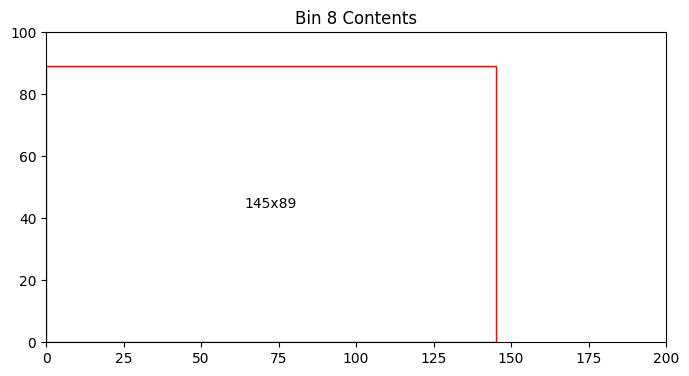

Bin 8 has 7095.00 units of area left


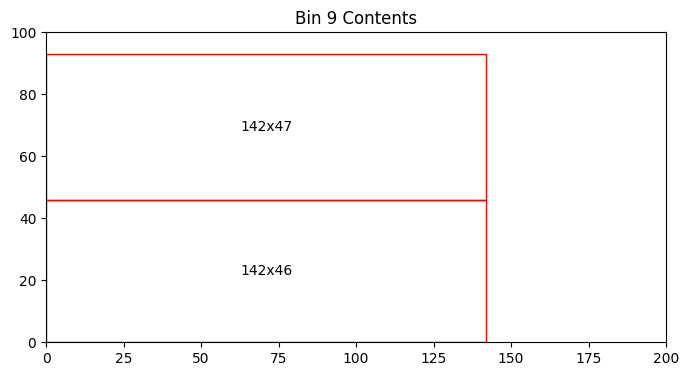

Bin 9 has 6794.00 units of area left


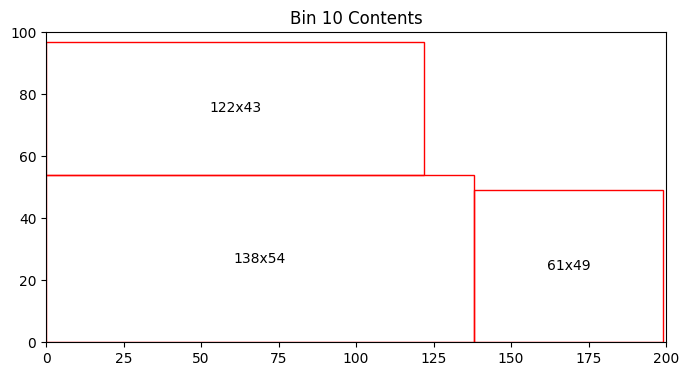

Bin 10 has 4313.00 units of area left


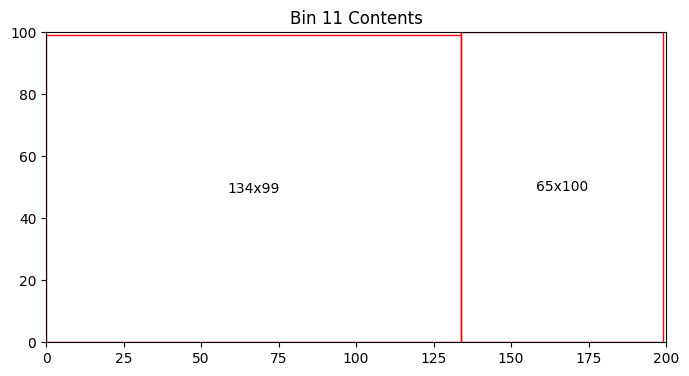

Bin 11 has 234.00 units of area left


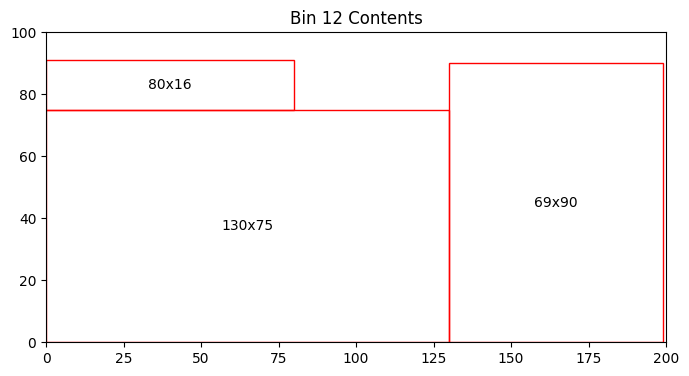

Bin 12 has 2760.00 units of area left


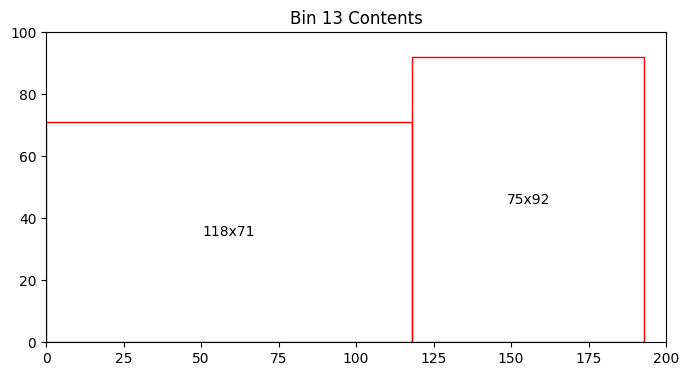

Bin 13 has 4722.00 units of area left


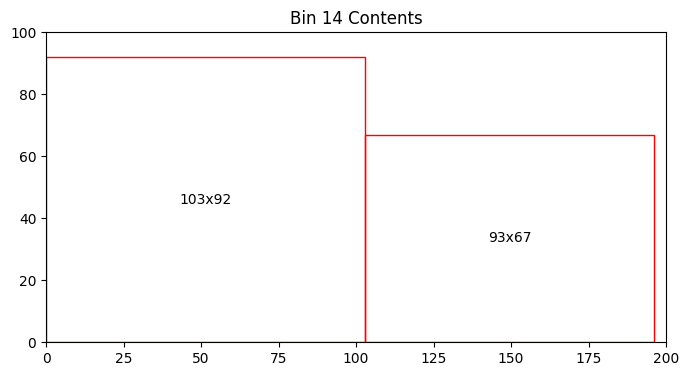

Bin 14 has 4293.00 units of area left


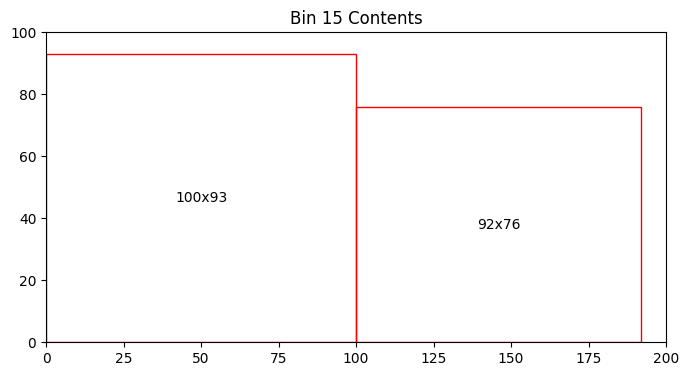

Bin 15 has 3708.00 units of area left


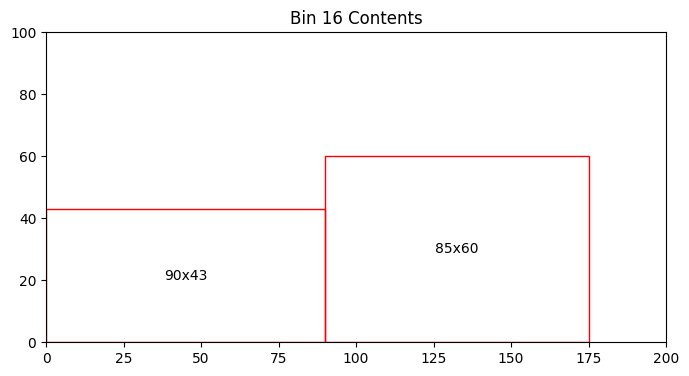

Bin 16 has 11030.00 units of area left


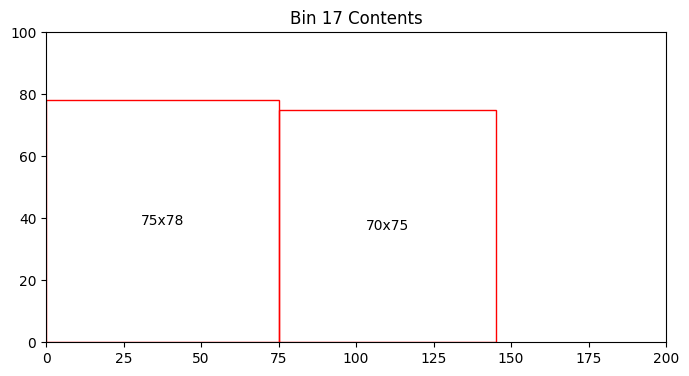

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


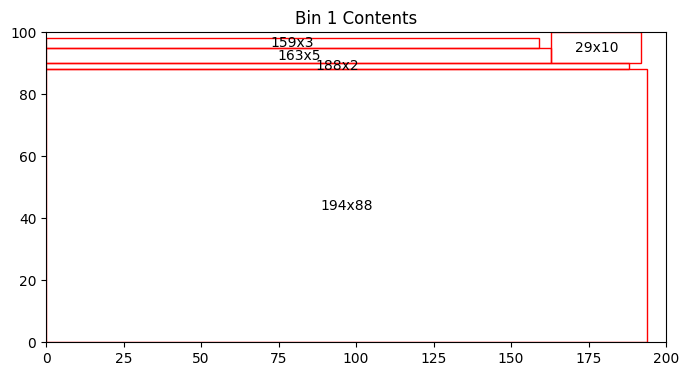

Bin 1 has 970.00 units of area left


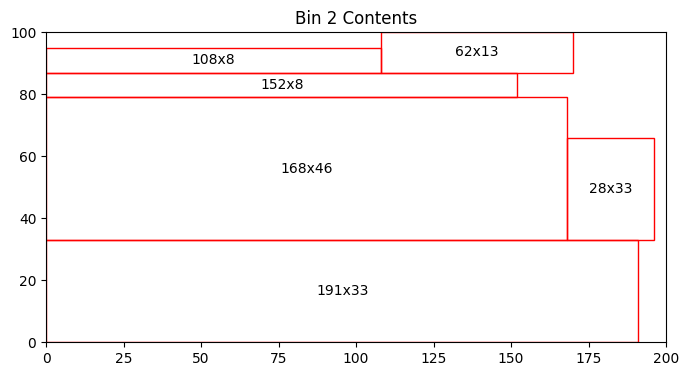

Bin 2 has 2159.00 units of area left


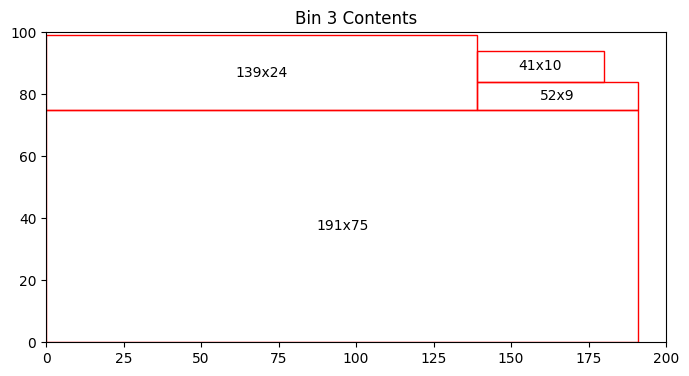

Bin 3 has 1461.00 units of area left


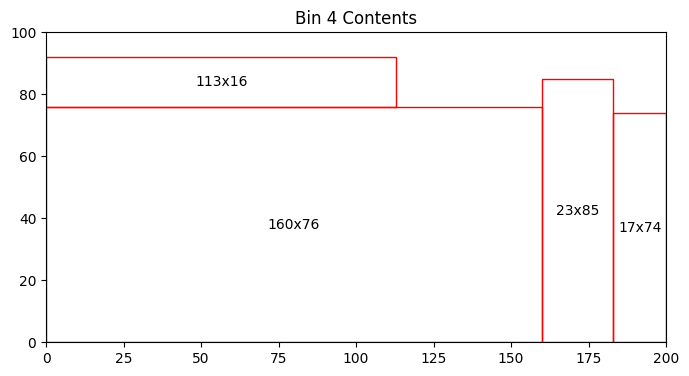

Bin 4 has 2819.00 units of area left


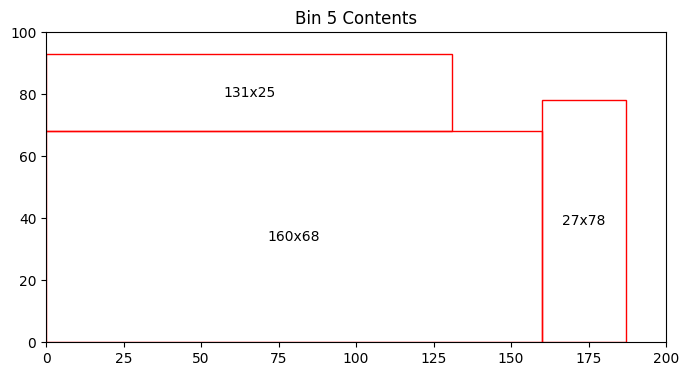

Bin 5 has 3739.00 units of area left


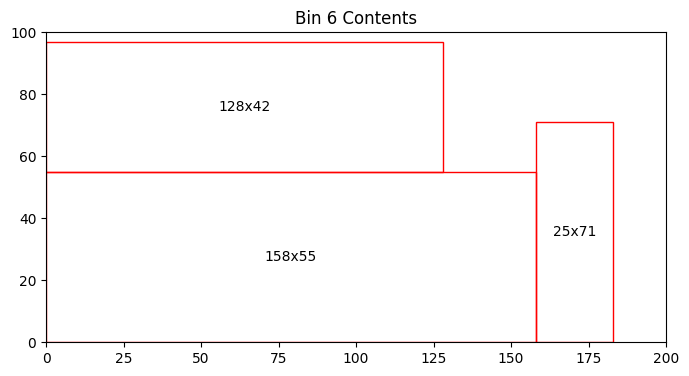

Bin 6 has 4159.00 units of area left


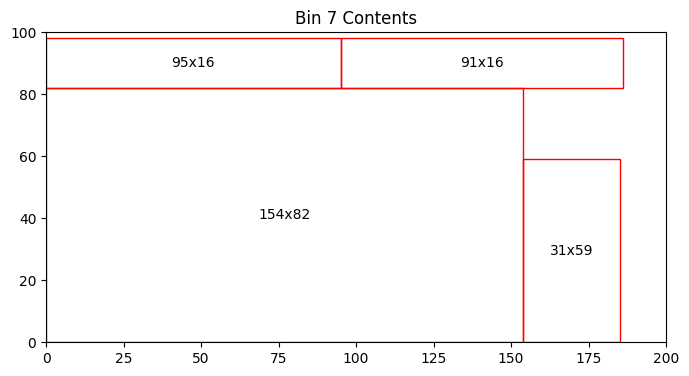

Bin 7 has 2567.00 units of area left


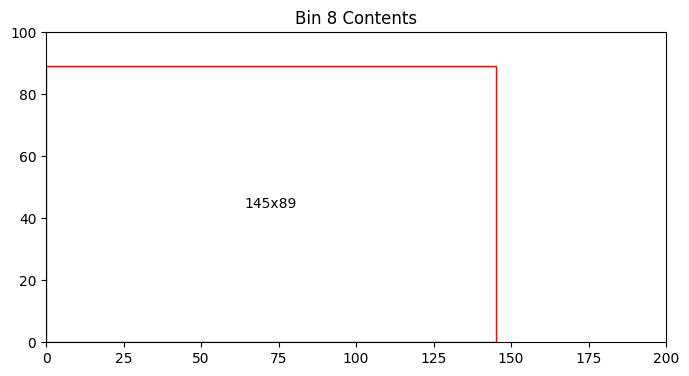

Bin 8 has 7095.00 units of area left


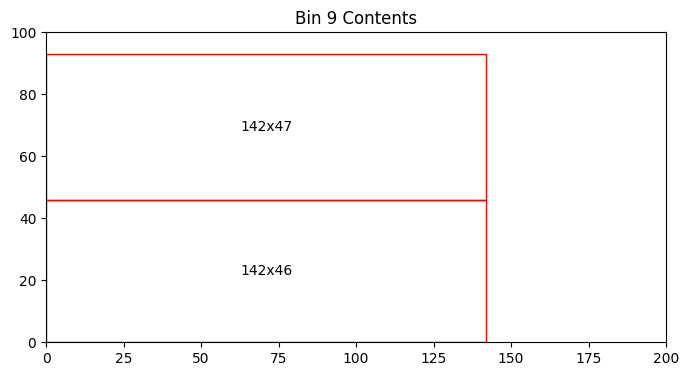

Bin 9 has 6794.00 units of area left


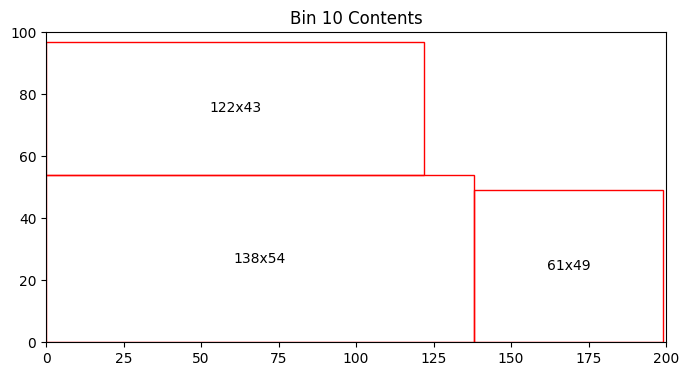

Bin 10 has 4313.00 units of area left


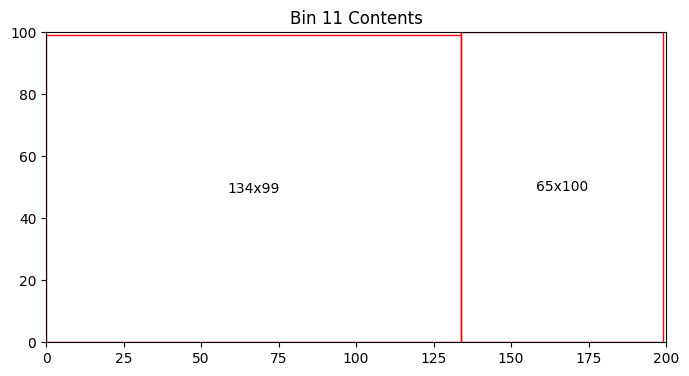

Bin 11 has 234.00 units of area left


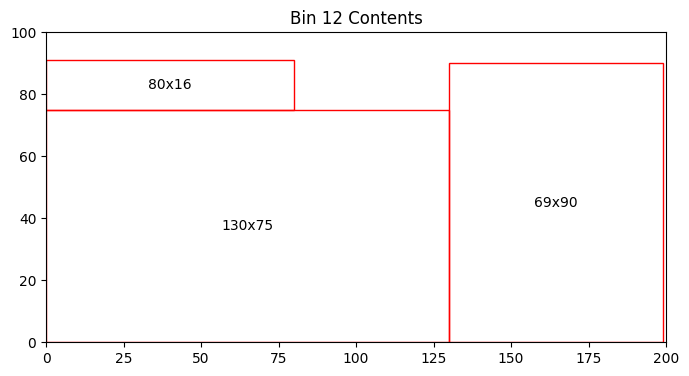

Bin 12 has 2760.00 units of area left


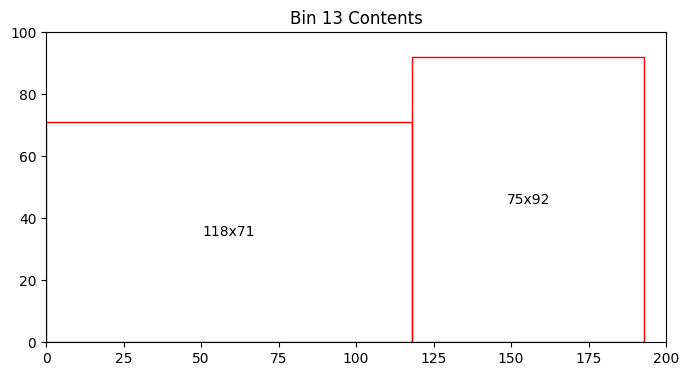

Bin 13 has 4722.00 units of area left


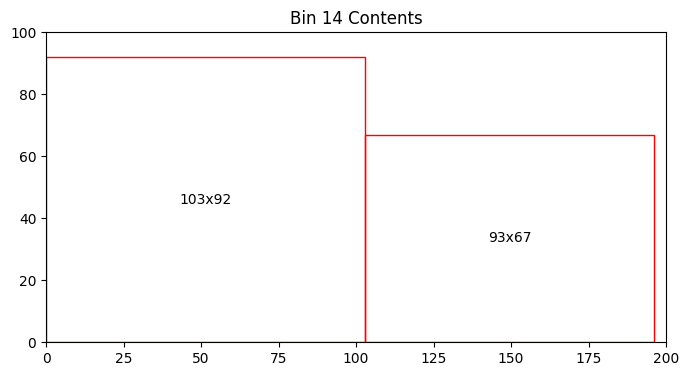

Bin 14 has 4293.00 units of area left


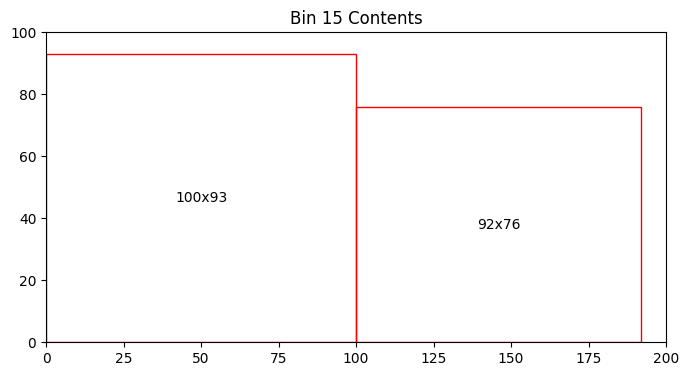

Bin 15 has 3708.00 units of area left


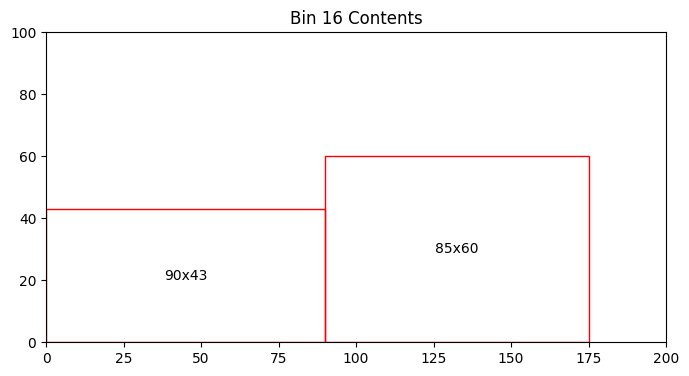

Bin 16 has 11030.00 units of area left


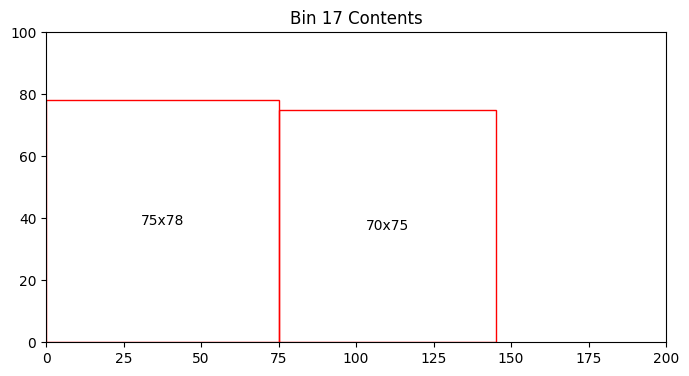

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


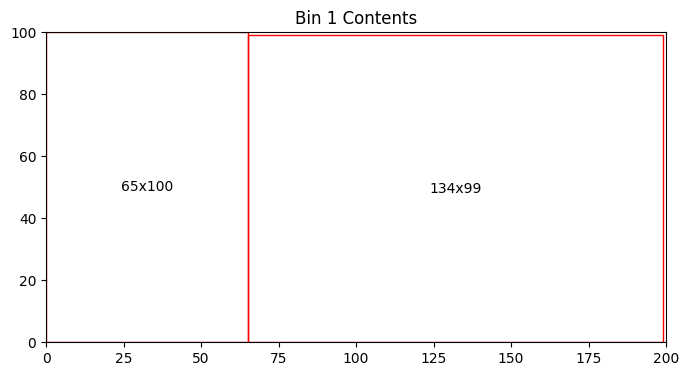

Bin 1 has 234.00 units of area left


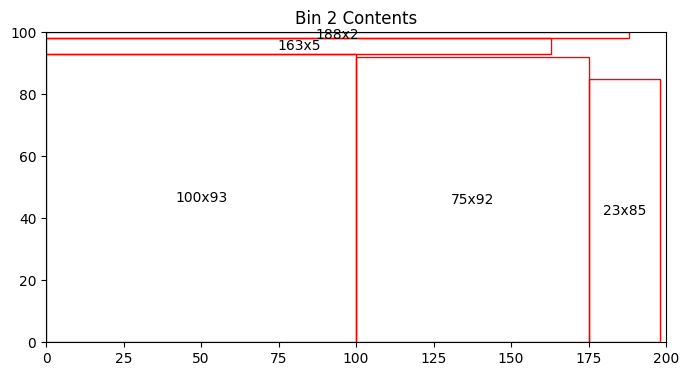

Bin 2 has 654.00 units of area left


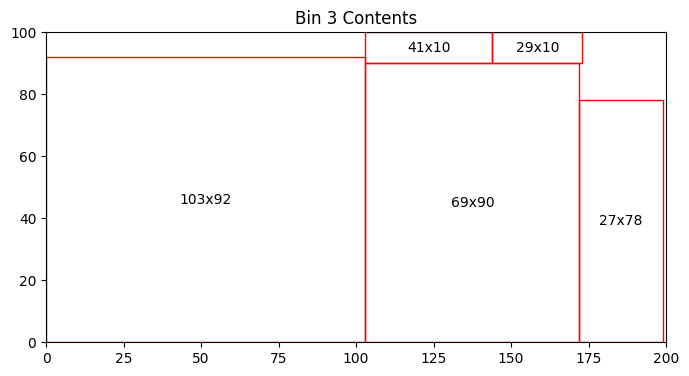

Bin 3 has 1508.00 units of area left


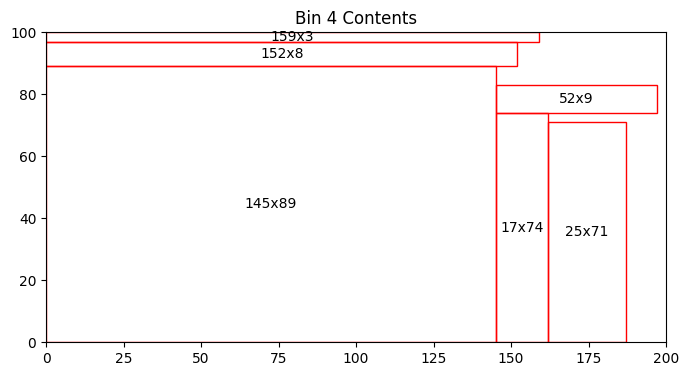

Bin 4 has 1901.00 units of area left


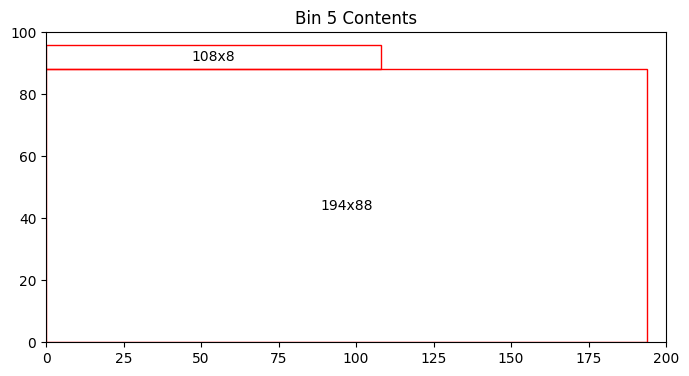

Bin 5 has 2064.00 units of area left


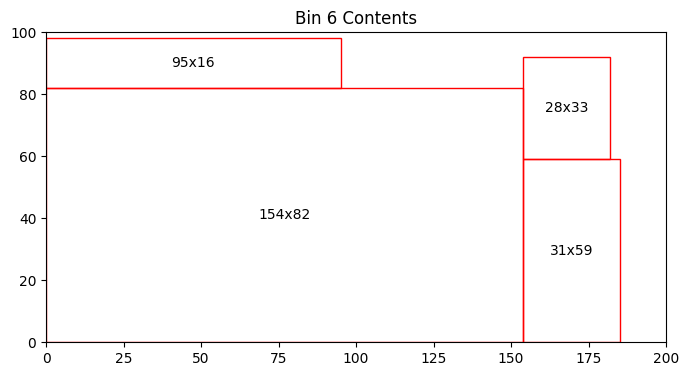

Bin 6 has 3099.00 units of area left


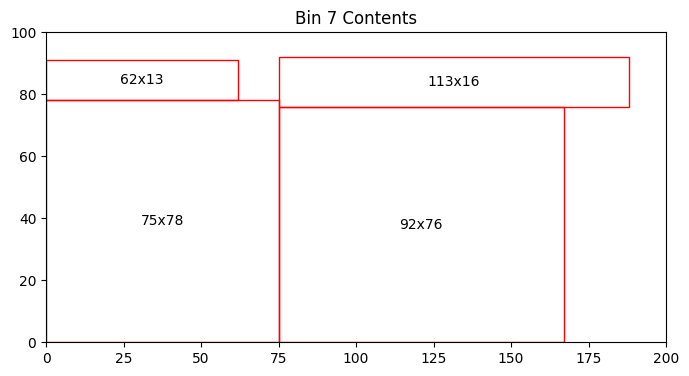

Bin 7 has 4544.00 units of area left


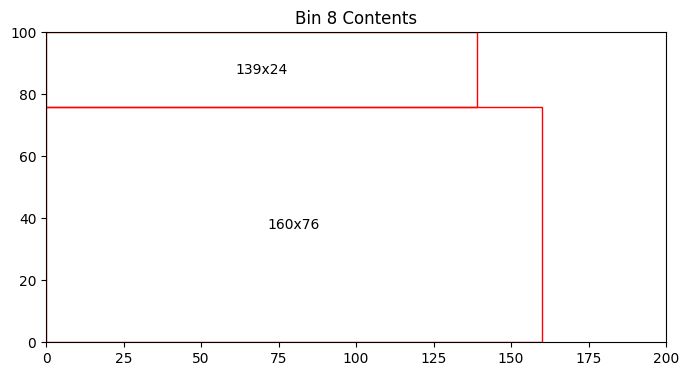

Bin 8 has 4504.00 units of area left


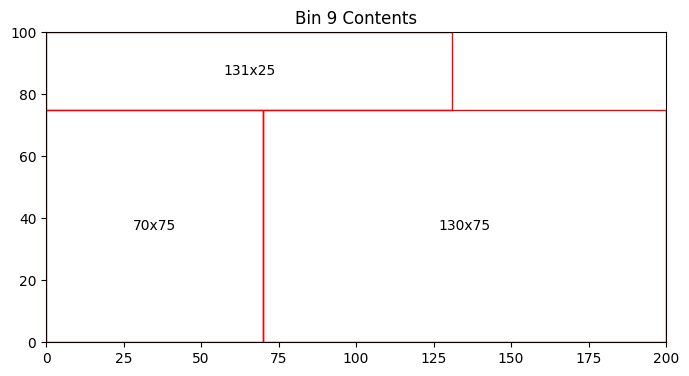

Bin 9 has 1725.00 units of area left


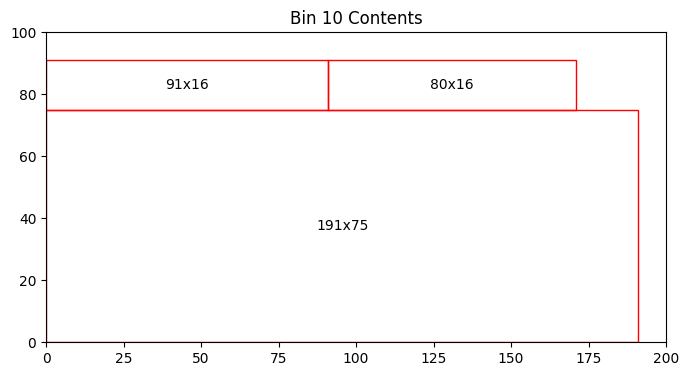

Bin 10 has 2939.00 units of area left


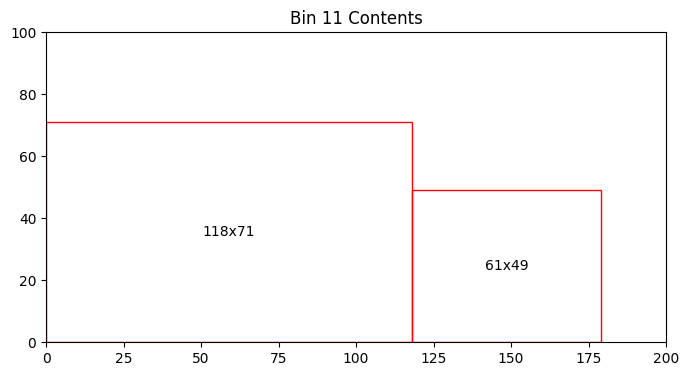

Bin 11 has 8633.00 units of area left


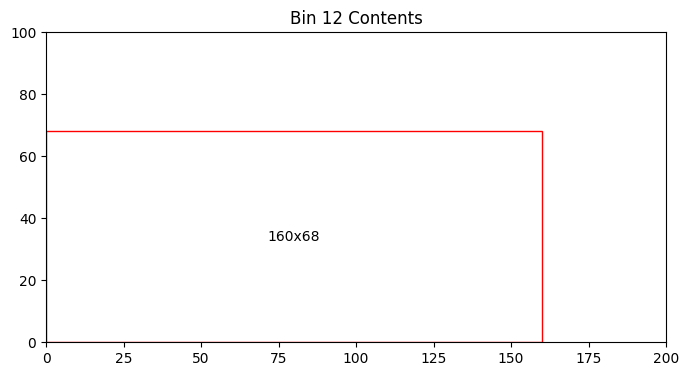

Bin 12 has 9120.00 units of area left


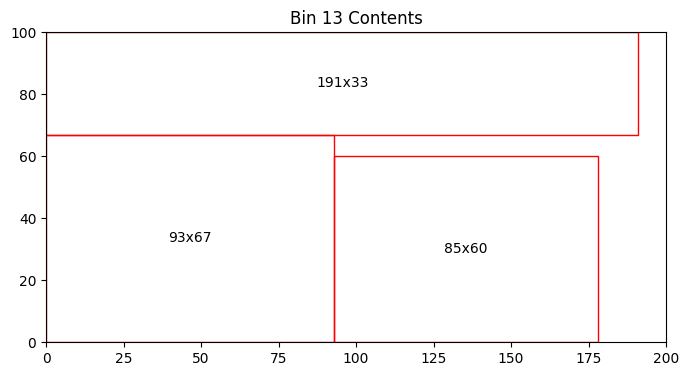

Bin 13 has 2366.00 units of area left


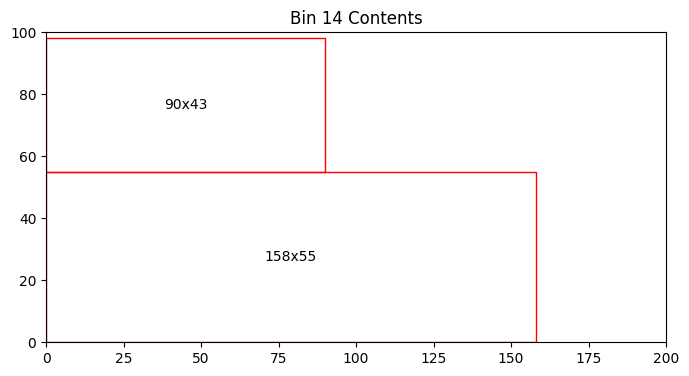

Bin 14 has 7440.00 units of area left


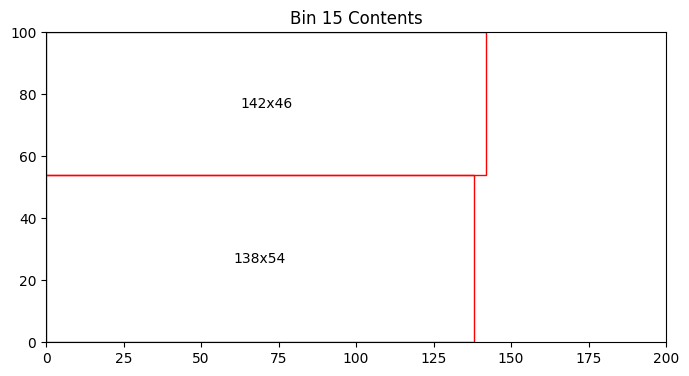

Bin 15 has 6016.00 units of area left


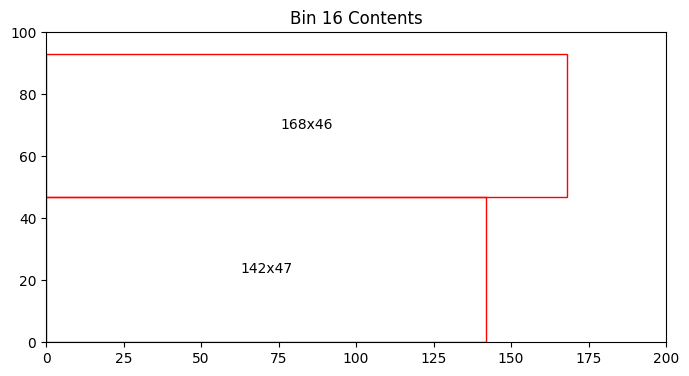

Bin 16 has 5598.00 units of area left


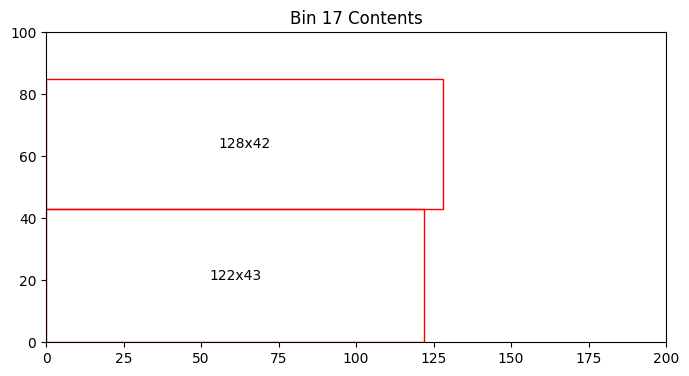

Bin 17 has 9378.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


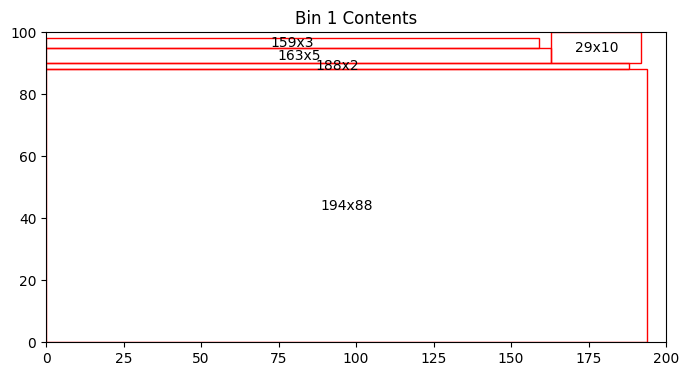

Bin 1 has 970.00 units of area left


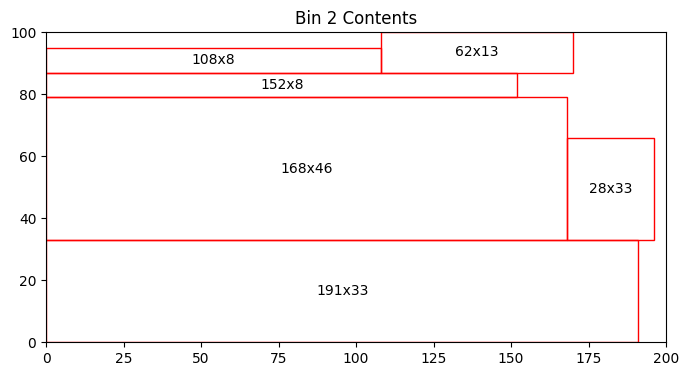

Bin 2 has 2159.00 units of area left


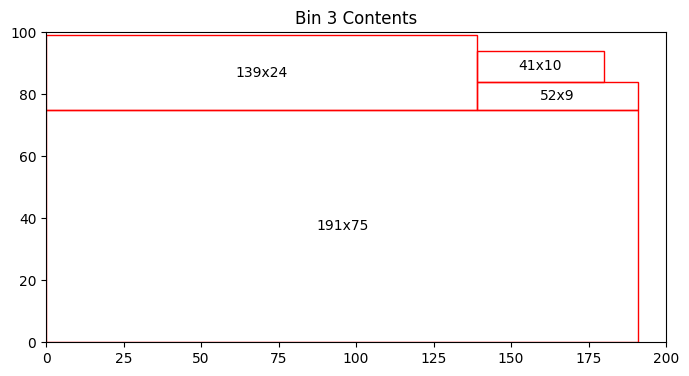

Bin 3 has 1461.00 units of area left


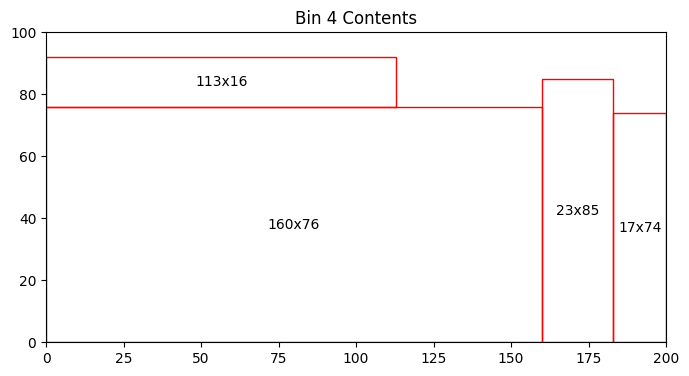

Bin 4 has 2819.00 units of area left


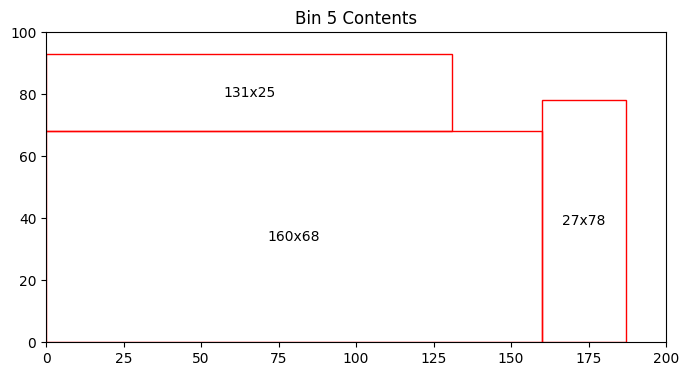

Bin 5 has 3739.00 units of area left


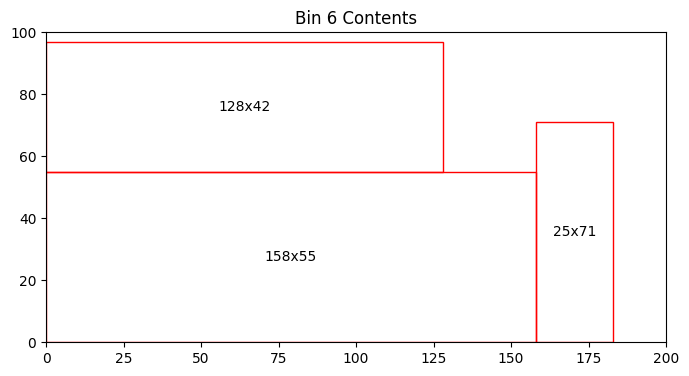

Bin 6 has 4159.00 units of area left


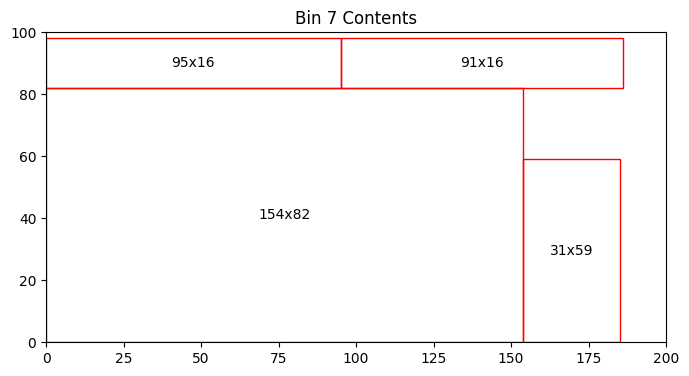

Bin 7 has 2567.00 units of area left


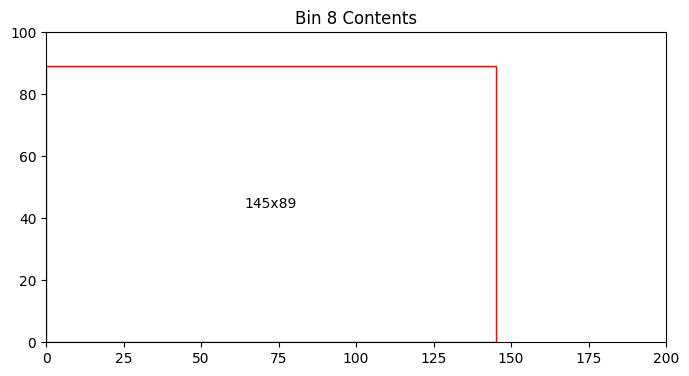

Bin 8 has 7095.00 units of area left


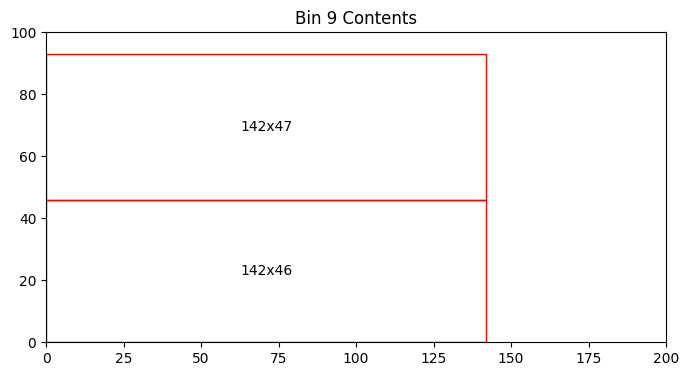

Bin 9 has 6794.00 units of area left


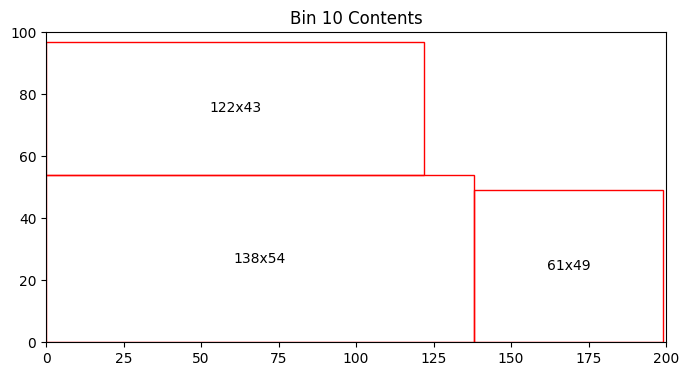

Bin 10 has 4313.00 units of area left


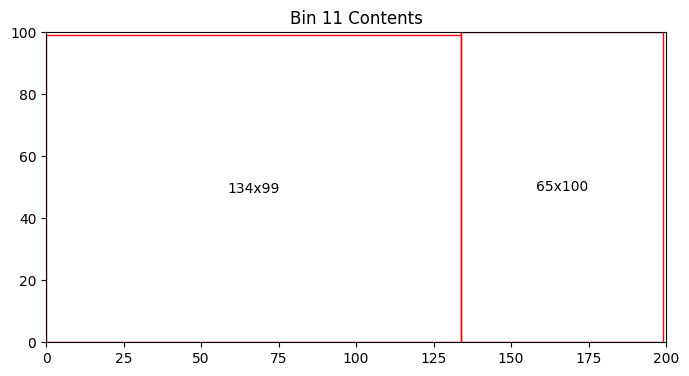

Bin 11 has 234.00 units of area left


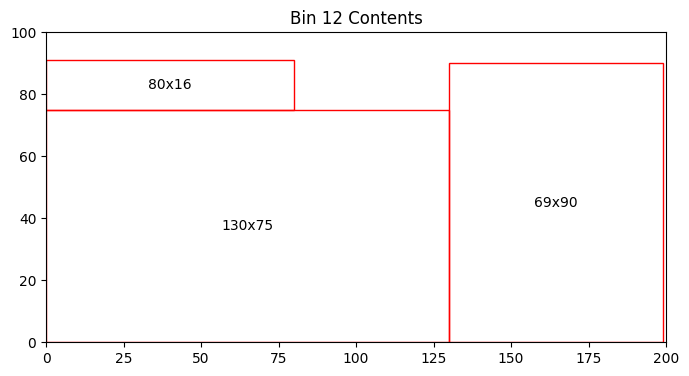

Bin 12 has 2760.00 units of area left


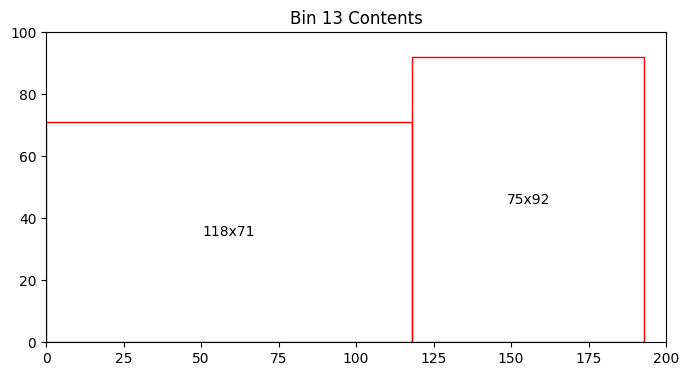

Bin 13 has 4722.00 units of area left


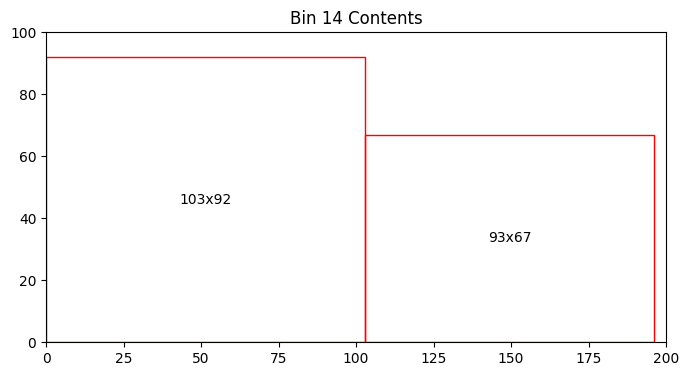

Bin 14 has 4293.00 units of area left


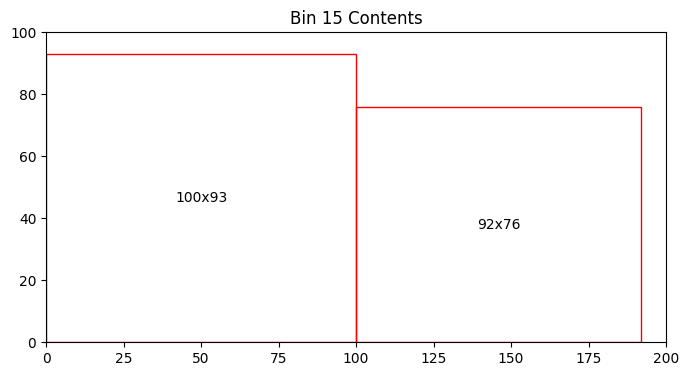

Bin 15 has 3708.00 units of area left


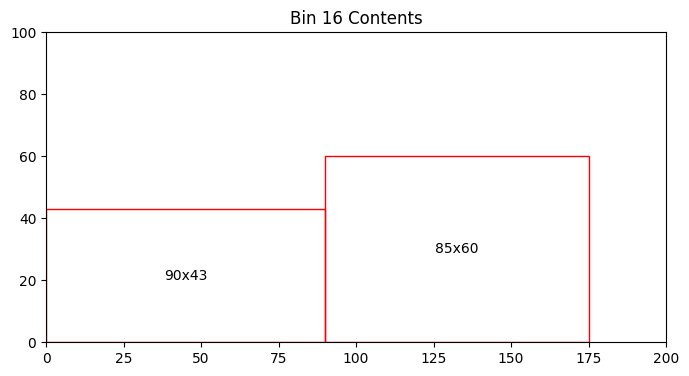

Bin 16 has 11030.00 units of area left


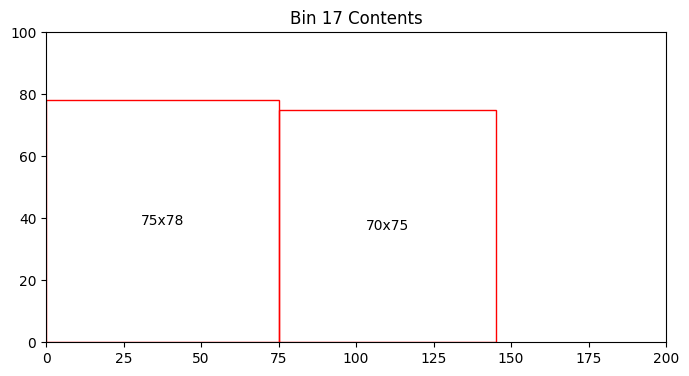

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


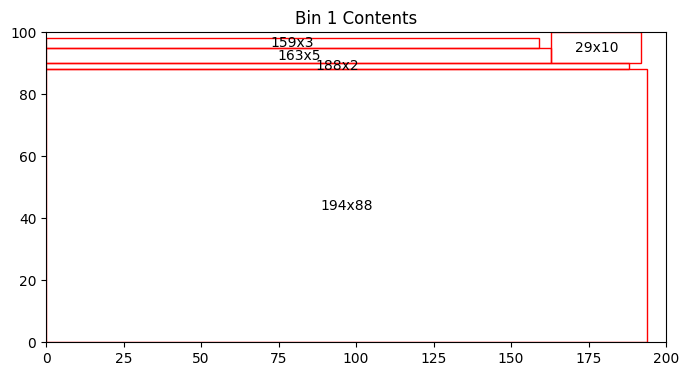

Bin 1 has 970.00 units of area left


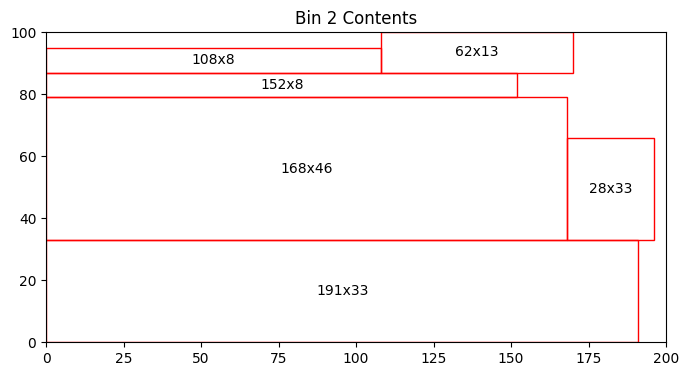

Bin 2 has 2159.00 units of area left


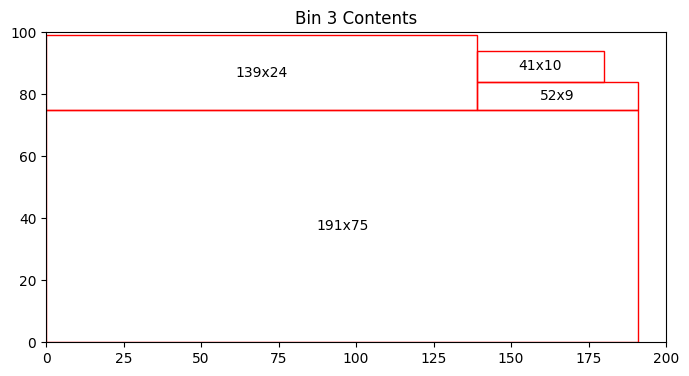

Bin 3 has 1461.00 units of area left


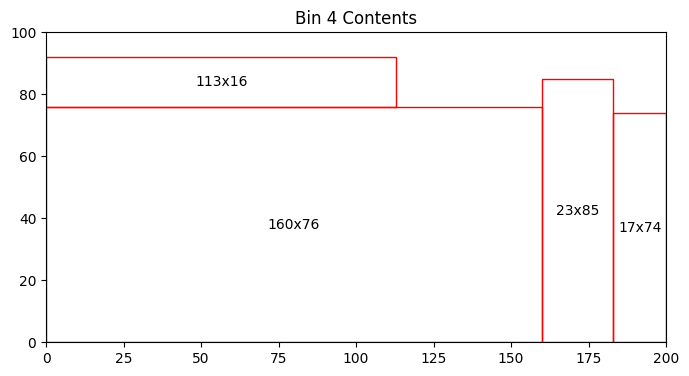

Bin 4 has 2819.00 units of area left


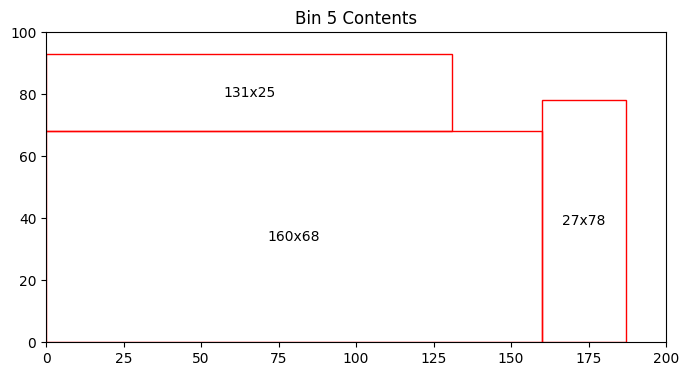

Bin 5 has 3739.00 units of area left


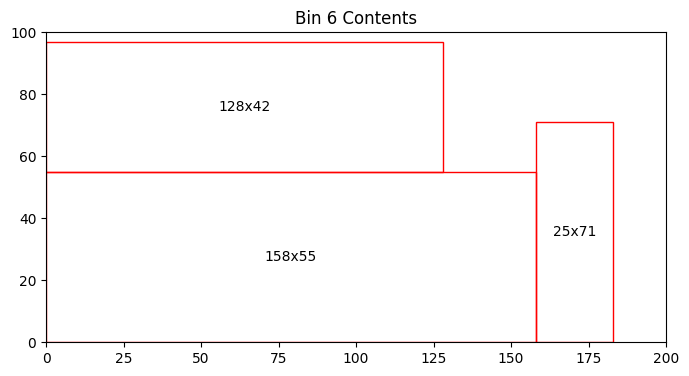

Bin 6 has 4159.00 units of area left


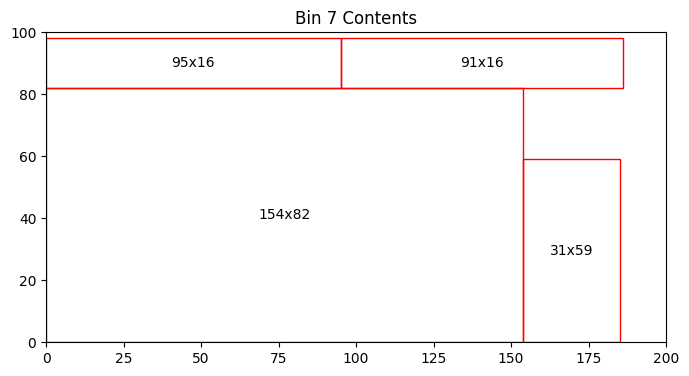

Bin 7 has 2567.00 units of area left


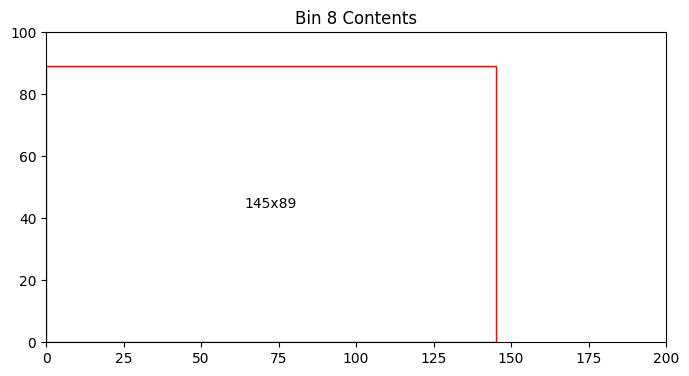

Bin 8 has 7095.00 units of area left


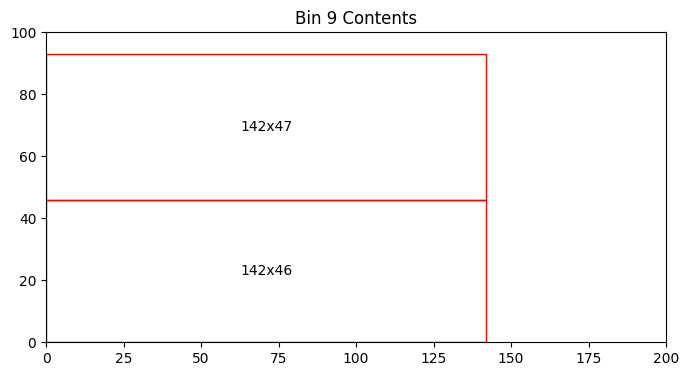

Bin 9 has 6794.00 units of area left


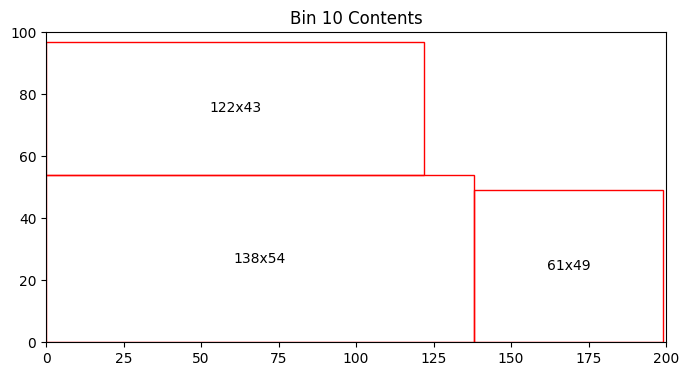

Bin 10 has 4313.00 units of area left


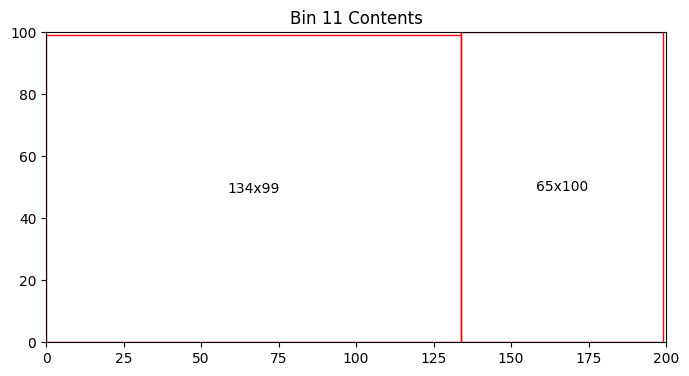

Bin 11 has 234.00 units of area left


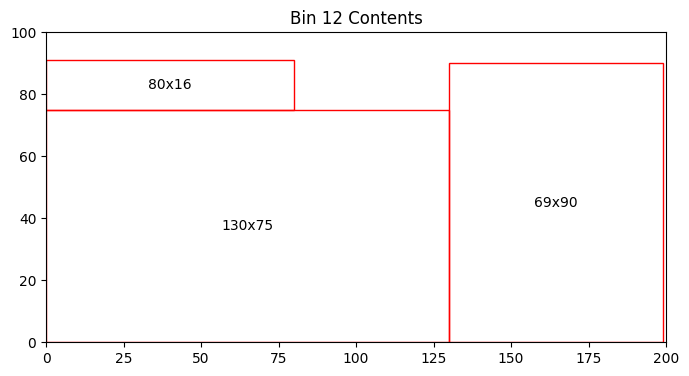

Bin 12 has 2760.00 units of area left


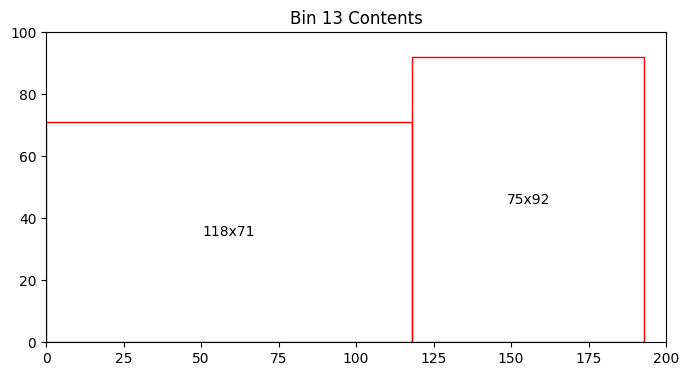

Bin 13 has 4722.00 units of area left


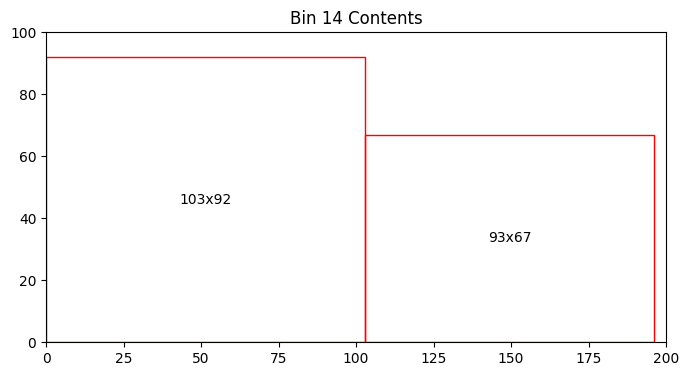

Bin 14 has 4293.00 units of area left


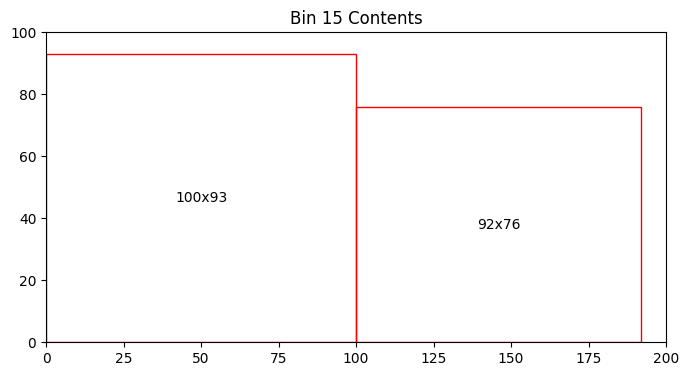

Bin 15 has 3708.00 units of area left


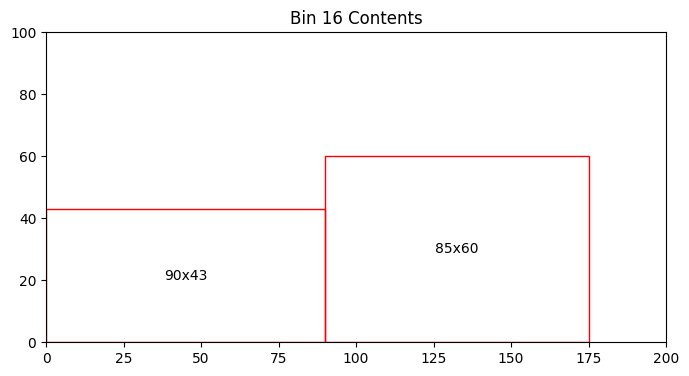

Bin 16 has 11030.00 units of area left


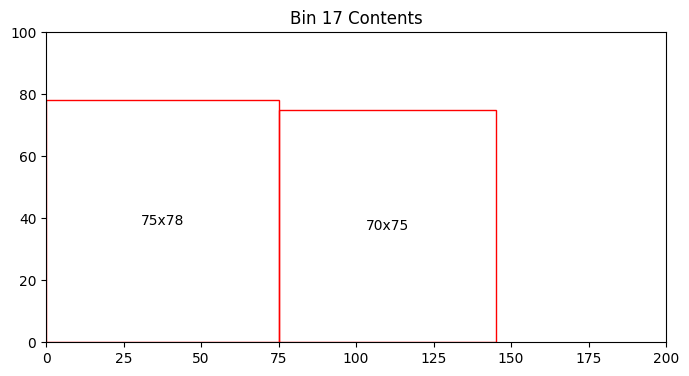

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


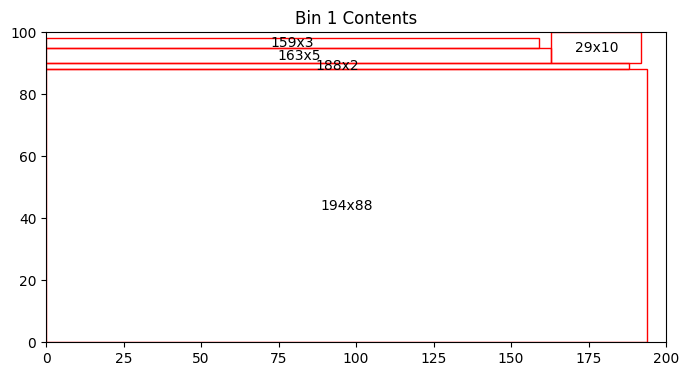

Bin 1 has 970.00 units of area left


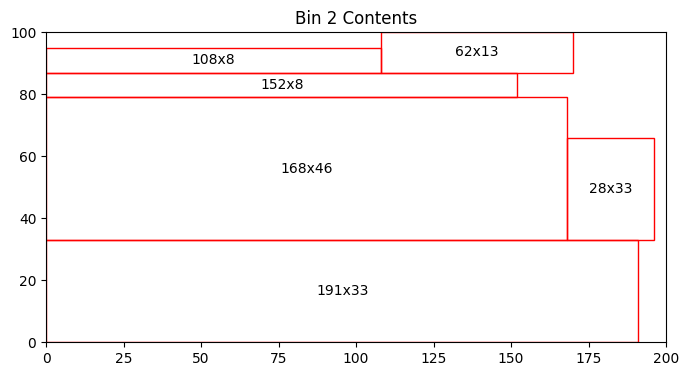

Bin 2 has 2159.00 units of area left


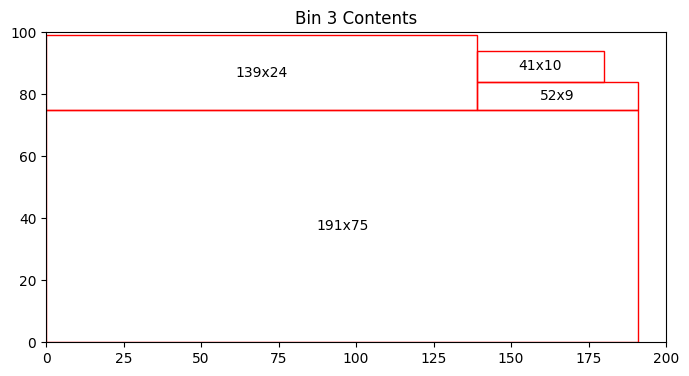

Bin 3 has 1461.00 units of area left


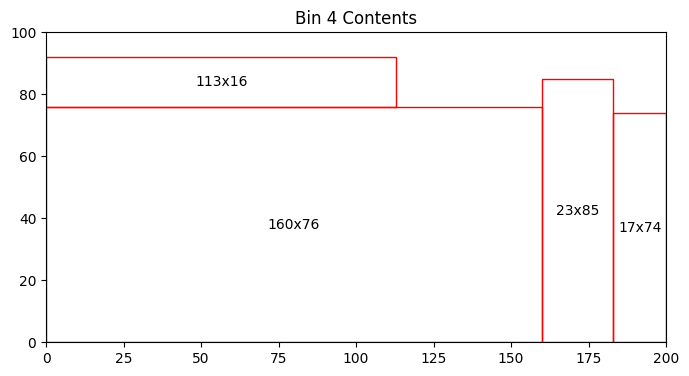

Bin 4 has 2819.00 units of area left


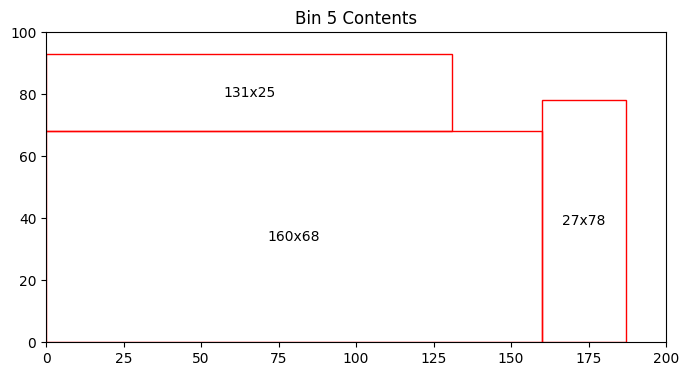

Bin 5 has 3739.00 units of area left


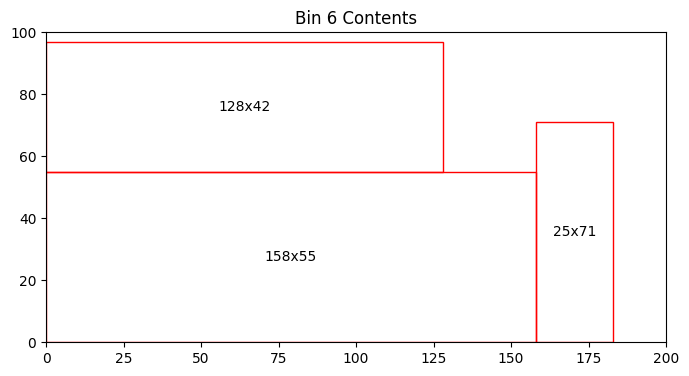

Bin 6 has 4159.00 units of area left


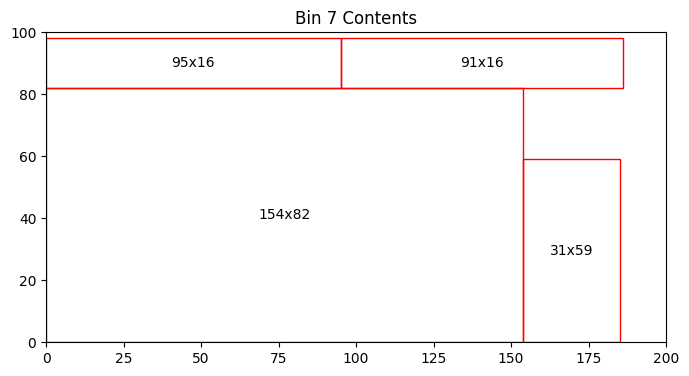

Bin 7 has 2567.00 units of area left


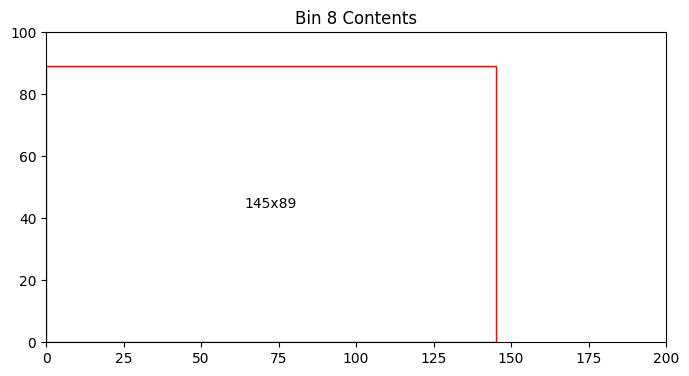

Bin 8 has 7095.00 units of area left


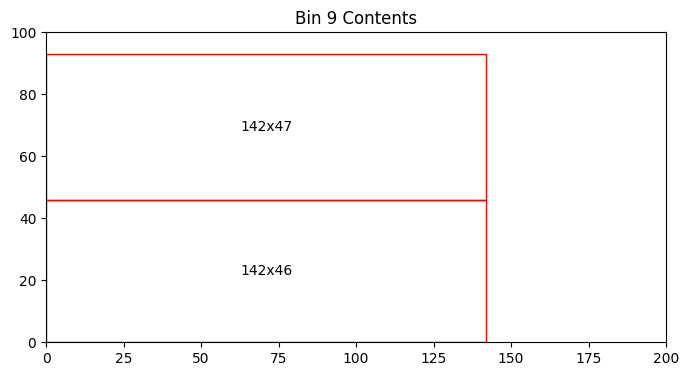

Bin 9 has 6794.00 units of area left


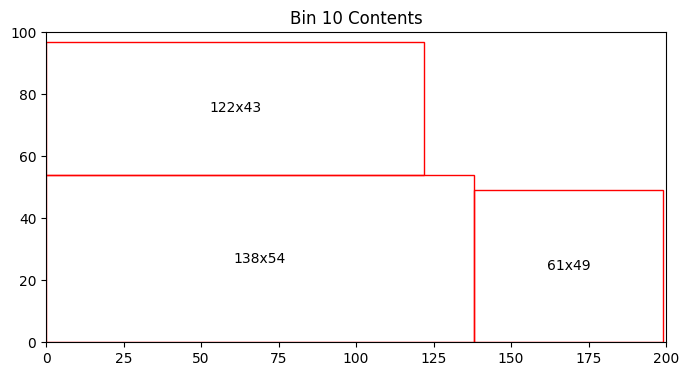

Bin 10 has 4313.00 units of area left


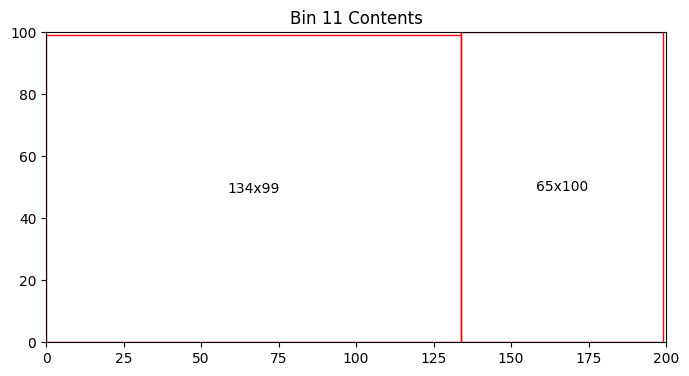

Bin 11 has 234.00 units of area left


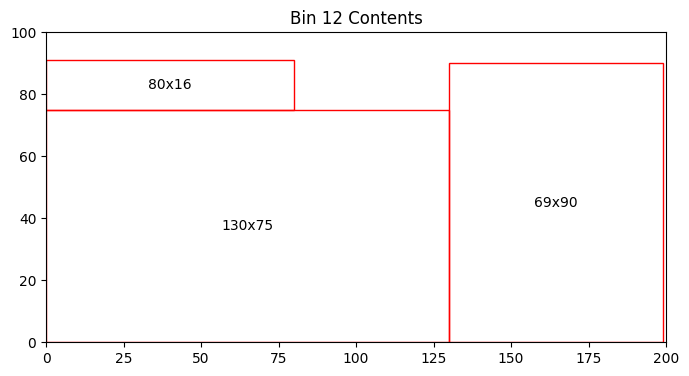

Bin 12 has 2760.00 units of area left


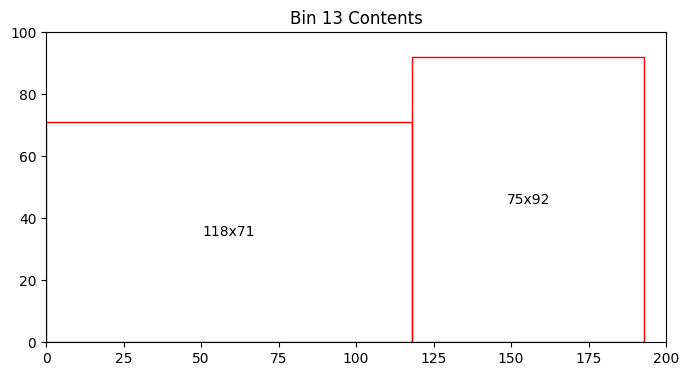

Bin 13 has 4722.00 units of area left


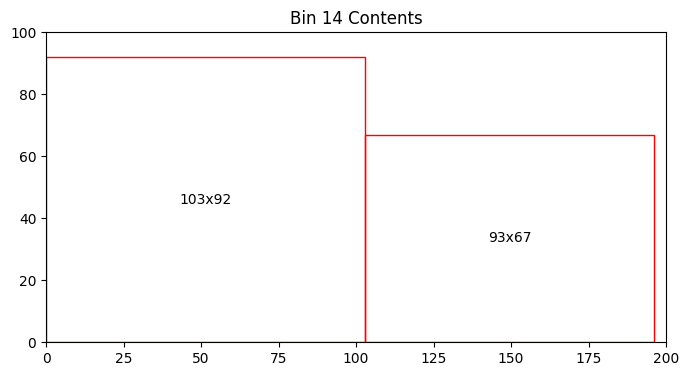

Bin 14 has 4293.00 units of area left


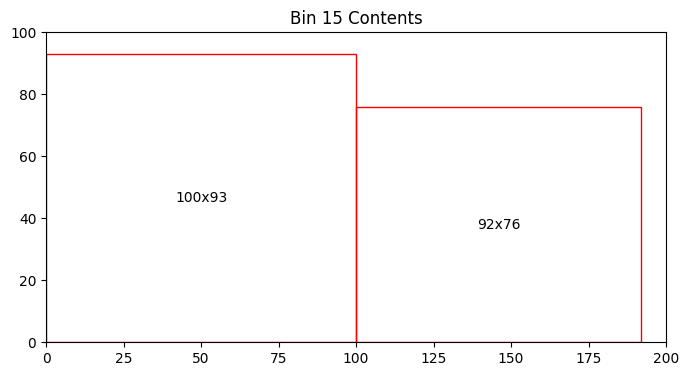

Bin 15 has 3708.00 units of area left


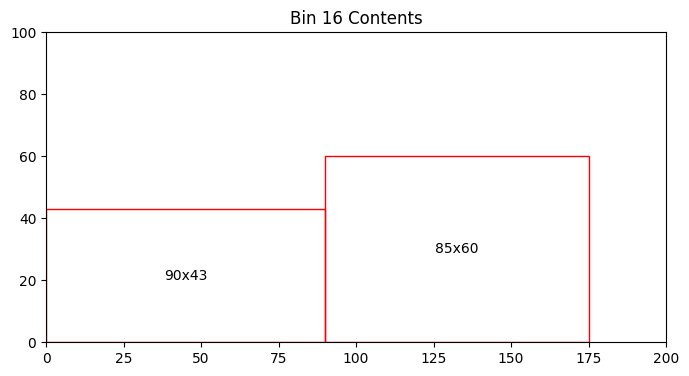

Bin 16 has 11030.00 units of area left


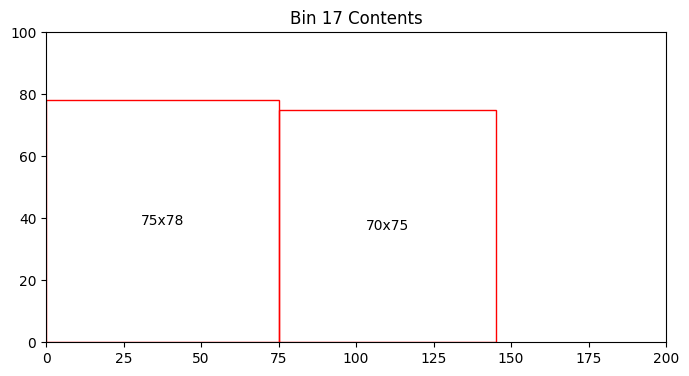

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


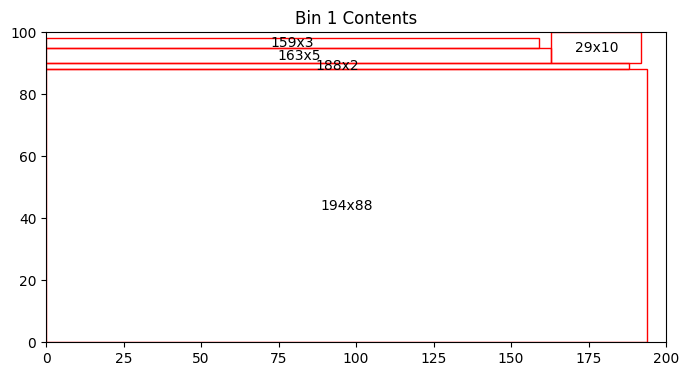

Bin 1 has 970.00 units of area left


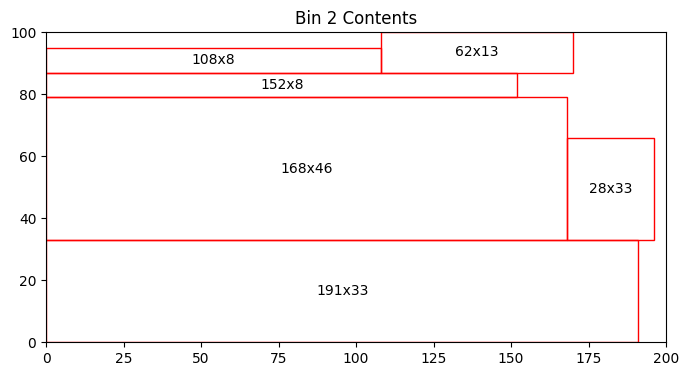

Bin 2 has 2159.00 units of area left


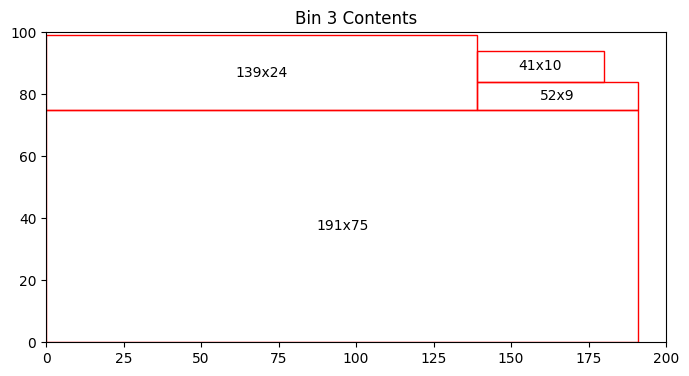

Bin 3 has 1461.00 units of area left


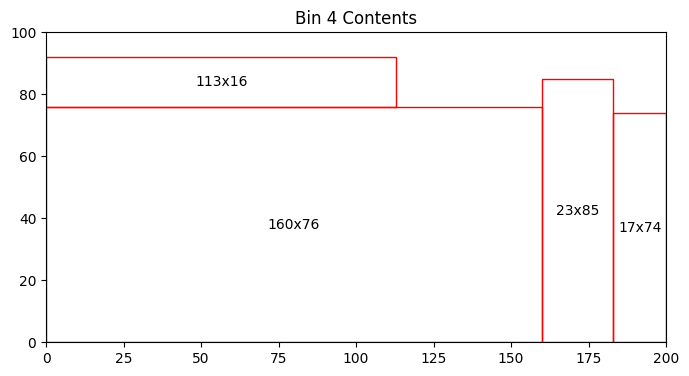

Bin 4 has 2819.00 units of area left


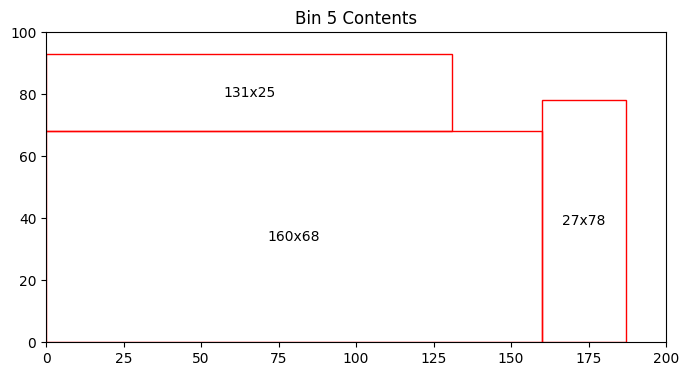

Bin 5 has 3739.00 units of area left


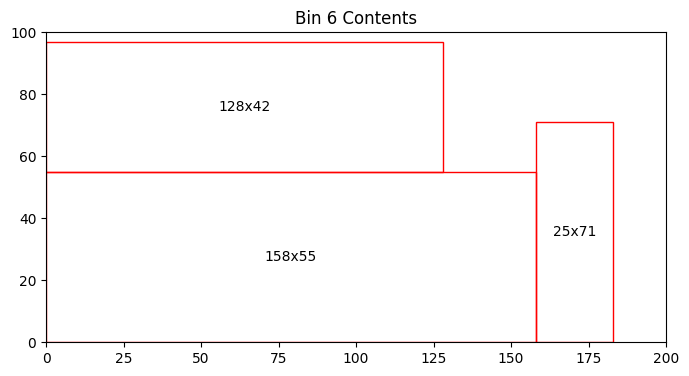

Bin 6 has 4159.00 units of area left


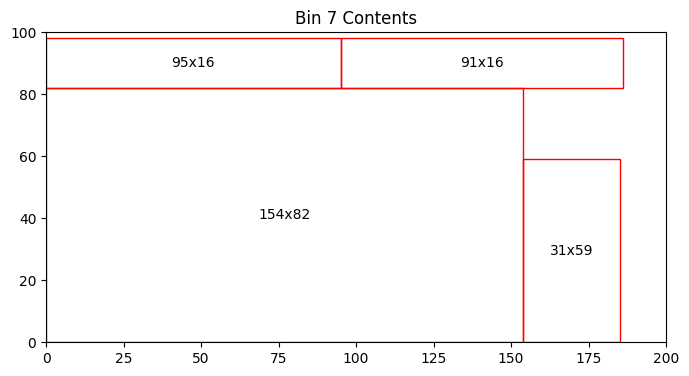

Bin 7 has 2567.00 units of area left


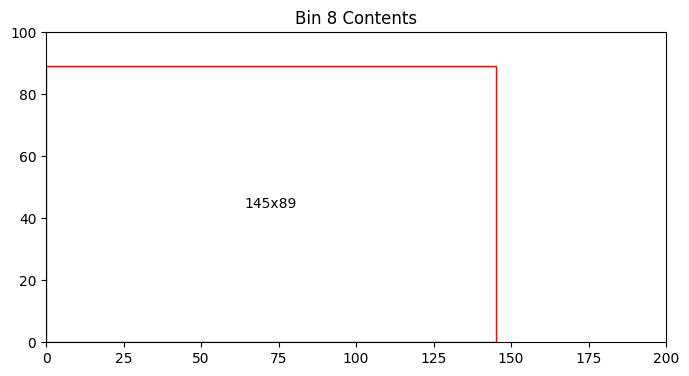

Bin 8 has 7095.00 units of area left


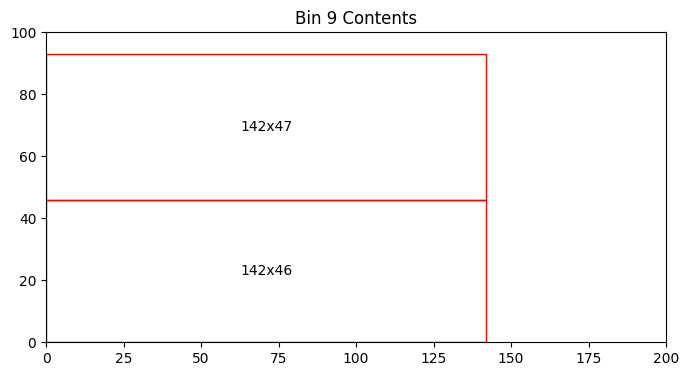

Bin 9 has 6794.00 units of area left


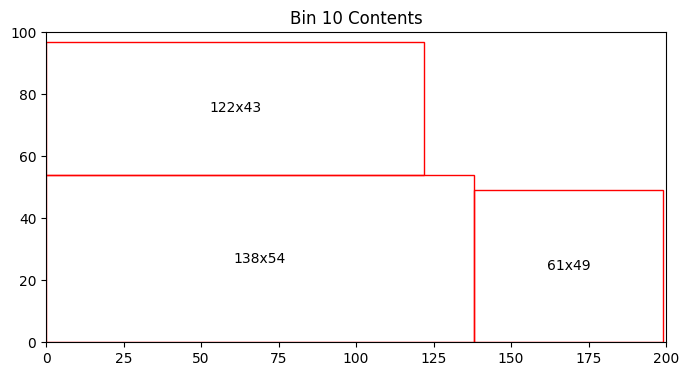

Bin 10 has 4313.00 units of area left


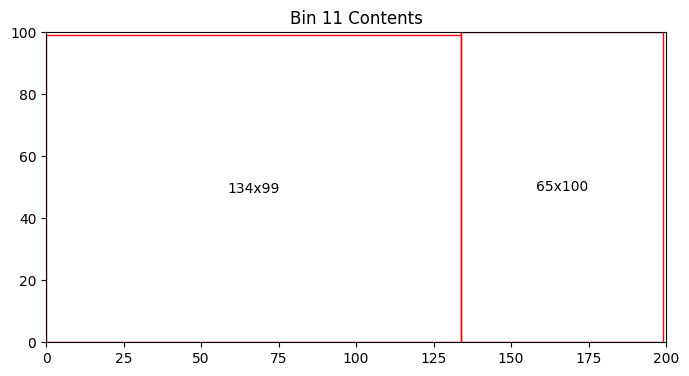

Bin 11 has 234.00 units of area left


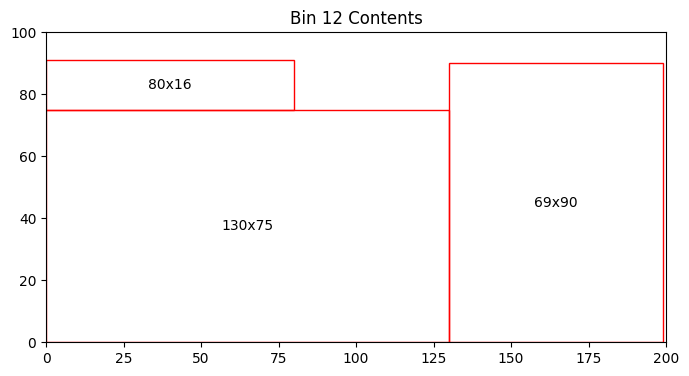

Bin 12 has 2760.00 units of area left


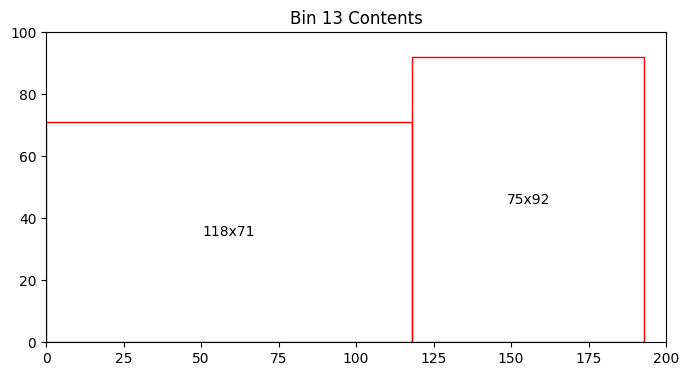

Bin 13 has 4722.00 units of area left


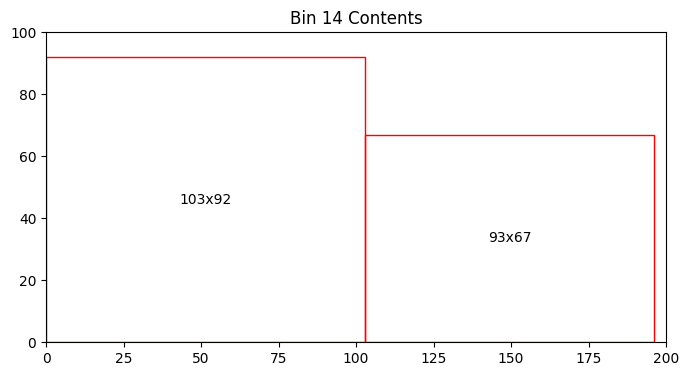

Bin 14 has 4293.00 units of area left


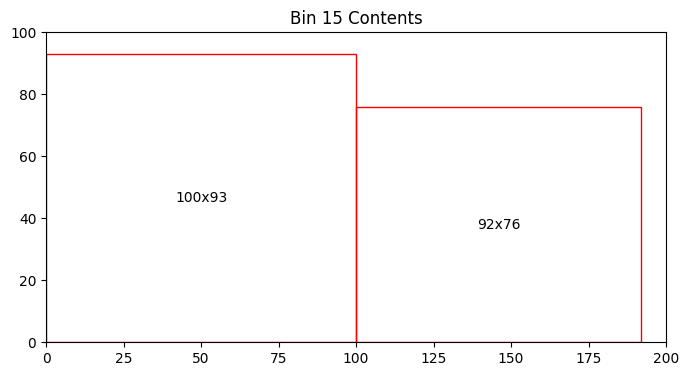

Bin 15 has 3708.00 units of area left


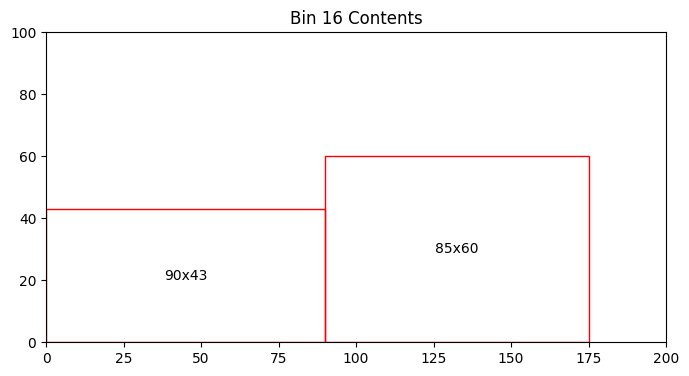

Bin 16 has 11030.00 units of area left


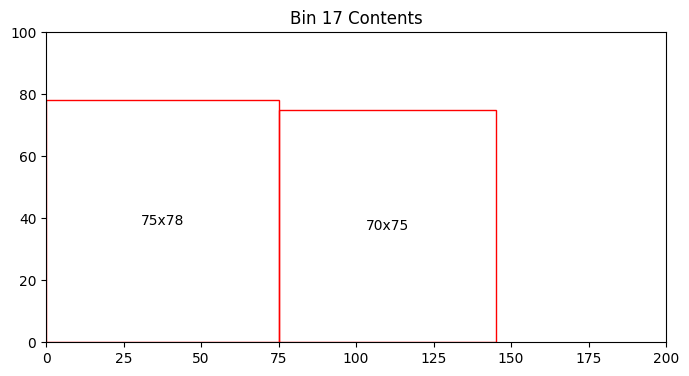

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[158  55]
 [160  76]
 [142  46]
 [160  68]
 [122  43]
 [ 75  92]
 [128  42]
 [ 28  33]
 [ 23  85]
 [159   3]
 [ 92  76]
 [ 31  59]
 [ 93  67]
 [ 25  71]
 [194  88]
 [131  25]
 [ 29  10]
 [139  24]
 [ 65 100]
 [152   8]
 [100  93]
 [ 75  78]
 [130  75]
 [ 91  16]
 [145  89]
 [ 95  16]
 [ 41  10]
 [191  33]
 [ 80  16]
 [118  71]
 [ 61  49]
 [142  47]
 [113  16]
 [ 85  60]
 [134  99]
 [163   5]
 [138  54]
 [ 70  75]
 [168  46]
 [191  75]
 [ 52   9]
 [103  92]
 [154  82]
 [188   2]
 [ 17  74]
 [ 69  90]
 [ 27  78]
 [ 62  13]
 [108   8]
 [ 90  43]]


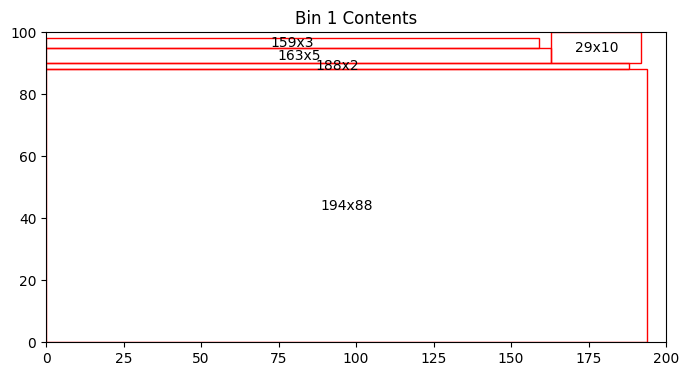

Bin 1 has 970.00 units of area left


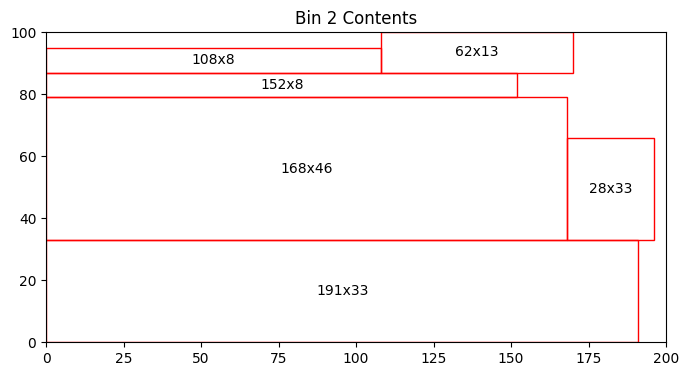

Bin 2 has 2159.00 units of area left


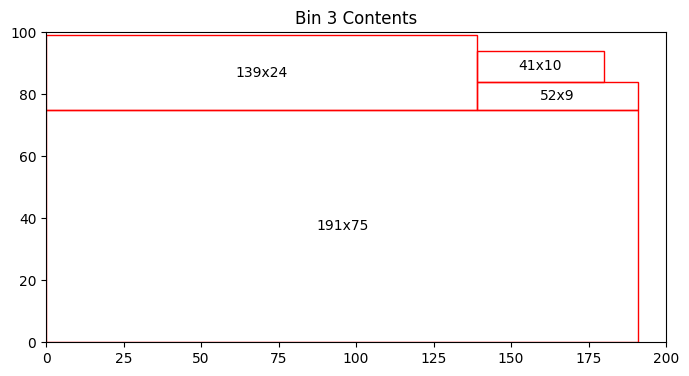

Bin 3 has 1461.00 units of area left


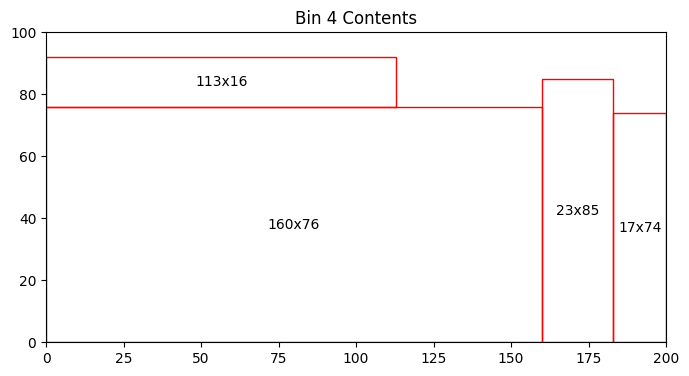

Bin 4 has 2819.00 units of area left


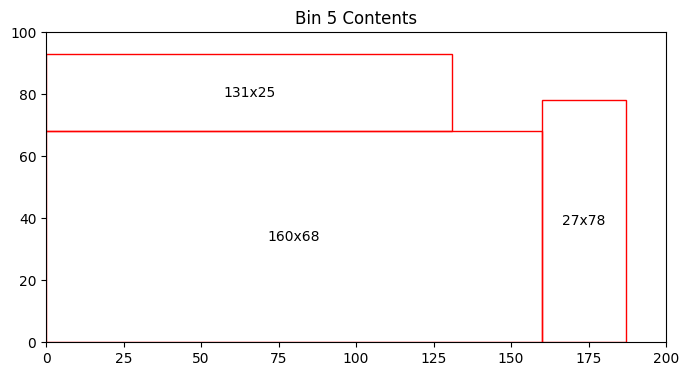

Bin 5 has 3739.00 units of area left


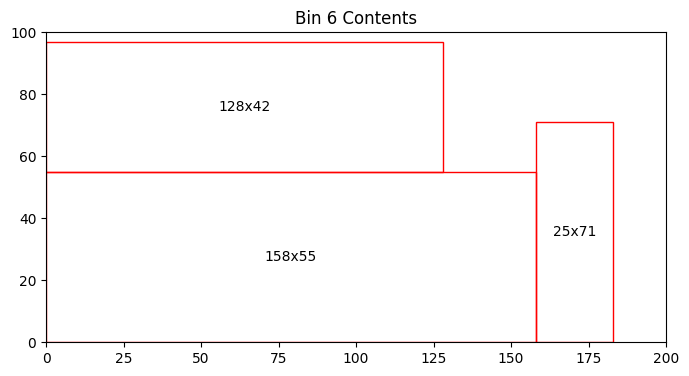

Bin 6 has 4159.00 units of area left


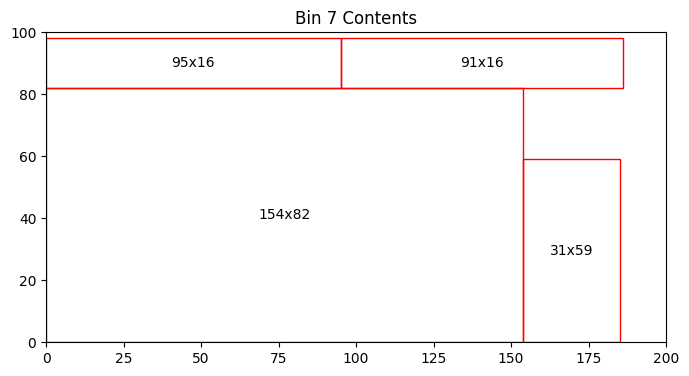

Bin 7 has 2567.00 units of area left


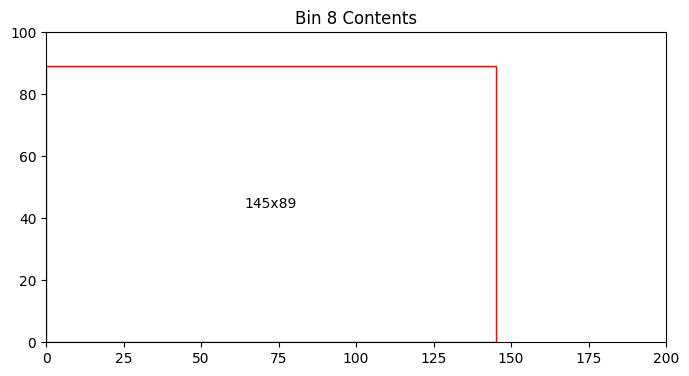

Bin 8 has 7095.00 units of area left


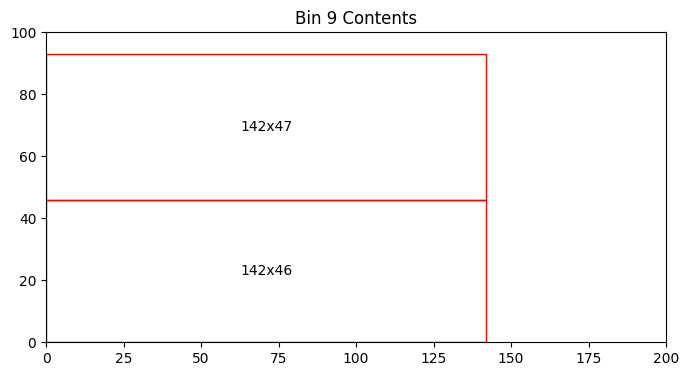

Bin 9 has 6794.00 units of area left


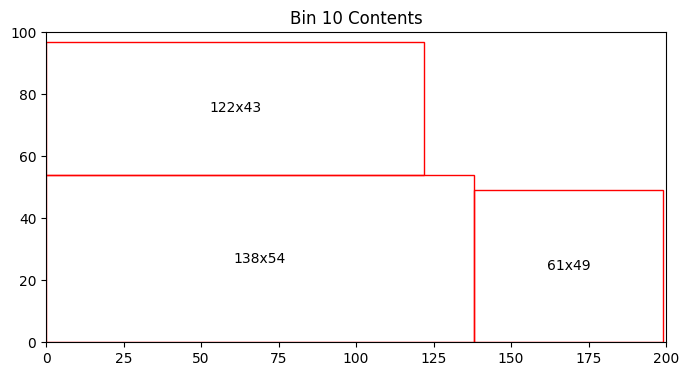

Bin 10 has 4313.00 units of area left


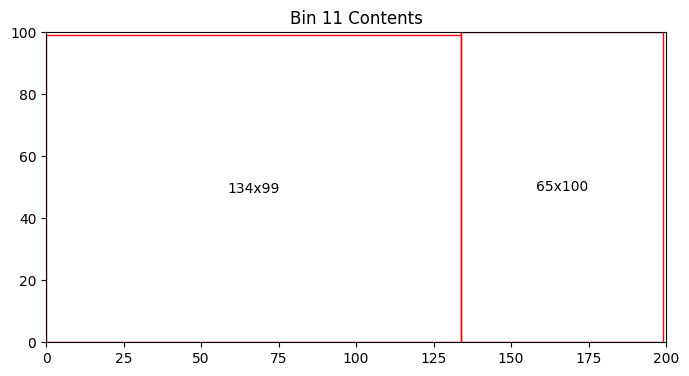

Bin 11 has 234.00 units of area left


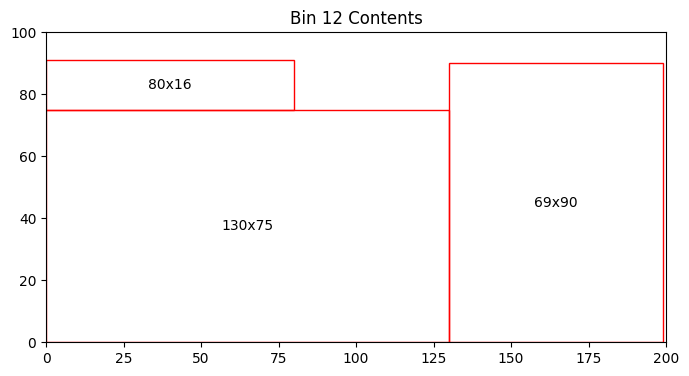

Bin 12 has 2760.00 units of area left


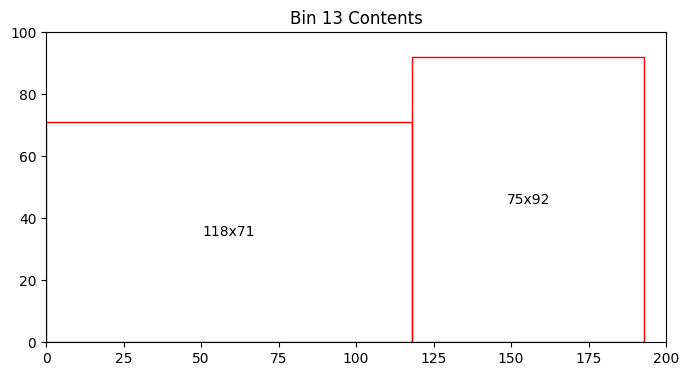

Bin 13 has 4722.00 units of area left


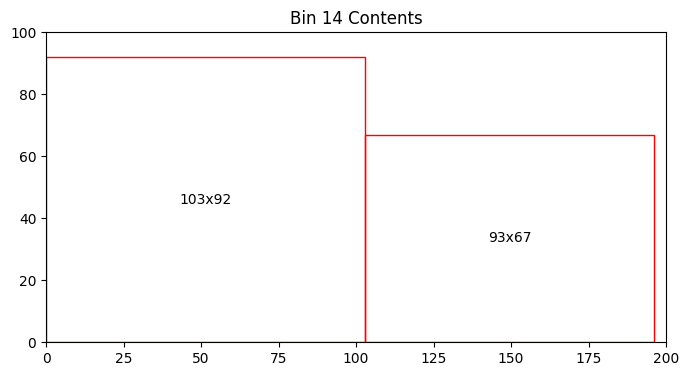

Bin 14 has 4293.00 units of area left


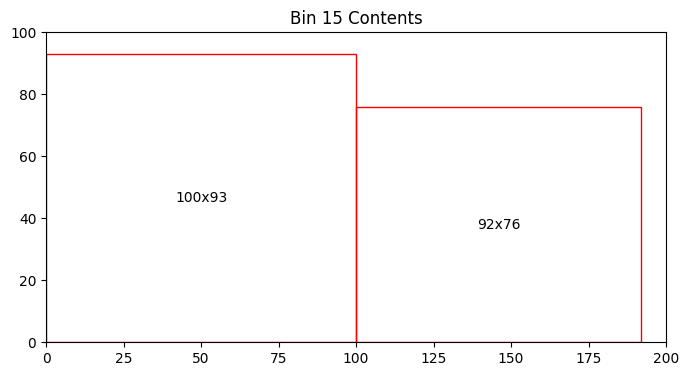

Bin 15 has 3708.00 units of area left


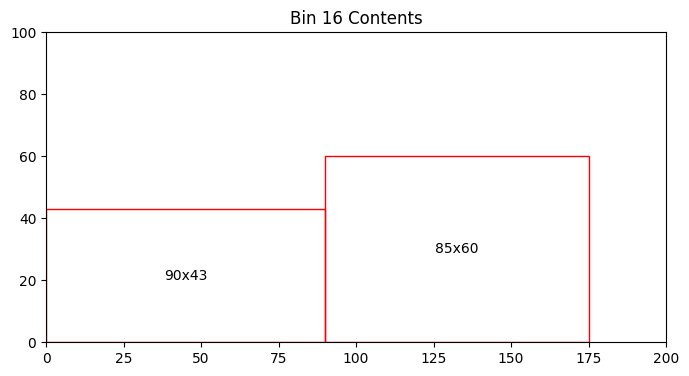

Bin 16 has 11030.00 units of area left


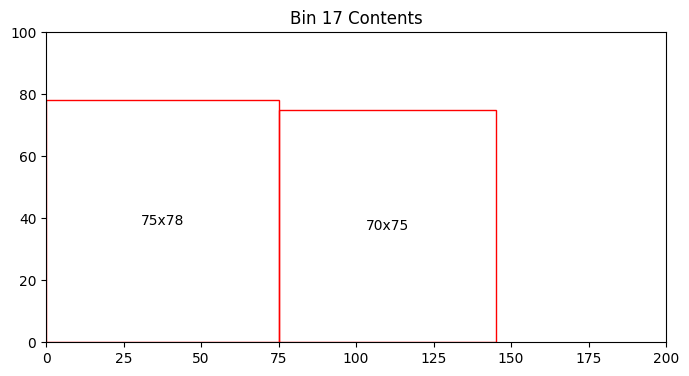

Bin 17 has 8900.00 units of area left
Total number of bins = 17
Total area left in bins = 71723.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


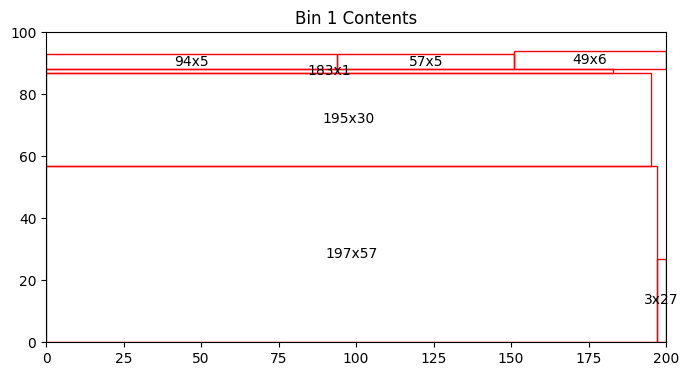

Bin 1 has 1608.00 units of area left


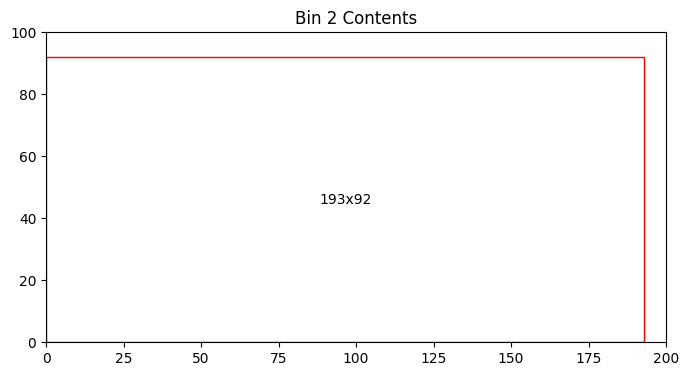

Bin 2 has 2244.00 units of area left


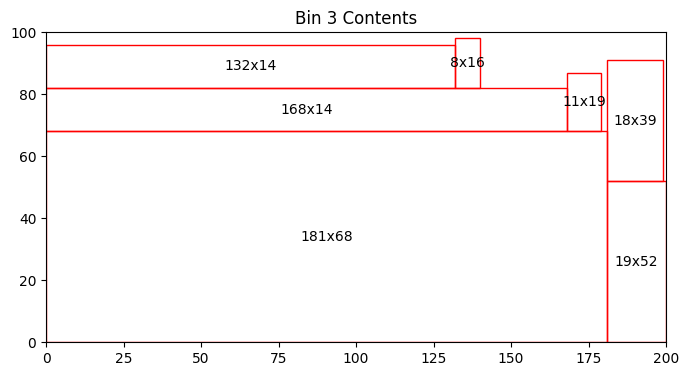

Bin 3 has 1465.00 units of area left


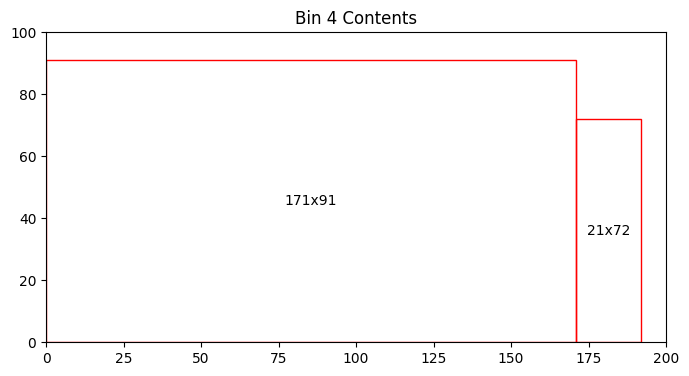

Bin 4 has 2927.00 units of area left


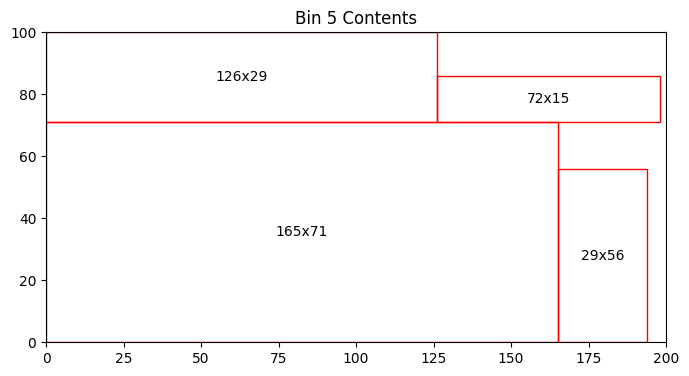

Bin 5 has 1927.00 units of area left


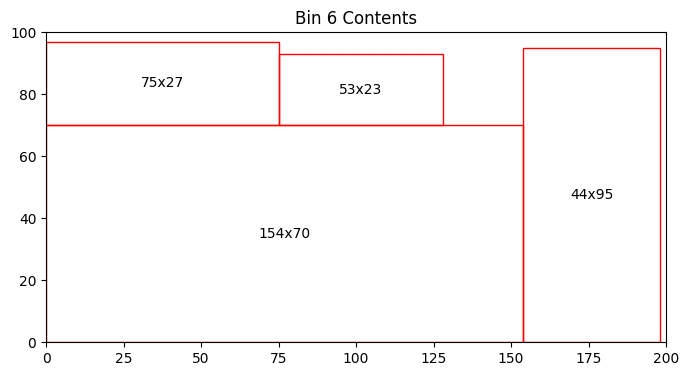

Bin 6 has 1796.00 units of area left


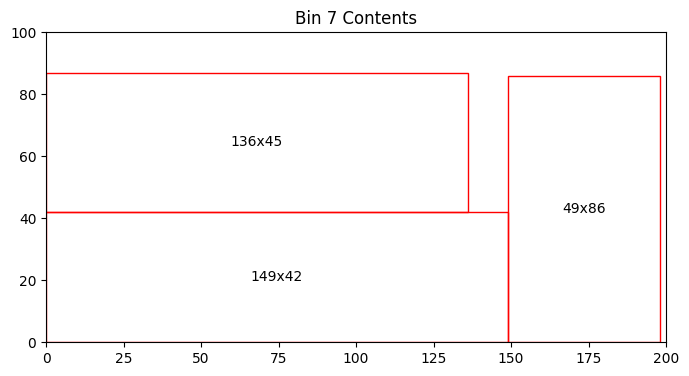

Bin 7 has 3408.00 units of area left


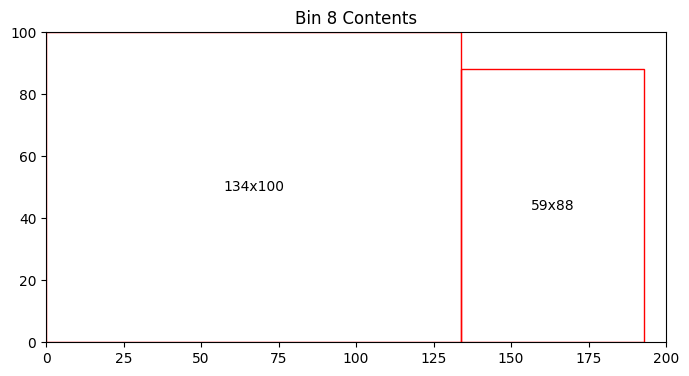

Bin 8 has 1408.00 units of area left


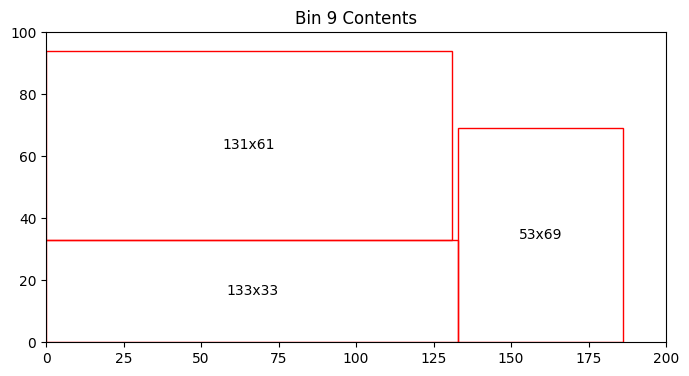

Bin 9 has 3963.00 units of area left


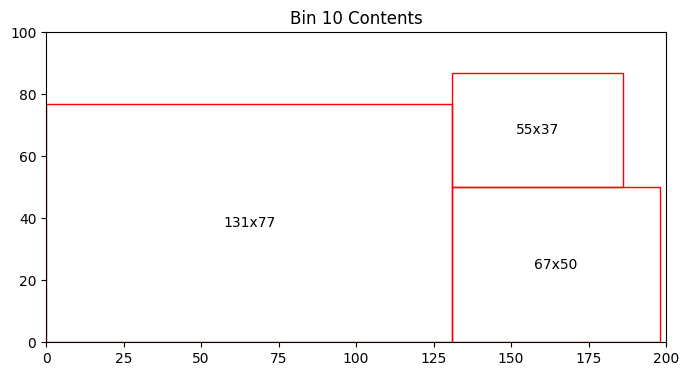

Bin 10 has 4528.00 units of area left


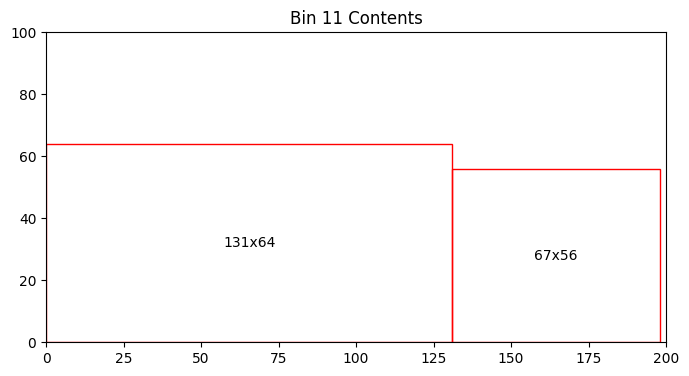

Bin 11 has 7864.00 units of area left


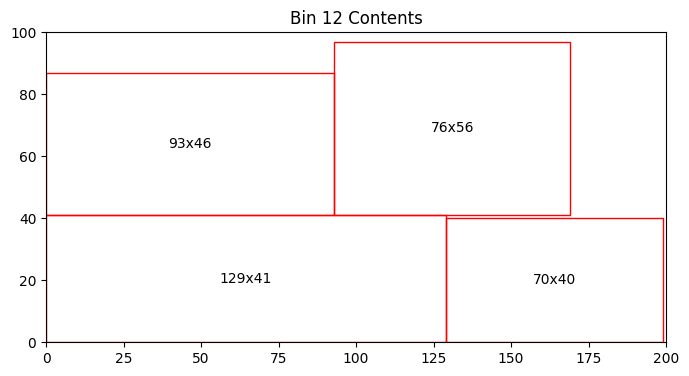

Bin 12 has 3377.00 units of area left


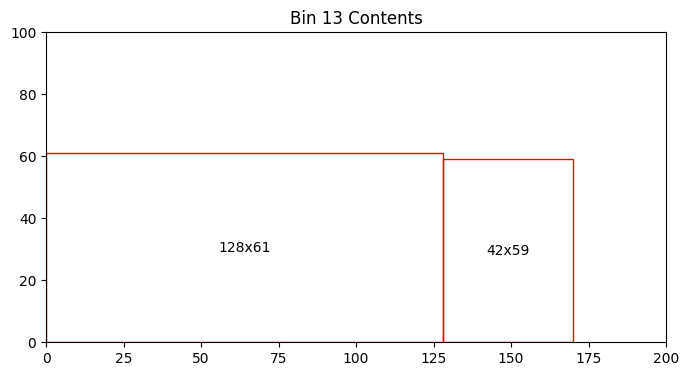

Bin 13 has 9714.00 units of area left


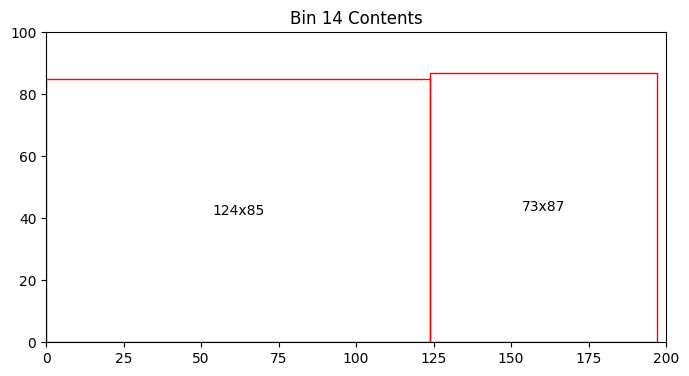

Bin 14 has 3109.00 units of area left


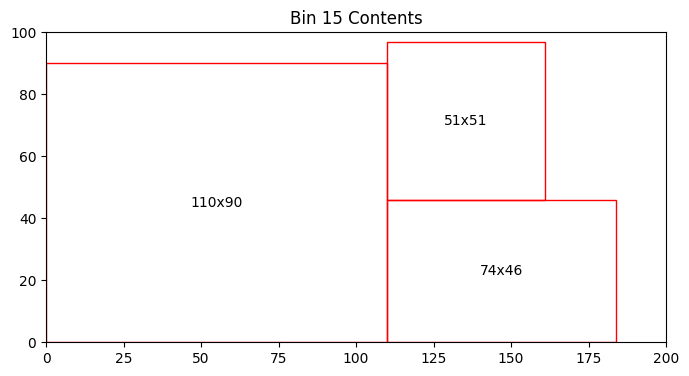

Bin 15 has 4095.00 units of area left


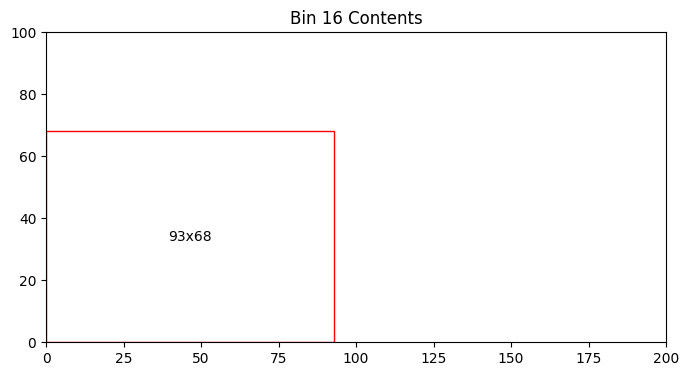

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


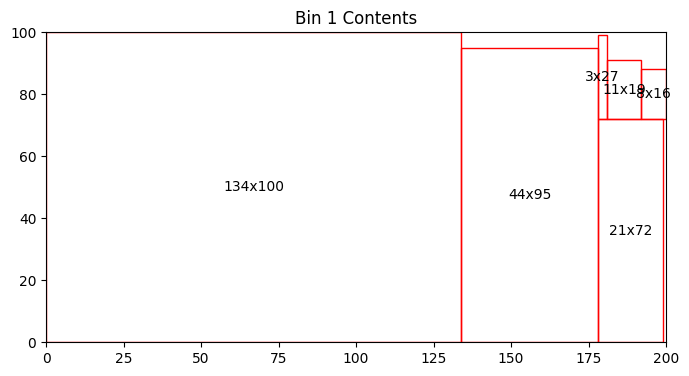

Bin 1 has 490.00 units of area left


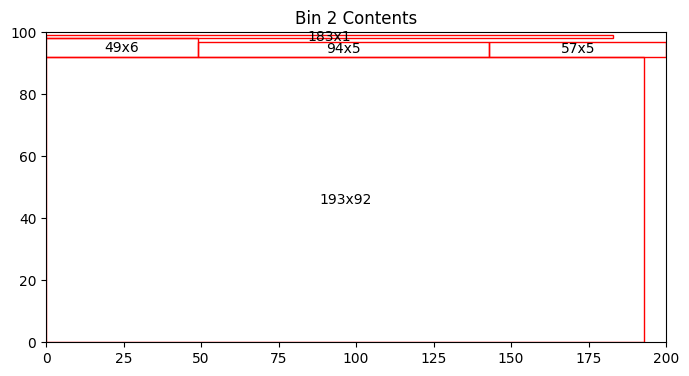

Bin 2 has 1012.00 units of area left


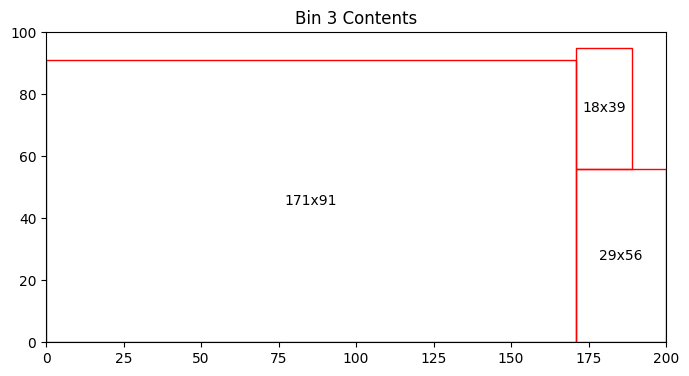

Bin 3 has 2113.00 units of area left


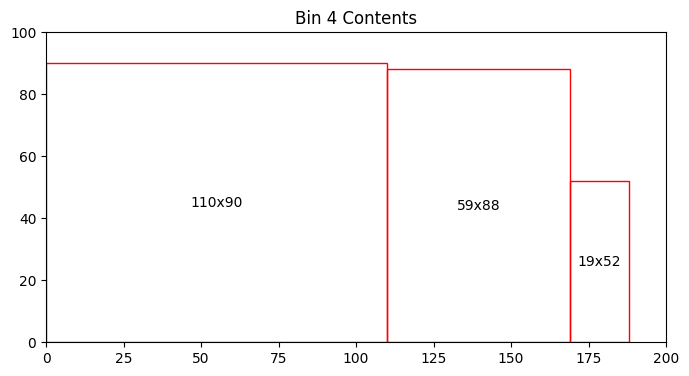

Bin 4 has 3920.00 units of area left


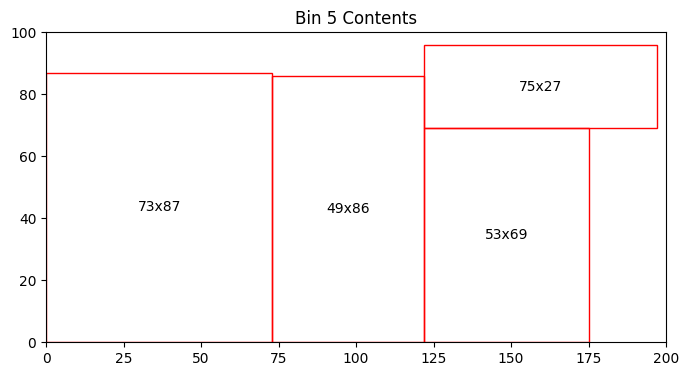

Bin 5 has 3753.00 units of area left


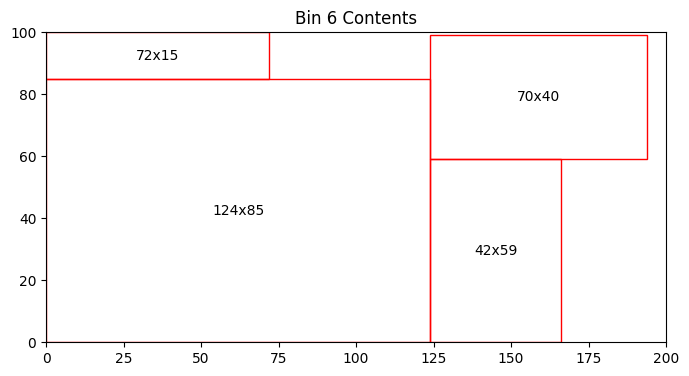

Bin 6 has 3102.00 units of area left


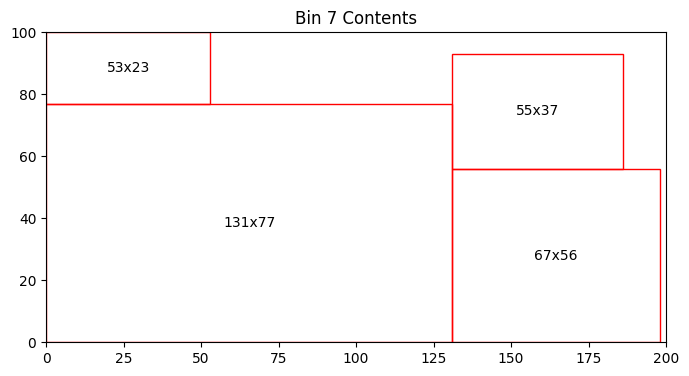

Bin 7 has 2907.00 units of area left


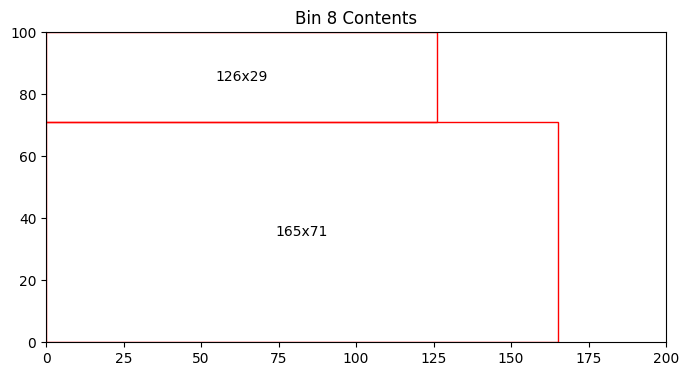

Bin 8 has 4631.00 units of area left


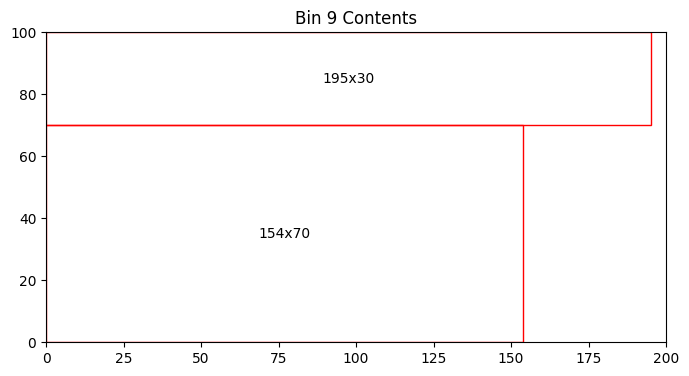

Bin 9 has 3370.00 units of area left


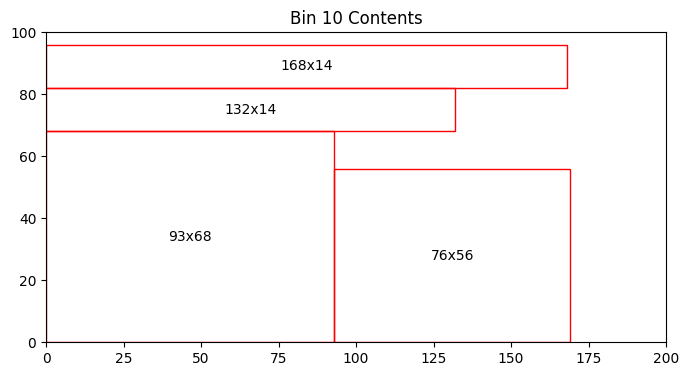

Bin 10 has 5220.00 units of area left


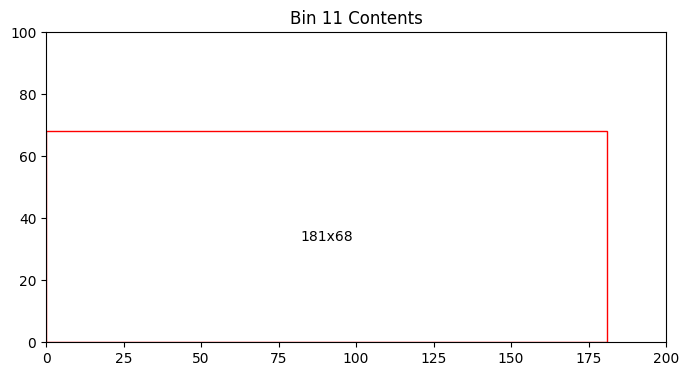

Bin 11 has 7692.00 units of area left


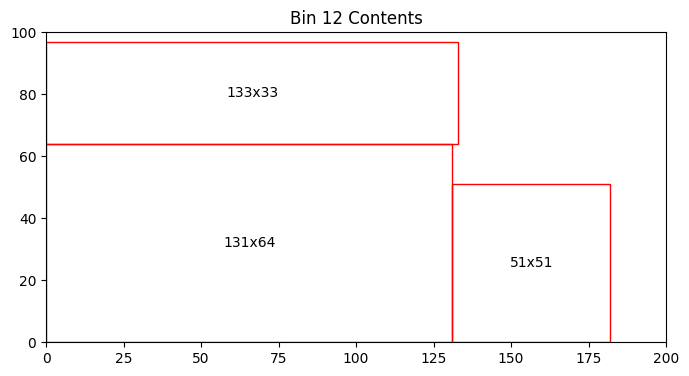

Bin 12 has 4626.00 units of area left


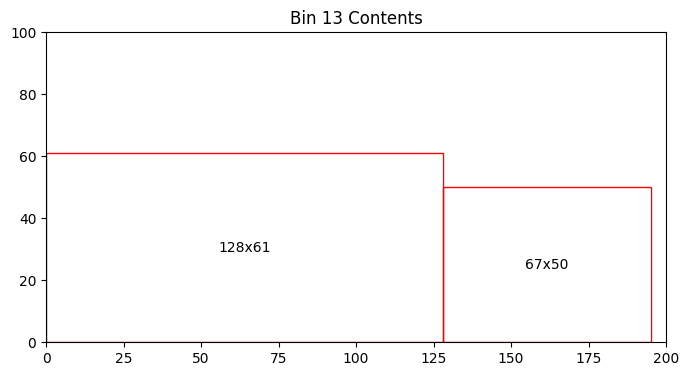

Bin 13 has 8842.00 units of area left


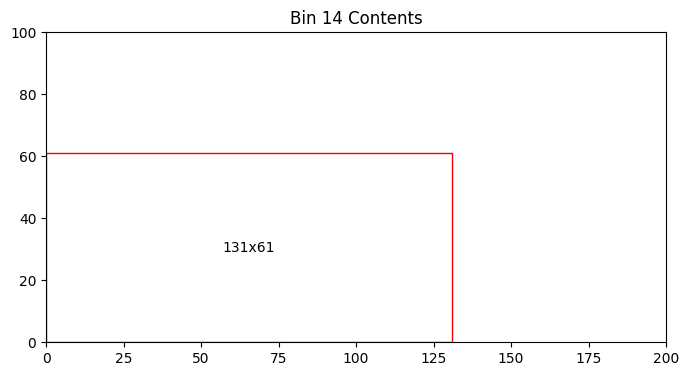

Bin 14 has 12009.00 units of area left


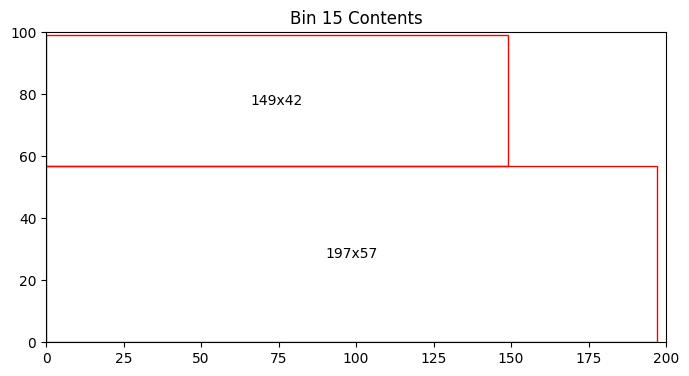

Bin 15 has 2513.00 units of area left


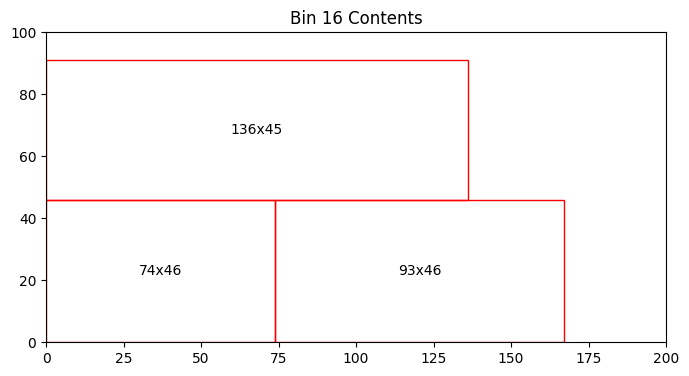

Bin 16 has 6198.00 units of area left


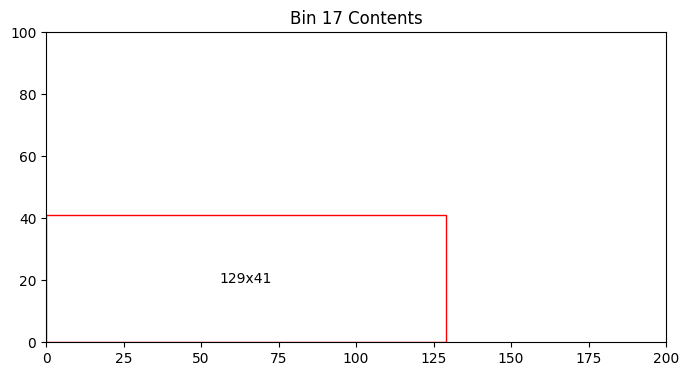

Bin 17 has 14711.00 units of area left
Total number of bins = 17
Total area left in bins = 87109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


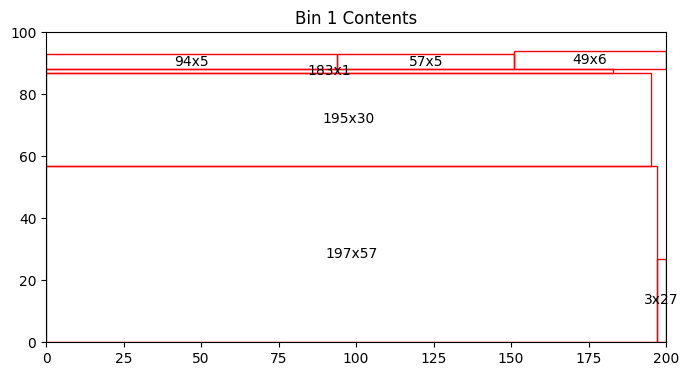

Bin 1 has 1608.00 units of area left


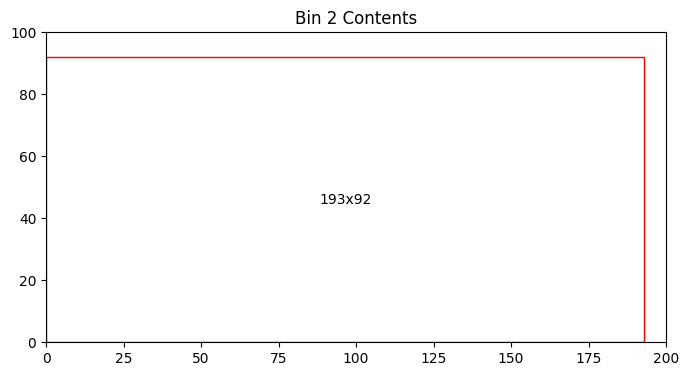

Bin 2 has 2244.00 units of area left


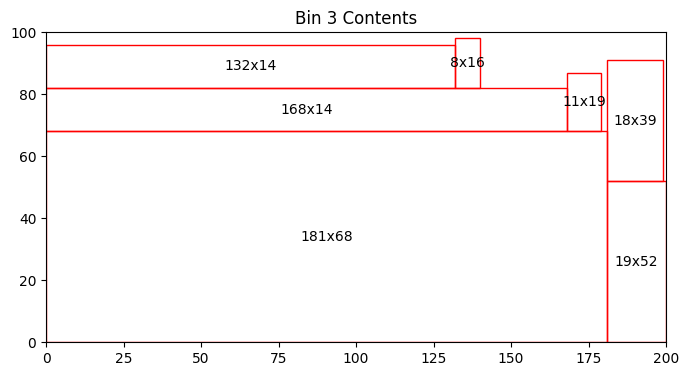

Bin 3 has 1465.00 units of area left


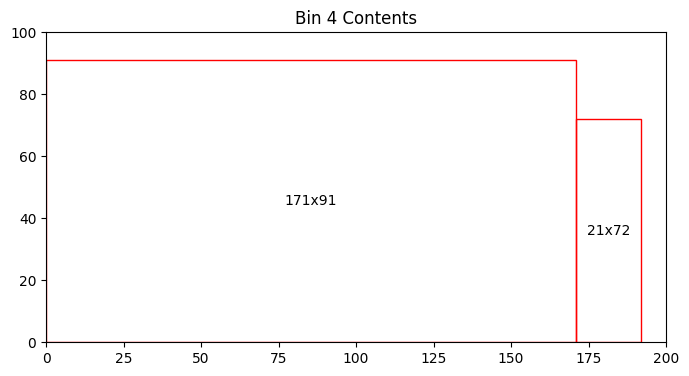

Bin 4 has 2927.00 units of area left


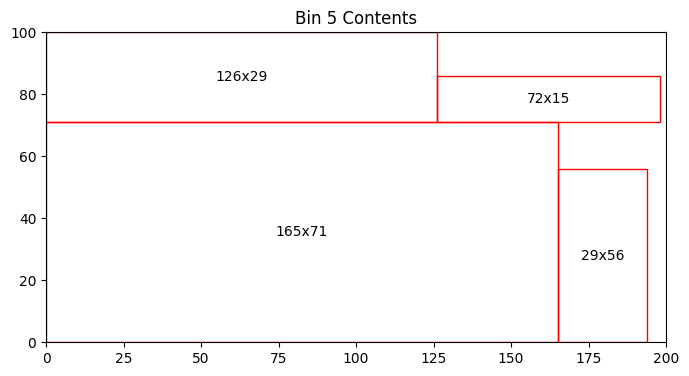

Bin 5 has 1927.00 units of area left


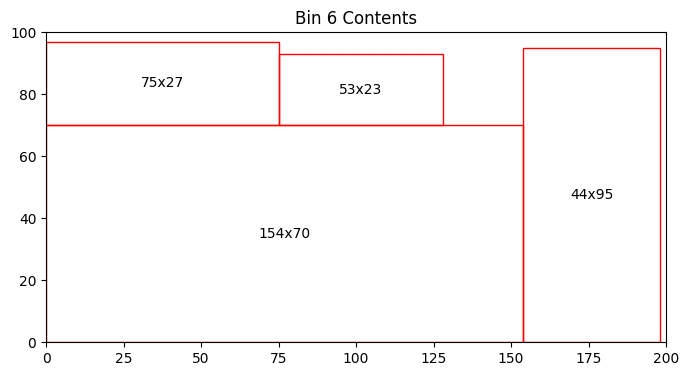

Bin 6 has 1796.00 units of area left


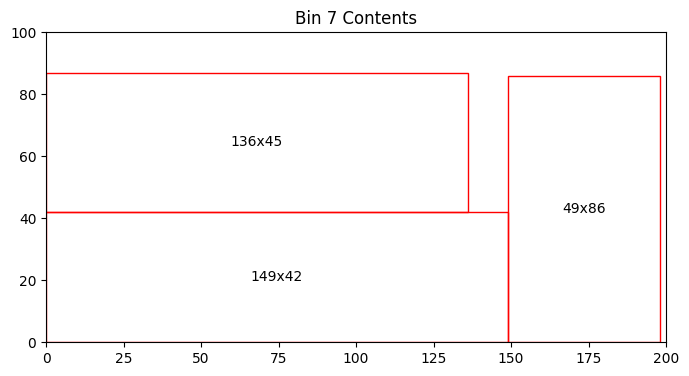

Bin 7 has 3408.00 units of area left


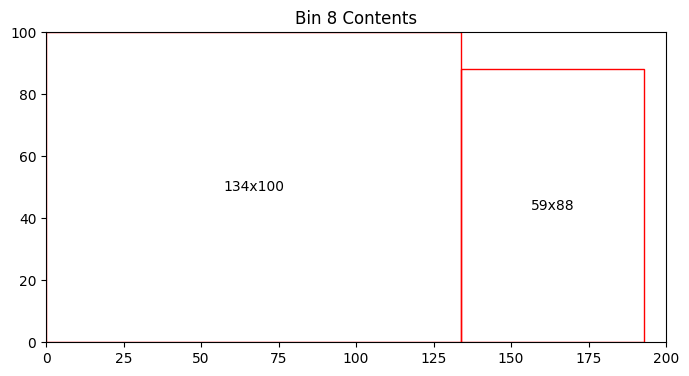

Bin 8 has 1408.00 units of area left


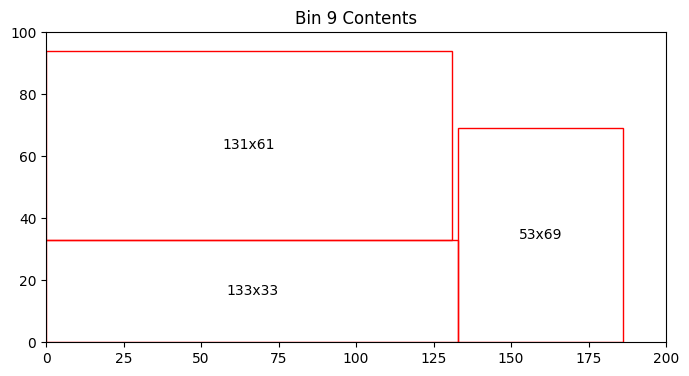

Bin 9 has 3963.00 units of area left


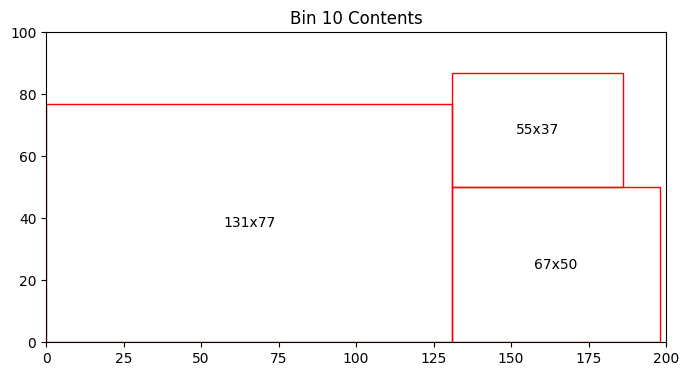

Bin 10 has 4528.00 units of area left


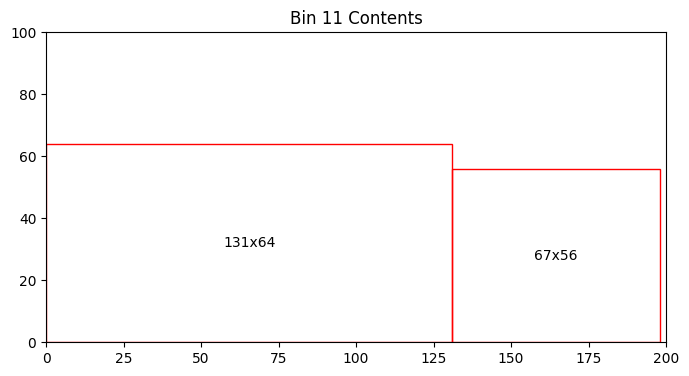

Bin 11 has 7864.00 units of area left


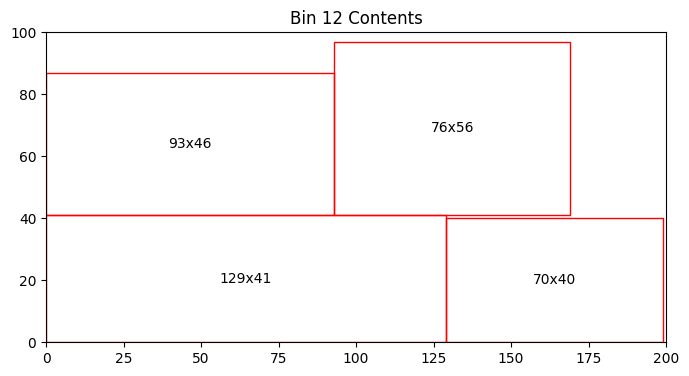

Bin 12 has 3377.00 units of area left


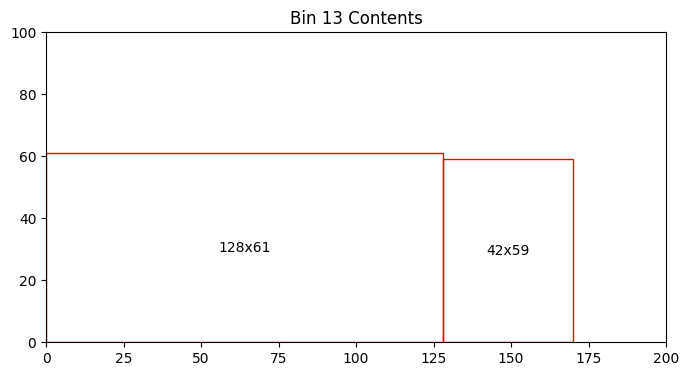

Bin 13 has 9714.00 units of area left


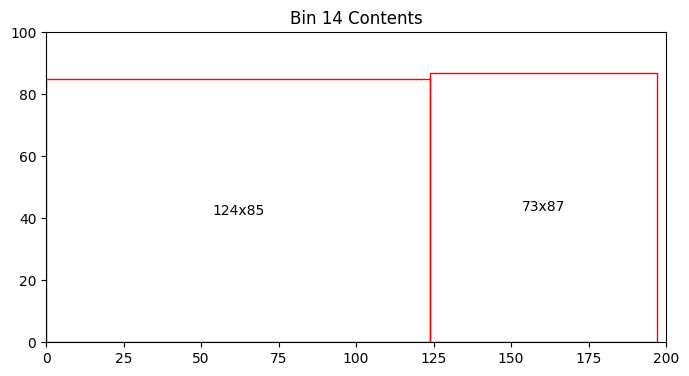

Bin 14 has 3109.00 units of area left


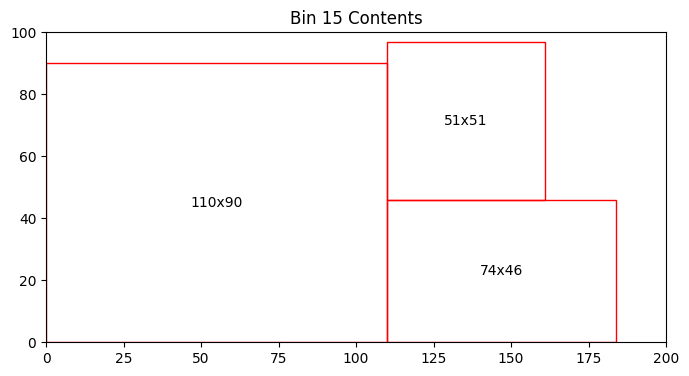

Bin 15 has 4095.00 units of area left


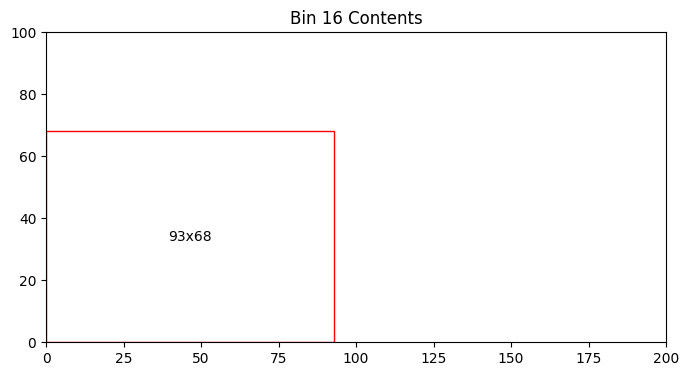

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


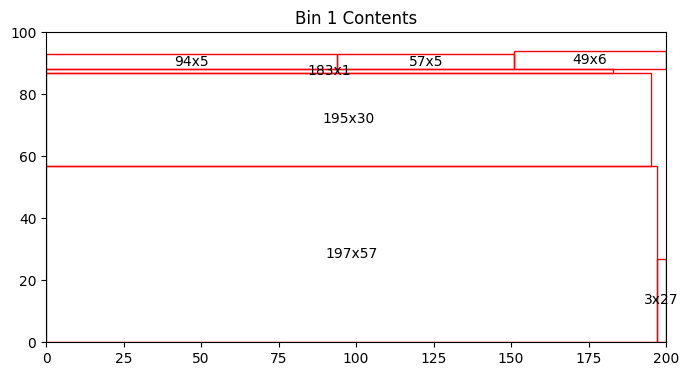

Bin 1 has 1608.00 units of area left


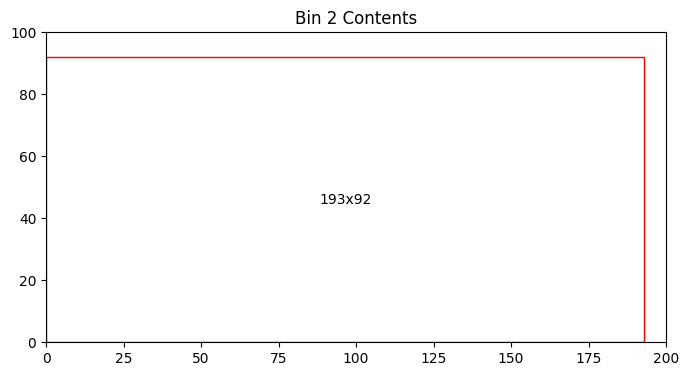

Bin 2 has 2244.00 units of area left


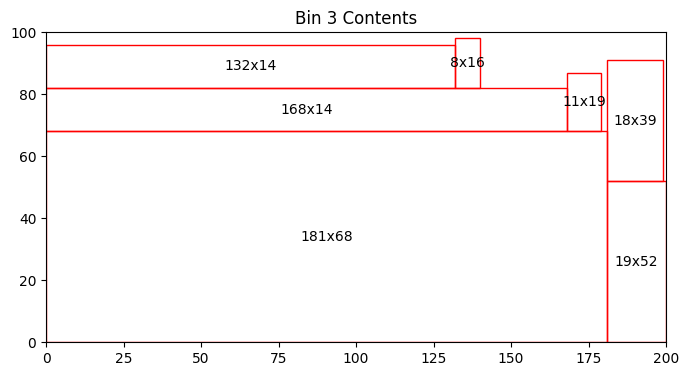

Bin 3 has 1465.00 units of area left


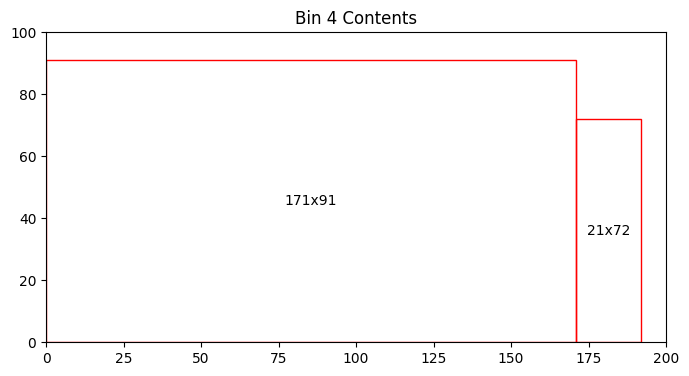

Bin 4 has 2927.00 units of area left


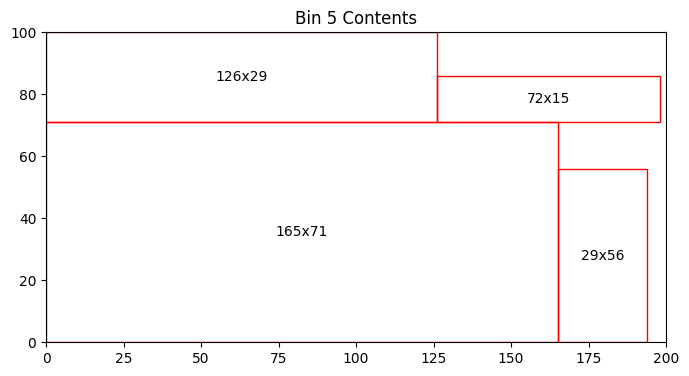

Bin 5 has 1927.00 units of area left


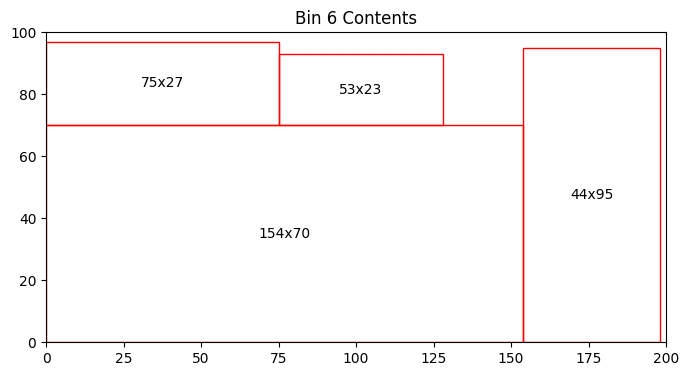

Bin 6 has 1796.00 units of area left


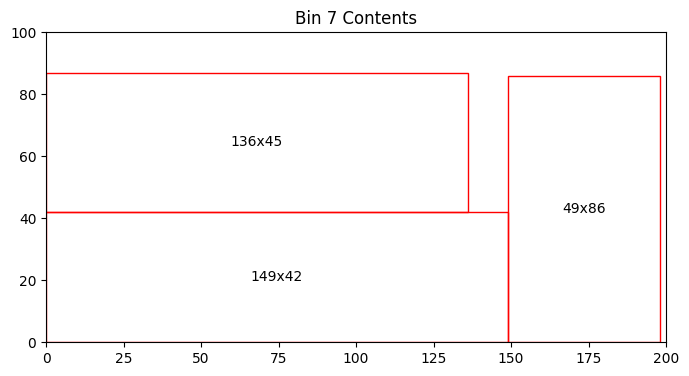

Bin 7 has 3408.00 units of area left


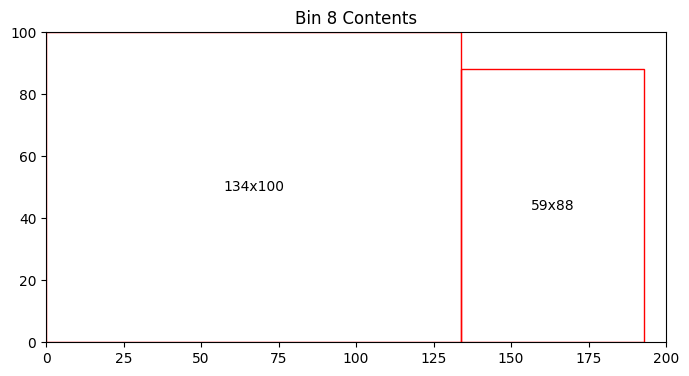

Bin 8 has 1408.00 units of area left


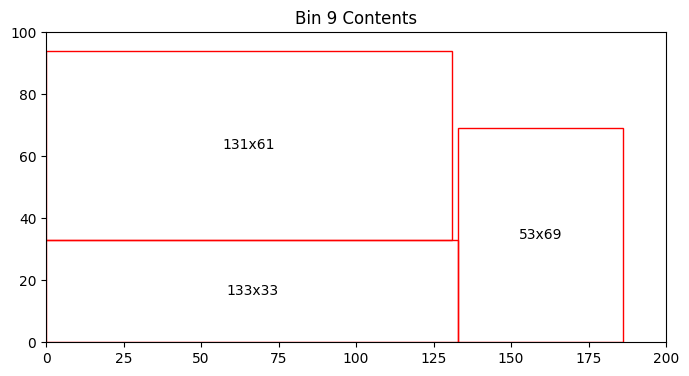

Bin 9 has 3963.00 units of area left


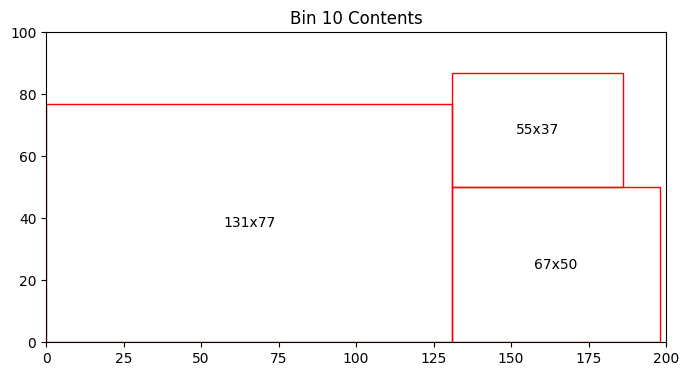

Bin 10 has 4528.00 units of area left


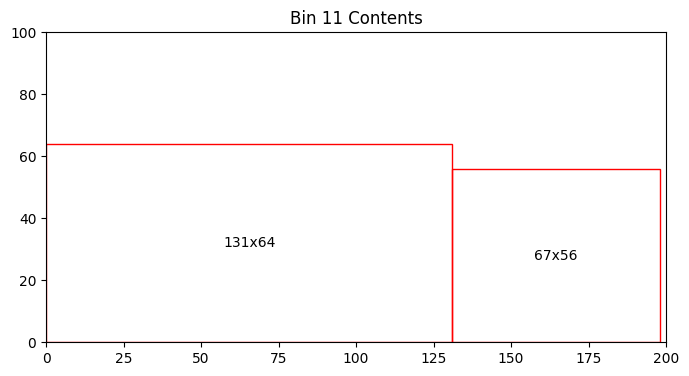

Bin 11 has 7864.00 units of area left


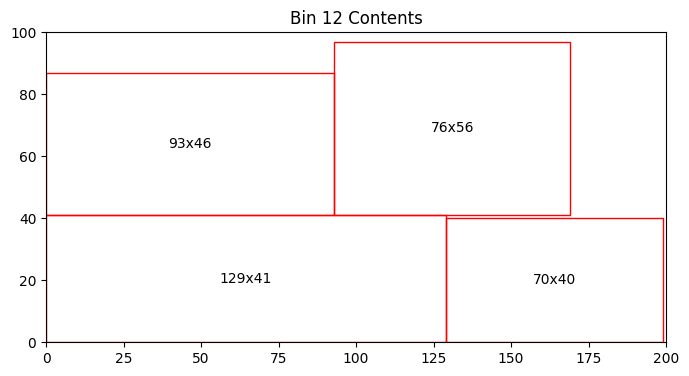

Bin 12 has 3377.00 units of area left


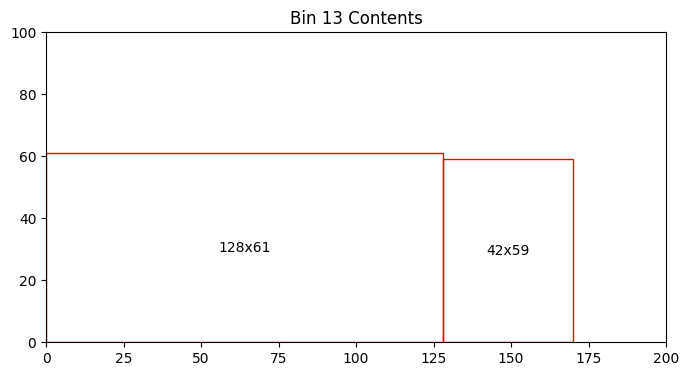

Bin 13 has 9714.00 units of area left


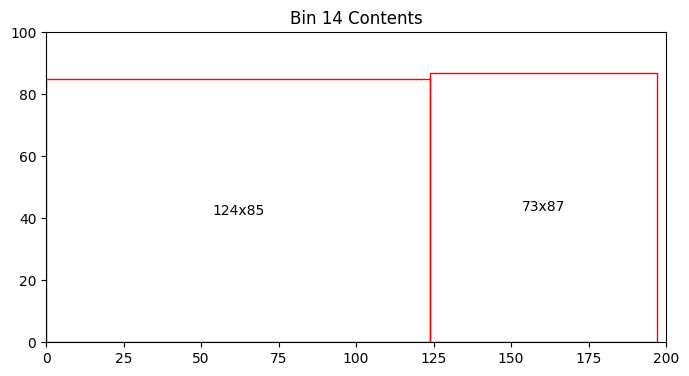

Bin 14 has 3109.00 units of area left


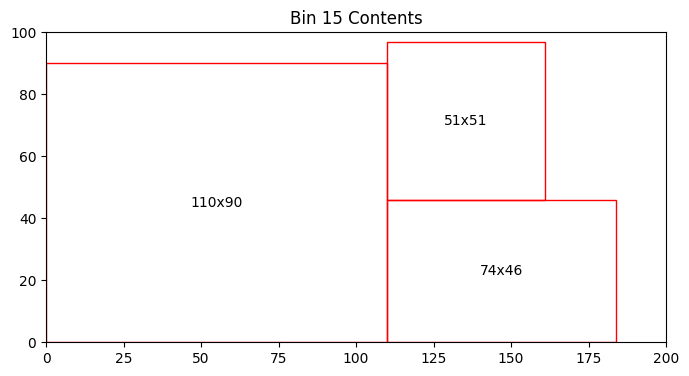

Bin 15 has 4095.00 units of area left


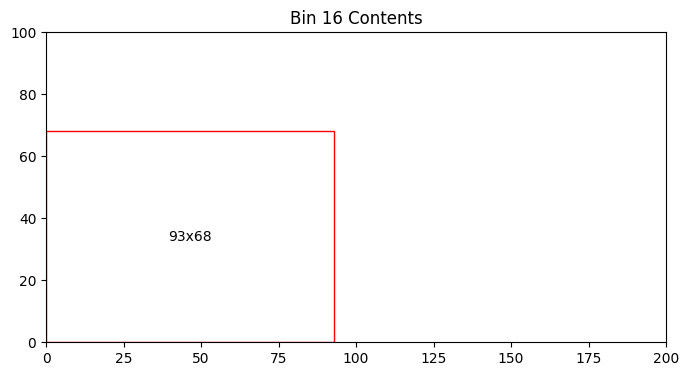

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


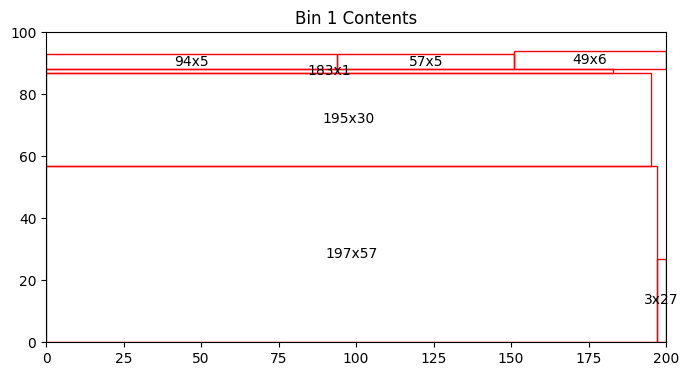

Bin 1 has 1608.00 units of area left


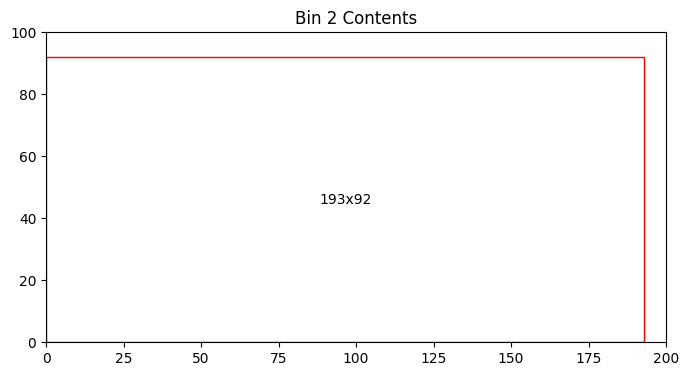

Bin 2 has 2244.00 units of area left


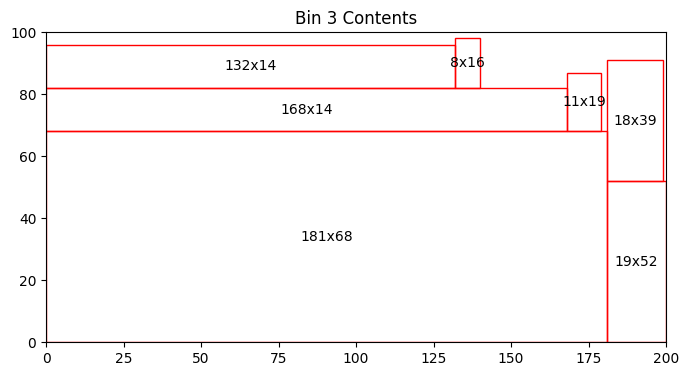

Bin 3 has 1465.00 units of area left


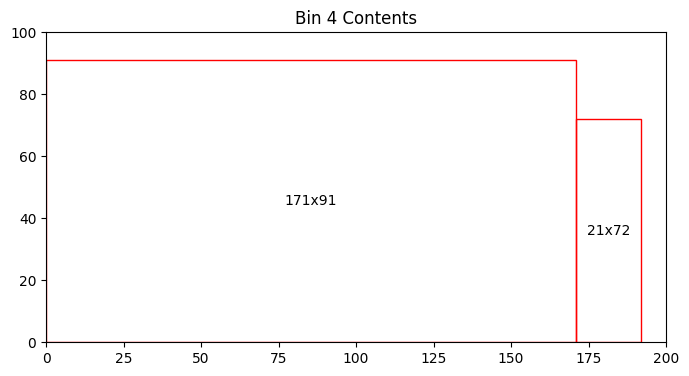

Bin 4 has 2927.00 units of area left


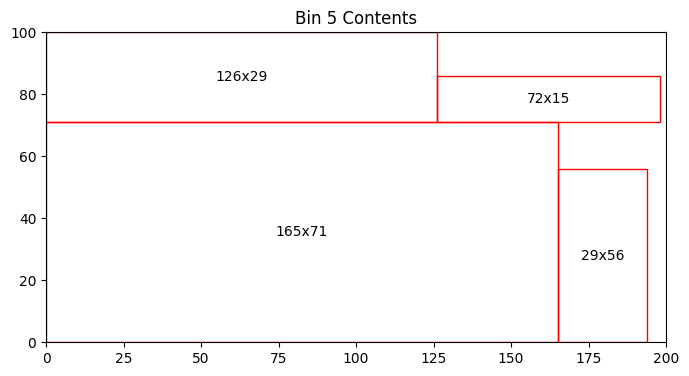

Bin 5 has 1927.00 units of area left


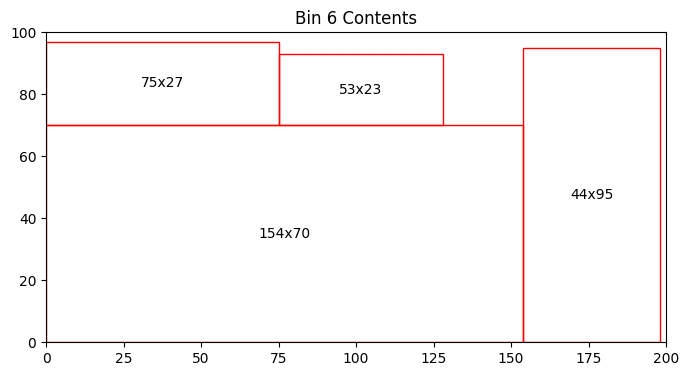

Bin 6 has 1796.00 units of area left


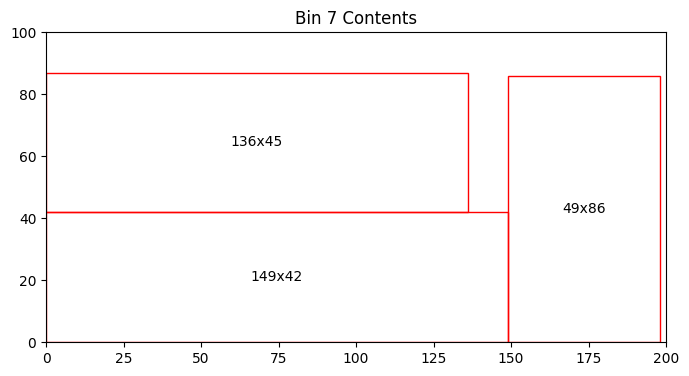

Bin 7 has 3408.00 units of area left


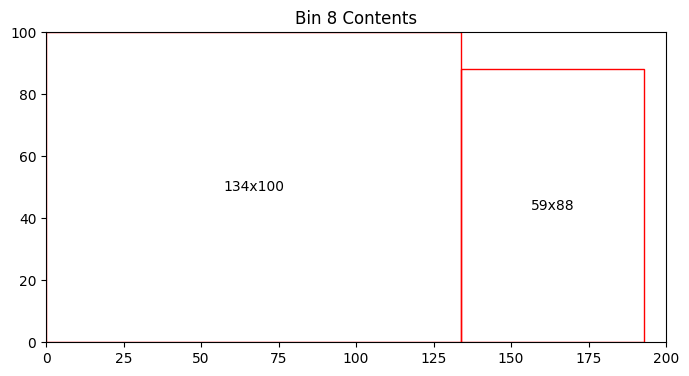

Bin 8 has 1408.00 units of area left


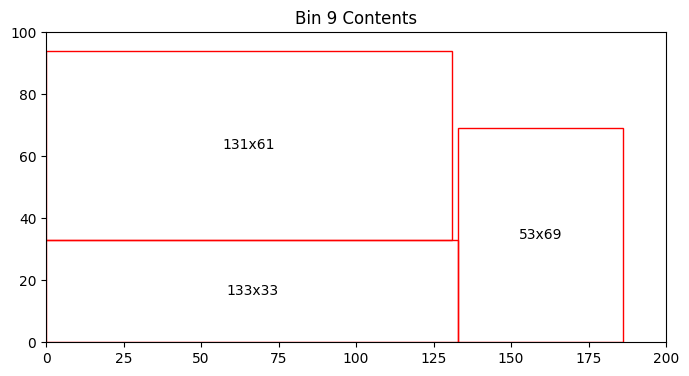

Bin 9 has 3963.00 units of area left


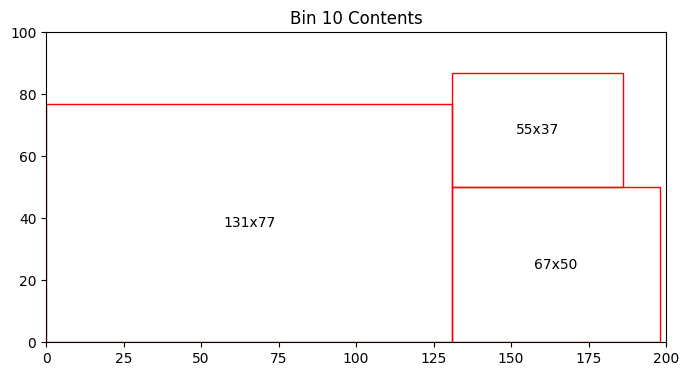

Bin 10 has 4528.00 units of area left


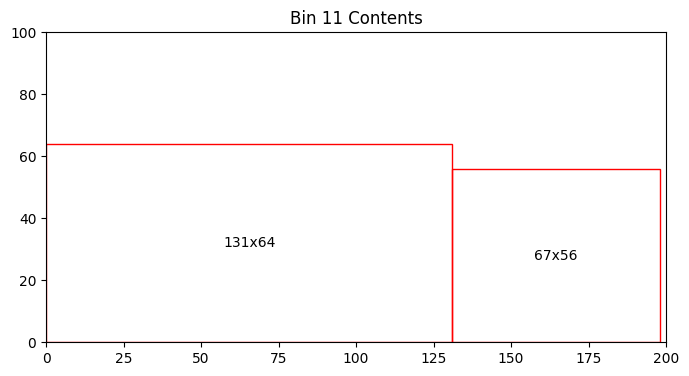

Bin 11 has 7864.00 units of area left


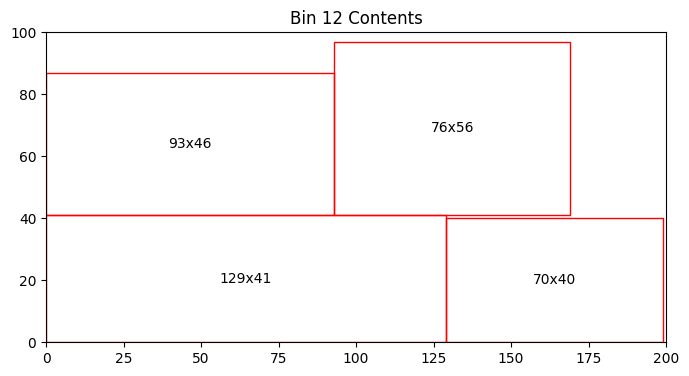

Bin 12 has 3377.00 units of area left


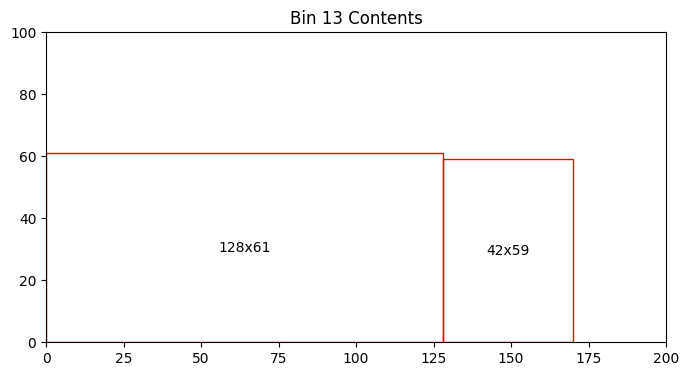

Bin 13 has 9714.00 units of area left


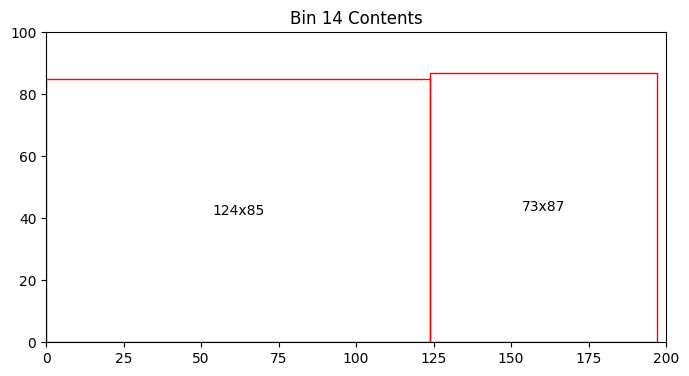

Bin 14 has 3109.00 units of area left


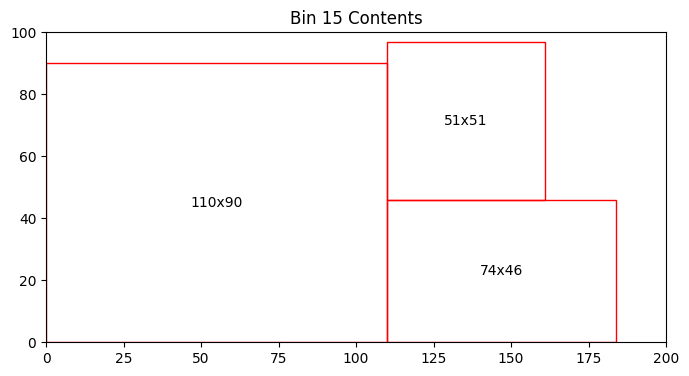

Bin 15 has 4095.00 units of area left


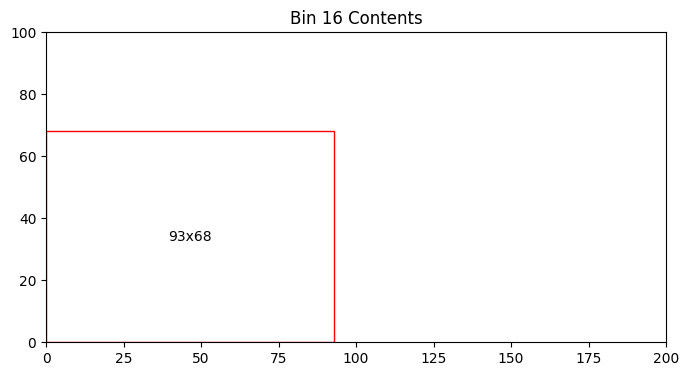

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


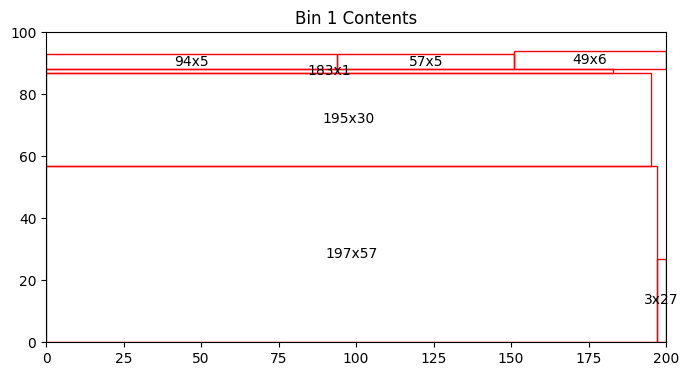

Bin 1 has 1608.00 units of area left


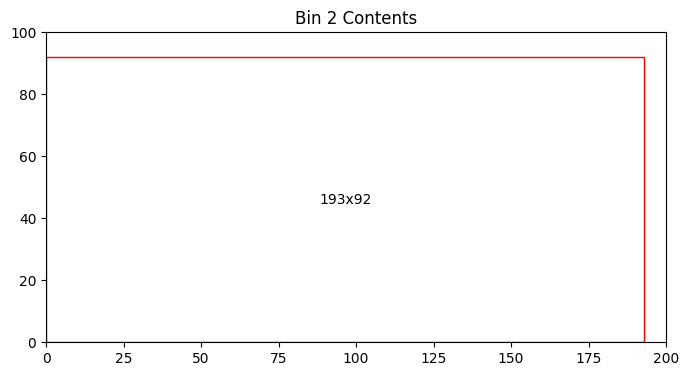

Bin 2 has 2244.00 units of area left


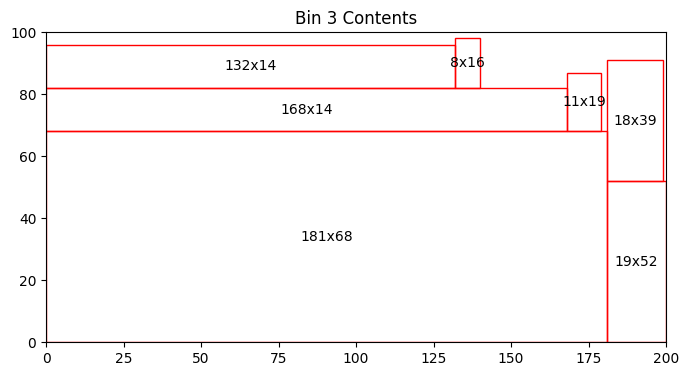

Bin 3 has 1465.00 units of area left


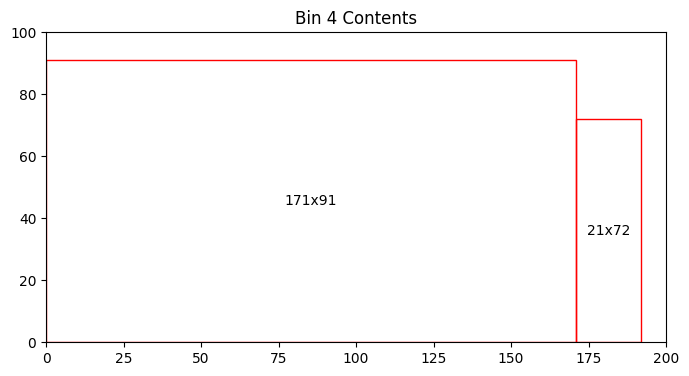

Bin 4 has 2927.00 units of area left


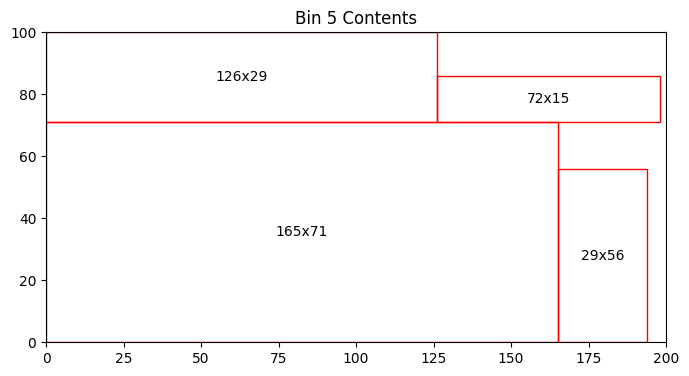

Bin 5 has 1927.00 units of area left


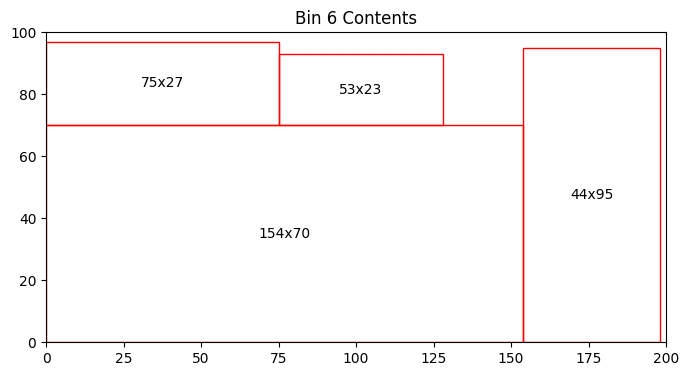

Bin 6 has 1796.00 units of area left


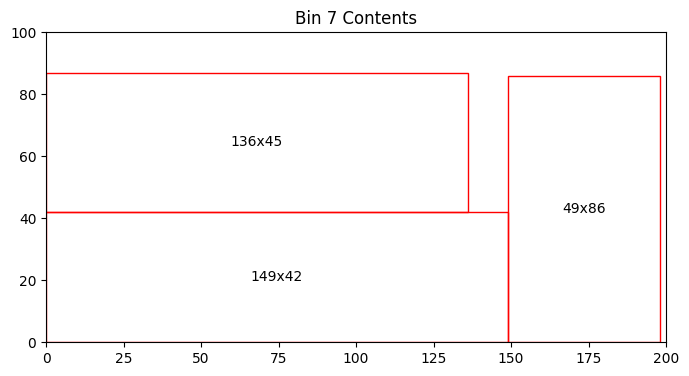

Bin 7 has 3408.00 units of area left


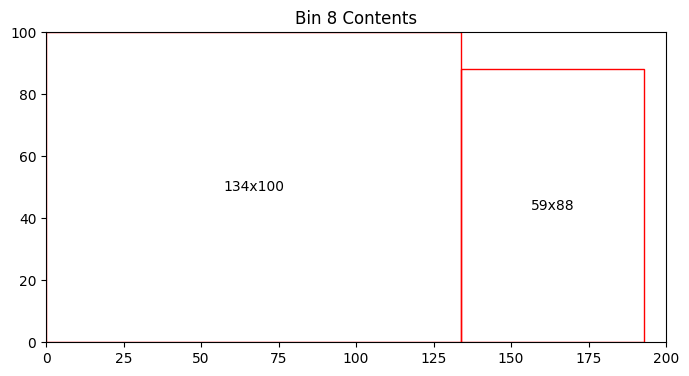

Bin 8 has 1408.00 units of area left


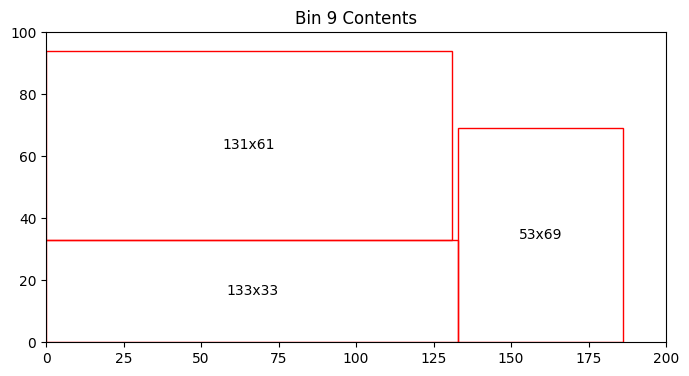

Bin 9 has 3963.00 units of area left


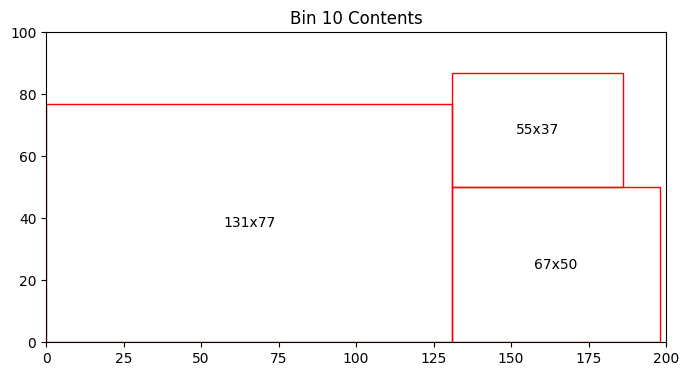

Bin 10 has 4528.00 units of area left


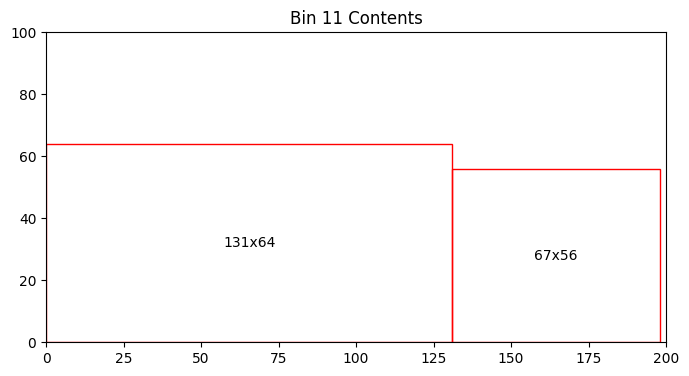

Bin 11 has 7864.00 units of area left


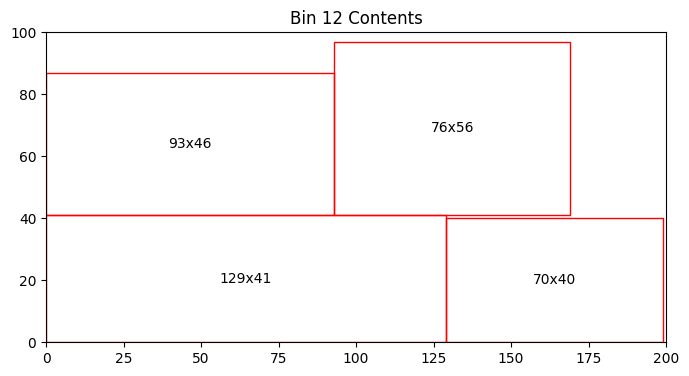

Bin 12 has 3377.00 units of area left


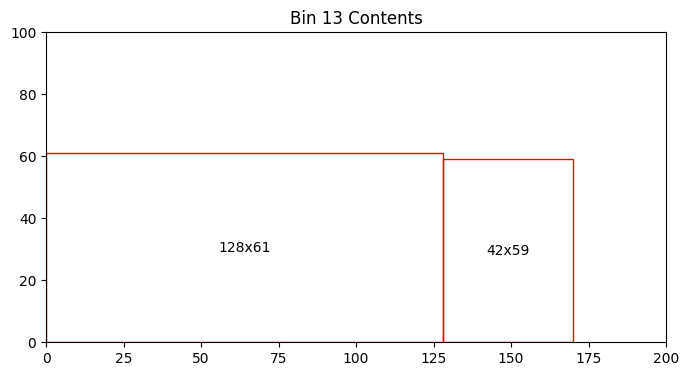

Bin 13 has 9714.00 units of area left


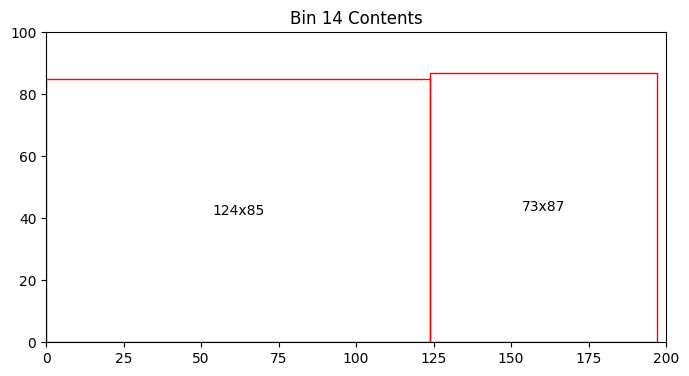

Bin 14 has 3109.00 units of area left


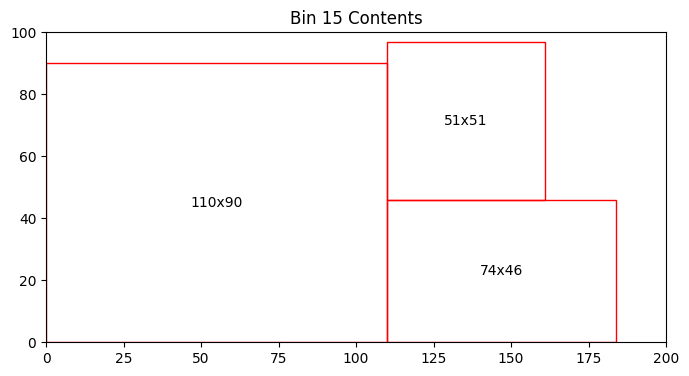

Bin 15 has 4095.00 units of area left


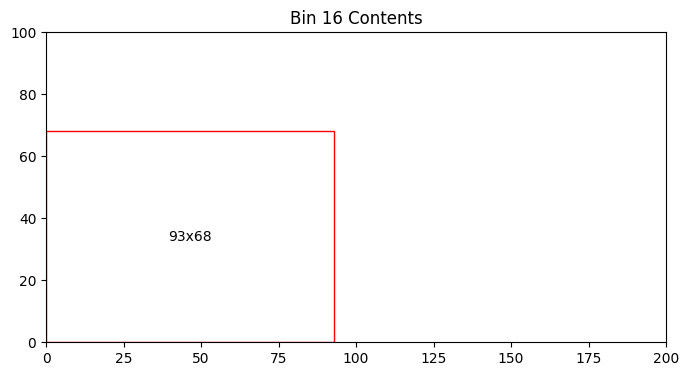

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


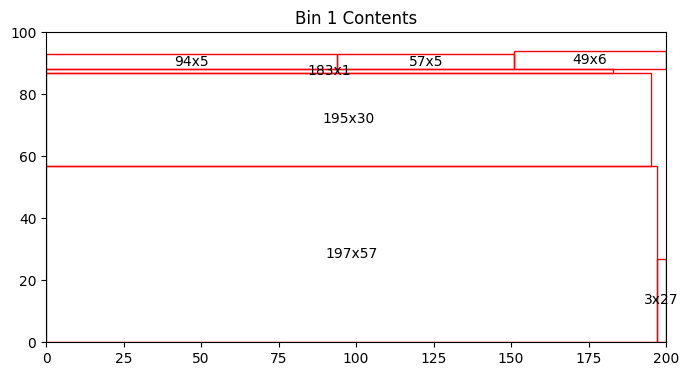

Bin 1 has 1608.00 units of area left


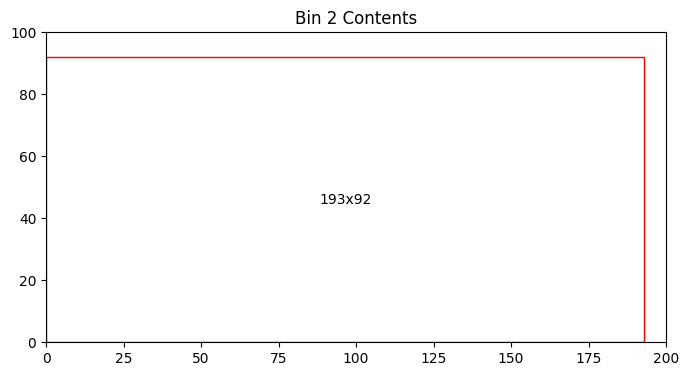

Bin 2 has 2244.00 units of area left


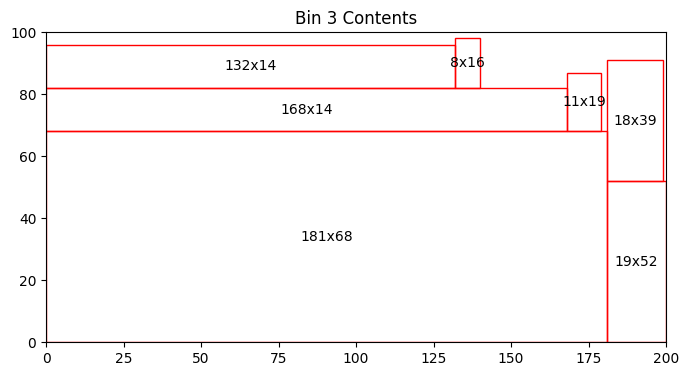

Bin 3 has 1465.00 units of area left


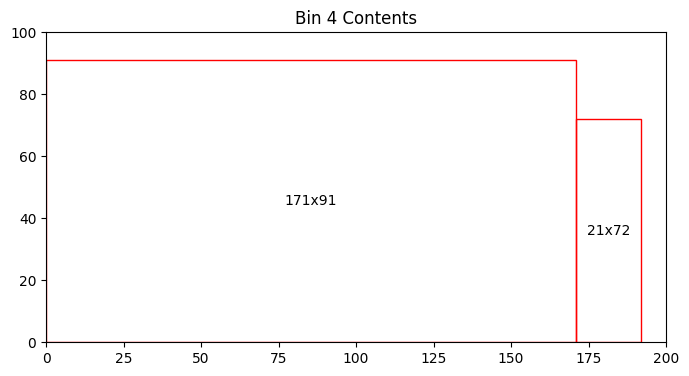

Bin 4 has 2927.00 units of area left


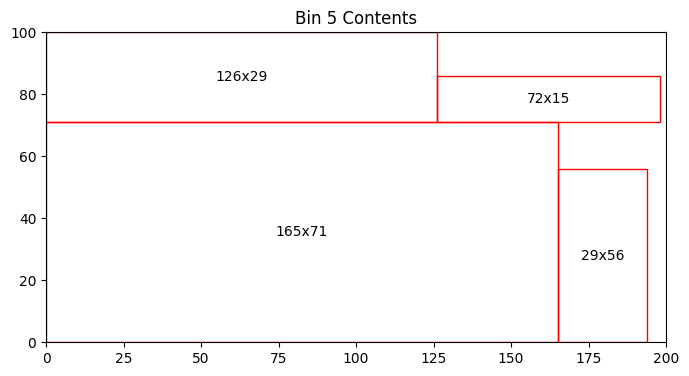

Bin 5 has 1927.00 units of area left


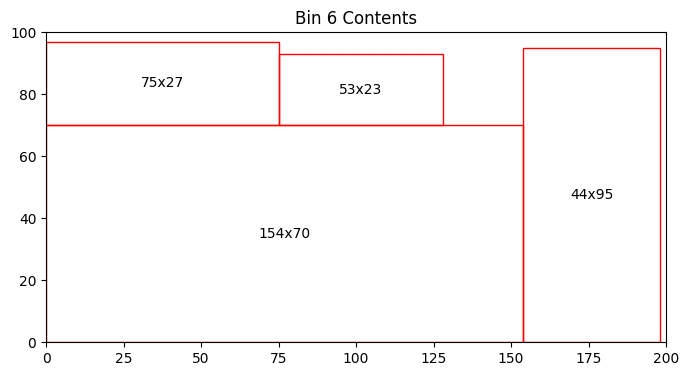

Bin 6 has 1796.00 units of area left


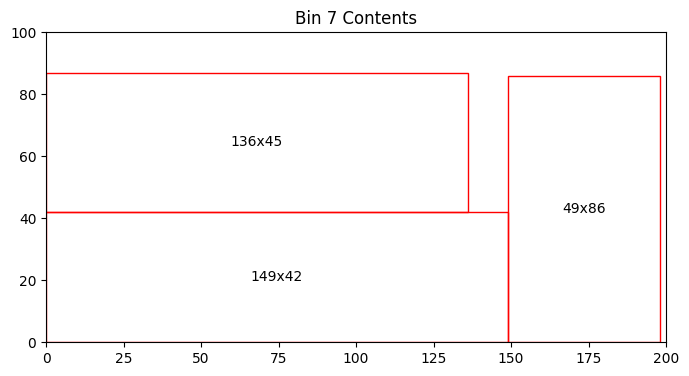

Bin 7 has 3408.00 units of area left


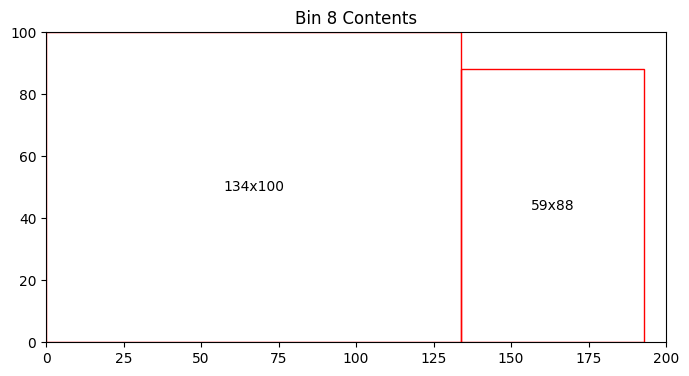

Bin 8 has 1408.00 units of area left


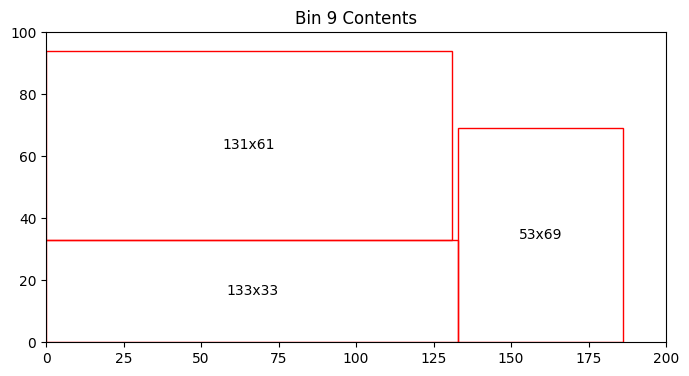

Bin 9 has 3963.00 units of area left


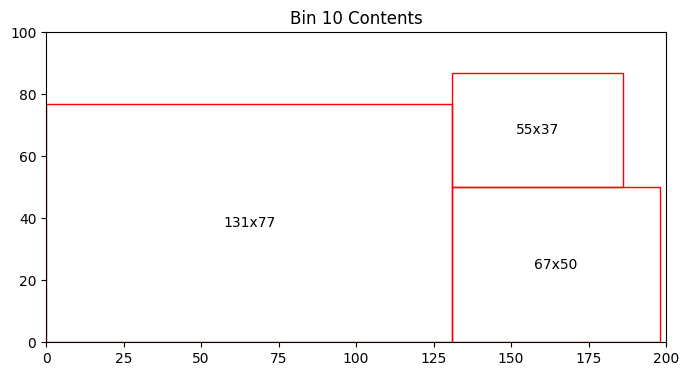

Bin 10 has 4528.00 units of area left


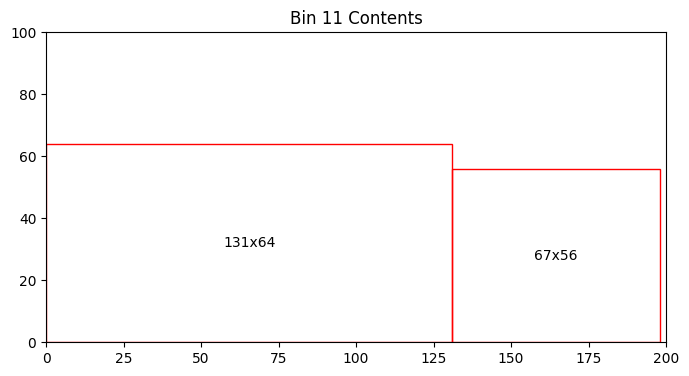

Bin 11 has 7864.00 units of area left


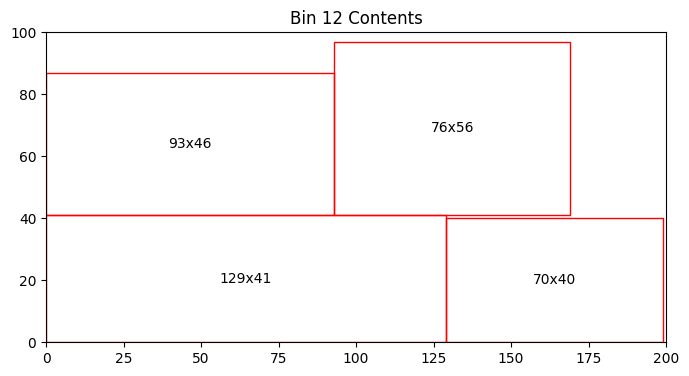

Bin 12 has 3377.00 units of area left


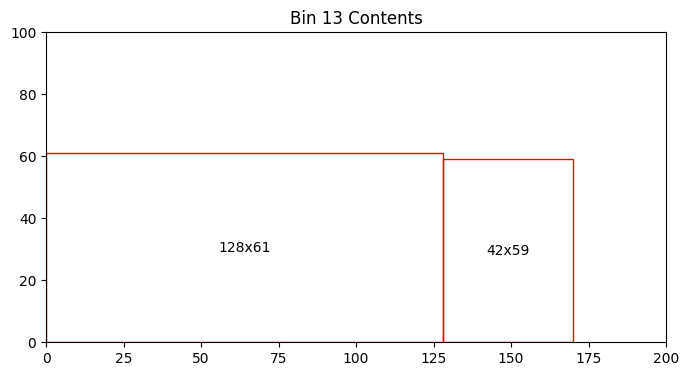

Bin 13 has 9714.00 units of area left


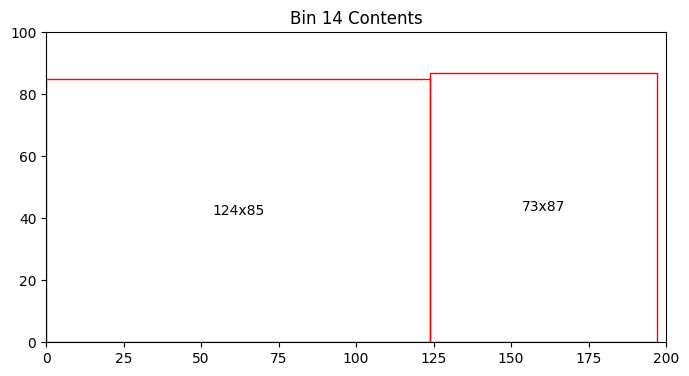

Bin 14 has 3109.00 units of area left


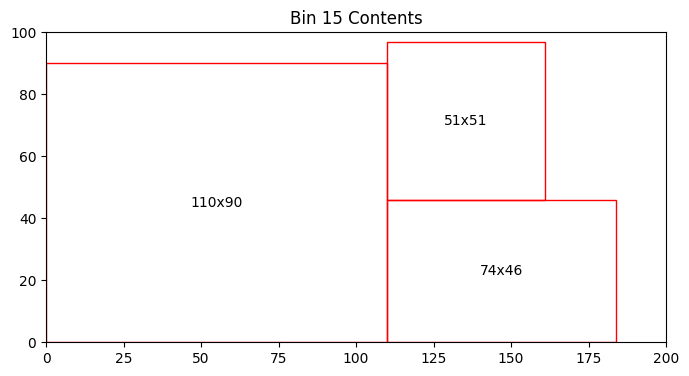

Bin 15 has 4095.00 units of area left


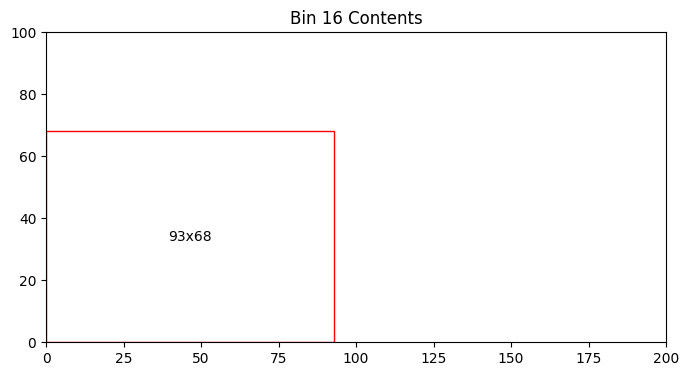

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


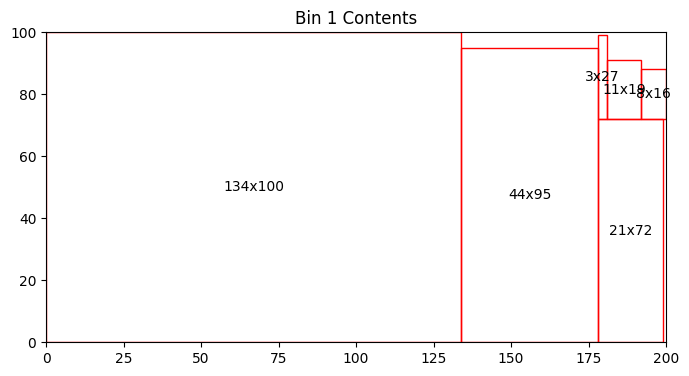

Bin 1 has 490.00 units of area left


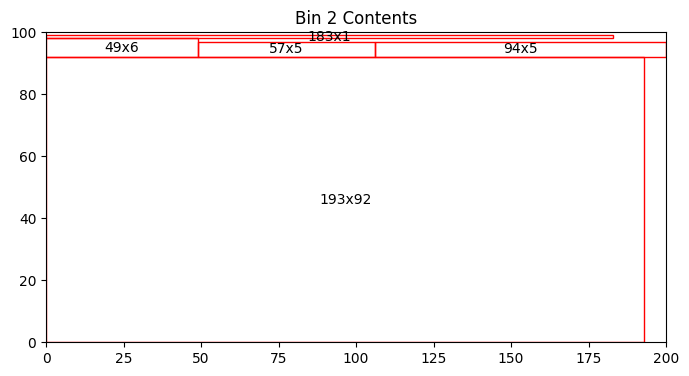

Bin 2 has 1012.00 units of area left


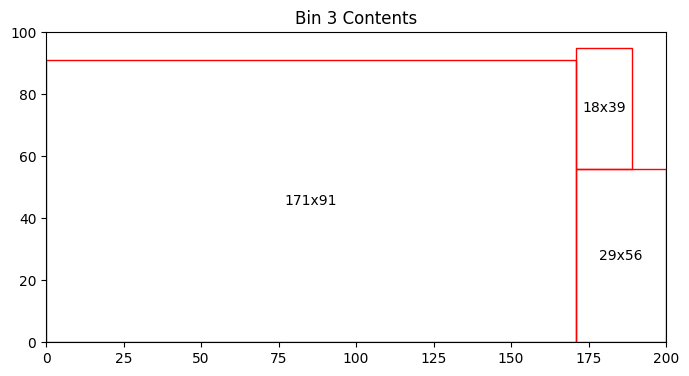

Bin 3 has 2113.00 units of area left


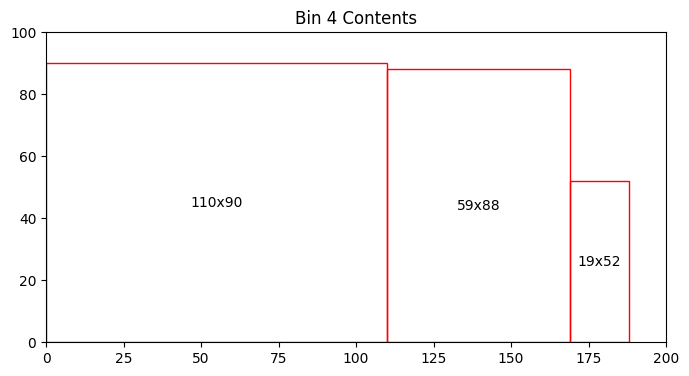

Bin 4 has 3920.00 units of area left


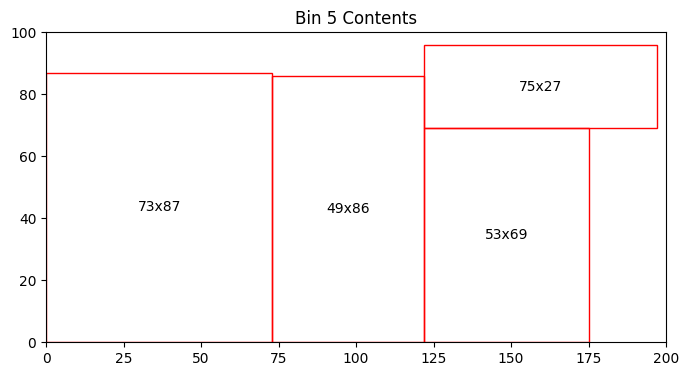

Bin 5 has 3753.00 units of area left


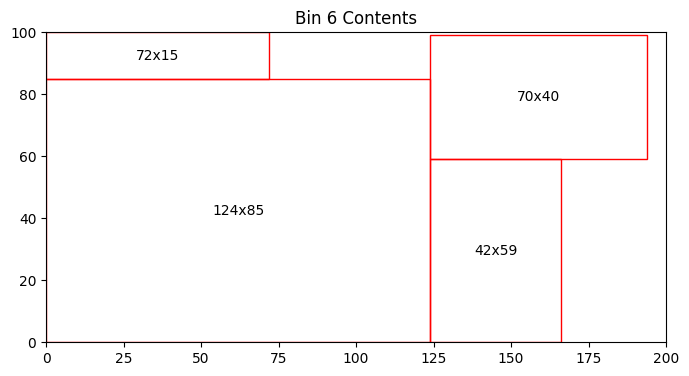

Bin 6 has 3102.00 units of area left


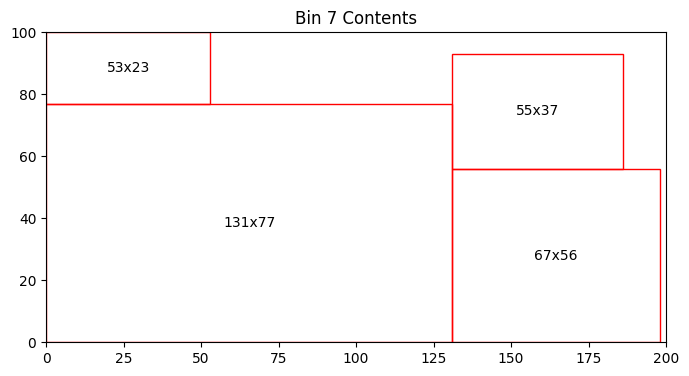

Bin 7 has 2907.00 units of area left


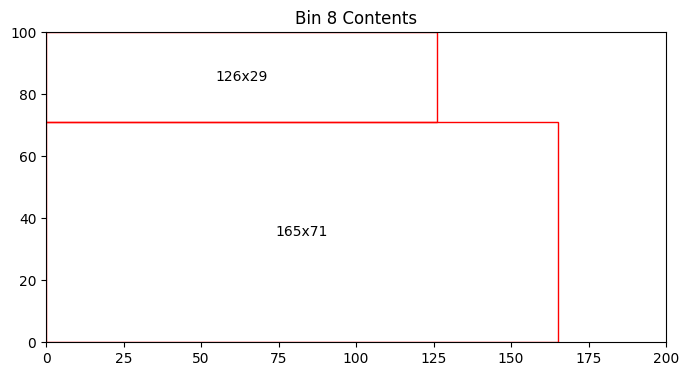

Bin 8 has 4631.00 units of area left


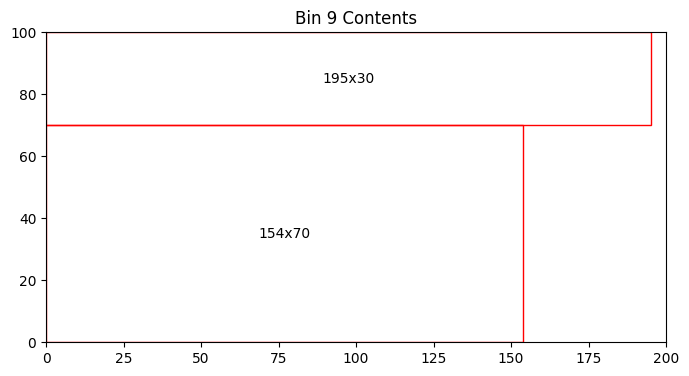

Bin 9 has 3370.00 units of area left


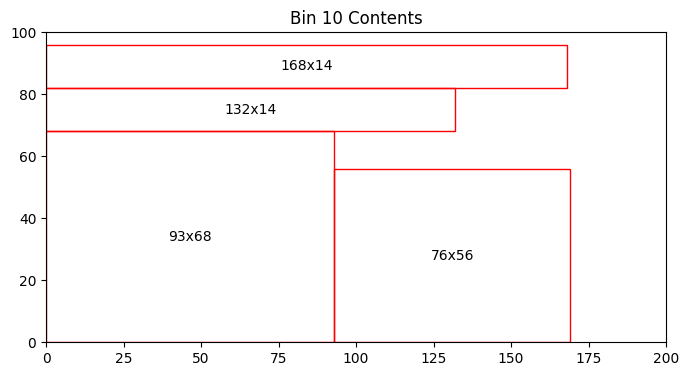

Bin 10 has 5220.00 units of area left


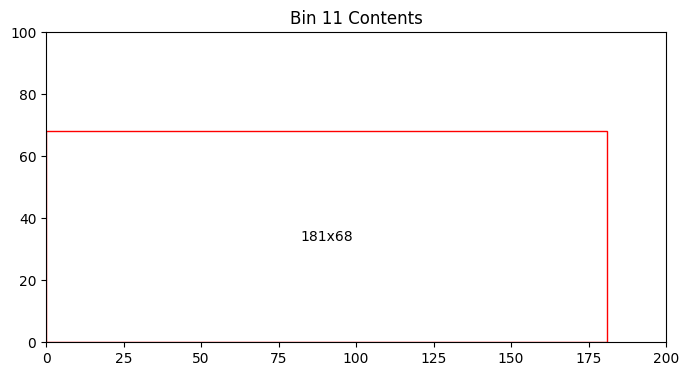

Bin 11 has 7692.00 units of area left


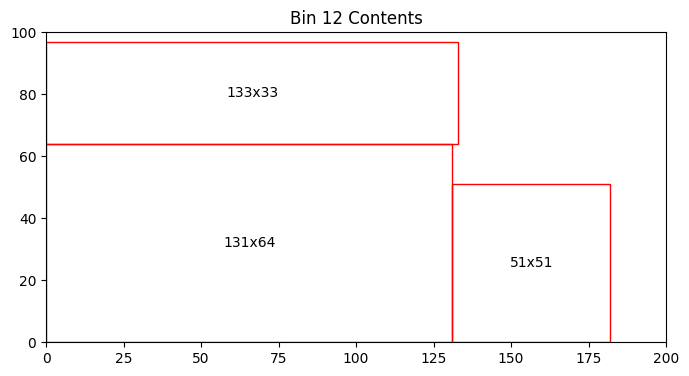

Bin 12 has 4626.00 units of area left


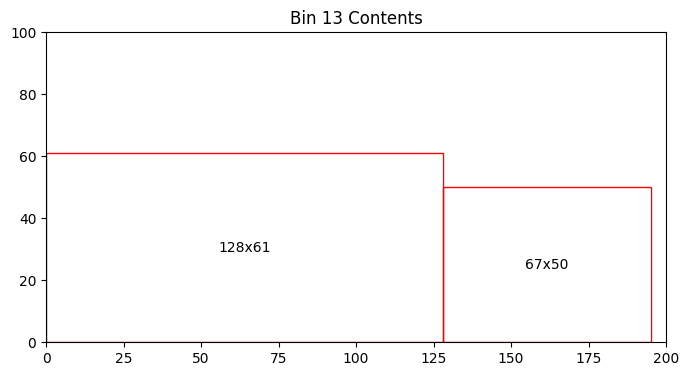

Bin 13 has 8842.00 units of area left


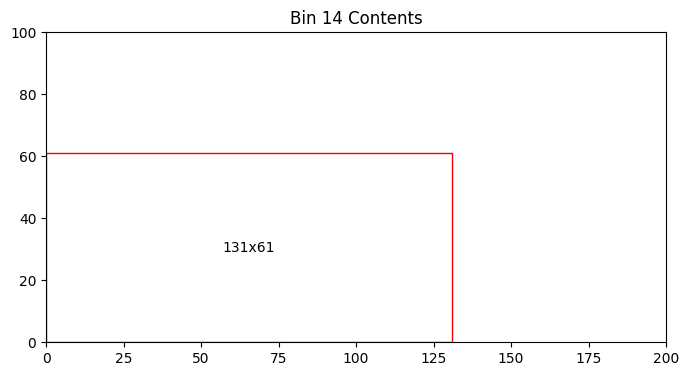

Bin 14 has 12009.00 units of area left


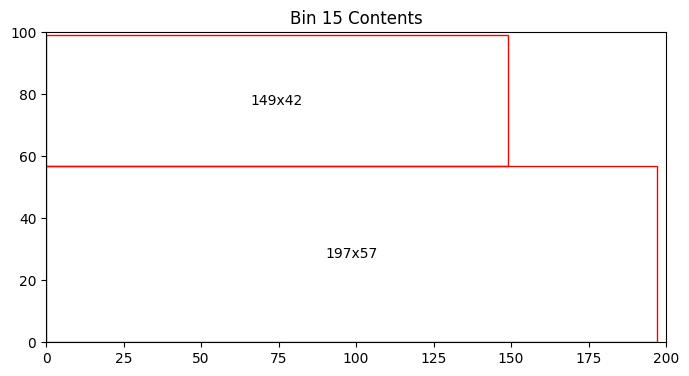

Bin 15 has 2513.00 units of area left


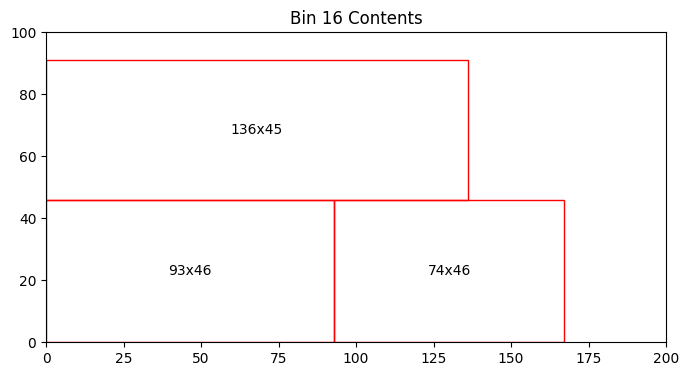

Bin 16 has 6198.00 units of area left


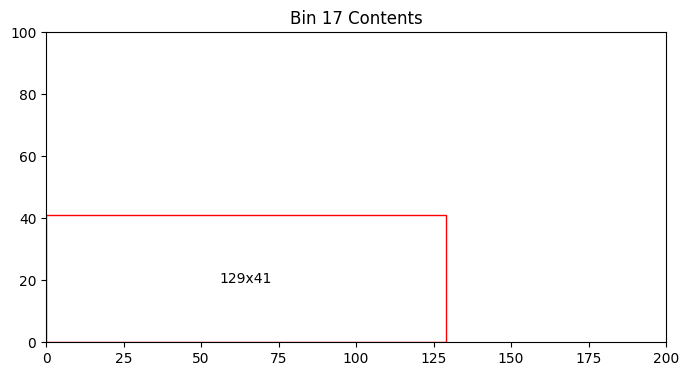

Bin 17 has 14711.00 units of area left
Total number of bins = 17
Total area left in bins = 87109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


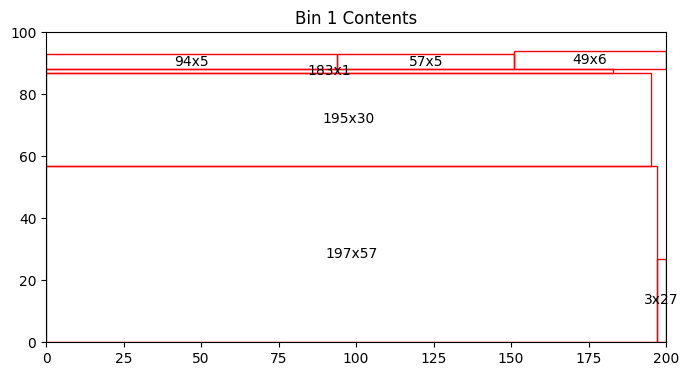

Bin 1 has 1608.00 units of area left


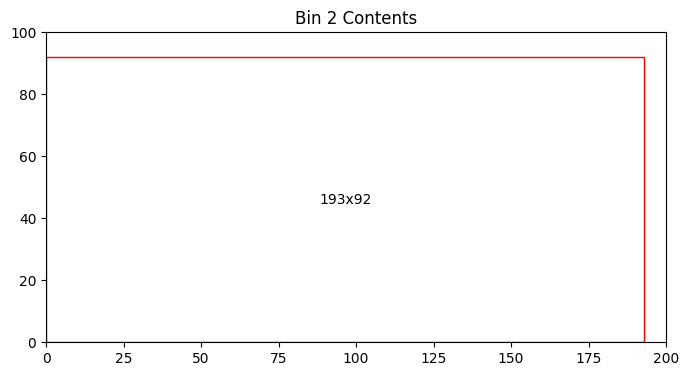

Bin 2 has 2244.00 units of area left


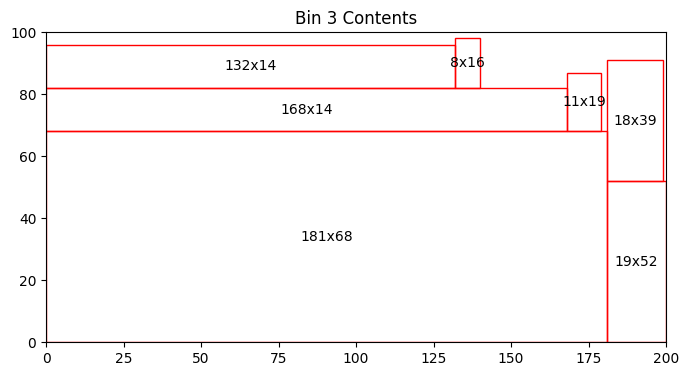

Bin 3 has 1465.00 units of area left


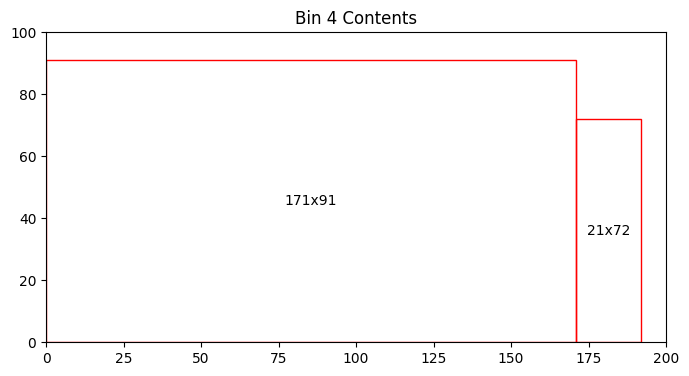

Bin 4 has 2927.00 units of area left


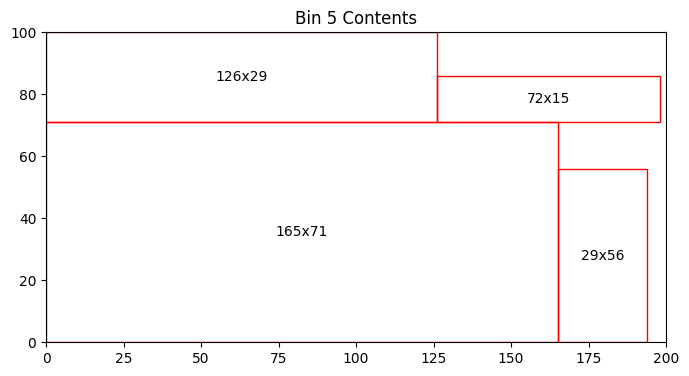

Bin 5 has 1927.00 units of area left


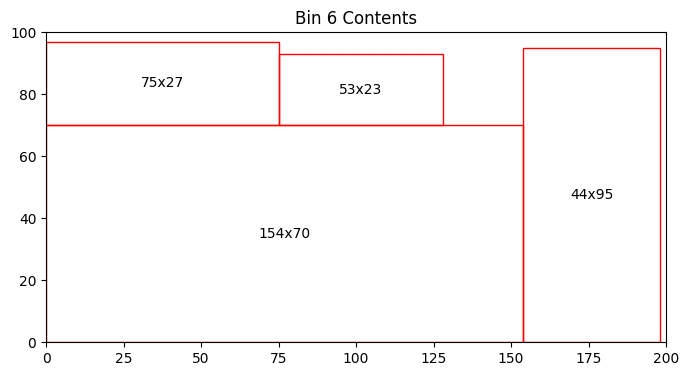

Bin 6 has 1796.00 units of area left


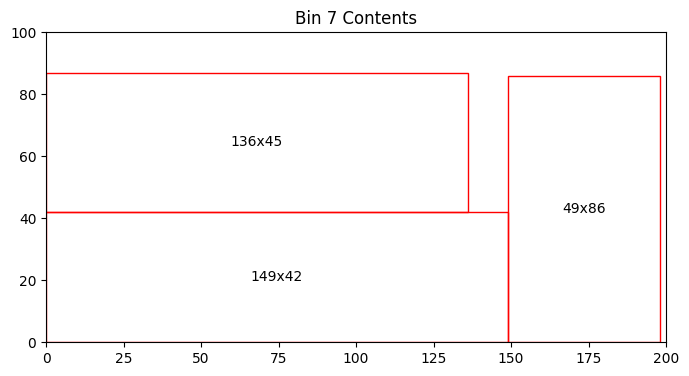

Bin 7 has 3408.00 units of area left


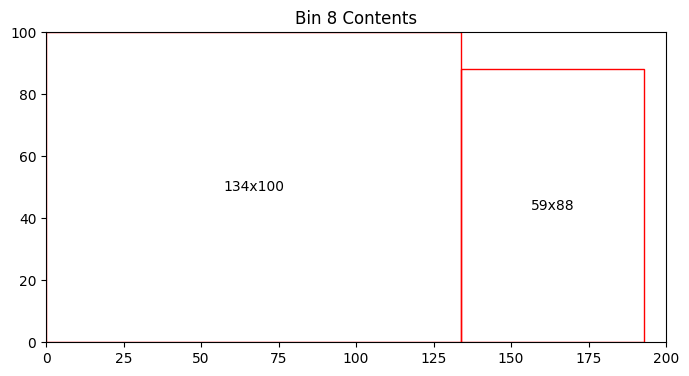

Bin 8 has 1408.00 units of area left


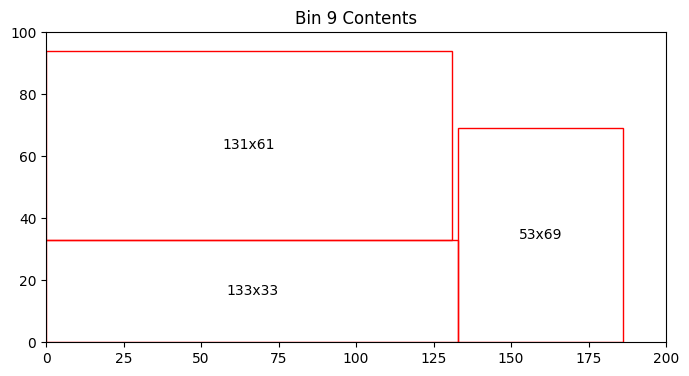

Bin 9 has 3963.00 units of area left


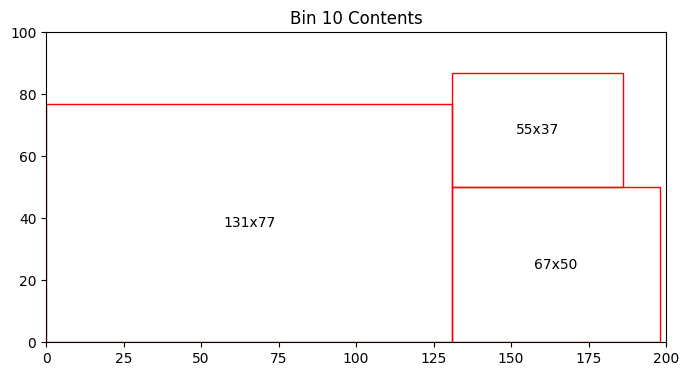

Bin 10 has 4528.00 units of area left


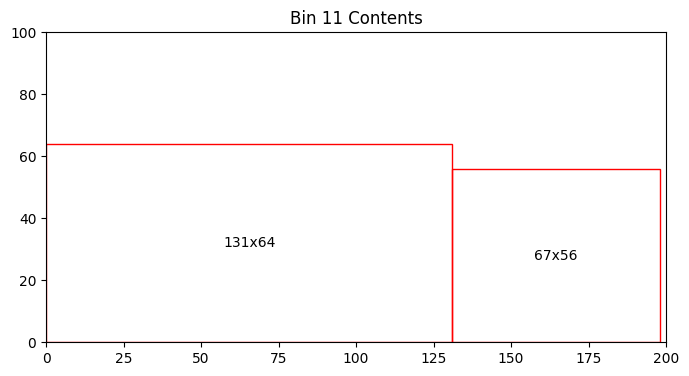

Bin 11 has 7864.00 units of area left


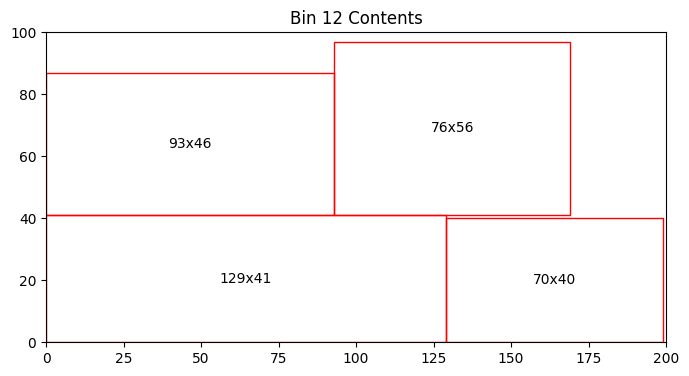

Bin 12 has 3377.00 units of area left


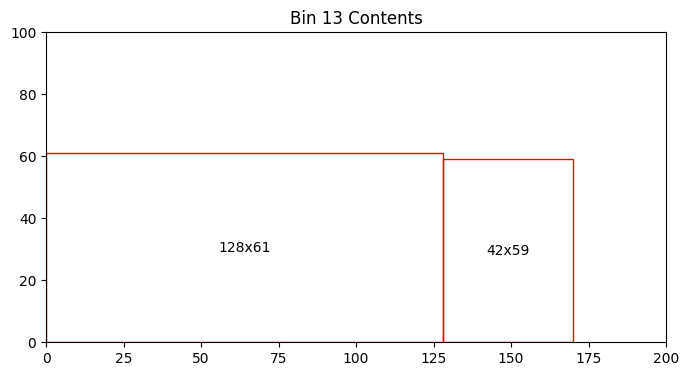

Bin 13 has 9714.00 units of area left


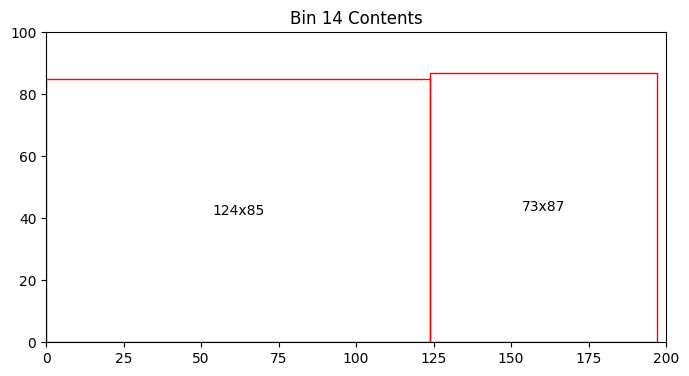

Bin 14 has 3109.00 units of area left


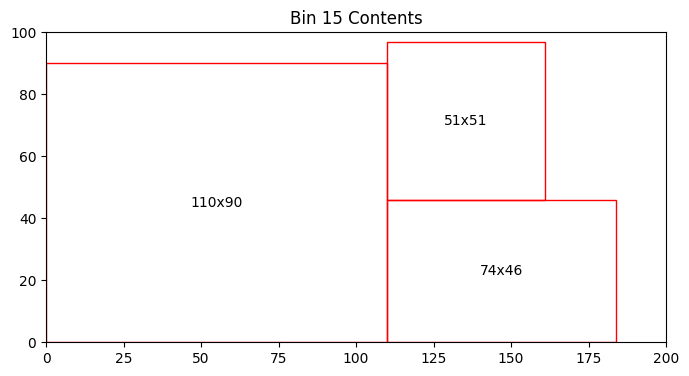

Bin 15 has 4095.00 units of area left


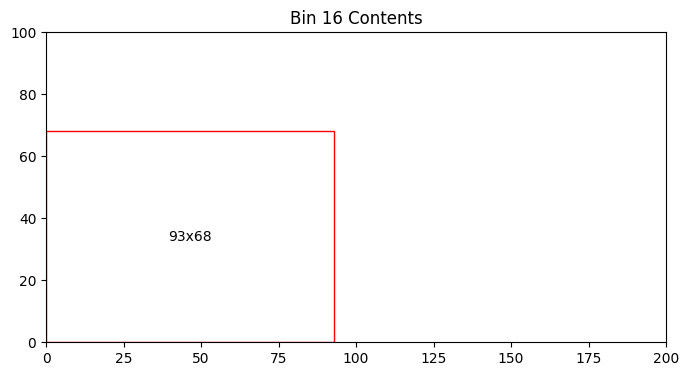

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


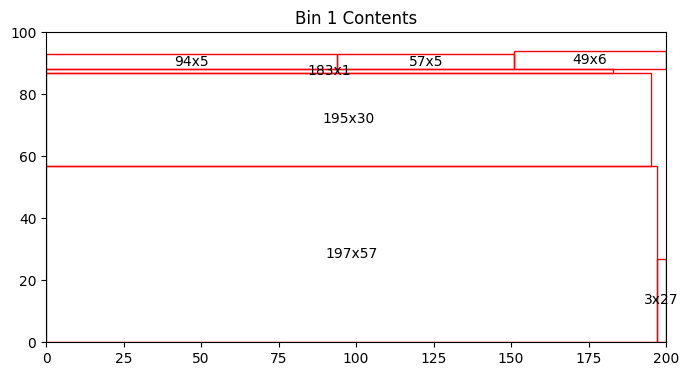

Bin 1 has 1608.00 units of area left


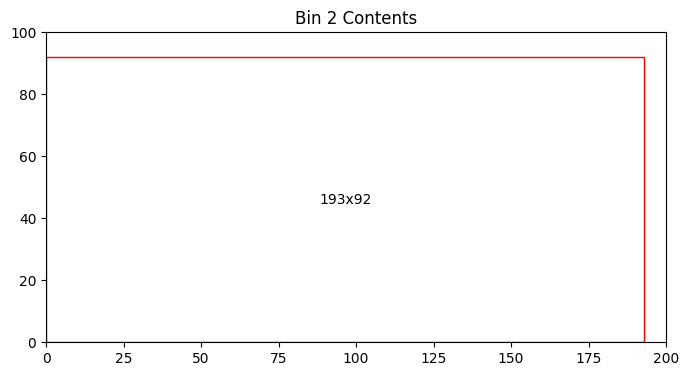

Bin 2 has 2244.00 units of area left


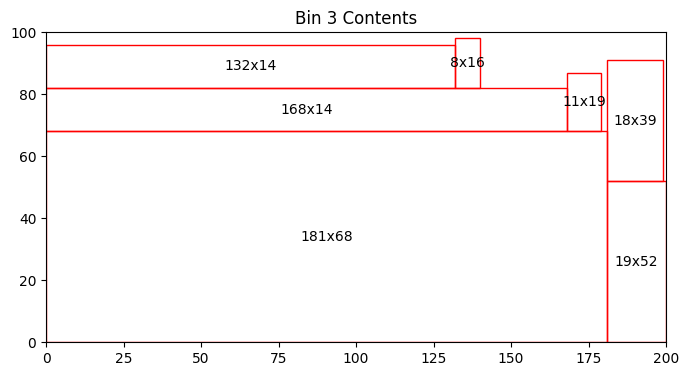

Bin 3 has 1465.00 units of area left


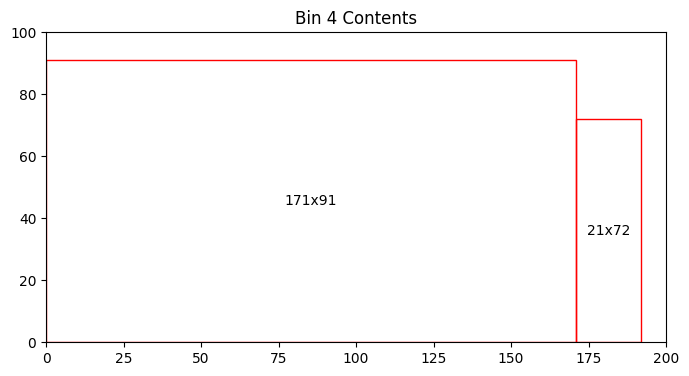

Bin 4 has 2927.00 units of area left


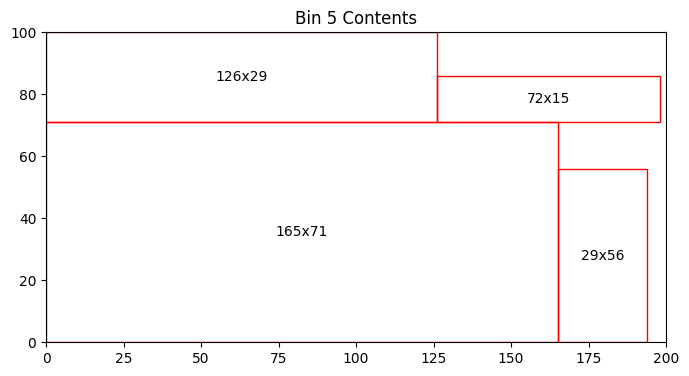

Bin 5 has 1927.00 units of area left


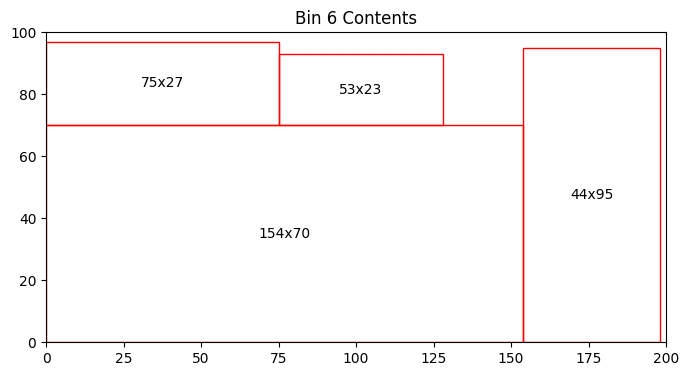

Bin 6 has 1796.00 units of area left


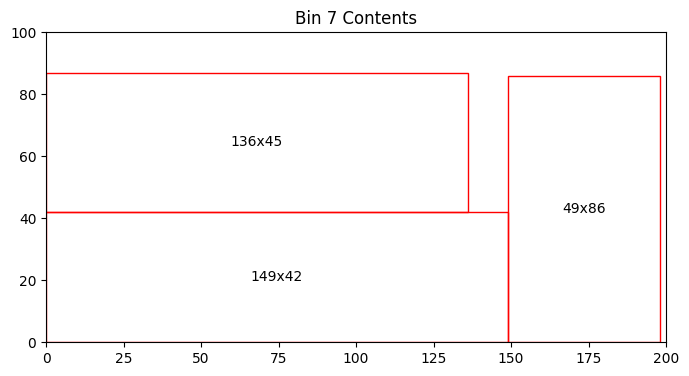

Bin 7 has 3408.00 units of area left


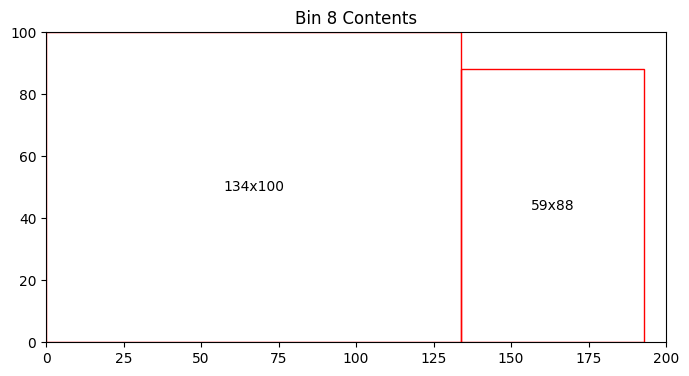

Bin 8 has 1408.00 units of area left


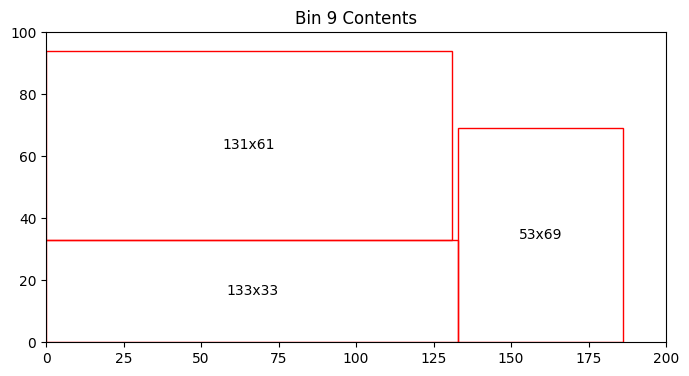

Bin 9 has 3963.00 units of area left


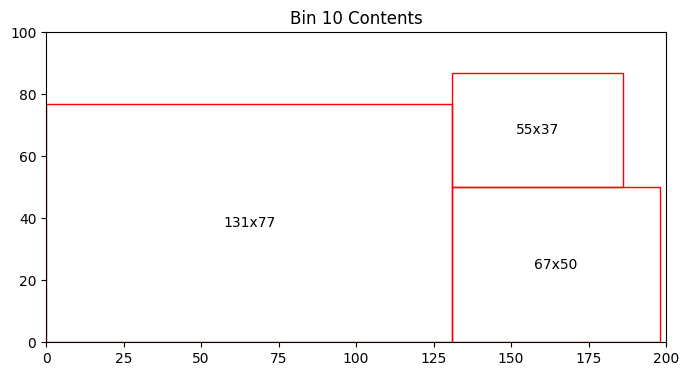

Bin 10 has 4528.00 units of area left


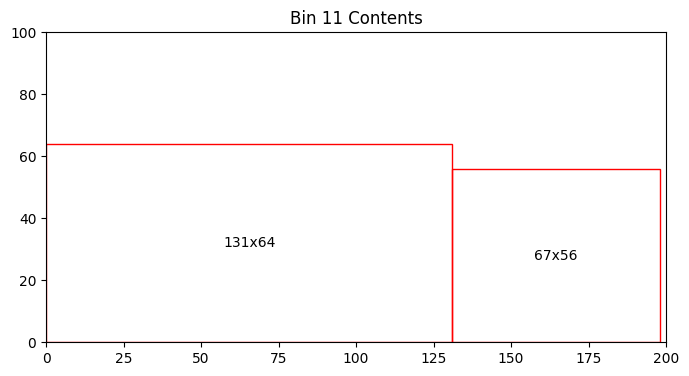

Bin 11 has 7864.00 units of area left


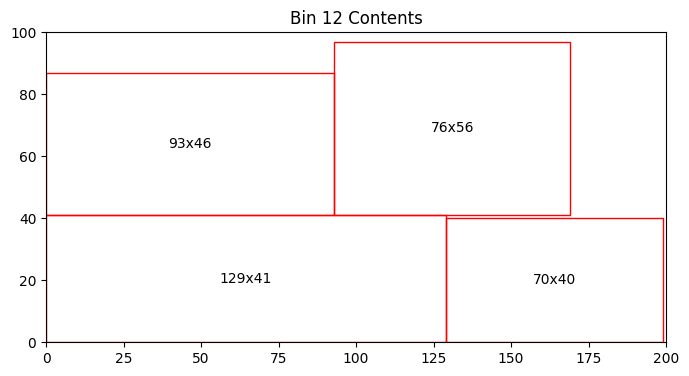

Bin 12 has 3377.00 units of area left


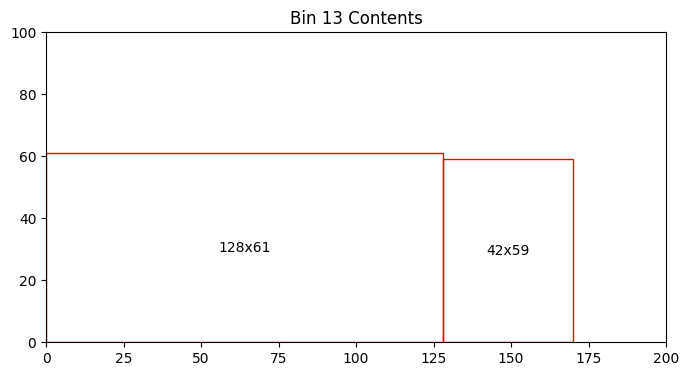

Bin 13 has 9714.00 units of area left


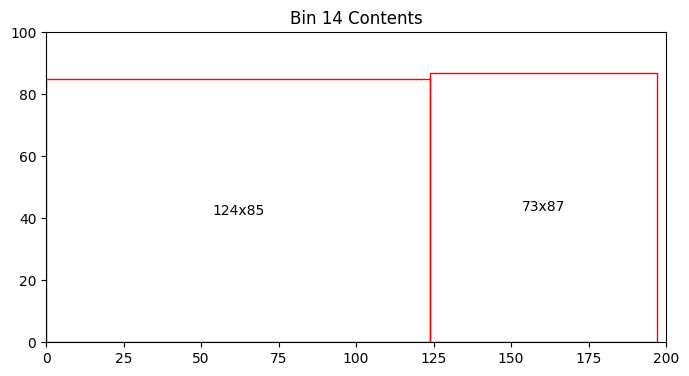

Bin 14 has 3109.00 units of area left


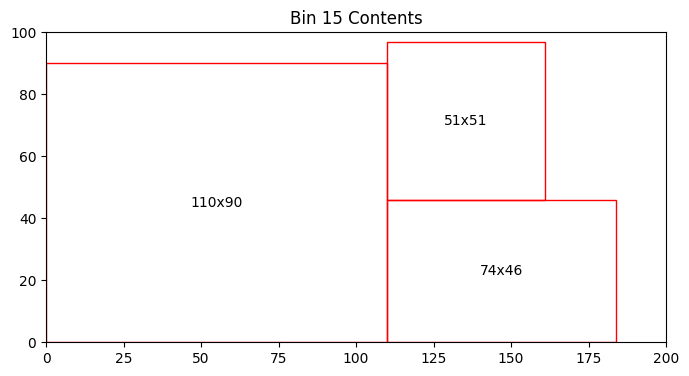

Bin 15 has 4095.00 units of area left


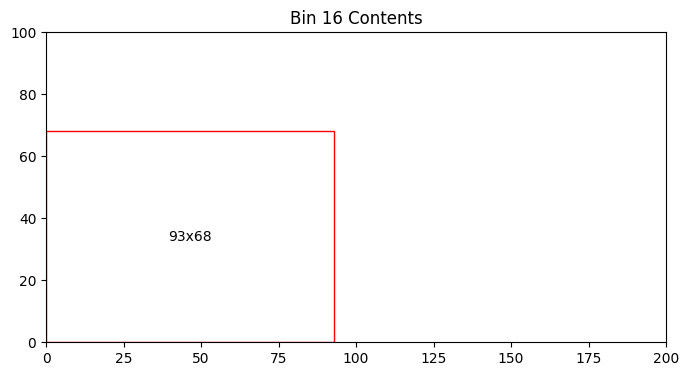

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


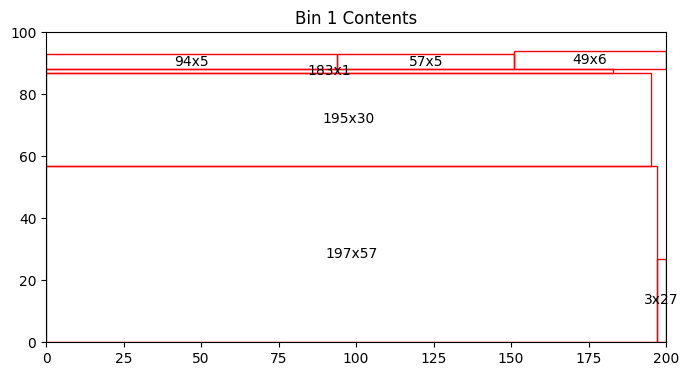

Bin 1 has 1608.00 units of area left


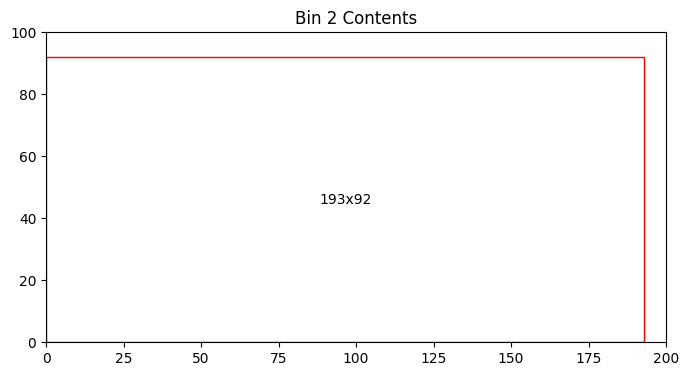

Bin 2 has 2244.00 units of area left


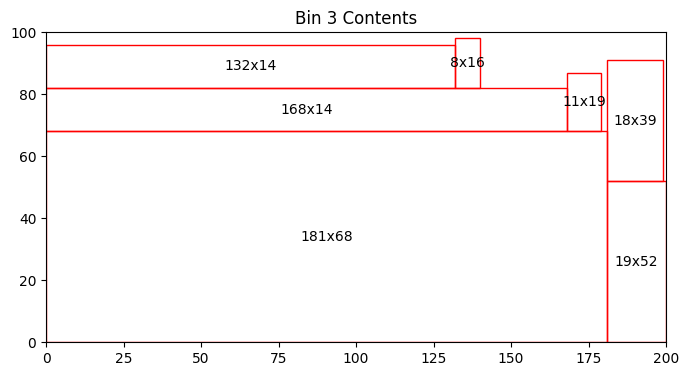

Bin 3 has 1465.00 units of area left


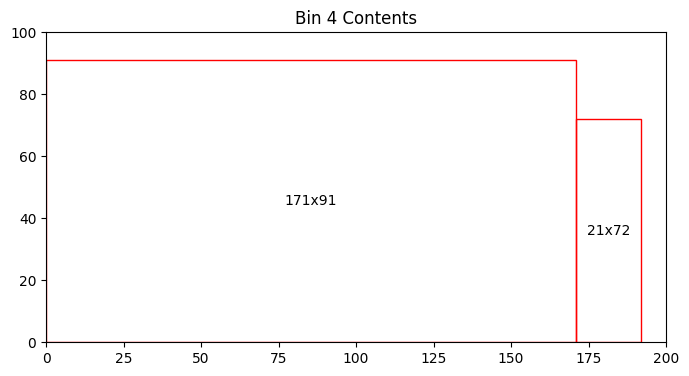

Bin 4 has 2927.00 units of area left


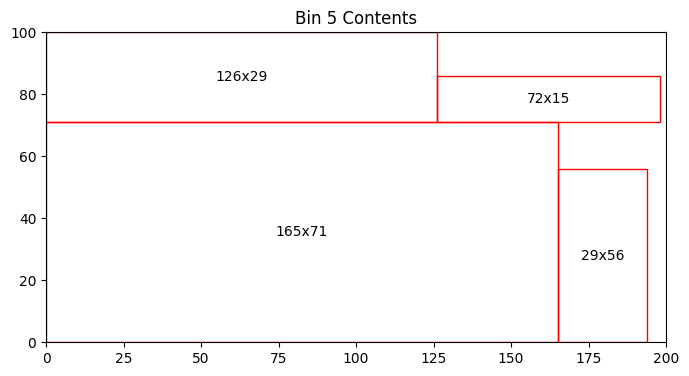

Bin 5 has 1927.00 units of area left


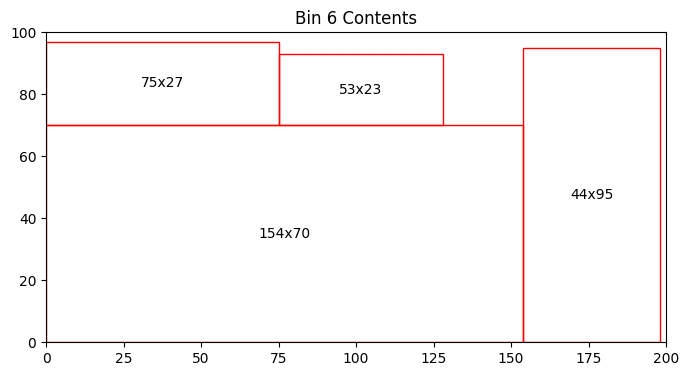

Bin 6 has 1796.00 units of area left


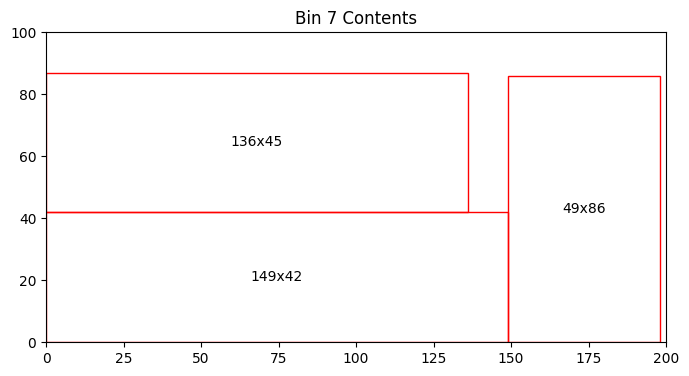

Bin 7 has 3408.00 units of area left


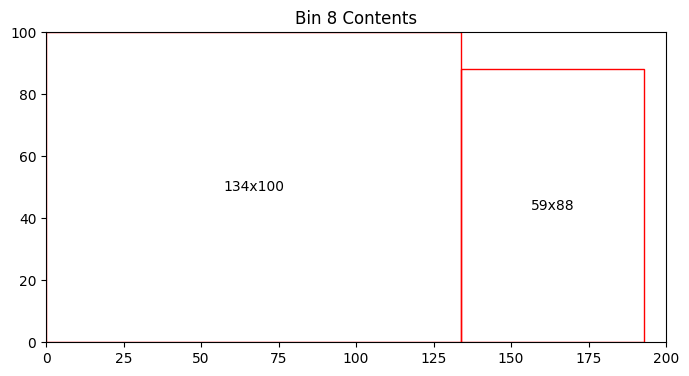

Bin 8 has 1408.00 units of area left


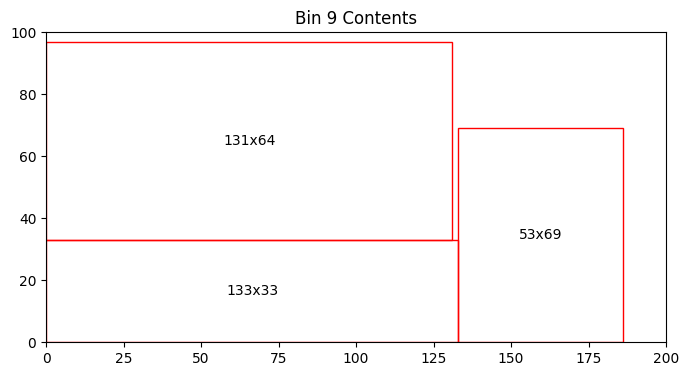

Bin 9 has 3570.00 units of area left


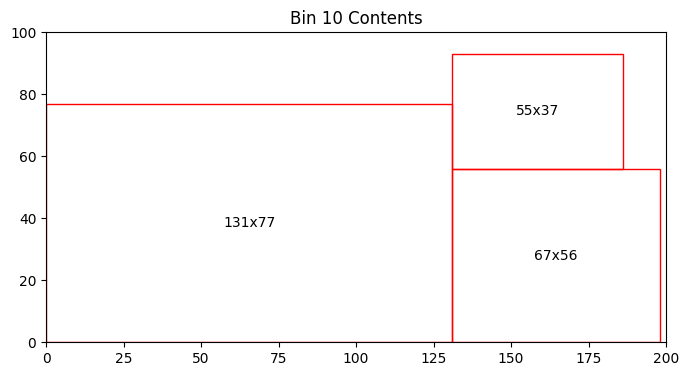

Bin 10 has 4126.00 units of area left


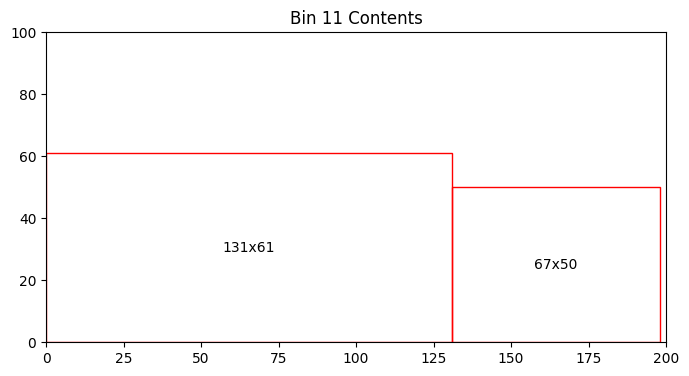

Bin 11 has 8659.00 units of area left


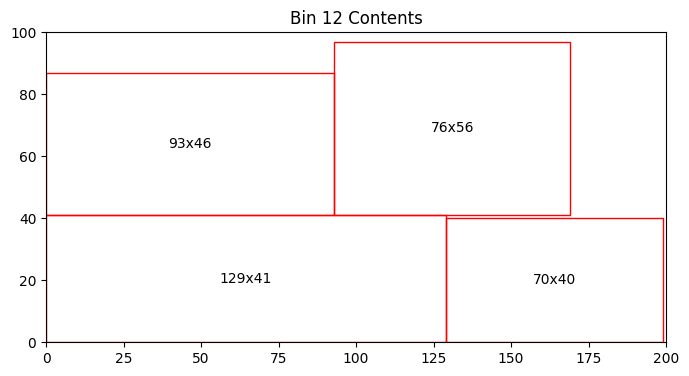

Bin 12 has 3377.00 units of area left


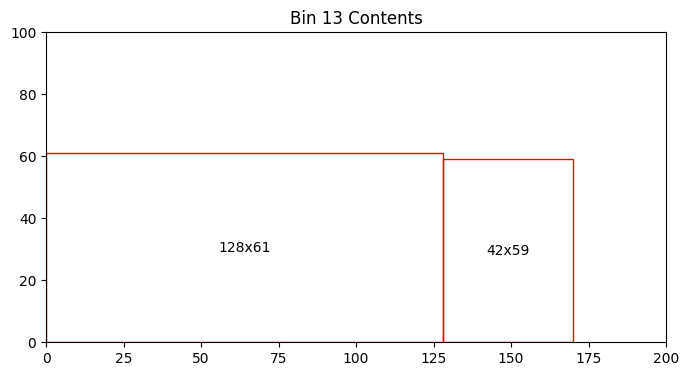

Bin 13 has 9714.00 units of area left


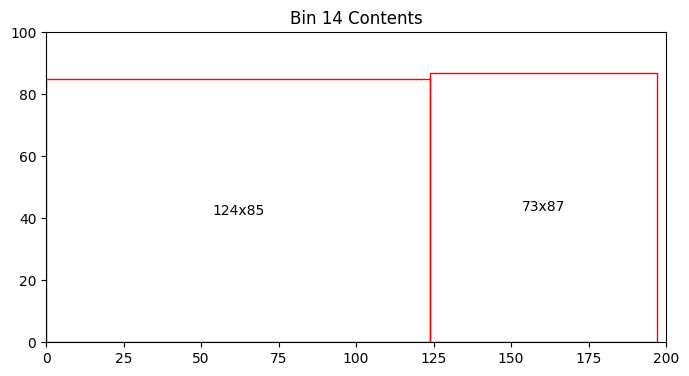

Bin 14 has 3109.00 units of area left


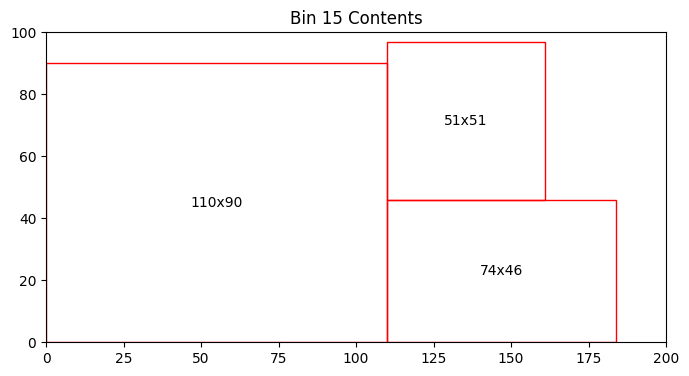

Bin 15 has 4095.00 units of area left


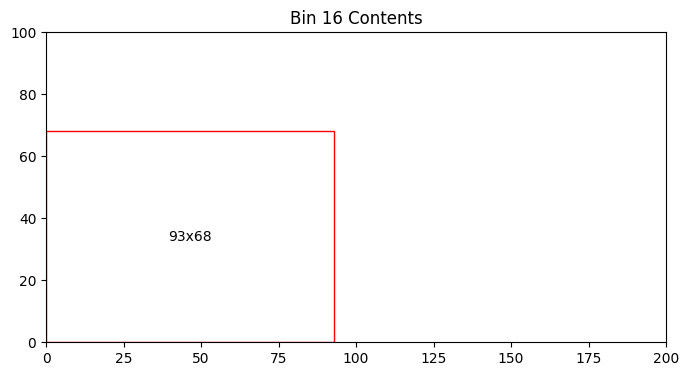

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


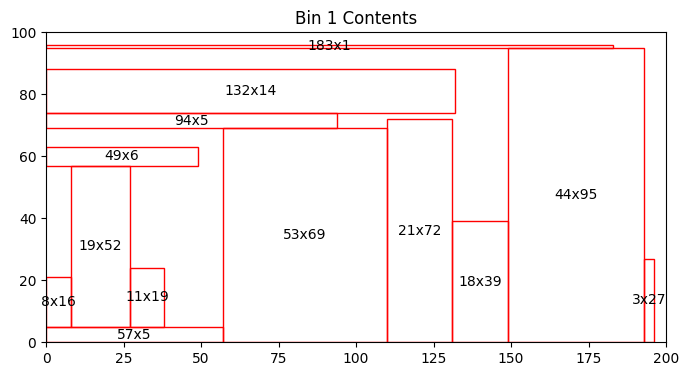

Bin 1 has 5463.00 units of area left


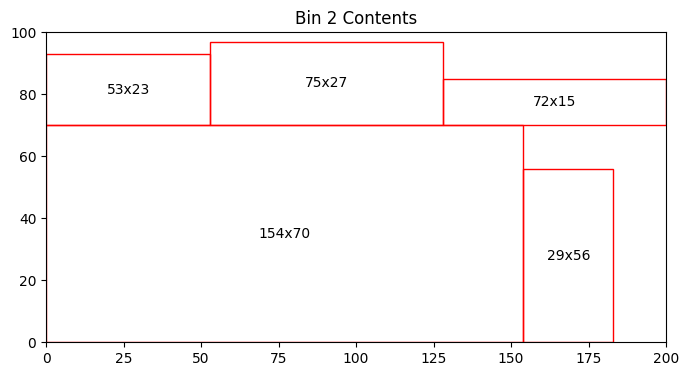

Bin 2 has 3272.00 units of area left


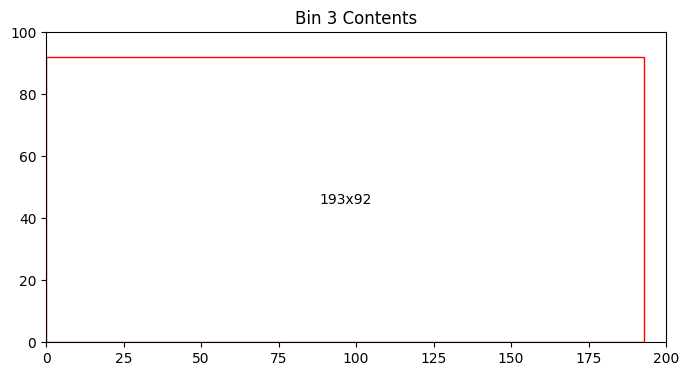

Bin 3 has 2244.00 units of area left


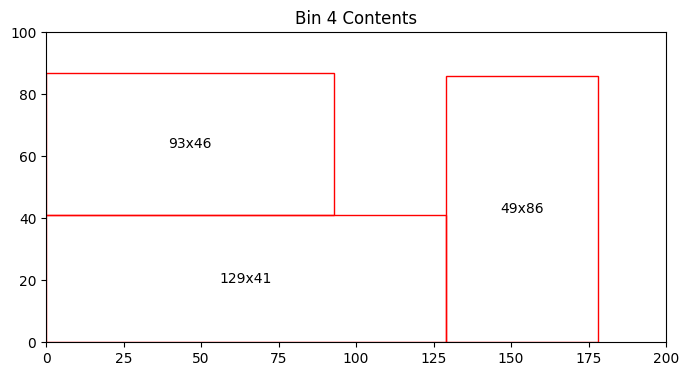

Bin 4 has 6219.00 units of area left


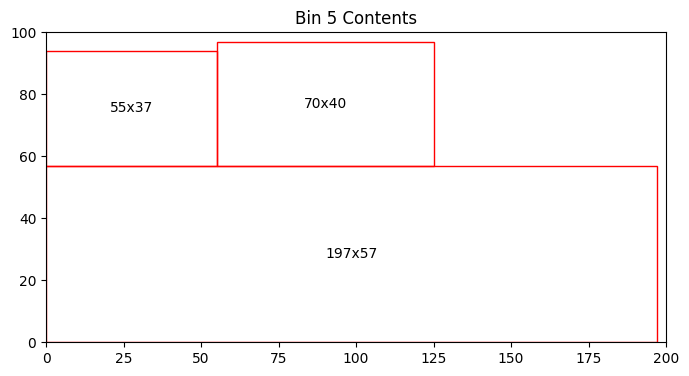

Bin 5 has 3936.00 units of area left


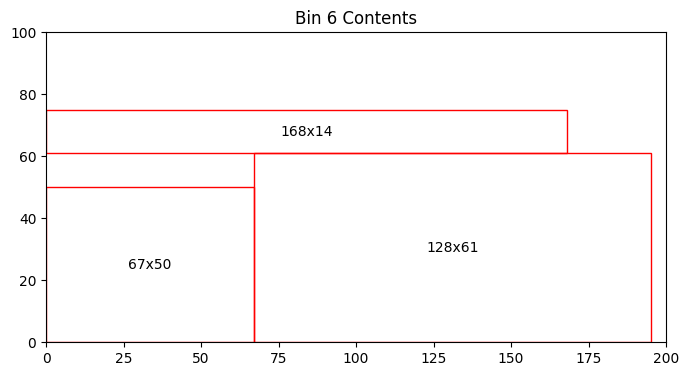

Bin 6 has 6490.00 units of area left


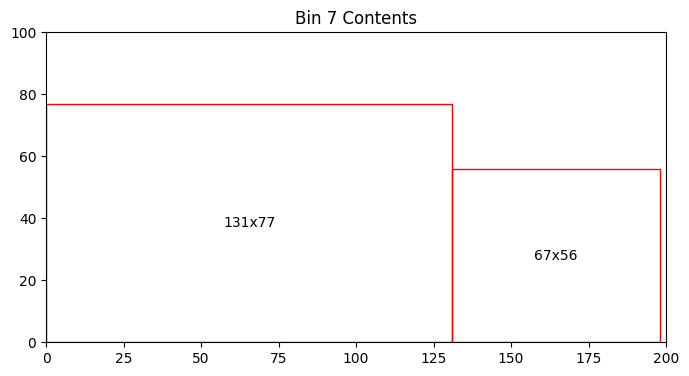

Bin 7 has 6161.00 units of area left


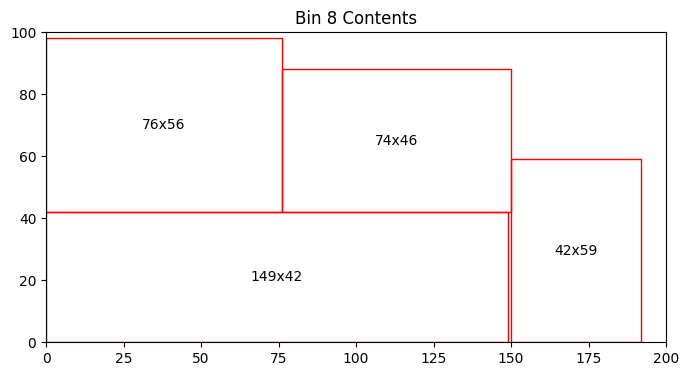

Bin 8 has 3604.00 units of area left


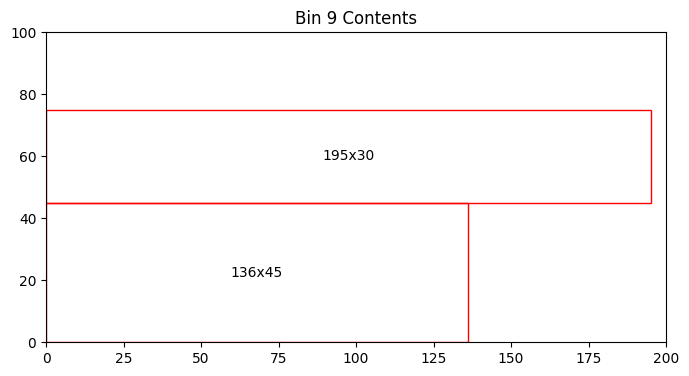

Bin 9 has 8030.00 units of area left


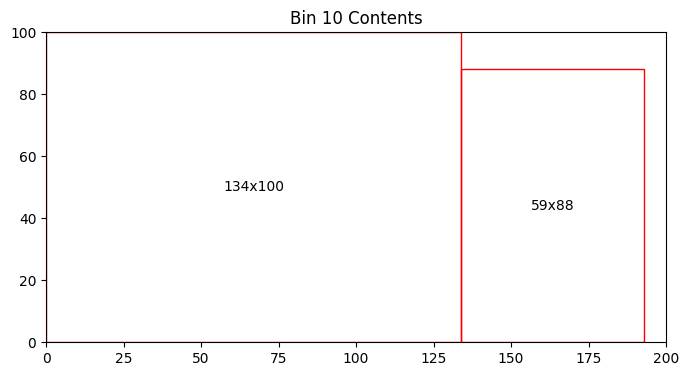

Bin 10 has 1408.00 units of area left


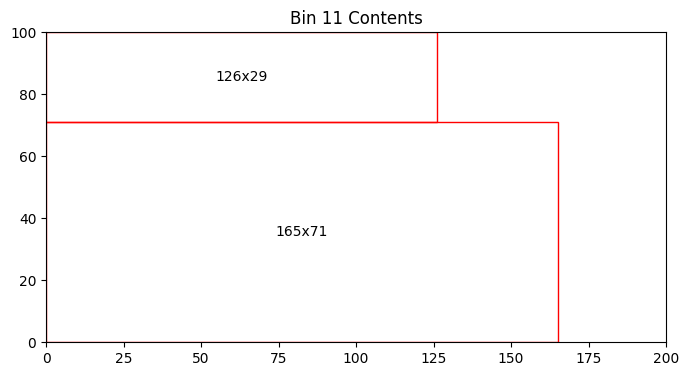

Bin 11 has 4631.00 units of area left


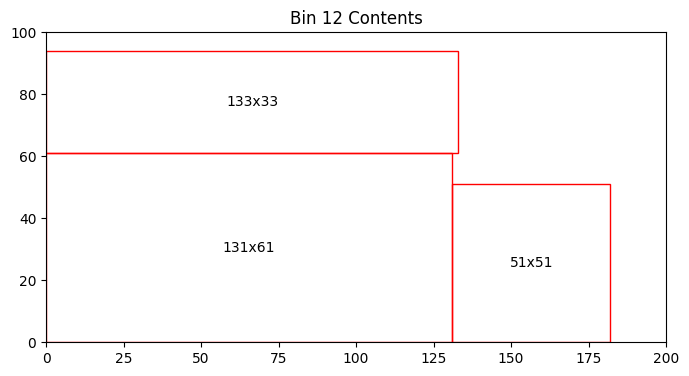

Bin 12 has 5019.00 units of area left


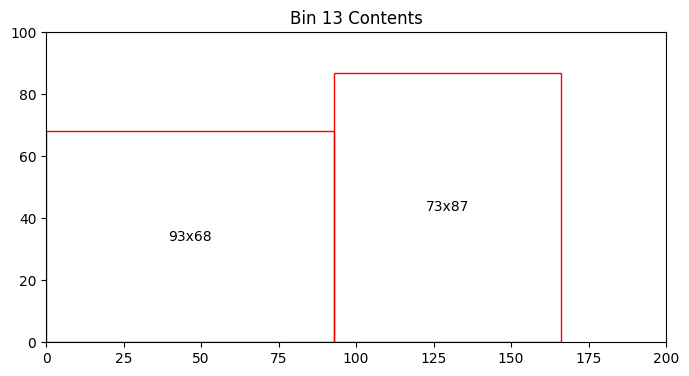

Bin 13 has 7325.00 units of area left


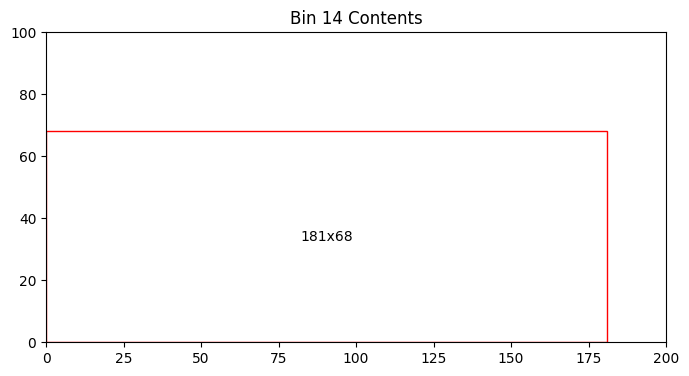

Bin 14 has 7692.00 units of area left


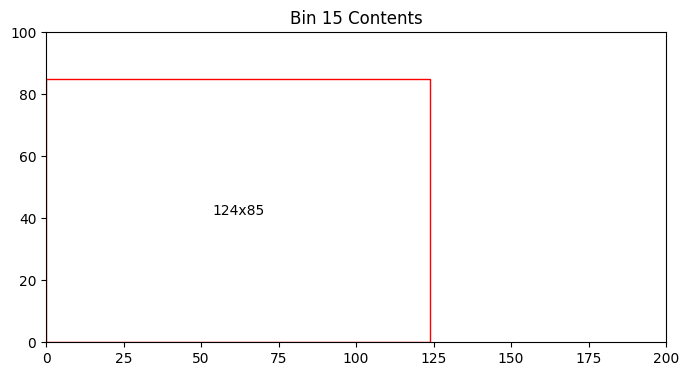

Bin 15 has 9460.00 units of area left


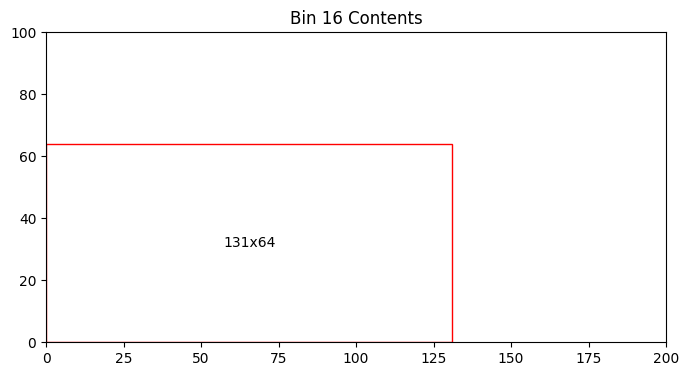

Bin 16 has 11616.00 units of area left


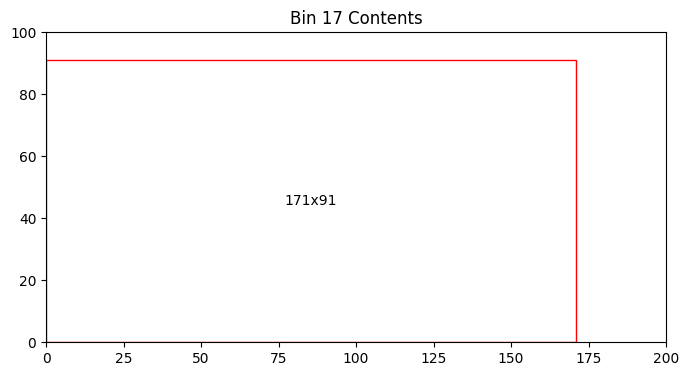

Bin 17 has 4439.00 units of area left


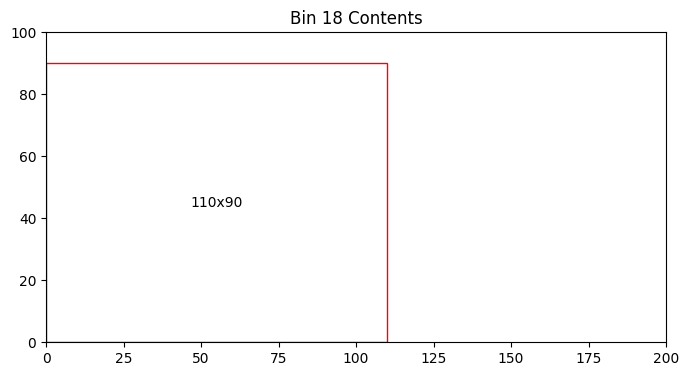

Bin 18 has 10100.00 units of area left
Total number of bins = 18
Total area left in bins = 107109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


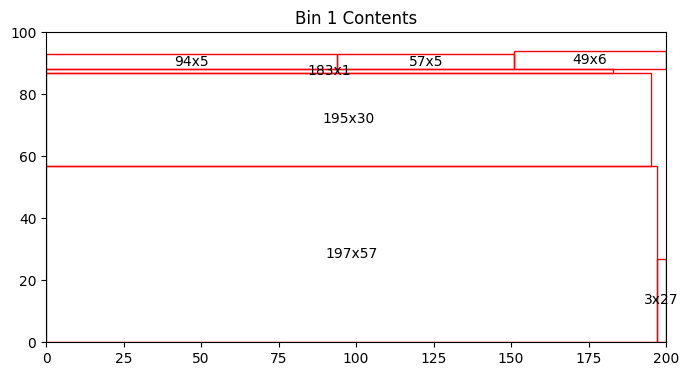

Bin 1 has 1608.00 units of area left


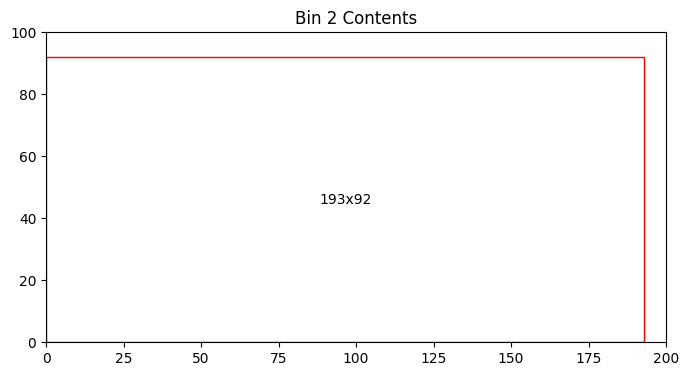

Bin 2 has 2244.00 units of area left


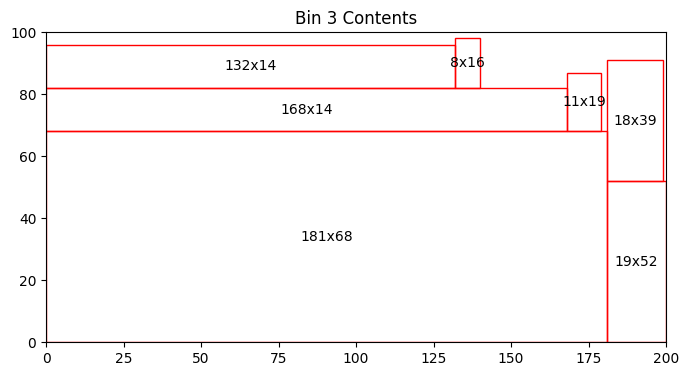

Bin 3 has 1465.00 units of area left


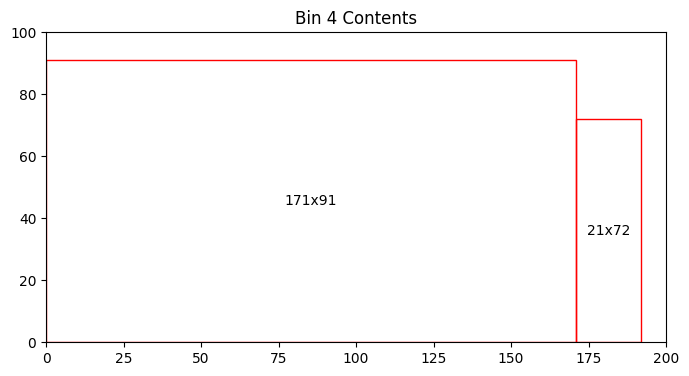

Bin 4 has 2927.00 units of area left


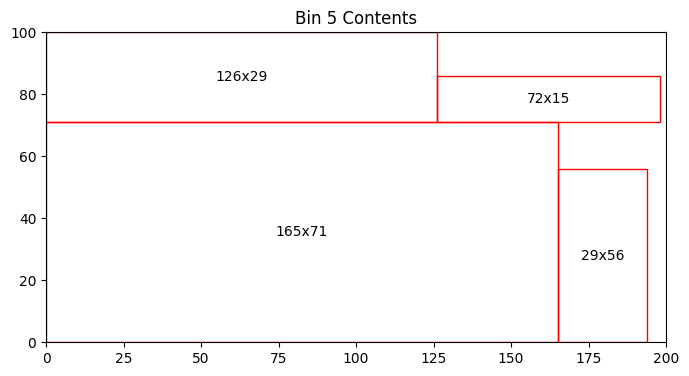

Bin 5 has 1927.00 units of area left


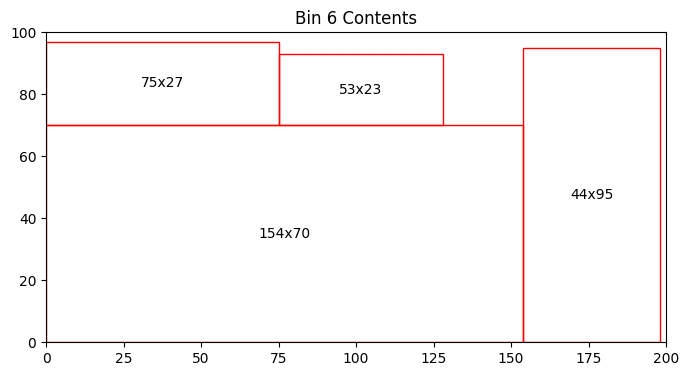

Bin 6 has 1796.00 units of area left


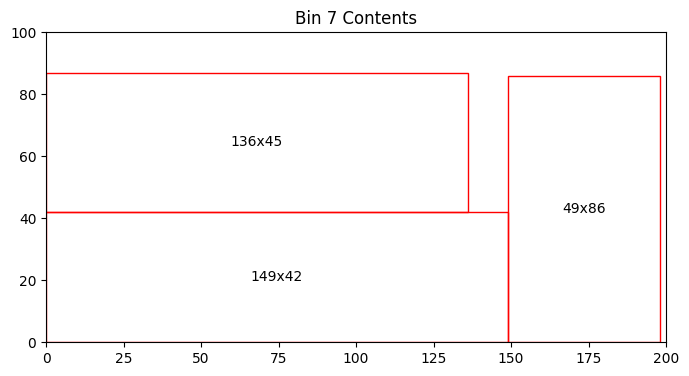

Bin 7 has 3408.00 units of area left


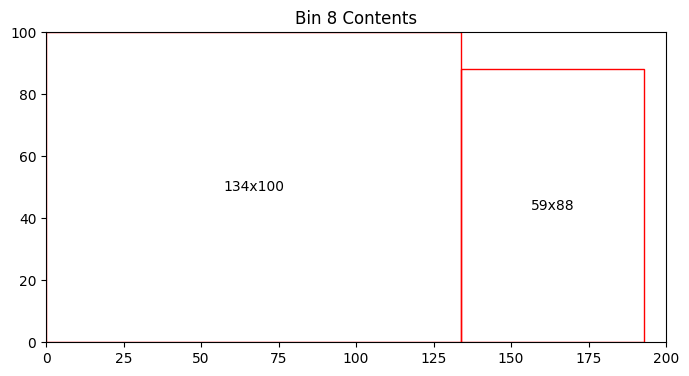

Bin 8 has 1408.00 units of area left


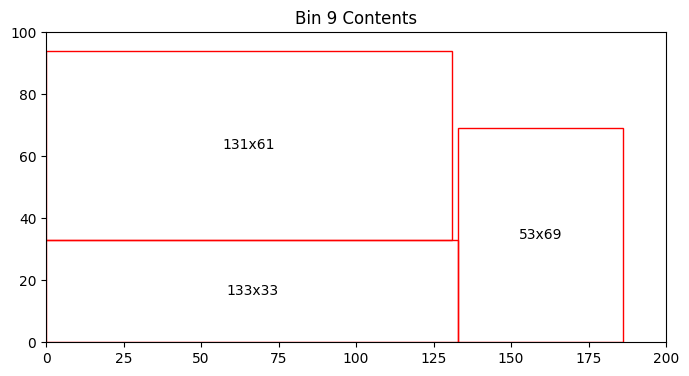

Bin 9 has 3963.00 units of area left


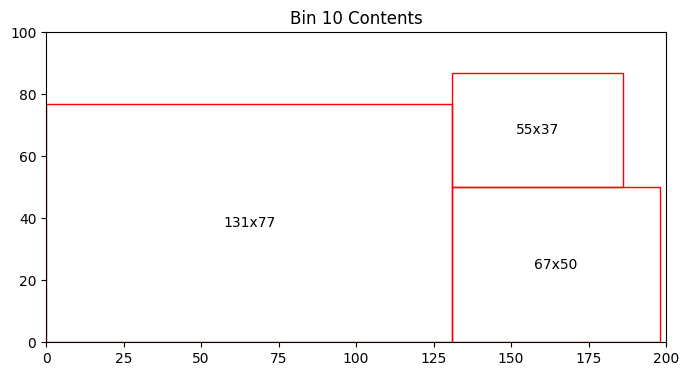

Bin 10 has 4528.00 units of area left


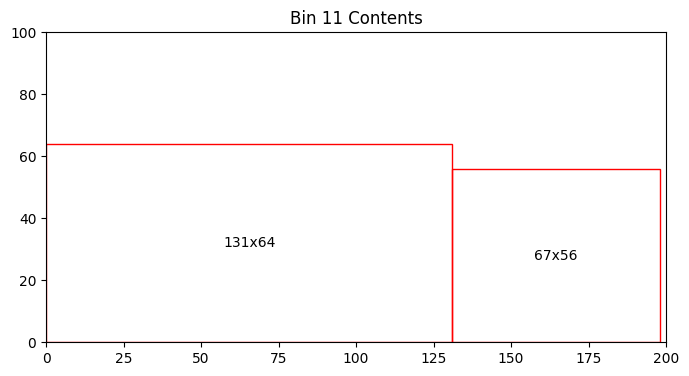

Bin 11 has 7864.00 units of area left


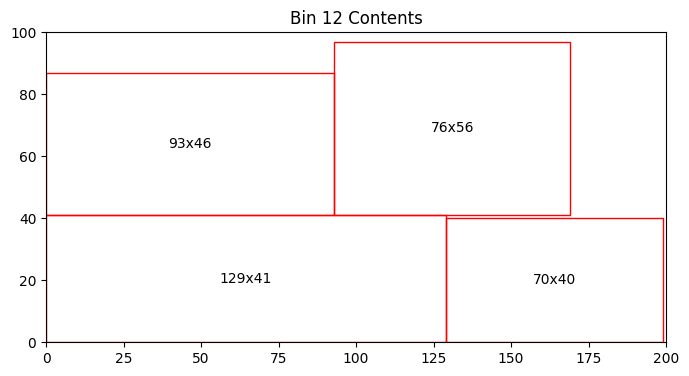

Bin 12 has 3377.00 units of area left


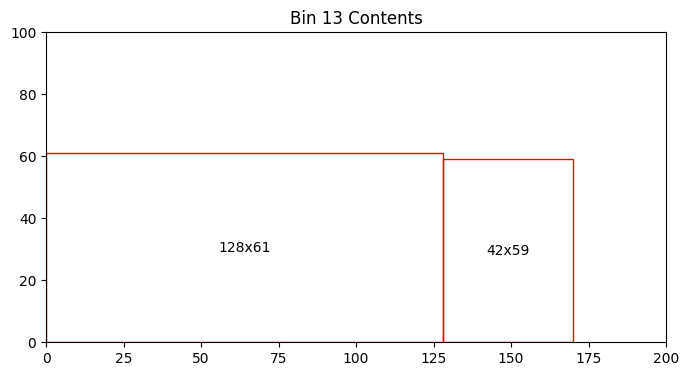

Bin 13 has 9714.00 units of area left


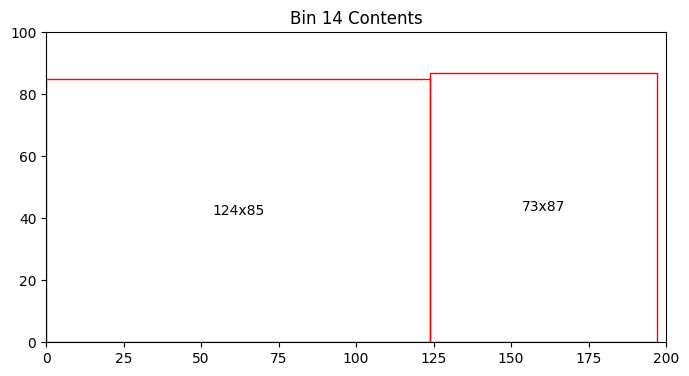

Bin 14 has 3109.00 units of area left


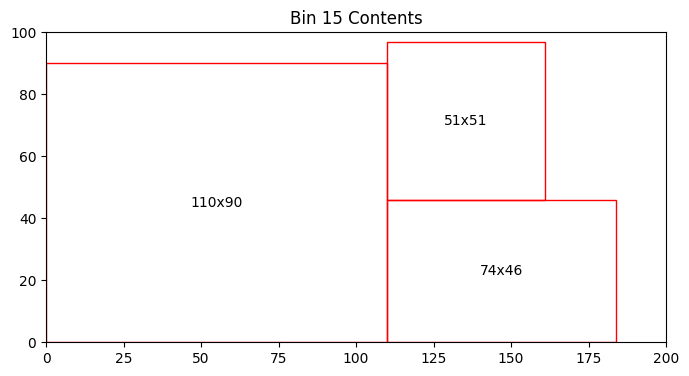

Bin 15 has 4095.00 units of area left


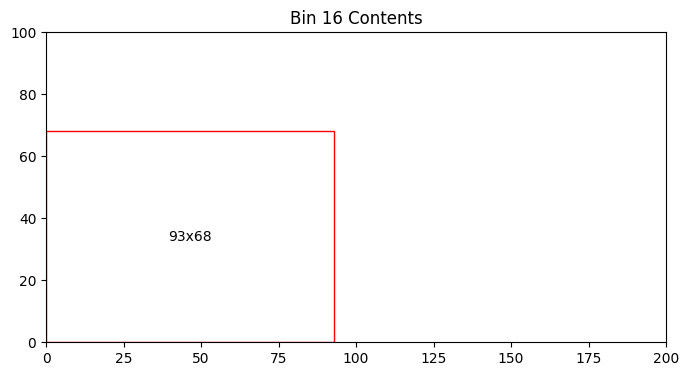

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


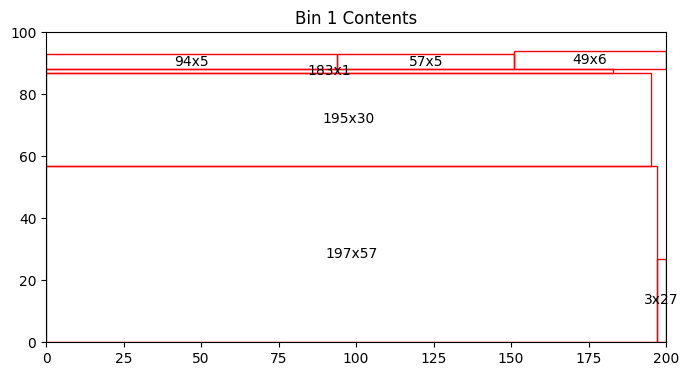

Bin 1 has 1608.00 units of area left


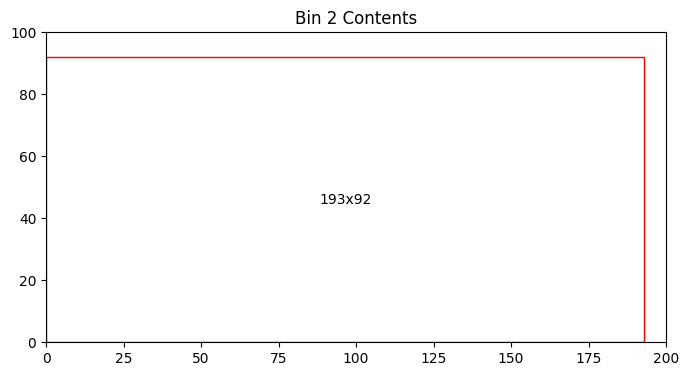

Bin 2 has 2244.00 units of area left


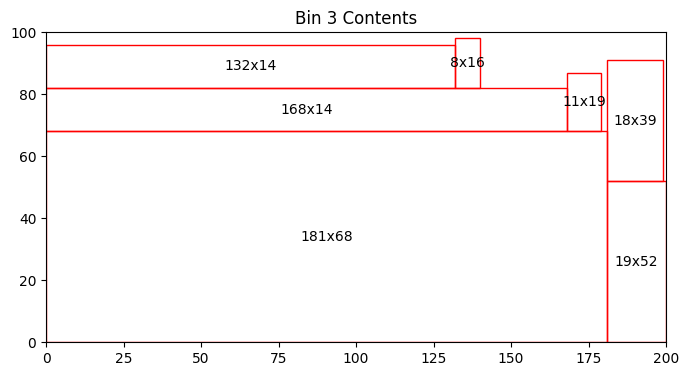

Bin 3 has 1465.00 units of area left


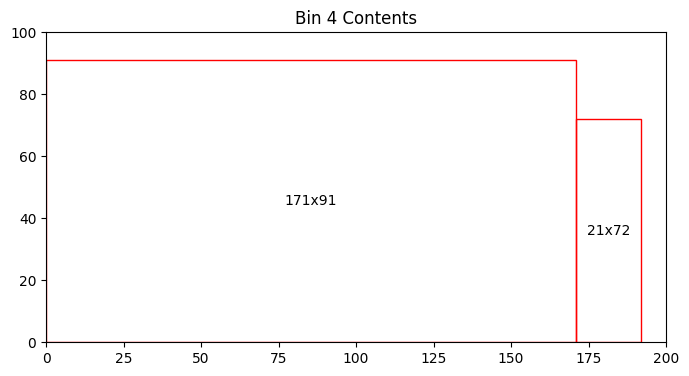

Bin 4 has 2927.00 units of area left


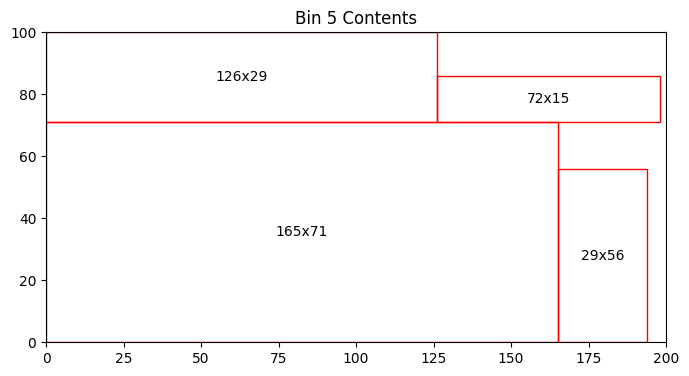

Bin 5 has 1927.00 units of area left


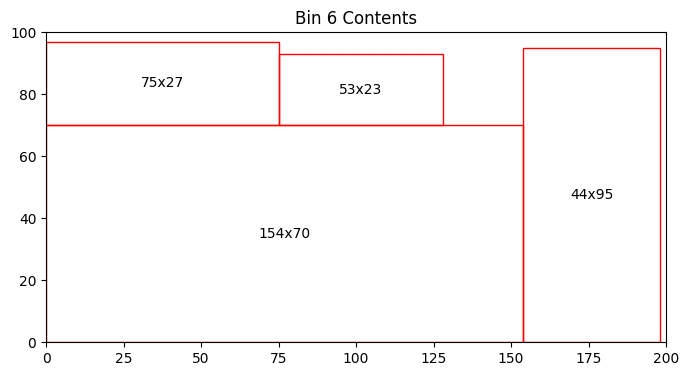

Bin 6 has 1796.00 units of area left


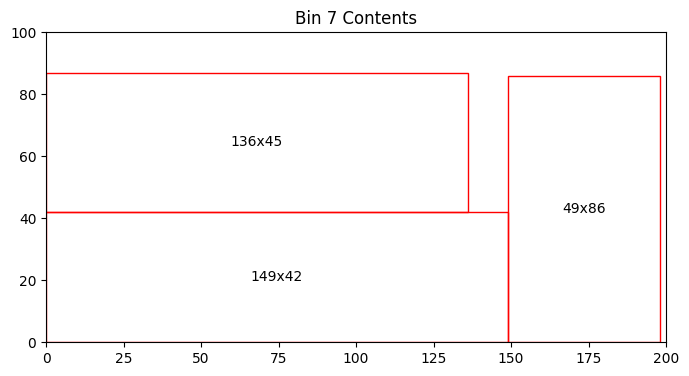

Bin 7 has 3408.00 units of area left


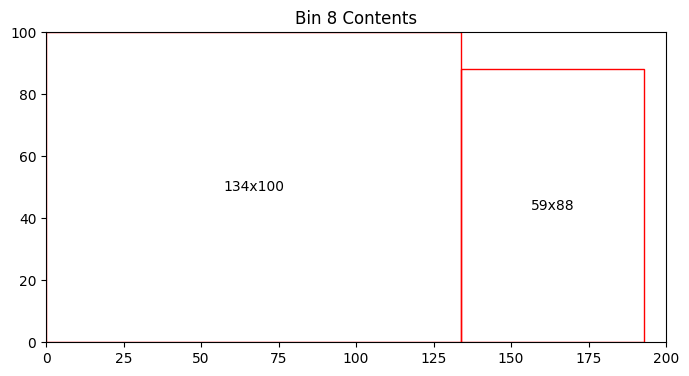

Bin 8 has 1408.00 units of area left


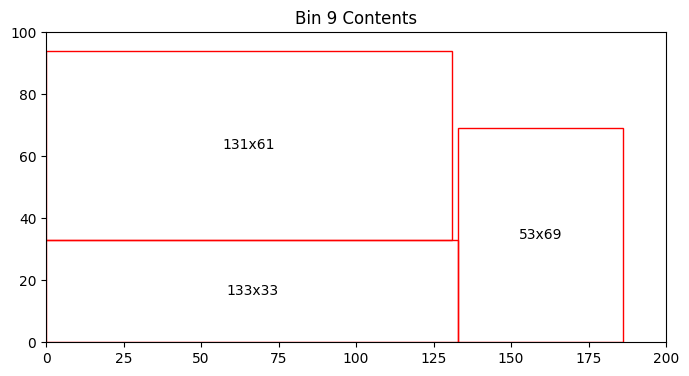

Bin 9 has 3963.00 units of area left


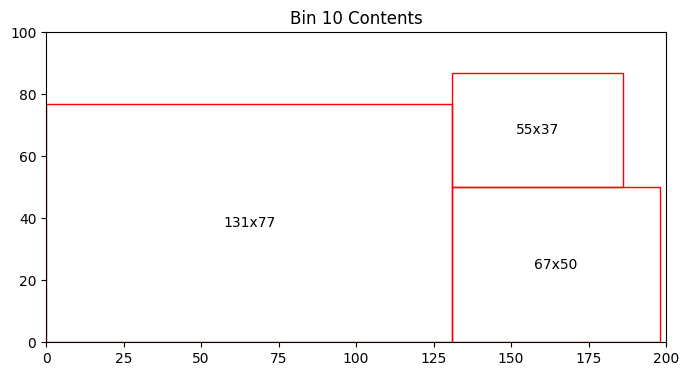

Bin 10 has 4528.00 units of area left


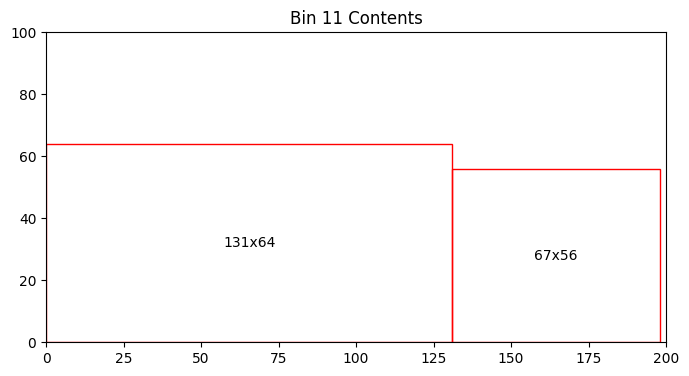

Bin 11 has 7864.00 units of area left


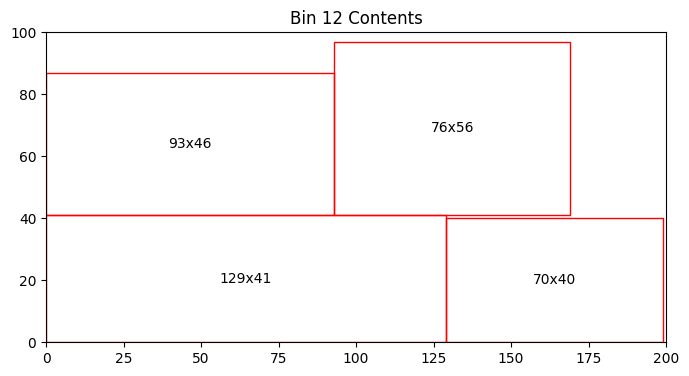

Bin 12 has 3377.00 units of area left


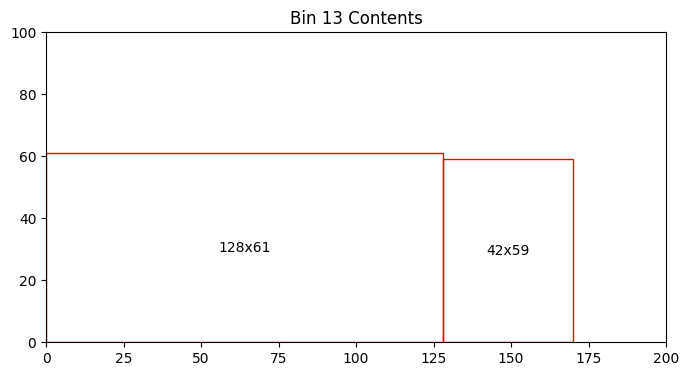

Bin 13 has 9714.00 units of area left


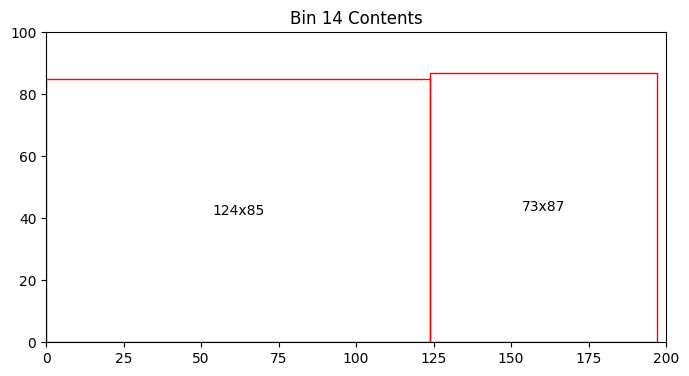

Bin 14 has 3109.00 units of area left


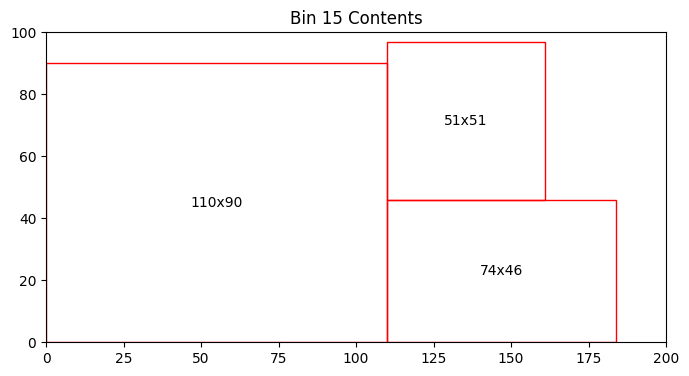

Bin 15 has 4095.00 units of area left


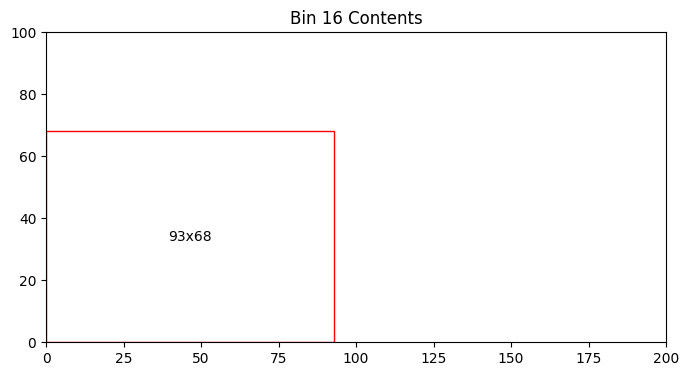

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


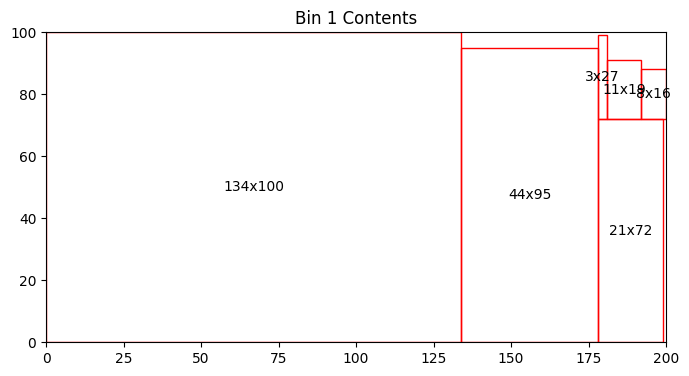

Bin 1 has 490.00 units of area left


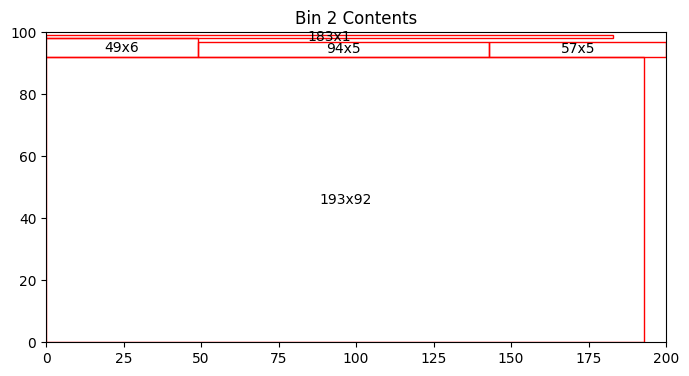

Bin 2 has 1012.00 units of area left


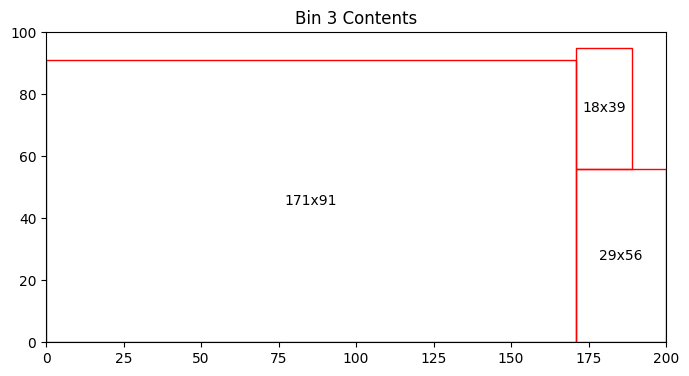

Bin 3 has 2113.00 units of area left


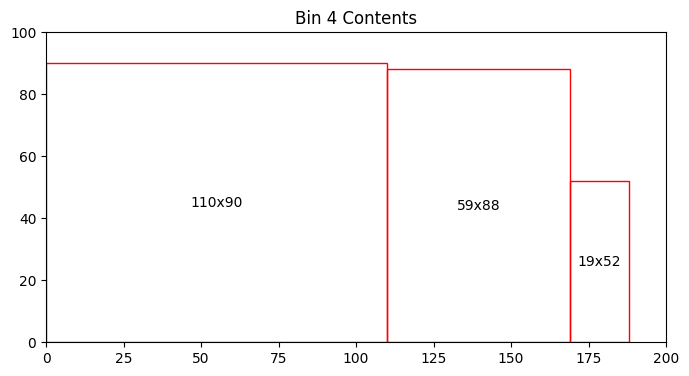

Bin 4 has 3920.00 units of area left


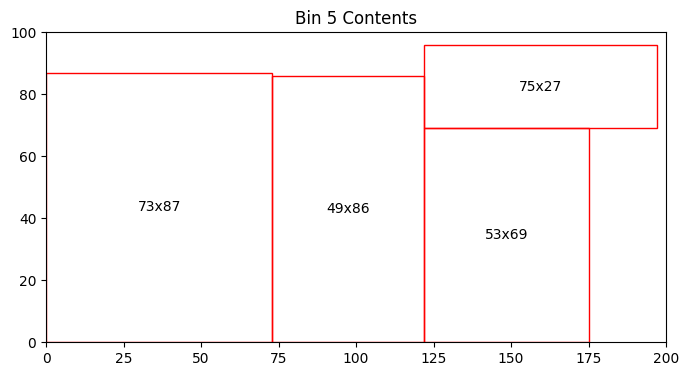

Bin 5 has 3753.00 units of area left


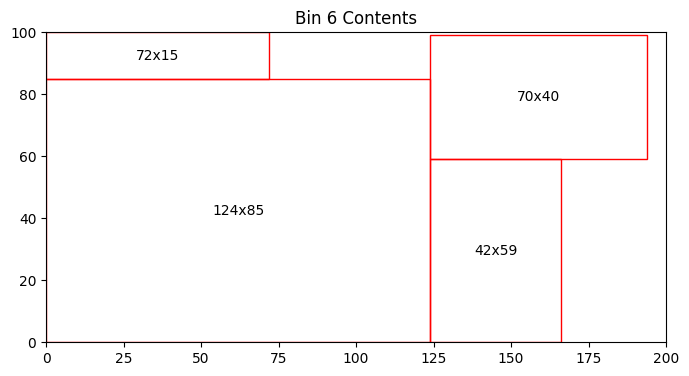

Bin 6 has 3102.00 units of area left


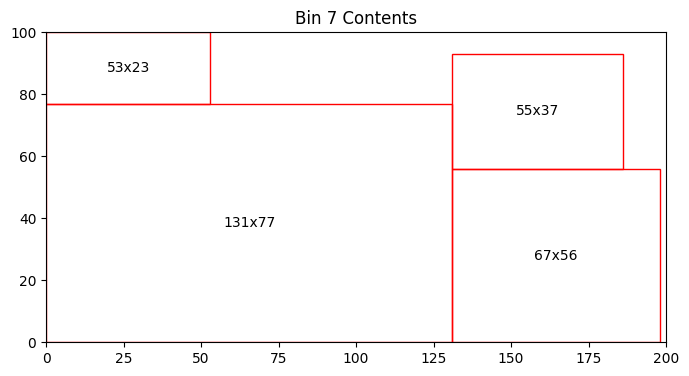

Bin 7 has 2907.00 units of area left


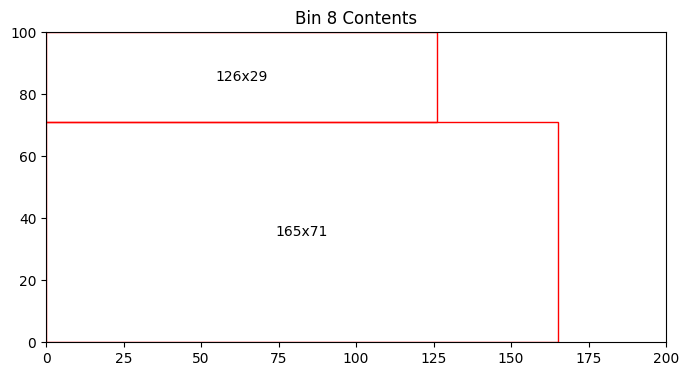

Bin 8 has 4631.00 units of area left


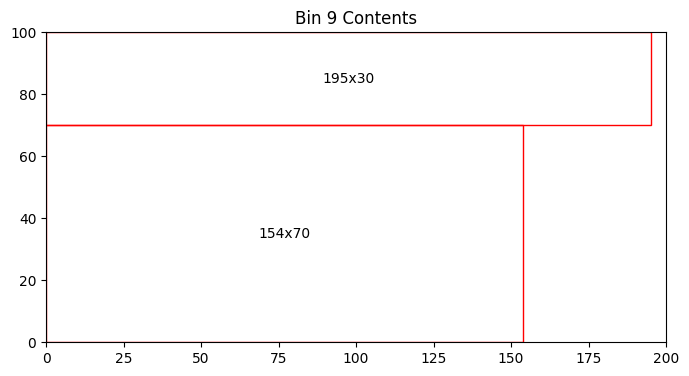

Bin 9 has 3370.00 units of area left


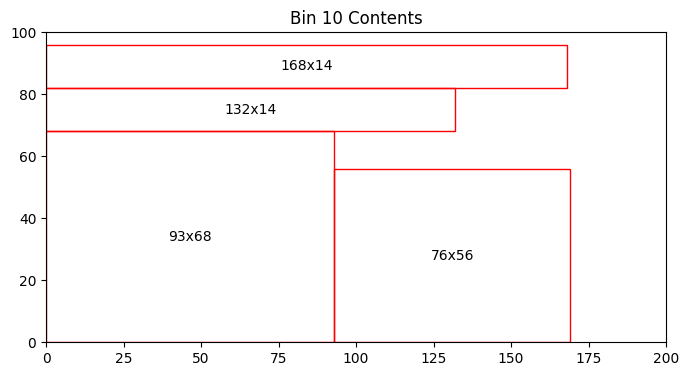

Bin 10 has 5220.00 units of area left


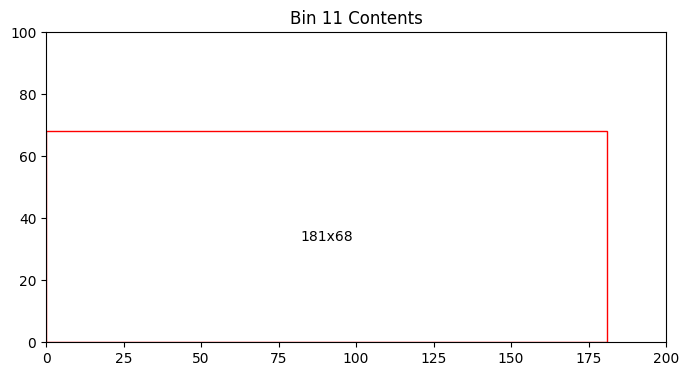

Bin 11 has 7692.00 units of area left


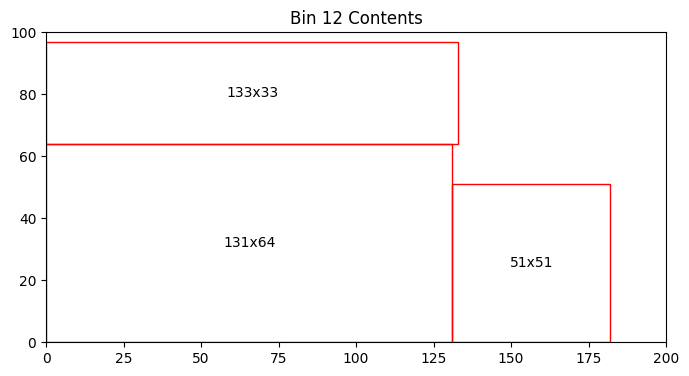

Bin 12 has 4626.00 units of area left


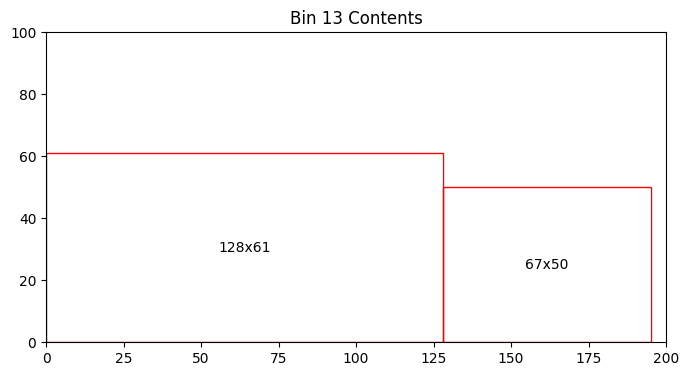

Bin 13 has 8842.00 units of area left


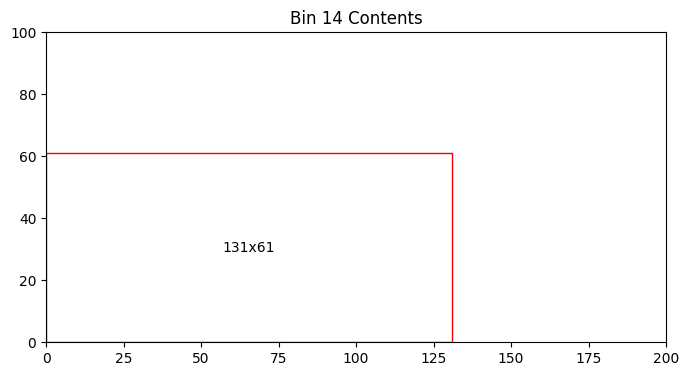

Bin 14 has 12009.00 units of area left


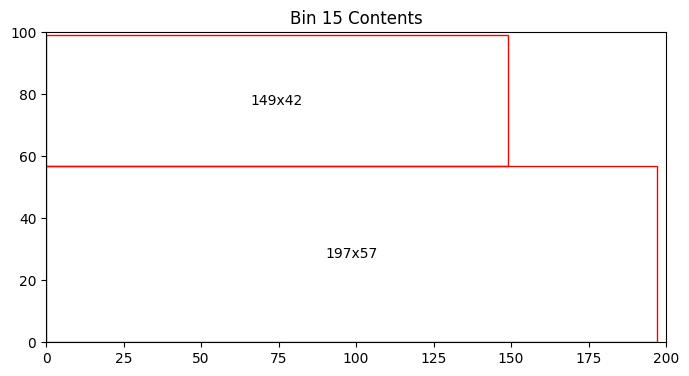

Bin 15 has 2513.00 units of area left


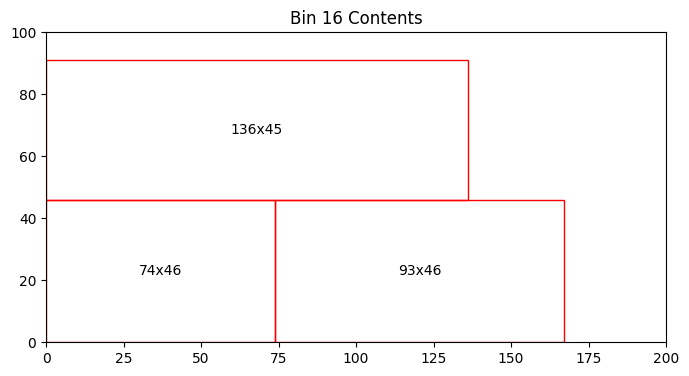

Bin 16 has 6198.00 units of area left


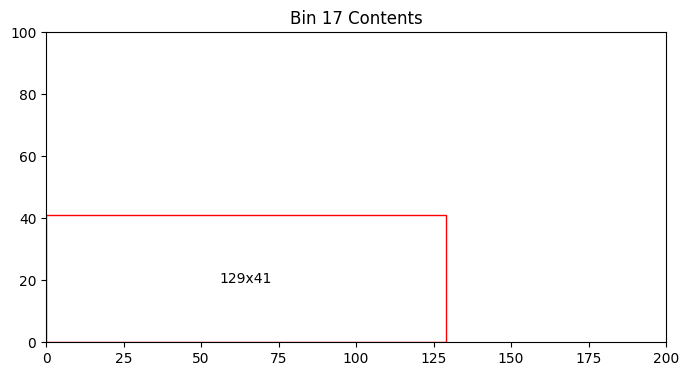

Bin 17 has 14711.00 units of area left
Total number of bins = 17
Total area left in bins = 87109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


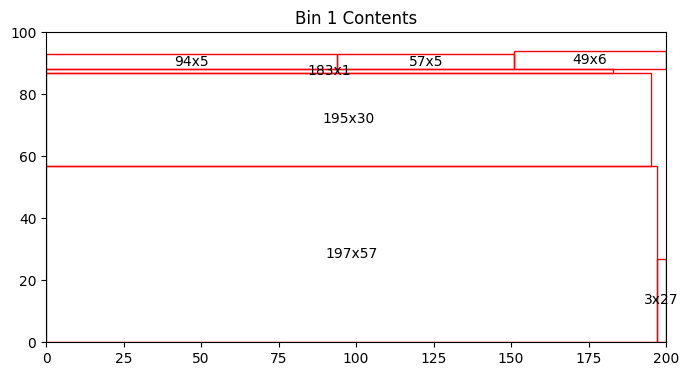

Bin 1 has 1608.00 units of area left


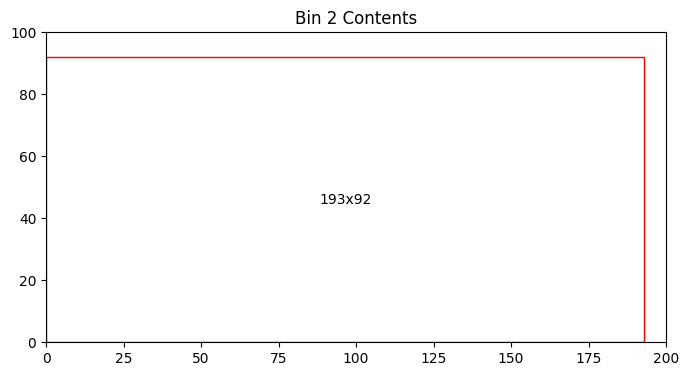

Bin 2 has 2244.00 units of area left


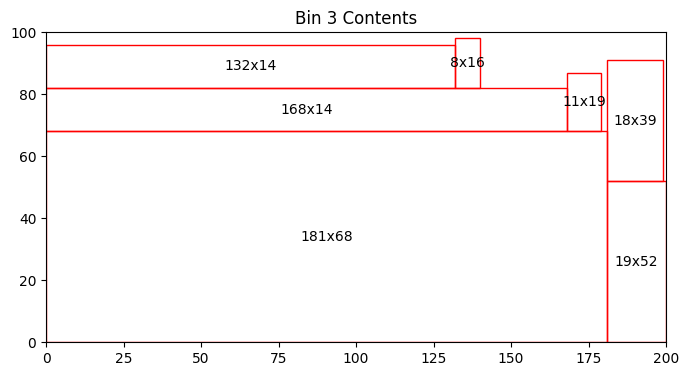

Bin 3 has 1465.00 units of area left


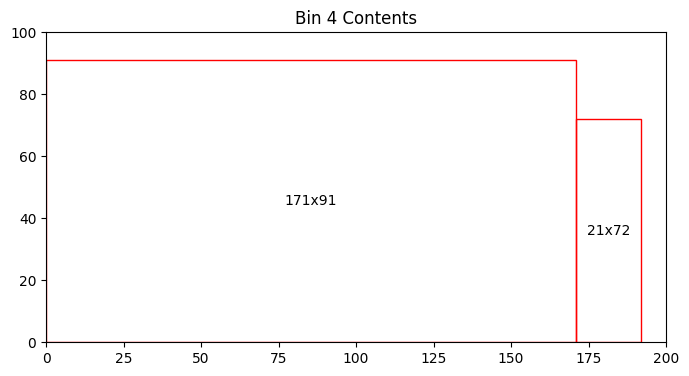

Bin 4 has 2927.00 units of area left


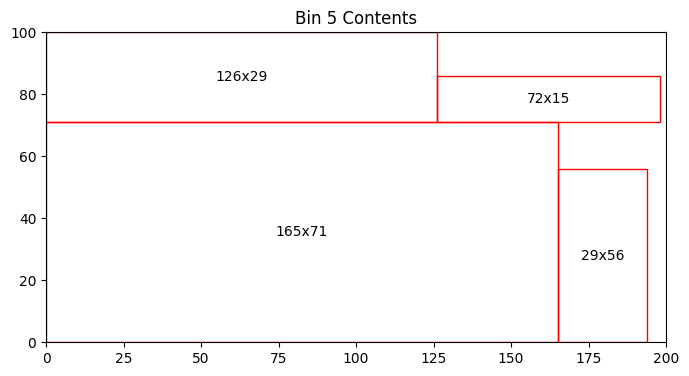

Bin 5 has 1927.00 units of area left


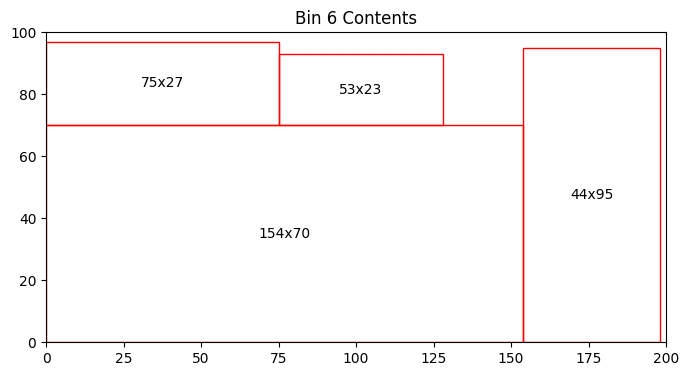

Bin 6 has 1796.00 units of area left


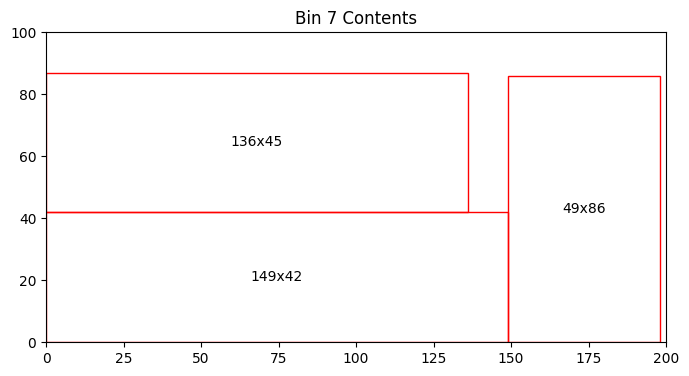

Bin 7 has 3408.00 units of area left


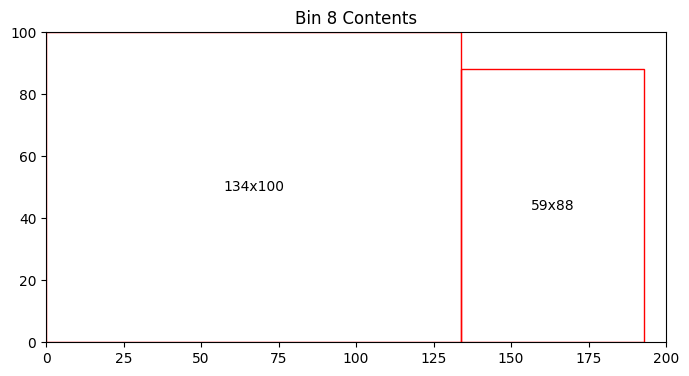

Bin 8 has 1408.00 units of area left


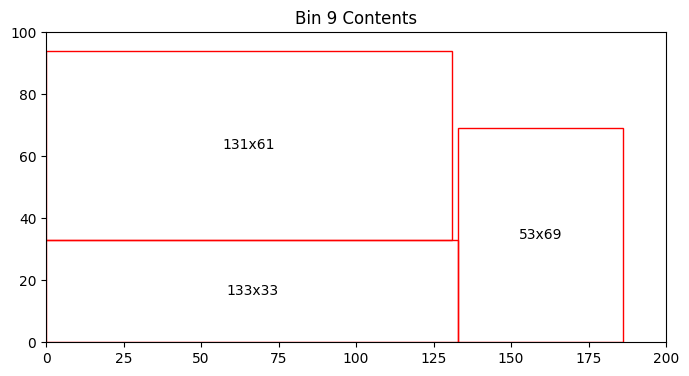

Bin 9 has 3963.00 units of area left


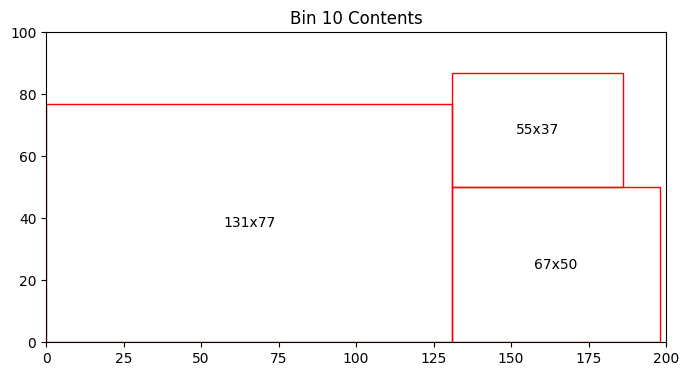

Bin 10 has 4528.00 units of area left


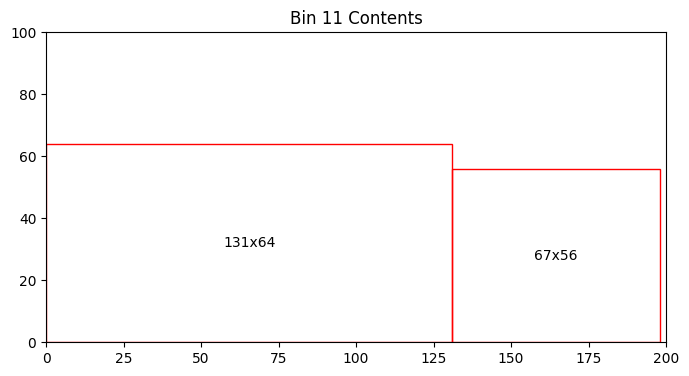

Bin 11 has 7864.00 units of area left


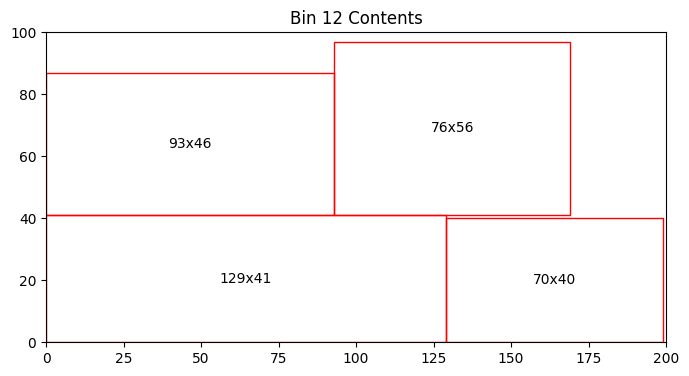

Bin 12 has 3377.00 units of area left


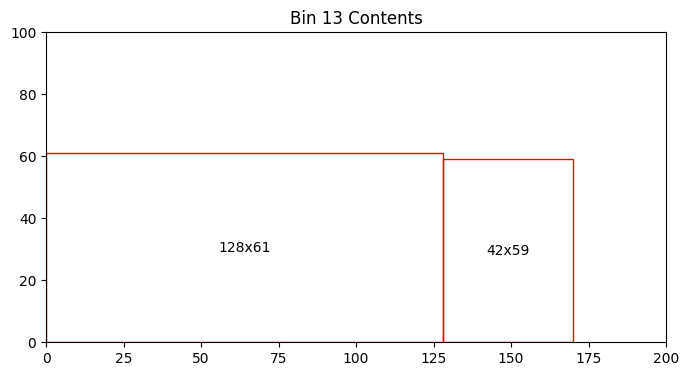

Bin 13 has 9714.00 units of area left


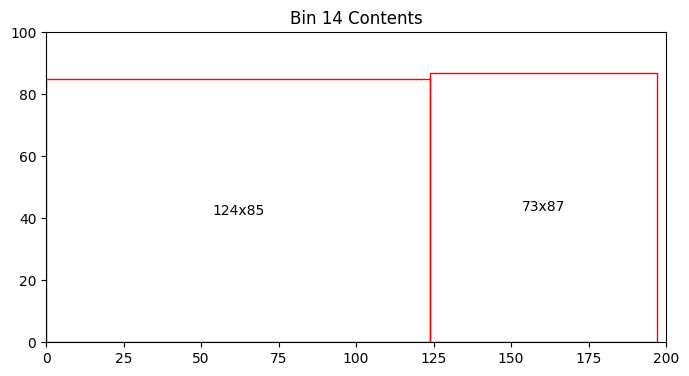

Bin 14 has 3109.00 units of area left


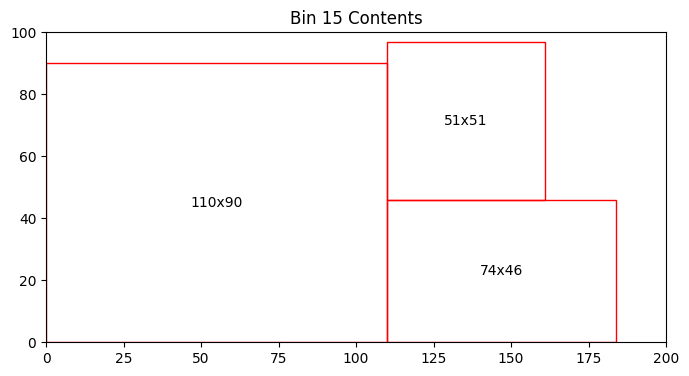

Bin 15 has 4095.00 units of area left


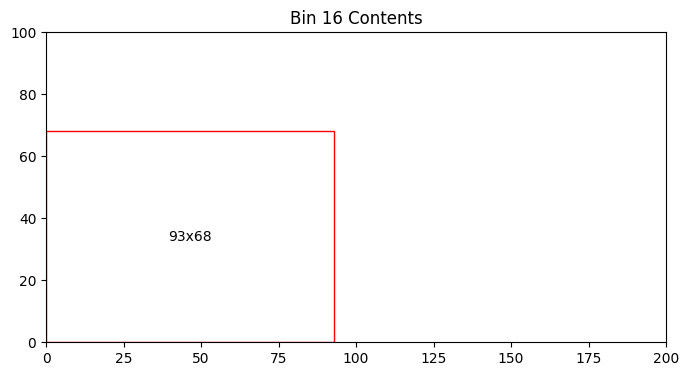

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


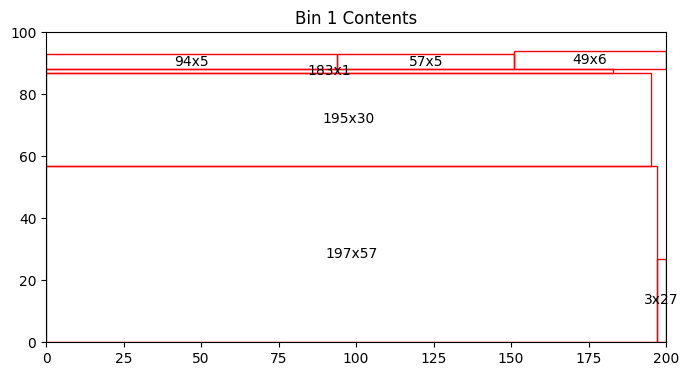

Bin 1 has 1608.00 units of area left


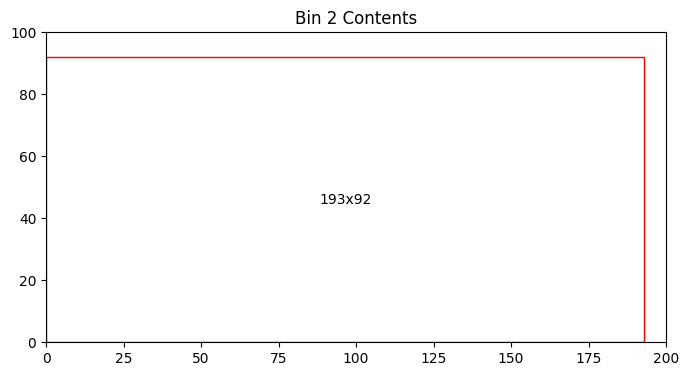

Bin 2 has 2244.00 units of area left


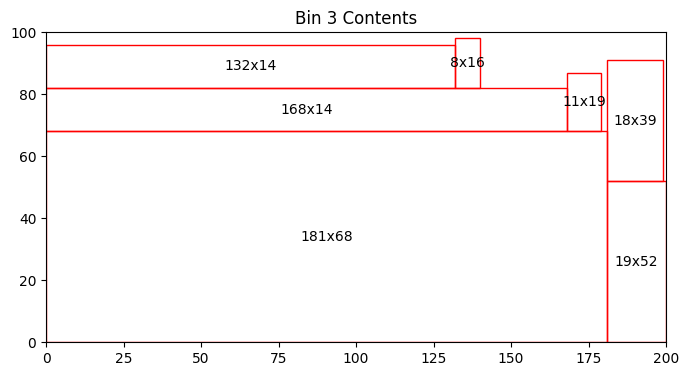

Bin 3 has 1465.00 units of area left


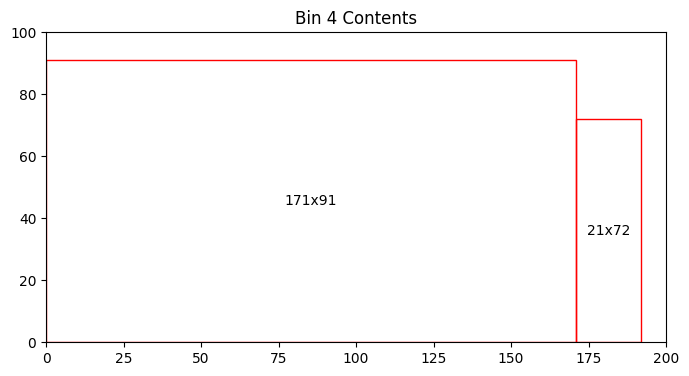

Bin 4 has 2927.00 units of area left


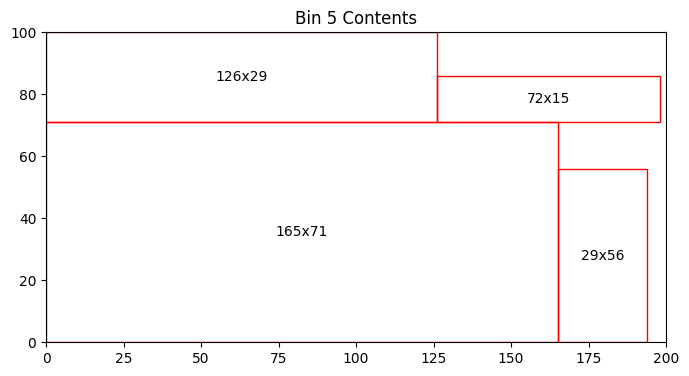

Bin 5 has 1927.00 units of area left


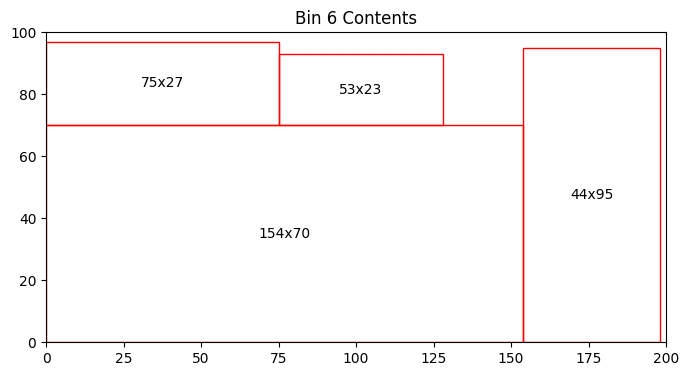

Bin 6 has 1796.00 units of area left


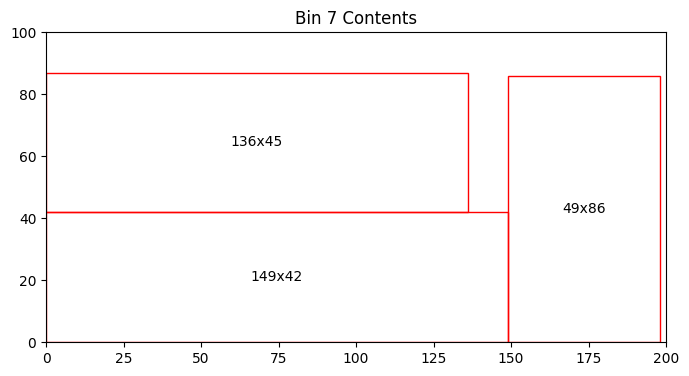

Bin 7 has 3408.00 units of area left


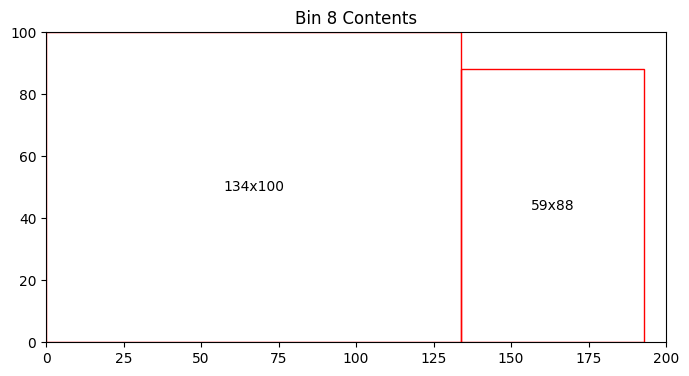

Bin 8 has 1408.00 units of area left


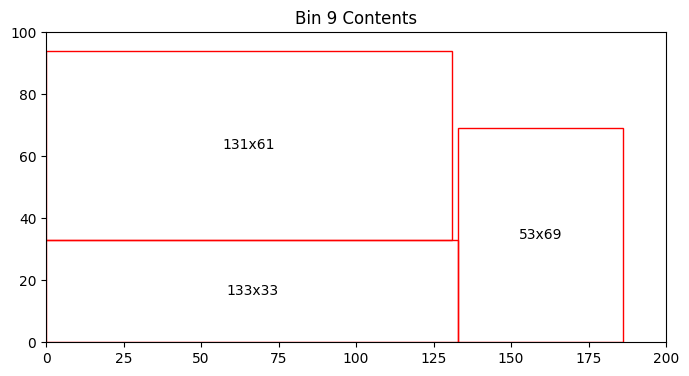

Bin 9 has 3963.00 units of area left


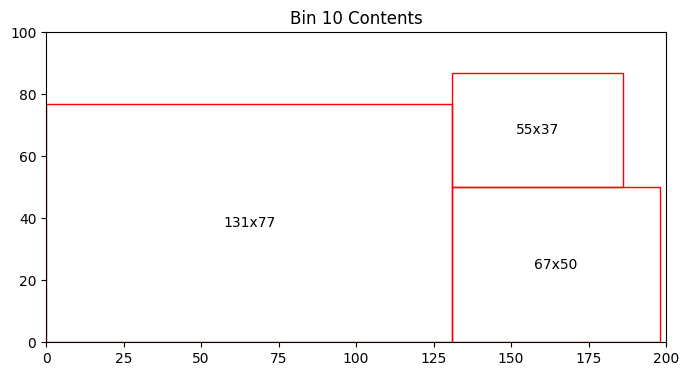

Bin 10 has 4528.00 units of area left


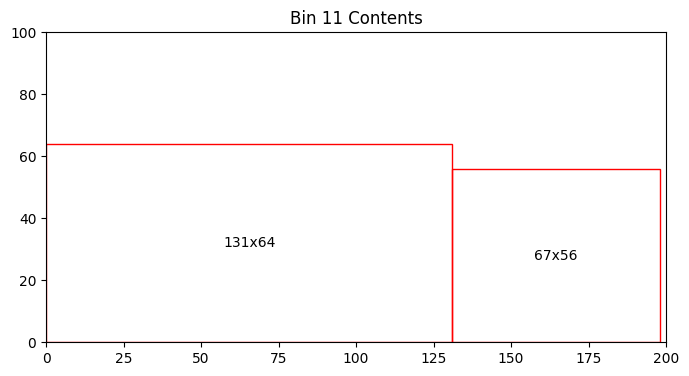

Bin 11 has 7864.00 units of area left


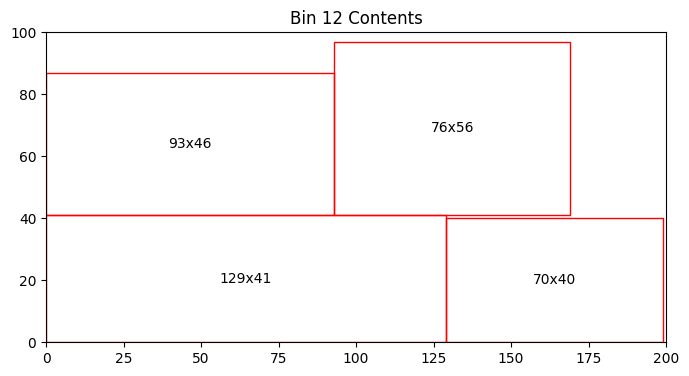

Bin 12 has 3377.00 units of area left


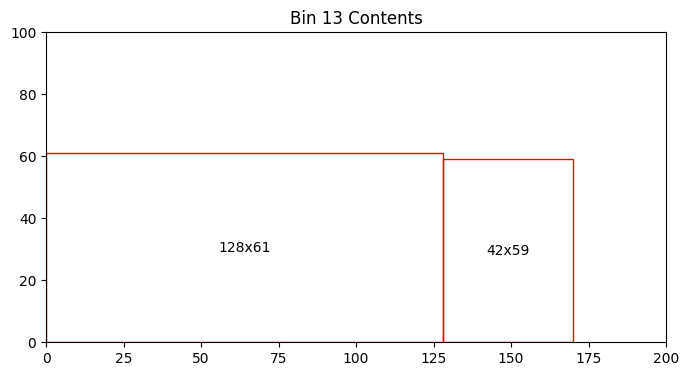

Bin 13 has 9714.00 units of area left


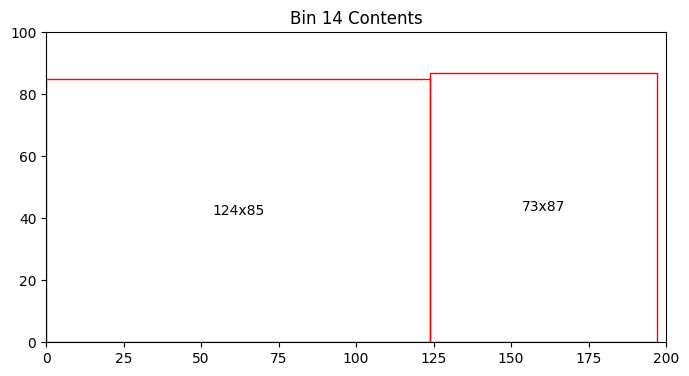

Bin 14 has 3109.00 units of area left


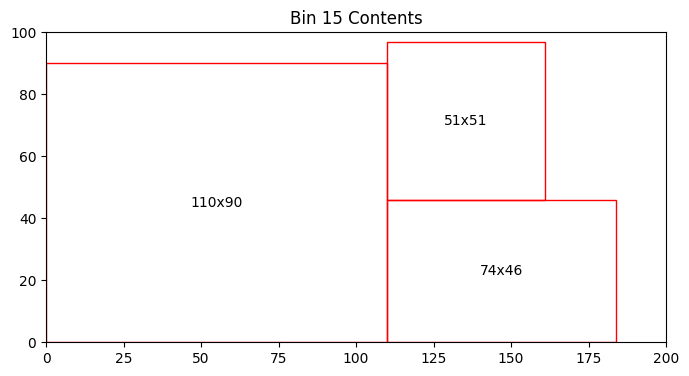

Bin 15 has 4095.00 units of area left


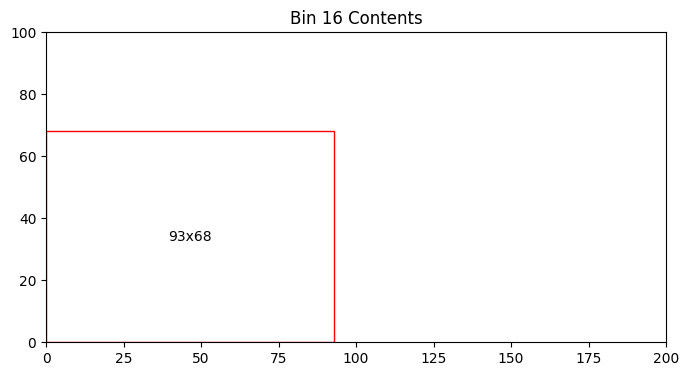

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


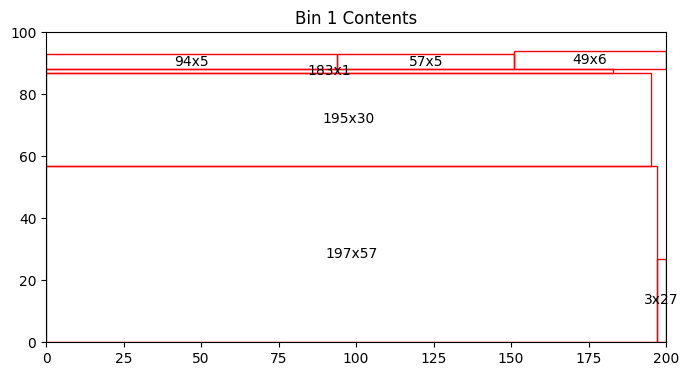

Bin 1 has 1608.00 units of area left


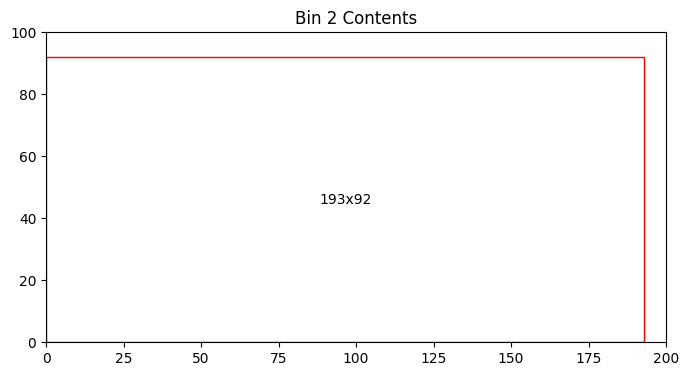

Bin 2 has 2244.00 units of area left


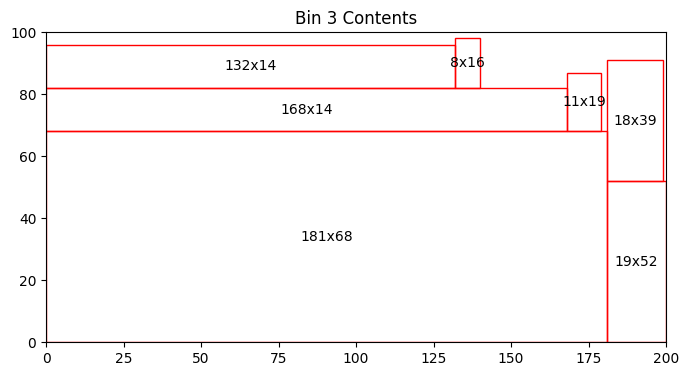

Bin 3 has 1465.00 units of area left


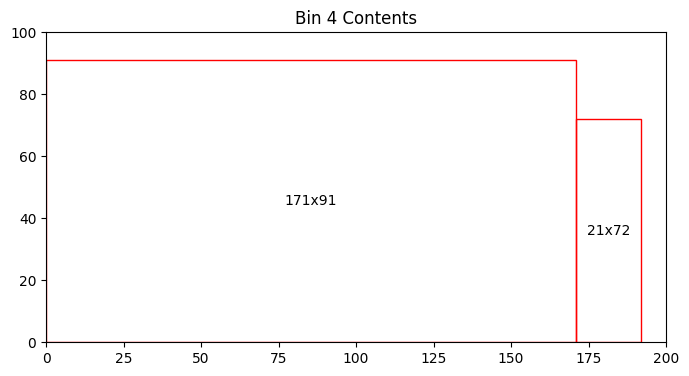

Bin 4 has 2927.00 units of area left


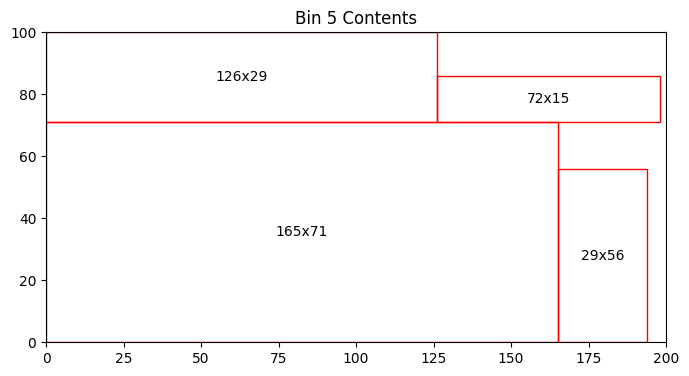

Bin 5 has 1927.00 units of area left


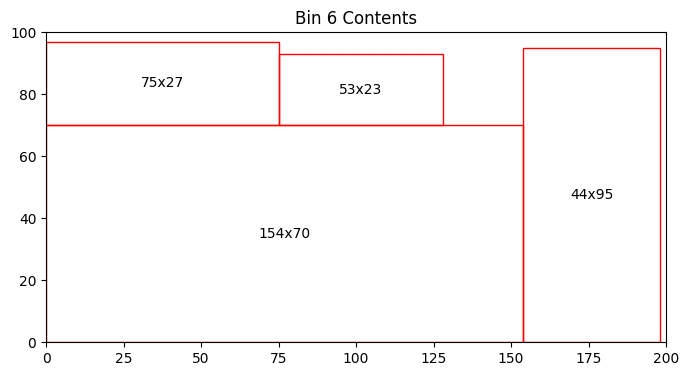

Bin 6 has 1796.00 units of area left


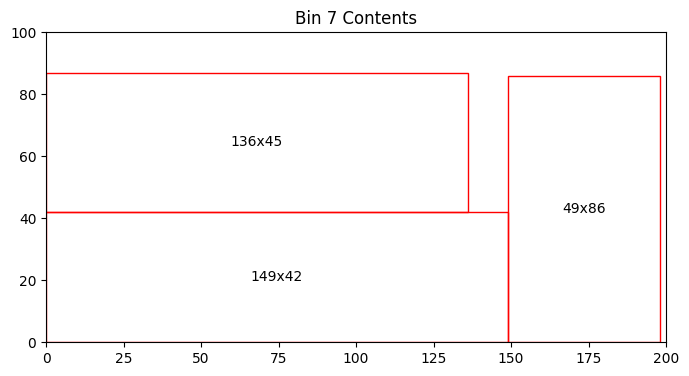

Bin 7 has 3408.00 units of area left


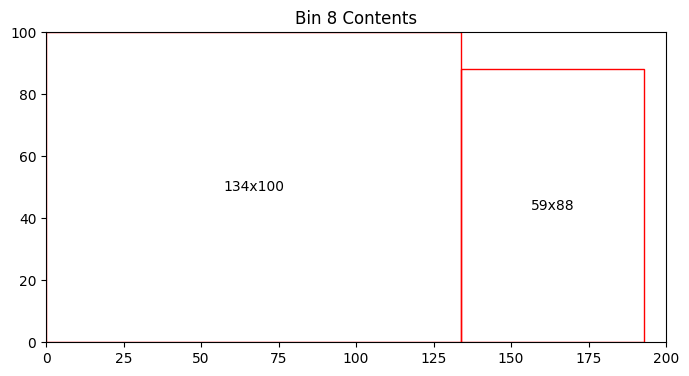

Bin 8 has 1408.00 units of area left


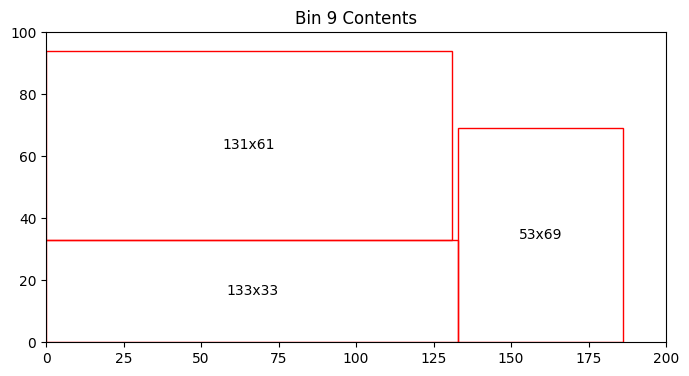

Bin 9 has 3963.00 units of area left


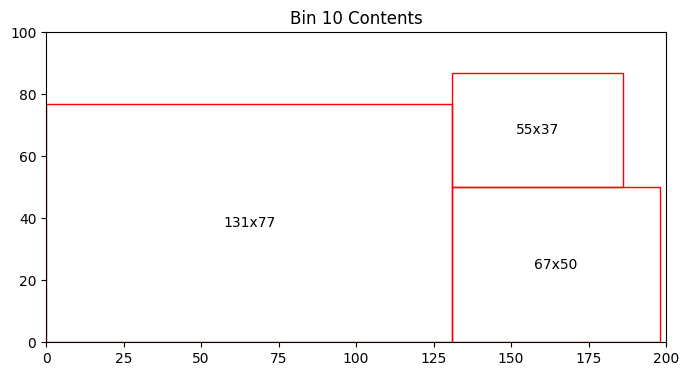

Bin 10 has 4528.00 units of area left


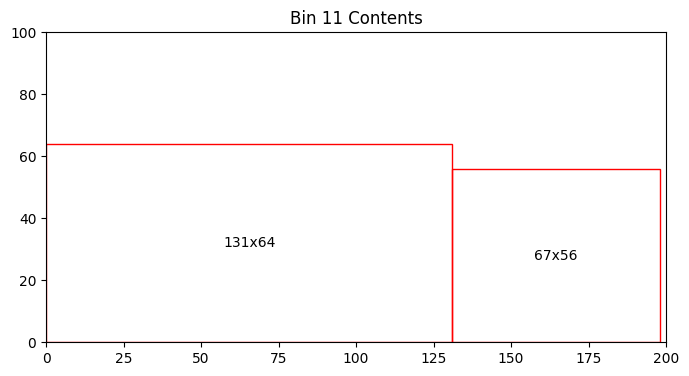

Bin 11 has 7864.00 units of area left


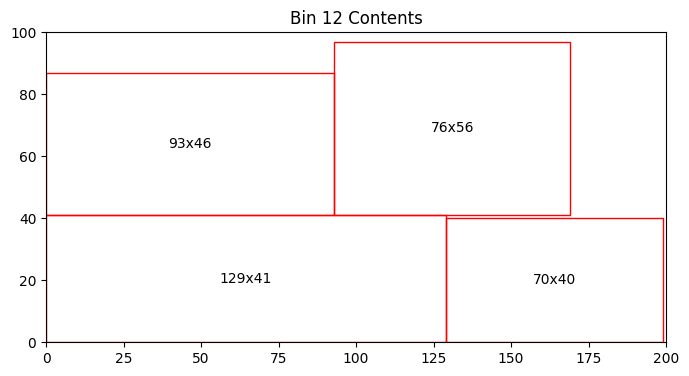

Bin 12 has 3377.00 units of area left


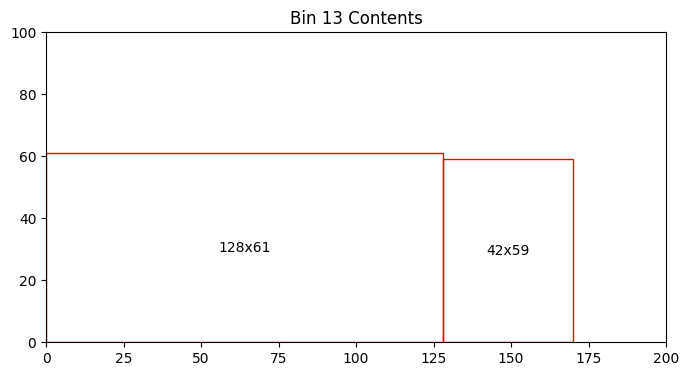

Bin 13 has 9714.00 units of area left


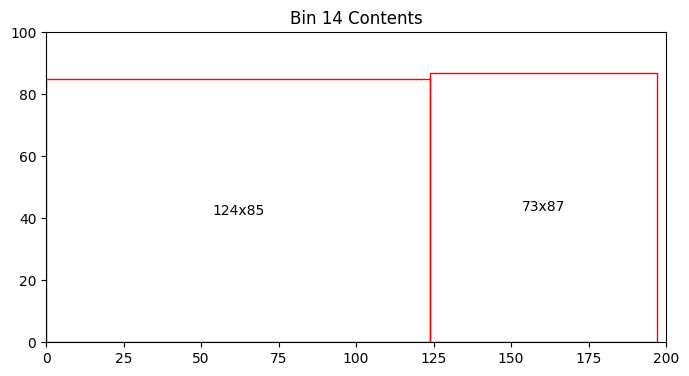

Bin 14 has 3109.00 units of area left


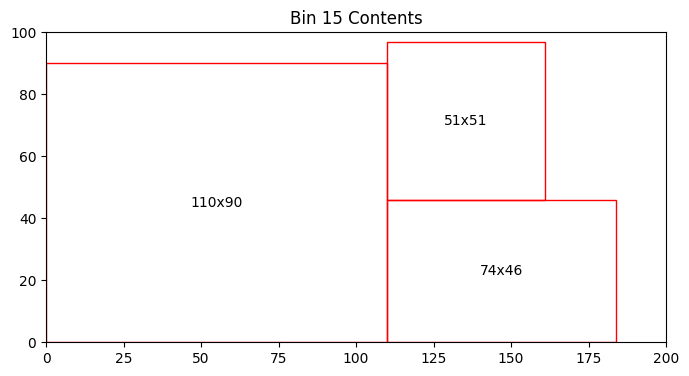

Bin 15 has 4095.00 units of area left


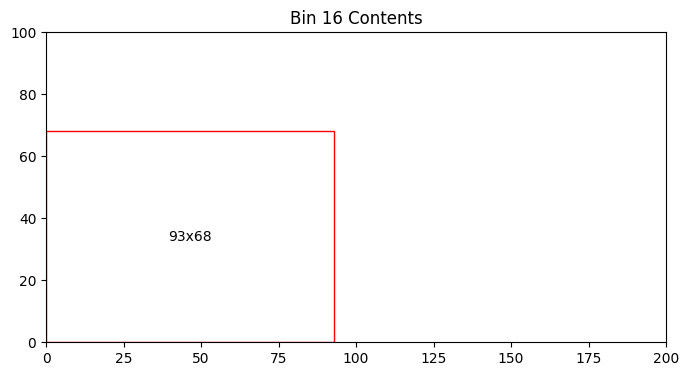

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


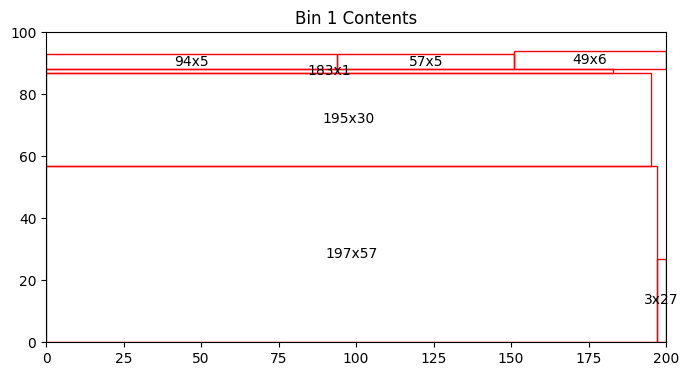

Bin 1 has 1608.00 units of area left


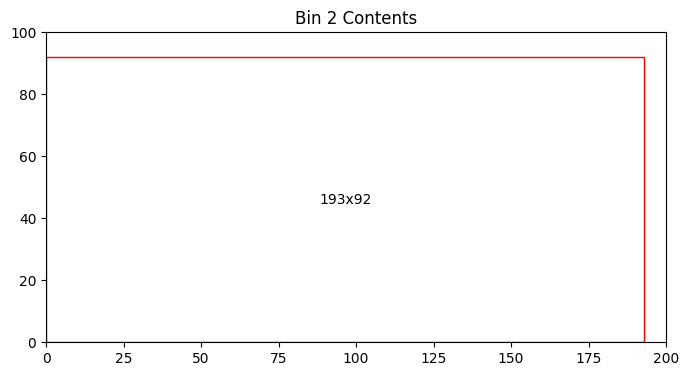

Bin 2 has 2244.00 units of area left


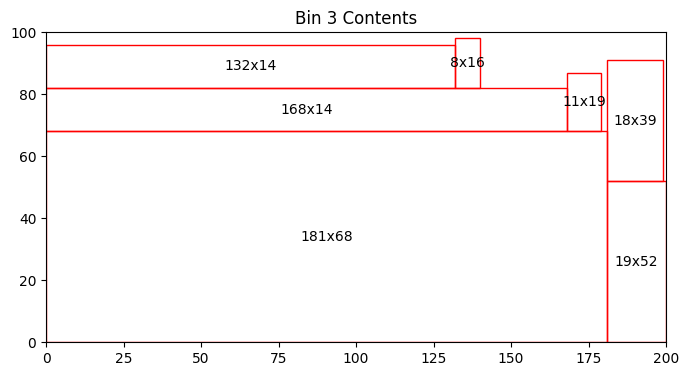

Bin 3 has 1465.00 units of area left


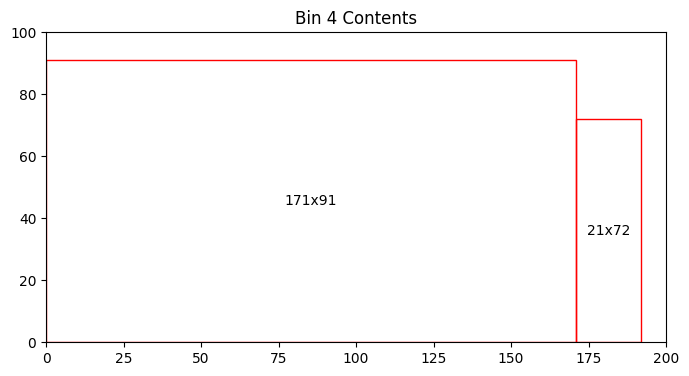

Bin 4 has 2927.00 units of area left


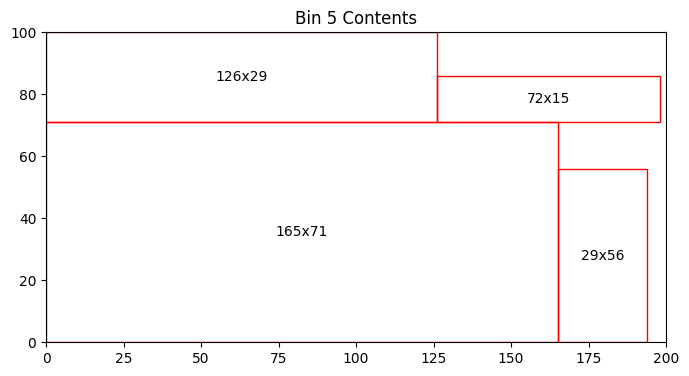

Bin 5 has 1927.00 units of area left


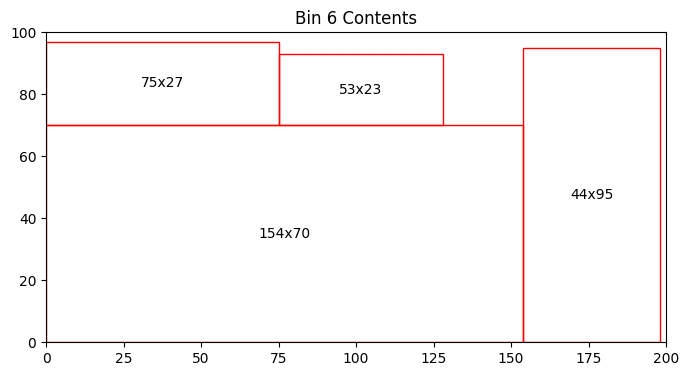

Bin 6 has 1796.00 units of area left


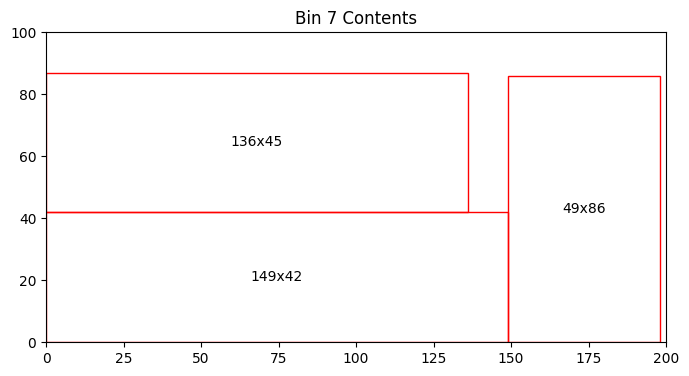

Bin 7 has 3408.00 units of area left


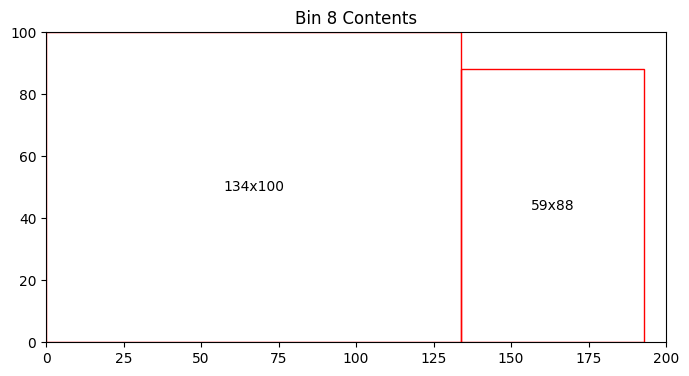

Bin 8 has 1408.00 units of area left


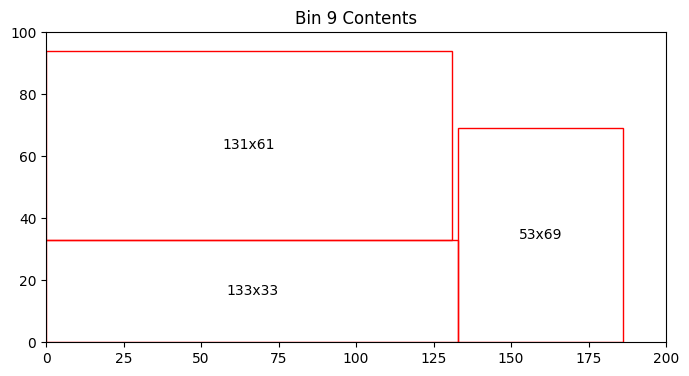

Bin 9 has 3963.00 units of area left


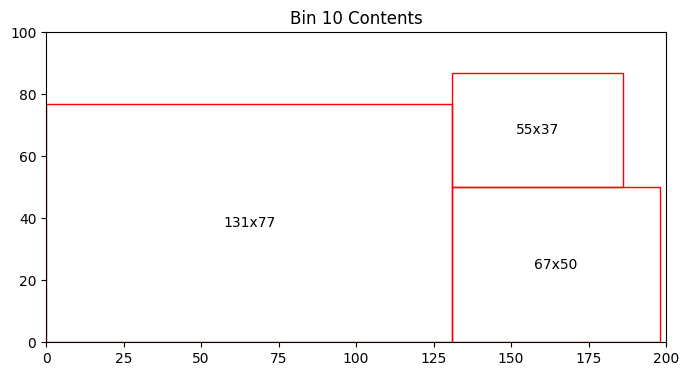

Bin 10 has 4528.00 units of area left


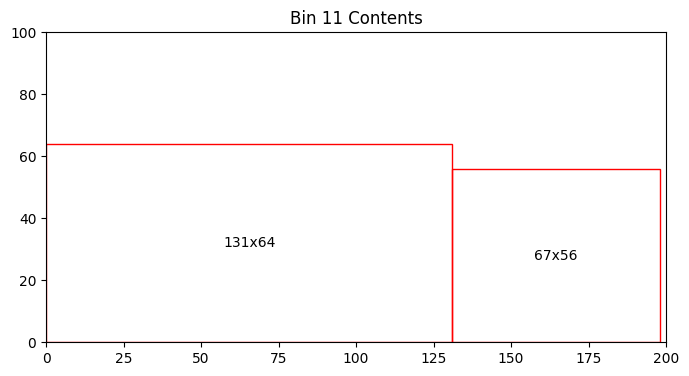

Bin 11 has 7864.00 units of area left


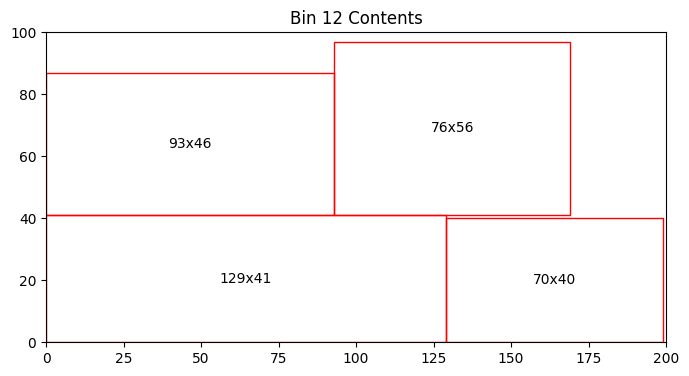

Bin 12 has 3377.00 units of area left


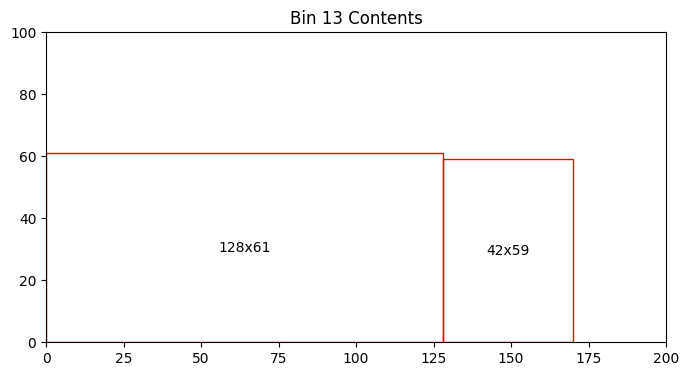

Bin 13 has 9714.00 units of area left


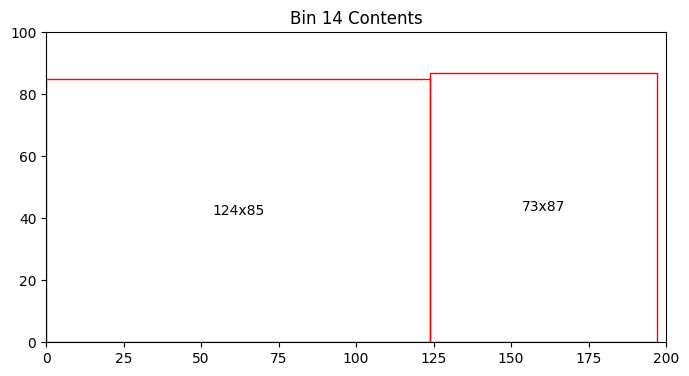

Bin 14 has 3109.00 units of area left


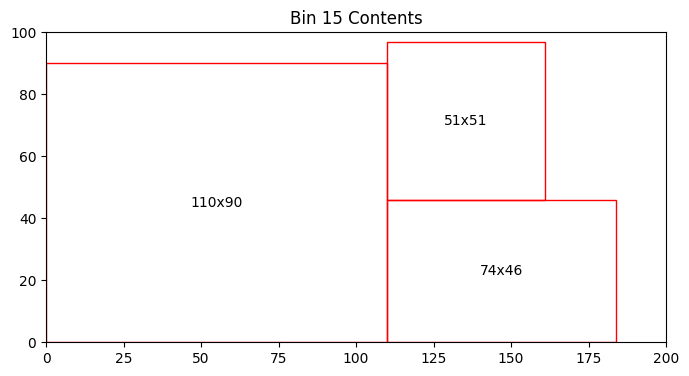

Bin 15 has 4095.00 units of area left


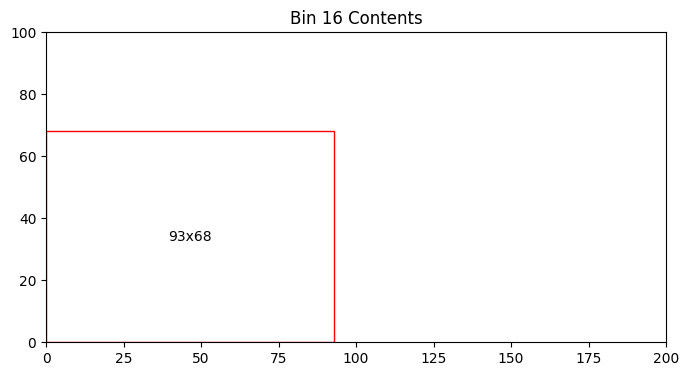

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
[[ 57   5]
 [ 53  69]
 [ 21  72]
 [ 18  39]
 [154  70]
 [193  92]
 [129  41]
 [ 93  46]
 [ 44  95]
 [ 94   5]
 [ 49  86]
 [197  57]
 [ 67  50]
 [  8  16]
 [ 19  52]
 [ 55  37]
 [ 49   6]
 [128  61]
 [131  77]
 [149  42]
 [ 76  56]
 [136  45]
 [132  14]
 [ 67  56]
 [134 100]
 [165  71]
 [ 70  40]
 [  3  27]
 [ 53  23]
 [131  61]
 [ 29  56]
 [ 11  19]
 [ 75  27]
 [ 74  46]
 [168  14]
 [195  30]
 [133  33]
 [ 93  68]
 [181  68]
 [124  85]
 [131  64]
 [ 72  15]
 [ 73  87]
 [183   1]
 [171  91]
 [ 42  59]
 [126  29]
 [ 59  88]
 [ 51  51]
 [110  90]]


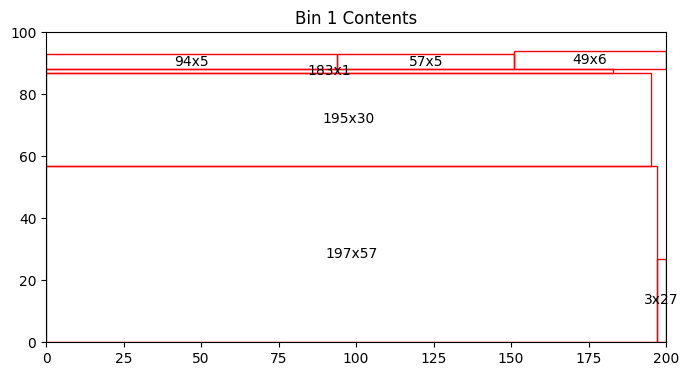

Bin 1 has 1608.00 units of area left


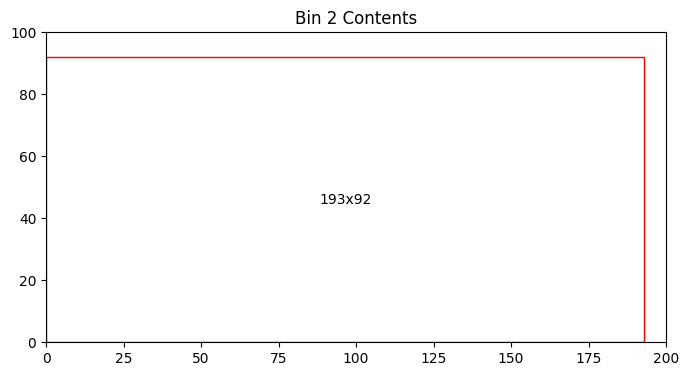

Bin 2 has 2244.00 units of area left


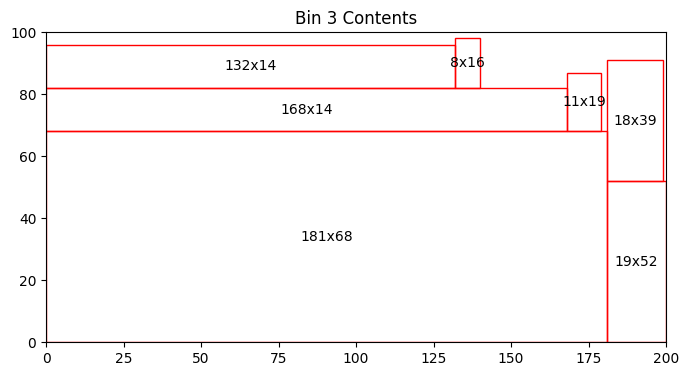

Bin 3 has 1465.00 units of area left


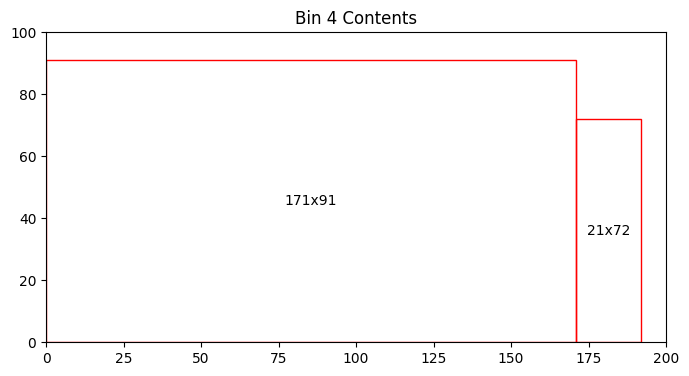

Bin 4 has 2927.00 units of area left


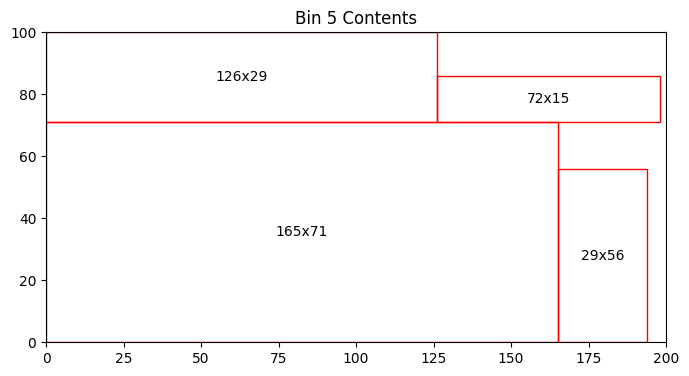

Bin 5 has 1927.00 units of area left


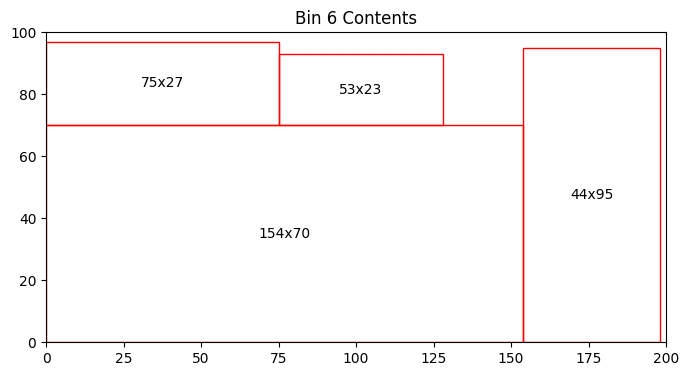

Bin 6 has 1796.00 units of area left


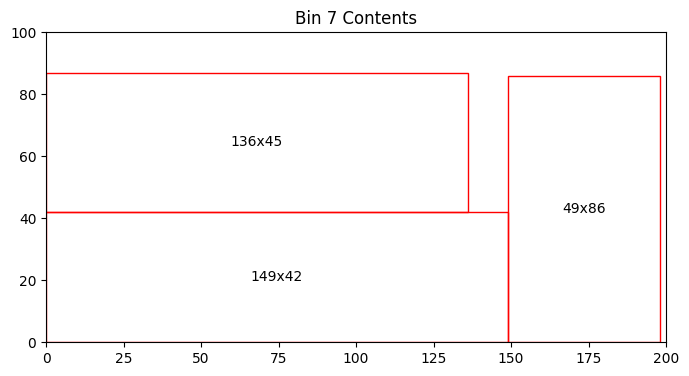

Bin 7 has 3408.00 units of area left


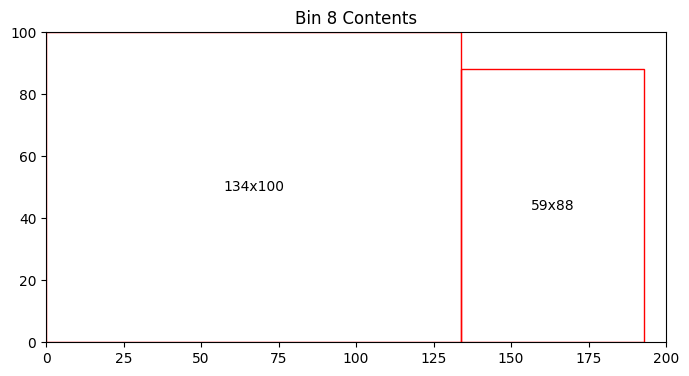

Bin 8 has 1408.00 units of area left


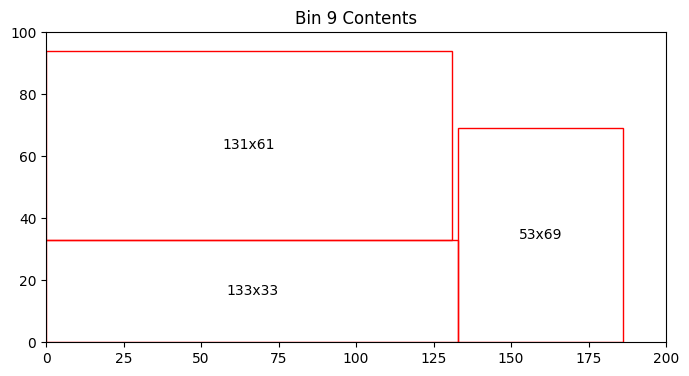

Bin 9 has 3963.00 units of area left


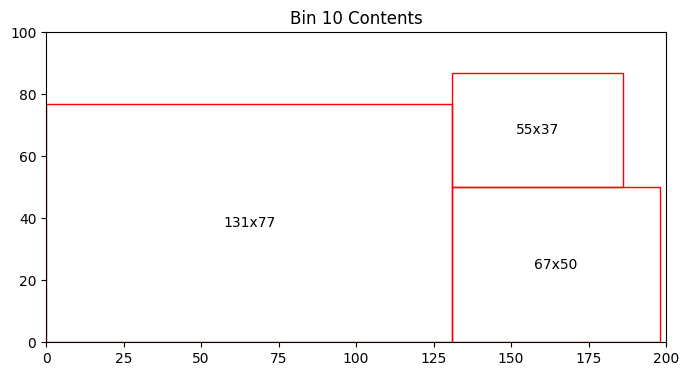

Bin 10 has 4528.00 units of area left


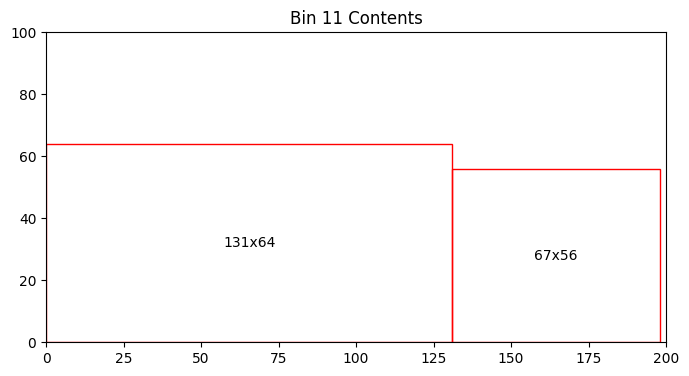

Bin 11 has 7864.00 units of area left


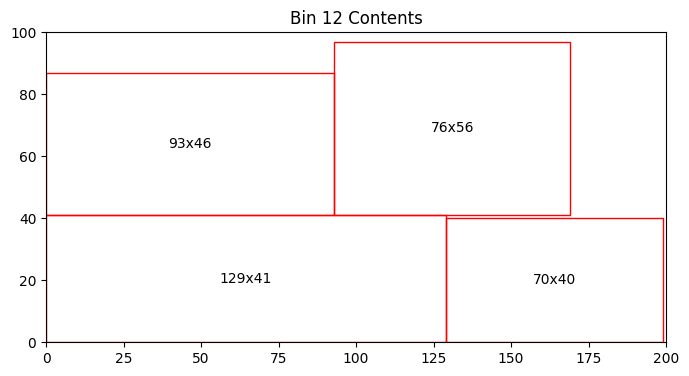

Bin 12 has 3377.00 units of area left


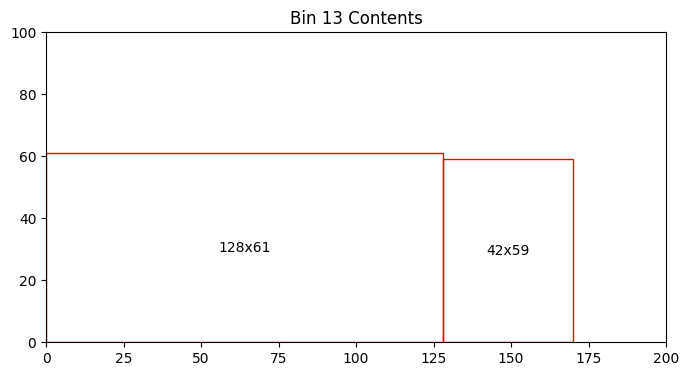

Bin 13 has 9714.00 units of area left


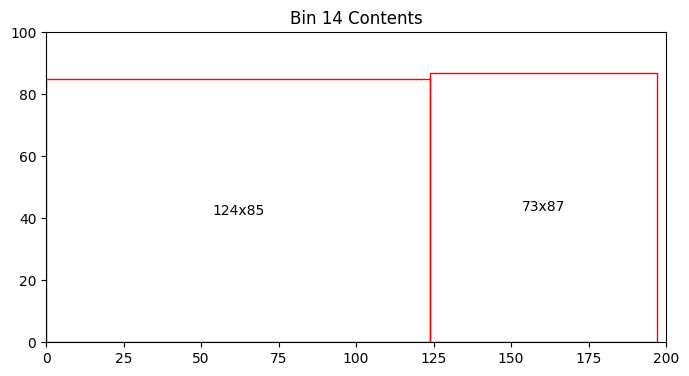

Bin 14 has 3109.00 units of area left


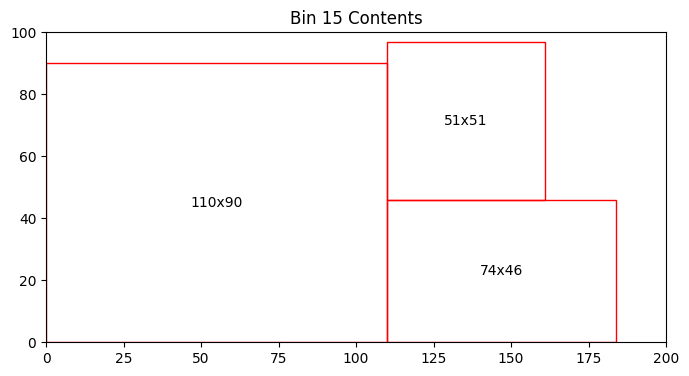

Bin 15 has 4095.00 units of area left


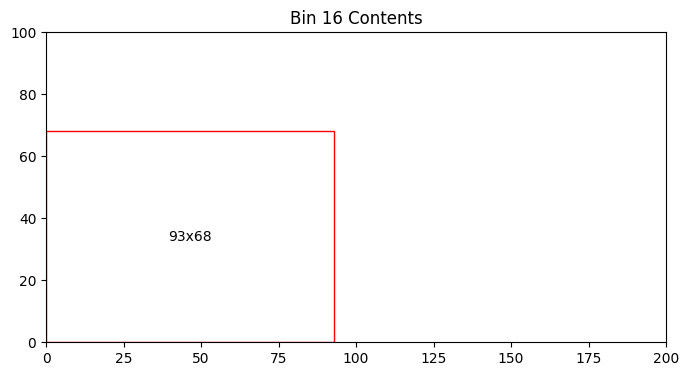

Bin 16 has 13676.00 units of area left
Total number of bins = 16
Total area left in bins = 67109.00
Results have been saved to results.csv and incorrect codes to incorrect_codes.csv


In [13]:
import os
import json
import numpy as np
import csv
import pandas as pd

checked_codes_dir = '2_checked_codes/2_checked_codes_eval'
results2 = []
incorrect_codes2 = []

# Read the base_eval.py content once
with open('base_eval.py', 'r') as base_file:
    base_content = base_file.read()

# Function to process each Python file
def process_files(rectangles_array, iteration):
    global total_bins, total_area_left
    for filename in os.listdir(checked_codes_dir):
        if filename.endswith('.py'):
            filepath = os.path.join(checked_codes_dir, filename)
            
            # Read the content of the current checked code file
            with open(filepath, 'r') as file:
                file_content = file.read()
            
            # Insert the rectangle array as the first line without overwriting the original code
            rectangles_array_str = np.array2string(rectangles_array, separator=',')
            modified_content = f"import numpy as np\nrectangles_array = np.array({rectangles_array_str})\n" + file_content + "\n" + base_content
            
            # Execute the combined content in the global scope so that imports work
            exec(modified_content, globals())
            result, message = check_bins(bins, 200, 100)
            
            # Capture the results based on the check
            if result:
                results2.append({
                    'filename': filename,
                    'iteration': iteration,
                    'total_bins': int(total_bins),
                    'total_area_left': int(total_area_left)
                })
            else:
                incorrect_codes2.append({
                    'filename': filename,
                    'iteration': iteration
                })
            save_results_to_csv(results2, 'results2.csv')
            save_results_to_csv(incorrect_codes2, 'incorrect_codes2.csv')    

# Function to save results to a CSV file using pandas DataFrame
def save_results_to_csv(results_list, filename):
    if results_list:
        df = pd.DataFrame(results_list)
        df.to_csv(filename, index=False)


# Loop over the different rectangle arrays
for i, rectangles_array in enumerate(rectangles_list):
    process_files(rectangles_array, i)

# Save the results and incorrect codes to CSV files


print("Results have been saved to results.csv and incorrect codes to incorrect_codes.csv")

In [14]:
df = pd.DataFrame(results2)
avg_df = df.groupby('filename').agg({'total_bins': 'mean', 'total_area_left': 'mean'}).reset_index()

# Save the results to a new CSV file
avg_df.to_csv('results_avg2.csv', index=False)

print("Averages computed and saved to 'results_avg2.csv'")

Averages computed and saved to 'results_avg2.csv'


In [15]:
avg_df_sorted = avg_df.sort_values(by='total_bins')

# Step 2: Group by 'total_bins' and create separate DataFrames
grouped = avg_df_sorted.groupby('total_bins')

# Step 3: Create separate DataFrames for each group and rename columns
islands = {}
for i, (total_bins, group) in enumerate(grouped):
    island_name = f'2_island_{i+1}'
    # Create a new DataFrame with columns named filename_1, filename_2, etc.
    island_df = pd.DataFrame({f'filename_{j+1}': [filename] for j, filename in enumerate(group['filename'])})
    islands[island_name] = island_df

# Step 4: Save each island DataFrame as a CSV file locally
for island_name, island_df in islands.items():
    file_path = f'{island_name}.csv'
    island_df.to_csv(file_path, index=False)

# To list the saved files (optional)
import os
saved_files = [f for f in os.listdir() if f.startswith('2_island_')]
print(saved_files)

['2_island_1.csv', '2_island_2.csv']
